# Introduction

ln machine learning, Naïve Bayes classification is a straightforward and powerful algorithm for the classification task. Naïve Bayes classification is based on applying Bayes’ theorem with strong independence assumption between the features. Naïve Bayes classification produces good results when we use it for textual data analysis such as Natural Language Processing.

Naïve Bayes models are also known as simple Bayes or independent Bayes. All these names refer to the application of Bayes’ theorem in the classifier’s decision rule. Naïve Bayes classifier applies the Bayes’ theorem in practice. This classifier brings the power of Bayes’ theorem to machine learning.

Gaussian Naïve Bayes algorithm
When we have continuous attribute values, we made an assumption that the values associated with each class are distributed according to Gaussian or Normal distribution. For example, suppose the training data contains a continuous attribute x. We first segment the data by the class, and then compute the mean and variance of x in each class. Let µi be the mean of the values and let σi be the variance of the values associated with the ith class. Suppose we have some observation value xi . Then, the probability distribution of xi given a class can be computed by the following equation –

Gaussian Naive Bayes algorithm

Multinomial Naïve Bayes algorithm
With a Multinomial Naïve Bayes model, samples (feature vectors) represent the frequencies with which certain events have been generated by a multinomial (p1, . . . ,pn) where pi is the probability that event i occurs. Multinomial Naïve Bayes algorithm is preferred to use on data that is multinomially distributed. It is one of the standard algorithms which is used in text categorization classification.

Bernoulli Naïve Bayes algorithm
In the multivariate Bernoulli event model, features are independent boolean variables (binary variables) describing inputs. Just like the multinomial model, this model is also popular for document classification tasks where binary term occurrence features are used rather than term frequencies.

# Sentiment Analysis

  Sentiment analysis is basically concerned with analysis of emotions and opinions from text.

 A sentiment evaluation system for text analysis combines natural language processing (NLP) and laptop mastering methods to assign weighted sentiment scores to the entities, topics, issues and categories inside a sentence or phrase.It tries to find and justify sentiment of the person with respect to a given source of content.

I am proposing a highly accurate model of sentiment analysis from a datasets containing product reviews from amazon  with the help of classifiers such as Naïve Bayes, the application can correctly classify the reviews of the given datasets as positive,neutral and negative to give sentiment of each review.

Since our dataset has no classification we first make the classification on the given data then classify them using Naive Baise

In [1]:
#import important liabraries
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
#import liabriaries
import nltk
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
import collections
import itertools
import string
import re
import plotly.express as px
from wordcloud import WordCloud
import datetime
import sys
from nltk.sentiment.vader import SentimentIntensityAnalyzer
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
from nltk.stem import WordNetLemmatizer
from textblob import Word
from textblob import TextBlob
from nltk.corpus import stopwords
from collections import Counter
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import classification_report,confusion_matrix,accuracy_score
from keras.models import Sequential
from keras.preprocessing.text import Tokenizer
from sklearn.feature_extraction.text import CountVectorizer
from bokeh.plotting import figure, show, output_notebook
from sklearn.feature_extraction.text import CountVectorizer
from nltk.tokenize import RegexpTokenizer
from bokeh.models import HoverTool, ColumnDataSource
from sklearn.model_selection import train_test_split
from tensorflow.keras.utils import to_categorical 



In [2]:
#Load Data Set
df = pd.read_csv('reviews.csv')
df.head(5)

,asin,name,rating,date,verified,title,body,helpfulVotes
0,B0000SX2UC,Janet,3,"October 11, 2005",False,"Def not best, but not worst",I had the Samsung A600 for awhile which is abs...,1.0
1,B0000SX2UC,Luke Wyatt,1,"January 7, 2004",False,Text Messaging Doesn't Work,Due to a software issue between Nokia and Spri...,17.0
2,B0000SX2UC,Brooke,5,"December 30, 2003",False,Love This Phone,"This is a great, reliable phone. I also purcha...",5.0
3,B0000SX2UC,amy m. teague,3,"March 18, 2004",False,"Love the Phone, BUT...!","I love the phone and all, because I really did...",1.0
4,B0000SX2UC,tristazbimmer,4,"August 28, 2005",False,"Great phone service and options, lousy case!",The phone has been great for every purpose it ...,1.0


In [3]:
df.describe()

,rating,helpfulVotes
count,67986.000000,27215.000000
mean,3.807916,8.229690
std,1.582906,31.954877
min,1.000000,1.000000
25%,3.000000,1.000000
50%,5.000000,2.000000
75%,5.000000,5.000000
max,5.000000,990.000000


In [4]:
print("There are {} observations and {} features in the  dataset. \n".format(df.shape[0],df.shape[1]))

There are 67986 observations and 8 features in the  dataset. 



In [5]:
## dropping unnecessary column
df.drop(['asin','title','helpfulVotes','verified','name'],inplace=True,axis=1)

In [6]:
df

,rating,date,body
0,3,"October 11, 2005",I had the Samsung A600 for awhile which is abs...
1,1,"January 7, 2004",Due to a software issue between Nokia and Spri...
2,5,"December 30, 2003","This is a great, reliable phone. I also purcha..."
3,3,"March 18, 2004","I love the phone and all, because I really did..."
4,4,"August 28, 2005",The phone has been great for every purpose it ...
...,...,...,...
67981,5,"August 16, 2019",I love the camera on this phone. The screen is...
67982,5,"September 14, 2019",I've been an Xperia user for several years and...
67983,5,"July 14, 2019",buy one more for my cousin
67984,5,"December 24, 2019",Product looks and works like new. Very much re...


In [7]:
df.nunique()

rating        5
date       2983
body      59811
dtype: int64

In [8]:
##data inspection
print('missing value:')
print(df.isnull().sum())

missing value:
rating     0
date       0
body      21
dtype: int64


In [9]:
#Drop missing values
df = df.dropna()

In [10]:
#Remove duplicates 
df = df.drop_duplicates()

array([[<AxesSubplot:title={'center':'rating'}>]], dtype=object)

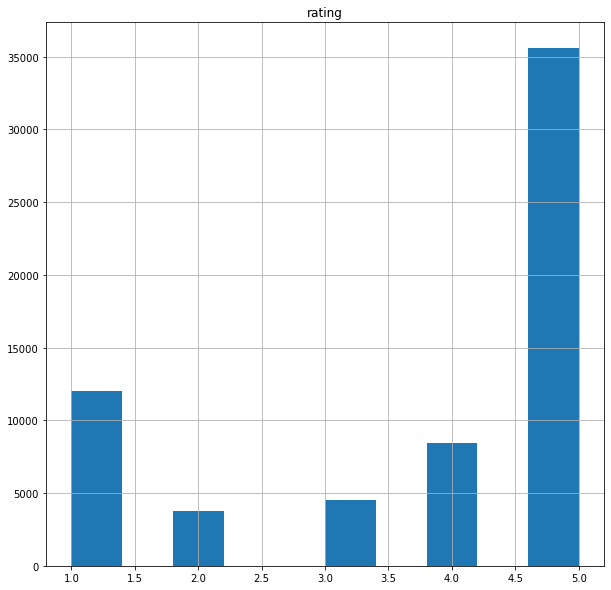

In [11]:
##checking the distribution of the data
df.hist(figsize=(10,10))

In [12]:
def word_cloud(body):
    x, y = np.ogrid[:300, :300]
    mask = (x - 150) ** 2 + (y - 150) ** 2 > 130 ** 2
    mask = 255 * mask.astype(int)
    # Read the mask image into a numpy array
    #Generate the wordcloud using the series created and the mask 
    word_cloud = WordCloud(width=2000, height=1000, max_font_size=200, 
                           background_color="black", max_words=2000, mask=mask, 
                           contour_width=1, contour_color="steelblue", 
                           colormap="nipy_spectral").generate(body)

    #Plot word cloud
    plt.figure(figsize=(10,10))
    plt.imshow(word_cloud, interpolation="hermite") # hermite
    plt.axis("off")    
    plt.show()   

In [13]:
def graph(word_frequency, sent):
    labels = word_frequency[0][0:60].index
    title = "Word Frequency for %s" %sent
    #Plot the figures
    plt.figure(figsize=(10,5))
    plt.bar(np.arange(60), word_frequency[0][0:60], width = 0.8, color = sns.color_palette("bwr"), alpha=0.5, 
            edgecolor = "black", capsize=8, linewidth=1);
    plt.xticks(np.arange(60), labels, rotation=90, size=10);
    plt.xlabel("60 Most Frequent %s "%sent, size=14);
    plt.ylabel("Frequency", size=14);
     
    plt.title(title, size=18)
    plt.grid(False);
    plt.gca().spines["top"].set_visible(False);
    plt.gca().spines["right"].set_visible(False);
    plt.show()

In [14]:
def graph1(word_frequency, sent):
    labels = word_frequency[0][1:61].index
    title = "Word Frequency for %s" %sent
    #Plot the figures
    plt.figure(figsize=(10,5))
    plt.bar(np.arange(60), word_frequency[0][1:61], width = 0.8, color = sns.color_palette("bwr"), alpha=0.5, 
            edgecolor = "black", capsize=8, linewidth=1);
    plt.xticks(np.arange(60), labels, rotation=90, size=10);
    plt.xlabel("60 Most Frequent Words - %s "%sent, size=14);
    plt.ylabel("Frequency", size=14);
     
    plt.title(title, size=18)
    plt.grid(False);
    plt.gca().spines["top"].set_visible(False);
    plt.gca().spines["right"].set_visible(False);
    plt.show()

In [15]:
def regression_graph(table):
    table = table[1:]
    # set the style of seaborn
    sns.set_style("whitegrid")   
    #Initialize the figure
    plt.figure(figsize=(6,6))
    
    #Obtain the points from matplotlib scatter
    points = plt.scatter(table["Positive"], table["Negative"], c=table["Positive"], s=75, cmap="bwr")
    #Graph the colorbar
    plt.colorbar(points)
    #Graph the regplot from seaborn
    sns.regplot(x="Positive", y="Negative",fit_reg=False, scatter=False, color=".1", data=table)
    plt.xlabel("Frequency for Positive Tweets", size=14)
    plt.ylabel("Frequency for Negative Tweets", size=14)
    plt.title("Word frequency in Positive vs. Negative Tweets", size=14)
    plt.grid(False)
    sns.despine()

In [16]:
#Vectorization for Data Visualization
def vectorization(data):
    #CountVectorizer will convert a collection of text documents to a matrix of token counts
     
    vector = CountVectorizer()
    #Fit and transform the vector created
    frequency_matrix = vector.fit_transform(data)
    #Sum all the frequencies for each word
    sum_frequencies = np.sum(frequency_matrix, axis=0)
    #Use squeeze to remove single-dimensional entries from the shape of an array that we got from applying np.asarray to
    #the sum of frequencies.
    frequency = np.squeeze(np.asarray(sum_frequencies))
    #Get into a dataframe all the frequencies and the words that they correspond to
    frequency_df = pd.DataFrame([frequency], columns=vector.get_feature_names()).transpose()
    return frequency_df

In [17]:
def vectorization_bigram(data):
    #CountVectorizer will convert a collection of text documents to a matrix of token counts
     
    vector = CountVectorizer(ngram_range=(2, 2))
    #Fit and transform the vector created
    frequency_matrix = vector.fit_transform(data)
    #Sum all the frequencies for each bigram
    sum_frequencies = np.sum(frequency_matrix, axis=0)
    #Use squeeze to remove two-dimensional entries from the shape of an array that we got from applying np.asarray to
    #the sum of frequencies.
    frequency = np.squeeze(np.asarray(sum_frequencies))
    #Get into a dataframe all the frequencies and the words that they correspond to
    frequency_df = pd.DataFrame([frequency], columns=vector.get_feature_names()).transpose()
    return frequency_df

In [18]:
def cleaning(body):        
    # converting to lowercase, removing URL links, special characters, punctuations...
    text = body.lower() # converting to lowercase
    text = re.sub('https?://\S+|www\.\S+', '', body) # removing URL links
    text = re.sub(r"\b\d+\b", "", body) # removing number 
    text = re.sub('<.*?>+', '', body) # removing special characters, 
    text = re.sub('[%s]' % re.escape(string.punctuation), '', body) # punctuations
    text = re.sub('\n', '', body)
    text = re.sub('[’“”…]', '', body)
   
    #removing emoji: 
    emoji_pattern = re.compile("["
                           u"\U0001F600-\U0001F64F"  # emoticons
                           u"\U0001F300-\U0001F5FF"  # symbols & pictographs
                           u"\U0001F680-\U0001F6FF"  # transport & map symbols
                           u"\U0001F1E0-\U0001F1FF"  # flags (iOS)
                           u"\U00002702-\U000027B0"
                           u"\U000024C2-\U0001F251"
                           "]+", flags=re.UNICODE)
    body = emoji_pattern.sub(r'', body)   

   # removing short form: 
    
    text=re.sub("isn't",'is not',body)
    text=re.sub("he's",'he is',body)
    text=re.sub("wasn't",'was not',body)
    text=re.sub("there's",'there is',body)
    text=re.sub("couldn't",'could not',body)
    text=re.sub("won't",'will not',body)
    text=re.sub("they're",'they are',body)
    text=re.sub("she's",'she is',body)
    text=re.sub("There's",'there is',body)
    text=re.sub("wouldn't",'would not',body)
    text=re.sub("haven't",'have not',body)
    text=re.sub("That's",'That is',body)
    text=re.sub("you've",'you have',body)
    text=re.sub("He's",'He is',body)
    text=re.sub("what's",'what is',body)
    text=re.sub("weren't",'were not',body)
    text=re.sub("we're",'we are',body)
    text=re.sub("hasn't",'has not',body)
    text=re.sub("you'd",'you would',body)
    text=re.sub("shouldn't",'should not',body)
    text=re.sub("let's",'let us',body)
    text=re.sub("they've",'they have',body)
    text=re.sub("You'll",'You will',body)
    text=re.sub("i'm",'i am',body)
    text=re.sub("we've",'we have',body)
    text=re.sub("it's",'it is',body)
    text=re.sub("don't",'do not',body)
    text=re.sub("that´s",'that is',body)
    text=re.sub("I´m",'I am',body)
    text=re.sub("it’s",'it is',body)
    text=re.sub("she´s",'she is',body)
    text=re.sub("he’s'",'he is',body)
    text=re.sub('I’m','I am',body)
    text=re.sub('I’d','I did',body)
    text=re.sub("he’s'",'he is',body)
    text=re.sub('there’s','there is',body)
    
     
    return body
    
df['body'] = df['body'].apply(cleaning)

In [19]:
productreveiws = df['body']

In [20]:
productreveiws = productreveiws.fillna('').apply(str)

In [21]:
productreveiws =productreveiws.apply((lambda x: re.sub(r'@[A-Za-z0-9]+','',x)))

In [22]:
#stop = stopwords.words('english')
stop = stopwords.words('english')

In [23]:
productreveiws = productreveiws.apply(lambda x: ' '.join([word for word in x.split() if word not in (stop)]))

In [24]:
productreveiws['sentiment'] = productreveiws.apply(lambda body: TextBlob(body).sentiment[0])

In [25]:
SentiTweet=productreveiws['sentiment']
SentiTweet

0        0.122323
1        0.109722
2        0.298718
3        0.301563
4        0.032143
           ...   
67922    0.000000
67923    0.500000
67924    0.400000
67984    0.198182
67985    0.660000
Name: body, Length: 64292, dtype: float64

In [26]:
Lenproductreveiws = len(productreveiws['sentiment'])
Lenproductreveiws

64292

In [27]:
Senti= pd.DataFrame(columns=('body', 'senty'))
#Senti= pd.DataFrame(data=('tweety':['     '],'senty':['    ']))
Positive_Sentiments=0
Neutral_Sentiments=0 
Negative_Sentiments=0
for i in range(Lenproductreveiws):
    print(productreveiws.values[i])
    analysis = TextBlob(productreveiws.values[i])
    print(analysis.sentiment)
    if analysis.sentiment[0]>0:
        print('Positive')
        Positive_Sentiments=Positive_Sentiments+1
        Senti.loc[i] = [productreveiws.values[i],'Positive']
        
    elif analysis.sentiment[0]<0:
        print('Negative')
        Negative_Sentiments=Negative_Sentiments+1
        Senti.loc[i] = [productreveiws.values[i],'Negative']
    else:
        print('Neutral')
        Neutral_Sentiments=Neutral_Sentiments+1
        Senti.loc[i] = [productreveiws.values[i],'Neutral']
print('Positive Sentiments are ',Positive_Sentiments)
print('Negative Sentiments are ',Negative_Sentiments) 
print('Neutral Sentiments are ',Neutral_Sentiments)


I Samsung A600 awhile absolute doo doo. You read review detect rage stupid thing. It finally died I used Nokia phone I bought garage sale $1. I wonder sold cheap?... Bad: ===> I hate menu. It takes forever get want scroll endlessly. Usually phones numbered categories u simply press # get want go. ===> It's pain put silent vibrate. If class rings, turn immediately. There's fast way silence damn thing. Always remember put silent! I learned hard way. ===> It's true case. It's mission get break ur nails process. Also, damage case time u try. For reason phone started giving problems I succeed opening it. ===> Buttons could bit bigger. Vibration could stronger. Good: ===> Reception shabby. I using elevator remarkable feat considering old phone would lose service simply putting pocket. ===> Compared old Samsung, phone works quite well. The ring tones loud enough hear phone actually charges quickly great battery life. It heat like potatoe oven either long phone convos. ===> Nice bright, large 

I've using phone three weeks, now, truly nice little phone. It's small, light, keypad screen really light up...you actually see screen bright sunlight! It everything I want phone do. The graphics web really good, although accessing web rather slow. The keypad IS quite small, could problem men, perfect me. The negative speaker phone capability. The battery life is, others said, amazing! As person whose wife's phone dead, probably jostled purse inadvertently turned on. I prefer bar phones kind (not sure why), one first things I learned lock keypad whenever I put purse, pocket, place would possible phone accidentally turned on. It's simple matter pushing two keys turn lock shut off, sure saves lot battery life.
Sentiment(polarity=0.216875, subjectivity=0.6334126984126986)
Positive
Well, phone came service plan is.. well.. paper weight (darn razrs!!) I didnt want spend another 100+ phone wil break, stumbled upon gophones, 19.99-99.99 best buy work perfectly AT&T monthly subscription SIM ca

Good overall phone, bluetooth far syncs well integrated bluetooth Mercedes I used also aftermarket Alpine stereo I VW. But features design poor and/or thought out. Looks great body far slippery. It's like handling bar soap. I use primary alarm clock morning really clumsy grab nightstand shut alarm. Even I'm fully awake alert :-) hard open I've dropped times fumbling open it. There wider slit clamshell lid fit finger opening portrait mode landscape mode there's place insert finger flip open, use fingernail. Unlike previous phone, takes two hands almost time open thing whereas old phone I could easily flip open one hand. I wish alarm clock's snooze function like clock radios allows 10 minutes snooze time, 5. 5 short. Or, phone allow set snooze period preference. There way display time front screen phone dark; open up. Well, fake holding lock button music keys, light display) hold second time reset lock/unlock back it. Also, call (although every cell phone fails this) clock display anywhe

I told phone, Amazon customer support, phone Bluetooth capability. The Amazon website even shows bluetooth headsets "available accessories". However, phone doe support either bluetooth wireless headsets. I guess cheap. I return phone. Inside packaging, Samsung picture "corded" headset could purchase phone.
Sentiment(polarity=0.4, subjectivity=0.55)
Positive
havent got phone yet id say dad love cause lookin one like
Sentiment(polarity=0.5, subjectivity=0.6)
Positive
A friend using one phones, gave 6 months ago. A days back, I switched sim card went online at&t change "make" phone, phone available list. But works fine, using days, long battery life. I use occasional call I can't comment features. I know anything else needed get working since mine already used, I would get another I seen decent prices around.
Sentiment(polarity=0.15555555555555553, subjectivity=0.34861111111111115)
Positive
Got phone temporary use travelling US. Difficult activate - call AT&T online activation work - took

phone would connect network verison network screwed around 2 hours. Never again.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
bad shape full scratches itlookedas used hapoy all.
Sentiment(polarity=-0.17499999999999993, subjectivity=0.6083333333333334)
Negative
The phone arrived within time frame delivery. The outside excellent condition looked almost new. The inside, however, dirty traces chocolate! The phone performs functions except memory card reader work. All all, considering I looking quick replacement phone working properly, I happy purchase price.
Sentiment(polarity=0.2532828282828283, subjectivity=0.6340909090909091)
Positive
I purchased rather basic piece equipment "used" assuming risk defect low. I got burned. The device power completely without pulling battery. Also, battery completely depleted approx 30 mins talk. The reason I returned I already given elderly mother. Plus, I want expend valuable returning it. The cost less $50.
Sentiment(polarity=0.0066666666666666706,

Just looking price shocking... These dinky phones po
Sentiment(polarity=-1.0, subjectivity=1.0)
Negative
I purchased RAZR replacement husband's falling apart. We trying lower bills reduce wireless costs going back basic phones. I got phone accessories timely, BUT... I call Verizon activate phone tell use. What he**?!?!?! A huge waste $80 can't even use it. VERY UPSET DISAPPOINTED!!!!!!!!! Seriously... use I phone possession? Anyway... SUCKS never again!!!!
Sentiment(polarity=-0.20821940104166664, subjectivity=0.3802083333333333)
Negative
Ordered phone thought I getting good deal, till showed phone battery. Now I go purchase battery it... Be careful order from!!
Sentiment(polarity=0.271875, subjectivity=0.8)
Positive
It work received. Took verizon store, THEY could make work, sent back refund !!!! I wanted slim design. I carry phone pocket, wish HAD worked !!
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
It charge. A ripoff
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Arrived g

My dad used parts make another cell phone work works great! Got fast too!
Sentiment(polarity=0.625, subjectivity=0.675)
Positive
The Razor clean good condition, works well!
Sentiment(polarity=0.6208333333333333, subjectivity=0.6500000000000001)
Positive
I got replaced device I (lost?) hospital. It arrived quickly easy reload phone book took care needs I discharged.... Then I wanted link vehicle's Kenwood. I mean previous (older) one did. Would work, I stopped local Verizon associate pulled smarter phone quickly said, "Your Bluetooth working, signal". So I am, wish sellar fully check selling (well I thought implied)!
Sentiment(polarity=0.08958333333333333, subjectivity=0.4201388888888889)
Positive
I needed simple uesful phone. If need smart phone one waht phones ment one good.
Sentiment(polarity=0.30476190476190473, subjectivity=0.5333333333333333)
Positive
I guess get pay (t used, refurbished). It real bargain. However took 6 months break.
Sentiment(polarity=0.2, subjectivity=0.3000000

Positive
Worked good
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
I glad 'new' phone. It nice worry much I going break I drop not. Still insure things I learning.
Sentiment(polarity=0.35909090909090907, subjectivity=0.6636363636363637)
Positive
I alot experience motorola barrage, ordered one replace old barrage finally quit three years use. I love product hate verizon quit carrying thier stores. As phone, I impressed speed delivered, used quite impressed condition, looked almost unused. I'm much satisfied order would highly reccomend another person
Sentiment(polarity=0.3075, subjectivity=0.7799999999999999)
Positive
purchased phone 2 months started problems it! numerous barrage phones never problem!!!!!! Purchased two second one activate!!!!! problem couple months I activated phone longer able return!!!!!!!!!!
Sentiment(polarity=0.3333333333333333, subjectivity=0.375)
Positive
I one phones already I knew expect know shape would since used reconditioned. It looked a

Works advertised.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
While phone works rubber control buttons right side fallen out.
Sentiment(polarity=0.2857142857142857, subjectivity=0.5357142857142857)
Positive
Phone fine expected. The battery hold much charge. Hpwever, I satisfied
Sentiment(polarity=0.25416666666666665, subjectivity=0.525)
Positive
It little broken I thought, good working order. I kill phone used one best me.
Sentiment(polarity=0.27812499999999996, subjectivity=0.45)
Positive
Had one 6years, some-what water proof takes real beating. Hope one lasts long. With punishment, would ruin 5 Smart phones now.
Sentiment(polarity=0.12142857142857144, subjectivity=0.44761904761904764)
Positive
Nice basic phone money. Very well built.
Sentiment(polarity=0.26666666666666666, subjectivity=0.47500000000000003)
Positive
Great
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
phone dirty i'm afraid use it, mention put near face. I'm send back.
Sentiment(polarity=-0.2749999999999999

Sentiment(polarity=-0.36250000000000004, subjectivity=0.6541666666666667)
Negative
Didnt last long all!
Sentiment(polarity=-0.03125, subjectivity=0.23333333333333334)
Negative
The last time I asked person I bought thought, said phone real good. Sorry I provide that.
Sentiment(polarity=0.16666666666666666, subjectivity=0.6555555555555556)
Positive
...I phone one month. In one month, I dropped submerged water. I got phone I clumsy. It turns grip texture found sides behind phone helped avoid dropping phone. I like buttons inside phone pressing like pounding fingers desk. This phone might complicated me. After I updated phonebook, I receive call, I hear woman's voice announcing name caller followed ringing phone. I can't figure turn "announcing" feature.
Sentiment(polarity=-0.39999999999999997, subjectivity=0.7000000000000001)
Negative
Phone SUCKS!!! Don't ever buy piece JUNK!!!
Sentiment(polarity=-1.0, subjectivity=0.3)
Negative
I want return phone, return form address. Could please help 

Here three different functions/procedures:#3-Cellebrite,(machine)a way transfer contacts one cell phone another. Need done VZ Wireless store.#2-Flash, way cell phone reset back Factory Default settings. Need done VZ Direct Store (Verizon owned). Then able download reinstall Back-Up Assistant.#1-From Media Center-Browse & Download...launch Back-Up Assistant...(lower left) launch HELP...once Help screen type *73738#...the screen close take "reset" Back-Up Assistant...when ask pin# type yours.....I hope helps.
Sentiment(polarity=0.12, subjectivity=0.325)
Positive
Purchased phone phone husband used years. It stated could used existing Verizon account. That work. It longer available programing. Disappointed..
Sentiment(polarity=-0.175, subjectivity=0.575)
Negative
We used phone before, familiar it. The price really good; appeared brand new. Still resisting change, phone need do.
Sentiment(polarity=0.4037878787878788, subjectivity=0.5181818181818182)
Positive
The back isnt closing correctly 

Works great!
Sentiment(polarity=1.0, subjectivity=0.75)
Positive
The best phone market.
Sentiment(polarity=1.0, subjectivity=0.3)
Positive
Great item Fast shipping
Sentiment(polarity=0.5, subjectivity=0.675)
Positive
Motorola Barrage - MOTV860 UPDATE 6 MONTHS LATER: Alright, maybe bad phone all. It VERY simple STILL gets great reception compared verizon phones I've had. I still call rugged all. But, penny- I think best bet 1 cent options, still working great 6 months fact weighs nothing seem contain glass metal advertised become less annoying consistently performing well. No problems since early exchange dud. Maybe need change advertising angle bad all, NOT industrial grade. Because consistently high talk quality ease use, I upped star. ____________________________ UPDATE: two months later... Returned original phone screen kept going blank. Had problems Verizon exchange purchased within 30 days problems replacement phone. The reception still VERY good Battery life long. But still... ru

works great received quick
Sentiment(polarity=0.5666666666666667, subjectivity=0.625)
Positive
works good
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Was satisfied. After activating buzzing sound would go away.
Sentiment(polarity=0.45, subjectivity=0.7)
Positive
The phone sent prepaid phone, however, product advertised such. No say prepaid phone.
Sentiment(polarity=0.0, subjectivity=0.5)
Neutral
Has served well four years?
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Fast shipping. Product described. Phone looks works great.
Sentiment(polarity=0.5, subjectivity=0.675)
Positive
It's great!
Sentiment(polarity=1.0, subjectivity=0.75)
Positive
Had idea phone prepaid didnt work me. Should said prepaid somewhere description.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Great phone 10yr old!
Sentiment(polarity=0.4625, subjectivity=0.475)
Positive
It works great. Not much info u buying item. It come charger. I give stars wa charger
Sentiment(polarity=0.350000000

No stating phone old style charge connection,, compatible latest. Meaning- cord nt fit amsung device.
Sentiment(polarity=0.3333333333333333, subjectivity=0.5)
Positive
Got phone mom, needed cell phone make phone calls, text. Received took Verizon Wireless got activated her. Phone great hassle activating phone Verizon Wireless. If needing basic phone use, I highly recommend phone.
Sentiment(polarity=0.32, subjectivity=0.4716666666666667)
Positive
Brought phone sister, first phone ever. She problems it. For standard flip phone, pretty simplistic. Aside texting making calls there's much else do. Picture quality greatest, considering price type phone, really bad.
Sentiment(polarity=0.07142857142857144, subjectivity=0.5285714285714286)
Positive
This phone ideal someone needs phone use phone. The camera, texting internet capabilities work great, best part phone well. Very satisfied.
Sentiment(polarity=0.8375, subjectivity=0.7625)
Positive
I found hard way, activate phone carrier, use buying 

I would give cell 5 stars but, speaker TERRIBLE Worse Worse , owned lots Clam Flip phones bad speakers pay take one , save money & buy cell Hear , one Useless . Rugby II SGH A847 .
Sentiment(polarity=-0.5999999999999999, subjectivity=0.6133333333333334)
Negative
Bought January. It works US, Europe even Japan. I understand comments poor reception, mine works really really well. Nice look feel, solid well made rugged. Very happy. Very hard get international info Samsung AT&T glad I bought it. Very satisfied. I use phone make phone calls I Blackberry Iphone browsing, emails, music etc. It also really nice flip phone autodial pants pocket switch flight. Only downer PTT button keeps asking I want set PTT. I wish I could disable it.
Sentiment(polarity=0.2518939393939394, subjectivity=0.6912878787878788)
Positive
What terrible phone. I broke exterior screen phone 3 months. The phone still clipped belt even fallen. After long argument AT&T finally agreed replace it. After supposed tough phone.

The simplest cell phone world would thrilled I've never one. I got free I use it. "Free" cost several bucks hours wasted time. Can't connect, can't hold charge. After reading reviews elsewhere, I wonder, heck wrong I can't even detect? ----------------------- Even I somehow got work, I connection problems, battery issues. Others talk need expensive headsets, sometimes headset port even work. I've heard many complain shuts own, reception poor, sound quality poor, on. ---------------------------------------------- If device able place simple call, I would VERY happy. I doubt thing ever work right, even I could make calls, reviews lead believe odds quite high I would encounter many frustrating problems. --------------------------------- No thank you, Samsung. Yours name I'll avoid future. Thanks frustration extreme waste time.
Sentiment(polarity=0.12263975155279504, subjectivity=0.5557763975155279)
Positive
Like reviewers, I found sound quality lacking since Verizon's entry-level phone, e

Was looking phone, computer. I love phone. Bought used however previous owners contacts still it. Was sold perfect, necessarily perfect cosmetically works great. Would recommend seller phone.
Sentiment(polarity=0.6266666666666667, subjectivity=0.7033333333333334)
Positive
Great value tough little phone. Perfect need take phone, smartphone (camping, hiking, etc...).
Sentiment(polarity=0.3059027777777778, subjectivity=0.7708333333333334)
Positive
My dad still using phone today issues.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
The fast shipping always great. However, phone compatible Verizon carrier.
Sentiment(polarity=0.5, subjectivity=0.675)
Positive
The phone came works great. I needed heavy duty phone husband far holding up. I want buy brand new phone refurbished used one works perfect! It problem verizon program account either. They actually told I could done home.
Sentiment(polarity=0.3060606060606061, subjectivity=0.6340909090909091)
Positive
good
Sentiment(polarity=0.7, su

Positive
works great
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Delivered time works fine
Sentiment(polarity=0.4166666666666667, subjectivity=0.5)
Positive
best company good products
Sentiment(polarity=0.85, subjectivity=0.45000000000000007)
Positive
good
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Okay, I must eat crow here. I cannot seem find way remove bad review. In short, I found battery later box. Hooked phone works like charm. My apologies vendor. Please let know remove review I so.
Sentiment(polarity=-0.04999999999999996, subjectivity=0.36666666666666664)
Negative
I changed phones lot lately, including smart phones fits bill! Its rugged like Casio commando. It push talk, built military specs. I would buy seller couple days, like new condition.
Sentiment(polarity=0.001055194805194802, subjectivity=0.4493506493506494)
Positive

Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Have 10 years now, I get 15 days standby, todays cheaper thinner get 5 da

This Cell perfect everyday use! Has BIG Screen & Works really Well! I would recomend cell 2 anyone looking something FULL KEYBOARD decent Style low price!!
Sentiment(polarity=0.2166666666666667, subjectivity=0.4880952380952381)
Positive
This great affordable phone calling texting purposes. It five stars that. I think phone I would buy web browsing email though!
Sentiment(polarity=1.0, subjectivity=0.75)
Positive
I looking inexpensive phone (which was), keys way small. Perhaps awkward feel reason low price!!
Sentiment(polarity=-0.2833333333333333, subjectivity=0.5666666666666667)
Negative
This easy use phone great features like texting sending pictures uses many minutes use log onto internet
Sentiment(polarity=0.5777777777777778, subjectivity=0.6944444444444445)
Positive
Never used since work Mexico, otherwise I guess fine U.S.
Sentiment(polarity=0.4166666666666667, subjectivity=0.5)
Positive
Best feature is: It uses 1/2 minute per text, unlike last phone used minute per text. It also s

Sentiment(polarity=0.3533216783216784, subjectivity=0.6125679875679876)
Positive
I wanted basic phone, it. Don't expect Internet access, Facebook, etc, thing. My friends mostly phones costing 2-4 times much per month (I use $25/month 750 minute plan). But phones work buildings, elevators, subway, etc., mine does. It seems Net10 rents working wireless access expensive companies sells us. I purchased 3 phones. One defective enough return it, second one refuses go autolock mode, I often find browsing net writing text messages. To knowledge never actually butt-dialed anyone. I lock holding spacebar, I often forget. It never managed use minutes, anyway. A fourth Net10 phone also died I started Samsungs. So I give 5 stars? Because practically giving phones away, per month charge reasonable US standards.The reason I get yet another phone dump slightly defective one I'll type 300 digits reprogram new phone take account. As far usability, phone great. The keyboard fine, even though keys tiny I 

Love net 10 phone. No contract,easy text, works middle nowhere phone tower close
Sentiment(polarity=0.16666666666666666, subjectivity=0.19999999999999998)
Positive
I like simple phones works - $10 expect!
Sentiment(polarity=0.0, subjectivity=0.35714285714285715)
Neutral
Great needs, lives expectations. I happy product. Highly recommend buy this.
Sentiment(polarity=0.5866666666666667, subjectivity=0.7633333333333333)
Positive
Ok
Sentiment(polarity=0.5, subjectivity=0.5)
Positive
The phone great texting! It laso camera take send pics people's cell. It's easy use get hang it.
Sentiment(polarity=0.7166666666666667, subjectivity=0.7916666666666667)
Positive
great
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
This phone great! I need phone, I want surf web use PDA. I need phone! This one reception none others past ever did!
Sentiment(polarity=0.34375, subjectivity=0.5)
Positive
This 3rd time purchasing phone last years. Crystal clear easy use. Very affordable best all.............only 

Plenty free applications smart phone, made phone smart old version iPhones. However, "focus really dated. enough support either at&t Samsung. however, solution. "Zune software PC" free download Zune software PC | Windows Phone 7 | Windows Phone How-to | Windows Phone (United States) sync outdated Windows7 phone, take long cycle download/restart/download/restart. fun, end get apps, make day, night."
Sentiment(polarity=0.13785714285714284, subjectivity=0.5019047619047621)
Positive
This phone stopped working within two months purchase (bought May 2014 died July 2014). After 8 weeks use, began randomly die turn back on. I traveling internationally greatly inconvenienced phone's stopping work. I would advise purchasing phone I paid $100 expected use least year. I treat phone well screen protectors phone covers. I also much beyond texts, calls, pictures, etc., way phone much within storage/usage.
Sentiment(polarity=0.042857142857142864, subjectivity=0.35000000000000003)
Positive
I bought two

IN SERCH OF NEW PHONE AND FOUND OUT THIS ONE WILL NOT TRANFER NUMBERS AND PICTURESS TO ANOTHER PHONE, WHAT THE HELL GOOD ES IT. VERY UNHAPPY
Sentiment(polarity=0.01878787878787876, subjectivity=0.6848484848484849)
Positive
I love phone!
Sentiment(polarity=0.625, subjectivity=0.6)
Positive
This first windows phone.Before buying phone I research net I found quite better reviews samsung focus amongst windows phones. But I little confused I huge fan HTC phones. After couple days I finally went Samsung focus.After using phone, I say I made right decision I loving it. Go focus...........
Sentiment(polarity=0.1609126984126984, subjectivity=0.6021164021164022)
Positive
El equipo era el ofrecido. Entrega rápida. Lo tengo operando en colombia con la red de claro, muy buena velocidad. Es necesario actualizar el sofware con Zune, se actualiza WP 7.5. La pantalla es muy buena , tiene gran resolucion, es muy completo el equipo. Por ahora lo unico malo que le veo, es el tema de la memory card, compre

I android phone, one I ordered dad, looking something interesting, easy use CHEAP, I ordered focus, WOW, I hooked smooth nice operating system excellent pics videos. I'm ordering new one hehe... 100% recommended, works fine Venezuela
Sentiment(polarity=0.44292929292929295, subjectivity=0.7208754208754208)
Positive
I bought phone replacement defective BLU Dash 4 android phone I return. Have say, 3 year old phone (updated Windows 7.5) much better product. Highly recommended pick one $100 dollar price point.
Sentiment(polarity=0.25333333333333335, subjectivity=0.4133333333333333)
Positive
I completely irritated never purchase phone though again. The phone I purchased NOT unlocked (as says description). This extremely irritating pay data unable use it!
Sentiment(polarity=-0.30833333333333335, subjectivity=0.5666666666666668)
Negative
Unlocked phone correctly. It excellent phone. functions fast. Excellent photography. Brought screen saver accessories. I recommend phone seller responsible fa

I've phone 2 years love it. Kids love playing well and. Its snappy screen beautiful. Its easy pop batteries, I extra 16GB SD card worked flawlessly since day 1. The camera nice newer phones everything else works great. Highly recommended especially price point can't beat it.
Sentiment(polarity=0.4843333333333334, subjectivity=0.7423333333333334)
Positive
I owned top-notch Android device while, I big fan clutter - speed issues phone expensive time, speculation whether i'll get upcoming update whether carrier decide I really need it, installing ROMs make run better. Android, me, felt like mess. So I looked something simple powerful. It either Windows phone iPhone. The iPhone high price tag, Windows phone seemed... different. I thought i'd give go. great decision. Windows phone fast, elegant, loads content fun use. No hassle, everything I want - great music experience, fast browser, great apps games Facebook integration. The Samsung focus good piece hardware: screen vibrant colors, speake

I already 2 weeks using phone thing I say "amazing", light weight thin, resolution/size AMOLED display great, good camera, windows 7 mango gorgeous intuitive (it's looks better android version I used I single "frozen" screen software lag since I first started it), apps games high quality. The "not good" thing phone battery life, last 1.5 days full charge, required extended battery life phone you.
Sentiment(polarity=0.2798901098901099, subjectivity=0.5772527472527472)
Positive
Purchased direct replacement model I previously owned. Originally one first Windows 7 phones available easily upgradeable Mango. This phone works flawlessly. The size form factor feels looks great. It's big like newer phones rounded corners make easy lug around pocket hand. I wish companies would continue make cell phones similar styling this.
Sentiment(polarity=0.32954545454545453, subjectivity=0.5424242424242424)
Positive
I gotten one phones first came out, I almost 4 yrs....and dropping several times, finally s

Sentiment(polarity=0.002777777777777768, subjectivity=0.6138888888888888)
Positive
I really hesitant first ordering phone online...anything online actually. But turned great! I love it! came ATT original packaging, charger headphones included :) I pretty surprised well worked too.!
Sentiment(polarity=0.36944444444444446, subjectivity=0.625925925925926)
Positive
I using phone two months now. Before I bought Samsung Focus I owned HTC Surround, Apple's iPhone 3GS, HTC Touch Pro. I review phone, I think OS also important talking WP7 Phone. Dimensions Characteristics screen size bigger iPhone's 3G 4G. Talking image quality, I prefer Focus, image brighter color look awesome. This phone really slim light, opposite HTC Surround, much thicker heavier sliding speaker. The built camera good good flash light also nice taking pictures dark ambience, course, image quality much lower using digital camera. User Interface Microsoft done great job redesigning screens WP7 (now WP7.5) "Metro". You see ico

Fine
Sentiment(polarity=0.4166666666666667, subjectivity=0.5)
Positive
Windows seems make things hard incompatible programs. The phone works...
Sentiment(polarity=-0.2916666666666667, subjectivity=0.5416666666666666)
Negative
bad phone, work 2 monts
Sentiment(polarity=-0.6999999999999998, subjectivity=0.6666666666666666)
Negative
Great starter phone teen may like windows style research buy
Sentiment(polarity=0.4, subjectivity=0.375)
Positive
wp7is greater thought,it faster clean,i need worry rom ram enough anymore
Sentiment(polarity=0.25, subjectivity=0.5)
Positive
It's great device, faster long battery life. The camara 5 MB pixeles fantastic.I strong recommend
Sentiment(polarity=0.39444444444444443, subjectivity=0.6277777777777778)
Positive
first awesome.. stoped working. worked maybe 4 months. service unlocked phone got horrible. come find out, becouse wasnt really unlocked. still AT&T dont thier coverage live.
Sentiment(polarity=0.11727272727272728, subjectivity=0.6066666666666667)


I got one pawn shop $25 losing phone needing cheap backup. This phone came 2010, performs fantastically. Everything worked it, smooth fluid, problems all. I've gotten new phone now, I keeping backup case I lose main one again.
Sentiment(polarity=0.2206060606060606, subjectivity=0.4175757575757576)
Positive
I Samsung Focus I917 two years now. I phone replaced 7 times. The screen never works awalys freezing. The heat sensitivity dose work well winter time, I get done phone call I cant hang takeing battery out.The phone windows phone use windows app market.They getting better apps cant get apps Androd I-phone. Sucks beacuse I cant things friends family I-phones. I teen I text lot, works good texting. I hate phone restart self 3 times day. I never find cute cell phone accessories. A good thing phone AT&T paid replacment phones. You need memory card phone work screen nice size. In order put music phone super new hard drive computer able download Zune. With Zune date phone dates come post pi

Cover basic functions smart phone I like much de interface. I notice trouble de touch screen well. I like design (size, color weigh) phone. I think I would spend little money try buy better smart phone next time.
Sentiment(polarity=0.09263392857142856, subjectivity=0.3513392857142857)
Positive
I love phone, first smartphone, I pleased features has. It basic yet elegant phone, great design, size shape. Perfect someone looking lot features budget. Awesome product great price.
Sentiment(polarity=0.5944444444444444, subjectivity=0.7287037037037037)
Positive
No problems whatsoever phone. In fact, I got first one (black) I ordered second one (white) Wi-fi + B'tooth 100% good both.
Sentiment(polarity=0.15666666666666668, subjectivity=0.2733333333333333)
Positive
MUY BUENO
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Junk
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Thanks!
Sentiment(polarity=0.25, subjectivity=0.2)
Positive
Nothing works right mind
Sentiment(polarity=0.2857142857142

Sentiment(polarity=0.3458333333333334, subjectivity=0.5625)
Positive
The Samsung Freeform III perfect I need for. It good reception area. The keyboard comfortable use allows text efficiently. Small enough keep pocket use work. Has withstood couple falls spills still working. Definitely recommend looking something simple, cheap solid.
Sentiment(polarity=0.25, subjectivity=0.5507936507936508)
Positive
This phone worse first free Cingular phone - intuitive, reception miss miss, difficult type on, battery life half day minimal use, speakerphone work box, feels looks like dollar store pocket calculator, complete garbage.
Sentiment(polarity=-0.05952380952380952, subjectivity=0.5571428571428572)
Negative
Tried repeatedly several times activate phone Verizon could not. Was Verizon 3 hours one point, working different individuals, finally Verizon said phone accept activation, prepaid (no contract) contract plan. There absolutely nothing could do. Contacted seller refund, they'll refund upon ret

Product advertised, works great
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Husband happy new flip phone, HATED "smart" phone!
Sentiment(polarity=0.0760551948051948, subjectivity=0.6993506493506493)
Positive
This phone served purpose, though could withstand abuse toddler. It worked even crumbling apart, that's saying something.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
The phone fine. The battery came work. Had buy new one needed quickly bother asking another sent.
Sentiment(polarity=0.2954545454545454, subjectivity=0.48484848484848486)
Positive
"I purchased item & got pretty quickly & since Nov 4th. It good phone & like one I lost I familiar works. It described w/some scratches functionality superb. I'm happy w/the purchase & would buy seller again!!!"
Sentiment(polarity=0.6097222222222222, subjectivity=0.7666666666666666)
Positive
The phone like new, came battery new charger. Verizon transfer old phone files settings new one, free.
Sentiment(polarity=0.181818181818181

Good condition, works great
Sentiment(polarity=0.75, subjectivity=0.675)
Positive
Works well original I bought dropped water. A new one would much pay
Sentiment(polarity=0.23712121212121215, subjectivity=0.4681818181818182)
Positive
Phone good range. Was new advertised web site, good shape.
Sentiment(polarity=0.5121212121212121, subjectivity=0.5515151515151516)
Positive
This good phone want data plan/phone. The phone good sound charging qualities.
Sentiment(polarity=0.6, subjectivity=0.5333333333333333)
Positive
Nothing fancy exactly I paid I like it. Got time well.
Sentiment(polarity=0.25, subjectivity=0.25)
Positive
I really like phone purposes. It easy use durable. I lost last phone I got new case serve better
Sentiment(polarity=0.2539393939393939, subjectivity=0.41090909090909095)
Positive
Husband loves reconditioned phone price right especially goes cell phones like nobody's business
Sentiment(polarity=0.14285714285714285, subjectivity=0.7678571428571428)
Positive
It's ok,but inst

Nice phone, problems works great! Received ASAP, Thanks!
Sentiment(polarity=0.6166666666666667, subjectivity=0.65)
Positive
like last phone exactly I wanted
Sentiment(polarity=0.125, subjectivity=0.15833333333333333)
Positive
A+
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
strong phone
Sentiment(polarity=0.4333333333333333, subjectivity=0.7333333333333333)
Positive
This phone, use, durable thats need...
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
My husband rough - lasting well
Sentiment(polarity=-0.05, subjectivity=0.2)
Negative
I pleased phone. My vehicle sync phone one totally compatible ride. Awesome!
Sentiment(polarity=0.5, subjectivity=0.9166666666666666)
Positive
My wife's 5th phone! Cheap functional...all required!
Sentiment(polarity=0.5, subjectivity=0.7)
Positive
PTT FAILS constantly. Battery good phone seem rugged. Would ruggedness alone. These flip phones becoming rare.
Sentiment(polarity=0.19, subjectivity=0.5966666666666667)
Positive
Very nice. Tough.
Sentiment

Good price. First experience Android. At present phone smarter I am. Still trying figure works. Sometimes respond like I think should. Wish three main features together [call] [receive call] [voice mail]. These clearly together features get way. For price, complaining explaining.
Sentiment(polarity=0.24333333333333335, subjectivity=0.32999999999999996)
Positive
Arrived timely lasted years! Great phone back
Sentiment(polarity=0.4, subjectivity=0.375)
Positive
Very happy phone,ran replenish forklift went purchase another one, longer Inventory boost. Phone I get screen texting, like button keyboard better. Found one online bought immediately. Highly recommended me. Had android 2years total.....love it.
Sentiment(polarity=0.5533333333333333, subjectivity=0.68)
Positive
This first smart phone perfect. The keyboard rocks, quick great camera. Now I phone junkie I check fb, play games tweet phone. I use phone talking, texting checking email. I love it!
Sentiment(polarity=0.5371031746031746, su

I cant comment seller I bought phone week ago Walmart fabulous! I'm 21 never owned smart phone, prefer nice simple phone makes calls, text, occasionally look things go however, phone made android fan sure! App world bomb, providing tons music, directions, real convenient me. I also enjoy feel phone, weight feels good quality, along QWERTY keyboard nice camera make phone worthy 5 stars. Also I accidentally locked within hr owning thankfully boost customer service compliant helpful, I got past automotive voice mail (getting phone rep pain). Overall Very pleased boost phone thus far.
Sentiment(polarity=0.3115079365079365, subjectivity=0.6442592592592593)
Positive
My love Android phone began last year 2011, beginning Samsung Galaxy Prevail. Recently, Galaxy's charger socket became inoperable, I send phone repair could accept charge. I decided buy Samsung Replenish temporary replacement. I thought I going like phone, adequate screen size, QWERTY keyboard buttons front, longer battery life G

*UPDATE* Although phone unlocked, device branded AT&T. This means can't enable internet sharing phone visit / contact AT&T :-( Otherwise, still great buy. -- Original Review -- The phone - 1) Mine came Windows 7.10, updated 7.5 trouble all. 2) The model I received branded AT&T completely unlocked. 3) Screen bright indoors, highly visible direct strong sunlight 4) Audio crisp clear, call quality excellent Things well - 1) Multiple email accounts! You one Exchange server account, multiple POP / IMAP accounts problem. My old phone (Nokai e63) support multiple exchange server accounts major item me. 2) Multi-calendar support! If setup multiple accounts (Exchange, Hotmail, Google) phone sync various calenders color code calender's items show phone's calender. (VERY useful me) 3) Wifi works every time 4) Market place - Not many apps Android iPhone, certainly good selection nevertheless. 5) Skype! 6) Dual cameras, useful item 5 above, although cam come automatically, enable every time. Things

Sentiment(polarity=0.2388967803030303, subjectivity=0.5842566287878788)
Positive
I purchased phone try Straight Talk eventually Simple Mobile rather try principle cell phone, Samsung Note II. The Focus Flash phone truly unlocked despite reviewers stated. I believe problem reviewers enabling adequately access internet using another service. I problems accessing internet well initially. It took couple days (and help Straight Talk, Samsung AT&T little help (tiny) phone's seller) I figured enter Straight Talk APN settings onto Flash properly I could access internet. The Focus Flash APN entries user name password threw awhile. Also proxy URL entry Focus Flash needed IP address entry provided Straight Talk use web address entry provided Straight Talk. One leaves password entry blank Focus Flash counter intuitive. Once I sorted out, I able access internet fine Focus Flash. The first thing I noticed Windows phones Android apps good apps matter. I think Windows UI nice lack good apps frustratin

It's shame, phone locked used. I understand offer phone unlocked really not. This false advertising.
Sentiment(polarity=-0.25000000000000006, subjectivity=0.4)
Negative
When I first got phone, I thought best I ever had. It's much faster previous smartphones, beautiful design, easy navigate. I love. However, couple weeks went by, I realized phone missing things I consider necessities. * The camera worst. I tried adjusting settings highest quality, still come blurry, discolored, etc. I losing quality pictures family now. I'm tempted carry old phone purse pictures. * No external SD. I've never phone without one, I even think check I bought it. * Virtually NO APP SUPPORT!!! No one apps Windows!!! If use coupon apps, Shopkick, Starbucks, play Candy Crush, listen Pandora, 100% luck model. Supposedly Pandora Windows phones, one. I feel like I losing quite lot money due lack coupon apps/Shopkick/etc. I relied heavily Android every single time I shopped. This biggest pain me, would dealbreaker 

Positive
My dad hear! Only uses phone calling, text email internet. Was thrilled could hear well could hear speaker too.
Sentiment(polarity=0.3, subjectivity=0.85)
Positive
I must got lucky. Phone works fine. Put sim card old phone in, turned worked fine. Reception OK well send quality. Menus plain frills. Talk listen phone. Nothing more.
Sentiment(polarity=0.2931972789115646, subjectivity=0.48435374149659866)
Positive
We bought phone dad nice looking simple phone. My dad really like android phone, phone perfect him. Plus phone arrived two days earlier expected. Kudos sender.
Sentiment(polarity=0.2833333333333333, subjectivity=0.5761904761904761)
Positive
This item perfect. Easy install performed perfect!
Sentiment(polarity=0.8111111111111112, subjectivity=0.9444444444444445)
Positive
This no-nonsense phone plenty bells whistles keep happy. This phone good antenna great voice quality. While phone daily driver, good spare phone handy. For cheap price good quality device.
Sentiment(polar

A surprisingly good inexpensive phone.
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
This fastest phone world gets job done...and $20 I complain. Took longer open darn plastic set phone save contacts (I 8 contacts). Bottom line...I text call without issues little start cost...
Sentiment(polarity=-0.09375, subjectivity=0.5)
Negative
easy use. durable. battery lasts couple days normal use charges quickly. wish still available stores. ordered 3 three different vendors i'd never get different phone.
Sentiment(polarity=0.21944444444444447, subjectivity=0.5972222222222222)
Positive
My old phone dead I upgrade option available AT&T. I want spend $400 smartphone. So I get upgrade option available I decide use phone, battery reception great. Its basic phone basic phone things well.
Sentiment(polarity=0.21428571428571427, subjectivity=0.34285714285714286)
Positive
These great cheap I bought 3 last year best buy $5 piece. I've used phones, I also keep first aid backpack even w

Phone quit working short period time, even worth short-term phone. buy another/different phone
Sentiment(polarity=0.15, subjectivity=0.2)
Positive
We yet activated - wish key pad numbers little larger - get back - I must one planet without cell phone
Sentiment(polarity=-0.046875, subjectivity=0.5)
Negative
GEE seems simple enough............Just wish keypad numbers larger (the old eyes know) Also hard understand get different ring tone sounds......Really lets know much money left....nice efficient little cell phone.
Sentiment(polarity=-0.025595238095238095, subjectivity=0.41411564625850344)
Negative
At time age, phone practical. It seems I paid much! But works new.
Sentiment(polarity=0.19318181818181818, subjectivity=0.32727272727272727)
Positive
The A157 good basic phone prepaid service want extra features many phones/smartphones. Simple, easy use affordable pay minute service saves $600 per year two phones used.
Sentiment(polarity=0.2722222222222222, subjectivity=0.4192460317460318)


I wanted cell phone plan cost per minute use. The ATT plan phone NOT seems. I gave ATT $50 June 2013 wife left, got instructions return three months I question, returned day find. Either pay another $50 three months,else lose original $50 almost intact. It scam. Don't fall it. $400 per year hidden exorbitant. ATT scammed $50 last dime ever get me.
Sentiment(polarity=0.052083333333333336, subjectivity=0.2875)
Positive
I purchasing items Amazon long time, I'm wondering anyone would pay $45 simple phone sold $12 stores? I bought Samsung a157 March 2014 traveling. I using old Cingular phone, I wanted keep plan. When I called AT&T, I told technical support buy GoPhone walk AT&T store get SIM card activated. The rep store able save contacts telephone numbers. If I recall, I paid $12.99 Best Buy year ago. Walmart sells many similar phones price. That's I puzzled price Amazon. Does come minutes? I kept monthly plan, I buy prepaid minutes. In case, phone basic camera, fine me. It internet (not 

Sentiment(polarity=0.13194444444444445, subjectivity=0.38749999999999996)
Positive
Really good ,simple, basic, easy use phone I use recieve make calls recieve messages great that, I'm 10 cent per minute plan, phone
Sentiment(polarity=0.38666666666666666, subjectivity=0.5330952380952382)
Positive
I purchased phone use Airvoice's $10 per month plan problems complaints months use. You use AT&T's prepaid plan use prepaid carrier uses AT&T's network (Airvoice H2O Wireless example).
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I got phone dad can't get anything fancy. It super affordable needs to. Nothing fancy.
Sentiment(polarity=0.3333333333333333, subjectivity=0.6666666666666666)
Positive
Yo- Good reception - nice loud clear - I looking for-eh!!
Sentiment(polarity=0.3890625, subjectivity=0.6958333333333334)
Positive
Had issue SIM card, however calling customer service stated either old corrupted SIM card. They got phone working.
Sentiment(polarity=0.1, subjectivity=0.2)
Positive
Boug

I text use data plan. I refuse pay things. I need phone calls. My phone toast ATT tried get spend minimum $100 replace it. Along came phone, put old sim card I good go. Granted cheap looks feels like it, I need do.
Sentiment(polarity=0.39999999999999997, subjectivity=0.5)
Positive
The phone frequently powers turn again. It gets stuck reboot loop I need pull battery time I need make call. Should fine I need call folks, helpful I needed make emergency call.
Sentiment(polarity=0.25833333333333336, subjectivity=0.4)
Positive
I charged battery 18 hours nothing happened. Returned phone asap appears fragile last long.
Sentiment(polarity=-0.016666666666666666, subjectivity=0.32222222222222224)
Negative
Bought emergency occasional use phone. The phone seemed fine limited purpose simply died would longer take charge two weeks. Now attractive paper weight. Next time I think I'll spend little something actually work.
Sentiment(polarity=0.1197172619047619, subjectivity=0.340625)
Positive
This cheap

This phone works well. In fact husban lost phone I ordered another one. Our sim cards worked right away carrier. Would recommend one needs replace phone fast.
Sentiment(polarity=0.24285714285714285, subjectivity=0.5678571428571428)
Positive
This phone crazy cheap works. The T9 input system good Sony Ericsson (my previous phone), again, crazy cheap! Good battery life, good sound reception. If factor price upgrade everything "great".
Sentiment(polarity=0.2833333333333333, subjectivity=0.6316666666666666)
Positive
This seems half-hearted effort AT&T GoPhone provide low-end phone option. It competitive similarly priced phones Tracfone Verizon, external display camera, screen (1.77") somewhat smaller current standard 2" greater. It's kind strange actually flip phone days external display camera.
Sentiment(polarity=0.10500000000000001, subjectivity=0.315)
Positive
This lovely flip phone almost functionality could ask -- except bluetooth. If hands-free (say, driving), phone right tool.
Sentim

Stylish phone, great handling good display fast response. However, battery life poor. I let charge night 2 hours battery would 5%, using all. Went 2 days I return it. The sellers gave excellent service provided wonderful service shipping returning, I really felt bad returning knowing sellers, Nokia's fault. However, I buy another phone again.
Sentiment(polarity=0.3666666666666667, subjectivity=0.7129629629629631)
Positive
I bought one phone good. So that, I ordered another one wife. The second one bad. It come original box. The charger phone looks cheap low quality. The USB cable connect computer missing. The sim door key missing either. So I returned today. Can understand could sell product. I really hate return things I waste time searching, ordering, returning, shopping again. Amazon must select providers carefully!
Sentiment(polarity=-0.06249999999999999, subjectivity=0.5013888888888889)
Negative
What I like phone: back camera- stalker quality. durability. It dropped, stuff drop (f

I initially worried "unlocked" phone first tried existing sim card phone work. We called straight talk coudn't figure working suggested maybe phone unlocked. I called AT&T could able ping phone suggested I send phone back amazon. I called straight talk get sim card working phone. Bought daughter's 12th B'day loving it. I complain phone.
Sentiment(polarity=0.25, subjectivity=0.38690476190476186)
Positive
I got phone surprised uses micro-sim card, I went on-line buy one came across site showed cut regular sim card. I followed instructions worked. The battery time great. It'll go two days I use music player bluetooth work day since I use phone calls much social media. The things I've used works great internet lots apps available.
Sentiment(polarity=0.35555555555555557, subjectivity=0.4905982905982906)
Positive
I pleased phone partner fascinated excellent works great VENEZUELA, problem putting SIM card worked perfectly, use cell phone company Movistar well ... compliant excellent buy us ..

hy I bought Nokia lumia 900 said unlocked version,I great trust amazon,but I got cell I unboxed insert sim I found unlocked locked I think,I bought cell country Pakistan I would use it,when I took cell Pakistan use I found working here.I sad see ,please help regard
Sentiment(polarity=0.15000000000000002, subjectivity=0.875)
Positive
We bought states, wanting global phone works great NZ sim card. We buy another one though tolerate run truck. The sim card though :)
Sentiment(polarity=0.43333333333333335, subjectivity=0.5833333333333334)
Positive
pros:nice looking, good screen Zeiss lenses,good sound. cons: battery needs frequent recharging,confusing AT&T logo box screen new factory unlocked phone (when I buying new SIM starter kit, T-Mobile staff sure phone really factory unlocked ). Daniela
Sentiment(polarity=0.3103896103896104, subjectivity=0.47113997113997114)
Positive
First time using Windows phone little complicated me. I prefer Android system easier. The phone sealed battery needs 

The product didnt come genuine Nokia pack. The data cable came pack cheap quality doesnt look like Nokia. user manual provided. I ordered white phone accessories black color. For looked like arranged accessories. I return it.
Sentiment(polarity=0.15833333333333335, subjectivity=0.4083333333333333)
Positive
EXCELENTE PRODUCTO
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I bought phone mom. Display bright phone easy use. Phone compatible T-Mobile services. I simply went T-Mobile requested new sim card, store clerk inserted sim card phone powered back up. Im happy purchase. Thanks
Sentiment(polarity=0.3242424242424242, subjectivity=0.5207173778602351)
Positive
I bought son birthday love
Sentiment(polarity=0.5, subjectivity=0.6)
Positive
Excelent
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I good price, It works well using Android, need go manual 1st bse Window Operated smartphone, differences. Enough space storage, skin(glass housing) gets dirty quickly
Sentiment(polarity=0.108

Couldn't get work all.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Just received phone yesterday...and I love it!! It arrived time plus fully charged. Slipped AT&T micro sim I'm running problems. For anyone wanting phone best check Youtube first full reviews phone buying. I also clicked seller's reviews well see I might expect, I problems either. I skeptical first purchase phone due bad reviews. But taking time actually sit watch reviews I knew I getting got here. Even still I expect phone nice is. I got home last night box I able put yet!!! The thing I like though use Zune music player, deal breaker though. Love Facebook integrated, I really download app access it. All great experience purchasing first unlocked phone!!!
Sentiment(polarity=0.30444335937500006, subjectivity=0.45833333333333326)
Positive
I bought phone November/2012. About one week ago, touchscreen simply stopped working. I've turned several times success. Searched net explanation solution success. The solution tak

Bad phone never buy .it complicated cannot download apps like.it takes whole lot.
Sentiment(polarity=-0.33333333333333326, subjectivity=0.6888888888888888)
Negative
This phone AT&T one mentioned factory unlocked time purchase. Also, look new phone. Pretty much disappointed using all.
Sentiment(polarity=-0.12121212121212122, subjectivity=0.7348484848484849)
Negative
The product unlocked. Its locked AT&T. Am disappointed product.
Sentiment(polarity=-0.75, subjectivity=0.75)
Negative
In general I think cell phone completely awesome think I love windows system needs opportunity costume
Sentiment(polarity=0.5166666666666667, subjectivity=0.7000000000000001)
Positive
I problems get services phone tstt Trinidad & Tobago, I need information APN settings thxs
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
The phone came bad, every time activate bing search like voice commands, update restoration factory defaults nothing remains desepcionado purchase.
Sentiment(polarity=-0.6999999999999998, s

Apps limited need google apps need work here. Transfer even windows machine tedious process. Finally gave
Sentiment(polarity=-0.19047619047619047, subjectivity=0.7142857142857143)
Negative
I liked phone much frustrated two main problems. one distinguishing connected Arabic text, research using demo phones uses windows 8, problem exist I hope fix issue windows 7 phones 7.8 update. The problem echo side keep hearing I send receive phone calls, hope problem fixed soon.
Sentiment(polarity=0.04166666666666667, subjectivity=0.3833333333333333)
Positive
Received last month problem encountered person end line barely hears
Sentiment(polarity=0.025, subjectivity=0.08333333333333334)
Positive
It cel like computer wonderful must try apreciate love use
Sentiment(polarity=0.75, subjectivity=0.8)
Positive
Because good cellular telephone l need case l hope coming soon thank l love nokia900
Sentiment(polarity=0.6, subjectivity=0.6000000000000001)
Positive
working good l really love phone. working good 

Positive
It's lovely phone.. Absolutely enjoying . . All friends associates admire envy it. Especially picture quality... And sleek design!
Sentiment(polarity=0.3333333333333333, subjectivity=0.7833333333333333)
Positive
If phones Nokia, world would happier place! No phone me! Great!
Sentiment(polarity=1.0, subjectivity=0.75)
Positive
"hey, received phone time many issues days it. It echoes make phone calls whereby cant heard side, phone freezes try unlock screensaver, shows sim card error sim card ok tried another phone. I'm really disappointed purcahse..get back ASAP thanks."
Sentiment(polarity=0.09, subjectivity=0.39)
Positive
Got phone hard I tried get work T-mobile data network, refused. Wi-Fi great, T-Mobile pre-paid data plan. Needless say proved useless house!
Sentiment(polarity=-0.15416666666666667, subjectivity=0.6229166666666667)
Negative
I recommend every good team, every way I hope q buy everything need satisfied buyer.
Sentiment(polarity=0.6, subjectivity=0.8)
Positive
My

Nice phone still trying figure though. My first smart phone
Sentiment(polarity=0.3547619047619048, subjectivity=0.6587301587301587)
Positive
This phone unlocked advertised web. You find someone unlock cost $40(and places touch ). This phone knew advertised, box open device used. This phone properly work. It can't reliably connect T-mobile network, connect drop connections soon after. I searched Web found known design issue driving lot people crazy trying configure phone APN work properly. The network work minutes disappear phone goes sleep gets turned off. You play long time, tuning On-Off-On , reset etc. comes back- BAD, BAD, BAD please avoid headache stay away model. I like window interface, easy use, phone network connection issue drove crazy, I return it. Now I waiting see seller honor return policy.
Sentiment(polarity=-0.26515151515151514, subjectivity=0.5212121212121212)
Negative
The phone great, downside metal part back gets scratched fast. I really recommend !!!
Sentiment(polar

Positive
Excellent product I really liked expectation filled qualify everything arrived requested I really I liked pretty enough recommend community Amazon change. would recommend vendor purchase much needed items, really like service products received.
Sentiment(polarity=0.40625000000000006, subjectivity=0.675)
Positive
I'd wm fan since win ce - wm6 I switched something else. I used love wm much apps availability & freedom. This one little disappointed apps choice. If spoiled BB iOS, going like thing. Else, The good: sexy fast, good camera The bad: Battery life sucks bad. It last day, plan going somewhere without power source, please bring another phone back up.
Sentiment(polarity=0.06875, subjectivity=0.49642857142857144)
Positive
great product everything,,but use update window 7.5 window 8 ,,plus doesnt flash player,,the rest perfect product
Sentiment(polarity=0.9, subjectivity=0.875)
Positive
After freezing days, phone screen finally went black. It I hear dings(text messages) howev

The wife loving it!!
Sentiment(polarity=0.9375, subjectivity=0.95)
Positive
The quality sound best, slowly, rest good.
Sentiment(polarity=0.44999999999999996, subjectivity=0.425)
Positive
Did even turn on.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
like pc mobile
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
The Nokia Lumia 920 refreshing change smart phones there. The windows operating system rather different I'm used good change. Windows simplistic yet quite attractive. Doesn't much apps Android I changing Lumia still great phone.
Sentiment(polarity=0.3392857142857143, subjectivity=0.661607142857143)
Positive
anyone know use phone T mobile
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Got phone last week really like it, although unboxed i'm waiting WP version 7.8
Sentiment(polarity=0.1, subjectivity=0.13333333333333333)
Positive
Good phone, however, whole zune operation I like, difficult get personalised ring tone =(
Sentiment(polarity=-0.08750000000000002, subjectivit

Pros: 1.Arrived time 2. Great package/good shape 3. Good quality phone price 4. Unlocked like advertised 5. After practice, pictures clear sharp So/So's: It fast tabs others like facebook slow upload. Cons: 1. Battery sucker!! I minimal cellphone user barely makes day. 2. Does ability take picture video :o( realize beforehand. All all, great phone price looking forward playing more.
Sentiment(polarity=0.18385416666666668, subjectivity=0.6027777777777777)
Positive
love phone. good starter windows phone would say. power button hard push.you ever fully push camera button that's ok. ordered net10 sim card phone cant w8 till gets use phone properly. love network wifi working gps cool. bad thing see isnt big deal actual contacts list confusing first. love phone
Sentiment(polarity=0.16736111111111115, subjectivity=0.4743055555555555)
Positive
I want anyone buy seller, make deals, price goes up, send goods .. malicious vile person ... one give anything buying person goods Directions .... money

Positive
okay. product one pirchased brother. issues missing.
Sentiment(polarity=0.15, subjectivity=0.275)
Positive
I bought since 10 months still gorgeous! It works perfectly country - Bulgaria! I problem it! Really fast browsing! I love it! And camera photos super amazing 8mpx!
Sentiment(polarity=0.638888888888889, subjectivity=0.7777777777777778)
Positive
The phone looks re-furbished; I ok two weeks ago screen started flickering went even plugging come 3 days. I tried came gone again. Certainly worth purchase
Sentiment(polarity=0.4, subjectivity=0.3)
Positive
u use At&T work Ok . T-Mobil work everywhere .
Sentiment(polarity=0.5, subjectivity=0.5)
Positive
good celular,the price perfect model. But im recomend put money buy next model 920,because perfect.
Sentiment(polarity=0.675, subjectivity=0.65)
Positive
great product would buy again.
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Deficiente
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
It's Nokia Lumia 900, simple. What 

great deal buy smart phone... love it.... everything good thank you.... nice item
Sentiment(polarity=0.562857142857143, subjectivity=0.7185714285714286)
Positive
Dont buy Dealer, Camera working went Nokia Showroom varify, got know mobile used servic Mobile 2013. I cheated
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
exellent
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
great
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
6 months, vibration setting stopped working
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Not user friendly.
Sentiment(polarity=0.375, subjectivity=0.5)
Positive
Good
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
I bought phone us wireless. worked ok beginning months screen went me. got morning screen fuzzy. hardly even used phone never fell. disappointed.
Sentiment(polarity=-0.18055555555555558, subjectivity=0.5972222222222222)
Negative
Please please dont buy product .after 20 days flash typical character phone, one take responsi

Positive
Excelente
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
The battery would charge way up. What use phone can't charge battery.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
exelente
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
excellent product
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
nice phone like
Sentiment(polarity=0.6, subjectivity=1.0)
Positive
AWESOME! LOVE IT. GREAT PHONE...GREAT PRICE
Sentiment(polarity=0.7666666666666666, subjectivity=0.7833333333333333)
Positive
Sleek phone, feels great hand. There many ways personalize make
Sentiment(polarity=0.65, subjectivity=0.625)
Positive
GOOD
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Very well. Thanks
Sentiment(polarity=0.2, subjectivity=0.25)
Positive
Excelent, arrived time!!
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
hermoso
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
muy bueno excelente equipo con todas sus funciones cámara excelente conectibidad excelente muy buen

Sentiment(polarity=0.38416305916305915, subjectivity=0.5770021645021646)
Positive
UPDATE: MMS function broken. The phone neither receive send images videos via text. I've tried troubleshooting using every trick I could find internet including official forums Microsoft, Nokia career, result wasting almost entire morning. And I tech-savvy (seriously, I've hacked kindles far. I use Linux. If I can't solve problem, many can.) I deduct 2 stars 3-star review kind big deal users. Come MS Nokia, expect survive Apple Android problem like this? UPDATE: Zune constantly causes trouble. Every time I need connect phone Win 7 pro pc, I need troubleshoot manually device manager get PC recognize phone. If happened 2004, I would understand. Back then, standards plug-n-play much lower. Now, high especially THIS IS A WINDOWS PHONE CONNECTING TO A WINDOWS PC. How would people buy iphones feel connect macbooks fails even recognize device? Dumb right? So, I take star off. Still good phone price, afford good 

Does phone place u insert Sim card.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I like
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
What android 2.something? No sd slot? Wth phone?
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
unlocked
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
First 5 stars Lumia 900. There plenty strong reviews I bother. But early August, 2012 Nokia offer unlocked Lumia 900 US market. So ANY phone get likely imported, therefore warranty phones country origin. Hopefully downside, I spoke 4 Nokia reps try get questions answered. Hardware software wise... seem told identical. Just FYI.
Sentiment(polarity=0.2966666666666667, subjectivity=0.6533333333333333)
Positive
It's nice phone basic features I want. It branded previous model longer available wirelss provider (who believe basic phoines anymore). Unfortunately pre-paid phone. I specifically avoiding pre-paid phones can't used wireless contract. I carefully checked ad say pre-paid phone said somet

Could use.pre pay phone..not contract Verizon..they would activate. Sending back got exact phone local Verizon store.
Sentiment(polarity=0.08333333333333333, subjectivity=0.08333333333333333)
Positive
Love types phones, arrived good time. It hard find one buy old type phone pricey.
Sentiment(polarity=0.2520833333333333, subjectivity=0.48541666666666666)
Positive
This phone prepaid phone advertised prepaid. We could use current plan.
Sentiment(polarity=0.0, subjectivity=0.4)
Neutral
Very good phone money
Sentiment(polarity=0.9099999999999999, subjectivity=0.7800000000000001)
Positive
stated works fine
Sentiment(polarity=0.4166666666666667, subjectivity=0.5)
Positive
Picked two little flips Wal_Mart $19.99 included $10.00 free air time net cost phone $10.00. Phone usually 5 bars calls clear, static drop call problems. Camera OK, best. Entering contacts navigating phone easy. Volume controls easy use speaker volume quite high making calls outside. Bluetooth works great connected Motorola 

My previous Motorola razr m's charge port stopped working somehow. I ordered used good condition perfect. Although while, charge port one messed well. I know me, charger, Motorola razr m, I love phone.
Sentiment(polarity=0.5083333333333333, subjectivity=0.5916666666666667)
Positive
This phone failed less year purchasing it. Although phone still covered manufacturer’s warranty, Motorola refused honor warranty because, according Motorola, Amazon seller, DAC Enterprises, authorized seller. Although Amazon taking care issue, DAC Enterprises Motorola failed miserably terms customer service honoring commitments. From point forward, I avoiding DAC Enterprises Motorola! Buyers beware!
Sentiment(polarity=-0.5416666666666666, subjectivity=0.41666666666666663)
Negative
Excellent device replace iPhone 5c I left cab. I actually surprised quick snappy phone is, quite since I android device. I pleased phone. Keep mind basically refurbished phone either get Verizon mail 4g sim card go Verizon store pi

Good phone, real issues battery life occasional screen twitch. I wish I could get extended life battery I want deal going across town dealer take care swapping out. OS strong tolerates incessant gaming browsing. I already referred friends!
Sentiment(polarity=0.3604166666666666, subjectivity=0.4395833333333333)
Positive
good
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
really liked first. I believe refurbished starting get slower slower.
Sentiment(polarity=0.2833333333333333, subjectivity=0.41111111111111115)
Positive
The phone good maybe first week, warranty expired course phone went hill. It's slow, freezes, camera work sometimes unless I restart phone. It also charge unless hold certain position. I wish I could get money back awful phone.
Sentiment(polarity=-0.022619047619047632, subjectivity=0.48412698412698413)
Negative
Be sure reset, scam popes send money blah blah blah fine missuse blah blah blah somthing somthing FBI
Sentiment(polarity=0.45833333333333337, s

My son happy
Sentiment(polarity=0.8, subjectivity=1.0)
Positive
I love
Sentiment(polarity=0.5, subjectivity=0.6)
Positive
Thanks works really well
Sentiment(polarity=0.2, subjectivity=0.2)
Positive
I love phone really fast far cool type love it!!!
Sentiment(polarity=0.4253125, subjectivity=0.6900000000000001)
Positive
Batt. Life good
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Battery life terrible! Had order new battery 6 months ownership! Then come find take entire phone apart change battery, ends original one purchased big. Had pur phone back together, send battery back correct one, I cannot change still 15 tiny screws got stripped removing one time! Phone ruined!!! So angry!!!
Sentiment(polarity=-0.15901199494949494, subjectivity=0.4921717171717172)
Negative
Item arrived fully functional met expectations
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Normally items I've purchased Amazon expected results order takes cake! Before buying this, I read reviews 4

I really like phone. It fast slim. The problem I white color available get black. But ok.It also works plan (page plus).
Sentiment(polarity=0.12666666666666668, subjectivity=0.3266666666666667)
Positive
Recieved phone, took verizon store activate sim card told IMEI number back phone nonexistent system therefore cannot activated. Cant even get passed start screen without activation!!!! Junk!!!!!
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Bought returned 1 phone returning second phone. Verizon cannot activate phone. Tried 3 different stores, cannot get sim card work.
Sentiment(polarity=0.0, subjectivity=0.3)
Neutral
Bought boy friend took verizion said could use phone bar code yhe phone said verizion phone
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Love cell. Would definitely buy again.
Sentiment(polarity=0.25, subjectivity=0.55)
Positive
For worth, I want start saying I used work @ Verizon three years. I highly recommend find another seller purchase from. The phones built 

I got yesterday, obviously really in-depth review. I switched Droid Charge this, difference unbelievable. This little phone blazes - fast kind ridiculous - dual-core processor makes MASSIVE difference. It smaller Charge, screen exactly size. It's wonderfully solid-feeling device, kevlar back brilliant idea - feels secure hand. The camera gotten bad press, I've taken several photos, inside out, dark bright, flash no, I'm quite pleased quality. Will come back update I've couple months, far I LOVE IT.
Sentiment(polarity=0.17757936507936511, subjectivity=0.6198412698412697)
Positive
Honestly-- I felt child-like sense wonder since I was... well... child. I turned Droid BIONIC upgrade Droid RAZR M I excited! The phone comfortable, well-built, EXTREMELY fast, bells whistles. Most impressive, I think, SmartActions functionality. Not program phone run standard functions automatically... even recognizes patterns behavior recommends SmartActions without even telling to! This much smartphone... in

This phone rocks. Outstanding performance, great screen, lightweight, Jelly Bean. If like prefer pocket sized phone easily use one hand, better choice android-land this. Coming HTC, I'm love phone again. Also appreciate easy access settings swiping left.
Sentiment(polarity=0.45238095238095244, subjectivity=0.6273809523809524)
Positive
I phone month must say best choice I could made smartphone!!! The Razr M perfect size fit hand pocket (not large bulky frame take space) The 4.3" display hits sweet spot form function. The battery lasts ridiculously long amount time compared smart phones. On Verizon Network talk surf web simultaneously, something can't Iphone Verizon Sprint. Best microSD slot expand memory phone. I purchased 64GB MicroSDXC SanDisk (category 10)memory card Amazon, formatted phone, works like charm!! That's memory available Iphone. There many features available phone Iphone ie., NFC mobile payments, expandable memory, water-resistant coating, larger screen size frame. Get p

Sentiment(polarity=0.5, subjectivity=0.625)
Positive
What IMEI number phone?
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
days it, screen randomly stopped working locking screen
Sentiment(polarity=-0.5, subjectivity=0.5)
Negative
Are prepay phones?
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Great Price...Great Product...THANK YOU!
Sentiment(polarity=1.0, subjectivity=0.75)
Positive
Does phone work straight talk? - Chassidy
Sentiment(polarity=0.2, subjectivity=0.4)
Positive
I gonna get free phone upgrade I would take powerfull phone great protection sides carbon fiber back
Sentiment(polarity=0.4000000000000001, subjectivity=0.5166666666666667)
Positive
Had couple years, worked okay, avid phone user, you. This first smart phone, pretty tough, Motorola phones usually are. But junk compared droid turbo.
Sentiment(polarity=0.11791383219954647, subjectivity=0.6513605442176871)
Positive
internet decides work sometimes restart phone three times decides work. great phone problems.
S

Pros: - nice three "buttons" bottom (left BACK, middle HOME, right pulls open apps). - great speaker quality - slim fits back pocket, even "wallet" cover (and I woman, means pockets already run small anyway) - runner volume nice loud - reminds Samsung Galaxy s3 smaller scale - survived three drops cement, one face screen make contact first Con's: takes FOREVER take picture. As mom go, phone picture taking device. But, hard capture fleeting moments phone 3 second delay. My toddler gets super impatient saying chheeeeeeeeese long takes phone process picture, I'd say I way blurry pictures clear ones. That's I miss poor broken s3. Overall: Is bridging gap S3 broke, I upgrade Verizon. This mediocre phone get months waiting new one. As phone, great. As picture taking device, absolutely first choice.
Sentiment(polarity=0.08322094572094575, subjectivity=0.4710997335997336)
Positive
This phone, equipped Android 4.4 kitkat, best age. Unfortunately, device ships 4.2, must engage hijinks help reali

Love older phone
Sentiment(polarity=0.3333333333333333, subjectivity=0.4666666666666667)
Positive
Fast shipping great phone. Have problems.
Sentiment(polarity=0.5, subjectivity=0.675)
Positive
nice
Sentiment(polarity=0.6, subjectivity=1.0)
Positive
They seem working fine.
Sentiment(polarity=0.4166666666666667, subjectivity=0.5)
Positive
3 months old charge more. crap phone.
Sentiment(polarity=-0.0666666666666667, subjectivity=0.5)
Negative
scuff marks, speakers went less 2 weeks ... buyer beware.
Sentiment(polarity=-0.16666666666666666, subjectivity=0.06666666666666667)
Negative
It's ok
Sentiment(polarity=0.5, subjectivity=0.5)
Positive
excellet
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
No work still can't download apps nothing
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Excellent produc relation price-performance
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
Good cheap phone
Sentiment(polarity=0.55, subjectivity=0.65)
Positive
I loved
Sentiment(polarity=0.7, subject

Sentiment(polarity=0.23280668234371935, subjectivity=0.5415931804820696)
Positive
I say little guy packs quite punch. I LG Lucid phone...six them!!! That phone terrible showcased worst android software hardware. I software issues, charger port issues, wrong number issues, screen problems took toll. Bottom line: first LG product last one PERIOD. I'm sorry rant. That horrible experience. Onto phone. At first, I thought I going get Galaxy Nexus, upgraded phone stock Nexus. This phone feels really nice hand. While I'd want something high-end like Note II, phone made realize smaller devices still necessary many users. Not that, phone feels tough. I mean REALLY tough. I dropped thing, caseless restroom even get dent chip. The screen, really strong well. I guess Gorilla Glass 2 makes huge difference. The colors nice vibrant, though unrealistically bit saturated, look bad means. The resolution may high people hope for, highest I phone far. Just remember, budget phone. In terms hardware, like I

Sentiment(polarity=-0.0890625, subjectivity=0.3788095238095239)
Negative
I bought phone contract Cartoys first came September 2012. Let start stating type user I was: A teenager, looking decent smartphone, sub $100. I expectations since would first smartphone. I looking compact phone could fit pocket. I also looking device could camera, music player, able run games I want play. This phone similar size iPhone 5 currently runs 4.1.2 Jellybean (the current version software, 4.4 Kitkat supposedly released "few weeks"). Pros: -Colorful display, bright turned highest setting -8 MP Camera back, good camera normal lighting, well low lighting. -Runs Android 4.1.2 may receive update 4.4 Kitkat future -NFC functional (phone transfers/receives data touching another phone; Used check balance bus card) -loud alarm clock -People ask iPhone so... Thank Apple setting standard. -Chromecast Remote, seems Chromecast phone... -Durable case: case dings broken screen Okay, could better: -Games: works, (if pl

Sentiment(polarity=0.09365079365079364, subjectivity=0.4540816326530613)
Positive
Well first smart phone I'm impressed. I got one week ago I'm loving it. The build phone solid tight. The brushed aluminum Kevlar backing feel great hand. The phone feels built last I still chose purchase Otterbox it. The battery life really great far. I go 3 days charge includes texting, Facebook, Twitter, web browsing calls. Now let's pros cons. Pros: Build quality Battery Android 4.0.4 soon get Jelly Bean Screen sharp HD 4G lightning fast Cons: Verizon bloat apps
Sentiment(polarity=0.2815934065934066, subjectivity=0.5637362637362637)
Positive
best smartphone ever had, small size large screen plus thinness makes look sleek rugged high grade materials. battery life expected gets day 50% 9:00. huawei 70% end day better camera new updates editing pictures effects much better iphone offer, overall phone slim, lightning fast must anybody wanting newest software still able throw around phone without getting de

buying phone, research Droid RZR cracked screens. There lots negative reviews new owners, insurance cover much average $200 screen replacement. My Husb put back pocket noticed cracked even Otter Box protective cover. NOT good choice child someone can't baby phone. Our estimate fix screen $275. Verizon Motorola acknowledging frequent screen cracks.
Sentiment(polarity=-0.09393939393939393, subjectivity=0.35909090909090907)
Negative
This phone given I took GSM support, previous, antiquated HTC Incredible support, said HTC chronically running memory. I regret it. The phone reboots random several times day, photos lousy (they reddish matter ambient light is) I discovered photos I taken week-end, I careful store SD card, disappeared. They longer card anywhere else. Among annoyances, can't move apps SD card, I eventually also run memory phone too. Not buying Motorola phone next 10 years.
Sentiment(polarity=0.004166666666666676, subjectivity=0.4708333333333333)
Positive
A fairly good phone, se

Not good flip phone using..
Sentiment(polarity=-0.35, subjectivity=0.6000000000000001)
Negative
Fantastic prices. And good toys.
Sentiment(polarity=0.55, subjectivity=0.75)
Positive
A little hard get use works well far.
Sentiment(polarity=-0.12638888888888888, subjectivity=0.6805555555555555)
Negative
I got replace old one speaker went out. And I really like phone. I glad I could find one replace one I years.
Sentiment(polarity=0.26666666666666666, subjectivity=0.4666666666666666)
Positive
Great little backup phone
Sentiment(polarity=0.30625, subjectivity=0.625)
Positive
These awesome! I'm love these, definitely something keep around.
Sentiment(polarity=0.5, subjectivity=0.7000000000000001)
Positive
Cheap non smart phone double minutes.
Sentiment(polarity=0.20476190476190478, subjectivity=0.44761904761904764)
Positive
So far good backup phone. I wish number keys little larger.
Sentiment(polarity=0.15312499999999998, subjectivity=0.65)
Positive
I'm satisfied item - high performance pric

Sentiment(polarity=0.4, subjectivity=1.0)
Positive
I refuse spend $50 (or more) per month phones, especially kids. I get Tracfones like this, get 1-year/400-minute card tell them: that's year. Cost phone, less $30. Cost service, less $100. I expect phone last couple years, total cost 2 years around $240 $10 per month. Beautiful. The 400-minute care doubles 800 minutes ,so gives 2 hours per month. That's enough call need (time pick swim lessons whatever). They've learned use home phone talk friends (it's basically free) that's saved hundreds dollars.
Sentiment(polarity=0.15740740740740738, subjectivity=0.5277777777777778)
Positive
Not exactly I thought. When leave on, deducts minutes without even using it.
Sentiment(polarity=-0.125, subjectivity=0.25)
Negative
Shipped super fast, setup easy!
Sentiment(polarity=0.3583333333333334, subjectivity=0.7000000000000001)
Positive
Someone asked phone used safelink.. yes can. It quiet volume though. I recommend headphones listening fm feature vide

Positive
I bought phone replace smartphone costing ton month. I wanted three things new phone: keyboard call quality, long battery life, large mp3 capacity. The EX431 delivered expectations, far more. First, call quality amazing. I forget I'm cell sometimes. I know much due T-Mobile, phone crystal-clear calls. For texting, keyboard adequate, keys rubberized finish that's nice touch. The software texting little less intuitive, learn get used phone's menu-based texting functionality. Once do, big deal. Second, battery life could give Energizer bunny run money. I listen mp3's work day, use maybe 20% battery. My old smartphone get pick-me-up charge day make through, nightly charge. On standby, phone last 6+ days. Third, mp3 capability. This phone really delivers mp3 player. Using decent Sony earbuds, I get near-Walkman sound quality, including decent bass. The phone equalizer settings, adjust sound within limits liking. Where phone really shines player software. The included Media Player N

Positive
The phone great. It's bit porker, added weight felt great hand. The favorite aspect phone ability take great low-light pictures. I really problems phone per se, I problem paucity apps.
Sentiment(polarity=0.6200000000000001, subjectivity=0.6900000000000001)
Positive
I used phone 1 months, everything ok. There issue, example I enable 3G disable it, hours I enable 3G again, 3G signal I restart phone ok. After many times, I know enable 3G without restart cell phone. Another issue sometime, phone lag running application. I think issues caused rom. Hope fixed w 7.8 Trung.
Sentiment(polarity=0.4, subjectivity=0.425)
Positive
I love phone much fiancé buy one him!
Sentiment(polarity=0.375, subjectivity=0.4)
Positive
My brother raving Windows phones awhile, I finally in. Best decision ever! I bit nervous I know Nokia soon releasing Windows 8 phones. However, I truly love phone much I care updated. It easy use right size.
Sentiment(polarity=0.4838095238095238, subjectivity=0.493809523809

Sentiment(polarity=0.234482683982684, subjectivity=0.507626102292769)
Positive
Lumia 920 review first day use. Galaxy S3 cheap plastic body, survive road pavement drop test Youtube video. Its screen shattered. The Lumia 920 survives 3 drops. Yes, Lumia heavier, substantial rock solid feel it. I got glossy white Lumia 920. The curved glass shiny white body drop dead gorgeous. Every one I show phone says beautiful. The white one European modern lounge feel it, looks nice. The 920 thickness old Samsung Focus. It pocketable I thought. It much better dimension compare 900. The glossy body makes kind slippery. I get clear case Amazon later. The screen gorgeous. It IPS panel shows color really well, even Texas sun noon time. The resolution higher density iPhone. I cannot see pixels. Everything smooth screen. It capacitive screen works wear glove. It amazing IPS panel color pops much Samsung super AMOLED screen. The camera amazing. I post samples later. At low light condition picture brighter 

This phone great buy. For starters see fell amount design work done it. When hold hand feels like quality product way slopes sides helps hand cradle it. Also way manual buttons (volume, power/lock, camera) side phone allows intuitively use phone one handed despite larger size. I skeptical wireless charging first, seemed like frivolous add on, I admit nice pick phone charge pad. The camera pushed hard Nokia I admit takes great low light photos work take shaky photo it. Also I feel like image quality clearer typical smartphone camera. The screen also impressive. It advertised work gloves direct sunlight increased contrast screen items pop bit great trying read email go. In addition I feel glare sun noticeable. The introduction dual core processor improvement WP7 I had, makes already smooth OS even smoother responsive. The many Nokia apps easy use stable well fun use. City lens best AR food app I used far. Overall great phone would recommend anyone.
Sentiment(polarity=0.31780303030303025,

OK I phone week comments phone. First I must say I engineer I work product development testing (hardware). Coming three consecutive Android phones (2 Xperias way back Dell Streak) Here thoughts phone: Pros: 1. The hardware flippin amazing. I mean really really amazing. The iphone obvious comparison par (my wife 4S). The tolerances high well constructed. The unibody design wonders. 2. The screen good. The pixel density may GS4 like good. Bright, clear etc... 3. The camera hands best camera get cell phone. The pics absolutely amazing. The video even amazing. I find taking pics ALL time makes wife happy cause always says I never take pictures kids... 4. Speaker sound really good cell phone dont expect wonders. It par Iphone according 6 people drinking beers BBQ. 5. Call quality great 6. NOKIA apps really great. (NOKIA MUSIC, Maps etc...). This clearly flagship Windows phone. Gray Area: 1. Windows 8 great perfect. I windows 8 tablet I love gestures I expecting here. I also miss file browse

I buy Amazon. Purchased AT&T corporate store 5 days ago. I used Windows phone since PocketPC days switched Iphone 5. Did whole lot transfer except contacts Google occurred flawlessly. I able hook Bluetooth Acura without problem. Calls clear plenty loud. The screen exceptional work gloves tremendous plus skiing. I like live tiles, apps function. I problem awhile transferring DMR free music Itunes MacBook pro I checked box Windows Phone Software Mac, "Allow Access Folder". The one issue I streaming Bluetooth. The sound terrible especially car volume extremely low. I 59 play music everyone within 20 feet hear it, I want hear treadmill. I purchased Jaybird Sportsband Christmas. Worked great Iphone 5. With Nokia sound muddied, kind mono sounding, volume low phone headset cranked up. The phone sound controls wireless headsets support features apparently headset might have. I found I turn volume using Sportsband, phone stays maxed 30 I cannot use Sportsband turn volume back up. I delete devic

Sentiment(polarity=0.3263888888888889, subjectivity=0.611111111111111)
Positive
Hardware software integrated well. Hardware feels really great hand, screen smooth, buttons easy reach, look bottom buttons high class. Windows Phone 8 software easy use, phone looks personal Live tiles. Awesome price premium product.
Sentiment(polarity=0.42037878787878785, subjectivity=0.6570833333333334)
Positive
My last review 2004 I even lost id. I wanted write review seeing biased reviews smartphones. Especially mixed reviews Lumia 920. So, ended writing short story covering incidents past 4 days. These definitely help I believe. Warning: estimated read time - 5-15 minutes. I researching buy phone almost 6 months. Why I made call try phone - purely spec sheet. I used Samsung droid LTE phone days. Have used various iPhones,.. *lot* without owning one. It easy nowadays especially America became fit waiting line days. Michelle promote iPhone kids. Money matter agree comes best smart phone. Any savings $20

This really great phone. Elegant construction, classy. The PureView camera awesome, screen best I seen. It really easy read sunlight, colors "pop." As GREAT added plus, get Nokia Drive Maps free, best is. Free streaming music Nokia Music app (ad-free), another killer bonus. Plus, Nokia abandon buy phones; best comes pushing software updates customers. Finally, go look online drop test videos. Remarkable. This thing solid. About unbreakable phone get. No bumper-covers needed baby. Overall, great phone great company.
Sentiment(polarity=0.5754901960784314, subjectivity=0.6519607843137254)
Positive
Lumia 920 fantastic mobil. After 16 hour use I still 51 % battery left. Sound Bose headphones first class, I read papers Lumia need anything else. No problems whatsoever. I love phone.
Sentiment(polarity=0.31, subjectivity=0.44666666666666666)
Positive
Compare Apple IPhone 5, Nokia 920 much better UI design. Accessing info using phone much faster phones. I used Google Apple phones. The way go MS

.. Windows Phone 8 OS awesome. It would perfect, 20% smaller lighter.
Sentiment(polarity=0.6666666666666666, subjectivity=0.8333333333333334)
Positive
This supposed phone dreams. Everything hyped Nokia. The camera supposed game changer takes average photos best daytime. Night shots nice sharpness. The screen actually inferior Nokia 820 I found strange. The blacks greyish colors washed out. Battery life terrible well. I could get 5 hours phone google problem definitely there. The front facing camera mediocre best. This model also freezes while. But hey, least cheap. I went three phones finally given really lemons. Never Nokia.
Sentiment(polarity=0.05714285714285713, subjectivity=0.5321428571428571)
Positive
OK. But described. obviously dropped water, something nature mold INSIDE glass. quite obvious, can't miss it. THAT mentioned description re-seller, They listed good shape. Another thing NOT listed sellers resellers descriptions 920 NOT one windows phones gets Windows 10. So sorry cha

This great device excellent operating system. My son I bought one loves it.
Sentiment(polarity=0.9, subjectivity=0.875)
Positive
Very good
Sentiment(polarity=0.9099999999999999, subjectivity=0.7800000000000001)
Positive
Best phone I ever had. I still it.
Sentiment(polarity=1.0, subjectivity=0.3)
Positive
It's okay
Sentiment(polarity=0.5, subjectivity=0.5)
Positive
Ok. This second 920. The first one I get protective case - five six years falls screen got corner crack. Got CADORABO case works Perfect. After many falls: one hit injured corner. Then! The phone seemed start healing process: dead areas returned Action. Guys: Out SciFi. So: Just Now got another one. Am writing March 2018. Better good old sword new machete. Old phone Works. Am saving - No Moore insurance
Sentiment(polarity=0.30103305785123974, subjectivity=0.38980716253443526)
Positive
My dad liked it. It's good phone. I hope Nokia Windows manufacture better better phones future
Sentiment(polarity=0.45999999999999996, subjecti

Sentiment(polarity=0.20898268398268402, subjectivity=0.4945670995670996)
Positive
While announced two years ago Lumia 920 remains opinion best Windows Phone offered AT&T thanks built-in wireless charging support (requires wireless charger DT-900 Nokia DT-900 Wireless Charging Plate - Retail Packaging - Black), excellent screen "glance" support great camera... free upgrade Windows Phone 8.1 one also gets improved "swype-like" virtual keyboard. As Windows Phone comes 15 GB free OneDrive storage space easily transfer pictures videos computer (without need transfer cable). It also comes mobile version MS Office easily open Word Excel documents go. It also works well standalone car GPS free lifetime updates maps download upfront (over Wi-Fi) need use data plan. You may however want get car holder car charger purpose. Options include combination CR-123 Nokia 02736C7 Nokia Universal Holder CR-123 Cell Phones - Car Mounts - Retail Packaging - Black DC-17 Nokia DC-17 1A Micro USB Car Charger - 

I went WP8 Nokia 920 iPhones 3 4. I like current universal Windows interface Microsoft adopting across devices. The WP8 OS still bit rough places - way iPhone start sort folder/group concept organizing apps. The phone great phone - I agree reviewers call quality, etc. I use Bluetooth headset I say first phone/headset combo consistently satisfactory I'm speaking. (The headset LG HBS-730 - I would give 5 stars well.) The one complaint I phone seem support standard pause/wait codes dialing (so can't program complete string digits connect conference call). I sure get there, iphone I switched blackberry, irritated too. Returning phone - beyond solid phone notable pros me: 1) Great camera - need smooth way plug-in "lenses" handled, general takes high quality photos. I imagine 1020 do, I huge photo guy, suitable replacement dedicated digital camera lack true zoom. 2) Well-integrated Microsoft everything - I use Outlook & Exchange email, contacts, etc; I use Skydrive document storage; I Xbox; 

This phone system gives ability getting things done native support Microsoft Office applications. The appstore actually gives minimal set applications one would need - enough work, travel, descent social live. I also like personal look "desktop" "tiles" I set myself. E-mail great strict, allowing focus reading text. Nokia native application also useful, additional map music services. AT&T added apps, I really want spend extra dollars them. Amazon full support kindle store applications. System looks stable dependable, nice navigation utilizing "BACK" button. Nice phone great look, feel actually variety personalization options.
Sentiment(polarity=0.2324810606060606, subjectivity=0.40729166666666666)
Positive
This really best phone I ever owned (having owned quite including iPhone). Beautiful large touch screen makes easy read mails documents. Very responsive UI. Full Office package works well synchronization 7 Giga byte free Skydrive storage making documents available everywhere. Built-i

Sentiment(polarity=0.3375, subjectivity=0.5166666666666666)
Positive
The Lumia 920 originally $499 bucks two years ago
Sentiment(polarity=0.375, subjectivity=0.75)
Positive
Bought last April I thought would seamlessly interact Windows desktop apps. It nicely. Otherwise, headache. In September (only 5 months purchase) screen locked up. I call anyone access anything. Neither AT&T Nokia could fix it. It replaced another 920. Now I 4 months later second 920 phone done thing. The phones never dropped, exposed elements immersed water. I use apps available authorized sources. All apps updates installed. Tech support said happens touch screens. Seems twice year one bit much. AT&T gracious enough upgrade 1020 inconvenience. Stay tuned I hope happier review.
Sentiment(polarity=0.14444444444444446, subjectivity=0.362962962962963)
Positive
I love phone. It spells quality. Very good reception, excellent camera characteristics clear screen see daylight. Windows 8 apps also rock. It makes Iphone look

This best phone I've ever had. I blow friends' phones water .I'm constantly getting complimented style well.
Sentiment(polarity=0.5, subjectivity=0.31666666666666665)
Positive
I got new phone week absolutely great. I still great deal learn it, looking forward learning.
Sentiment(polarity=0.5787878787878787, subjectivity=0.6515151515151515)
Positive
Look nice,good LCD screen,easy use,it window phone popular more,Nokia may business still nice phone
Sentiment(polarity=0.6, subjectivity=0.95)
Positive
I tried A LOTTTTTT phones:0 Highly recommend it!! I got co-worker purchase well trying mine
Sentiment(polarity=0.25, subjectivity=0.5399999999999999)
Positive
batter pretty beat. lasts around 3 hours.
Sentiment(polarity=0.25, subjectivity=1.0)
Positive
This one best phones I used while. I've iPhone 3.x 4.x Nokia 900 past years... I really like one phones. But, Nokia 920 blows away! It feels solid hand. The screen crisp clear read... even outside. The price point absolutely unbelievable! The c

From I've seen reviews people saying seems like great phone. Samsung best products makes convenient buy people want pay arm leg iPhone
Sentiment(polarity=0.9, subjectivity=0.525)
Positive
I'm terribly picky phones, I'm definitely advanced user--I usually get whatever free nearly free new contract every two years. I resisted getting smartphone past, part I think I needed it, part I see friends charge smartphones truly ridiculous frequency. (The point mobile phone supposed mobile, attached wall half time.) I'm finally breaking down. The biggest factor choosing phone others battery life. It definitely delivers there. It's kind amazing long I go without charging it--like, multiple days, even I'm using lot. The call quality excellent, touchscreen works great, camera decent (you could definitely find phone better camera, one perfectly respectable serves purposes fine.) I pleasantly surprised find intuitive new users well. I seriously considering getting old lady smartphone (with pill reminde

I read reviews excited purchase phone daughter use Verizon 4GLTE Network, normally 3 bars 4G reception. After 2 weeks sent back due poor battery consumption exchanged Motorola Razr M. All nice features functions little use continually charge battery even phone barely used applications turned off. Very disappointed Nokia 822. My fault better research finding Nokia site long list negative customer feedback poor battery consumption lame excuses fixes offered Nokia disabling desirable applications. After 1 week Motorola Razr M, daughter pleased none battery consumption issues previously experienced Nokia 822. Amazon Wireless made exchange process easy, however, pay full price RAZR M Amazon Wireless overnighted us also picked tab returning Nokia. Upon return Nokia, credited cost RAZR M. Thanks Amazon Wireless!
Sentiment(polarity=0.05635964912280702, subjectivity=0.5833333333333335)
Positive
I purchased phone month ago nothing trouble. Now I pull battery several times day reinsert order get 

Positive
I purchased phone directly Microsoft Store based many positive reviews. After using phone couple days, I seriously question whether reviewers actually use phone primary smartphone. I consider average smartphone user, based Lumia's still lacking features, I since returned phone. However, I would highly recommend buying products Microsoft Store helpful answering questions, good return policy. Here things I liked phone: * The screen bright crisp. * The email calendar apps nice features easy use. * The battery life good. * Call quality good. Here things I like phone: * The Nokia Drive navigation app announce street names. It show names screen, look phone defeats purpose using voice enabled navigation. * Many websites recognize phone mobile device, page desktop version. As such, text automatically wrap across screen. * A widely used podcast/mp3 recognized phone, I unable download. * There still quite popular apps designed Windows 8. In summary, items addressed, I would definitely p

When I first heard phone, I rather curious good phone would be. Microsoft advertising new Windows Phone 8 bit, I divided phone HTC 8X. What really convinced buy phone price. But I started using it, I started like phone even more. HARDWARE: This phone 16 GB memory 1 GB RAM Qualcomm Snapdragon dual core processor. Unlike HTC 8X even Lumia 920, phone Micro SD slot expand overall storage real bonus me. It features screen 480 x 800 resolution. Despite low resolution, screen quality excellent bright vivid colors. To honest, notice much distortion text except small fonts web pages, fixed pinch-finger zooming. SOFTWARE: It features Windows Phone 8 operating system. However, Nokia's windows phones feature Nokia apps real blessing since without apps, phone would lack voice navigation app. The Live tile feature also quite useful checking things quickly. For instance, I use calender app's live tile see to-do list day without open app itself. CAMERA: The phone features 8 megapixel camera back phone

Love features!! Love Camera. User Friendly. Battery Life could little better App store many Apps iTunes Android. But phone great someone Apps. Talk Text feature spot on. Better iPhones (I previously iPhone). Pros: Ease use User friendly interface Camera Camera Features Camera Apps Talk Text Feature Cons: Battery Life - Not really Con unless using phone long time day. Not many apps iPhone Android Overall I love phone would highly recommend it.
Sentiment(polarity=0.26481770833333335, subjectivity=0.4597916666666667)
Positive
Overall great phone, I huge Windows OS fan. Was able upgrade 8.1 immediately huge plus. However, first day phone locked hard reboot it. I dropped 2 times carpet, sometimes gets really hot freezes randomly. The features great, love yellow.
Sentiment(polarity=0.2590277777777778, subjectivity=0.5625)
Positive
problemas de configuracion, estuvo desbloqueado
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral

Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Problem 1 - ph

This wonderful step Nokia 520. I originally budget AT&T Nokia 520 gophone plan. I got phone new AT&T box phone zone. Delivery faster expected. I received 3 days earlier projected receiving period. Popped gophone sim works great. This phone even better windows phone 8.1 dev preview. (WARNING: associated warranties phone could lost install developer preview phone). If looking reliable phone cost 500 600 dollars, would good choice. The downside I like phone( even phone) limited apps games availability store. But I really play games phone anyway matter.
Sentiment(polarity=0.35399350649350647, subjectivity=0.5297402597402598)
Positive
The phone I got particular seller I got from, Amazing 1980 description "very good" (not all, seemed like old phone little glitches first). It started going bad month I got it. Apparently give 30 days I never paid attention I've buying Amazon good long never return anything. I read reviews phone seller decided get one. Of course older model, need okay I was. I 

The volume low even highest volume can't hear phone time, also feels like play phone I satisfied
Sentiment(polarity=0.25, subjectivity=0.65)
Positive
Great phone, new described...It camera it, mom dad technology challenged, I love them!!! Anyways, nice, arrived required signature I appreciate care concern receive parents! Again arrived, 14th (I ordered 10/11th), got today, since sign w/ impatient mail carrier giving time get door(LOL) awesome service I've ordered seller well always give great service...thank you!
Sentiment(polarity=0.6375608766233766, subjectivity=0.7792207792207793)
Positive
This simply I needed cellphone. Very satisfied. I recommend everyone need easy phone operate. THX !!!
Sentiment(polarity=0.4987847222222223, subjectivity=0.7301587301587302)
Positive
Bought 66 year-old mother needs simple phone use emergency - said, "It camera!?" Who knew!!
Sentiment(polarity=0.0, subjectivity=0.35714285714285715)
Neutral
Phone overheats looses charge right away.
Sentiment(polarit

My daughter I loved phone. Everything worked great it. The camera really awesome ! I liked S-4 much better S-3. This really great phone ! We changed carriers return them. Actually, particular phone best phone I owed.
Sentiment(polarity=0.7208333333333333, subjectivity=0.6541666666666666)
Positive
This first touch screen reading booklet cover cover taking remaining questions Sprint, I'm love phone. Not delivery timely, I highly recommend whoever may considering upgrading. Why I kept Blackberry long, I idea. Other hurdle thumbs texting flat screen, phone delight! Thanks Amazon carrying it!!
Sentiment(polarity=0.1451785714285714, subjectivity=0.3676190476190476)
Positive
I came iPhone 4 great I got Apple's updates turned slow piece junk. I afraid jump ship Android I'm pretty invested Apple's ecosystem I've found transition pretty easy. Actually lot better apps available Play store. This phone screaming fast. I like lot Sprint apps automatically installed I activated phone, pretty easy roo

Negative
This first smart phone, like personal computer ever I go. I resisted using smart phone long time, phone changed life! Fantastic! Luv it!
Sentiment(polarity=0.2068452380952381, subjectivity=0.5365079365079365)
Positive
A small glitches easy phone pick use. I can't give sprint another single extra dime always excellent service Amazon.
Sentiment(polarity=0.2223809523809524, subjectivity=0.5095238095238095)
Positive
Works great
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
This doesn’t hold charge won’t stay connected WiFi.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Phone works took sprint store guy work long time come YEMEN MOBILE impossible work sprint network
Sentiment(polarity=-0.35833333333333334, subjectivity=0.7)
Negative
phone I got Amazon perfect cheaper going Sprint store came pretty fast top I phone week half phone perfect looking looking galaxy s4 I think one perfect
Sentiment(polarity=0.5404761904761904, subjectivity=0.7523809523809524)
Positive
Purchased

Got granddaughter. She loved looking forward trading soon!
Sentiment(polarity=0.875, subjectivity=0.8)
Positive
This purchased husband. He loves it. Likes lighter s3 bit thicker otterbox s4 much sleeker S3 buy enjoy it!!!
Sentiment(polarity=0.490625, subjectivity=0.35)
Positive
The Samsung's phone unlock. According SIM card. I want unlock side send process unlocking
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Doesn't come memory sim card - I order one Sprint took another 4 days, phone perfect - discernible defects came quickly
Sentiment(polarity=0.6666666666666666, subjectivity=0.75)
Positive
The sound quality bad , hear calls speaker phone. The signal horrible, sprint reset signal still bad. I wish I would never purchased phone gift. The receiver very, disappointed. I read reviews I stayef away phone.
Sentiment(polarity=-0.595, subjectivity=0.7416666666666666)
Negative
I ordered phone highest hopes. I gone 4 years ups downs HTC products ready change pace. I lot research conclude

Neutral
The recipient gift loves phone. The complaint wished ring volume could increased even since appear ring loud enough phone placed phone case.
Sentiment(polarity=-0.06666666666666667, subjectivity=0.5)
Negative
This phone functions I'll probably ever use functions I looking replacement old flip phone. I'm technology geek, one pretty easy use I'm still learning.
Sentiment(polarity=0.2611111111111111, subjectivity=0.6777777777777777)
Positive
Looked better described. Works great!
Sentiment(polarity=0.75, subjectivity=0.625)
Positive
It okay great
Sentiment(polarity=0.65, subjectivity=0.625)
Positive
Stolen phone. Went sprint flag stolen.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
The phone I received inoperable. Purchase caution distributor.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I one thing like battery died fast even use charging 2-3 times day. problem with. Thanks
Sentiment(polarity=0.2, subjectivity=0.4)
Positive
Works great expected
Sentiment(polarity=0.35000

The best droid phone I've far. Takes great pics alot available space. Will recommend friends family.
Sentiment(polarity=0.5750000000000001, subjectivity=0.6124999999999999)
Positive
This phone perfect me! I problem all. It holds data information problems
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
Great phone. I love fact control TV cable box phone. Very cool
Sentiment(polarity=0.585, subjectivity=0.7316666666666668)
Positive
Sprint sort coin flip quality service days. I find lot calls fall random areas I lose bars entering house. The Phone alright, nothing significant write home about. I would suggest upgrade memory card asap.
Sentiment(polarity=-0.0625, subjectivity=0.6875)
Negative
Great phone, timely shipping, amazing customer service, ask for.
Sentiment(polarity=0.7000000000000001, subjectivity=0.825)
Positive
I really love phone!!! It everything. I could ask better phone. The Galaxy great phone have.
Sentiment(polarity=0.7588541666666666, subjectivity=0.6166666666666667)
P

The S4 everything would expect be, great phone. Glad I purchased item. Samsung great job one.
Sentiment(polarity=0.7000000000000001, subjectivity=0.8333333333333334)
Positive
could get working
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
No not. It free.
Sentiment(polarity=0.4, subjectivity=0.8)
Positive
I upgraded Nexus S 4G Sprint, several generations old now, large improvement. My main concern going fit pockets (I'm adult male wears standard jeans), fits easily. The reason fits well lot slimmer old Nexus S. So that's worry. Everything phone works great. It's blazingly fast. I finally play Temple Run 2 without intermittent stutter (which death sentence game). Just tip though, trash Sprint Samsung apps stick Google ones. There's reason use Samsung mail app Google's Gmail app, Sprint Samsung app stores pathetic. S Health cool idea. I love pedometer always pocket. I know actually making walk I otherwise would, fun metrics least. Unlike people I complaints phone's aesthetics whatsoe

Charging port caught fire (lots smoke, melted plastic, flames) 2 months use phone. Samsung wanted send gag order sign I wanted replace phone. I guess big thing them, worse, flammable phones big thing burning apartments burning desk. Buyer beware.
Sentiment(polarity=-0.13333333333333333, subjectivity=0.26666666666666666)
Negative
But like every phone problems rate good phone oh yeah people
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
terrific reviews correct. here's deal breaker, though. silly thing NOT wrap text zoom -- either double tap 'pinching'. forums a-buzz heinous sight -- HAND HELD DEVICE!!! HAS re-wrap expanded! earth Samsung thinking? like car without steering wheel, dishwasher without water. phone NOT singular main function requires smartphone. Samsung -- honestly. buy one crippled inept devices till fixed (and recommend either). hopefully sooner rather later, end HTC iPhone. currently, phone inadequate joke.
Sentiment(polarity=0.04583333333333332, subje

Positive
far I love phone. I live hard get good signal phone well, dropped calls. like computer buggy stuff happens sometimes like freezing up. shutting every often helps it. easy get around like phone lot apps I never use clue for. galaxy s3 like phone much.
Sentiment(polarity=0.25400432900432895, subjectivity=0.6107142857142858)
Positive
This best freakin phone ever made. You get speakerphone loud htc one heartbeat. I took chance buying screen size (instead HTC One). And though I'd probably happy HTC One, This thing takes cake. The camera/camcorder features amazing. The Screen biggest going get starts feel like tablet. Side side htc one overall dimensions, they're size. The screen border smaller thing, thing that's issue case protects front makes harder touch edges screen. Just 1 thing keep mind.
Sentiment(polarity=0.34285714285714286, subjectivity=0.5)
Positive
I bought product worked 2 months - tried return stopped working (kept rebooting loosing Sims card) - buy product - words bu

My husband received gift Christmas (early) absolutely loves it. Great phone. There lot different features available phone take figure gives lot options.
Sentiment(polarity=0.3, subjectivity=0.59)
Positive
My almost 3 year old S2 finally took dump S4 penny... easy choice. Only issue I I garbage Sprint network.
Sentiment(polarity=0.13333333333333333, subjectivity=0.7583333333333333)
Positive
I love far, hate apps burnt in. I like advertising, similar stuff forced something I AM paying for. And I cannot delete boot! All good Samsung fauled up.
Sentiment(polarity=0.020833333333333297, subjectivity=0.6166666666666667)
Positive
Great phone one want best performance price
Sentiment(polarity=0.9, subjectivity=0.525)
Positive
Garbage, constant problems, crashes, upload problems, poor phone general, last 6 months
Sentiment(polarity=-0.0875, subjectivity=0.375)
Negative
My carrier could give great price great product. So many features, I use IPad .
Sentiment(polarity=0.7000000000000001, subjectiv

Phone like new, exactly said! IT works fine included charger...Awesome purchase!
Sentiment(polarity=0.32323232323232326, subjectivity=0.40151515151515155)
Positive
i've phone 2 days now. battery life great considering I needed phone short notice, works fine.
Sentiment(polarity=0.4055555555555556, subjectivity=0.5166666666666667)
Positive
Nice phone
Sentiment(polarity=0.6, subjectivity=1.0)
Positive
described
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I absolutely love phone
Sentiment(polarity=0.5, subjectivity=0.6)
Positive
replaced s5 still works great
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Thank you..my phone came day early . Said slightly used looked brand.new me. Was happy phone. ;)
Sentiment(polarity=0.24583333333333335, subjectivity=0.6166666666666667)
Positive
Good phone
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
best deal year
Sentiment(polarity=1.0, subjectivity=0.3)
Positive
I've less month. So far good. Everything seems ok.
Sentimen

Sentiment(polarity=-0.625, subjectivity=1.0)
Negative
Not whole lot people using latest 802.11ac standard -- AFAIK finalized yet still pricey. However, Nexus 5 problem ac routers I've purchased, Galaxy S4 continues problem. Range seems biggest issue GS4 ac router -- I can't go feet away losing substantial speeds and/or experiencing complete loss signal. I tried different routers different firmwares results happened GS4s. One particular firmware Netgear got greater range, stability much worse loss connections every minutes. I'd like think router issues, Nexus 5 problem router firmware version I'm holding Samsung accountable one. Ultimately, I've decided stick 2.4Ghz connection phone work fine, shame 5Ghz ac connection work phone. Routers Used: Netgear AC1900 R7000 Nighthawk Stock Firmware Versions: V1.0.2.194_1.0.15 // V1.0.2.164_1.0.15 Kong Firmware Versions: 23250 Asus AC1900 RT-AC68R Firmware Version: 3.0.0.4.374_205 My Devices capable 5GHz: Two Separate Galaxy S4 phones (802.11ac) N

Sentiment(polarity=0.34862440191387556, subjectivity=0.5063795853269537)
Positive
Had purchase phone due fact I run bad luck dropping phones year. My option buy device hooked cell phone provider. I yet eligible upgrade carrier. The product used however excellent condition like stated product discription. I Samsung galaxy 4s past I familiar features. It came timely manner battery charger included. Would recommend product others.
Sentiment(polarity=0.06000000000000003, subjectivity=0.5583333333333333)
Positive
Cord connection standard Android type. I continued use Samsung products entire family use chargers. Don't keep several different car chargers cars, example. Very disappointed--this deal breaker.
Sentiment(polarity=0.04, subjectivity=0.30500000000000005)
Positive
Be careful these. The one I got financially locked Sprint previous user's account unpaid. We could activate send back. Seller good it, I went elsewhere. Phone functioned fine otherwise.
Sentiment(polarity=0.15, subjectivity

time upgrade HTC EVO 4 years. There + - overall good choice. Glad wait S5 differences much purposes.
Sentiment(polarity=0.35, subjectivity=0.45)
Positive
This phone works like charm. It's like carrying little computer purse!
Sentiment(polarity=-0.234375, subjectivity=0.5)
Negative
phone cracked screen arrived, definately excellent condition claimed. cracks getting worse. phone also connectivity issues freezes. displeased.
Sentiment(polarity=0.3, subjectivity=0.8)
Positive
This phone work A sprint network...it's made Yemen
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Love S4... Will probably order 6 reviews available!! :)
Sentiment(polarity=0.5416666666666666, subjectivity=0.6666666666666666)
Positive
good phone
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
loving phone lot features.. battery life could b better
Sentiment(polarity=0.55, subjectivity=0.725)
Positive
This upgrade one phones. We replacing Samsung Galaxy SII; bells whistles come device major improve

Sentiment(polarity=0.14285714285714285, subjectivity=0.26785714285714285)
Positive
Good price phone.
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
I love it!! Love picture quality big screen everything!! Its must buy it!! The battery runs quick that's problem.
Sentiment(polarity=0.4036458333333333, subjectivity=0.45)
Positive
Great phone great price
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Samsung BEST!!!!!!
Sentiment(polarity=1.0, subjectivity=0.3)
Positive
Easy set ..language easy write using note2 pen little confused OK .. honestly iPhone simple
Sentiment(polarity=0.19702380952380952, subjectivity=0.6605442176870749)
Positive
It great product price beat. Way better price u would get going carrier
Sentiment(polarity=0.65, subjectivity=0.625)
Positive
Love phone. So many cool features. I going back forth iPhone, glad I got S4!
Sentiment(polarity=0.395, subjectivity=0.55)
Positive
I love phone husband Has one well like u touch phone's share info mention p

Sentiment(polarity=0.11666666666666667, subjectivity=0.4733333333333333)
Positive
I angry Samsung. It potential create phone was, recent software upgrade got rid classic 3X4 keypad. For us use QWERTY (which many people I know) incredibly irritating warning would occur. One important things phone customer comfortable keyboard! And main reason I bought phone different keyboard options - expensive, I willing buy 3X4 feature I frequently need email communicate phone. I stuck phone wastes time. Do buy phone use QWERTY. If Samsung provides fix would good product.
Sentiment(polarity=0.07888888888888887, subjectivity=0.5866666666666666)
Positive
Perfect phone!
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
I'm Saudi Arabia, device support SIM card And tell purchased .. Did take advantage device great loss
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Well wanna say price Amazon hight,you buy phone Sprint 599.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I ordered phone supplier 

Sentiment(polarity=0.5452380952380953, subjectivity=0.6815476190476191)
Positive
My previous phone Galaxy S2, upgrading S4 feels like dream. I love functions phone, lacking major one department. When auxiliary cable pluged in, receive call bluetooth earpiece work. The call goes speakers unit auxiliary calbe connected to. I listen Pandora phone car, call comes I can't answer bluetooth. I unplug cable order talk bluetooth. MAJOR FAIL BY SAMSUNG!!! Other that, phone great.
Sentiment(polarity=0.022395833333333344, subjectivity=0.45595238095238094)
Positive
I enjoy phone I still learning it. The battery could better nothing cry about. I constantly want phone much for. The camera excellent. I love fact I check status screen without touching it. A lot people try complain big screen I never problem reading viewing anything. If trying use phone camera, camcorder, watching videos, playing games large screen convenient. I admit trying put phone pocket struggle depending I wearing I bought case I 

My Wife loves new phone. She happy
Sentiment(polarity=0.4681818181818182, subjectivity=0.7272727272727273)
Positive
Has two years still working great
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Great condition, unable activate.
Sentiment(polarity=0.15000000000000002, subjectivity=0.625)
Positive
So far good nice upgrade last phone, hold battery charge long time yeyyyy, service soooo much better. Im happy camper!!
Sentiment(polarity=0.4071428571428571, subjectivity=0.6523809523809524)
Positive
sim card sent right one saying activated another device
Sentiment(polarity=0.2857142857142857, subjectivity=0.5357142857142857)
Positive
Very satisfied phone, watch apps downloaded, really drag phone cause lock up.
Sentiment(polarity=0.275, subjectivity=0.5354166666666667)
Positive
kinda hoping memory like 2 16Gig internal well add Mem.. But thats issue.. Love it. Thanks
Sentiment(polarity=0.2333333333333333, subjectivity=0.26666666666666666)
Positive
I like unit, thing battery last long. 

I like phone but, I received phone defected! It keeps giving message says... "Unfortunately, Google Search stop working. OK"! Very frustrating. I hope replace brand new working phone.
Sentiment(polarity=-0.06465909090909092, subjectivity=0.7386363636363636)
Negative
Nobody hear mike terrible. When I first try make call 80% time first time says signal. It nothing like rugby flip.I getting different phone soon.
Sentiment(polarity=-0.125, subjectivity=0.5666666666666667)
Negative
I pleased phone. My first 'smart' phone. It easy use. Battery life outstanding. No complaints. Yes I would definitely recommend phone.
Sentiment(polarity=0.31626984126984126, subjectivity=0.697420634920635)
Positive
Only came two three items listed packing slip. Charger outlet hold charger plug.
Sentiment(polarity=0.0, subjectivity=1.0)
Neutral
A refurbished phone price case craft beer. And last longer! It performing perfectly I happy it.
Sentiment(polarity=0.4, subjectivity=0.5333333333333333)
Positive
Phone con

We received phone speaker broken, I returning it. Not sure I expect issue replacement.
Sentiment(polarity=-0.325, subjectivity=0.6444444444444444)
Negative
Phone works great!
Sentiment(polarity=1.0, subjectivity=0.75)
Positive
Not unlocked.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
The phone arrived time, perfect working order, exactly described. It's well designed, solid product.
Sentiment(polarity=0.4166666666666667, subjectivity=0.45)
Positive
Nice rugged
Sentiment(polarity=0.6, subjectivity=1.0)
Positive
This phone received excellent condition. I bought mother tough phones. She loves it. Her drawback lives area poor cell reception. When house receives excellent service (AT&T). Not sure internal antenna strong enough what. My Samsung Galaxy S5 active works area (though greatest signal strength).
Sentiment(polarity=0.2261111111111111, subjectivity=0.7155555555555556)
Positive
bullet proof phone everything I need takes beating.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral

Negative
I sent back. The microphone work, Samsung battery it.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Ruggedness IP67 main reaasons I purchased item. Well, phone phone really great - fast, good screen, etc. The Bluetoooth ideal, phone calls acceptable (didn't want connect music channel), big problem. The main frustration waterproof. I poured small amount liquid couple times stopped able charge. I removed back cover everything including battery wet. I removed battery let dry, worked well dried weeks. After that, change I feel I need something USB socket. I recommend anyone seeking warerproof phone.
Sentiment(polarity=0.21666666666666665, subjectivity=0.4878205128205128)
Positive
Phone defective. Would let log data internet. Phone tech could activate it.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
The phone work right. I could gotten bad one microphone made sound like I talking bucket
Sentiment(polarity=-0.004761904761904708, subjectivity=0.5341269841269841)
Negative
Cou

Best Product Impossible Full Fast shipping high quality product recommend I Just Have More To Buy new It¨s Great !!!
Sentiment(polarity=0.3349621212121212, subjectivity=0.5868181818181819)
Positive
Garbage processing speed, never think 2 things once. Horrible battery life unless turn screen on. Decent screen, good durability.
Sentiment(polarity=-0.044444444444444474, subjectivity=0.7555555555555555)
Negative
After 4 years heavy use, active battery life 20 hours. Other that, everything working perfectly.
Sentiment(polarity=0.13541666666666666, subjectivity=0.61875)
Positive
got son operates log skidder wonderful almost undesructable.
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
The Samsung Galaxy Rugby pro lot functionality mobile device camera. In case Samsung reads I must remind Cell Phone. The phone quality sucks. I bought phone Cnet gave high ratings said phone quality average. When I call wife, tells I sound like I water can't hear hang I call phone. If need nice battery gulp

Works phone...but AWEFUL delays photos typing. The typing I type 4 5 keys stop...wait phone catch trust me, I one finger typist.... fingers big keys (I'm female...so even man sized) I can't hit keys get correct letters.... I like all. Phone works...the rest useless opinion. The ROUGH case...drop it....the back flies off, battery jumps out..... rugged.... probably waterproof...i certainly try it....cheap back.
Sentiment(polarity=-0.06428571428571428, subjectivity=0.2119047619047619)
Negative
Perfect phone really low price.
Sentiment(polarity=0.5, subjectivity=0.65)
Positive
even issue gentleman quick help me...good person i'd use
Sentiment(polarity=0.3333333333333333, subjectivity=0.5)
Positive
thank promptitude
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
This Phone nice handle waterproof water resistant only. If get water inside kiss good
Sentiment(polarity=0.4333333333333333, subjectivity=0.8666666666666667)
Positive
favorite phone, second one bought thankful still around. works

I phone 2 years. I love it. Best phone I ever had. Left roof fell 45 mph dropped pool drop every day. Still works great screen cracks. I dont even case
Sentiment(polarity=0.575, subjectivity=0.4125)
Positive
Even though Rugby recently lost/stolen I thought I would leave little feedback device; This hands one coolest phones I ever owned I iPhone, Galaxy S, HTC. This thing like otterbox steroids without whole otterbox part. It toughest smartphone planet without case. It handles games fine, I would play Dead Trigger 2 high settings pretty demanding game. I would say phone par Galaxy S3 everyway way. I both. Anyway, 5 stars. Highly recommend.
Sentiment(polarity=0.04435185185185185, subjectivity=0.5033333333333333)
Positive
The phone works fine I want report problem fix. After 4 months use microusb port bottom seems shifted phone slightly would make contact microusb plug phone would charge microusb plug. I able fix taking spare microusb plug clamping vice using metal hacksaw, carefully cut 

Three ways phone excels: - Fast OS / hardware / apps - Excellent camera - Nokia Here Apps suite (Also, wireless charging excellent feature.) 1) The OS silky smooth use amply powered phone - specs match best Android phones, enough run OS apps quickly. There lag. Every app runs opens quickly. Shoot, nearly apps look absolutely gorgeous screen. I played games (Mass Effect: Infilitrator Halo: Spartan Assault) games load really quickly run well phone, although extensive high graphics gaming drain battery. Super fun games, way. 2) The camera good. Video, photo, low light, high light, good. It's - - weakness near bright window, always tends make subject dark. But, advanced photographer, includes controls Exposure, ISO, white balance, well typical "scenes" presets. With overcome problems. The flash good too, I normally choose see low-light power excel use flash. Add Nokia's Photobeam, lets connect slideshow phone's photos web browser screen, great photo suite. I even touched Nokia's many Lens 

Great phone price. Only downside Microsoft capped Lumia model's support Windows 10 Mobile.
Sentiment(polarity=0.4, subjectivity=0.875)
Positive
2013 baby!
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Pros: -Screen vibrant -Amoled save energy black pixels -very good call quality -speaker phone option loud -phone easy hold -build quality good cons: -one dead pixel :( -if turn speaker max, sounds little tinny -need developers MS app store I really like phone. I previously Samsung Droid charge, first smartphone. The Nokia phone larger screen Droid Charge feels lighter, thinner. The app store leaves something desired. Hopefully developers get board. Most main apps MS (facebook, twitter, linkedin, etc). The *edited clarification* official youtube app apparently supported 928. I see app, let install it. There non official youtube apps. *end edit* I get day use one charge. I also like wireless charging (one less thing mess with). The phone ability turn mobile hotspot, though I tested yet.

Windows phone OS Nokia 928 hardware superior. Apps good quality. ex: Facebook App iPhone lot better.
Sentiment(polarity=0.6333333333333333, subjectivity=0.6666666666666666)
Positive
This phone fun I figured out. It takes great pictures. It easy use.
Sentiment(polarity=0.5111111111111112, subjectivity=0.5944444444444444)
Positive
The Nokia Lumina l purchased Amazon performing perfectly
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
Great phone, I cant see going another device. I took time upgrade rigorous comparison devices.
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Lumia 928 good, love Lumia style. I hold one hand, excellent. PureView camera pretty cool.
Sentiment(polarity=0.56, subjectivity=0.77)
Positive
This great product. It arrived excellent condition fully charged.
Sentiment(polarity=0.9, subjectivity=0.875)
Positive
This best damn phone there.. period!! Great screen, sharp camera, amazing features. Could better battery life, hey, smart phone. Get used charging ever

Sentiment(polarity=0.2673042929292929, subjectivity=0.539040404040404)
Positive
The phone: It functions like smartphone, call, text, use internet. The physical body thick sharp edges, I personally like phone addicts hate since can't hold hours time. In package phone... that's it, charger anything. It small scratch, hair thick, 2 millimeters long. There 3 buttons, camera, volume, power. Its camera old still works well, flash blind people. The amoled screen type angular distortion color display color long frequently "burn" screen. Charging port top headphone jack too, yay, screw apple! The Operating System: It's WP 8, upgrade-able 8.1. The app store barren apps OS longer maintained functioning. It lot trouble VPN connection due dev team microsoft, microsoft + mobile = worthless abandoned trash. It still uses Internet Explorer, longer security updates since malware designed it, forever vulnerable it. What do: It call, text, use windows store apps (only), use internet, connect microsoft se

I phone one year now. All I say battery power last long. It actually drains really fast. Without use phone dead night. That's using phone still on. There zero cool apps. Everything knock apps work occasion rarely well. The screen occasion would stop working. This terrible cause touch screen. I'd reboot phone this. I dropped 1 foot screen cracked. Voice receiver stopped working I use speaker although breaking well. WASTE OF MONEY!!!
Sentiment(polarity=-0.08784722222222223, subjectivity=0.4574074074074074)
Negative
After owning Motorola android smartphones years, I came expect slow buggy operations defective hardware complicated inconsistent user interface. I saw thought I would try something new. This fantastic phone actually stable. It fast, good-looking, inexpensive. And again, best all, stable! I never go back Android again. Windows designed work box, does. If hesitant buy "lack apps" windows phone, either <1% users pay esoteric apps misinformed. Every major application available pla

I've phone year never dropped once. However, phone extremely glitchy I reboot often. The store apps I care I've become frustrated performance I stopped using internet together. This phone good anyone use internet lot patience.
Sentiment(polarity=-0.041666666666666664, subjectivity=0.6)
Negative
Not good phone, apps well supported I find buggy. Do buy phone.
Sentiment(polarity=-0.35, subjectivity=0.6000000000000001)
Negative
I put 928 charger every night bedside table. I always used android phone alarm clock. Now I 928, I use it. Every morning alarm sounds eyes 40, I must find reading glasses order locate snooze dismiss button. The fonts small size. Most apps I've found phone well thought out. Just upgraded Pandora version 1.0.1.0.Skippy Nowhere near ready prime time. Call quality good. And camera gets high marks everyone, I'm less impressed. I'm happy early adapter.
Sentiment(polarity=0.3143333333333333, subjectivity=0.5306666666666667)
Positive
Phone great picture quality, decent call

I'm smart phone jockey, I get by. I decided try Nokia mobile Windows I resist following crowd iPhones Samsung Android phones. Also, I think I need millions different apps choose - I find kind confusing actually. The Nokia Lumia 928 attractive, simple use, nice apps Nokia Microsoft try, easy customize - far. But I discovered first phone I received problem speaker phone. I could hear everybody fine, hear me. So I replaced via Amazon process easy. Now I've replacement phone days yesterday locked way I even shut slide screen (which use shut power off) totally unresponsive - I thought I researched problem online found means soft reset worked. But online community seems say phone freezes frequently, I hope true. I still like Nokia Lumia 928 phone features camera great, becomes trouble-prone I might change mind.
Sentiment(polarity=0.2577694235588972, subjectivity=0.6)
Positive
I would recommend phone need basic phone without lot popular apps games. It always connect internet issues downloadin

Wow! Great price Deal Fisher. Great phone. This first Windows phone, replacing iphone 5c. As bad Windows 8 PC, excellent phone. I use lot apps, ones I use here. Love free navigation (no data use) comes Windows phone.
Sentiment(polarity=0.39687500000000003, subjectivity=0.7374999999999999)
Positive
I love phone. I really like layout Cortana awesome. While quite many apps iOS Android enough (and new ones time).
Sentiment(polarity=0.3893939393939394, subjectivity=0.5424242424242424)
Positive
Great camera mapping system.
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Love it, tell......Great looking phone, fact looks brand new packaging looked brand new. Does everything suppose do. Thank you, oh, also came day earlier expected. That bonus sure.
Sentiment(polarity=0.19545454545454546, subjectivity=0.5496632996632996)
Positive
Love phone. It's like laptop phone phone number.
Sentiment(polarity=0.5, subjectivity=0.6)
Positive
Awesome camera! Awesome call quality! Awesome build quality! A

The Nokia Lumia 928 works great. The bad thing apps I use compatible type phone.
Sentiment(polarity=0.0500000000000001, subjectivity=0.7083333333333333)
Positive
Absolutely love phone. Camera pretty impressive snapdragon dual core processor keeps apps running smoothly almost "hang time".
Sentiment(polarity=0.5375, subjectivity=0.775)
Positive
Does everything need. Beautiful fashionable. Only downside high frequency shot down. Not sure windows.
Sentiment(polarity=0.12088888888888889, subjectivity=0.7435555555555555)
Positive
I love phone.. sure first used better got. happy
Sentiment(polarity=0.51, subjectivity=0.6644444444444444)
Positive
I really like product, good I expected I satisfied shopping experience!
Sentiment(polarity=0.35624999999999996, subjectivity=0.55)
Positive
Great phone. We really love it, love windows features. Great deal! We sure we'll ever go back anything else!
Sentiment(polarity=0.5499999999999999, subjectivity=0.5981481481481482)
Positive
This phone arrived much 

First, I IPhone 5 business Samsung Galaxy S4 personal use intreged pricing & Posititive reviews Nokia Lumia 928 Windows Phone. I say Microsoft/Nokia made exceptional Camera/Phone....THE BEST Market!! Blows IPhone Google Phone away!!! Pluses: 1) Google Apple need take notes quality Nokia/Microsoft Camera Phone. 2) Easy use. 3) Live Tiles. 4) Quality built product...nice screen resolution, size, build. However, said,there downside... Negatives: 1) App store quite there...has lot apps...probabaly 65% vs. Apple & Google missing key ones. 2) Needs Movie store! 3) Needs incorporate XBOX phone more!! Second screen viewing....Play games..etc. Overall, person invested Apple Google wants good Camera/phone/easy use phone, you. Plus price compelling even missing apps.
Sentiment(polarity=0.2711742424242424, subjectivity=0.41111111111111104)
Positive
I'm writing first say phone best yet dispel couple wrong comments I read reviews. A little background... My last experience windows phone HTC running W

Sentiment(polarity=0.20863095238095236, subjectivity=0.6837301587301586)
Positive
This phone finally nice cross HTC 8X Nokia 920 happened earlier. It noticeably sleeker heavy 920 me. It bit sturdy feeling 8X bigger screen, practically size. The addition AMOLED screen makes phone winner terms display phones Windows Phone snappy intuitive. Has major apps I would use also big Samsung iPhone, would even better eventually apps time. Only point I wish colors beyond black white. The black nice matte finish 920, little red, blue yellow choice would also great.
Sentiment(polarity=0.1023148148148148, subjectivity=0.43425925925925923)
Positive
I love windows phone!!! My favorite Cortana. I know 42 million apps, (only 130,000) I need maybe 20 anyway... It works good, sounds good, easy use, everything I ever need. I amazed well voice recognition works. Who would ever thought I would Windows phone fan. Certainly me...
Sentiment(polarity=0.5034545068027212, subjectivity=0.7435374149659865)
Positive
A

Preamble: The main reason (deal killer) Windows 8 phones cannot play .wav files (meaning I can't use listen email voicemails) even though specifications Verizon website say (false advertising?). I feel bad giving device terribly low rating device quite nice however, OS's limitations rendered practically useless cannot perform basic functions, becomes fancy paperweight. First off, let address phone itself: It indeed attractive piece equipment garnered lot compliments three days I used it. The display amazing, response fast fluid general looks feels like solid, quality device. Coming Motorola Razr Maxx, I afraid phone would keep happy, Razr Maxx's massive battery really spoiled me. However, I fairly impressed battery capacity Lumia 928 which, average use, I would end 50% - ~30% remaining end typical 12 -14 hour day. I also purchased vertical wireless charging cradles I immediately fell love - make charging easy, convenient task. I'm much cell phone photographer picture quality (without f

The phone getting hot even I used short period time. Need return order. I several Lumia phones & get hot like that, battery bad & starts messing everything phone. The batteries cannot replaced & opinion phone good working condition. I also believe I pay restocking fee. If I charged restocking fee, I give better review.
Sentiment(polarity=0.14285714285714285, subjectivity=0.5380952380952381)
Positive
I waited long get NOkia, I can't use it, Because phone locked, even try unlock several cell phone web sites still can't use phone
Sentiment(polarity=-0.025, subjectivity=0.2)
Negative
works great!
Sentiment(polarity=1.0, subjectivity=0.75)
Positive
Love it!!! Cortana rocks!!!
Sentiment(polarity=1.0, subjectivity=0.6)
Positive
Nice product! Unlocked works well. Fell like 10 inches got chip screen cracked. (lucky me) careful drop it.
Sentiment(polarity=0.3277777777777778, subjectivity=0.9444444444444445)
Positive
Just want try windows phone. Technology terrible. For example, one setting volum

Replaced 920 phone; wanted share internet locked 920 allow it. I able share connection phone problems. Downloaded Spanish keyboard case need it. The phone updated pretty quick problems, I quite happy it.
Sentiment(polarity=0.37666666666666665, subjectivity=0.625)
Positive
For past 10 years I HTC crazy. I dozen. I regret change! For firat time I see product tech put it, carefully crafted also well designed. It perfect yet! technology limitations still. The Nokia Apps gives edge it, love it... Can't stop exploring... Nokia given WP bit salt. If yet WP person, try beauty see...
Sentiment(polarity=0.07999999999999999, subjectivity=0.75)
Positive
I like new update. I love phone
Sentiment(polarity=0.3181818181818182, subjectivity=0.5272727272727272)
Positive
Very hot use phone. But cool using it. When charging, hot too. Cannot accept that. Returned.
Sentiment(polarity=0.30833333333333335, subjectivity=0.8333333333333334)
Positive
Excellent phone! Sad good apps it... What I needed, available


Positive
I love phone, I stuff kids do, I wanted phone I play with, get triple mins. It uses way much Data stuff, I got hooked WiFi. It's taken friend I little get figured out, did! It took friend awhile get app. set phone I check remaining mins data. Here user guide link http://img-tf.deviceanywhere.com//tracfone/pub/77484/docs/868C%20ENG.pdf Here link Tutorial Tracfone. I really happy phone especially since I got WiFi working it.
Sentiment(polarity=0.253125, subjectivity=0.6599999999999999)
Positive
I purchased Glory used 1 2 weeks try activate it. Its basic functions android device communicating wifi fine. It seemed attractive well made $100 device. Then I became interested ZTE Valet bought one too. At someone's suggestion I installed app called Quick System Info Pro phones. I'm expert app seemed indicate ZTE manages memory much better - lots available space every category. Plus ZTE $20 less BestBuy. I think Glory little better made operates bit smoothly, $20 memory factor swung me,

Great starter smartphone.
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Got aunt loved
Sentiment(polarity=0.7, subjectivity=0.8)
Positive
I've ordered product December, 2013 March 11, 2014. I open January use started problems February. I cannot return 30 day expiration. I feel like refurbished phone, new one I lost money product.
Sentiment(polarity=0.06818181818181818, subjectivity=0.4772727272727273)
Positive
present
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I disappointed phone received today, turn charged one hour turn super scratched..its scratched over, I can't believe spent money crap!! I exceed money back return stupid phone!!
Sentiment(polarity=-0.41944444444444445, subjectivity=0.5527777777777777)
Negative
This phone I looking for. It functions much higher priced phone works good.
Sentiment(polarity=0.475, subjectivity=0.55)
Positive
I love phone! Its versatile, clear perfect size. I love fact I pick WiFI almost anywhere.
Sentiment(polarity=0.55625, subjectivity=

Positive
Its great phone, many well mistake Galaxy s4 mini time. The phone yet freeze perfect condition year, I still say I'm love it. One best feature front camera, resolution front back phenomenal ! It's definitely great kids wanting buy expensive Galaxy.
Sentiment(polarity=0.5249999999999999, subjectivity=0.5666666666666668)
Positive
I love phone. They ahad best price got quick. When activate still option insurance boost mobile.
Sentiment(polarity=0.611111111111111, subjectivity=0.4666666666666666)
Positive
Lame, I knew use really bad conditions. The description specified scratch, was, proble. The speaker bad, keeps shuting down, settings keep changing self, It looks like system corrupt. It worse spected issues specified description.
Sentiment(polarity=-0.49259259259259247, subjectivity=0.662037037037037)
Negative
My son really loves phone. The battery hold charge long...may need new one great price
Sentiment(polarity=0.37878787878787884, subjectivity=0.4681818181818182)
Positive
I 

This OK starter smart phone. Without spending much cash see features Samsung has. When I first bought phone months ago, I using everything. From email, facebook, watching videos... It long froze up. Had completely reset factory settings (lost everything I downloaded). Now memory keeps filling up, sure why? I start day 500MB 2GB used. And somehow without downloading anything, 1.9GB memory full. I cleared cache every app program make dent. Checking forums, issue phone. Even deleting 5 small apps I downloaded free memory. The option reset phone factory settings. Had 3 times last 2 months. I reset factory settings last week memory full again. I downloaded 5 apps, 200MB's total. Boost Mobile support tell reset again. Very frustrating!
Sentiment(polarity=0.12761904761904763, subjectivity=0.5032275132275131)
Positive
pre-payment served Venezuela
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Love it!!
Sentiment(polarity=0.78125, subjectivity=0.6)
Positive
I like
Sentiment(polarity=0.0, sub

I thought bigger phone.
Sentiment(polarity=0.0, subjectivity=0.5)
Neutral
Nicely done fantastic
Sentiment(polarity=0.5, subjectivity=0.95)
Positive
The battery get discharge quickly, makes weird noise message arrives sometimes next day.
Sentiment(polarity=-0.05555555555555556, subjectivity=0.5)
Negative
BOUGHT THIS ITEM FOR MY NIECE! I HAVE NO REASON TO LIE!
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Yes perfect thank
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
Excellent
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
Awsome works perfect.
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
phone upgrade me. Its big small. It functions need battery last long.
Sentiment(polarity=-0.075, subjectivity=0.24166666666666667)
Negative
Cuts off. Turns reset factory settings today erasing numbers, pictures, etc. Spend get phone worth
Sentiment(polarity=0.3, subjectivity=0.1)
Positive
It okay best phone, calls drop getting text time two minutes late.
Sentiment(polarity=0.39999999

Sentiment(polarity=0.3030434782608696, subjectivity=0.43487657270265956)
Positive
For price phone capabilities amazing. At point I'm sure anyone would bother spending outrageous amount money Ipods cost. You get phone Micro SD card $100 almost year-round. If buy sale get 64GB Micro SD phone around $50. That around $200 less Ipod Touch, also allows use Cortana, new search function/Program windows phone. If want use MP3 player phone I would recommend it. In fact want use thing decoration, I'd still recommend it. For price I can't see single reason anyone buy phone. Pros/Cons -Awesome Speaker W/ great sound quality 9/10 -Decent Camera 6/10 -Good load time processing speed 6.5/10 -Cortana (This good hardware) 8/10 -Microphone Quality 7/10 -Price 10/10 -Looks/Weight 10/10 -Difficulty use (10 easy) 8/10 -Screen quality 8/10 -Durability (Anything touch screen easier damage without) 8/10 -Apps (Less android Iphone) 5/10 -Comes charger Micro USB USB cable 10/10 One thing, update phone need put S

She using happy it.
Sentiment(polarity=0.8, subjectivity=1.0)
Positive
This first smartphone I purchased I pleased far. It features I'll ever use probably take months figure do. It penny I certainly can't complain price. My quibble ridiculous amount apps came preloaded phone AT&T. They take much space unnecessary. Other that, nice phone good price. Unless looking latest greatest model.
Sentiment(polarity=0.2671626984126984, subjectivity=0.7399801587301588)
Positive
Time gone by, phone living pressures Today. This great phone 2 years ago serious applications. You missed.
Sentiment(polarity=0.23333333333333336, subjectivity=0.7083333333333333)
Positive
I expecting "perfect" phone getting refurbished phone, expexting minor issues. However one I got terrible, sound quality horrid. I cannot hear husband speak. I blue-tooth speaker work phone. It's super slow, opens random apps I go unlock it. The company I bought responded getting replacement, 3 weeks. Im stuck P.o.s contract up. -_-
Sentim

Visually phone excellent condition overall functions well. However battery shot (I've charge twice already today minimal use already dropped 50% again) I purchased new battery $20? Hopefully fixes it. Just wish would tested battery
Sentiment(polarity=0.20727272727272728, subjectivity=0.41090909090909095)
Positive
This phone amazing! coming iphone gs3, i'll say big leap forward thinking! glad I left shackles apple excelled digital life!
Sentiment(polarity=0.25, subjectivity=0.4)
Positive
Wasn't quality I expecting, even better! The phone basically brand new minimum wear bumper part, screen flawless runs perfect! I worried phone would noticeably used not, all! I contact customer service shipping nice everything could make happy, amazing! I would definitely suggest buying I making another purchase soon!
Sentiment(polarity=0.6139204545454545, subjectivity=0.7943181818181819)
Positive
Tough love phone - even wife's. We family complete - Samsung Androids. The number convenience features, inc

Very good device. I received JP Mobiles within two days time order. The device excellent condition. I trouble SIM cards first found issue enough pressure placed SIM. So I found online little trick get work.
Sentiment(polarity=0.29541666666666666, subjectivity=0.5522222222222223)
Positive
Smooth fluid functionality....quick response.....great screen size watching videos/movies..but wish battery little better.....I use lot charge day.....when used less come upto 2 days.......overall great !
Sentiment(polarity=0.20916666666666667, subjectivity=0.38333333333333336)
Positive
Samsung always phone choice since first created. LOVE LOVE LOVE MY NEW Phone
Sentiment(polarity=0.37727272727272726, subjectivity=0.5175757575757576)
Positive
2 months wifi phone work... Don't buy...they lemons
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Excellent phone works well. Arrived time. Only complaint phone month already left earbud headset came phone stopped working :-(
Sentiment(polarity=-0.010000000000

Phone mother, loves
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Great phone
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
When I first got phone I really happy good condition in, warranty went started hardware issues. It beautiful phone I wished worked well looks.
Sentiment(polarity=0.65, subjectivity=0.7333333333333334)
Positive
This great phone. I go upgrade carrier. I love phone would recommend anyone wants excellent smartphone.
Sentiment(polarity=0.625, subjectivity=0.6125)
Positive
Great Phone.
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Phone dad, likes alot
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
For new replacement phone still original box price excellent. The phone works great thanks
Sentiment(polarity=0.5022727272727273, subjectivity=0.630909090909091)
Positive
Within 2 months, broken....(_)
Sentiment(polarity=-0.4, subjectivity=0.4)
Negative
BROKEN - DOES NOT WORK. Well I completely unhappy phone purchase. I bought replace stolen phone, amazingl

Sentiment(polarity=0.8333333333333334, subjectivity=0.8666666666666667)
Positive
My father loves phone, looks brand new.
Sentiment(polarity=0.13636363636363635, subjectivity=0.45454545454545453)
Positive
Fast delivery works great ask for!!
Sentiment(polarity=0.6, subjectivity=0.675)
Positive
Battery low
Sentiment(polarity=0.0, subjectivity=0.3)
Neutral
Bought gift teenager satisfied. So must good buy.
Sentiment(polarity=0.6, subjectivity=0.8)
Positive
The phone "was great" pixels started decaying. Now whole screen purple!! Cant used cell anymore, that's risk run used phones.
Sentiment(polarity=0.55625, subjectivity=0.575)
Positive
The phone nice can't say anything else belongs wife now. Enough-Said.
Sentiment(polarity=0.6, subjectivity=1.0)
Positive
Phone stopped working 3 months. Doesn't read Sim card.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Great
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Its definitely great phone excellent condition.
Sentiment(polarity=0.9, subje

Positive
Too much bloatware.
Sentiment(polarity=0.2, subjectivity=0.2)
Positive
Perfect condition works great!
Sentiment(polarity=1.0, subjectivity=0.875)
Positive
This phone wonderful features, another Samsung product disappoint. The screen big enough crisp sharp.
Sentiment(polarity=0.225, subjectivity=0.5533333333333333)
Positive
Worked great camera, never worked. Had return it, prices risen, Can't afford another one.
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
great phone
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
The absolute worst phone ever.....constantly shuts without warning. Would recommend all! I would give ZERO stars I could!
Sentiment(polarity=-0.4, subjectivity=0.95)
Negative
Seems black phone comes white cords, I told I could chose number signing I programs issues, text scrambled, weather date days sometimes...
Sentiment(polarity=-0.08333333333333333, subjectivity=0.21666666666666667)
Negative
My first android. I previously used Windows phone, Avoiding ap

Full features & functions marketed. iPhone good phone: intuitive slightly better camera quality, great phone, too. Some camera features, like taking photo something & selfie time, feature Apple device. Can controlled voice, dictation, messages announced read; weather read; scrolling document eye gestures, enlarging view swipe hand...and many features need highlighted more, along capabilities. They market features cute name like Siri.' If addicted iphone & fallen prey stellar marketing find prestigious own, never happy Galaxy. But, fantastic, forward designed product, I glad I switched.
Sentiment(polarity=0.3692307692307692, subjectivity=0.7038461538461539)
Positive
Very nice phone, obtained conversion mobile phone service Verizon Wireless AT&T Wireless (we always buy phones). Shipped arrived promptly, well packed inside fancy boxes. Went air fine. It irritating S4 one cannot put contact favorites "list" display form "grid" form, lot space taken listing text truncated tiny font. But sma

Nice phone I think I still like Galaxy S2 better. The GalaxyS4 little hard use I continue learn features. Probably time I get use phone time next model. Oh well life electronic new world.
Sentiment(polarity=0.12619949494949495, subjectivity=0.49936868686868685)
Positive
I've putting getting new phone, finally decided it. So far I enjoy S4. I Galaxy Exhilarate years much learning curve phone me. I like bigger size easy use.
Sentiment(polarity=0.1813852813852814, subjectivity=0.6411255411255412)
Positive
Best phone I've honor owning. Easy use, first time smart phone users like wife heaven send. Highly recommended!
Sentiment(polarity=0.4195238095238095, subjectivity=0.5299047619047619)
Positive
It nice phone features wise, one could hear called message would pop say couldnt recognize sim card restart. Which kind frustrating looking maps
Sentiment(polarity=0.375, subjectivity=0.9249999999999999)
Positive
Great product, great service, would highly recommend.
Sentiment(polarity=0.58666666666

It everything. Only reason I'm withholding last star bloatware installed cell provider (and I know phone's fault). Phone fast calls clear dependable. I'll keep it!
Sentiment(polarity=0.08125000000000002, subjectivity=0.5125)
Positive
Network connection issues - Wi-Fi & Bluetooth working.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I like samsung phones. I 2 purchasing one. Loved 2. So far one good. Lots new features. Still learning use it. So far tho im glad I got it.
Sentiment(polarity=0.37272727272727274, subjectivity=0.8090909090909092)
Positive
Arrived day late still came looked like original package. It met expectations totally fit needs.
Sentiment(polarity=0.15833333333333335, subjectivity=0.5833333333333334)
Positive
My Samsung Galaxy S4 arrived within day great condition. I happy phone, exactly I wanted. I relieved simply put Straight Talk sim card in, add refill card, turn phone off/on good go. Super easy!
Sentiment(polarity=0.453125, subjectivity=0.6071428571428571)
Pos

Great phone, perfect size (fits pocket still big enough enjoy using). The camera megapixels actual camera!
Sentiment(polarity=0.3666666666666667, subjectivity=0.4916666666666667)
Positive
NICE N VERY GOOD FIT FAST SHIPPER
Sentiment(polarity=0.5275, subjectivity=0.6950000000000001)
Positive
Phone described, shipped quickly. Love it!
Sentiment(polarity=0.625, subjectivity=0.6)
Positive
Came time works good
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Very good product. I really like. It's better Galaxy S2. I'm satisfy customer...
Sentiment(polarity=0.5366666666666666, subjectivity=0.4933333333333334)
Positive
Bought used. Listed 'Good' condition. Had one minor nick edge, everything else perfect. Happy quality.
Sentiment(polarity=0.6125, subjectivity=0.7)
Positive
Nice phone.
Sentiment(polarity=0.6, subjectivity=1.0)
Positive
Do purchase scam, bought phone completely died 3 months. It never worked properly. I use certain apps, maps would lock phone would freeze. I fou

The phone appears ok reasonably well put together. In case though, enough: I bought phone intention using verizon wireless' prepaid $35/mo unlimited talk/text plan. After spending time verizon's website phone verizon sales person, turns phone possible activate part verizon's prepaid offering.
Sentiment(polarity=0.175, subjectivity=0.65)
Positive
Bought phone husband. He really likes tell sent text calling. The quality says - happy far product.
Sentiment(polarity=0.3666666666666667, subjectivity=0.7333333333333334)
Positive
One best "flips" I've owned, I've - This 'smart phone' kids, makes calls, texts camera different settings, thing bullet-proof ! All outside ports water-resistant hatches snap closed case rugged semi-rubberized - This item even dedicated flashlight-LED effective, generally I go nearly 3 days 'standby' battery - I bought mine 'refurbed' came like new, battery charger less $30 bucks, unlocked ready go Verizon.
Sentiment(polarity=0.19839826839826835, subjectivity=0.39140

got phone time, great condition, phone works great! Has functions dad use. He blind use readout menu, texts calling, phone post paid plan Verizon. It's sellers fault, something Verizon set up. also seller nice quick respond emails! I would recommend seller anyone! So looking great working phone contract Verizon definitely give seller shot! :)
Sentiment(polarity=0.46510416666666665, subjectivity=0.7395833333333333)
Positive
wish iPhone could resist UV Radiation/Water/Sand/Shock/Freeze/Hot AND screen hard crack AND battery life 3+ days? HA! HA! HA! reason phone rated "Military Issue" iPhones not. Don't tell anyone phone everyone want one.
Sentiment(polarity=-0.33483072916666673, subjectivity=0.3208333333333333)
Negative
If want able make calls, hear party perfectly, use phone purpose mr. bell intended, you.
Sentiment(polarity=0.75, subjectivity=0.8125)
Positive
Solid pocket phone takes lot abuse except dropped containers water.
Sentiment(polarity=0.0, subjectivity=0.1)
Neutral
Great phon

Positive
advertised
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
The phone exceeded expectations: Works great, looks great shipped fast. Will order I need phone, etc...
Sentiment(polarity=0.6, subjectivity=0.7000000000000001)
Positive
great
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
flip phones tough
Sentiment(polarity=-0.3888888888888889, subjectivity=0.8333333333333334)
Negative
I bought product six months ago. It started shutting last month recently shut I call. I'm able find help replace it.
Sentiment(polarity=0.16666666666666666, subjectivity=0.3138888888888889)
Positive
Received
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Sending back. The ear piece speaker terrible. Not sure foo foo mic cancel stuff plain bad speaker stinks compared old phone. also sidetone, wife's galaxy same, side tone creates impression call dropped begin speak feel like first words missed?? Other that, phone still sucks; Hard open one hand. PIT button PIA. operates shortcut disabled stick

It got house day said. I love sturdy is.
Sentiment(polarity=0.5, subjectivity=0.6)
Positive
Had Convoy 2 3 years, impressed sound level, specially flip phones hard hear incoming calls another room. Convoy impressed me. Than went iPhone 5S smartphone, 7 months one, I missed Convoy, decided I'm kid needs smartphone, sold profit, got Convoy 3, well pleased it. Like better 2.5 mm head phone jack I wanted speak someone longer (Headset) without phone next ear. Sound quality good, rugged one placed front pocket never issue, well dropping one break. I use phone computer home stuff. One issue Convoy 2, time time, phone would turn second year, know why. Did google search, found fix it. The battery would come slightly loose, would make contact, caused phone turn off. Simple fix everyone would cut business card size battery, place card battery, put back cover on. Wa-La...Fixed issue. Unknown one issue road I know handle it.
Sentiment(polarity=0.2925702075702076, subjectivity=0.4826312576312575)
Po

Sentiment(polarity=0.2714285714285714, subjectivity=0.44761904761904764)
Positive
NOT new unit I believe. Bought replace Convoy 2. This phone seems mind own. Will switch "Car Mode" annoying. Likely due sensitivity "Speaker Phone" button side. It's whisker bigger Convoy 2 smaller Convoy 4. Does come original packaging F.Y.I. leads believe refurbished. Battery life good, phone quality top notch crystal clear calls. Hoping I never go smart phone.
Sentiment(polarity=0.12467532467532466, subjectivity=0.6338113275613276)
Positive
This basic phone purchased sister. She likes basic phone. It replaces Samsung Haven. So far phone easy connect Verizon plan without issues. Shape wise great. Nice looking basic phone. If anything changes I need update review I will. I recommend phone/seller.
Sentiment(polarity=0.32916666666666666, subjectivity=0.6072916666666667)
Positive
They forgot mention longer meets network requirements can't even connected :( waste time money.
Sentiment(polarity=-0.475, subjec

Sentiment(polarity=0.3444444444444444, subjectivity=0.7444444444444445)
Positive
Solid basic phone - saves doodooload money smartphone.
Sentiment(polarity=0.0, subjectivity=0.1125)
Neutral
Easy use, compact design. Good speaker phone, decent camera. Amazon wonderful deal with. Keeps charge long time.
Sentiment(polarity=0.45, subjectivity=0.7)
Positive
Excellent purchase
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
So far good. Had month date
Sentiment(polarity=0.39999999999999997, subjectivity=0.8)
Positive
2 weeks far good
Sentiment(polarity=0.39999999999999997, subjectivity=0.8)
Positive
worked great problem setting
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Still working even though husband dropped times ball times square.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Shipped quoted time; arrived advertised. Good solid phone.
Sentiment(polarity=0.35, subjectivity=0.35000000000000003)
Positive
BSR Cellular, thank wonderful customer service. The phone I received bet

Sentiment(polarity=0.0048430735930735935, subjectivity=0.5154491341991342)
Positive
I'm glad I bought phone. It came time package sealed. I upgraded galaxy s2 s4. I love it, takes awesome pics. I able switch Net10. I put sim phone automatically switched. No regrets!
Sentiment(polarity=0.5125, subjectivity=0.685)
Positive
The phone came great condition far outer appearance concerned. No dents scratches. My issue phone takes hours charge loses charge quickly. Also keeps losing sim card. I got error several tea day says lost sim signal I restart phone. Not excited that. Other works.
Sentiment(polarity=0.0886904761904762, subjectivity=0.49642857142857144)
Positive
Glad I went way. Saved money, contract full T-mobile support service. Works perfectly, new clean ESN. Get full 4G support unavailable T-mobile unlocked non-T-mobile phones. Wish I could found t-mobile mini version.
Sentiment(polarity=0.34060606060606063, subjectivity=0.650909090909091)
Positive
Save money. While general Samsungs 

Positive
This arrived better condition described. It worked great. I simply plugged SIM started making calls. You can't ask better service product.
Sentiment(polarity=0.45, subjectivity=0.5267857142857143)
Positive
Upgrading Galaxy S2 lost GPS Bluetooth. This runs much faster I really like look display.
Sentiment(polarity=0.2, subjectivity=0.2)
Positive
Awesome... I love phone... shipping fast sooner I thought. The person I bought even threw free case. problems blacklisted bad IMEI.... soon I got it, I got activated. Only couple days I still can't live without
Sentiment(polarity=0.21948051948051953, subjectivity=0.738095238095238)
Positive
Fair price. Great product. Fast shipping.
Sentiment(polarity=0.5666666666666667, subjectivity=0.75)
Positive
Worked good phone kept saying read sim card shutting down. Was charging phone part inside phone came useless.
Sentiment(polarity=0.0148148148148148, subjectivity=0.362962962962963)
Positive
Really good phone found unlock thats plus. Get phone 

best phone I've far. switched AT&T Verizon phone, glad I did, customer service excellent. problems overheating battery draining quickly - see via internet search - Verizon replaced phone, I found problem really seems tied Google updating/syncing photos videos - I turned (and demand plugged in) problem seems solved. thrilled Note feature, probably ignorance. Excellent camera, I love Google voice search/response feature (of course, that's android, Note 3). I fairly careful phones, put screensaver it, I use case (most time) due weight - find phone screen pretty durable, still looks like new 2 years. large, rather unwieldy, old eyes, ability see things screen makes it! slim light enough problem. sound really good too, I almost always use speakerphone making calls, like sound I play music listen audio books (and I'm fussy!). I tried brands, can't comment note 3 compares, tho I look store settling phone
Sentiment(polarity=0.3920944135229851, subjectivity=0.612291280148423)
Positive
I bought 

Positive
Wish phone would worked screen quality size great. Sadly, Verizon says phone obsolete longer supported.
Sentiment(polarity=0.15000000000000002, subjectivity=0.875)
Positive
Fantastic, never Smartphone before, nice know user friendly. Very much fun, going heck time figuring cool things out. I especially love stylus since I hate using fingers work screen. I always feel like fingers going smudge screen, stylus really helps that. Not tried apps yet, I'm probably going lot exploring it, I said. Excellent phone, tons fun. Even husband, Tracfone, considering getting one provider. All phones Samsungs, first phone I cannot remember name of, Samsung Intensity II, Samsung Galaxy Note 3. I love it!
Sentiment(polarity=0.3833333333333333, subjectivity=0.6236111111111111)
Positive
It's alright, solid phone. The pen great feature drawing editing photos. Though honestly dont use much. Its little wide making hard put pocket one handed. This phone however slightly bigger S5. It good processor ea

If phone worked correctly would received 5 stars. I got phone time. I charged 3 hours using multiple chargers find sent phone defective charging port.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Battery phone good phone hold charge, charger correct charger, sent Alcatel charger strong enough charge phone. Very disappointed, buy store.
Sentiment(polarity=0.039583333333333304, subjectivity=0.7020833333333334)
Positive
Didnt work,had return happy
Sentiment(polarity=0.8, subjectivity=1.0)
Positive
The phone falling apart, red pictures, nobody hear me. Big mistake buying phone.
Sentiment(polarity=0.0, subjectivity=0.05)
Neutral
For use divice give 5 start, signe use all. Verry happy come accesories, cant ask more. The charge compactible work others divices. Great deal here. Thanks.
Sentiment(polarity=0.5750000000000001, subjectivity=0.6125)
Positive
This great phone...I wished I would ordered two them. I Galaxy S5 love it, little jealous hubby one. It going take bit learn use tools fa

Purchased replace old iphone 4. Love phone. Great features quality price. I also like Android system much better. Great value!
Sentiment(polarity=0.58, subjectivity=0.5599999999999999)
Positive
This machine far outdated. Will replace hopefully long time. Yeah like ...alot!
Sentiment(polarity=-0.12083333333333335, subjectivity=0.6777777777777777)
Negative
crashes lot, used, I guess expected
Sentiment(polarity=-0.1, subjectivity=0.4)
Negative
Wife loved phone worked amazing
Sentiment(polarity=0.65, subjectivity=0.8500000000000001)
Positive
I wanting upgrade one newer notes while. I original Note held Note 3 came out. Amazon best deal I please I waited. This phone takes care business home chores.
Sentiment(polarity=0.6875, subjectivity=0.525)
Positive
I liked it, gets laggy bogged heavy use. Nice sized screen. Needs special charging cords (USB3.0) I switched back iPhone 6 plus. To higher quality product better build too.
Sentiment(polarity=0.23839285714285713, subjectivity=0.4964285714285

Sentiment(polarity=0.4166666666666667, subjectivity=0.6666666666666666)
Positive
Owned original Galaxy Note. I excited get wonderful price holiday. Love Samsung quality phone. Big screen, features. Only thing I noticed talk speaker phone time hang caller. This happens alot face touching screen hangs people. Not good!
Sentiment(polarity=0.2890625, subjectivity=0.6625000000000001)
Positive
Sturdy. Exact Fit. Good price. Ribbed surface makes stick hand. Good buy. Recommend protect expensive device.
Sentiment(polarity=0.30999999999999994, subjectivity=0.51)
Positive
Love phone, Note 2 great, one even better.
Sentiment(polarity=0.6, subjectivity=0.6166666666666667)
Positive
After taking time learn allot features, I wish I've gotten earlier. It's mobile office, entertainment center, library etc...
Sentiment(polarity=-0.05, subjectivity=0.3)
Negative
Item delivered time expected. Best phone I've had. Also, impressed Amazon activation process.
Sentiment(polarity=0.6333333333333333, subjectivit

Sentiment(polarity=0.8, subjectivity=0.75)
Positive
This phone amazing. The picture clear I watch shows movies time. It little large, get used pocket know there. The stylus life changing. I take screenshot draw email needed edits. The camera amazing quaility well. I owned Samsung LG Nokia Apple phones phone, Samsung go to. This great phone woman go like me.
Sentiment(polarity=0.35446428571428573, subjectivity=0.6436507936507936)
Positive
Exceeded expectations every way.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
worked gr eat awhile wont even turn on. paid lot money last long
Sentiment(polarity=-0.025, subjectivity=0.23333333333333334)
Negative
The edges around phone jacked I say review I already purchased really pissed oh well
Sentiment(polarity=0.2, subjectivity=0.2)
Positive
Love it.
Sentiment(polarity=0.5, subjectivity=0.6)
Positive
great phone...I love bigger size!! great sound...a great buy!!
Sentiment(polarity=0.62, subjectivity=0.67)
Positive
There appears software glitc

Love phone complaints here! Might big active life style takes entire pocket.
Sentiment(polarity=0.12291666666666667, subjectivity=0.48124999999999996)
Positive
phone probably biggest usable phone. features samsung galaxy s4 + spen etc
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I love Samsung Galaxy Note 3. It's amazing phone. I'd recommend anyone looking new phone!
Sentiment(polarity=0.4234848484848485, subjectivity=0.6515151515151515)
Positive
Very nice
Sentiment(polarity=0.78, subjectivity=1.0)
Positive
Phone freezes lot shuts randomly
Sentiment(polarity=-0.5, subjectivity=0.5)
Negative
Awesome purchase....
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
Camera flash work freezes lot
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Product satisfactory..appreciate promptness well...thank much...
Sentiment(polarity=0.2, subjectivity=0.2)
Positive
Everything came advertised. Very happy new phone.
Sentiment(polarity=0.5681818181818181, subjectivity=0.7272727272727273)
Positiv

Great phone!!!!
Sentiment(polarity=1.0, subjectivity=0.75)
Positive
Got phone fast works looks great
Sentiment(polarity=0.5, subjectivity=0.675)
Positive
Love it!
Sentiment(polarity=0.625, subjectivity=0.6)
Positive
Love
Sentiment(polarity=0.5, subjectivity=0.6)
Positive
Excellent!!!!
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
LOVE IT!!
Sentiment(polarity=0.78125, subjectivity=0.6)
Positive
Awesome phone
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
good.
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Best phone ever!
Sentiment(polarity=1.0, subjectivity=0.3)
Positive
The best Smart Phone I ever had. Battery fantastic. I real estate agent I use smart phone business purpose. I can't even use half battery even long day work. Just love phone.
Sentiment(polarity=0.2889880952380952, subjectivity=0.49404761904761907)
Positive
Good product prompt delivery
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
I always 'Galaxy' girl, since first came 

Negative
This phone awesome. Has lived everything I heard . The pictures clear
Sentiment(polarity=0.55, subjectivity=0.6916666666666667)
Positive
Have To continuously take battery sims card change landscape mode internet photos sucks new phone
Sentiment(polarity=-0.08181818181818182, subjectivity=0.37727272727272726)
Negative
far best phone I had, bit big I like that.
Sentiment(polarity=0.3666666666666667, subjectivity=0.46666666666666673)
Positive
This really terrible phone, 1.5 yrs suffering I finally switched back old iPhone 4S felt like I performed major upgrade.. I appalled large company like Samsung even releasing thing onto market, fact third generation product completely shameful. The device hardly functions phone even, overheats insanely (which also burns batteries last even half day)-- frankly I energy I would claimed FTC complaint something I bought device lot money thinking would phone also capable mobile computing device instead received heavy brick gets reception battery 

This update previous AT&T Galaxy Note 3 review. I owned phone less year seems recurring charging issue it. It replaced problem I told due faulty charging cable, "systems issue phone". Now happening again, clear blue charge. I read Galaxy Note 3 forums common problem phone. This otherwise stunning phone, excellent battery life tons available useful apps. At point, issue resolve soon, I might get one replaced well. Not sure I get Samsung phone again. For info issue, check site: http://forums.androidcentral.com/t-mobile-samsung-galaxy-note-3/335113-samsung-note-3-charging-issues-2.html
Sentiment(polarity=0.11742424242424243, subjectivity=0.4436868686868687)
Positive
I phone 3 months I love it. I traded iPhone 4s, used Costco sale various discounts got almost free! Pros: Faster iPhone (much, much faster). More memory (expandable) iPhone (I 64 GB total memory card) Large screen (I actually read emails Kindle books it!) Like pen feature, although I often forget I've never one Cons: My iPhone

The Galaxy Note 3 perfect someone wants smartphone tablet, want splurge both, let start saying design Note 3 highly improved Note 2, screen .2 inches bigger full 1080 p, also display much brighter, new faux leather back awesome, I see reviews knocking I'm sure why, gives grippy yet premium feel still giving access battery sd card, I love aluminum smartphones, I like can't open change battery, phone jam packed many features, work well feel gimmicky smart stay, smart scroll, takes go settings configure liking, phone certainly everyone, large size makes pocketability tough. The stylus feature cool, comes handy I'm suddenly need jot something down. This phone seriously fast web browsing, multi window feature definitely comes handy, instance comparing prices products different websites side side. The camera ok, right lighting pictures look great, I'm disappointed lack optical image stabilization, overall better phablet market. Pros- 1080p, stylus, great battery life, fast processor, screen 

I original unlocked international version Galaxy Note N7000 I absolutely love I purchase Note 3 I read reviews. When I pay 500-800 dollars unlocked phone, I able add remove apps activate anywhere. Even current phone apps I can't remove unless I root phone. I'm certain Galaxy Note 3 phenomenal phone, Samsung's policy, akin retaining partial ownership, I find offensive. Until changes I buy Samsung product. Samsung's motive erecting obstacle gray market. As far I'm concerned gray market also free-market. Governments companies love tout free market hesitate manipulate/interfere it. Don't expect complicit. I'm sure gray market direction US countries I suggest sellers look purchasing cheap sim cards straight talk initial activation. I'm sure work anything contribute failure Samsung's idiotic business decision.
Sentiment(polarity=0.20033068783068786, subjectivity=0.5643077601410935)
Positive
I bought galaxy note 3 contract I travel lot Europe USA I need switch sim cards often. However, so-cal

Sentiment(polarity=0.07642857142857143, subjectivity=0.46880952380952384)
Positive
All right honest review note 3. It's something I approach perspective someone Medical field, needs get things done quickly, efficiently. First all, I received phone October 10th, I pre-ordered DID NOT pay 299. Well initially I did, promo code VERIZON30 drops note 3 209.99. I bought Note 3 LG G2 wife. Needless say, price 139.99 G2 209.99 Note 3, returned G2 note 3 despite G2's incredible low light camera performance. Here why. Backstory: prior buying note 3 I Droid Razr Maxx, time great device. Now apps becoming memory intensive, something needed change. I needed phone lag me, I really care gimmicks scrolling looking down, pausing video I look away. Who really cares stuff? If I want pause, I tap screen, less time consuming looking away ensuring phone paused playing video. In addition, I really want front facing camera unless I using it. Also, I always reluctant buy Samsung phone plastic build, know I alwa

I like big screen many smart features. I've owned iPhone 4 years I got tired small screen. Even apps better iPhone. I also like type correct middle word iPhone allow. Also phone faster. Oh, one important thing I almost forgot need go program like iTune upload music photos. You download directly computer phone. This phone easier use I thought. I like much!
Sentiment(polarity=0.13142857142857142, subjectivity=0.4442857142857143)
Positive
I found better price anywhere. At first, I feared I going get refurbished phone phone slightly used returned. But I could tell, brand-spanking new. Everything worked beautifully, I single problem it. It shipped overnight free charge, packaged nicely safe. I get signal friends family members get one. They asked use phone we've buried deep within buildings and/or basements.
Sentiment(polarity=0.1935335497835498, subjectivity=0.42110389610389604)
Positive
Good size long fingers. Extremely light thin (until case, is). Great screen, although washout still pro

Not I hoped for. Samsung Verizon best cripple features Android phones attracted Palm OS went away. Lunacy block using device I want to. Hate research ways get around restrictions exist.
Sentiment(polarity=0.09999999999999998, subjectivity=0.6)
Positive
I coming Galaxy nexus, phone larger, also faster multi-tasking. The phone easy use I complaints it. The complaint I Verizon unlocked boot-loader still upgraded KitKat yet.
Sentiment(polarity=0.04444444444444445, subjectivity=0.5111111111111112)
Positive
Phone stopped working shortly I set up. Screen remained black even though back navigation buttons turn on. Flashes white less second whenever I attempt restart it. Defective. Returning immediately.
Sentiment(polarity=-0.05555555555555555, subjectivity=0.13333333333333333)
Negative
Best price phone new contract anywhere! This second time going Amazon Wireless though I persistent carrier bringing old numbers new account carrier I able get done, billing correct happy. Nice upgrade Note 2.
Se

Positive
Loving new phone! I actually see screen! Was little worried bout buying used phone far working well except freeze every then, enough annoying. It's great phone far!
Sentiment(polarity=0.08977272727272727, subjectivity=0.6838383838383839)
Positive
larger galaxy S4 costs way
Sentiment(polarity=0.0, subjectivity=0.5)
Neutral
Nice phone right size many things hand
Sentiment(polarity=0.4619047619047619, subjectivity=0.6785714285714285)
Positive
This phone beautiful..features galore... Screen stunning feels great hand super fast.... Multi tasking dream... The fall I could see size ppl... Size perfect though
Sentiment(polarity=0.5666666666666667, subjectivity=0.8033333333333333)
Positive
absolutely love phone - good price great shipping - happy phone, Amazon general...would definately recommend both!!!
Sentiment(polarity=0.75, subjectivity=0.7375)
Positive
My husband happy cellphone. The phone super great, meets specifications. My husband recommends it. What husband like two year con

Best Phone/Tablet/Media devise bought far.
Sentiment(polarity=0.55, subjectivity=0.65)
Positive
Best decision I could ever made plus price right. I honestly love phone. What made purchase easy step step instructions included 2day shipping awesome.
Sentiment(polarity=0.6438095238095238, subjectivity=0.6538095238095238)
Positive
The WiFi phone stay connected. It connect minutes kick out. Upset phone
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
love Samsung. I owned galaxy tabs years course I try note3. Love it. Only wish I could afforded note4 time!
Sentiment(polarity=0.3333333333333333, subjectivity=0.7333333333333334)
Positive
Nothing say phone "Love it". Most expensive valuable phone since I ever phones! Hope Samsung add s-view functions.
Sentiment(polarity=0.125, subjectivity=0.6)
Positive
For used phone, looked good upon arrival. It worked prefect ever since I got phone activated.
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
wonderful
Sentiment(polarity=1.0

Best phone I've yet. I love
Sentiment(polarity=0.75, subjectivity=0.44999999999999996)
Positive
Absolutely, positively best phone market, period. Look benchmark testing, look stats, look screen, downside plastic back, 2014, use case protection plan...
Sentiment(polarity=0.5, subjectivity=0.15)
Positive
Great phone better expected , works great absolutely issues
Sentiment(polarity=0.44000000000000006, subjectivity=0.6599999999999999)
Positive
It protects phone I received lots compliments design I chose.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
love phone.
Sentiment(polarity=0.5, subjectivity=0.6)
Positive
Excellent device, great process delivery.
Sentiment(polarity=0.9, subjectivity=0.875)
Positive
This great phone. The battery lasts long even though I keep using whole day. Nice features sharp bright image quality.
Sentiment(polarity=0.3541666666666667, subjectivity=0.6833333333333332)
Positive
This phone great battery life, light weight, large screen phenomenal. I happy replac

Excellent
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
I absolutely love new phone looked brand new
Sentiment(polarity=0.25757575757575757, subjectivity=0.503030303030303)
Positive
As expected.
Sentiment(polarity=-0.1, subjectivity=0.4)
Negative
Love phone:)
Sentiment(polarity=0.5, subjectivity=0.8)
Positive
I love phone lot better iPhone
Sentiment(polarity=0.5, subjectivity=0.55)
Positive
Great
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Product described.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Excellent smartphone like new.
Sentiment(polarity=0.5681818181818181, subjectivity=0.7272727272727273)
Positive
I love galaxy note 3, I upgraded note 2 I gave four stars. Out box, battery last long reason speakers sound good note 2. It also software issues mess wifi connection. However, I made modifications fix issues. great phone I happy it.
Sentiment(polarity=0.37187499999999996, subjectivity=0.49895833333333334)
Positive
Love it!
Sentiment(polarity=0.625, subjectivit

Positive
I'd looking forward getting phone since first came out. I've several months now. I can't think anything I particularly dislike phone. I love: - s-window I YouTube playing I surf pages - multi-window function, especially researching stuff - battery life. I never phone die me. I phone often, calls, messages apps never problem. It warn I still long time I need plug - screen size. It makes reading things (especially I'm long-sighted) far easier. I find iPhones old Incredible2 comically small - s-pen. I love screen shots - action memo. Love works lock screen using s-pen. Love loop function google, email, add contacts map etc anything type - WatchTV app utilising NFC (near field communication) I use phone remote TV - wave commands I need touch phone (i.e. cooking dirty hands) check phone - water resistant (it fell snow/slush winter undamaged) - resize screen use one handed needed I problems size. Fits normal sized pockets without problem. Sound quality fine well. I honestly cannot h

Sentiment(polarity=0.16777926783361566, subjectivity=0.4177338603425561)
Positive
Great item, missing cord great phone price. would business again.
Sentiment(polarity=0.46666666666666673, subjectivity=0.5166666666666667)
Positive
This far best phone I ever owned!!! Hands down. Everyone needs ignore one lone one star review--- abnormality may connections competitors. Make sure get good case though--- speck cases best one 3 yet-- bummed that.
Sentiment(polarity=0.5240740740740741, subjectivity=0.562962962962963)
Positive
So, I got phone using "Verizon Edge" program - ordered phone. When I received it, activate. The SIM card number order. I pry SIM card Note 3, NOT easy thing do! I read SIM card number Verizon Wireless, could activate it. I noticed I device maximum brightness (NOT "Automatic") working something extended amount time, brightness would dim seconds, return max. This would keep happening, random intervals, seemingly random brightness levels. If I continued still use it... say 

Great phone.
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
I love windows phone, one worker bout week, died!!!!!!!!
Sentiment(polarity=1.0, subjectivity=0.6)
Positive
Crack screens
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Functional I need
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
The phone locked waiting unlocked much stress get done
Sentiment(polarity=0.2, subjectivity=0.2)
Positive
Good go
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Windows 10 junk
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Same phone expected. Seems though brand new troubles. Will update later changes.
Sentiment(polarity=0.009090909090909087, subjectivity=0.24488636363636362)
Positive
Product received international phone (UK). Although unlocked, actually manufactured AT&T use U.S. This important consider able utilize 2G/3G speeds WiFi. Event attempts change access points solve issue. The battery nearly depleted attempting update phone course hours expected seeing 

So need basic phone great. I ran husbands flip phone (he old text, get internet, etc). He uses phone phone every takes picture. So I bought still another 6 months go could get free phone cell provider. We keep little basic - outside screen tell calling - great price
Sentiment(polarity=0.2390625, subjectivity=0.4125)
Positive
This certainly frills phone frills price. My old AT&T go phone bit dust several years abuse. I purchased replacement. I prefer flip phone since prevents accidental dialing pocket camera bag. I pulled sim card old go phone, put one read go. Very pleased it.
Sentiment(polarity=0.21285714285714286, subjectivity=0.39428571428571424)
Positive
Get rid costly data plans get smartphone, lock awesome simple phone, get cool table use wifi capabilities feed data. This works people wifi available virtually 80% time. The cell phone simple, yet alarm, calendar basic old style app. It sturdy battery life great, like week without charging. I got couple months back I'm happy I did.

mother needed cheap phone could unlocked could take overseas, fit bill perfectly.
Sentiment(polarity=0.6, subjectivity=0.7000000000000001)
Positive
I thought new. battery work phone looked bad.
Sentiment(polarity=-0.28181818181818175, subjectivity=0.5606060606060606)
Negative
Have trouble getting signal house, go porch. Someone said metal house could cause. Otherwise nice simple phone, good older folks need IPhone.
Sentiment(polarity=0.2533333333333333, subjectivity=0.4980952380952382)
Positive
A frills, phone do, make receive calls price great.
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
This replacement one purchased AT&T. Much cheaper Amazon contract ext.
Sentiment(polarity=0.2, subjectivity=0.2)
Positive
Good
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
It's fancy, works. easy use touch-screen phone, also lot annoying features want need. You use phone already contract plan: use GoPhone simcard use regular sim get AT&T old phone.
Sentiment(polarity=-0.06

Good basic phone
Sentiment(polarity=0.35, subjectivity=0.36250000000000004)
Positive
Nice
Sentiment(polarity=0.6, subjectivity=1.0)
Positive
Perfect real phone!!!
Sentiment(polarity=0.6953125, subjectivity=0.65)
Positive
easy use needs
Sentiment(polarity=0.43333333333333335, subjectivity=0.8333333333333334)
Positive
Best cheap phone ever. Big buttons mom use. Easy free unlock, Step 1: Remove sim card phone turn phone on. Step 2: Dial *2767*3855# This initiate Full reset Samsung A157 Step 3: Once phone restarts, dial #*7337# This remove sim lock reset phone Step 4: Now insert sim card. restart phone. DONE.
Sentiment(polarity=0.4305555555555556, subjectivity=0.5472222222222222)
Positive
Very easy use non-tech savvy person. Small, yet comfortable size. My mom finally using cell phone.
Sentiment(polarity=0.17833333333333334, subjectivity=0.8)
Positive
Works well. Bought gift mother. Very easy use need get started cell service.
Sentiment(polarity=0.5633333333333334, subjectivity=1.0)
Positi

Clear sound, easy use. I got elderly mom prepaid phone. I programmed phone accepts flip ends call flip closes. I got prepaid AT&T day one, received 3-5 telemarketing calls day. Kind fishy, it... gets calls prepaid minutes used answering them. Who else outside circle knows number AT&T?
Sentiment(polarity=0.30666666666666664, subjectivity=0.5133333333333333)
Positive
I wanted cell phone, pocket computer. I several "smart phones" never functioned phone well. Poor reception, hard hear, higher monthly bills due data usage. I wanted back basics. I admit loosing QWERTY key board modern phones bit set back, I text much begin phone T9 text ability add words found dictionary. This phone great reception, even places phones would never get signal, thing pulls least one bar signal times. It also great battery life (something unheard smart phone realm) I gone week plus charges phone. I early thirties,and I love advanced modern technology become, seems phone companies set next wizz-bang tech, lose si

Sentiment(polarity=0.25, subjectivity=0.39791666666666664)
Positive
Good simple cell phone.
Sentiment(polarity=0.35, subjectivity=0.47857142857142865)
Positive
Bought backup kids loose smart phone (let suffer 3 button text entry) get new smartphone. Had opportunity use iPhone 4 stolen son couple weeks ago, very, basic functionality, forget using anything making receiving basic calls checking email. He used week inexpensive replacement iPhone4 found craigslist. A friend burned buying iPhone craigslist phone bought found blacklisted stolen setting carrier, made sure seller came AT&T store us confirm iPhone legit, was.
Sentiment(polarity=0.12895437895437895, subjectivity=0.4238370425870426)
Positive
Good price, Thanks
Sentiment(polarity=0.44999999999999996, subjectivity=0.4)
Positive
Nice little phone voice mail old fashioned texting. It easy use serves purpose mobile work phone.
Sentiment(polarity=0.23645833333333333, subjectivity=0.6333333333333333)
Positive
Hey, need phone call/ it/tal

My mother uses phone keeps purse. One important observation I made ring incoming call completely muted two slits back phone covered up. They easily covered one finger, mom's case, items purse. She often missed calls, even though phone close her. For reason alone, I'm getting different basic phone.
Sentiment(polarity=0.15555555555555556, subjectivity=0.4930555555555556)
Positive
Got give kid punishment phone. You'd thought I devil. Phone worked good whole time restrictions, battery lasts days, texting data rates went down.
Sentiment(polarity=0.24814814814814812, subjectivity=0.42962962962962964)
Positive
The absolute best feature keyboard layout. The keys relatively large, brightly back-lit nice, bold, easy read numbers. Another great feature phone's styling... sleek, streamlined, lightweight... compact sports appealing smooth, glossy black finish. And, comfortable convenient enough carry shirt pants pocket. The weakness phone, one aspect construction. Overall, well made consistency Sam

Positive
Phone good condition. Came timely fashion. Just put sim mem. card worked. Good price.
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
I havr family mobile phone work.. I've used T-Mobile phones one seem work. I've tried everything.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Phone came time. Looks great works. Had issue battery, however replaced problems.
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
The phone nice I can't use t-moble data I also wanted locked phone witch I payed unlocked I can't use wifi calling that's another reason I bought phone
Sentiment(polarity=0.6, subjectivity=1.0)
Positive
love it,
Sentiment(polarity=0.5, subjectivity=0.6)
Positive
The phone works fine except speaker. When I use speaker function sound voices distorted.
Sentiment(polarity=0.4083333333333333, subjectivity=0.45)
Positive
Love big screen easy use.
Sentiment(polarity=0.3111111111111111, subjectivity=0.5111111111111111)
Positive
crack top left corner let moist

Positive
phone work passed 30 days stop working sent request return bender got response Pleased buy bender.
Sentiment(polarity=0.5, subjectivity=1.0)
Positive
Excellent phone. Best Android I've Had!!! Great customer service
Sentiment(polarity=0.9333333333333332, subjectivity=0.6833333333333332)
Positive
The phone picture phone I received.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
great purchase I received telephone less 24 hours placing order. I like link battery Google's hands free option speed camera. I also like shaking camera comes quick response.
Sentiment(polarity=0.3416666666666667, subjectivity=0.5291666666666667)
Positive
Great product. Very accurate.
Sentiment(polarity=0.6600000000000001, subjectivity=0.7866666666666667)
Positive
Is good phone.
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Live it. Better I thought would :-)
Sentiment(polarity=0.37878787878787873, subjectivity=0.6666666666666666)
Positive
Sweeeeet phone ...awesome place buy
Sentime

Positive
There plenty detailed reviews interested. For me, I love low price ($45) ability use Verizon Prepaid plan ($45 / month). The device sufficient basic usage. I mainly use google maps, email, youtube, weather, sort thing device performs well enough. I wish I 8 GB storage, leaves ~5.5GB real space, fill quickly. That stop buying second case phone breaks. I mean not, bit expensive nice phone case.
Sentiment(polarity=0.12596153846153843, subjectivity=0.4842948717948718)
Positive
This phone EXACT phone I paid $30 Verizon's site. (also $30 retailers Walmart) My husband, I daughter Moto G. It's great phone bells whistles expect newer Android. It runs Kit Kat battery life BEST I EVER had. We really wanted break free contracts, want pay $500 phone upfront. I skeptical I first bought husband I, every bit good last Droid daughter's Moto X. The ONLY downside phone 8g micro sd slot, watch much download phone. I problems far....I usual social media, pics use read books Kindle app. I occasiona

Positive
Brand new, box like came store!! Beautiful phone. Bigger I expected. Sleek. Excited use it. Just note take sim card. This cdma phone. So need swap phone phone verizon account online. I also find done beg billing cycle well. So keep mind ordering.
Sentiment(polarity=0.26761363636363633, subjectivity=0.6209090909090909)
Positive
I got phone mail day, I phrased it. I'm happy phone quad-core processor. I never lag even once. Not mention new operating system. It's flawless. It's seriously every penny.
Sentiment(polarity=0.4007575757575758, subjectivity=0.7803030303030303)
Positive
I needed parts fix drowned MotoG. The new LED screen $49 phone $37. I used parts new phone fix old phone, plus I new battery well. Repairs easily accomplished less 30 minutes YouTube
Sentiment(polarity=0.06320346320346322, subjectivity=0.31861471861471863)
Positive
This phone great! It everything I need do. I'm happy! Its great value. I love Verizon's prepaid plans. It's inexpensive value.
Sentiment(polar

Positive
Awesome phone great price. I use skype I make calls internet (wifi). No cell phone service needed.
Sentiment(polarity=0.9, subjectivity=0.875)
Positive
One best phones I've ever bought. It's fast, great signal, love large display far glitches problems, battery life good day long playing games constantly. Cons battery removable 8 gigs storage get, SD slot add memory.
Sentiment(polarity=0.38492063492063494, subjectivity=0.5568783068783069)
Positive
Only smart phone I've ever owned. Does I want some. Fits perfectly work shirt jacket pocket. Clear reception.
Sentiment(polarity=0.32857142857142857, subjectivity=0.756547619047619)
Positive
Returned. I purchased cell booster could cell phone service work here. Liked phone work me.
Sentiment(polarity=0.6, subjectivity=0.8)
Positive
I love phone. I wanted wait months I reviewed it. It's user friendly, fairly light, I problems all.
Sentiment(polarity=0.425, subjectivity=0.6)
Positive
I can't say enough Moto G, highest selling unit Motor

Sentiment(polarity=0.6333333333333334, subjectivity=0.6833333333333332)
Positive
I love phone hi tech great affordable price, I sent pictures texts shows still sending, takes 24 48 hours receive longer, still looking solution, I love it..it features nice, got money worth...
Sentiment(polarity=0.5399999999999999, subjectivity=0.6100000000000001)
Positive
Bought one brother ended dropping water. He liked much asked buy another. He really likes phone.
Sentiment(polarity=0.3333333333333333, subjectivity=0.39999999999999997)
Positive
Works perfect replacement phone, able use I waited new phone.
Sentiment(polarity=0.5454545454545454, subjectivity=0.6931818181818182)
Positive
better phone one came it.
Sentiment(polarity=0.5, subjectivity=0.5)
Positive
love phone works great
Sentiment(polarity=0.65, subjectivity=0.675)
Positive
Love phone 100% wish verizon worked moved too.
Sentiment(polarity=0.5, subjectivity=0.6)
Positive
Love this, easy use, nice screen, nice fit hand even without case.
Sen

Great roam certain areas
Sentiment(polarity=0.5071428571428571, subjectivity=0.6607142857142857)
Positive
I happy phone. I issues all. It actually first smart phone problems using understanding it.
Sentiment(polarity=0.42142857142857143, subjectivity=0.6587301587301587)
Positive
Great phone!
Sentiment(polarity=1.0, subjectivity=0.75)
Positive
I got hang it, best phone year
Sentiment(polarity=1.0, subjectivity=0.3)
Positive
The absolute greatest phone get $100.
Sentiment(polarity=0.6, subjectivity=0.95)
Positive
Excellent phone.
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
Great phone price. Only disappointment flash camera
Sentiment(polarity=0.0666666666666667, subjectivity=0.7166666666666667)
Positive
Love new phone!!! Its awesomeness runs amazing!!it relieved quickly... Best phone I long time.
Sentiment(polarity=0.40993371212121216, subjectivity=0.45090909090909087)
Positive
love phone. simple
Sentiment(polarity=0.25, subjectivity=0.47857142857142854)
Positive
fantastic love ph

NICE SIZE AND KIT KAT IS NICE BUT THERE ARE ISSUES. NOT SURE IF PROBLEMS ARE SERVICE (VERIZON) RELATED OR JUST THE PHONE.
Sentiment(polarity=0.2375, subjectivity=0.8222222222222222)
Positive
Awesome
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
Love phone! So easy setup I charge call Verizon activate. Making calls within 1 hour receiving phone.
Sentiment(polarity=0.5291666666666667, subjectivity=0.7166666666666667)
Positive
Very good phone.
Sentiment(polarity=0.9099999999999999, subjectivity=0.7800000000000001)
Positive
Purchased June phone faulty start - dropped calls, failure connect Verizon tower. It took several visits Verizon stores determine fault phone's, something Verizon could control. So, I returned phone Motorola, charger instructed. (Incidentally Verizon made difficult reactivate old phone interim waiting replacement phone.) New phone finally arrives, week late, charger. On phone right Motorola customer service., quite terrible - guys talk OK, actually say do.
Sentimen

This phone seems ok. I'm smart phone kind guy. I like simple cell phones. I probably keep long. Fact I'd trade Blackberry heartbeat!
Sentiment(polarity=0.25035714285714283, subjectivity=0.5599999999999999)
Positive
First off, compared newer phones I've (I've Galaxy line iPhones) phone really five star phone. But lacks specs makes value. I bought mine walmart $70 received $20 shop card upon purchase. For $50 find better phone. First thing got fact quiet bit smaller last phones. I got used 5 inch + screen 4.5 feels kind small, I starting enjoy it. Makes easier hold use normal basis. As far performance goes I nothing complain far. I much mobile gaming anything like that, phone tackle daily calling, texting, mobile browsing (including video watching) ease. I would imagine would run games fine. The complaint I really phone fact DOES NOT expandable storage. This pretty big deal I pretty large music library I put phone. But price I going complain this. This phone fantastic. If looking somethi

I phone 7 months. And great phone. I done research decided get I really love phone. My sister getting one better Samsung.
Sentiment(polarity=0.6, subjectivity=0.6166666666666667)
Positive
phone good te contractt phones, great price, great quality. around great phone
Sentiment(polarity=0.7749999999999999, subjectivity=0.7125)
Positive
I really like new phone. It came faster said. And every thing promised would be. If looking prepaid smart phone, look more. It great.
Sentiment(polarity=0.37012987012987014, subjectivity=0.5094805194805195)
Positive
Excellent phone price! Been using couple months problems all. I'm love phone.
Sentiment(polarity=0.75, subjectivity=0.8)
Positive
It's great prepaid service. I love it!
Sentiment(polarity=0.7125, subjectivity=0.675)
Positive
Excelent phone!!!
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Great phone everything I need
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Perfect!! Best cheap phone..
Sentiment(polarity=0.7999999999999999, subje

Sentiment(polarity=0.04375000000000001, subjectivity=0.5604166666666667)
Positive
This amazing phone price. I paid 60 year ago phone single proccesser weaker gpu. The camera quality great runs apps flawlessly. The downfall I I bought phone wifi phone, works great also wanted root it. The boot loader locked may spend 25 dollars get sunshine unlock that. Otherwise great phone. people getting signing cell service put phone airplane mode still use wifi wont bring activation screen everytime restart it. mention conserve battery life. 5/5 stars great quality/value phone
Sentiment(polarity=0.6755102040816326, subjectivity=0.7306122448979592)
Positive
The phone works fine, complaints all. Something I realize I bought phone - comes 50GB Google Cloud free 2 years. It super easy setup, took 15 minutes. This full-featured phone exceeds expectations unit price-point. Okay, 4G, I connect Wi-Fi almost everywhere anyway. It micro SD slot, almost 5GB available storage setup. But I knew things I placed 

Positive
It's 3g, use much data anyway. I use wifi mostly. This best bang buck phone purchased 2+ years ago still works great.
Sentiment(polarity=0.625, subjectivity=0.4375)
Positive
OK get wrong great phone. I using now. But amount storage slightly lacking. It advertised 8GB came 5. As tech guy I understand loss 3GB still bit crazy none less.. Overall great gaming phone though. I love it!
Sentiment(polarity=0.14351851851851855, subjectivity=0.5148148148148147)
Positive
This phone amazing I put water 30 min I pulled dried still works perfectly. I love phone smooth, customisable, great software good reception. It's better iPhone 4s opinion. It may years old works like came year. I highly satisfied phone back red instead plain black looks even better.
Sentiment(polarity=0.28707482993197286, subjectivity=0.4957482993197279)
Positive
Great product, excellent value problem free shipping! I refer others look forward buying again!
Sentiment(polarity=0.8083333333333332, subjectivity=0.85)
Posi

Negative
best sub $100 phone market period. lag, studering, contract. phone all. Battery life great sound music playback voice calling loud clear. one complaint still locked verizon eventhough prepaid phone.
Sentiment(polarity=0.3500000000000001, subjectivity=0.47222222222222227)
Positive
Excellent smartphone! All features fast. The price big seller, can't get money. Cheers
Sentiment(polarity=0.39999999999999997, subjectivity=0.5666666666666668)
Positive
I please phone. It everything I need do, I enjoy pre-pay pay-go mode option. Thank you!
Sentiment(polarity=0.5, subjectivity=0.5)
Positive
nice phone work Verizon advertized return it.
Sentiment(polarity=0.6, subjectivity=1.0)
Positive
This first smart phone far loving it. I problems call-wise texting. The web runs smoothly apps I installed make phone run fast help lot. The thing I really like camera, oddly enough worse old flip phone.
Sentiment(polarity=0.16642857142857143, subjectivity=0.5526190476190476)
Positive
Battery life short 

Sentiment(polarity=-0.2916666666666667, subjectivity=0.5416666666666666)
Negative
My order came time exactly I ordered. I impressed came original Verizon package, seems working well.
Sentiment(polarity=0.5416666666666666, subjectivity=0.6666666666666666)
Positive
Great little phone! Easy use navigate. Fun needed features.
Sentiment(polarity=0.32473958333333336, subjectivity=0.5708333333333334)
Positive
Bought phone daughter. Very happy product received 3 days expected.
Sentiment(polarity=0.45, subjectivity=0.7)
Positive
You guys awesome! Love moto g!
Sentiment(polarity=0.8125, subjectivity=0.8)
Positive
I happy quality product hand considering price.It I need time - browsing, music, games, social media, calls/text (for sure). The thing I miss expandable memory.
Sentiment(polarity=0.4444444444444445, subjectivity=0.6518518518518518)
Positive
Great item. Highly recommend .
Sentiment(polarity=0.48000000000000004, subjectivity=0.645)
Positive
It's decent, gets job done price. If carrier en

The phpne arrived locked, quick message seller problem resolved.
Sentiment(polarity=0.3333333333333333, subjectivity=0.5)
Positive
cheap, good,
Sentiment(polarity=0.55, subjectivity=0.65)
Positive
Bought WiFi device I say price can't go wrong.
Sentiment(polarity=-0.5, subjectivity=0.9)
Negative
Good phone price
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
I've used phone several months problems. It would better I could use memory card it.
Sentiment(polarity=0.25, subjectivity=0.25)
Positive
Phones good. worth money.
Sentiment(polarity=0.5, subjectivity=0.35000000000000003)
Positive
Always A Good Choice!
Sentiment(polarity=0.875, subjectivity=0.6000000000000001)
Positive
Was surprise gift husband & loves it!!
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
great phone love everything far. favorite thing screen front back camera.
Sentiment(polarity=0.38, subjectivity=0.67)
Positive
Great Phone No problems ever Highly recommend.
Sentiment(polarity=0.4800000000000000

Nice phone
Sentiment(polarity=0.6, subjectivity=1.0)
Positive
Still learning use phone I hold flip style, must say phone everything I wanted, nice camera, great video, fast, love it!
Sentiment(polarity=0.5562499999999999, subjectivity=0.7375)
Positive
Great cell phone.
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
The phone fantastic price $99.99, brand new, too! I received within 2-3 days, phone runs smoothly great graphics, overall, phone highly recommended need brand new phone cheap fantastic phone!
Sentiment(polarity=0.32085227272727274, subjectivity=0.5873863636363637)
Positive
I like well enough. I still learning everything does, but, far I happy it.
Sentiment(polarity=0.3, subjectivity=0.8333333333333334)
Positive
mention lack external memory slot...no mention lack gyroscope.....no mention able remove battery.....in opinion poor misleading description .
Sentiment(polarity=0.033333333333333326, subjectivity=0.44166666666666665)
Positive
Very displeased!!! I ordered 2 phones

Positive
I love phone. The HD screen makes wonderful viewing videos, games, e-book reading. The camera storage space could better, overall grate buy.
Sentiment(polarity=0.5, subjectivity=0.525)
Positive
Honestly, This absolute best phone I purchased for. Motorola definitely gained new loyal customer! This phone everything, I absolute love ! And bigger I expected
Sentiment(polarity=0.3078030303030303, subjectivity=0.6287878787878788)
Positive
My friend phone amazing free Internet everywhere amazing I would recommend buy
Sentiment(polarity=0.5333333333333333, subjectivity=0.8666666666666667)
Positive
I've iPhones price cannot beat phone! It everything iPhone can, about. Minus $800-1000 price tag. I love phone!
Sentiment(polarity=0.2625, subjectivity=0.35)
Positive
Fantastic phone....exactly I wanted. Easy understand,,easy operate ....Its best pre paid phone I've ever
Sentiment(polarity=0.6111111111111112, subjectivity=0.6777777777777777)
Positive
wonderful product family member phone lov

Phone ok, Verizon would activate it.
Sentiment(polarity=0.5, subjectivity=0.5)
Positive
took week figure out, wow, doubt I would ever go back android. app person may you, phone, camera, navigator, personal assistant..........its crazy good!
Sentiment(polarity=0.075, subjectivity=0.56)
Positive
More people try Windows phones. Everything phone's instantly synced pc vice verse. They're faster without bugginess.
Sentiment(polarity=0.25, subjectivity=0.5833333333333333)
Positive
camera top notch. windows os intuitive fast everything large spend time pecking small icons. downside many apps. growing time market share grows. nokia built like tank
Sentiment(polarity=0.23285714285714282, subjectivity=0.48571428571428577)
Positive
It first windows phone friend ever had. It great phone large screen takes getting used familiar windows phones. Some apps readily available app store android iPhone available windows phones. That little disappointing; however, mainstream popular apps there. Overall, nic

I love phone. I've months amazing. UI slick, display gorgeous, camera best I've seen phone level. Most people complaining confusing hate it, sit play get used OS (which actually take long) may like even iOS android. I came phone iPhone I trade back anything. The "app gap" also prevalent I led believe. You're going able get iOS game that's fad week, WP still instagram (6tag) snapchat (6snap) apps I iPhone I used consistently.
Sentiment(polarity=0.16071428571428573, subjectivity=0.47500000000000003)
Positive
I've running Droid phones past five years. The first Droid I solid phone, ones progressively unstable. When upgrade came time, I bought Nokia Icon, seriously zero regret. So far far solid Droids. Windows 8 mobile far superior OS compared Android far ease use. I like button look Windows 8 home computer (went back Windows 7 gaming), button look works fine phone. The con I far ringer volume seems low. But could easily messing around settings screwing up.
Sentiment(polarity=0.11444444444

Positive
I keep finding things I like phone. The camera great, voice quality great, reception always seem good. 4G speed excellent. It bit large side, live smaller screen downsized it.
Sentiment(polarity=0.5215213358070501, subjectivity=0.6469387755102041)
Positive
By far favorite phone. I many androids 5th gen iTouch music files. This second Windows 8 phone great. My previous phone Nokia Lumia 822 I bought used. I loved everything it. Never problem. Windows fast. NO LAGS! Everything touching scrolling smooth. I upgraded Lumia Icon. The 20 megapixel camera great! From Manual focus shutter speed. I find taking photos random things time using manual focus option. The screen really good image quality, great video streaming. I highly recommend YESOO case. They identical INCIPIO quarter price come 5 different colors. I use Windows phone %50 time work. Great accessory work emails, contacts, calendar, Microsoft Office. Allows migrate social networks one stream People. I highly recommend phone

I really like new phone! It taking awhile familiarize it, I major problems. The battery seem run quickly, that...no problems!
Sentiment(polarity=0.21240530303030303, subjectivity=0.41363636363636364)
Positive
Just described, fast shipping, use
Sentiment(polarity=0.2, subjectivity=0.6)
Positive
Not fully unlocked. The texting still locked Verizon. But everything else fine.
Sentiment(polarity=0.4166666666666667, subjectivity=0.5)
Positive
This phone manufactured sneaky way disables LTE capability used verizon sim card. You can't use prepaid plans fully functional straight talk activate all. Not "unlocked" ask me. Kind rip considering stuck verizon, expensive network there. Also map app sucks requires monthly "subscription" adds another 10$. can'd download google apps windows store, snapchat, google maps, tinder. Even Instagram app poor excuse normal version. I'm disappointed purchase.
Sentiment(polarity=-0.13124999999999998, subjectivity=0.54375)
Negative
The touch screen working day one

Looked great. Didn't work. Company provided return without issue.
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Wont stay charged even brand new battery. Sadly going back week.
Sentiment(polarity=-0.12121212121212122, subjectivity=0.48484848484848486)
Negative
The phone advertised Sprint, Spark firmware, cannot activated Sprint due error tech support says "Item ID compatible brand". This item fulfilled Amazon Warehouse deals.The model I received SPH-L720, SPH-L720T.
Sentiment(polarity=-0.125, subjectivity=0.375)
Negative
Don't know I'll stop using S4. But I contract, pay $ 35/ mo due providing phone...which I pick every chance I get much.
Sentiment(polarity=0.037500000000000006, subjectivity=0.2875)
Positive
Works great
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Description stated Sprint. Sprint would activate phone. Very frustrating around.
Sentiment(polarity=-0.52, subjectivity=1.0)
Negative
I worried buying phone knowing would fit specs listed. I took Sprint store gav

Love phone. The seller got phone quickly.
Sentiment(polarity=0.41666666666666663, subjectivity=0.55)
Positive
thank you!
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Works great
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Decent I paid.
Sentiment(polarity=0.16666666666666666, subjectivity=0.6666666666666666)
Positive
Works perfect, great replacement.
Sentiment(polarity=0.9, subjectivity=0.875)
Positive
This phone Yemen Android Network cannot used US.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Product practically new condition. Now issue I got current carrier, sudden accepting device.
Sentiment(polarity=0.04545454545454545, subjectivity=0.4515151515151515)
Positive
expected.
Sentiment(polarity=-0.1, subjectivity=0.4)
Negative
This phone awesome, everything seller said would be. Took right sprint problems getting set up. Thank you.
Sentiment(polarity=0.6428571428571428, subjectivity=0.7678571428571428)
Positive
Perfect condition used phone. I enjoy much. Very glad I g

Cell phone
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
As July 1st, 2018, Verizon support phone.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
A different phone delivered. Very disappointed.
Sentiment(polarity=-0.48750000000000004, subjectivity=0.7875000000000001)
Negative
Volume can't adjusted / broken, unable heard person speaking with.
Sentiment(polarity=-0.45, subjectivity=0.45)
Negative
Replaced broken Verizon phone eligible upgrade. Easy activation via Verizon purchase (no activation fees, assignment #, same/existing contract plan). Basic flip phone.
Sentiment(polarity=0.011111111111111108, subjectivity=0.4527777777777778)
Positive
Just I wanted-simple. Super fast delivery
Sentiment(polarity=0.26666666666666666, subjectivity=0.6333333333333333)
Positive
Simplicity real name Gusto 3. I wanted phone freaking phone that's it! The Gusto new hero. I hear noise, I open phone someone says "hello". Now THAT'S simplicity!!
Sentiment(polarity=0.12878787878787878, subjectivity=0.4

Negative
This phone sent Verizon's insurance program replacement broken Nokia Lumia Icon, idea quality. After using phone month, I say true. As matter fact worst phone I've ever owned. Putting aside mediocre camera, odd windows button leads many accidental searches phone pocket, main problem Windows phone 8.1. As soon I updated, I noticed quite often I would try use phone find touchscreen simply stopped functioning, requiring hard reset. I've six times day phone. It also deletes new text messages upon rebooting. I also found online uncommon problem, appears support hardware manufacturer. If looking Windows phone, get Nokia. Any Nokia, really HTC One W8. Whatever do, DO NOT BUY THIS PHONE.
Sentiment(polarity=-0.017108585858585875, subjectivity=0.5572240259740259)
Negative
LOVE MY ATIV!!!! The battery last long I think should. It older model, I would assume I would get new battery, used one.
Sentiment(polarity=0.2506060606060606, subjectivity=0.3709090909090909)
Positive
I love ATIV sad 

GREAT worth every cent ---MUCH much better expensive phones
Sentiment(polarity=0.275, subjectivity=0.5125)
Positive
Great device
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Pleasant buying experience! Great product, fast shipping, smooth transaction! Didn't put review right away, wanted use product make sure quality. As tell, I satisfied! Thanks again!!
Sentiment(polarity=0.5174851190476191, subjectivity=0.6801587301587302)
Positive
This neat phone. I always iPhone user pleasantly surprised features, ease use great camera. Would recommend model. Good price quick delivery
Sentiment(polarity=0.48333333333333334, subjectivity=0.6875)
Positive
Great phone good reception even basements middle issues yet good battery power overheat great screen resolution well
Sentiment(polarity=0.6, subjectivity=0.54)
Positive
It's excellent I highly recommended phone low budget arrived three days head scheduled thank much God bless
Sentiment(polarity=0.33999999999999997, subjectivity=0.51)
Positive

Better I expected.
Sentiment(polarity=0.2, subjectivity=0.45)
Positive
Very satisfied product.
Sentiment(polarity=0.65, subjectivity=1.0)
Positive
Came time works great!! Thank
Sentiment(polarity=1.0, subjectivity=0.75)
Positive
Great
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Works
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Great phone. Great seller. Great price. Thank
Sentiment(polarity=0.8000000000000002, subjectivity=0.75)
Positive
The phone works great delivered time.
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
I got exactly I wanted, reasonable price, great condition.
Sentiment(polarity=0.4166666666666667, subjectivity=0.5333333333333333)
Positive
Battery great everything else like new.
Sentiment(polarity=0.4681818181818182, subjectivity=0.6022727272727273)
Positive
Worked perfectly!!
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
First IPhone learning fast. Does SO many things. I satisfied Motorola Droid MAXX Rob Lynn
Sentiment(polarity=0.3625, subjec

Sentiment(polarity=0.04285714285714286, subjectivity=0.4071428571428571)
Positive
The Droid phone quality product Very dependable one also.
Sentiment(polarity=0.2, subjectivity=0.3)
Positive
Avoid motorola! Terrible warranty service phones super fragile crap bloatware
Sentiment(polarity=-0.3666666666666667, subjectivity=0.7416666666666667)
Negative
I purchased droid maxx eBay $150. I never owned droid. I done apple products like looks Samsung. Lg option. I reminded awesome droid phones really are. They look nice, perform nice, haveincredible battery life. My phone go almost solid 2 days lots use. I recommend droid.
Sentiment(polarity=0.48, subjectivity=0.66)
Positive
Great phone! This wife's first smartphone I wanted positive experience. It is! Long battery. Nice camera Very fast. Nice colour (the red). Calls nice loud. The one con- It Hebrew even newest versions android. It different system..
Sentiment(polarity=0.3312809917355372, subjectivity=0.6553443526170798)
Positive
bugs anthill

Positive
Perfect, almost near perfect condition. No complaints
Sentiment(polarity=0.7000000000000001, subjectivity=0.7999999999999999)
Positive
Purchased phone gift husband battery would die within 2 hours charger. He loves phone charge every night.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Everything I ever wanted phone
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I dropped & screen cracked still works & malfunctions gets wet.
Sentiment(polarity=-0.1, subjectivity=0.4)
Negative
Too big one hand. I replaced already. Nice big. It woman's phone, guy purse.
Sentiment(polarity=0.19999999999999998, subjectivity=0.4000000000000001)
Positive
Great phone, great deal.
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
College son broke way class- car ran it. He received right away said almost like new- running put sim card
Sentiment(polarity=0.21103896103896103, subjectivity=0.4951298701298701)
Positive
I bought one parents, wanted durable device . So far working great!!
Sentiment

I live remote area, cell service I get Verizon. So, I research. phone offered verizon web site $ 5o, getting low price great. I got mine super fast, turned on, phone walked registration process. It super easy. phone great too. I charge like every two weeks I use it. I use mine rarely, nice battery constantly die.
Sentiment(polarity=0.32148760330578513, subjectivity=0.6)
Positive
Phone appeared to,be brand new, original packaging. A Verizon Basic Phone, replace lost phone, installed running original account 10 minutes using Verizon's robot installer!! I grateful take hours agony I expecting. Sound excellent, much clearer old phone. And, finally, buttons new legible, expected (ha-ha).
Sentiment(polarity=0.25280539772727273, subjectivity=0.5278409090909091)
Positive
My 3 star rating much phone, fact Verizon longer allows option purchase phone replacement regular phone plan account. Unless already used Prepaid Phone account least 6 months, can't transfer phone plan. So, I return darn thing

great phone good price, smart phone (GOOD !!!)
Sentiment(polarity=0.6785714285714286, subjectivity=0.6482142857142857)
Positive
Replaced old phone prepaid plan defective screen. The Gusto 3 recommended Verizon. Very happy quality price. Easy transfer original number. Verizon helped transfer contacts.
Sentiment(polarity=0.47708333333333336, subjectivity=0.6958333333333333)
Positive
Not bad standard flip phone. It pretty basic good last minute phone reasonably priced
Sentiment(polarity=0.21428571428571425, subjectivity=0.43690476190476196)
Positive
Easy use make receive calls. Keeps charge almost week.
Sentiment(polarity=0.43333333333333335, subjectivity=0.8333333333333334)
Positive
NICOTINE, PUBIC HAIR, FACE GREASE included!
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Cant go wrong bought battery I back up!
Sentiment(polarity=-0.25, subjectivity=0.45)
Negative
Great cellphone, exactly looking for. seller described used - good, brand new original opened box.
Sentiment(polarity=0.45

After two weeks seemed heat stopped working, could determine problem was. Not good choice.
Sentiment(polarity=-0.35, subjectivity=0.6000000000000001)
Negative
Voicemail work. Not great purchase make calls.
Sentiment(polarity=-0.4, subjectivity=0.75)
Negative
Met expectations
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
This work well all. It constantly reboots reason. You rarely get phone call text message without rebooting kicking trying do.
Sentiment(polarity=0.15, subjectivity=0.6166666666666667)
Positive
Perfect phone husband old school cell phone! No frills phone holds charge, good volume sound! He loves it!
Sentiment(polarity=0.6125, subjectivity=0.55)
Positive
This ad mention pre-paid, verizon plan. I purchased 2 knowing husband goes fast. I could activate either one, pre-paid activated least 6 months. The company would let return them.
Sentiment(polarity=-0.04999999999999999, subjectivity=0.5)
Negative
If want phone bells whistles..this phone you. I love simplicity phone!


Sentiment(polarity=0.11004611330698288, subjectivity=0.32773386034255597)
Positive
Unlike saying bullet point cellphone, phone IS NOT Compatible Prepaid Verizon cellular service
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
My wife upgraded old Samsung phones dropped sink full dishwater talking me, called Verizon store advised us could sell us phone since upgraded. found phone amazon purchased actually works good better one purchased Verizon. The phone excellent condition works great, would hesitate order company again. Thank there.
Sentiment(polarity=0.4928571428571429, subjectivity=0.5285714285714286)
Positive
satisfied
Sentiment(polarity=0.5, subjectivity=1.0)
Positive
Returned item I thought was.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I tend break phones stupid frustration ... This great phone I purchasing frustration reveals ...
Sentiment(polarity=5.551115123125783e-17, subjectivity=0.875)
Positive
The shipment arrived quite quickly. Unfortunately I purchased phone 

I received phone locked. Called manufacturer, anything, called wireless service provider said bring in. I brought half hour anything unlock bought exact phone 50 bucks. This RIPOFF.
Sentiment(polarity=0.04166666666666667, subjectivity=0.20833333333333331)
Positive
Phone LOCKED Verizon 1 Year activation. Cannot used carrier EXCEPT Verizon Prepaid.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
The SCH-U360 came Verizon Wireless Prepaid plan 6 years ago. IMO good, basic, compact phone. Since I replaced (when battery gave out) another drawer ready go if/when one goes. (The fact available long says something IMO) Though capable text, internet, e-mail I've never used them. they're certainly primitive compared smart phones. Have played camera little, set page backgrounds. It capable GPS location, I keep set "E-911 only" Likes: - Smooth compact, slips easily back pocket - Durable, except external display (see below) Has twice survived brief dunkings (under 2 minutes) - Can understand voice

Positive
Second phone first lasted 3 yeasr I dropped face tiled floor cracked screen. It still worked battery getting tired. $50 brand new cool pisses Andriod users pay way much phone. Windows fan sure I IT guy dating back 1980. So easy use tile UI. Fast reliable long lasting, lots apps games( well I anyway). My Telco I took first one SIM said "oh nice phone" Great sound, FM radio good rear (only) camera. Battery efficient turn unecessary back ground apps. Looks like something 2001: A Space Odyssey (1968) bit smaller:) Well Nokia! A little tip. The back come easily dropped battery fly means setting time date again; yes back batt. capacitor that. Just use four small pieces thin double sided sticky tape corners, worries!
Sentiment(polarity=0.18588035527690697, subjectivity=0.4871299198885406)
Positive
The amazing phone price quality. The second amazing thing battery. It simply lasts longer phone I used. The last amazing thing phone longer it, lesser use it. There's fun part using phone. 

After one month phone quit receiving incoming calls. Was ready ship back Amazon. The Walmart Family plan gents played phone two hours still get receive calls. The problem damaged cell tower. Phone works fine now.
Sentiment(polarity=0.20555555555555557, subjectivity=0.3333333333333333)
Positive
Data would work advertised; viable customer support. Definitely would recommend seller (Breed).
Sentiment(polarity=0.0, subjectivity=0.5)
Neutral
Loved price Cricket sim card work....
Sentiment(polarity=0.7, subjectivity=0.8)
Positive
screen scratches terribly. Defective good screen. I send back.
Sentiment(polarity=-0.10000000000000002, subjectivity=0.5333333333333333)
Negative
Phone came broken sim card reader??? Looks like would pretty good phone returning one!
Sentiment(polarity=0.24166666666666667, subjectivity=0.6666666666666666)
Positive
I would give 5 stars can't picture messages via text, I've called carrier straight talk I called At&t feature work. But post pics via email FB, love phone 

This unlocked go phone.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
GREAT PRICE Will buy again, fast phone works wonderful
Sentiment(polarity=0.6666666666666666, subjectivity=0.7833333333333333)
Positive
This phone works well could use little space note front camera would bought I noticed . I got time trip Caribbean worked well Nokia phones generally good phones
Sentiment(polarity=0.25625, subjectivity=0.55)
Positive
So far good. Still getting used it. My last phone Android bit different.
Sentiment(polarity=0.19999999999999998, subjectivity=0.5666666666666667)
Positive
always great electronics amazon
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Very strong phone. I dropped many time still good shape.
Sentiment(polarity=0.5877777777777778, subjectivity=0.6844444444444444)
Positive
The phone does't work
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I like phone, wish options accessories
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Comes locked
Sentiment(polarity=0.0

It excellent phone. I pleased performance. Very good price - quality.
Sentiment(polarity=0.8033333333333333, subjectivity=0.9266666666666667)
Positive
I love windows Nokia screen sensitive touch
Sentiment(polarity=0.3, subjectivity=0.75)
Positive
Best phone I used !
Sentiment(polarity=1.0, subjectivity=0.3)
Positive
good phone power button quit working!
Sentiment(polarity=0.875, subjectivity=0.6000000000000001)
Positive
Good money windows great
Sentiment(polarity=0.75, subjectivity=0.675)
Positive
excelente
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
You liars phone come UNLOCKED advertised.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
phone works great, Nokia always good making cell phone devices
Sentiment(polarity=0.75, subjectivity=0.675)
Positive
Great phone! Just able send receive picture mms. It's service, phone. Tried fix phone service said phone.
Sentiment(polarity=0.75, subjectivity=0.6875)
Positive
It's low grade phone , I returned day
Sentiment(polarity=0.0, subje

Neutral
The item seem brand new. There manual head set.
Sentiment(polarity=0.13636363636363635, subjectivity=0.45454545454545453)
Positive
The phone stepdaughter Jamaica loves much.
Sentiment(polarity=0.2, subjectivity=0.2)
Positive
Bought phone brother Trinidad n works great
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Considering price, nice buy.
Sentiment(polarity=0.6, subjectivity=1.0)
Positive
Phone unlocked n brand new stated, glad I got this!!
Sentiment(polarity=0.4588068181818182, subjectivity=0.7272727272727273)
Positive
Bought relative
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Great smart phone start low price. Can't complain.
Sentiment(polarity=0.33809523809523806, subjectivity=0.5642857142857143)
Positive
NOT NEW PHONE.
Sentiment(polarity=-0.06818181818181818, subjectivity=0.45454545454545453)
Negative
Shipping box open I received product good
Sentiment(polarity=0.35, subjectivity=0.55)
Positive
good attention , spite first I unhappy product ( phone) turn , k

Positive
Too heavy, enclosed user manual joke, hardly legible. Not sure I got real macoy. I withholding comment I use while.
Sentiment(polarity=-0.012499999999999997, subjectivity=0.5722222222222222)
Negative
unlocked din`t work T mobil sim card pay extra get unlocked.
Sentiment(polarity=0.0, subjectivity=0.1)
Neutral
unlocked!
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
worst phone ever one week trying make work I threw away.
Sentiment(polarity=-1.0, subjectivity=1.0)
Negative
I like phone I system restore grade phone upgraded.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Phone unlocked advertised
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Very Good
Sentiment(polarity=0.9099999999999999, subjectivity=0.7800000000000001)
Positive
Small phone, like it. Thanks!
Sentiment(polarity=0.0, subjectivity=0.30000000000000004)
Neutral
$68a little expensive. word little. windows 8 convinient.
Sentiment(polarity=-0.2916666666666667, subjectivity=0.5666666666666667)
Negative
good p

This phone purchased short-term replacement husband's Amazon Fire phone (he cracked screen since phone longer made, screens cost price new phone). The phone stylish, lightweight, decent battery life good camera/photo quality. However, complicated phone world maneuver around. I tech whiz family I pride able navigate fairly well around operating system gadget inherently, much phone make sense. I know got bugged OS going on, straight nonsensical time. We're trying high level computing here, either-- I'm talking WhatsApp, finding/taking pictures, even manipulating screen phone calls. Problems. Thankfully I got phone Black Friday sale huge financial loss (about $60 phone, cover screen protector) short-term solution really matters makes receives phone calls, I definitely would NOT recommend someone tech-savvy patient. Or anyone, really.
Sentiment(polarity=0.21227272727272734, subjectivity=0.538721590909091)
Positive
Initially I ordered phone mother law, I ended using myself. She keen switchi

Really good deal excellent price. I used phone roadtrip USA (east coast), using prepaid SIM card local calls using HERE MAPS GPS services. That good experience, knowing new places, finding sleep going really interesting towns along east coast US, Florida N.Y.
Sentiment(polarity=0.506060606060606, subjectivity=0.5257575757575758)
Positive
Ok I got phone today set straight talk ,put sim card good set APN phone networking.. It SIMs said .. I loving windows phone Microsoft makes work smooth,the price nice break ya.
Sentiment(polarity=0.52, subjectivity=0.6900000000000001)
Positive
like phone better one replaced. gotten one too-my wife got one. bill
Sentiment(polarity=0.5, subjectivity=0.5)
Positive
WORKS GREAT BUT STRAIGHT TALK HAS ISSUES WITH IT. .....UPDATE..... HAVE DONE A HARD RESET ON THIS PHONE , HAVE CONTACTED STRAIGHT TALK 4 TIMES TO GET THIS ISSUE FIXED. CAN NOT RECEIVE OR SEND MEDIA (pic's video) network. I would recommend phone use straight talk network .
Sentiment(polarity=0.20

excelente
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
The phone Nokia 635 unlocked promised. Have absolutely problems thus far used BTC, Bahamas. I would hesitate recommend it. Thank you.
Sentiment(polarity=0.15000000000000002, subjectivity=0.95)
Positive
ok
Sentiment(polarity=0.5, subjectivity=0.5)
Positive
Good phone, I'm happy it. This led flash camera, important me........
Sentiment(polarity=0.6333333333333333, subjectivity=0.8666666666666667)
Positive
Quick delivery. Fully satisfied features price steal.
Sentiment(polarity=0.41666666666666663, subjectivity=0.75)
Positive
Excellent flash though.
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
Great phone well priced. A good alternative I-Phone. Many good features, Wi-Fi, internet, lots good applications, voice text voice commands work well.
Sentiment(polarity=0.68, subjectivity=0.6100000000000001)
Positive
UNLOCKED! waste time
Sentiment(polarity=-0.2, subjectivity=0.0)
Negative
Nice phone fast slow
Sentiment(polarity=0.166

I gave phone gift I told wonderful
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
Is unlocked
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I Samsung Galaxy, supposed advanced, I find Windows Lumina phone much reliable, easier use ever crashed me, unlike Samsung phone. The app screen incredibly easy use friendly. The battery proved also good quality shown signs weakening last 1.5 years. I surprised quality phone low price. The side view flash, still takes good poor lighting.
Sentiment(polarity=0.25083333333333335, subjectivity=0.5199999999999999)
Positive
works good
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
I like
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
excellent product, nothing short amazing.
Sentiment(polarity=0.5333333333333333, subjectivity=0.7333333333333334)
Positive
It expected. happy bought it.
Sentiment(polarity=0.35000000000000003, subjectivity=0.7)
Positive
excellent phone specifications'm saying unlocked using movista Venezuela rec

Positive
levanta 4g ,un sr telefono
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
good!
Sentiment(polarity=0.875, subjectivity=0.6000000000000001)
Positive
EXCELENTE
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
It's excellent phone. It works soo perfect. Item arrived time wonderful package. Thanks much. I soo grateful. Great customer service.
Sentiment(polarity=0.7000000000000001, subjectivity=0.6916666666666668)
Positive
phone unlock would bought phone knew locked.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
bought two friends told love it.
Sentiment(polarity=0.5, subjectivity=0.6)
Positive
Love phone los Cortana I upgraded :-(
Sentiment(polarity=-0.125, subjectivity=0.8)
Negative
. . Nokia dealt fortune bad hand. Arrogance, bad management decisions fickle consumers contributed. But name still stands European Quality. There anything solid equal high quality material fabrication, save Apple. This model bonanza. It boasts features devices costing ten times much. So 60 buc

To clear, nothing wrong phone itself. My issue misrepresentation. I purchased Samsung S5 son NEW find refurbished..by verifying Samsung installing android phone info app...TWICE!! The first one I purchased, I sent back. The second one plugged phone charger 773 times!. Pretty unbelievable. After I phone 45 minutes, Amazon decent enough give discount, I trouble trusting new vs. refurbished vs. used....I wish would consider "Sold By Amazon /Fulfilled Amazon gold standard... best product available.... integrity...that say is. I could understand sold third party, wasn't. . They Quality Control Dept. verify product labeled "new unused". I would sent back I already invested case, protective glass, installation charges carrier Verizon, let alone reactivating son's old phone 2nd time.
Sentiment(polarity=0.09012310606060606, subjectivity=0.36234848484848486)
Positive
Ok. Do buy "re-man", "re-built", and/or reconditioned cellular telephones Amazon (or anyone else matter) merely someone else's jun

Sentiment(polarity=0.07361111111111111, subjectivity=0.411111111111111)
Positive
I love phone. I bought go Verizon prepaid. If that, make sure take actual verizon store NOT authorized dealer. But fast,great battery life charges quickly. I bought used made sure prime eligible I like broken I could return free charge.
Sentiment(polarity=0.26190476190476186, subjectivity=0.5968253968253968)
Positive
Piece junk, dropped one time otterbox got black screen death course return window two days ago.Only thing I ever bought amazon unhappy. Phone never worked right 4g always 3g, rarely 4g.
Sentiment(polarity=-0.04523809523809523, subjectivity=0.6922619047619047)
Negative
Very disappointed purchase. This phone claims gsm meaning works at&t. According info posted switch sim card. When phone immediately said "this must verizon sim card." Very frustrated business card cost several customers. I change carriers AND purchase new sim card even use phone, mention hour (at least) going alend transferring n

Positive
Have phone quite time purchased could used Straight Talk service. Received quickly easy use set instructions.
Sentiment(polarity=0.31666666666666665, subjectivity=0.6166666666666667)
Positive
Bought new phone I think real Samsung. There pictures phone put box Asian guy. The camera bad quality rarely receives calls try call goes right voice-mail. Don't buy phones amazon.
Sentiment(polarity=0.03701298701298703, subjectivity=0.47615440115440116)
Positive
The phone okay, keypad access voice mail unresponsive.
Sentiment(polarity=0.5, subjectivity=0.5)
Positive
The phone clean nice, took great pictures also loud speaker. However month device battery started run really quick became swollen. Device would shut even battery like 40%. Bought new battery time shuts 20 15%, despite pretty good phone.
Sentiment(polarity=0.4107954545454545, subjectivity=0.7255681818181818)
Positive
Great phone. May little behind far generations go, still functions average. The battery leaves desired, useful 

Great cell phone.. nice looking, worked soon became active.
Sentiment(polarity=0.4222222222222222, subjectivity=0.7833333333333333)
Positive
Works great, daughter loves
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
I love accessories came phone. The picture quality great. It's big small. Great tools everyday use fancy extra's. battery life exceptional well
Sentiment(polarity=0.28958333333333336, subjectivity=0.5375000000000001)
Positive
Charger port broken I received it. Could use phone Verizon small charger longer S5 adapter, phone actually came with. Cost additinal $75 get fixed, disappointed needed phone. However, great price I received.
Sentiment(polarity=-0.08333333333333333, subjectivity=0.43333333333333335)
Negative
Purchase easy delivery somewhat quick. Phone works good restarts every couple days. Otherwise works fine
Sentiment(polarity=0.4708333333333333, subjectivity=0.6083333333333334)
Positive
I got sent broken cell phone. It worked 2 weeks turned turn back on. What p

I took backing phone u put back cracked different spots back cover .
Sentiment(polarity=0.0, subjectivity=0.19999999999999998)
Neutral
Very good buy. I problem
Sentiment(polarity=0.9099999999999999, subjectivity=0.7800000000000001)
Positive
The product used, destroyed, bad video card, days began fail, sell new so, fooled
Sentiment(polarity=-0.3545454545454545, subjectivity=0.47373737373737373)
Negative
Mic work. Does charge.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Good product
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Great phone great price
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
This phone worked one day screen cut nothing that!
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
If I could give zero stars I definitely would. Have alot problems sell phone less year old broke. The phone originally overheated working. Now I can't get refund. This really ridiculous.
Sentiment(polarity=-0.004999999999999993, subjectivity=0.5033333333333333)
Neg

Great phone! Was used overseas..
Sentiment(polarity=1.0, subjectivity=0.75)
Positive
Wasn't worth cap start!
Sentiment(polarity=0.375, subjectivity=0.1)
Positive
Dislike work :-(
Sentiment(polarity=-0.75, subjectivity=1.0)
Negative
This phone work. I sent back.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
The product brand new. It arrived described, neatly packaged arrived day early! Love buying Amazon! You need take everything find battery. I tend open technology carefully case problem, I want little baggies box look torn into. The battery "hiding" lol everything! I Verizon cloud I need download app. play store transfer contacts, pictures, messages, etc. old Motorola phone galaxy phone (that made easy!). Might me.... Also still working upgrading new software.... We another Samsung Galaxy S5 family (for 2 years now) makes using one breeze! Really love phone! The white nice change black one house. Easy tell 2 phones apart way.
Sentiment(polarity=0.26017676767676773, subjectivity=0.

I dissatisfied!!! Phone came charger....no booklet... No Nothing phone case!!! ITS SCATCHED UP!! FALSE ADVERTISEMENT!!!! FALSE ADVERTISEMENT!!!
Sentiment(polarity=-0.8789062500000001, subjectivity=0.6)
Negative
Very useful easy use. Seems good condition. Like New. A great value
Sentiment(polarity=0.491939393939394, subjectivity=0.5275757575757576)
Positive
Terrible experience
Sentiment(polarity=-1.0, subjectivity=1.0)
Negative
cell phone working.....in one month phone damage
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
This phone awesome. Woke right witn existing activated Verizon sim card.
Sentiment(polarity=0.6428571428571428, subjectivity=0.7678571428571428)
Positive
came broken, hassel returning.
Sentiment(polarity=-0.4, subjectivity=0.4)
Negative
Phone received unlocked.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
like
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Constant black screen.
Sentiment(polarity=-0.08333333333333333, subjectivity=0.3833333333333333)
Negati

This second experience Galaxy S5. I chose phone get removable battery micro SD card expansion capability. I bought first online auction site family member worked fine weeks, voice/call quality declined point unusable. This one replaced Galaxy S7 performed flawlessly. I thought I'd give S5 another chance. I wish I read recent reviews purchased product. The device looked new packaging; however, problems immediately upon startup. The phone ever make 4G network connection. Once connected via wifi, continuously updated operating system useable. Furthermore, even though phone clearly white, based upon IMEI carrier records show black phone. Something seem right. This phone new product offering 3 years ago. I'm sure current supply comes from, seem great source given recent reviews. Skip one save trouble.
Sentiment(polarity=0.21056277056277056, subjectivity=0.43002405002405003)
Positive
Going galaxy 4 5 lot changes phone transfer I know I lost lot data. Make sure back 4 well switching I unable 

After one month screen flashes distorts certain brightness settings. I decided I could live it, another month headphone jack breaks, playing right ear despite using multiple sets headphones. Now I go hassle getting another phone sent me. The phone appeared brand new refurb way. Brand new junk, unfortunately.
Sentiment(polarity=0.05844155844155844, subjectivity=0.5023191094619667)
Positive
Phone could used... listed new .... went activate it, phone company said assigned open number AND would obsolete soon new system upgrades... anyway...?????
Sentiment(polarity=0.0909090909090909, subjectivity=0.4696969696969697)
Positive
Had purchased another phone seller work. They work get replaced. Paid difference one. The VERY small price difference worth investment. Got phone new box. All parts new phone works great. Was easy set current Verizon plan. Just get SIM adapter card.
Sentiment(polarity=0.2115800865800866, subjectivity=0.5017748917748918)
Positive
Said new I bought it, refurbished I got.

This phone "new" standards. Do like door charger outlet. Very cheap. Husband finds touchy, screen moves easily.
Sentiment(polarity=0.3632323232323233, subjectivity=0.7326262626262626)
Positive
Loved phone BUT 2 batteries & charges compatible I returned item. It obviously defective. Seller promptly refunded money.
Sentiment(polarity=0.35, subjectivity=0.65)
Positive
It worked well good cheaper alternative
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Don't waste money used model. There 30 day return mine stopped making calls 36th day. Now I $190 paperweight.
Sentiment(polarity=-0.2, subjectivity=0.0)
Negative
This phone duplicate one I couple years. I happy service, speed, quality product.
Sentiment(polarity=0.8, subjectivity=1.0)
Positive
Phone works extremely well
Sentiment(polarity=-0.125, subjectivity=1.0)
Negative
The phone works fine charging chord work - I dont see spot contact seller resolve issue
Sentiment(polarity=0.4166666666666667, subjectivity=0.5)
Posit

good
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
This phone alert voice messages.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
The phone fine. The issue I ordering phone labeled "NEW" arrived obvious new. It looked display model. It cosmetically looked fine. All accessories original box BUT big BUT - display screen horribly burned in. You could easily read "Battery fully charged, unplug charger" accompanying graphic along top screen. Also shadows icons screen. Not new phone. Be sure carefully examine items make sure match description return period ends.
Sentiment(polarity=0.14974747474747474, subjectivity=0.6149831649831651)
Positive
If want hand held computer, great able use texting etc. As far phone goes, I would give 2. It easily drops calls, says I coverage I'm middle city. Sometimes, I totally restart phone, I coverage. When I shock car accident, hit run, I coverage town, call police. It frustrating. Also I like use speaker phone, people say, words cut e

Positive
The value found outstanding. This phone unlocked - works nearly ever GSM network entire world. SIM chips easily changeable, meaning buy plans SIM chips use phone please. No restrictions. No contract. No financing phone car. Samsung phones great, they're $650. Apple phones great, they're $650+. Personally I prefer Android operating system I control customizable. In Moto G have, essentially, features $650 phone small price $180. Except, one unlocked. One caveat - since 1GB RAM handle multitasking 3+ apps like high-priced phones can. But, really, needy? Is really THAT important? Is enslavement 2 year contract worth difference multitasking performance? Is locking contract AND provider phone choice worth difference? For wasn't. I like decent camera capture memories, funny videos, etc. I like phone make quality calls provider networks AND wifi Android apps. I like phone I use text people - easily efficiently. A phone I check email on. A phone I add space (mini SD card). This phone. 

This advertised unlocked. I recieved AT&T version blocked going Boost Mobile, also blocks using hotspot due enabled thru AT&T account--I use AT&T. So wasting money phone I learned unlocked Moto X PURE EDITION, keep looking folks.
Sentiment(polarity=0.04464285714285714, subjectivity=0.4375)
Positive
If want durable phone one you. I notorious rough phones, I destroyed iPhone 6s, 2 foot drop. I dropped phone second story bedroom concrete.... Screen fine, scratches, damage scuff left corner, I impressed ( bought replace 6s
Sentiment(polarity=0.24444444444444446, subjectivity=0.3666666666666667)
Positive
I love Moto X 2nd gen. cellphone! This smart comfortable size! Thanks Amazon.com! Also Thanks celler "Adge Cellular", wich recieved Moto X like new condition! Thanks!
Sentiment(polarity=0.26059253246753245, subjectivity=0.38717532467532473)
Positive
This forth smart phone, started Motorola Spice Key (keyboard <3), went second hand LG, Moto G 2014. This first one I feel alleviates need paper

Positive
Great phone! If looking great budget friendly phone, can't go wrong here! Great build quality features. However I updated Android M, I lost key features Motorola assist. :( boo!
Sentiment(polarity=0.20178571428571423, subjectivity=0.8071428571428572)
Positive
works feels great, fast, I love fire camera twisting wrist.
Sentiment(polarity=0.5, subjectivity=0.65)
Positive
2nd phone I bought volume work receiving making calls. Had return 1st one stuck this. Don't buy phones
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Excellent !!!
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
I love Motorola. This third Motorola I'm satisfied. Except one thing, battery last much. Usually It last entire day.
Sentiment(polarity=0.16666666666666666, subjectivity=0.39305555555555555)
Positive
nice outlook
Sentiment(polarity=0.6, subjectivity=1.0)
Positive
Great phone. Love it. Best phone I've far I've something like 35 since I used travel lot use different phones countries.
Sentiment(polari

It works. It fast flawless. The screen right size, big, small. Call quality great. No complaints phone.
Sentiment(polarity=0.33928571428571425, subjectivity=0.5642857142857143)
Positive
All right. No problems.
Sentiment(polarity=0.2857142857142857, subjectivity=0.5357142857142857)
Positive
I loved near stock android experience
Sentiment(polarity=0.39999999999999997, subjectivity=0.6000000000000001)
Positive
Thank smartphone . I glad everything worked well . Thank prompt delivery excellent , high-quality goods!
Sentiment(polarity=0.75, subjectivity=1.0)
Positive
Perfect phone, that's I expected!
Sentiment(polarity=0.4375, subjectivity=0.7)
Positive
Just got brand new moto x. It's quick wait till favorite apps open.
Sentiment(polarity=0.24242424242424243, subjectivity=0.6136363636363636)
Positive
Great cellphone!, problem shipping, included said! Recommended course!
Sentiment(polarity=1.0, subjectivity=0.75)
Positive
Received quickly works well phone replaced.
Sentiment(polarity=0.333333

The OS used memory expected I I would bought 32GB. Other works awesome!
Sentiment(polarity=0.25833333333333336, subjectivity=0.5916666666666667)
Positive
Make sure NOT buy Open Group Wireless! Even though model shown XT1095 I received XT1092 NOT work properly (above 2G) US GMS networks! I made mistake looking reviews purchasing them. Others reported problem!
Sentiment(polarity=0.16666666666666666, subjectivity=0.4962962962962963)
Positive
The phone unlocked Sims card either
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
This phone worst sreen ever had. Don buy it, fragile. Now replace cost, half phone.
Sentiment(polarity=-0.3888888888888889, subjectivity=0.5555555555555556)
Negative
Turning moto features keep phone cool otherwise burns like hell.
Sentiment(polarity=0.35, subjectivity=0.65)
Positive
The phone ok show 10gb space 16gb. And I mean space available. Any answer???
Sentiment(polarity=0.19583333333333333, subjectivity=0.5291666666666667)
Positive
All good !
Sentiment(polarit

Sentiment(polarity=0.011657196969696988, subjectivity=0.6162878787878787)
Positive
This favorite phone I've ever owned, simply software. The always-on voice controls brilliant. However, like predecessor, screen abnormally brittle. Motorola "cracked" solution brittle screens. This makes sad, I want give 5 stars amazing rest phone is.
Sentiment(polarity=0.3, subjectivity=0.8514285714285714)
Positive
Still best Android phone I've owned I've owned lot them. Samsung, LG, even HTC. My HTC One M8 thing almost comparable one. Even almost year thing still runs smooth I first got it. I've even tried switching Galaxy S5 felt like I taken step backwards downgraded. After week I back phone daily driver. The camera thing I say could use work. While best especially low light worst either. With ample light capture great, clean, crisp photos. I got mine Verizon I must say minimal bloatware it. That's probably contributing fact thing still performs like beast little lag. All little Moto assist tricks co

Even 2016, great phone. I bought $199, making especially good deal. Internally, phone packs 2.5 GHz Snapdragon 801 processor. Applications open quickly, lag within phone. The AMOLED screen produces vibrant colors, albeit little saturated. With Adreno 330 GPU, gaming smooth. The FHD display adequate 5.2" screen, I believe using WQHD screen would pointless. The visuals crystal clear. The phone stereo speakers despite appearance, sound quality still extremely loud clear. The matte black finish quite smooth, soft, pleasant hold. As Motorola phone, phone receive quick updates newest version android extremely quickly. Furthermore, operating system full bloatware Samsung LG install phone, rather apps allow hands-free gestures shortcuts. These apps easily disabled users discretion, I find extremely useful. One thing pointed phone DOES NOT full support T-Mobile's network. You able text, call, browse online, data speed coverage optimal.
Sentiment(polarity=0.2321666666666666, subjectivity=0.48633

As described
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
El teléfono es malo pero este salió con problemas de conectividad terminó destrozado en una pared.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
first moto x, everything works well far except camera, incredibly difficult camera come focus, move close, away, close, away, try focus come clear. pictures fine get camera focus.
Sentiment(polarity=0.07333333333333333, subjectivity=0.6433333333333333)
Positive
excelente. recomendado
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
little couple weeks I first started using auto rotate work. I went online saw uncommon problem. Solution whack phone hard thigh. Battery life seem great. Otherwise OK phone
Sentiment(polarity=0.31180555555555556, subjectivity=0.6041666666666666)
Positive
Small unobtrusive phone running almost vanilla Android experience. Recently updated Android 6 Marshmallow.
Sentiment(polarity=-0.125, subjectivity=0.325)
Negative
Used 2 years smartphone, parts comp

Negative
good
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Excellent product
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
Excellent
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
Best phone I had!
Sentiment(polarity=1.0, subjectivity=0.3)
Positive
Excellent device. Worth money.
Sentiment(polarity=0.65, subjectivity=0.55)
Positive
Let preface saying 1.5 months ago, I really liked Motorola loved Moto X. Sadly, I cracked screen, even though I could fix (I've done many phone repairs) I paid $130 send Motorola original manufacturer parts repair warranty. I figured I paying ease convenience. I wrong. Almost two weeks passed without indication received device. I called serious support specialists finally forwarded escalation team, took 30 minutes locate phone, verify received, assue would sent back within 5 business days. But end. 5 days later word Motorola. I called again. Support informed that, actually, could replace Moto X. 'Replace' word used. But wait - su

So I bought phone replacement current one, exact model far worked flawlessly. I worried reading horror stories factory refurbished single issue yet. Was able put old sim card, set go. Been 2 months happier. Will update review anything changes.
Sentiment(polarity=0.26836734693877556, subjectivity=0.5270408163265307)
Positive
Samsung Galaxy Alpha nice looking phone. I heavy phone user, make causal calls, texting. Even though nice phone couple issues I experienced. 1) Its’ signal reception quality low, 2) vibration notification functionalities weak, sometime even works. Battery life decent, depends usability.
Sentiment(polarity=0.2273809523809524, subjectivity=0.713095238095238)
Positive
Only week far I love it, large small, quarter inch longer Samsung Tundra Pro width . Has built memory loads up-dates much faster. I'm still learning new functions still love it.
Sentiment(polarity=0.1750811688311688, subjectivity=0.5853896103896103)
Positive
I bought phone $181. And I absolutely love it. 

Awesome
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
Not I expected
Sentiment(polarity=0.05, subjectivity=0.4)
Positive
I like overall, except one major problem frustrating. The memory management horrible. You read elsewhere online. I know Lollipop, I upgraded to, Samsung. But I clear memory least dozen times day, sometimes I reboot phone. And I loaded phone apps. My old Droid Mini much better this. And, happens often, manufacturer (or phone company) make promises upgrade phone drop (if Verizon/Motorola updated Droid Mini Lollipop, I would still using it). Alpha supposed get upgraded 5.0.2, list. Even would give us 5.1, might make memory management better. The possible fix I've heard using Xposed memory fix, requires rooting installing custom ROM, I'm going now. I'll live I buy something else. Bottom line: Save lot frustration buy something else. (Or really want one these, I'll sell mine!)
Sentiment(polarity=-0.004261363636363619, subjectivity=0.5069444444444444)
Negative
Sadly, 

Sentiment(polarity=0.20249999999999999, subjectivity=0.5599999999999999)
Positive
I phone little week I absolutely love it..It slightly smaller mega (old phone) but, perfect me. It great graphics, easy use, cool features weather home screen way lock phone case theft..Very happy purchase.
Sentiment(polarity=0.4217592592592594, subjectivity=0.6703703703703704)
Positive
The phone beautiful really big. Setup simple, packaging better thought would be. I loved everything I noticed scratches four corners phone nothing serious. This makes want get start burying phones amazon.
Sentiment(polarity=0.2861111111111111, subjectivity=0.5706349206349206)
Positive
I happy phone, deal biggest screened phone I ever Samsung picture vivid even broad daylight sun, problem. I dropped phone damaged I know refurbished procedure thorough used quality parts.
Sentiment(polarity=0.32916666666666666, subjectivity=0.6875)
Positive
The phone delivered estimated time next day I placed order. I'm happy phone ,the Samsu

This phone awful. The sound horrible, ways. I cannot hear callers saying say sound garbled. The phone allow get text messages via bluetooth, camera works wants phone freezes WAY often. The design poor making difficult go one feature another. I bought phone based reviews. The reviews incredibly inaccurate, phone junk!
Sentiment(polarity=-0.11250000000000004, subjectivity=0.675)
Negative
Is compadable freefly virtual reality headset?
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I love 6.0 big bright screen 1080p hd best phone ever gotten glad picked one up.
Sentiment(polarity=0.54, subjectivity=0.5599999999999999)
Positive
I'm giving 2 stars phone excellent visible condition. 2 days I using it, phone started powering whenever felt like it. By day 3, constantly freezing up. Sometimes I can't even answer call. Don't try putting speakerphone. I hear can't hear me. This trick phone. Hopefully I'll find bad prank I'll receive right phone soon.
Sentiment(polarity=0.14642857142857146, subj

I bought used phone Gizmo works exceptionally well except hiccups overheating alot I find annoying times. I know phone used Samsung flaw. But otherwise works well. The phone came exactly said would condition almost like new minor paint chipping around edges, almost unnoticeable onless looking closely. Overally I pleased purchase.
Sentiment(polarity=0.11717171717171715, subjectivity=0.6340909090909091)
Positive
This second phone company faulty. The "like new" one cost cosmetically damaged chips scratches. Don't trust descriptions.
Sentiment(polarity=0.06818181818181818, subjectivity=0.22727272727272727)
Positive
It came expected, battery last 20 minutes anything dies
Sentiment(polarity=-0.05, subjectivity=0.23333333333333334)
Negative
I got LG G3 Amazon 1 Penny. Having seen Wife's Note 4, I almost wish I gotten Note 4 instead, even though cost 19,999 times much ($199.99 sale). :) Wife concerned lack physical keyboard, happy phone. She think needed upgrade, says Note 4 makes realize many

Positive
I would suggest phone company day now. What great phone.
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
It perfect
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
Great buy
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Fast delivery, Looks new, completely happy phone works!
Sentiment(polarity=0.4454545454545455, subjectivity=0.6848484848484849)
Positive
I've phone 5 days I love it! It's fast chargers spend. I highly recommend anybody debating get
Sentiment(polarity=0.3283333333333333, subjectivity=0.58)
Positive
Love it!
Sentiment(polarity=0.625, subjectivity=0.6)
Positive
It I expected!!!...
Sentiment(polarity=-0.1953125, subjectivity=0.4)
Negative
Love it. Arrived perfect condition.
Sentiment(polarity=0.75, subjectivity=0.8)
Positive
The phone works perfectly
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
I bad time phone. It wasnt inspected properly I think. It many problems. -Malfunctioning Battery would die quickly displaying 30% capacity. -IR Baster did

Be aware issue Note 4. Your phone WILL stop working sooner later infamous mmc_read error (google it). This hardward problem there's fix.
Sentiment(polarity=-0.08333333333333333, subjectivity=0.4166666666666667)
Negative
good battery wasn't...
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Way old older phone 6 S
Sentiment(polarity=0.13333333333333333, subjectivity=0.26666666666666666)
Positive
Good smart phone, OK price. This time I purchased hard screen protector extended battery/case. Tired buying replacement phones old one's screen broken! LOL
Sentiment(polarity=0.14032738095238093, subjectivity=0.5355654761904761)
Positive
I using phone year now. I like lot, I trouble hearing sometimes. That might Otterbox, frustrating. Other I love phone functionality.
Sentiment(polarity=-0.05625000000000002, subjectivity=0.51875)
Negative
Phone appearance great BUT charger NOT FAST CHARGING weak charge detected charge phone fast enough instead battery drained
Sentiment(polarity

How Business Phone & You cant Talk & Websurf time..... This Phone Garbage. Just Get Note 3 Be Happy.
Sentiment(polarity=0.8, subjectivity=1.0)
Positive
The Samsung Galaxy Note 4 I purchased company advertised "New," I opened box, hair dirt box, indicated item clearly used. While phone initially appeared good condition, long I discovered phone problem playing type media. Anytime I would listen music, watch video, listen podcast, song video would stop playing. This would happen every 2 minutes I listening music, became annoying quickly. Bottom line, DO NOT TRUST THIS SELLER! They dishonest! I problem buying used electronics, advertised NEW work correctly!
Sentiment(polarity=0.03316498316498314, subjectivity=0.4658249158249158)
Positive
This phone shuts turns back conversation. Once battery 20% 50/50 shot phone cut off. If I try turn back drains battery 0% depending many times I try turn back on. The way I turn back I let charge 30 min (then I good go) even battery still lets say 10% 15%.

Sentiment(polarity=0.35476190476190483, subjectivity=0.75)
Positive
Had weird quirks. But, phone doesn't? Overall, good phone. FYI. This model made USA. Only custom ordered ones here. Not really explained description. Kinda deceptive.
Sentiment(polarity=0.01999999999999999, subjectivity=0.56)
Positive
returned, nit work properly. texting would freeze
Sentiment(polarity=0.0, subjectivity=0.1)
Neutral
Phone great except seems overheat sometimes poor battery life. It however great; plenty storage I need responsive easy use.
Sentiment(polarity=0.4083333333333334, subjectivity=0.7333333333333334)
Positive
The Moto X 2nd gen, first smart phone, past exceptions it’s lot fun play with, I already going data plan twice. LOL Androids rock!
Sentiment(polarity=0.2523809523809524, subjectivity=0.3543650793650794)
Positive
This great phone 2014! 5 stars Google owned Motorola released timely updates device. Now Lenovo owns it, software releases good I would rate high 3 low 4.
Sentiment(polarity=0.4649

Had Gen 1 Moto X loved it. In family 6 fact I 4 Moto X Gen1 1 RAZR MAX. Great phones. My Moto X problem I sent Motorola repaired. I sent instead Verizon promised 4 day turn around custom Moto X. 30 days later sent Moto X Gen 2. Granted customer service Motorola stunk I excited getting new phone. It faster Cache several features. But little things make good phone. The new Motorola software came horrible. I make many adjustments I Moto X, like I said family still owns 4 I done side sides. The camera can't seem get good focus. With Moto X I able take VERY quick action shots wrist flick option. Then Gen 2 can't focus fast even I push auto focus still take blurry shot 50% time. VERY annoying. The next thing VERY annoying Motorola Assist completely changed. The voice commands one I used able set "Google" commands, HAS Motorola. I could live Motorola audio mode I can't use BT headset speakers voice commands. It crashes voice app. It like test that. I gotten Motorola forums found similar compl

Love phone. Alot excellent features large memory space.
Sentiment(polarity=0.5714285714285714, subjectivity=0.6761904761904761)
Positive
I love new Moto.
Sentiment(polarity=0.3181818181818182, subjectivity=0.5272727272727272)
Positive
Great phone.
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
This second Motorola phone. This phone definitely faster old Droid Razr Maxx. Motorola released software update day ago, I pleased see changes make phone user-friendly.
Sentiment(polarity=0.15, subjectivity=0.425)
Positive
I thought phone kind light sturdy. I would recommend Droid Turbo Motorola. This best phone. While cheaper good budget, something enjoy long term.
Sentiment(polarity=0.5083333333333334, subjectivity=0.5666666666666667)
Positive
Good phone.
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Replaced wife’s phone one. She complaints.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
There thing "the" perfect smartphone since individual uses differently differen

Negative
Yeah, excited. I bought husband, old, old, old, omgosh old phone real smartphone capabilities. He absolutely loves it. It easy navigate took 3 days n sending messages without using keyboard surfing web. The problem, n personal, phone I Samsung galaxy 5, apps , couple can't share. Like casino games us like play. So problem actual phone type , mine android n his, well his. Just wish I would thought thru found something like rest families. But, least way finding types work pros cons.
Sentiment(polarity=0.11893939393939391, subjectivity=0.3984848484848485)
Positive
The phone sent back I first got phone. It like RAZR touchscreen. I couldnt get regular apps internet wack. Other battery life decent never broke, even though I month.
Sentiment(polarity=0.05833333333333333, subjectivity=0.29038461538461535)
Positive
I bought sister, failed less year use. T-Mobile offers one year warranty, send phone back, wait replacement, go without phone interim period. The charger broke 6 weeks, 6 mo

Didn't work waste money. I returning.
Sentiment(polarity=-0.2, subjectivity=0.0)
Negative
My brother enjoys raved says first smart phone he's looking forward using it.
Sentiment(polarity=0.23214285714285715, subjectivity=0.48809523809523814)
Positive
It good nokia lumia 635 half price!! It cortana equivalent siri.
Sentiment(polarity=0.21979166666666666, subjectivity=0.38333333333333336)
Positive
Good quality price microft store
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Awesome!
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
I enjoyed ready move something better.
Sentiment(polarity=0.39999999999999997, subjectivity=0.5666666666666667)
Positive
I broke phone needed something get couple weeks. That exactly got couple weeks. Nothing nothing less.
Sentiment(polarity=0.04166666666666667, subjectivity=0.15833333333333333)
Positive
mom 60 years old never touch screen phone I looking something easy use let's say love phone happy I'm happy
Sentiment(polarity=0.5266666

Good phone price
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Great
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Great phone good price.
Sentiment(polarity=0.75, subjectivity=0.675)
Positive
Does hold charge. Fully charged last hour half, without using it. Perhaps battery defective. I happy it. Even replaced battery fully charged, battery goes dead 1 - 1 1/2 hours, even used. I never purchase another Nokia phone.
Sentiment(polarity=0.10833333333333335, subjectivity=0.4083333333333333)
Positive
Beware buying Nokia Lumia 530. When got came packaged brand new T-mobile branded box phone showed clear signs used. The phone screen protector screen covered scratches. Apparently phone previously used returned, repackaged sold new. The reason I returning right moment wear appears minimal I going try week see I see sign damage.
Sentiment(polarity=0.06311069882498455, subjectivity=0.42068645640074215)
Positive
good~~~
Sentiment(polarity=0.7, subjectivity=0.6000000000000

problem next time make sure previous owners information removed phone.
Sentiment(polarity=0.11111111111111112, subjectivity=0.35185185185185186)
Positive
Phone even turn on. I return Amazon refund.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
It cane like describes time
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Nice phone I want know cellphone unlocked?????
Sentiment(polarity=0.6, subjectivity=1.0)
Positive
Awsome thank u!
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Everything I wanted
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I can't believe people still spending ridiculous amounts money phones. I great phone made extra house payment instead getting iphone. Priorities people.
Sentiment(polarity=0.15555555555555559, subjectivity=0.6166666666666667)
Positive
It basically everything I need. Social media, emails, good phone calls quality, good battery life. two sides are: front camera (it's okay I selfies) screen brightness makes hard sometimes read what's scree

I hand Nokia. For price, quite sturdy. I've dropped phone times I count, still works well day I bought minus couple dings scratches. Windows responsive operating system, makes phone easy use. On reason I gave 2 stars. The main reason apps. Microsoft likes boast 200k apps. That's nice, suck! Developing Windows seems afterthought. Native apps really exist. Most launchers (YOUTUBE!) take painfully slow mobile website. If native apps, they're buggy. ESPN Fox Sports basically stopped working, I download CBS Sports. Fox News works 60% time. Games? Forget it! Even older games like Subway Surfer sluggish. Another problem Internet Explorer. Ugh! I usually get 10 minutes comes across website like crashes. Often, whole screen suddenly go blank, phone restarts. That normally issue except good browsers app store app store SUCKS! There way stream purchased movie phone, including video streaming service. Xbox Video used Zune! It ability purchase/stream movies before! All Smartglass turn phone fancy X

I love phone, works great! It inexpensive, met expectations. I love Windows 8 it, everything fingertips. I stream lot Netflix phone. In past phones, I could barely hear saying. This phone great sound. It loud clear, sometimes I even turn down. I would highly recommend phone, plus get phone case Amazon 2 bucks!
Sentiment(polarity=0.294949494949495, subjectivity=0.4965656565656565)
Positive
I've phone week say I'm pretty impressed. I paid $38 (including shipping) works well last smart phone I paid $200 for. Clear, easy see screen, usable icons (not bunch junk I'd never use) clear sound quality. Well worth money!
Sentiment(polarity=0.3191798941798942, subjectivity=0.5343915343915344)
Positive
ITEM DID NOT COME WITH T-MOBILE SIM expected. Also, arrive typical mobile box sure authenticity. The sound clarity specifically want use speaker phone quite poor.
Sentiment(polarity=0.046666666666666655, subjectivity=0.5577777777777777)
Positive
I bought wife, like 635 (who does?). We ended giving so

Love it! Especially talking text.
Sentiment(polarity=0.3125, subjectivity=0.8)
Positive
I love it!! I've phone dropped toilet. Then I used different case, I like case much better!!!!!
Sentiment(polarity=0.4369791666666667, subjectivity=0.425)
Positive
Came quick, easy activate tmobile account.
Sentiment(polarity=0.3833333333333333, subjectivity=0.6666666666666667)
Positive
Absolutely best budget friendly windows phone. For $50 fast best cortana(windows) blows away siri(apple). Good starter phone also ease use.
Sentiment(polarity=0.655, subjectivity=0.45999999999999996)
Positive
good phone, long battery power, I need do(apps, texting, calling, surfing internet). My complaint camera quality(not really great) well camera captures pictures one way. So way take selfie without holding camera awkwardly away you, making sure get perfect picture. So need phone something basic, it. Its great, works, needs. However taking pictures phone, I suggest buying something better camera quality mechanics.

Sentiment(polarity=0.15426267281105996, subjectivity=0.4592165898617511)
Positive
If interested phone calls texting, phone you. Super cheap, job. Buying instead iPhone equivalent getting next year's worth cell service free. This phone Nokia's stellar build quality, tough nails connects holds phone calls exceptionally well. Its interface easy us older eyes. Battery life two days, sometimes three 20-30 minutes phone calls per day. Battery replaced cheaply easily, add 128GB memory like. I use Ting's GSM network (T-Mobile) use network access I need laptop pinch. There lot Apps Windows phones, that's thing make happy. But looking communications device cheaper dirt effective. Look $50 comparison purchase price phone.
Sentiment(polarity=0.3317460317460316, subjectivity=0.6178571428571428)
Positive
I loved windows phones. I 925 currently using 1520 13 months old. I bought two less six months ago. My daughter started using one July backup. Both longer recognize sim cards, prongs vanished, maybe

It looks operate poor
Sentiment(polarity=-0.4, subjectivity=0.6)
Negative
Great
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
ok
Sentiment(polarity=0.5, subjectivity=0.5)
Positive
I received yesterday, I originally S4 2013 love it. So happy found replacement mine originally died. It's great smartphone, easy use everything I need.
Sentiment(polarity=0.5472222222222222, subjectivity=0.7805555555555556)
Positive
Battery heats fast. Tried different chargers still same. Worst thing I bought 2 issue.
Sentiment(polarity=-0.2, subjectivity=0.58125)
Negative
It good
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
work well previous version. Sometimes touch screen sensitive, times freezes up. cannot adjust screen contrast
Sentiment(polarity=-0.033333333333333326, subjectivity=0.5333333333333333)
Negative
I buy again. It's advertised unlocked, arrived I found late locked at&t. So buyer beware one.
Sentiment(polarity=-0.3, subjectivity=0.6)
Negative
Clean product. No scratc

good staff
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
thank
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I bought phone July lasted two month. turn all. Samsung Galaxy S4 SGH-I337 USA GSM Unlocked Cellphone, 16GB, Frost White
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
LOOKS REAL GOOD
Sentiment(polarity=1.0, subjectivity=0.9000000000000001)
Positive
good
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
It says I337. I got I9500 version. Very disappointed.
Sentiment(polarity=-0.9750000000000001, subjectivity=0.9750000000000001)
Negative
worth $300...its china phone fr at&t
Sentiment(polarity=0.3, subjectivity=0.1)
Positive
Great seller. 100% recomended.
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
The part broken.
Sentiment(polarity=-0.4, subjectivity=0.4)
Negative
Excellent!
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
PESIMO
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
No, I received phone instead white black. I retu

Just turned im getting security warning message saying "unauthorized changes made please restart." I restarts short recovery message error KNOX keeps appearing
Sentiment(polarity=0.0, subjectivity=0.3)
Neutral
Great phone customer service even came case I expecting.
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
product Refurbished copia, original samsung...
Sentiment(polarity=0.375, subjectivity=0.75)
Positive
estafa!
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
This 4G compatible, phone call Samsung confirmed this. Misleading description.
Sentiment(polarity=0.4, subjectivity=1.0)
Positive
The product comes broken screen Very satisfied
Sentiment(polarity=0.125, subjectivity=0.7)
Positive
I usually write reviews I going make exception product. The product came time worked fine 5 days display stopped working even though screen did't show crack. The phone would still turn screen completely black I could hear background noise. We took Samsung shop said could fix since internatio

Well, I thought okay phone. No frills, worked fine got job done. Except fact here, 5 months later, phone dead. I expect amazing phone, I expect last least year. This ridiculous.
Sentiment(polarity=0.0854166666666667, subjectivity=0.4708333333333333)
Positive
This phone good job. smaller touchy compared​ LG I one.
Sentiment(polarity=0.35, subjectivity=0.55)
Positive
Great phone. It exceeded expectations.
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Don't use much works I want.
Sentiment(polarity=0.2, subjectivity=0.2)
Positive
Screens little small phone works great Verizon prepaid would get contract phone
Sentiment(polarity=0.12083333333333335, subjectivity=0.5499999999999999)
Positive
IT WORKS GOOD, BUT IT SOMETIMES FREEZES MORE OFTEN...
Sentiment(polarity=0.6, subjectivity=0.55)
Positive
really thought screen would bigger really cant tell online
Sentiment(polarity=0.13333333333333333, subjectivity=0.3)
Positive
Worth buck! Not bad! Unfortunately always update newer models.
Sent

If like want phablet Note phone you. It crystal clear display, great camera awesome processing speeds.
Sentiment(polarity=0.6333333333333333, subjectivity=0.7111111111111111)
Positive
Phone came advertised looked great!! Very happy product worked right box another country. I easily recommend compay!!
Sentiment(polarity=0.7406994047619048, subjectivity=0.7797619047619048)
Positive
The phone great worked perfect service...kinda bugged I pay shipping return ok experience. ..just waste time I buying phone online again...the vompany great responsive though.
Sentiment(polarity=0.5799999999999998, subjectivity=0.6)
Positive
Only lasted 2 months
Sentiment(polarity=0.0, subjectivity=1.0)
Neutral
I bought phone gift brother Africa worked fine. It's beautiful.
Sentiment(polarity=0.6333333333333333, subjectivity=0.75)
Positive
The housing (screw positions) lacked alignment original circuit board. Totally incompatible. Cannot recommend.
Sentiment(polarity=0.1875, subjectivity=0.75)
Positive
It scra

great phone love it.
Sentiment(polarity=0.65, subjectivity=0.675)
Positive
Best phone ever.
Sentiment(polarity=1.0, subjectivity=0.3)
Positive
My phone sold "Cellular Gallery Inc," I can't speak anyone else. Bought used Note 3 perfect cosmetic condition. Updated android 5.0 without problems. The phone came earlier expected, delivered different mail carrier. Like phones, immediately went case screen protector. It see air unless something goes wrong. Fingers crossed. If I run problems, I'll update review, hey, 5 stars sure.
Sentiment(polarity=0.15, subjectivity=0.7148148148148148)
Positive
Loved phone! Customer service amazing too.
Sentiment(polarity=0.7375, subjectivity=0.8500000000000001)
Positive
Both phones arrived quickly brand new condition. After researching I went phone since 4G LTE built (SM-N900T). Some Note 3's come native support 4G LTE. Impressed far phone using wifi time being. Still awaiting contract end switch carriers August. Wife likes games easy root phone many options

Sentiment(polarity=0.39999999999999997, subjectivity=0.5833333333333334)
Positive
Hi yonatan I bay mobile & I tray use sim card working. So I wont unlock code .if I gotit I return item thanks.
Sentiment(polarity=0.2, subjectivity=0.2)
Positive
great phone
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
It wrong phone
Sentiment(polarity=-0.5, subjectivity=0.9)
Negative
I love phone, one knick side u barely see it, def site
Sentiment(polarity=0.275, subjectivity=0.35)
Positive
Excellent time...
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
great phone love thanks
Sentiment(polarity=0.5, subjectivity=0.5166666666666667)
Positive
I give outstanding across board
Sentiment(polarity=0.5, subjectivity=0.875)
Positive
They good!
Sentiment(polarity=0.875, subjectivity=0.6000000000000001)
Positive
long time ago, satisfied purchase
Sentiment(polarity=0.225, subjectivity=0.7)
Positive
Superb Phone. Galaxy note 3 make happy many ways.
Sentiment(polarity=0.7666666666666666, subjectivity=0.83

I actually phone first came out. One best phones owned besides Apple Iphone first came out. The battery life great easy manage. I hard time trying charge cause plug area damaged. Other that, love phone may buy another one.
Sentiment(polarity=0.312962962962963, subjectivity=0.4629629629629629)
Positive
The Samsung Note 3 one bests phone market. I purchased 6 them. 4 spares case I need another one. You purchase new Note 3 bargain prices great. Note 3 good better Note 4, 5 6. II also purchased 6 UAG Cases Note 3 last forevermore. I highly recommend phone. Best phone ever price.
Sentiment(polarity=0.4709090909090909, subjectivity=0.4587445887445888)
Positive
Not unlocked
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Had phone three years loved it. I can't wait get another.
Sentiment(polarity=0.7, subjectivity=0.8)
Positive
Had return phone. The battery lasted 30 minutes took hours charge. I let company know sent new battery. The problem continued
Sentiment(polarity=0.13636363636363635,

https://www.amazon.com/gp/product/B00G197Q4M/ref=cm_cr_ryp_prd_ttl_sol_26
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
The charger piece phone already stop working even month....
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
This phone great, I would buy I to.
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Great phone. Came promised, brand new box accessories, unlocked.
Sentiment(polarity=0.4681818181818182, subjectivity=0.6022727272727273)
Positive
great
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Great phone, scratches, quick shipping, awesome experience overall!
Sentiment(polarity=0.5333333333333333, subjectivity=0.5625)
Positive
Works great happy purchase....
Sentiment(polarity=0.8, subjectivity=0.875)
Positive
phone works expected
Sentiment(polarity=-0.1, subjectivity=0.4)
Negative
Perfect
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
Great Phone
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Good phone love problem. If mobile u better going buying 

Sentiment(polarity=0.2917207792207792, subjectivity=0.5655242905242907)
Positive
I cell phone two years absolutely love it! I iphone tired trendy cool kid phone I get rid it. The Samsung easy use. It zillion functions super hard iphone easier this. There back button! Ha novel idea there. Also huge screen easy use, movies look killer videos HD look stunning. It far broken cracked I dropped least dozen times. The little stylist thingy I don’t use much handy. Samsung makes decent phone book. I upgrading soon, since new Samsung 7 exploding I think I sticking 3 now.
Sentiment(polarity=0.17215909090909093, subjectivity=0.6636784511784513)
Positive
Too big
Sentiment(polarity=0.0, subjectivity=0.1)
Neutral
I bought mine Tmobiles black Friday special, phone really performs well, I'm looking another one girlfreind. I switched Galaxy S2 I surprised (and impressed) power phone, battery life great, I used 50% 6 hours minimal use S2, I'm 90% moderaten use time. Excellent phone, I highly recommend it

Positive
Don't buy this! I took chance make calls, texts,support apps, screen brightness work all. The screen would turn 75% time phone would stay black I tried use it. I think I able send two texts it. Just go Costco buy $200 motog6 instead Dave hassle
Sentiment(polarity=0.16666666666666669, subjectivity=0.5291666666666667)
Positive
This phone great I went phone dialed numbers I'm used bad phones. Either way I'm pretty techy I would say battery life amazing, I'm phone literally day using power hungry programs last 3 4 hours straight use. If I'm calling people I spend 2 plus hours phone barely drains all. The issue I phone 1 speaker work 1 enough I connect bluetooth speaker anyway. This made quite happy I decided forgo monthly plan setup.
Sentiment(polarity=0.22222222222222227, subjectivity=0.5981481481481481)
Positive
I think one screen replaced someone tape something. Pretty shortly life phone, screen would come loose, keep otterbox defender keep together without breaking it.
Sentime

This second time I issues phone. The first issue speaker, I chalked software. This one power button fell can't turned now. Not great support sellers manufacturers.
Sentiment(polarity=-0.05000000000000001, subjectivity=0.3611111111111111)
Negative
This phone came looking brand new! Not scratch, scuff signs "used" condition. Works perfectly! I'm happy purchase.
Sentiment(polarity=0.48522727272727273, subjectivity=0.7272727272727273)
Positive
Ok
Sentiment(polarity=0.5, subjectivity=0.5)
Positive
2nd used phone warehouse deals. Both exceeded expectations far phone condition. Droid Turbo awesome I'm sold Motorola cell phones. Beware Edge Cellular I strayed bought one junk broken missing internal parts.
Sentiment(polarity=0.08333333333333333, subjectivity=0.40833333333333327)
Positive
I bought NEW Droid, recieved used one
Sentiment(polarity=0.13636363636363635, subjectivity=0.45454545454545453)
Positive
Good
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Nice phone exactly

Phone great. Wonderful condition, charger sent phone barely charge phone. Shipping right point.
Sentiment(polarity=0.5339285714285714, subjectivity=0.5964285714285714)
Positive
It hold charge I mess different chargers one going work
Sentiment(polarity=-0.0875, subjectivity=0.38749999999999996)
Negative
Charger plug angled right charge. Same problem I one before.
Sentiment(polarity=0.14285714285714285, subjectivity=0.33035714285714285)
Positive
So far great phone great battery. I miss able search Web phone though.
Sentiment(polarity=0.55, subjectivity=0.78125)
Positive
second item I purchased amazon done smothley good customer
Sentiment(polarity=0.35, subjectivity=0.30000000000000004)
Positive
It looked used, old looking. You could tell used though.
Sentiment(polarity=0.1, subjectivity=0.2)
Positive
This great phone: tough, fast, great battery life, holds every day abuse drops.
Sentiment(polarity=0.3527777777777778, subjectivity=0.7333333333333334)
Positive
Great phone great price!
Sent

Exactly I wanted
Sentiment(polarity=0.25, subjectivity=0.25)
Positive
It keeps powering , reboot Everytime happy
Sentiment(polarity=0.8, subjectivity=1.0)
Positive
superb phone, great measure, exactly heavy, brilliant camera
Sentiment(polarity=0.625, subjectivity=0.8125)
Positive
I love everything phone.
Sentiment(polarity=0.5, subjectivity=0.6)
Positive
Phone great. The battery lasts forever compared last phone.
Sentiment(polarity=0.4, subjectivity=0.4083333333333333)
Positive
Front camera half block putting new screen
Sentiment(polarity=-0.015151515151515152, subjectivity=0.3106060606060606)
Negative
Came wrong charger phone dirty satisfied
Sentiment(polarity=-0.20000000000000004, subjectivity=0.9)
Negative
Good little scratches nothing noticeable good conditions
Sentiment(polarity=0.4041666666666666, subjectivity=0.5666666666666668)
Positive
Was described time
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Everything awesome phone except always charge
Sentiment(polarity=1.0, subj

Negative
I've pretty disappointed far. The battery gets hot running simple apps, also charging, battery life NOWHERE near advertised. Maybe I received defective, I going Verizon soon.
Sentiment(polarity=-0.008333333333333337, subjectivity=0.7261904761904763)
Negative
Buy Samsung instead. It doesnt compare.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
This phone listed lost stolen Verizon. It destroyed SIM card cost hours frustration unnecessary work. I'm extremely dissatisfied.
Sentiment(polarity=-0.2625, subjectivity=0.95)
Negative
I received phone works functionally pretty well, operating system glitches described. Plus outer feature film screen lower 1/5 screen unremovable.
Sentiment(polarity=0.25, subjectivity=1.0)
Positive
It's motorola. What else said.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Phone glitches spazes I can't look done spazzing
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
In time works wonderfully
Sentiment(polarity=1.0, subjectivity=1.0)
Positive


Sentiment(polarity=0.3056818181818182, subjectivity=0.5773635477582846)
Positive
I've mine years great phone. I would buy refurbished phone though I doubt they've put new battery it. My phone still going strong. Battery lasts couple days still recharge. I probably years go. I put much use mine. I looking around see phone still available. I guess new ones.
Sentiment(polarity=0.351010101010101, subjectivity=0.49873737373737376)
Positive
You may want hold person compare ballistic nylon version user preference. This high-end smartphone packed serious hardware. Before I get that, I Droid fan last phones Motorola. My house split big Apple fan. I’m also impressed Samsung’s Galaxy line. In sum, I appreciate companies phones, I feel Droid Turbo Motorola launch popularity. What would drive this? For me, multitude features, battery (3800MaH) big one. No, talking batteries isn’t sexy, turbo charging, takes 15 minutes (yes, reading right) get around eight hours life. Admit – pretty sexy. There reas

Positive
Is unlocked? Can use simcard? Or verizon?
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
After recent experiences Motorola Droid Turbo 64 gigabyte phone, I come conclusion. This phone one worst phones I ever life. This phone lived everyone already says droid phones, It exceeded expectations. At first sight phone worst phone market, time became worst choice I could possibly chosen. The phone locked me, wireless carrier actually threw phone said could this. When I first went Verizon wireless purchase new phone told I two options: either get Droid Turbo wait regular upgrade available. After wanting phone listening reviews time I decided try it. IT WAS THE WORST DECISION I HAVE EVER MADE!!! After phone 3 months I knew bad. The phone started freeze me, shut uncontrollably, make miss important phone calls text messages I needed most. You need phone reliable, one decide wants work not. Hopefully one phones problems. In experience Motorola phones general I realized happens often no

Positive
Battery mind own. Phone shuts sometimes 50%, time 20%. After 6 months purchase speakers shot, I talk someone speaker push finger back phone hear person I'm talking to. Never I buy refurbished phone.
Sentiment(polarity=0.3, subjectivity=0.5)
Positive
Excellent phone, love processing speed, Qualcomm quick charging feature, long battery life charged. Purchase Moto Turbo charger icing cake! Never thought I could phone SD card slot...64gb internal memory made believer me.
Sentiment(polarity=0.35416666666666663, subjectivity=0.5)
Positive
Well, phone less 6 months now, camera work. I would check common theme type phone. I contacted vendor, waiting hear back replace fix it. Although battery life amazing, access camera various apps functions crippling phone. I would look towards Samsung Galaxy S5, since decent battery life better S4.
Sentiment(polarity=0.1142857142857143, subjectivity=0.44761904761904764)
Positive
Ordered used Motorola Droid Turbo "very good" condition looked really w

Sentiment(polarity=0.32291666666666663, subjectivity=0.375)
Positive
Came decent condition. There superficial damage body phone. Some cracking around camera, scratches around charging port. The phone works fine.
Sentiment(polarity=0.2916666666666667, subjectivity=0.5833333333333333)
Positive
Perfect phone I love everything Motorola Droid never let always good quality
Sentiment(polarity=0.7333333333333334, subjectivity=0.7333333333333334)
Positive
Phone exactly described. No problems getting service Verizon replacement phone. Delivery prompt required signature. Thank you! I nervous buying phone Amazon great buying experience.
Sentiment(polarity=0.55625, subjectivity=0.5)
Positive
This phone randomly cracked I holding it. It overheats easily, freezes, slow software ridiculously outdated. I download apps music pictures since apps satisfactory all. The good things I say phone cheap smartphone battery impressive.
Sentiment(polarity=0.19047619047619044, subjectivity=0.6666666666666667)
Posit

Positive
Love phone. Battery life amazing
Sentiment(polarity=0.55, subjectivity=0.75)
Positive
Best phone far. Battery fantastic.
Sentiment(polarity=0.5, subjectivity=0.7333333333333334)
Positive
The phone looks like new, acts like new much lower price new. Couldn't happier.
Sentiment(polarity=0.15227272727272728, subjectivity=0.39090909090909093)
Positive
Awesome phone, I expected.
Sentiment(polarity=0.45, subjectivity=0.7)
Positive
My headphones jack work, therefore jawbone want sync. :-(
Sentiment(polarity=-0.75, subjectivity=1.0)
Negative
Great phone great price time!
Sentiment(polarity=0.9, subjectivity=0.75)
Positive
I bought two these. Within year. I two bricks. The first one fault, I dropped broke screen. Ordered replacement screen heated up, unglued everything. replaced screen thing died month later anyway. These phones hardest repair EVER. The last one died pocket I slept. Not dropped, go swimming it, died. Do buy live humid environment. You need get wet, condensation alone k

Sentiment(polarity=0.13271123937790602, subjectivity=0.49776895943562627)
Positive
I got Turbo Verizon around Christmas. I upgraded Razor M. I'm heavy user. Several phone calls day, couple text, listen music driving around, read emails ect. The Turbo lasted whole week, Monday Friday afternoon conditions. I also turn night. I found voice commands work good. A thousand times better Razor. I couple things I discovered I seen mentioned : 1. Turbo plat Windows media files like old Razor M. I called Motorolla support admitted Turbo support file format. I originally ripped cd's years ago default win 7 laptop time. 2. The Android Kit Kat slightly newer version old Razor takes twice space internal memory. 8.37 gb. If I knew I might spent extra $ 64 gb version. 3. No many people talk actually talking like phone I thought I'd say sound quality excellent.
Sentiment(polarity=0.2034313725490196, subjectivity=0.34803921568627455)
Positive
This best cell phone get right now. Period. Processing Power: 

I purchased phone straight Verizon, upgrade DNA. This phone AMAZING! PLEAEE DONT HESITATE TO GET IT! It came kit kat OS, new software available. I upgraded yet, I love phone much :) D.
Sentiment(polarity=0.41055194805194806, subjectivity=0.564935064935065)
Positive
This awesome phone short yourself. Get Turbo 2 SD card capability shatterproof screen. Check youtube
Sentiment(polarity=0.5, subjectivity=0.65)
Positive
This phone absolutely amazing! The battery life incredible charges quickly! Although, camera little grainy low light... The screen could get brighter also, seems little dim... Other I can't find thing wrong phone!
Sentiment(polarity=0.1441666666666667, subjectivity=0.6075)
Positive
Going 4th phone 6 months. 1st one camera stopped working, 2nd mic quit 3rd developed issues screen better yet can't turn off. Understandably Motorola keeps sending refurbished ones cost frustration factor set in. I Droid Maxx 5 years issues I upgrade hesitation.
Sentiment(polarity=0.15, subjectivi

The phone gets extremely hot use
Sentiment(polarity=0.25, subjectivity=0.8500000000000001)
Positive
lo vendieron con pin activo...
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Everything works perfection!
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Very easy setup get back business
Sentiment(polarity=0.2816666666666667, subjectivity=0.5)
Positive
Perfect
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
Samsung make good phones. However, one turns time time. Another uncomfortable feature software toggle button data connection. thus stuck going Settings turn data off. Otherwise, lives name.
Sentiment(polarity=0.09999999999999998, subjectivity=0.8)
Positive
This good phone.
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
The carrier even go deliver package go pick up.One phone works perfetly..however ones charger charge phone battery ran way quickly!
Sentiment(polarity=0.41666666666666663, subjectivity=0.5)
Positive
The best T-moblie
Sentiment(polarity=1.0, 

Positive
This phone I expected, since Verizon phone allow use certain apps I used phone windows phone also. I looking unlocked Nokia Lumia 928 32GB. Instead I phone working I wanted since I change service Verizon, I want do.
Sentiment(polarity=0.057142857142857134, subjectivity=0.4857142857142857)
Positive
I bought teenage cousin seems happy it. Good phone good price.
Sentiment(polarity=0.55, subjectivity=0.55)
Positive
perfect
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
Me encanta mi teléfono..lastima que pueda actualizarse se vaya quedar sin WhatsApp
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I like device !
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
The best phone ever better Samsung need know use
Sentiment(polarity=0.75, subjectivity=0.4)
Positive
Great phone ,cheap better Nokia Lumia 822.That one crushes sometimes reason.!
Sentiment(polarity=0.6083333333333334, subjectivity=0.65)
Positive
A solid phone running latest build Windows 10 Mobile well.
Sentiment(pol

Just phone I looking upgrade. Nearly perfect condition, I factory reset receive MMS texts, absolutely complaints phone. Seems even easier use previous Lumia 900. Love It.
Sentiment(polarity=0.3833333333333333, subjectivity=0.6666666666666666)
Positive
Like phone alot unlocked doesnt mean features function correctly isnt used originating carriers service sucks little like phone alot wish functioned full capacity. Arrived super qwik Sunday less....great!
Sentiment(polarity=-0.006666666666666687, subjectivity=0.5408333333333333)
Negative
I love phone! To many times, I bought phone find. They forgot make phone part primary function. Not take anything away computer part. I truly say nothing I say negative one.
Sentiment(polarity=0.30624999999999997, subjectivity=0.5)
Positive
I like
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I like everything phone's function short lack support "Miracast" phone version Windows 8.1, unlike PC OS . . . things work great. I'm hoping future update phone 

Positive
This phone nothing pain since I got it. It randomly turns off, runs battery SO FAST also randomly drops 30+ battery percentage points. It 40% five minutes ago I went plug charging FIVE micro usb cords dropped 1%. I "upgraded" reliable galaxy S4 whose sin cracked screen I regret every day. Complete waste $$$.
Sentiment(polarity=-0.18000000000000002, subjectivity=0.4)
Negative
I posted review four stars I ended s6 edge plus. Not something wrong phone I ordered wrong item. Most features basically except size phone important may deal breaker others. Overall Samsung phones pretty great phones I highly recommend them.
Sentiment(polarity=0.13875, subjectivity=0.69875)
Positive
Phone okay stop going "Hands free activation" upon every power cycles phone end unless force stop little time given. I feel like I returned reason I time to. Wish deceptive would front issue.
Sentiment(polarity=0.23750000000000002, subjectivity=0.6)
Positive
I took 6 month hiatus Samsung take advantage unbeliev

I like 7 months phone died. Samsung honor warranty since bought third party seller. I done Samsung phones, previous ones I purcashed negative issues well.
Sentiment(polarity=-0.15555555555555556, subjectivity=0.18888888888888888)
Negative
Great phone looks great, works excellent!
Sentiment(polarity=0.8666666666666667, subjectivity=0.8333333333333334)
Positive
The phone looks good pictures display. I would felt better description indication product battery issues. wise ok buy.
Sentiment(polarity=0.6, subjectivity=0.625)
Positive
As owner Galaxy S5, I disappointed S6’s lack removable battery Micro SD card slot. I also upset S6’s loss waterproofing well loss battery performance versus S5. While features like pretty metal & glass design, improved fingerprint reader, built-in wireless charging definitely welcomed enhancements, simply don’t justify upgrading S5 S6. So 5 star rating wholehearted recommendation buy S6, even already S5? Read on! (TLDR bottom) Battery Life: To start with, S6 bat

Positive
The phone compatible sprint services.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Very pleased phone...so far. Slim design plenty storage (128GB) apps,pics,etc.
Sentiment(polarity=0.375, subjectivity=1.0)
Positive
Description said like new look like new, fast shipping problems far phone
Sentiment(polarity=0.1431818181818182, subjectivity=0.6272727272727272)
Positive
Love phone got great picture sound quality
Sentiment(polarity=0.5666666666666668, subjectivity=0.5833333333333334)
Positive
great condition
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
I issues "refurbished" phone since I received it. The battery stay charged, reception substandard freezes regularly. My 5s I replaced acted better years old. I happy purchase.
Sentiment(polarity=0.35, subjectivity=0.4442307692307692)
Positive
My daughter loves it!
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Excellent phone, best I ever had. Best purchase yet!
Sentiment(polarity=1.0, subjectivity=0.5333333333333333)

Sentiment(polarity=0.3666666666666667, subjectivity=0.4666666666666666)
Positive
Love phone stopped taking charge barely month. Sent Samsung repair said part put repair hold. A phone cost much issues short time parts repair terrible business Samsung. The phone great, worked... I'll update review Samsung show fluke poor design. If course "get special part"
Sentiment(polarity=0.06339285714285714, subjectivity=0.5151785714285715)
Positive
Luv Edge!!!
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Everything good far.
Sentiment(polarity=0.39999999999999997, subjectivity=0.8)
Positive
I've phone 3 months. I've pretty faithful Galaxy user years, last one. The screens particular getting worse worse. Twice S5 screen needed fixed routine drops cases. This phone even need dropped. Instead, literally broke I held corner evidently pinched hard? There really nothing special this, I could believe I felt pop. Evidently, Samsung cover screen warranty, break often. How convenient. Now here's kicker,

Horrible, Horrible, Horrible phone. admit fell trendy trap bought new year, thought design cool I would enjoy using phone, dead wrong phone even though operating system regular galaxy active nothing pain ass. Samsung sacrificed design functionality, phone constant keyboard problems, edges disrupt typing make hard scroll times, battery life sucks even use percentage drops 15-20 percent reason. I hate advise waste money phone, go regular model active save trouble money
Sentiment(polarity=-0.22484051036682617, subjectivity=0.5491258741258741)
Negative
3 4 devices defective. My next phone iPhone
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Before I start review I must admit I absolutely disliked Samsung devices prior phone. With cluttered software caused frustration using phone daily basis, I stayed away Samsung came cellular devices. However new S6, Samsung promised toned software, also known Touchwiz 40%. A promise lag experience simpler UI, Samsung plans win back older fans rise ba

My wife two edge phones last month. She dropped note edge cracking screen. She replaced S6 edge. This time bought protective cover still dropped it, screen broke again. These phones made withstand minor bangs - iPhone 6 is.
Sentiment(polarity=-0.025, subjectivity=0.13333333333333333)
Negative
Just wanna share rant "don't buy s6 edge". There wifi problem device I purchased release date. Would stay connected, upstream / downstream freezes every 20~30 seconds. I tried different network, security settings, bandwidth, problem persisted. Then sent service Samsung repair center, I promised expedited service. More week passed, still news. I called service center today, found device still sitting warehouse, waiting repaired. And here's S6 awful : 1. They fully tested S6 prior release. Lots bugs (app crash / battery drain), negligible, ones like wifi problem, critical. Good luck picking phone lottery. 2. Awful customer service. I call three times / chat twice, spending 4 hours find device whethe

wow bought 2 notice 1 coming apart back alot money happened chance replacement? got replacement missing sim card card holder still can't use phone grrr
Sentiment(polarity=-0.19999999999999998, subjectivity=0.4625)
Negative
This stunning design let content shine, superb clarity loud digital speakers mention hd quality.If looking top quality phone I would definitely recommend Samsung galaxy s6 edge...
Sentiment(polarity=0.35000000000000003, subjectivity=0.6333333333333333)
Positive
So I reluctant first get phone. Though I got best deal price amazon. First, screen amazing! The edge edge screen makes lot better scree. And edge, 5 phone callers assigned different colors. Second, I like metal back,
Sentiment(polarity=0.34375, subjectivity=0.37083333333333335)
Positive
Bought used. Still amazing condition. One tiny little scratch rear camera lens. Phone works like dream. I got one one husband. Verizon offered upgrade, stayed S6 edge!
Sentiment(polarity=0.12187500000000002, subjectivity=0.6333

Best phone I've ever had. I Samsung 4S prior one. The capabilities incredible. I never go back Iphones again. Androids rule.
Sentiment(polarity=0.475, subjectivity=0.3)
Positive
Definitely great phone Samsung love edge functions well issue cannot swap batteries charge ok prepared keep charge
Sentiment(polarity=0.6, subjectivity=0.6166666666666667)
Positive
This phone sleek runs well. The battery life short though. I took charger fully charged left end table overnight. I woke 47% charge morning left untouched 8 hours. Other battery I complaints. Great phone!
Sentiment(polarity=0.175, subjectivity=0.28500000000000003)
Positive
I would recommend anyone! Great customer service phone exactly said would be!
Sentiment(polarity=0.55625, subjectivity=0.5)
Positive
My Grandson loves it. Great value, excellent condition, works perfectly.
Sentiment(polarity=0.9333333333333332, subjectivity=0.9166666666666666)
Positive
Well Samsung, world thought could make better mouse trap, took mouse redesigned 

Neutral
Good product!!
Sentiment(polarity=1.0, subjectivity=0.6000000000000001)
Positive
Excellent! No problem. The best.
Sentiment(polarity=1.0, subjectivity=0.65)
Positive
It's GREAT
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
This one gorgeous phone. Except slippery, almost perfect smart phone...
Sentiment(polarity=0.638095238095238, subjectivity=0.8476190476190476)
Positive
Very good! !!!
Sentiment(polarity=1.0, subjectivity=0.7800000000000001)
Positive
Terrific hardware regrettably marred NY Lollipop / Touch Wiz problems. Memory leak makes phone painfully slow notification screen pull down, unless phone rebooted every hours. Returned phone purchase LG G4 soon debuts.
Sentiment(polarity=-0.15185185185185188, subjectivity=0.562962962962963)
Negative
My phone broke
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Great feel design. Best Samsung phone yet.
Sentiment(polarity=0.9, subjectivity=0.525)
Positive
I always bought Samsung devices family recommended friends family. I

Positive
I've phone months now. I iPhone user since first one came out. This first android phone. I must say i'm happy it. I love edge feature. I mainly use clock feature. The camera amazing quality compared iPhone. The battery life last day charges quickly. I recommended phone friend later bought happy well. I highly recommend phone.
Sentiment(polarity=0.35090909090909095, subjectivity=0.5096969696969696)
Positive
I phone week. I love I know features yet we'll figure time. It beautiful give wonderful feeling. It's voice clarity I standing room per . The camera masterful. My complaint using mic understand me. I used tried use many times work right Verizon customer service told learn voice. I know long takes. In feature iPhone much better. However enough make go back iPhone.
Sentiment(polarity=0.3896103896103897, subjectivity=0.566883116883117)
Positive
You pay almost 900 dollars AT&T store get kind retardedness... 1) NO SINGLE HAND USAGE: I think morons design devices & software actual

I like phone, easy use, I disappointed unlocked phone, AT&T. I pay Technicians get phone opened. Then I got country, Digicel Sim card would work phone I go phone company get another phone plan number. Now I carry 2 phones pay double plans. Not good, disappointed. It would nice get compensated trouble deal get phone unlocked.
Sentiment(polarity=-0.14523809523809522, subjectivity=0.5904761904761905)
Negative
This first review anything I ever bought amazon. The first week use, trying send images via whatsapp, phone would freeze momentarily crash return screen, camera would start crashing randomly front rear cameras. Recently, phone keeps insisting sim inserted, even re-inserting sim, phone recognising sim, moments later would say sim ejected, "restart button" appears force restart. After 3-4 weeks crap use, phone DOES NOT stay unless plugged charger. I FORCED bring technician find done purchasing shipping phone overseas I pay duties receive first place.
Sentiment(polarity=-0.1062500000000

Battery bad
Sentiment(polarity=-0.6999999999999998, subjectivity=0.6666666666666666)
Negative
So far good!
Sentiment(polarity=0.4875, subjectivity=0.8)
Positive
My grandson loves phone. It works great!
Sentiment(polarity=1.0, subjectivity=0.75)
Positive
This phone unlocked. Meant AT&T. Total waste time.
Sentiment(polarity=-0.1, subjectivity=0.375)
Negative
Bad battery. Always low itself.
Sentiment(polarity=-0.3499999999999999, subjectivity=0.4833333333333333)
Negative
This defective product. The phone constantly skips screens freezes .
Sentiment(polarity=0.0, subjectivity=0.3333333333333333)
Neutral
Phone send recieve phone calls even full bars. Could text. No wifi calling either
Sentiment(polarity=0.35, subjectivity=0.55)
Positive
need kind guarantee, bought new phone november display damaged phone work.. help
Sentiment(polarity=0.36818181818181817, subjectivity=0.6772727272727272)
Positive
Good
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
I don’t like phone Don’t

Sentiment(polarity=0.6625, subjectivity=0.55)
Positive
Awesome great phone
Sentiment(polarity=0.9, subjectivity=0.875)
Positive
Great phone have.
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
The product good
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
The phone I received broken. The back menu button flash plugged charge. The screen sluggish slow. I made sure make sure everything updated, rebooted factory reset, nothing worked.
Sentiment(polarity=0.059999999999999984, subjectivity=0.5155555555555555)
Positive
Ok
Sentiment(polarity=0.5, subjectivity=0.5)
Positive
I received cell phone record time, sent thru UPS AC adapter works perfectly! loved cell phone, great price company
Sentiment(polarity=0.75, subjectivity=0.775)
Positive
Product stated website. Unlocked international phone. I able use AT&T, Digicel Jamaica I back S Korea also works
Sentiment(polarity=0.16666666666666666, subjectivity=0.20833333333333334)
Positive
Very fast delivery. Everything OK.
Se

Extremely pleased quality product! Seller helpful communication material included merchandise.
Sentiment(polarity=0.625, subjectivity=1.0)
Positive
Totally disappointed frustrated product. isone bad seller
Sentiment(polarity=-0.7166666666666667, subjectivity=0.5388888888888889)
Negative
As I expected Works great country
Sentiment(polarity=0.35000000000000003, subjectivity=0.575)
Positive
OK - expected.
Sentiment(polarity=0.2, subjectivity=0.45)
Positive
Thank yo u best seller
Sentiment(polarity=1.0, subjectivity=0.3)
Positive
Thank
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Used phone stopped working 1/3/2017. Will cost $200 repair. Buyer beware!
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
OK
Sentiment(polarity=0.5, subjectivity=0.5)
Positive
Nice phone! It excellent condition. I happy it.
Sentiment(polarity=0.85, subjectivity=1.0)
Positive
My pone sturdy case, still camera lost lenses longer working 6 months use. The phone AT&T Factory settings Doesn't seem new pone, opps

The iPod nice shape, however ad accurate. It include charger; original accessory. Also, come box, gift they'll know used. Very disappointed!
Sentiment(polarity=0.09375, subjectivity=0.8395833333333333)
Positive
Unfortunately iPod fail. We bought son birthday within 2 weeks home button wouldn’t function anymore. The battery life terrible. What waste money.
Sentiment(polarity=-0.55, subjectivity=0.575)
Negative
Even though I HATE APPLE, "traitor" daughter wanted. It great condition arrived, well packaged issues far.
Sentiment(polarity=0.03333333333333333, subjectivity=0.8833333333333333)
Positive
excellent
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
I received iPods one come head phones cable
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Slow glitchy. Save money buy directly apple. I send back.
Sentiment(polarity=-0.06666666666666668, subjectivity=0.26666666666666666)
Negative
100% advertised I 100% satisfied purchase. I would buy company again. Apple iPod touch 16GB (5th Gene

Very nice durable basic phone
Sentiment(polarity=0.39, subjectivity=0.5625)
Positive
Father law hear he's liking far
Sentiment(polarity=0.1, subjectivity=1.0)
Positive
Great little phone older person life. Very simple easy use!
Sentiment(polarity=0.26416666666666666, subjectivity=0.5761904761904761)
Positive
I think it’s one best flip top phones ever made far I love
Sentiment(polarity=0.525, subjectivity=0.6)
Positive
GOOD VALUE FOR A BASIC PHONE.
Sentiment(polarity=0.35, subjectivity=0.36250000000000004)
Positive
Phone seems work fine. However doesnt work. Its 3g phone guess VZ longer support phone area. They activate
Sentiment(polarity=0.4166666666666667, subjectivity=0.5)
Positive
My previous one star review erroneous I apologize posting it. I happy phone works perfectly.
Sentiment(polarity=0.2833333333333333, subjectivity=0.6916666666666667)
Positive
This item came perfect condition. I bought family member absolutely love it. This second one like it. Their first Convoy lasted sever

Very good ,would better 4g.
Sentiment(polarity=0.705, subjectivity=0.6400000000000001)
Positive
Returned
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I liked original Samsung Convoy SCH-U640 much I got phone using smart phone 2 years. Unfortunately, I disappointed SCH-U680 phone customizable rugged original Convoy was. The one feature upgraded original Convoy web browser ability view youtube videos. After using mine 2 years, looks MUCH worse original SCH-U640 Convoy literally falling apart. The finish turning black, plating missing directional pad, hinge battery cover cracked. In 10% calls, I able hear person, unable hear me. I would love see modern update original Convoy rugged, reliable, customizable modern, functional web browser. This phone meet specifications.
Sentiment(polarity=0.13368347338935577, subjectivity=0.5618347338935575)
Positive
I android iphone, traded phone. I want distracted internet everywhere I go. I like able sit still think phone day long. Love phone works 

Great buy! Phone works great brand new.
Sentiment(polarity=0.6454545454545455, subjectivity=0.6515151515151515)
Positive
Good phone I dont text receive
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
tks
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Love phone!!
Sentiment(polarity=0.78125, subjectivity=0.6)
Positive
Great
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
came time loved
Sentiment(polarity=0.7, subjectivity=0.8)
Positive
good phone
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Just husband needed. Easy set up. Great phone! ;)
Sentiment(polarity=0.5611111111111111, subjectivity=0.8611111111111112)
Positive
Just right. My husband prefers "not-so-smart" phone it.
Sentiment(polarity=0.2857142857142857, subjectivity=0.5357142857142857)
Positive
Wasn't reliable. Returned different model.
Sentiment(polarity=0.0, subjectivity=0.6)
Neutral
Great
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Shipped really fast accurate
Sentiment(

Negative
The phone works well phone came defective, charging pin damaged. So phone little charge, enough change sim chip it. Surprise phone discharged I could change I phone now. I pay extra $55 fixed seller refunded $25. Also display screen defective strip glare different color compared rest screen, I hope display lasts. KEEP IN MIND IS CERTIFIED REFURNISHED IN GOOD CONDITION, wasn't. So people buy seller check sofware hardware changing device main phone sim chip also refund.
Sentiment(polarity=0.11130952380952379, subjectivity=0.40476190476190477)
Positive
At first I skeptical refurbished came NEW. No problems all. It even came original pack earphone charger packaged. UPDATED: The phone stopped working 6 months. First (charger) cable stopped working. I tried cables worked. Then, phone started getting HOT. I demanding work phone; times I may reading get hot. One day I using phone went BLANK. I tried charging charge. I tried different cables, nothing changed. The phone powered since th

The item defective. Only day 2 use, intolerable. Any app playback function (Podcast player, youtube player, music player) freeze crash random phone restarts itself. The phone appears undamaged, cares function properly? Amazon IMMEDIATELY approved refund request, I'm guessing I'm person regrets taking chance 3-star product/seller.
Sentiment(polarity=-0.15, subjectivity=0.45)
Negative
Very dissatisfied, phone nothing like described. I purchase unlock s6 unlock problem still resolved.
Sentiment(polarity=0.2, subjectivity=0.3)
Positive
At first phone really good, working, perfect condition, scratches etc... 8 months phone locked AT&T due unpaid balance... scam since I bought phone advertised UNLOCKED :(
Sentiment(polarity=0.2125, subjectivity=0.6180555555555556)
Positive
Absolutely love phone!! It arrived time worked cricket. It affordable well. Would definitely recommend.
Sentiment(polarity=0.390625, subjectivity=0.55)
Positive
This phone may unlocked, NOT compatible Cricket.
Sentiment(po

Great phone I really love
Sentiment(polarity=0.65, subjectivity=0.675)
Positive
I'm gonna buy Samsung phone again. This phone heats battery dies immediately. Customer Service Samsung bad. The guys rude.
Sentiment(polarity=-0.4999999999999999, subjectivity=0.6333333333333333)
Negative
I bought one week ago. Yesterday felt hand 3 feet ground lcd got damaged, saying warranty.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
The battery charge ineffecient drains rapidly even used.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Nice phone stop working next month going send back happy
Sentiment(polarity=0.35, subjectivity=0.5)
Positive
The phone takes long time charge looses battery life quickly......everything else works fine...the battery sucks
Sentiment(polarity=-0.175, subjectivity=0.35)
Negative
The phone feature seems good I unable insert SIM card since sim card section open
Sentiment(polarity=0.06666666666666665, subjectivity=0.5333333333333333)
Positive
A new phone replace old 6 

Sentiment(polarity=0.4583333333333333, subjectivity=0.5041666666666667)
Positive
Perfect!
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
This phone unreliable. I phone past 10 months dead hot. Next time I try Apple phones.
Sentiment(polarity=-0.05, subjectivity=0.375)
Negative
This product refurbished parts knows where. They legit parts. The screen went within 2 months. Turned blue. Return request denied cannot repaired. If purchased good luck. Maybe get good one. But illegal scam people paying hundreds dollars junk products like this.
Sentiment(polarity=0.22499999999999998, subjectivity=0.45000000000000007)
Positive
Bought phone Mobile deals Amazon. It new stated, came sealed factory Samsung packaging. I att already phone att model everything working great. Thanks mobile deals Amazon great product!
Sentiment(polarity=0.5340909090909092, subjectivity=0.5386363636363636)
Positive
phone gotten BAD TO WORSE. Bourght February 2016
Sentiment(polarity=-0.5499999999999999, subjectivity=0.

The phone started heating one week use. Now one month later completely dead. It wont turn all.
Sentiment(polarity=-0.1, subjectivity=0.2)
Negative
This phone unlocked! I indeed upset fact. How gonna rectify problem, total false advertising!!!
Sentiment(polarity=-0.39062500000000006, subjectivity=0.675)
Negative
Arrived timely described.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Very nice gift.
Sentiment(polarity=0.78, subjectivity=1.0)
Positive
microphone working... everything else worked fine
Sentiment(polarity=0.4166666666666667, subjectivity=0.5)
Positive
LOVE MY S6 PHONE
Sentiment(polarity=0.5, subjectivity=0.6)
Positive
DIdnt work us. Battery kept heating high. Returned.
Sentiment(polarity=0.16, subjectivity=0.5399999999999999)
Positive
Great phone, issues.
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Received top notch condition. Charger included.
Sentiment(polarity=0.5, subjectivity=0.5)
Positive
bad
Sentiment(polarity=-0.6999999999999998, subjectivity=0.666666666

Sentiment(polarity=-0.04270833333333334, subjectivity=0.5781249999999999)
Negative
Battery loses life within minutes. Having hard time getting signal. Used straight talk 4g. Litterally watched battery go lower lower. First thing happened tried use phone charge. Took 3 hours get 20%
Sentiment(polarity=-0.035416666666666666, subjectivity=0.34374999999999994)
Negative
Brand new stated scratches anything. Works really good..only problem I noticed battery dies faster I expected. I use lot maybe that's y. It lasts maybe 5hrs wen constantly used. I charge twice sometimes depending I use it. update: phone last time. month usage,and without dropping (repeatedly carry severe damage) getting wet ever, purple black ink stain showed blue using it. eventually covered entire phone night n heart-broken disappointed. buy risk.
Sentiment(polarity=-0.07803030303030303, subjectivity=0.37628787878787884)
Negative
The phone internally damaged, screen cracked putting headphones headphone jack makes phone spa

100% satisfied
Sentiment(polarity=0.5, subjectivity=1.0)
Positive
Very happy
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
This thing crashed 4 months, I understood I buying new phone phone used even charger original,If like scammed buy somewhere else.
Sentiment(polarity=0.13636363636363635, subjectivity=0.45454545454545453)
Positive
Not impressed. I charge thing least twice day, constantly dropping calls, bad connections. I put carrier, still... Very expensive mistake.
Sentiment(polarity=-0.43, subjectivity=0.6619999999999999)
Negative
Good , 4 start cos cover phone way
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Phone lasted week bottom screen randomly started turn purple black eventually entire screen turned black. I unable use phone...It also come directions tool open slot put sim card phone....I even think real S6.
Sentiment(polarity=-0.1619047619047619, subjectivity=0.4702380952380953)
Negative
The phone looks good outside, little scratch bottom. It man

Love phone.
Sentiment(polarity=0.5, subjectivity=0.6)
Positive
This amazing phone impressed me, fast good quality! I found many tools finally I could unlock bootloader install Moto E gsm firmware. Now I'm able put simcard works moto e international one, even, I swap sim without loosing settings I put it. Don't think phone cannot unlocked becauce actually CAN! The Verizon version's bootloader cannot unlocked restriction put carrier, US Cellular XT1526 (Sprint, Boost Mobile, US Cellular) unlocked rooted, using property tools knowledge able use phone GSM carrier.
Sentiment(polarity=0.4175, subjectivity=0.595)
Positive
Works I needed it.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
difficult use
Sentiment(polarity=-0.5, subjectivity=1.0)
Negative
good phone money. Easy use, set US Cellular issues problems.
Sentiment(polarity=0.5666666666666667, subjectivity=0.7166666666666668)
Positive
Doesn't work consumer cellular. It's actually Verizon phone
Sentiment(polarity=0.0, subjectivity=0.1

I received phone advertised, brand new AT&T bands. The hiccup Android operating system 4 years old would update standard processes. I contacted AT&T Samsung high-level Tech Support, neither able provide path update operating system (which prevented almost current apps working). As last resort, Samsung rep suggested I phone re-flashed uBreakiFix. That turned solution. They provided service charge (by virtue agreement Samsung). They wiped-out old operating system (and user data) installed newest Android version approved phone. I able set-up transfer apps data original S6 (some manually, via Samsung Smart Switch app). It took while, everything works beautifully now, runs even faster before. The re-flash even got rid app quirks I learned live old S6. So issue phone seller, rather navigating complex update process considerable amount time involved. So buy older model Android phone, Buckle-up!
Sentiment(polarity=0.18877164502164503, subjectivity=0.4279626623376624)
Positive
Firstly, I love p

I purchase phone intent add line cricket wireless account. It turns phone national stolen lost list. So company can't activate it. So purchase phone open account another wireless company let you.
Sentiment(polarity=0.0, subjectivity=0.5)
Neutral
Came expected. However, battery issue (nothing major worsen time). It shuts anywhere 1%-4%, placed charged immediately reads 9%-11%. Otherwise works great I pleased condition.
Sentiment(polarity=0.31562500000000004, subjectivity=0.6625)
Positive
I’ve phone exactly three months. The software never updates properly, screen went black. The phone still receives calls messages screen remains inactive. Tried every trick book.
Sentiment(polarity=0.02777777777777778, subjectivity=0.2611111111111111)
Positive
Bought phone rearing reviews. Product clearly fake. Even box SPELLING ERRORS it. If half price honest description stating new imitation s6 active I might given 2 stars, borderline fraudulent. DO NOT BUY!
Sentiment(polarity=-0.03838383838383838, sub

Love it, great price
Sentiment(polarity=0.65, subjectivity=0.675)
Positive
touch screen stopped responding two weeks returning ASAP
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
The screen secured places glitches, suppose new work like new. Not happy
Sentiment(polarity=-0.04242424242424244, subjectivity=0.6363636363636364)
Negative
Was sent completely non functioning phone. Microphone work.
Sentiment(polarity=0.1, subjectivity=0.4)
Positive
So far good. Came little scratched expected used phone. Otherwise, great price good phone!
Sentiment(polarity=0.3645833333333333, subjectivity=0.6416666666666667)
Positive
Everything expected, surprises. The phone works extremely well I nothing complain about.
Sentiment(polarity=-0.1125, subjectivity=0.7)
Negative
Love phone. It came great condition.
Sentiment(polarity=0.65, subjectivity=0.675)
Positive
got wife. come instructions I son set up. wife really loves
Sentiment(polarity=0.2, subjectivity=0.2)
Positive
Battery Started holding less char

Positive
This product came issues. From day I got screen would freeze phone would restart week. I waited new software came rule software issue. Once I downloaded new software I still issues freezing restarting eventually 3 weeks it, froze turn back on...
Sentiment(polarity=0.0909090909090909, subjectivity=0.30303030303030304)
Positive
Product arrived defective developed purple black spot spread whole screen.
Sentiment(polarity=0.04444444444444445, subjectivity=0.37777777777777777)
Positive
It's durable I question validity water proof-ness... The phone kept thinking docking undocking taking shower. Overall good phone nice response time, little laggy freezing every phone still delivery good hotboy quality
Sentiment(polarity=0.36249999999999993, subjectivity=0.54)
Positive
The screen horribly scratched phone lags I flip back forth apps. The first one I got water resistant whatsoever ruined I tried take underwater picture. I tested new phone fear mess up. The phone able take underwater pic

I purchased phone August 2015, really enjoyed it--while worked. Last week, died (some kind battery issue?) 2 months 1-year warranty expired. This actually 3rd Samsung phone row gone belly 2nd year (Galaxy Nexus: power switch failed. Galaxy S4 Active: radio/phone died. Galaxy S6 Active: complete death). The friendly folks local AT&T store could help warranty, suggested I call Samsung see would stand behind product ("7 10 times, do", said nice man). When I called Samsung, customer service rep took kinds information me, told warranty (which I knew) Samsung repair center currently accepting phones repair warranty. That's right: Samsung stand behind "flagship" product clearly died owing internal fault, completely refused help way. When I pointed rep, could say "I'm helping you!" ("how?" I asked. "Well, I told call back within 16 days see situation changed", answer. Seriously.). The fact I'm still paying completely dead phone adds insult injury. I finally asked I ever buy Samsung product aga

Negative
I love phone. Admittedly, I've favored Samsung. Previously, I S4 Active, I also loved. I drop phone daily, lasted clumsiness.
Sentiment(polarity=0.37333333333333335, subjectivity=0.5800000000000001)
Positive
This terrific phone. The hardware snappy TouchWiz software much less hindrance used be,although pure Android would better. This phone great running, I'm afraid damaging Active button configured activate Runkeeper MapMyRun. The battery bigger basic Galaxy S6. The screen same, clear beautiful.
Sentiment(polarity=0.13035714285714287, subjectivity=0.5375)
Positive
The phone excellent cosmetic working shape. Highly recommended
Sentiment(polarity=0.58, subjectivity=0.77)
Positive
Absolute piece crap. Dropped 2-3 feet screen cracked. Only time ever dropped. Samsung wants $220 fix. Shop street $150 so. Insurance replace $199. Billed active phone drop water resistance I expected much more. Pathetic response Samsung considering many phones I've bought. Will never buy another based l

THIS IS NOT NEW! My package already opened sim card holder missing!
Sentiment(polarity=-0.16761363636363635, subjectivity=0.25227272727272726)
Negative
Loved phone recently dang thing wont take charge says optimizing android decide charge.
Sentiment(polarity=0.35, subjectivity=0.525)
Positive
Got upgrade rather ancient Rugby Pro, I love far
Sentiment(polarity=0.3, subjectivity=0.8)
Positive
Sent back
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
UPDATE: I actually still like phone.. least Samsung brand version. However, I believe phone new I purchased it. Soon I received I got notification phone update available. I followed prompts several minutes saw notification update failed install. It quick little message bottom screen I think odd update install decided maybe I done something interrupt forgot it. (It still install system update) I started problems next stability Bluetooth. It stay consistently - comes goes random (which explains stay connected Sync car beginning well) I discov

Sentiment(polarity=-0.8, subjectivity=0.8)
Negative
I dedicated Sony product consumer... I never issues 3 previous Sony mobile devices, disappointed performance phone. Battery lasts 12 hours medium use, day I barely even touch it. The phone heats like crazy camera shuts literally 2 3 photos.... Worst Sony purchase date...
Sentiment(polarity=-0.49333333333333335, subjectivity=0.5833333333333333)
Negative
This smart phone amazing. I realized must cell phone.
Sentiment(polarity=0.4071428571428572, subjectivity=0.7714285714285715)
Positive
Actually first Sony. But, say new wold, nothing compare others used before, And people think doble sim smartphone suppose fake, really love it, perfect daily use as; sending email everyday,using office, exactly expected, fast... The thing videos get hot stop cam.
Sentiment(polarity=0.1929292929292929, subjectivity=0.581986531986532)
Positive
wonderful
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
I found phone meet daily uses enjoyed ease well thoug

Great phone didnt problems
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
The phone come accessories, wasnt unlocked, It work Ecuador, I invest money solve problem
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
The phone blocked
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
The charger stopped working 3 days, phone good condition. Very happy outcome, part (:
Sentiment(polarity=0.85, subjectivity=0.8)
Positive
This phone useless beginning . It heats , battery hold charge. I wish I returned phone instead thinking things would maybe get better. Stupid part. Now stuck piece junk. :(
Sentiment(polarity=-0.38749999999999996, subjectivity=0.675)
Negative
Great phone purchased daughter. As described, mint condition, problems.
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Bought 2 time & 1 turned defective. Thank goodness 30 day guarantee. Hoping purchase another actually works. Other that, happy phone!
Sentiment(polarity=0.2916666666666667, subjectivity=0.4916666666666667)
Po

Item deliver good condition, everything works like new box. It lot upgrade compare S3, larger screen, memory, improve security,and pictures taken looks really sharp, wife love beauty shot function make looks beauty younger : ) . The thing I happy built battery, external memory card slot.
Sentiment(polarity=0.2790404040404041, subjectivity=0.556060606060606)
Positive
How I open install simcard? I received phone without accessories. I would like $$$ back
Sentiment(polarity=0.0, subjectivity=0.25)
Neutral
This case good quality holds iPhone protective case without issues . The clip durable I frequently put take .
Sentiment(polarity=0.39999999999999997, subjectivity=0.45000000000000007)
Positive
This phone good. I got phone birthday ago held perfectly. This phone really fast handle anything throw it. I would highly reccomend anyone looking great phone break bank.
Sentiment(polarity=0.5720000000000001, subjectivity=0.6980000000000001)
Positive
The Galaxy S6 lot less functions options there'

Great phone..good battery,speaker,no dropped calls WiFi problems. Awesome screen plus edge screen apps make phone fun customize. Still wish sd card 64gb I'm satisfied.
Sentiment(polarity=0.65, subjectivity=0.7375)
Positive
Great phone bt I got imperfections device u can't see picture
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
I know product refurbished Biggs fixed. Keeps turning off. What I emergency?
Sentiment(polarity=0.1, subjectivity=0.2)
Positive
Great Phone...
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Grate phone, dose everything supposed do, more. Really satisfied
Sentiment(polarity=0.5, subjectivity=0.75)
Positive
The package came quickly excellent product.
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
Love it! Came new works great, work Samsung Gear vr though, expecting new phone. Kinda disappointed end
Sentiment(polarity=0.18954545454545454, subjectivity=0.6018181818181818)
Positive
Personal use mainly text calls. Notifications low, vibrations felt, so

Really??? Is new used amazing
Sentiment(polarity=0.3681818181818182, subjectivity=0.6772727272727272)
Positive
I noted first four reviews phone person. Curious occurs, one added review. I phone four weeks. My service provider Verizon 32GB version. To give basic information use phones: I business person I purchase phones avoid loss unlimited data plan. I love new technology I typically replace phones every year year half. I used Note 3, Note 4, Samsung S6 Edge+. When I get phone I typically carry holster weekends, also pocket business use. Let preface additional information stating phone meets expectations. It looks great. I care Android Apple fan, phone distinctive looks like nothing market. People see find immediately want screen looks I happy. I worried Gold/Platinum might conspicuous business purposes. It not. It looks elegant without flashy. I black phones ten years. This phone color without doubt, totally acceptable business use. For basic use, calling answering things phone made,

Absolutely totally love phone! Exactly I wanted!
Sentiment(polarity=0.46875, subjectivity=0.425)
Positive
I LOVE phone 16 mp camera. It awesome edit features easy adjust focus exposure tapping screen. LOVE it.
Sentiment(polarity=0.6083333333333334, subjectivity=0.7583333333333334)
Positive
happy purchase, great back phone.
Sentiment(polarity=0.5333333333333333, subjectivity=0.5833333333333334)
Positive
Great purchase definitely buy brand new came charger headphones importantly works flaws great battery life great screen resolution satisfied unlock I'm using cricket
Sentiment(polarity=0.4909090909090909, subjectivity=0.7435064935064936)
Positive
Absolutely perfect, described battery life great. Love edged screen.
Sentiment(polarity=0.7666666666666666, subjectivity=0.7833333333333333)
Positive
Phone awful battery. Phone would allow go backward. Software problem return money
Sentiment(polarity=-1.0, subjectivity=1.0)
Negative
Being refurb unit surprisingly great shape. USB port work well 

Purchased received refurbished 64Gb galaxy note 5. I concerned defects glass case, looked pristine arrival. Did receive SIM tray removal tool caused grief, holding sewing needle pair pliers worked fine pop tray out. My Note 4 sim card would fit note 5 really annoyed me. I request new sim Sprint. Pros: 1) Beautiful screen, seems sharper Note 4 opinion, even though specs same. 2) 2x2 ac wireless working really well Asus RT-AC68U. 3) S-Pen free writing. I like use time. 4) Feels quick responsive. 5) Built-in wireless charging. Cons: 1) No removable battery. Amost deal breaker me, I decided buy way. 2) That pop-out sim tray sucks. Nuf said. 3) Battery life better Note 4. Overall, using 3 days, I'm quite happy purchase.
Sentiment(polarity=0.18116883116883115, subjectivity=0.4842532467532467)
Positive
Cosmetically clean. Battery charge past 83%. Phone sold NEW updates done Nov. 2016 reset factory specs June 2017. Not new phone !!!
Sentiment(polarity=0.029965672348484858, subjectivity=0.46477

Negative
keep rebooting it, daily basis, txts dont go, sit send mode days, reboot, game play doesnt work reboot. By rebooting mean shut again. Too expensive buy another phone continue use one.
Sentiment(polarity=-0.303125, subjectivity=0.44687499999999997)
Negative
My wife's old phone died want pay full pop new phone. This working great, though wife like learn newer features; creature habit. The thing sucked go Verizon purchase new card. I feel like cutting old card size.
Sentiment(polarity=0.14610389610389607, subjectivity=0.5012987012987014)
Positive
The divice heats quickly battery loses charge faster charges that's nightmare. So I recommend people who, however needy may be, buy electronic device used repaired Internet, bad time anyone demand personally face face, happen since guarantee expire couple months without whistle flute, end everything always end buying new divice, truth rather reality, words take easy watch out!
Sentiment(polarity=0.0018939393939394293, subjectivity=0.4757

I love new phone I wish I got sooner
Sentiment(polarity=0.3181818181818182, subjectivity=0.5272727272727272)
Positive
I unsatisfied product go, led believe phone would free scuffs scraches paid for. Upon phones arival immediately noticed scratches screen back note 5. False advertising finest. I recommend spend money elsewhere.
Sentiment(polarity=-1.850371707708594e-17, subjectivity=0.4666666666666666)
Negative
I skeptical reading reviews phone ordered work. I happy phone. It looks like brand new. The battery life fine, I need job. Great price!
Sentiment(polarity=0.3706060606060606, subjectivity=0.6409090909090909)
Positive
This best device I ever owned I'm going back 2009. The screen size quality perfect. I added photo I took Note 5. This phone feels great hand. There really much I can't device.
Sentiment(polarity=0.6, subjectivity=0.45)
Positive
Got phone. Not clean reported lost stolen. Have phone
Sentiment(polarity=-0.18333333333333335, subjectivity=0.7000000000000001)
Negative
I su

Positive
A little scratchex appears pictures. I know clever camera angle kind filler hide scratches even hiding purposefully done. But still easily four stars, almost five. picture screen taken straight scratches visible.
Sentiment(polarity=0.2425, subjectivity=0.6933333333333334)
Positive
Loved I took swim it, bought note 8 replace all's well ends well
Sentiment(polarity=0.7, subjectivity=0.8)
Positive
Used phone almost two weeks started giving problems. It would 90% battery randomly turn indicate "0% battery". What pain ass. And unfortunately, can't replace battery. I like phone, I hope send different one I'm opposed trying again.
Sentiment(polarity=-0.3333333333333333, subjectivity=0.7000000000000001)
Negative
Phone brand new refurbish mark it. Well worth price I paid it.
Sentiment(polarity=0.21818181818181817, subjectivity=0.2772727272727273)
Positive
Phone good shape description said came original fast charger not. Not deal breaker I paid phone included fast charging plug. Also co

Positive
Phone excellent condition everything works really good. Battery last long , probably replace future. Came non original charger. Other excellent phone
Sentiment(polarity=0.3625, subjectivity=0.5395833333333333)
Positive
I phone 1 month 8 days turned stopped working completely. Being 8 days return I stuck $180 phone worked month. Not happy.
Sentiment(polarity=-0.15000000000000002, subjectivity=0.7)
Negative
Excelente bueno
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Bad product selle, buy two bought Bad..
Sentiment(polarity=-0.6999999999999998, subjectivity=0.6666666666666666)
Negative
I 2 months bin great
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Perfect!
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
good phone
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
My charge port stopped working 20days I charge wireless
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Love phone. But pen stuck inside come niddle.. that. 5 stars! Whoop whoop! Gre

Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Never could figure phone work well 7 edge. I thought maybe age technology...turns antenna bad I return it. Other good...
Sentiment(polarity=-0.04166666666666663, subjectivity=0.5472222222222222)
Negative
Everything works well, phone arrived great shape. No issues far, would definitely buy again!
Sentiment(polarity=0.3, subjectivity=0.75)
Positive
This great phone I got black 64gb verizon one come fast charger
Sentiment(polarity=0.27777777777777785, subjectivity=0.5944444444444444)
Positive
Phone came expected lightly used compete working condition, great buy price!
Sentiment(polarity=0.43333333333333335, subjectivity=0.6166666666666667)
Positive
like new product. hardly scratches screen else
Sentiment(polarity=-0.07765151515151517, subjectivity=0.49810606060606055)
Negative
Very satisfied phone. Use every day use. Preforms I expected.
Sentiment(polarity=0.275, subjectivity=0.7)
Positive
Very satisfied phone, good price, fast delivery, I

The phone great!!!! It brand new wife loves it. I bought birthday extremely happy it.
Sentiment(polarity=0.6454545454545454, subjectivity=0.7348484848484849)
Positive
good
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Really happy phone description point..
Sentiment(polarity=0.8, subjectivity=1.0)
Positive
Very good meet expectations.
Sentiment(polarity=0.9099999999999999, subjectivity=0.7800000000000001)
Positive
Got phone excellent conditions like phone issues
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
Was damaged
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Great phone
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
I love phone. Looks new
Sentiment(polarity=0.3181818181818182, subjectivity=0.5272727272727272)
Positive
No problems phone all.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Great Phone
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
The arrived arrived excellent condition, scratchesq worked without issues.
Sentiment(polarity=

Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I guess good, friend use email buy it, mines
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Foi descontado meu cartão de crédito valor deste telemóvel mas meu país não recebe porque é considerada segundo MyUS uma mercadoria perigosa e eu gostaria ou de reaver os valores ou de reaver um outro produto da samsung equivalente, posso? Samsung Galaxy S6, G920P Gold Platium 32GB Sprit, Vendido por: Magic Mobile Patners(Quantidade 1) & Saasiiyo pelicula de vidro Iphone tempered glass screen protetor glass capa Apple 5 5S SE case 0.3mm coque, Vendido por: Saasiiyo ________________________________________________________________________________________________________________ I deducted credit card value mobile phone country receive considered according MyUS dangerous merchandise I would like recover values ​​or recover another product samsung equivalent, I? Samsung Galaxy S6, G920P Gold Platium 32GB Sprit, Sold by: Magic Mobil

So far I'm loving phone
Sentiment(polarity=0.35, subjectivity=0.975)
Positive
Battery life bad function like
Sentiment(polarity=-0.6999999999999998, subjectivity=0.6666666666666666)
Negative
Iam happy
Sentiment(polarity=0.8, subjectivity=1.0)
Positive
The gingger prins work
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Pro's The display really nice really clear. The charger device charges extremely fast. Took little hour get full charge 14%. S-Pen good better previous versions. Comfortable hold though glass back makes nervous set counters. Finger Print works well 5 different finger set. If application get message leave app respond. It overlays current app lets reply. Kids Mode - Like Samsung Phones offers locked version kids apps kids (my daughter loves it) Wireless charging compatible Con's The biggest set back battery life really took hit model. I note 3 previously I listen audio books day get home end day still 60% battery 2 year old phone. This phone I could 30%. There days I h

Please, waste money phone. My screen went five months; I contacted Samsung's customer service basically implied theft. The phones battery come out, constantly heats, special perks. Plus, I tried leaving review phone Samsung website, even post it.
Sentiment(polarity=0.05238095238095238, subjectivity=0.30158730158730157)
Positive
I phone year I loved expected keep farther future. I always took care it, keeping like new conditions. Yet year one day crapped out, warning, dead way fix. Now I get new phone top paying Note 5 useless.
Sentiment(polarity=0.0840909090909091, subjectivity=0.4167613636363637)
Positive
I brought phone husband Christmas gift working fine last couple months acting phone turn need resolve immediately want full refund back.
Sentiment(polarity=0.15333333333333332, subjectivity=0.22333333333333333)
Positive
The phone great, stylus flimsy. I dropped phone last week stomach height stylus broke inside it. It Speck Candyshell case (the one silicone grips), protected rest pho

Positive
The phone looses connection. I rarely good phone service. I change carriers S4 I great service. I taken reset updated ip settings still drops calls. I hear hear Me.
Sentiment(polarity=0.75, subjectivity=0.675)
Positive
LOVE THIS PHONE!! I Note II 3 years. I bought S7 replace it. Nothing problems start. I returned S7 bought Note 5. Loved day one!! The issue I've speaker hear phone good. It sounds funny sometimes. I'm going check app see I make clearer. I listened music yet.
Sentiment(polarity=0.6828125, subjectivity=0.75)
Positive
Exactly described. The cosmetic imperfections someone screen protector high use fingerprint reader. You still look hard find it. Everything works great box. I'm cricket I put sim card. This awesome phone still great 2018
Sentiment(polarity=0.4530555555555556, subjectivity=0.6386111111111111)
Positive
I ordered NEW device. Now I find device rooted causing alot problems certain apps I always use. Most likely means NEW well. Why disclosed upon purchase a

Phone total dud. I couldnt get signal anywhere. Not even make emergency calls. Very disappointed.
Sentiment(polarity=-0.48750000000000004, subjectivity=0.8625)
Negative
This one best phones I had. The battery life main attraction me. On full charge, go day. The screen also clear.
Sentiment(polarity=0.4041666666666667, subjectivity=0.39166666666666666)
Positive
GREAT QUALITY battery dies fast last around 3 4 hours bad, im problem sometimes app crash great phone.
Sentiment(polarity=0.22000000000000003, subjectivity=0.5666666666666667)
Positive
cell phone looks like new, worth good purchase
Sentiment(polarity=0.37878787878787873, subjectivity=0.38484848484848494)
Positive
Received super quick far beautiful works flawlessly
Sentiment(polarity=0.5233333333333333, subjectivity=0.8333333333333333)
Positive
Pristine condition I impressed
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
Will accept sd card.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I love everything phone!
Sentiment(p

Works wonderfully. I got phone days suppose arrive. Thanks!
Sentiment(polarity=0.625, subjectivity=0.6)
Positive
The company easy work I love phone.
Sentiment(polarity=0.4666666666666667, subjectivity=0.7166666666666667)
Positive
Good product Fast delivery Answered email I received turn I question Great experience
Sentiment(polarity=0.5666666666666667, subjectivity=0.65)
Positive
Awesome phone, awesome customer support! I ordered phone husband, advertised, looks works perfect! I would recommend company anyone!!!
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
Bluetooth work, otherwise great.
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Super good, minor wear, though broken S Pen, easily fixed super glue. Lovely phone overall, though
Sentiment(polarity=0.1895833333333333, subjectivity=0.4354166666666667)
Positive
Phone completely functional, small blemish home button. Thumbprint function great!
Sentiment(polarity=0.2833333333333333, subjectivity=0.5166666666666667)
Positive
Ex

I've every Note Note series phones since 2nd generation best one yet. Design I've found one best designed phones I've used I've flagship phones years. It feels incredibly solid balanced hand. The curved glass back phone makes feel natural easy grip. I've seen people complain glass design makes slippery I've found grippy many popular aluminum designed phones. The side device features solid aluminum bezel anodized finish. It shiny, sharp, scratch prone edges previous generation makes feel great hand durable long term. Between beautiful design great hand feel I'm hesitant even put case it. The bezels narrow especially along sides display combined curved glass back makes smaller devices category(even smaller displays). I've used white version 64 GB Black Sapphire version. The white version subtle shimmer direct light. Kind like white pearl. The Black Sapphire version looks black conditions light hits deep shimmering blue. Software On Verizon version lot carrier apps games I want. These dis

I got one another vendor great phone. The missing SD slot ability swap battery huge negative. The fact I spend extra money storage can't expand keep offline data terrible decision Samsung. I found flaw phone reboots random times. Battery life limited. The screen looks great. The camera nice. The extra RAM excellent negatives outweigh positives unfortunately
Sentiment(polarity=0.07912087912087915, subjectivity=0.5917582417582418)
Positive
I impressed every day.
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
Easy use
Sentiment(polarity=0.43333333333333335, subjectivity=0.8333333333333334)
Positive
The phone alright, biggest complaint phones inability play vbr MP3 files...my whole amazon library...unless I use VLC Poweramp. Payed 800$ I can't use 1/3 music library pretty sweet. All music I put onto computer WMA works fine anything I downloaded amazon makes horrible noises music app VLC/Poweramp. If listen music expect use good apps listen music buy phone.
Sentiment(polarity=0.08809523

Good
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Excelente
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Phone come operating system stated listing.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Great phone
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Excelente
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Positive: Very good performance good price. Great camera Negative: This cell phone serious limitacion internal memory (8 Gb) many manufacturer pre-loaded apps occupy less 85% 8Gb, many useless me. So, almost impossible download favorites apps
Sentiment(polarity=0.13921717171717174, subjectivity=0.5007323232323232)
Positive
excellent product
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
https://www.amazon.com/Samsung-Galaxy-J5-Smartphone-International/dp/B014GCG150/ref=sr_1_1?s=wireless&ie=UTF8&qid=1469458904&sr=1-1&keywoSamsung Galaxy J5 SM-J500H/DS GSM Factory Unlocked Smartphone, International Version (Gold)rds=samsung+j5+unlocked
Senti

Positive
It gift coworker, loves it. Works perfectly..
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
Not bad sucks comes storage capability.
Sentiment(polarity=0.024999999999999967, subjectivity=0.4833333333333333)
Positive
great item
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
This Samsung phone offers excellent price/performance ratio.
Sentiment(polarity=0.55, subjectivity=0.5)
Positive
It's nice phone I problems camera. Every time I try use says working. Have shut phone restart order use camera.
Sentiment(polarity=0.6, subjectivity=1.0)
Positive
savvy features phone. But camera great, layout size perfect.
Sentiment(polarity=0.9, subjectivity=0.875)
Positive
Great Phone price, I love it, happy
Sentiment(polarity=0.7000000000000001, subjectivity=0.7833333333333333)
Positive
Phone works well
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
This probably, absolutely worst phone ever had.. Started using Nov one month later telling enough storage space. It great camera whats

Negative
Came accessories works great
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Great phone bought granddaughter. Very happy price functionality
Sentiment(polarity=0.9, subjectivity=0.875)
Positive
It's really good, I Like size, screen Camera, And tus price!!! I recommend
Sentiment(polarity=1.0, subjectivity=0.6000000000000001)
Positive
Excellent choice
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
Love phone. Don't problem since I bought it.
Sentiment(polarity=0.5, subjectivity=0.6)
Positive
My phone came Vietnam language. I can't change back. Why!!!!!!!!
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Really good cell phone..
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
without doubt best mobile phone opinion price range
Sentiment(polarity=1.0, subjectivity=0.3)
Positive
Nice phone. Meets expectations.
Sentiment(polarity=0.6, subjectivity=1.0)
Positive
Hi. Everything good.. need adapter charge. I one ordered 2 cellphones
Sentiment(polarity=0.7, s

Sentiment(polarity=0.3740740740740741, subjectivity=0.65)
Positive
Excelent product
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
meets every need totally love
Sentiment(polarity=0.5, subjectivity=0.6)
Positive
Loving phone.
Sentiment(polarity=0.6, subjectivity=0.95)
Positive
It's amazing, I love
Sentiment(polarity=0.55, subjectivity=0.75)
Positive
perfect!!
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
Everything perfect!
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
This phone works great!
Sentiment(polarity=1.0, subjectivity=0.75)
Positive
Perfect cell, really nice
Sentiment(polarity=0.8, subjectivity=1.0)
Positive
The phone working perfectly
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
Ok
Sentiment(polarity=0.5, subjectivity=0.5)
Positive
Nice phone
Sentiment(polarity=0.6, subjectivity=1.0)
Positive
Excellent phone!
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
I love
Sentiment(polarity=0.5, subjectivity=0.6)
Positive
Alright, today, I really loved phone. C

Item great thus far.
Sentiment(polarity=0.45, subjectivity=0.875)
Positive
love
Sentiment(polarity=0.5, subjectivity=0.6)
Positive
Awesome!!
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
grea ti item, ast shipping!! 100%
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
A+++
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Good!
Sentiment(polarity=0.875, subjectivity=0.6000000000000001)
Positive
Greatt!!!!
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Great phone
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
One month purchasing pone, stop working. Samsung people chile told cannot fix turkish software internaly manipulated. i'm disappointed.
Sentiment(polarity=-0.75, subjectivity=0.75)
Negative
It's good cellphone.
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Love
Sentiment(polarity=0.5, subjectivity=0.6)
Positive
This phone nice smartphone occasional user. If one looks memory used existing applications, half full. So able add lot extra apps, may fi

I month now, I like phone, wish memory. I put sd card, there's many things move it. Wish I knew force stuff internal memory, let that. Update: thought I could live lack memory, bloatware Samsung put phone can't removed, makes phone little memory. I put apps I want it, I take dozen pictures I get reminder I'm low storage. Sd card help much given option download apps it. All all, I money I spent phone.
Sentiment(polarity=0.07840909090909091, subjectivity=0.3)
Positive
Finally, I got international unlocked phone. I went much headache till I found one.
Sentiment(polarity=0.06666666666666667, subjectivity=0.39999999999999997)
Positive
When I ordered I realize purchasing external storage work apps; especially ones already installed. I got constantly getting *storage almost full* warning. I would order unfortunately past return date. I feel way advertised clear anyone tech savvy would practically 0 storage. I rarely new phone upgraded would work fit bit; otherwise I would go back J3. Pretty b

Works well Argentina.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Daughter fascinated birthday gift.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Excellent phone advertised.
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
Being samsung phone user year I quite disappointed phone.The charger stopped working two week using it,the security feature joke.Maybe expectations high.
Sentiment(polarity=-0.295, subjectivity=0.645)
Negative
Great phone!
Sentiment(polarity=1.0, subjectivity=0.75)
Positive
It nice phone . I love
Sentiment(polarity=0.55, subjectivity=0.8)
Positive
love
Sentiment(polarity=0.5, subjectivity=0.6)
Positive
All good
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
excellent
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
100% RECOMENDADO
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Perfect
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
Although I mistakenly ordered product, I must admit great service product arrived great conditio

I really like phone...its got nice screen, HD It responds quickly awesome sleek
Sentiment(polarity=0.6, subjectivity=0.7333333333333334)
Positive
Does work 4G LTE connections, 3G
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Don't plenty memory.. To bad
Sentiment(polarity=-0.6999999999999998, subjectivity=0.6666666666666666)
Negative
Exellent product phone works well Venezuela
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
instruction manual. No charger American type electrical outlet.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I bought Christmas gift niece Trinidad loves it.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
works grate I like lot lot features
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Excellent product arrived time indicated
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
Works perfect Ecuador. I hope buy quickly.
Sentiment(polarity=0.6666666666666666, subjectivity=0.75)
Positive
great phone, I need do.
Sentiment(polarity=0.8, subjectivity=0.75

Fast ship. Phone great condition I expected thanks good deal
Sentiment(polarity=0.36, subjectivity=0.51)
Positive
My complaint battery life. The phone nice features, however, battery used 3 hours gone. I would never purchase phone again. If battery goes dead need phone, phone useless. Traveling inconvenient phone.
Sentiment(polarity=-0.2, subjectivity=0.5599999999999999)
Negative
Just looks, phone great condition. It worked great aspects except battery life horrible. During 5 minute phone call would lose least 5 percent battery. It worse apps. When activrly app, battery life would decrease one percent every 5 seconds. The company helpful issue. They standing 90 day warranty sent prepaid shipping label exchange phone new one.
Sentiment(polarity=0.006060606060606072, subjectivity=0.6590909090909091)
Positive
The product great. Works great screen flaw. I noticed I got screen burn like left long made shadow screen left I phone work trying find way get replaced hang one receive new one I ke

Other battery life short I love phone. My son got battery case helps life battery.
Sentiment(polarity=0.125, subjectivity=0.425)
Positive
Phone looks works like now, single scratch. Seller awesome great communication
Sentiment(polarity=0.5761904761904763, subjectivity=0.6547619047619048)
Positive
It's ok
Sentiment(polarity=0.5, subjectivity=0.5)
Positive
Received quickly. Looks brand new works flawlessly.
Sentiment(polarity=0.4898989898989899, subjectivity=0.6515151515151515)
Positive
I love new phone!
Sentiment(polarity=0.3352272727272727, subjectivity=0.5272727272727272)
Positive
Great phone excellent condition. Swapped right straighttalk issues!
Sentiment(polarity=0.719047619047619, subjectivity=0.7619047619047619)
Positive
I've Had device month now. It hold charge long , I adjusted apps & tools maximize battery life. There improvement. It also shuts frequently ,even battery life . charger came device slow molasses , takes 4 hours charge, To top seller respond emails still 60 days l

100% operational.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I like look & feel phone. The Battery charge last, plus charger came charge fast original. I charge 2-3 times day volume low I miss lot calls & notifications. From time time phone calls drop & I app auto jumps one app another 4-5 times itself.
Sentiment(polarity=0.14375, subjectivity=0.42916666666666664)
Positive
Excelente!!!
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Muy buen smartphone.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I prime menber cost low product. It came unlocked. I use Verizon. Verizon gave new nano sim card took old broken phone account placed new one free. The phone new condition. The packaging kinda sad, number ensure stolen. I got I believe regular charger turbo charge. I buy turbo charger latter, regular one works fine. This last years moded nice phone. Good buy. Motorla Droid turbo xt1254. Free software upgrade available installed hitch. The glass unbreakable, I got defender case, 

Galaxy 10 = 1000 dollars! Galaxy 5 = 130 dollars! This phone manage 2263 contacts, several email accounts, absolutely fine. The touch screen responsive. I switched verizon tmobile. I s5 verizon phone. It cracked glass screen. Rather fixed. I bought tmobile refurbished s5. Pulled tmobile sim old phone. IT WORKS PERFECTLY! Visual voice mail features point. The great news? I afford buy 7 phones cost one Galaxy 10. LET ME REPEAT FROM AN ECONOMICS PERSPECTIVE. I company send 5 terrible refurbs row. Keep money. Have 6th one work fine stealing 5 phones worth money still 300 dollars ahead buying Galaxy 10. In case? The phone sent works GREAT! I 870 dollars ahead buying galaxy 10. :) TO SPEED YOUR PHONE UP: Google make samsung s5 faster. Lots neat tricks make lightening fast. :)
Sentiment(polarity=0.25641025641025644, subjectivity=0.5076923076923077)
Positive
I bought last week thought I'd share I work. First off, WILL NOT work AT&T network all. Nor network uses AT&T towers ( h20 wireless ). AT

I like simplicity without camera(which reduces cost well), small enough put trousers pocket, long long standby time. This phone returns original functions talking texting, extra small functions would feel really useful, LED Torch. Without internet access, I still know next bus come stop, message bus stop number 27299, I think everybody knows Trimet system. I love it~
Sentiment(polarity=0.057499999999999996, subjectivity=0.35500000000000004)
Positive
I using iPhone since 2007. On time writing review 2016, I really got tired high-technology always connected amd available. At least weekends. I decided buy simple phone time basically call text number little extras. At moment weekends I switch SIM card phone.
Sentiment(polarity=-0.04791666666666666, subjectivity=0.4261904761904762)
Negative
This phone useless waste money.
Sentiment(polarity=-0.35, subjectivity=0.1)
Negative
Santa brought two phones kids. Waited three months get sim cards switch over. Both phones fail receive network. Checke

It exactly I expecting! Everything worked advertised.
Sentiment(polarity=0.3125, subjectivity=0.25)
Positive
It's Galaxy...working great, issues, love phone.
Sentiment(polarity=0.65, subjectivity=0.675)
Positive
Never buy item suck turn phone overheated battery draining fast money
Sentiment(polarity=0.2, subjectivity=0.6)
Positive
I love phone, would take get another long time!!!
Sentiment(polarity=0.201171875, subjectivity=0.5)
Positive
Love it!!
Sentiment(polarity=0.78125, subjectivity=0.6)
Positive
Everything good , problem battery die quickly
Sentiment(polarity=0.5166666666666666, subjectivity=0.55)
Positive
Replaced old phone. Everything chip transferred over. Automatically detected phone provider.
Sentiment(polarity=0.1, subjectivity=0.2)
Positive
Works like charm, thanks
Sentiment(polarity=0.2, subjectivity=0.2)
Positive
Cool daddy-o
Sentiment(polarity=0.35, subjectivity=0.65)
Positive
The cell phone work month, suddenly crashes asks unlock code. I bought cell phone unlocked not

Sentiment(polarity=-0.009259259259259264, subjectivity=0.34814814814814815)
Negative
I turbo 1 getting old battery failing. I brought Turbo 2. Right box went 70% 48% I loaded apps contacts. I charged fully night next day went 100% 69% 20 minute absolutely use. I love turbo maybe I got bad turbo2 phone huge disappointment. Will returning today. Hello Galaxy 7!
Sentiment(polarity=0.004464285714285726, subjectivity=0.5252976190476191)
Positive
Paid $260 phone, worked August 28 November 10, 2018, stopped working; battery fully charged would turn on. Took Verizon store, could get phone turn on. Contacted Motorola, warranty. Contacted Seller Amazon - neither would provide help get phone working again. Very frustrated.
Sentiment(polarity=-0.9099999999999999, subjectivity=0.26)
Negative
USB charging port broke 60 days.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Worse phone ever! Don't buy phone slow lot issues I recommend buy ,they sell cheap non working phones !!
Sentiment(polarity=-0.

Positive
Great !
Sentiment(polarity=1.0, subjectivity=0.75)
Positive
Phone broke. No physical damage done, quit working. Took local Verizon store get work. Took tech guy get work. No water damage, nothing.. quit working. Very upset.
Sentiment(polarity=0.06666666666666667, subjectivity=0.14761904761904762)
Positive
Received phone seemed okay like good phone refurbished phone. fully charged I need charge right away. started get low plugged charger came said charging, I went back checked around hour later charged 2%!!!! ever since wont charge.. charger. charge dies quickly. The turbo two supposed great battery I even get charge. Not impressed. Trying send back course getting hard time!
Sentiment(polarity=0.15949675324675325, subjectivity=0.4297619047619048)
Positive
I bought phone refurbished. The charger came miserable excuse charger; fell apart two days' time battery life nearly proclaims online, keep mind refurbished. The overall quality phone fantastic. Quick, responsive, great camera

This phone junk. Currently getting 3rd one mail, thank god warranty. The first one odd buzzing noise I would talk someone phone, replaced one replacement thing. I said hell it, I probably spend less 30 minutes talking phone annually. The second phone crashed though, reboots every 2 seconds (literally) I wait another day yet get replacement overpriced paperweight. Do favor, NOT get phone.
Sentiment(polarity=-0.013888888888888886, subjectivity=0.17500000000000002)
Negative
Purchased Verizon upgraded custom case made fancy. Verizon replace phone since known defect I lose cool upgrades. Motorola longer sending replacements insists phone returned directly repair. "Please allow 10 business days repair complete" Seriously?! This phone line Motorola loyalty many years phones. I think experience changed loyalty. The issue appearance bright Green line runs length phone. It annoying drains battery. This cheap phone crappy company.... well least cheap.
Sentiment(polarity=0.07575757575757577, subje

There's nothing wrong phone, uninspiring. Yes, screen shatterproof, performance reliable, Motorola's software skin great. It works supposed to, that's always good thing. But Turbo 2 chock full minor niggles deal breakers, added together drag enjoyment phone down. It fingerprint sensor. It receive many updates Verizon. The camera decent good light, low light falls apart manual controls OIS alleviate problem either. The vibrate motor phone failed 8 months (luckily Verizon good getting replacement). It's full bloatware can't uninstalled disabled hidden. It's great battery standby, screen hits battery hard. And value phone resale drops like stone probably Motorola big Samsung Apple Verizon exclusive. Overall, Turbo 2 good phone, great one. It's like Toyota Camry: utterly reliable dependable, ultimately boring. It'll get job done, go extra mile. As soon good deal S7 pops up, I'm going ditching phone.
Sentiment(polarity=0.18745210727969347, subjectivity=0.5236111111111111)
Positive
I bought 

This phone lasted 3 months. The battery would last hours suddenly shut even 20-30 percent battery power. The screen grunge around edges. It basically someone's old phone. Waste money.
Sentiment(polarity=-0.025, subjectivity=0.19166666666666665)
Negative
Phone came condition described, surprise internal battery junk!!! The phone battery dump 35% took repair shop quoted $75 replace battery. The guy said I bought paperweight. So take will!!! Zero stars possible!
Sentiment(polarity=0.0, subjectivity=0.5)
Neutral
I battery replaced soon buying today battery died again. I`m pretty disappointed problematic phone!
Sentiment(polarity=-0.34375, subjectivity=0.875)
Negative
My little girl loved it. She loved first one find anywhere else. Great value!!
Sentiment(polarity=0.4925, subjectivity=0.6366666666666667)
Positive
I informed phone I received company reported stolen I took activated local Verizon Wireless.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I've two exact phone before, seller t

We ordered 2 thinking would compatable straight talk one stay verizon like unlocked still stuck verizon service. Now parner chris's phone compatable straight talk wich made mad grrrrrr.......
Sentiment(polarity=-0.075, subjectivity=0.6)
Negative
sent fake charger. couple day later working.
Sentiment(polarity=-0.25, subjectivity=0.5)
Negative
Initially I happy phone...Until dreaded green line showed up. Annoying worth hassle trying replace. Started one line, became two, on. It almost quarter inch wide. Neither Verizon Motorola anything it. They place blame say dropped it. They quote script verbatim. If believe Google green line Verizon turbo 2. Everyone gets story. What even funny selling point shatterproof screen. If point tell you, yeah mean shockproof. Umm... excuse point shatterproof screen then. Now thing though. Since day one phone soft leather case well padded. I would drop tall building even come close damaging fall. I anal protecting phone. These lines clearly manufacturing def

Junk
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I one first people buy "Flagship" phone day released America (midwest). Sure phone decent battery life (smaller battery regular Droid Turbo though), sure Shatterproof screen, phones benefits stop. It TERRIBLE call quality (other person can't hear caller speaking, and/or choppy able pickup every word) FULL Signal strength outdoors indoors, without Wifi on. It 21MP Camera, takes poor quality pictures matter change settings compared brands phones lower Mega Pixel cameras. It come Android Marshmallow, even though newest "Flagship" device Motorola/Verizon. It's big bulky hold use tightly one hand. Phone seems struggle easy tasks like processor can't keep overworked. I could go on, I doubt anyone reads reviews making purchase anyways.
Sentiment(polarity=0.053095238095238084, subjectivity=0.5282498982498982)
Positive
I'm kind person values flashy new anything simply job well, cellular phone exception. Almost everything phone "just enough"

Great phone. Came brand new. Works much faster!
Sentiment(polarity=0.3954545454545455, subjectivity=0.4681818181818182)
Positive
Still great phone even 3 generations old. My son loves it!
Sentiment(polarity=0.4625, subjectivity=0.475)
Positive
good buy
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Great phone great apps features.Takes fantastic pictures,love quality Samsung galaxy products.
Sentiment(polarity=0.6666666666666666, subjectivity=0.7999999999999999)
Positive
It like said new work great right box
Sentiment(polarity=0.40735930735930737, subjectivity=0.5800865800865801)
Positive
Liked S-111 lot better.
Sentiment(polarity=0.55, subjectivity=0.65)
Positive
Device defective box got fiery Hot soon put battery turned on. I've Never issue Samsung device. Bummer return. Pros: beautiful phone excellent graphics. Fast charged fast, albeit hot. Games graphics awesome. Cons, due extremely hot issue kept shutting I shut couple hours went get working cell. I'm assuming 

Positive
I like device, alright...had another mfr, this, one, always showed multiple signal strength bars. This one, showed single bar, I quite surprised, wondered I experience problems. Thankfully, however, I one dropped call, time I it.
Sentiment(polarity=0.009523809523809526, subjectivity=0.37142857142857144)
Positive
The phone failed download apps Play Store, took forever. It failed send pictures. I returned phone brought phone Boost Mobile website instead. I like Amazon return services. Return phone easy.
Sentiment(polarity=-0.18888888888888888, subjectivity=0.4777777777777778)
Negative
step s3 HUGE improvement. size packs much bigger punch easier battery, less heat.
Sentiment(polarity=0.0777777777777778, subjectivity=0.4888888888888889)
Positive
PEOPLE DONT BUY THIS PHONE . IT'S NO GOOD . THE PHONE GETS HOT. AND THE BATTERY DOSENT LAST LONG. THE PHONE STOP WORKING. ABOUT THREE DAYS AGO. SO MY HUSBAND ORDER A SCREEN HE THOUGHT IT WAS THE SCREEN. SO HE OPEN THE THE TO PUT THE SCREE

Negative
PHONE said. It refurbished looks bran new even scratch phone works page plus..This phone awesome price can't beat it. .. I would buy again..
Sentiment(polarity=0.5681818181818181, subjectivity=0.7272727272727273)
Positive
Great phone, display beautiful, battery lasts day, plenty fast.
Sentiment(polarity=0.6166666666666666, subjectivity=0.7833333333333333)
Positive
Screen scratched easily 2 months later hold charge charging port messed use wireless charger charge
Sentiment(polarity=0.21666666666666667, subjectivity=0.4166666666666667)
Positive
Fantastic Camera, beautiful screen resolution phone.all works great. Only real downside cases hard find these.
Sentiment(polarity=0.3263888888888889, subjectivity=0.7486111111111112)
Positive
Very fast delivery. My phone working great far. Which good comparison company I bought droid turbo 2 from. It gets much better signal old phone I able put Verizon prepaid plan:)
Sentiment(polarity=0.43250000000000005, subjectivity=0.681875)
Positive


Be VERY careful buy phone seller says "unlocked". Ours locked Verizon. Contacted "Breed" directly said "sorry, replacements". So go hassle returning phone starting over. Bummer. Will buy anything Breed Products again.
Sentiment(polarity=-0.1325, subjectivity=0.625)
Negative
Same price insurance replacement deductible. Works looks brand new. Comes phone accessories. Would buy again.
Sentiment(polarity=0.06818181818181818, subjectivity=0.2897727272727273)
Positive
Phone work expected - bad battery, I assume. Customer Service, I able reach them, provided options provided quick refund unit returned.
Sentiment(polarity=0.008333333333333373, subjectivity=0.5479166666666666)
Positive
тор
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Had one awhile back loved droid! Dropped water last much longer that. But I've got another one!
Sentiment(polarity=0.28125, subjectivity=0.26666666666666666)
Positive
Wroks great.
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
This phone worked exactly tw

Good phone, great condition well satisfied.
Sentiment(polarity=0.6666666666666666, subjectivity=0.7833333333333333)
Positive
Great product. Exactly said would be.
Sentiment(polarity=0.525, subjectivity=0.5)
Positive
I would recommend refurbished phone. Mine came excellent condition
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
works great feels great great gaming
Sentiment(polarity=0.8000000000000002, subjectivity=0.75)
Positive
Great condition,brand new
Sentiment(polarity=0.4681818181818182, subjectivity=0.6022727272727273)
Positive
It exactly like advertised.
Sentiment(polarity=0.25, subjectivity=0.25)
Positive
I love
Sentiment(polarity=0.5, subjectivity=0.6)
Positive
The phone's screen stopped working aftet 30 days.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Love
Sentiment(polarity=0.5, subjectivity=0.6)
Positive
Does money others
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
The charger original.
Sentiment(polarity=0.375, subjectivity=0.75)
Positive
purchased thinki

Exactly I wanted. Bought replace water damaged Verizon Droid Turbo.
Sentiment(polarity=0.25, subjectivity=0.25)
Positive
This phone great. Takes really nice pictures. Battery life good - 2+ days I shut night. No bad things say. Upgraded Droid RAZR.
Sentiment(polarity=0.6124999999999999, subjectivity=0.7541666666666667)
Positive
The phone works ok constantly places calls unexpected (or wanted) moments asks search questions.
Sentiment(polarity=0.19999999999999998, subjectivity=0.611111111111111)
Positive
My phone working perfectly fine except fact mic work all. I tried everything get work work. I refunding good tested phone ready I buy again.
Sentiment(polarity=0.4388888888888889, subjectivity=0.5333333333333333)
Positive
These really great phones. I bought 2 them, 1 wife 1 me. We happy users.
Sentiment(polarity=0.8, subjectivity=0.875)
Positive
It gift
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I ordered one son cracked power button messed somehow. It worked well I ordered anothe

Positive
battery could stand upgrading larger size aside phone rocks
Sentiment(polarity=0.0, subjectivity=0.5)
Neutral
My Note 5 phone purchase partial waste money. Phone randomly needs RESTART bc thinks sim card pout. put phon hard look phone wrong, SIM message pops screen & stops phone working. It occur 20X day 3X week- RANDOM ERROR phone properly functioning. Seller responded issue.
Sentiment(polarity=-0.2988095238095238, subjectivity=0.40595238095238095)
Negative
I bought two years ago still using Usa Mexico.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
set back I needed money spend Christmas gifts gifts
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Well phone supposed unlock I'm trying use Jamaica still locked So I would shade could send code get unlocked please
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Nothing wrong get good reception! Not sure
Sentiment(polarity=0.041666666666666664, subjectivity=0.7962962962962963)
Positive
Have
Sentiment(polarity=0.0, subjecti

Neutral
Phone arrived top condition. Using Samsung app (Smart Switch), contacts, messages, got transferred old phone (LG G3) Note 5. Best switch new phone I've ever had. After month use, I'm pleased performance phone, Note 5 figures white balance interior shots much better previous phone.
Sentiment(polarity=0.30933140933140935, subjectivity=0.41822991822991823)
Positive
Great phone
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Perfect. Great price. Description described wear tare phone actual had. It really closer brand new. Use I love it. Description otherwise accurate.
Sentiment(polarity=0.43376623376623374, subjectivity=0.533982683982684)
Positive
excellent thank much
Sentiment(polarity=0.6, subjectivity=0.6)
Positive
great phone
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Love phone..great price
Sentiment(polarity=0.5, subjectivity=0.6)
Positive
Phone looks works great!
Sentiment(polarity=1.0, subjectivity=0.75)
Positive
amazing phone. good seller however power adapte

Sentiment(polarity=0.12007575757575756, subjectivity=0.5235075110075109)
Positive
Phone fine charging unit started fire plugged I plugged in. Not cool!!
Sentiment(polarity=0.07161458333333334, subjectivity=0.575)
Positive
Difficult trust cell phone purchase Amazon. Two consectutive “new” s7 phones row returned. Neither actually new major issues. I first person experience I read comments.
Sentiment(polarity=0.01704545454545454, subjectivity=0.5484848484848486)
Positive
No service work place I switched sim card Galaxy s7 Galaxy s6 edge. When I service work I Galaxy s6 edge. Contacted Verizon trouble shot says trouble phone. Emailed place I bought phone tell issue response.
Sentiment(polarity=-0.2, subjectivity=0.2)
Negative
GOLD "Paint" worn Home Button. Black underneath showing through. Looks Terrible. Dont buy Gold.
Sentiment(polarity=-0.5833333333333334, subjectivity=0.7166666666666667)
Negative
I dissatisfied purchase. First charger work write phone state refurbished phone. I feel li

Works great brand new like old one I lot less coin
Sentiment(polarity=0.21742424242424244, subjectivity=0.3678030303030303)
Positive
I bought it, works great thus far! I'm really happy physical condition seems great deal.
Sentiment(polarity=0.5050000000000001, subjectivity=0.7285714285714285)
Positive
Phone great condition, however update matter I did. Being system updates made phone pretty much useless.
Sentiment(polarity=0.18333333333333335, subjectivity=0.65)
Positive
Phone cheap...but I guess that's danger. Bought s7 Solar Tech LLC. Check home button-- gash/major chipping around it, much wear tear advertise. Returning now. Hoping better one!
Sentiment(polarity=0.4125, subjectivity=0.35)
Positive
There problem phone. I can't update phone.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Horrible battery I received it. I bought new battery and. Nothing changed. Skip phone. Also seem Oreo happening phone.
Sentiment(polarity=-0.4318181818181818, subjectivity=0.7272727272727273)
Negati

This phone constant Google ad popups I cannot get rid them. I called Samsung tried stop couldn't.
Sentiment(polarity=0.0, subjectivity=0.3333333333333333)
Neutral
I Samsung products phone worst disappointment I've ever experienced. It's constantly overheating shutting down. I middle call drops I IN Verizon store. And dropped call VERIZON TECH using it. And send texts sometimes repeats previous message..... messed up. I DON'T LIKE IT
Sentiment(polarity=-0.16031746031746033, subjectivity=0.4412698412698412)
Negative
The phone exactly I looking for. I would definitely recommend Edge Cellular.
Sentiment(polarity=0.125, subjectivity=0.375)
Positive
Excelente telefono. Es muy completo, rapido tambien muy ligero de peso
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Good
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Item received correct good condition.
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
This locked phone Verizon. Stated unlocked. Can't ge

Positive
Awesome !thanks
Sentiment(polarity=0.6, subjectivity=0.6)
Positive
Great phone.
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Great phone
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Great product phone runs 100 times faster old phone. The Virtual Reality potential amazing.
Sentiment(polarity=0.375, subjectivity=0.7125)
Positive
Phone arrived without Sim card can't activated get sim card. The description list box (and isn't). Disappointing I go Verizon store activate phone. Otherwise I expensive paperweight. Can't let know well works I actually turn on.
Sentiment(polarity=-0.3666666666666667, subjectivity=0.5)
Negative
*Update 8-10-16* I wanted write quick update review let everyone know phone performed past months. I still could happier it, I still surprised long battery last even extreme usage. It overheated times using Galaxy Gear VR performed much better old S6 Edge. The one complaint I screen got scratched placed underneath pillow, strange. I thought Gorilla 

The particular phone I received "certified" phone, meaning, I believe, refurbished resold. I used one week went black screen permanantly could revived. The product description disclose certified phone, clearly labeled box. I another Samsung S7 works fine. This phone lemon I returning it.
Sentiment(polarity=0.12916666666666668, subjectivity=0.4125)
Positive
This Verizon phone work Verizon network! It AT&T phone. They lied!
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
The phone cracking like crazy, even expensive rugged case it. Is normal? Will buy glass phones future.
Sentiment(polarity=-0.23750000000000002, subjectivity=0.59375)
Negative
I love phone. It's fast, sound amazing, everything runs smooth. This far best phone I've long time!
Sentiment(polarity=0.3921875, subjectivity=0.5875)
Positive
phone activated perfectly Verizon account. downside warranty. buy make sure get warranty. phones expensive replace
Sentiment(polarity=0.3333333333333333, subjectivity=0.8629629629629628)
Po

LOVE phone, hate seller. I 2 Galaxy S7's I use work/personal needs. The phone I received BUYNOWCELL genuine S7. Absolutely nothing packaging I received correct NEW S7 come. It good knock off, definitely real mccoy. Returned Amazon.
Sentiment(polarity=0.1909090909090909, subjectivity=0.6077922077922079)
Positive
Great phone, works perfectly allows remain contract verizon sames bundle. Buying latest, newest phone year year waste money, especially done carrier. Literally, I've saved thousands years.
Sentiment(polarity=0.41999999999999993, subjectivity=0.73)
Positive
The back phone cracked hand I picked coffee table 3rd day ownership. It dropped anything. More cracks continued appear next 2 months. The home button started flake paint within first week. At 2 month marker, lightning charger stopped working. I used usb computer showed phone charging. I also tried 6 different outlets house work I gave accepted charger dead. I contacting seller samsung issues.
Sentiment(polarity=0.0785714285714

Worked great, I needed
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Good phone. I issues it.
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Screen broke. Only half screen working. Bought July 2018.
Sentiment(polarity=-0.08333333333333333, subjectivity=0.5833333333333334)
Negative
Works perfectly!
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
Product like new happy
Sentiment(polarity=0.4681818181818182, subjectivity=0.7272727272727273)
Positive
Works really well shipped time.
Sentiment(polarity=0.2, subjectivity=0.2)
Positive
Very Happy. Product described.
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
Great phone
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Great phone, good value.
Sentiment(polarity=0.75, subjectivity=0.675)
Positive
Great price got everything I ordered
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Love new phone
Sentiment(polarity=0.3181818181818182, subjectivity=0.5272727272727272)
Positive
GPS system completely messed

I old Apple I 4.0 phone . I decided replace Samsung Galaxy 7. The old apple Iphone's receptions somuch better. The Samsung get reception even main thoroughfares . I removed case contacted carrier - nope - phone Absolutely useless drops calls constantly. I contacted Samsung ...no reply. NO carrier 10 year old Iphone carrier got much better reception .- buy another Samsung Phone ...ever...
Sentiment(polarity=0.12083333333333332, subjectivity=0.30833333333333335)
Positive
Last year I tried Samsung's Ultimate Test Drive program, wherein allowed iPhone users borrow Galaxy phone 30 days. I tried Note 5, came away underwhelmed areas- especially battery life. But recently, due Apple's shockingly poor iOS updates, finally rendered 6+ unusable (by standards $900 device- constantly freezing screen, random reboots, apps updating, Apple Music, device randomly charging!?!?!), I made big leap Android. I looked HTC 10, LG G5, Galaxy S7/S7 edge, eventually, I landed S7. There reasons this: Size- The 6+

I recently gave 10 year old flip phone Gal. s7 . I love cell phone works , features . My big complaint size , big guy carry around .
Sentiment(polarity=0.049999999999999996, subjectivity=0.2416666666666667)
Positive
This phone awesome. I upgraded S4 mini. This company sent new phone accessories original box exactly adveertised. Everything super clean untouched! I would recommend buying seller.
Sentiment(polarity=0.42550505050505055, subjectivity=0.6368686868686869)
Positive
It sucks. This phone problem since received it.. I’ll never order another electronic Device Amazon. They third party amazon would back products. I also bought Sonya tv November 2016 used 3 days month past 20 months longer works
Sentiment(polarity=-0.1375, subjectivity=0.1375)
Negative
Don't know I keep going galaxy I happy it. Battery storage makes much better phone 6. I tested ability go water yet. Not sure I brave.
Sentiment(polarity=0.4625, subjectivity=0.8472222222222222)
Positive
Great phone. Brand new never us

Negative
Note: I iPhone This phone way better J3 2016. This really quick really quick snapdragon 820 processor! It heat quick charging though warn You. The heating bad least. Must BUY!!!
Sentiment(polarity=0.049565972222222233, subjectivity=0.5111111111111111)
Positive
I love phone getting throw day far fast good camera personal opinion glass back LG g3 extended battery love I'm okay sense I put micro SD
Sentiment(polarity=0.3125, subjectivity=0.525)
Positive
I've using phone months (mind I also needed replacement first S7 re-boot issues). Yes, overall good phone (when one works). The problem battery. I constantly plug day, I barely use phone enough demand this. I stay top closing apps using them, try keep brightness down. When I look battery statistics, two biggest drainers usually Android System Android OS. If looking slim pretty phone ability even swap weak battery, best bet. Also, what's point putting beautiful screen phone keep 10% screen brightness whole time? I'll switching Droi

Negative
I've phone month. Arrived great condition working great. No complaints. Would definitely recommend.
Sentiment(polarity=0.5333333333333333, subjectivity=0.6666666666666666)
Positive
Great phones.
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
This phone best . I'm super glad I chose phone company. It works like charm!
Sentiment(polarity=0.6527777777777778, subjectivity=0.6555555555555556)
Positive
Great phone.
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
I would give zero stars option. Phone listed CLEAN ESN Verizon I put sim card account locked ESN clean. Listed stolen Verizon.
Sentiment(polarity=0.3666666666666667, subjectivity=0.7000000000000001)
Positive
I love Galaxy S7 edge. I switched back android iphone pleased. The complaint screen protectors curl fit case. My screen already scratched.
Sentiment(polarity=0.22000000000000003, subjectivity=0.44000000000000006)
Positive
I realize volume work. I always use ear bugs talk. When use ear bugs left home, realized vo

Bought replace wife's failing S5. This great purchase. device used every day, S7 edge gives everything wants, smoothly. This I'm Samsung fan...
Sentiment(polarity=0.4666666666666666, subjectivity=0.45)
Positive
I love it! It's smaller version Samsung 8 I can't wait start using it!
Sentiment(polarity=0.3125, subjectivity=0.55)
Positive
Looks brand new. No scratches. Updates android 7.0 first day.
Sentiment(polarity=0.19318181818181818, subjectivity=0.3939393939393939)
Positive
Awesome phone
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
I've phone 6 months now, hate it!! This far worst Samsung/phone I've ever owned. The keyboard miss calibrated. That easier, necessary hit mic button "speak text". It's slow, Note 3 4 years ago run circles around it. The battery life sucks, oh wait!?!? I can't even replace it!?!?! I know S8 out, felt needed posted.
Sentiment(polarity=-0.5192545572916667, subjectivity=0.7666666666666666)
Negative
sorry reviewing late. like phones reliability, performan

Got daughter first smart phone. Wasn't going spend $400-500 phone, went factory refurbished route. It nice phone, looks new me. came non-OEM charger cable, works cares. ear phones that's ok. What I liked availability 1 year protection plan popped I placed phone cart - protection plan offers pop phone choices I would place one cart delete protection plan offered, repeated I found one did. All I think good buy. Square Trade provides protection plan. I used Kindle several years ago great job replacing son broke it.
Sentiment(polarity=0.3900649350649351, subjectivity=0.5080735930735931)
Positive
Be VERY cautious buying phone them!I purchased iPhone 6s refurbished seller. Initially, phone seemed issues. As I continued use it, battery life got progressively worse. I past 90 day warranty, phone charge anymore. So I stuck defective phone & seller offering solutions resolve issue. This second time purchasing item, first iPhone 6s I purchased also problem camera. I strongly advise buying refurbi

Positive
Came time phone looks brand new works fine.
Sentiment(polarity=0.2765151515151515, subjectivity=0.4772727272727273)
Positive
This phone work Verizon, even though phone supposed unlocked!
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I used cricket card works perfectly fine. Description says phone used looks brand new.
Sentiment(polarity=0.2765151515151515, subjectivity=0.4772727272727273)
Positive
Product nice clean works well I love enjoy products.
Sentiment(polarity=0.4666666666666667, subjectivity=0.7000000000000001)
Positive
Met expectations
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I like design, really heat, I hate it!
Sentiment(polarity=-0.4, subjectivity=0.55)
Negative
Ok
Sentiment(polarity=0.5, subjectivity=0.5)
Positive
Okay phone. Received scratches
Sentiment(polarity=0.5, subjectivity=0.5)
Positive
ordered unlocked version, got at&t s7.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Excelent...
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Very g

Sentiment(polarity=-0.05555555555555555, subjectivity=0.4932098765432098)
Negative
The phone received son reported stolen cannot activated.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
This 2nd galaxy 7 I bought Amazon. The 1st I return Terrible reception issues many times texts go thru. After much difficulty get replacement, I issues one. I galaxy 4 4 yrs home I I know I'm located carrier. Hoping Amazon make right give money back.
Sentiment(polarity=-0.0023809523809523816, subjectivity=0.3726190476190476)
Negative
Horrendous. Phone less 1 hr half screen turned static. Absolute waste money time. Hopefully I get money back worthless "New" piece garbage.
Sentiment(polarity=-0.06212121212121212, subjectivity=0.42348484848484846)
Negative
Phone factory new. It's sprint manually unlocked phone. No thank you. Keep it.
Sentiment(polarity=0.13636363636363635, subjectivity=0.45454545454545453)
Positive
Can't really answer alot I got it, phone would turn on, I could it, screen never turned 

Purchased phone 10 months ago within 5 months phone shuts continuously restarts. It thing ago I came back Amazon confirm long I phone. It disappointing money I spent it. I feel throw wall.... Do buy it.
Sentiment(polarity=-0.1875, subjectivity=0.30000000000000004)
Negative
I ordered t-mobile phone. I recieved aan AT&T phone t-mobile box. The internet would work wifi. The 4g work. Every time phone booted I recieved text message 'sorry, service available.' I took phone t-mobile could get work. They suggested I go AT&T store see could help. Argh!!!!! What waste money.
Sentiment(polarity=0.09999999999999999, subjectivity=0.4666666666666666)
Positive
Phone work says at&t work discard phone defective poor product
Sentiment(polarity=-0.4, subjectivity=0.6)
Negative
Was sold bad phone. Horrible battery life,I 100% 2 hours later 40. This seller sold faulty phone. The battery can't replaced I'm stuck
Sentiment(polarity=-0.5666666666666665, subjectivity=0.5555555555555555)
Negative
Do buy phone c

works perfectly, good price, fast shipping
Sentiment(polarity=0.44999999999999996, subjectivity=0.6000000000000001)
Positive
great phone
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
DO NOT BUY OF THESE! CELL RECEPTION IS HORRIBLE! YOY EILL HAVE DROPPED CALLS AND NO DATA IN PLACES WHERE EVERYONE ELSE DOES
Sentiment(polarity=-1.0, subjectivity=1.0)
Negative
This phone unlocked works att
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Sold new, battery near age limit.
Sentiment(polarity=0.11818181818181818, subjectivity=0.42727272727272725)
Positive
A+++
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
This phone worked one day quit. When I shipped back, I pay return shipping. I think that's fair item faulty.
Sentiment(polarity=0.35, subjectivity=0.45)
Positive
Sometimes work well , sometimes...
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Excelente bello teléfono. Llegó antes de lo esperado. En perfecta condiciones como el anuncio. Estoy contenta por la inversion
Sentiment

Sentiment(polarity=0.5991428571428571, subjectivity=0.7431428571428572)
Positive
Advertised new, however came seal unstuck large ubbles back plastic protector. Back phone dirty difficult clean.
Sentiment(polarity=-0.05466914038342609, subjectivity=0.4833024118738405)
Negative
First phone I bought online. I hesitant. Worked great happy it.
Sentiment(polarity=0.6166666666666667, subjectivity=0.6944444444444443)
Positive
Truly unlocked!
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
As another reviewer said, phone "unlocked" still contains original AT&T software firmware, cannot removed. And IS NOT WORKING WITH T-MOBILE
Sentiment(polarity=0.375, subjectivity=0.75)
Positive
Love it! Slim, big screen small frame, looks great works great!
Sentiment(polarity=0.43499999999999994, subjectivity=0.52)
Positive
Poor reception area. Using Go-phone plan ATT contract better coverage area.
Sentiment(polarity=0.04999999999999999, subjectivity=0.55)
Positive
It good condition however still unlocked. 

Ordered unlocked phone use straight talk. I received Verizon phone compatible straight talk. Returning speak.
Sentiment(polarity=0.2, subjectivity=0.4)
Positive
Everything perfect written
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
I love Samsung products I need new phone old one crap
Sentiment(polarity=-0.01590909090909093, subjectivity=0.5136363636363637)
Negative
We purchased two unlocked Galaxy S7 use current provider. One main reasons upgraded older S3s get better reception, major complaint worse reception before.. Our provider carefully checked everything end determined problem device itself. Why bother?
Sentiment(polarity=0.011979166666666648, subjectivity=0.48333333333333334)
Positive
Superb.
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
good
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
My S7 came unlocked easy put SIM card begin transfer apps. It looked like brand new one scratches, blemish. I happy I love phone. It great camera, easy use. The 

Sentiment(polarity=0.45, subjectivity=0.3875)
Positive
Phone Unlocked I attempted unlock using standard procedure I got message phone paid I owed ATT money I wanted unlock it.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
When recieved small crack screen going return phones cost kept small crack. Worth price.
Sentiment(polarity=-0.06666666666666667, subjectivity=0.3)
Negative
This phone advertised! Improvements S6 evident welcome. I glad I move S8 S9 made changes I want. This one features I need.
Sentiment(polarity=0.5166666666666667, subjectivity=0.7166666666666667)
Positive
It great phone, Samsung messing warranty. I registered product I purchased it. It supposed 1 year manufacturer warranty. Last week warranty appeared profile. The phone started problems port. At repair center I told warranty expired. I checked Samsung profile changed expiration date time purchase date. This morning I logged profile removed phone list. Today afternoon I tried log found erased account. I called S

Excellent
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
The seller mobile deals sent locked s7. No APN access wanted unlock code upon getting sim. Don't buy unless using at&t.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Everything ok. Nothing report
Sentiment(polarity=0.5, subjectivity=0.5)
Positive
The phone came exactly described. In perfect conditions. Seller 100% recommended
Sentiment(polarity=0.625, subjectivity=0.625)
Positive
I switched moto pure I'm really disappointed. This $700 phone means. I got $480 still good pure.no custom roms twrp available yet,battery life crappie I miss big size pure. How phone amoled tiny screen get crappie battery life? I say camera screen look nicer old moto x pure that's compliments end. Do buy, consider options wait till $200 contract
Sentiment(polarity=0.12142857142857141, subjectivity=0.45000000000000007)
Positive
For 550.00 price I expected virgin UNLOCKED phone. What I received phone ready go ATT software even SIM card. I put T-Mob

Phone freezes time, screen goes black unresponsive anything soft restart. I can't go hour without freeze. Also charger came broken.
Sentiment(polarity=-0.15555555555555556, subjectivity=0.39444444444444443)
Negative
So far good. I bit hesitant since refurbished came looking good new. Easy set up; I using phone outside US I put data network provider manually, effortless. The back phone open batter can't changed, well you. And sim card goes side phone, memory card slot, 32 GB memory. The negative thing I say phone hold charge long seems. At least full day. I definitely charge morning afternoon full power. The camera/picture quality GREAT! Crisp crystal clear, video zoom clear also; whole reason I wanted Samsung. Oh I dropped face already, day 1 good height, ! certain shattered, scratch! I nicely protected now.
Sentiment(polarity=0.2505706414797324, subjectivity=0.5155745769382133)
Positive
Another refurbish fail. The battery hold charge, phone restored factory settings. Battery replaced 

Sentiment(polarity=0.41000000000000003, subjectivity=0.685)
Positive
It good. I almost one year I stolen :( good Mobile phone worked first day I received it. The seller sent wrong model (I bought international version got Asian version) sent international charger one I wanted buy. They friendly I happy mobile. Thanks!
Sentiment(polarity=0.1659090909090909, subjectivity=0.46666666666666673)
Positive
The rear camera stopped working whiting month. Then one day where, screen turn on. The phone screen black. Contacted Amazon Samsung one anything. I paid money damaged device. Not even 3 months phone already working. They pretty much robbed me.
Sentiment(polarity=0.09444444444444444, subjectivity=0.5444444444444444)
Positive
IT stopped working 1 day. Major disappointing
Sentiment(polarity=-0.26875, subjectivity=0.6)
Negative
I like fact phone came charger can't used prongs country instructions another language
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Bought phone august 13....now rec

Sentiment(polarity=-0.2375, subjectivity=0.4)
Negative
Great phone. Improved battery life. Awesome camera.
Sentiment(polarity=0.9, subjectivity=0.875)
Positive
Best phone ever!!! I bought phone use straight talk I picked at&t nano sins card Automatically fix apn settings self. 100% satisfied
Sentiment(polarity=0.5666666666666667, subjectivity=0.5666666666666667)
Positive
Great phone! Shipped fast Wireless Place. The phone components brand new. No issues phone using domestic US & Intl. networks. All co-workers impressed. They deciding upgrade S7 Edge. In opinion, best phone market! Thanks Amazon Wireless Place.
Sentiment(polarity=0.5051948051948052, subjectivity=0.4863636363636364)
Positive
El celular está como nuevo
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I bought telephone Amazon Wireless September 2016, I normally use functions smart telephone, games all. Only calls, messaging, camera sometimes internet. It started heating, I took normal till hot I could even hold it, syste

Nicenice
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Love it! One best phones ever made see reviews
Sentiment(polarity=0.8125, subjectivity=0.44999999999999996)
Positive
Good battery life
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Amazing phone, totally better s7 normal. The edge rocks si much better every aspect!!!
Sentiment(polarity=0.556640625, subjectivity=0.6375)
Positive
It fake phone. I waste time money. thanks.
Sentiment(polarity=-0.16666666666666666, subjectivity=0.39999999999999997)
Negative
phone compatible con Sprint, I using Metro Pc I wanted switch Sprint I
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
It good stuff
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
The delivery time slow, product good.
Sentiment(polarity=0.19999999999999996, subjectivity=0.5)
Positive
GReat product
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Great phone, best seller!!!
Sentiment(polarity=0.9, subjectivity=0.525)
Positive
excelent
Se

I love new cel phone. Fer
Sentiment(polarity=0.3181818181818182, subjectivity=0.5272727272727272)
Positive
I'm love phone.. regrets thus far...
Sentiment(polarity=0.16666666666666666, subjectivity=0.6)
Positive
Very nice
Sentiment(polarity=0.78, subjectivity=1.0)
Positive
Samsung always best
Sentiment(polarity=1.0, subjectivity=0.3)
Positive
Can assist warranty claim? The motherboard went out. I bought October currently USA.
Sentiment(polarity=0.0, subjectivity=0.4)
Neutral
Super perfect
Sentiment(polarity=0.6666666666666666, subjectivity=0.8333333333333333)
Positive
10 puntos
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
The screen, edge, pictures GORGEOUS! What's love!
Sentiment(polarity=0.75, subjectivity=0.75)
Positive
Very good, delivery fast.
Sentiment(polarity=0.5549999999999999, subjectivity=0.6900000000000001)
Positive
First all, product came delayed shipping. One week late exact. Second, cable charger usb comes product missing line, slowing charging. Another small issue c

Received phone charging cord Samsung cord box, No US adapter Intl electrical plug. The past ( 5 intl phones) came adapter North American electrical outlets. Please send along 4.5 stars. Thanks, K.
Sentiment(polarity=-0.016666666666666663, subjectivity=0.15)
Negative
I'm happy phone. 1.5 month phone bought begin fail, heated time, turns restarts itself. sometimes respond touch. paid much money tormented return possible more. It fail important moments I need call. I recommend anyone !!!
Sentiment(polarity=0.18303571428571427, subjectivity=0.6142857142857142)
Positive
Used Europe 3 different carriers, 3 different country, + USA ATT, problem all. Love far.
Sentiment(polarity=0.15, subjectivity=0.7)
Positive
Excellent Smartphone. Great Camera, Awesome multimedia.
Sentiment(polarity=0.9333333333333332, subjectivity=0.9166666666666666)
Positive
phone would work unless plugged charger got internal battery return brand new phone
Sentiment(polarity=0.06818181818181818, subjectivity=0.22727272727

Great Phone. Awesome camera. Exceed expectations.
Sentiment(polarity=0.9, subjectivity=0.875)
Positive
Its bad experiencie I Lost almost $120
Sentiment(polarity=-0.6999999999999998, subjectivity=0.6666666666666666)
Negative
Very good phone. It's international version, adapter.
Sentiment(polarity=0.45499999999999996, subjectivity=0.39000000000000007)
Positive
My phone restart frequently
Sentiment(polarity=0.1, subjectivity=0.3)
Positive
Sorry, video unsupported browser. Please purchase phone. I used phone less month screen green purple lines. I took local samsung store, say warranty screen. I spent much purchase phone, I regret this. If possible give minus zero star I
Sentiment(polarity=-0.10833333333333332, subjectivity=0.3458333333333334)
Negative
Awesome phone. Would recommend highly
Sentiment(polarity=0.58, subjectivity=0.77)
Positive
Just expected
Sentiment(polarity=-0.1, subjectivity=0.4)
Negative
This product compatible Verizon.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I

Sentiment(polarity=0.2192857142857143, subjectivity=0.558095238095238)
Positive
Prior terrible warrantee experience I I liked Samsung products. I several home. However, something goes wrong need send product service repair, good luck! I purchased Samsung Galaxy S7 Edge earlier year loyal iPhone user since 3GS. When I made switch I pleasantly surprised much I liked phone. It worked flawlessly six months firmware update release trashed phone. Took local Samsung rep. Best Buy tried day half replace operating system luck. He said still warranty send they’ll fix it. Sounded great, however. I called customer service number stared claim, took information told take around eleven days get back, issued UPS label. I sent phone send email June 27th confirming received phone issued ticket number. So far good right? Well first week I decided check status repair Repair Self Tracking portal surprised see nothing system repair claim. Though myself, that’s weird. On July 13th, thirteen business days lat

Positive
Brought phone second week September, first week November phone come on. It went blank. never fall, put water. nothing!!!
Sentiment(polarity=0.08333333333333333, subjectivity=0.1111111111111111)
Positive
Two star enough phone! Some thing wrong many model's LCD wrong I send phone change it! No phone till fix return. Also battery awful!! Very weak. I galaxy note 4 phone. It much better, I wanted change verizon I change phone! I wish I to!!
Sentiment(polarity=-0.1622767857142857, subjectivity=0.7303571428571428)
Negative
Hands down, best mobile phone is. What else say?
Sentiment(polarity=0.4222222222222222, subjectivity=0.29444444444444445)
Positive
I galaxy s3 s5 many years really happy. Samsung really blew one. It replaceable battery sit wait charge worst times. The back made glass shatter fall. The "edge" nothing annoying gimmick reduces ability protect screen cases. It comes loaded bloatware basically poor clones google software get stuck samsung eco-system. I disappointed rec

Saw many s6 cracked screen ebay, I hopping s7 improved version, ... owned 4 days today sooo unpleasant surprise see screen cracked right edge it, impact, cracked self
Sentiment(polarity=0.045238095238095265, subjectivity=0.6619047619047619)
Positive
I bought Samsung Galaxy S7 Edge G935F Black product page week ago. A lot people asked questions particular international version I'll answer first. For starters, one I got english edition Saudi Arabia market (see attached photos, guides came english arabic). From I tell, phone international edition different preinstalled apps. Mine came SA region specific app "Shaid" (seems YouTube-esque app arabic) I uninstalled WhatsApp. Other remaining bloatware stock Samsung apps (no carrier apps, thank god), thing I noticed may region specific S Planner app "Hijri dates adjustment" setting. Lastly version ships non-us wall charger (aside regular stock accessories) shown review images. Mine also came adapter use within U.S., I tried confirm works fast c

Neutral
know is, first... back glass like replaced.. like one side closest edge side... small scratches buttons borders, sim tray pop up, give extra effort It's fully unlocked, turn displays ''AT&T" logo, at&t features, worst all, let change lte 3g AND im still 6.0.1 marshmallow WONT let update, 'cause says date.. For bad luck..i bought two!!!!!!!!!!!! came exact way, opened, display sticker barely putted on, one phone missing usb cable, manuals neither phones neither usb thing change data ''new'' phone (sorry bad grammar.. native language) bought SLS DEALS INC
Sentiment(polarity=-0.24696969696969695, subjectivity=0.41843434343434344)
Negative
NO wifi calling I Did call Samsung tech support record phone.like exist. You get notting Samsung support . If yourself. What garbage.Never phone online again.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
The phone works great, The camara Amazing, even bettery Iphone 7 plus. Battery life average.Its diffivult get screen protector works fine g

Positive
Awesome device, water resistant, pretty fast. It's going work lot carrier world. Beautiful external case made glass. Samsung pretty good time, sure. The product came adapter want use US. Another important feature still use US 4G compatibility, thing going miss processor US version better processor using snapdragon 820. However, Samsung exynos pretty powerful too, probably wont feel difference.
Sentiment(polarity=0.43333333333333335, subjectivity=0.8074074074074075)
Positive
Great phone camera. Seems slow load apps, still faster S5
Sentiment(polarity=0.25, subjectivity=0.575)
Positive
Works smooth.
Sentiment(polarity=0.4, subjectivity=0.5)
Positive
This middle east derived g7 edge duos. In new, sealed packaging. Frankly glorious device magnificent screen whole day battery. I've given 5/5, scale Samsung devices.....with laggy, ugly TouchWiz. In another, better reality Google nexused phone kicked pixel touch. That would something.
Sentiment(polarity=0.18939393939393936, subjectiv

Best phone I had. Unfortunately I change glass due little drop fall...
Sentiment(polarity=0.046875, subjectivity=0.54375)
Positive
Best phone yet!
Sentiment(polarity=1.0, subjectivity=0.3)
Positive
So far seem work fine, good device
Sentiment(polarity=0.4055555555555556, subjectivity=0.7000000000000001)
Positive
ok
Sentiment(polarity=0.5, subjectivity=0.5)
Positive
Took long time decide online company go with--but guys delivered exactly I expected. I hesitant buy something like online--but turned GREAT. I'm using phone Japan now. The thing note, model, get wall pug (the 'fast charging adapter) built asian countries--a big 3 prong thing. My fault I read details, I get normal 2 plug (USA type). Anywho, phone perfect amazing.
Sentiment(polarity=0.2888888888888889, subjectivity=0.5333333333333333)
Positive
Powerful tool!
Sentiment(polarity=0.375, subjectivity=1.0)
Positive
excellent
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
It's awesome phone. The edge takes little getting used to

Arrived Broken shipping
Sentiment(polarity=-0.4, subjectivity=0.4)
Negative
far good,loving phone,genuine clean
Sentiment(polarity=0.23333333333333334, subjectivity=0.8500000000000001)
Positive
Awesome phone
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
Excellent product.
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
except samsung pay everything good
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
outstanding smartphone
Sentiment(polarity=0.5, subjectivity=0.875)
Positive
Good Phone
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Good, problems. Its 4 months.
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Excellent performance. A superb phone
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
Two weeks far good. I'm mini girl. Had s5 mini waiting s6 mini s7 mini come terms happening. I totally surprised happy one handed feature. My issue section screen becomes non responsive noticeable sending messages send button top ri

Positive
I bought back March 2016 served well roughly year I replaced LG v20. The battery degraded pretty quickly much power user I was. I used easily get 5 hours screen time intensive youtube, snapchat, texting, amazon usage. Before I replaced phone, could barely hit 3 hour mark screen time. Also, glass easily scratches couple months usage. I miss speed exynos processor s7 Edge, LG v20 delivers much better audio battery performance.
Sentiment(polarity=0.22083333333333333, subjectivity=0.48333333333333334)
Positive
Bought gift 6 months ago. Everything fine week ago phone started rebooting randomly. At first I thought virus even factory reset issue still happening. Some days work fine, others restart every 30 seconds so. Since factory reset didnt work, must something hardware since phone US warranty I cant anything rock worth 700 dls. Wouldn't reccomend buying, better go another place get valid manufacturer warranty.
Sentiment(polarity=0.3766666666666667, subjectivity=0.3866666666666666

Sentiment(polarity=0.1955795496493171, subjectivity=0.5417220376522702)
Positive
Died completely 8 months Samsung Customer support support.
Sentiment(polarity=0.1, subjectivity=0.4)
Positive
Highly recommends
Sentiment(polarity=0.16, subjectivity=0.5399999999999999)
Positive
Reference links bottom If live U.S., skip unlocked international version get U.S. Version, better phone. The international version uses Samsung's house Exynos 8890 processor, tad slower CPU performance compared U.S. versions Qualcomm Snapdragon 820. It significantly slower GPU performance, leading less smooth animations hiccups everyday performance well issues overhesting. In past, Exynos faster two, year, snapdragon 820 better processor. It also optimized use American networks, whereas Exynos version optimized European international networks. You save much money, chances are, switch networks, big deal. Also, carriers usually unlock phone. Also, I usually buy insurance phones, I made exception S7, replacing screen 

Positive
Works fine; I like stuff clutters up, unit good, camera especially.
Sentiment(polarity=0.37222222222222223, subjectivity=0.7000000000000001)
Positive
I'm generally happy rebuilt Samsung Galaxy S6, superior previous ZTE phone. However new phone looks new, battery inside started dying 6 hours. I considered returning LONG activation process AT&T convinced buy new battery, change myself. This I'm giving phone 3-stars instead four. Thank you, nice day.
Sentiment(polarity=0.2865530303030303, subjectivity=0.6037878787878788)
Positive
I bought son month issues it. After reading reviews I gave time I reviewed it. It's good phone refurbished problem anything, ordered AT&T came ready AT&T
Sentiment(polarity=0.44999999999999996, subjectivity=0.55)
Positive
The phone I received Decluttr box. I highly doubt "refurbished" item due abysmal battery life 4 hours phone idle desk. I'm glad I bought phone let recover thousands photos/videos Samsung cloud storage. Other complete waste money.
Sentim

Works great, looks good able connect ATT easily. It's taking awhile learn front pages, apps etc Motorola...liked one's page layout more.
Sentiment(polarity=0.5866666666666667, subjectivity=0.6616666666666667)
Positive
Mine is, anyway. Flawless. Got new SIM works great ATT. Good deal too.
Sentiment(polarity=0.6590909090909091, subjectivity=0.7011363636363637)
Positive
This phone literally like brand new We happy
Sentiment(polarity=0.4681818181818182, subjectivity=0.7272727272727273)
Positive
I sorry I give 1 star. The phone survive first time I dropped phone. The screen became inoperable even OtterBox case screen protector.
Sentiment(polarity=-0.125, subjectivity=0.6666666666666666)
Negative
Excellent phone! Looks brand new easy use.
Sentiment(polarity=0.5232323232323232, subjectivity=0.7626262626262627)
Positive
So happy phone. I old S3 great step up.
Sentiment(polarity=0.5666666666666668, subjectivity=0.65)
Positive
So far great phone. The picture quality amazing takes really great pi

Supreme deals WILL NOT honor warranty published product page. They also tell since item older stock manufacturer warranty either. So worked 6 months okay nothing, even boot up. It's brick far I shafted entire purchase price. RUN walk walk away Supreme Deals even Amazon backing up. I may cancel long time prime membership say adios Amazon take considerable business elsewhere. One pissed customer
Sentiment(polarity=0.1361111111111111, subjectivity=0.5513888888888888)
Positive
I upset purchase I made, buying phone big mistake. I known better. I bought phone worked fine I accidentally dropped even hard drop, screen popped screw loose it, I tried fix I realized LCD screen cracked screw came loose. Inside phone dirty, old parts beat up. They made look pretty inside terrible looking. That's I get buying online. Lesson learned. I galaxy s5 years never issue, I buy one week later mess. Not even worth fix I bought new better, cheaper phone. You actually favor end thanks!
Sentiment(polarity=0.0136

Positive
{(((1 year update, well 11 months))) : moto g4 plus still going strong. problems report, still charges fast holds charge day. } Ok I've Moto G4 Plus (64GB storage 4GB RAM) 24 hours, Isn't going extensive review, things I've noticed... First all, build feel phone good, super premium like $600 + phones, still good. fit tight uniform, gaps around screen back cover anything. back cover snaps without problems. phone looks well made. The android system takes almost 10GB storage, leaving user 54.5 GB. CPU-Z shows 3643 MB RAM The buttons power volume feel great, make nice little clicky feel push them, power button textured easy way feel difference them. finger print scanner, useful, (although serve button anything) wakes phone unlocks super fast. I would estimate 1/4 second faster. So far finger print scanner great, way better expected. The screen looks great, full HD 1080P, colors warm look , whites blue looking Samsung phones screen. IT full 5.5 inch display, yes buttons screen, But

Sentiment(polarity=0.3111111111111111, subjectivity=0.6333333333333333)
Positive
I've using several months I like one exception. There magnetic sensor use compass app.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
So far working great. Very pleased
Sentiment(polarity=0.5166666666666667, subjectivity=0.9166666666666666)
Positive
The phone decent price, battery life really great. I'm thinking I'll using portable chargers lot I'm used to. Not huge deal, bit pain butt.
Sentiment(polarity=0.25555555555555554, subjectivity=0.7722222222222221)
Positive
phone complete rip off. 12 megapixel camera. 5MP CAMERA. phone small cheap. u get similar phone alot less. dont waste ur money, returning
Sentiment(polarity=-0.019444444444444445, subjectivity=0.3277777777777778)
Negative
Great phone price. I dropped first one I bought cracked screen, since I liked much, I bought another one.
Sentiment(polarity=0.46249999999999997, subjectivity=0.5208333333333334)
Positive
It's perfect me.
Sentiment(polarit

Everything perfect receive good condition
Sentiment(polarity=0.85, subjectivity=0.8)
Positive
Great phone anyone, works well. Bought gift!
Sentiment(polarity=1.0, subjectivity=0.75)
Positive
Hola buenas tardes en 2 ocasiones vinieron recoger el telf pero encontraba trabajando agradecería si podrían recogerlo después de la 3:30 cualquier día de la semana indican dirección para yo llevarlo personalmente
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
worth money arrived time.I happy phone
Sentiment(polarity=0.55, subjectivity=0.55)
Positive
Not good
Sentiment(polarity=-0.35, subjectivity=0.6000000000000001)
Negative
Nos resolvió un problema tiempo
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral

Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Love arrived time, going try later. Thank
Sentiment(polarity=0.25, subjectivity=0.3)
Positive
Greetings, phone speaking Spanish Chinese, Korean English,no bueno
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
excellent
Sentiment(polarity=1.0

Excellent
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
I still trying learn everything it. great phone! The price good!
Sentiment(polarity=0.9375, subjectivity=0.675)
Positive
It great phone especially elderly, easy handle large letters, great gift mother-in-law.
Sentiment(polarity=0.44952380952380955, subjectivity=0.7523809523809524)
Positive
After month phone start heat
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Never buy it. Never worked well battery kept breaking
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Very cool
Sentiment(polarity=0.45499999999999996, subjectivity=0.8450000000000001)
Positive
Good price.
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Good phone third world countries
Sentiment(polarity=0.35, subjectivity=0.30000000000000004)
Positive
excellent
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
This product probably came China knows where. A converter plug came work, therefore charger basically.
Sentiment(polarity=0.0, subjec

Positive
Best phone I've ever owned! Had 3 months worked flawlessly! My service T-Mobile. Since phone runs Windows 10 receives frequent updates directly Microsoft. No waiting months T-Mobile push like I Lumia 925. Other miscellaneous thoughts... My university uses Office 365 Outlook phone syncs beautifully. I got Tudia case, $8, adds minimal bulk. Also bought 2 Day task app integrates nicely OneDrive account.
Sentiment(polarity=0.42812500000000003, subjectivity=0.621875)
Positive
I'm mad I posted review phone wrong item. I posted screen protector I bought it.This phone worked since I bought I get phone number Microsoft customer service support. Web sites give virtual person help either. This expensive mistake. Don't buy phone waste time money. Who needs kind frustration! I bought work correctly give someone talk honor warranty. This 3rd windows phone first Microsoft. My 2 Nokias. If someone help soon ill never buy another Microsoft product again. I even Microsoft tablet. (This addition

Positive
Best Windows phone ever! Microsoft making product lifted quality whole new level. The actual product amazing screen amazing capturing quality details dark areas made visible unmatched. My girlfriend always latest Samsung Galaxies shicked G8 match picture quality. Long lasting quality. My last lasted 3 years I crunched screen accident extream pressure buy every year dont last. Love it!
Sentiment(polarity=0.26625874125874127, subjectivity=0.4221445221445221)
Positive
This Verizon Pre Paid phone. You activate existing Verizon account activate pre paid phone first (40$). Once activated prepaid phone call Verizon wireless 800 922 0204. Have IMEI Sim numbers prepaid phone(J3) one want replace account, swap. This affordable option 140$ compared purchasing new phone (S7 700$!!).
Sentiment(polarity=0.23153409090909088, subjectivity=0.3939393939393939)
Positive
This phone 8GB internal storage system uses 5GB it. That means 3GB apps whatever else. You might think could work around taking

Negative
THIS IS AN 8 GB PHONE!!! I already Samsung J3 8GB phone I keep getting "Memory low, functions might work" errors voice text stops working. I VERY apps still gives errors I moved many apps possible memory card I bought still gives errors. I bought phone says description "Galaxy J3 V comes 16GB available Black" 8GB card. I phone mostly changed noticed lied description. I'm sending back.
Sentiment(polarity=0.1791666666666667, subjectivity=0.4291666666666667)
Positive
I really excited get phone. It arrived early added bonus. I really new smartphones, everything I hoped more. I night setting way I wanted.I happy Amazon Samsung Verizonwireless.
Sentiment(polarity=0.38227272727272726, subjectivity=0.600909090909091)
Positive
Great phone price! I seen lag time apps, streaming, gaming. Not lot bloat ware terms number apps, takes lot built memory. Good thing expandable memory port. Over I pleased I went phone instead pricey one!
Sentiment(polarity=0.775, subjectivity=0.7833333333333333)

Don't know I waited... This like night day,compared Samsung S5. Don't get wrong I really liked S5 time, everything slowing down. I Just love phone everything it. So much memory space, allows faster searching downloads playback....I cannot say enough it.....It AWESOME PHONE, seller great well, responds within 24 hours less questions. If conconcidering phone go disappointed. I Metro PCS network South Florida. No problems getting hooked everything works..
Sentiment(polarity=0.15277777777777782, subjectivity=0.5855555555555556)
Positive
I've S7 edge since June 2016, I dropped gravel, although I screen protector, cracked screen. It mostly right I typed text msgs, really annoying. What I mostly like S7 Edge camera. It takes awesome pictures..and I take many pictures, I love SD card give storage space.
Sentiment(polarity=0.33095238095238094, subjectivity=0.6726190476190476)
Positive
From moment bought phone gets hot cut of, please know hardly use phone dont ever stay talking long phone long, 

Sentiment(polarity=0.21428571428571427, subjectivity=0.5714285714285714)
Positive
Unfortunatly I issue phone I contacted Samsung, check serial number found 2 years old used phone 1 year warranty void... thank NOT saying selling used phones...
Sentiment(polarity=0.1, subjectivity=0.2)
Positive
It's good condition happened charger hear piece
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Great phone. Works well straight talk
Sentiment(polarity=0.5, subjectivity=0.575)
Positive
I'm dissappointed product supposed unlocked description says unlocked not, I return get money back, also charging gets superhot work slow
Sentiment(polarity=-0.15000000000000002, subjectivity=0.19999999999999998)
Negative
todo funciono correctamente...desbloqueado funciona en Ecuador cualquier parte del mundo..
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Love upgrade model know camera back cracked
Sentiment(polarity=0.25, subjectivity=0.3)
Positive
Excelentes estado igual nuevo. Tuve proble

I ordered phone less year ago random red line running side screen. I've called samsung phone created year ago manufacturing warranty ended. I nearly 400 dollars now. I expected phone last atleast 3 years lasted less year. It's slow last year, overheating reason cellphone service sucks mothers phone exact service exact plan exact place HAS service. Something seriously wrong Samsung, products producing crap I'm going purchasing anything Samsung again. They stand devices help ALL despite manufacturing issue! Now I figure brand smartphones lasts freaking year. I beyond frustrated, disappointed distrusting cellphones now. Nothing seems good quality anymore. They make phones last one year FORCED buy next model. I've sent message I purchased cellphone I highly doubt able help considering return policy 30 days less. Paying cellphones like lease car insane. Better talking people walkie talkie buying one old brick flip phones could survive apocalypse .
Sentiment(polarity=-0.11629629629629629, su

Seems legit.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
No issues far phone brought 2 months ago.
Sentiment(polarity=0.1, subjectivity=1.0)
Positive
Phone looked works flawlessly
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
Was awesome till got Pink Line problem
Sentiment(polarity=0.45, subjectivity=0.65)
Positive
I love Samsung Galaxy S7 Edge I got.
Sentiment(polarity=0.5, subjectivity=0.6)
Positive
As advertised. Fast Delivery. Packaging appropriate. No problems setup. Fast charging working well. Transfer data fully successful using Samsung AT&T apps. AT&T SIM card number transfer seamless walk-in location.
Sentiment(polarity=0.35, subjectivity=0.55)
Positive
Great Phone, fast shipping.
Sentiment(polarity=0.5, subjectivity=0.675)
Positive
Quick shipping product describe
Sentiment(polarity=0.3333333333333333, subjectivity=0.5)
Positive
So far good, I love phone takes great pictures!
Sentiment(polarity=0.575, subjectivity=0.7375)
Positive
New android, really loving far. Gr

I purchased replace similar S7 AT&T open - meant voice mail wifi calling work, critical me. Rather newer model, S7 great value needed. Now T-Mobile native, everything works. It easy move old phone new - 90% working without touching. One issue T-Mobile settings app keeps crashing connections - workaround, involving steps - minor pita. All-in-all, happy phone smart buy couple generations back.
Sentiment(polarity=0.24449855699855702, subjectivity=0.523394660894661)
Positive
Was huge fan 1st. Was happy S5 even added larger battery lasted days. The S7 even last day start. The reason I upgraded receive extended range T-Mobile band S5 wouldn't. Now I finally finished literally 20 updates, battery lasts longer functions should. Be little patient updates great phone. Phone brand new box well. No complaints there.
Sentiment(polarity=0.24360795454545459, subjectivity=0.6464015151515151)
Positive
bad imei could use
Sentiment(polarity=-0.6999999999999998, subjectivity=0.6666666666666666)
Negative
I

Neutral
Does specify refurbished model runs T-Mobile. Could use Verizon result, total waste money. The phone good also came parts pieces explained use them.
Sentiment(polarity=0.16666666666666666, subjectivity=0.45)
Positive
Been using phone almost two years still going strong love it. It'll probably upgrade
Sentiment(polarity=0.4666666666666667, subjectivity=0.6666666666666666)
Positive
Solid phone decent battery life. Samsung keeps incrementally improving camera features latest iteration phone.
Sentiment(polarity=0.2222222222222222, subjectivity=0.5555555555555555)
Positive
The phone great phone, however, one specifically bad reception. My old phone, I could get service nearly anywhere; one, I even get phone calls house. Other that, phone great.
Sentiment(polarity=0.16250000000000006, subjectivity=0.5236111111111111)
Positive
Worked perfect
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
Battery lasted 1 year 3 months. Enough time cannot use guarantee, usual. I buy refurbished dev

I pleased phone. The phone like new.
Sentiment(polarity=0.3181818181818182, subjectivity=0.7272727272727273)
Positive
Worried spending money phone on-line - perfect- unqualified perfect. And one paid discounted anything get say this.
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
I weary buying used phone online I totally impressed received. It great shape runs like charm. LOVE IT!!!!
Sentiment(polarity=0.9333333333333332, subjectivity=0.7833333333333333)
Positive
Phone stolen, return
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I bought two phones good reviews, one screen problems, dose work!!!!!!!!!!!! I waiting refund one phones. I hope second one keep working.
Sentiment(polarity=0.5, subjectivity=0.30000000000000004)
Positive
Great phone! Besides root
Sentiment(polarity=1.0, subjectivity=0.75)
Positive
Doesn't work expected said work
Sentiment(polarity=-0.1, subjectivity=0.4)
Negative
Got mail next day product good condition would buy
Sentiment(polarity=0.35, subjectivity=

Great phone overall. Easy use, features I need decent battery life. Bought new tmobile phone, I got happy seller well.
Sentiment(polarity=0.38939393939393946, subjectivity=0.6174242424242424)
Positive
Great phone
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
I liked galaxy 5 best. That far clearest, toughest, problem phone ive ever owned. My galaxy 7 terrible reception. And friends family complain echoeing crackling. Miss 5!
Sentiment(polarity=0.17500000000000004, subjectivity=0.775)
Positive
I loved it. It came set samsung head phones charger dock. It shipped rather fast showed faster expected. A great place buy replacement phone. Phone functionality working intended noticeable issues.
Sentiment(polarity=0.4, subjectivity=0.6375)
Positive
I dropped case screen small crack next day randomly stopped working. I understand partially fault mother phone dropped numerous times still works. I'm quite sad. The front camera good either.
Sentiment(polarity=-0.09285714285714287, subjectivit

Bought phone due looks price far love front facing camera amazing great picture quality pretty features make phone easy use especially big phone battery deplete little fast nothing worry extensively especially use phones endurance certification mode basically limits certain apps staying active use drain battery overall price great phone
Sentiment(polarity=0.23011904761904767, subjectivity=0.6453174603174603)
Positive
Its good phone. Even tho 21 mega pixels doesnt produce bright vivid pictures doesnt make sense high pixel camera doesnt take good pictures. I hate location on/off volume button. You always accidentally press them. Update: started yellow tint/stain lcd 11 months use. Its dissapointing.
Sentiment(polarity=0.2264285714285714, subjectivity=0.5985714285714286)
Positive
This great phone money. Only gave 4 star poor customer service poor software personalization. Somehow, mike level low, unable adjust. Had wipe phone start scratch. Otherwise great phone.
Sentiment(polarity=0.0428

Really great Mid-Range phone cameras amazing fast responsive, I switched iPhone 6s underrated Phone. Bottom line worthy purchase.
Sentiment(polarity=0.48333333333333334, subjectivity=0.8125)
Positive
So Far working Great. I bought 2 working Great.
Sentiment(polarity=0.5666666666666668, subjectivity=0.8333333333333334)
Positive
Work fine
Sentiment(polarity=0.4166666666666667, subjectivity=0.5)
Positive
Large screen super crisp phone amazing. Love Sony products.
Sentiment(polarity=0.3795238095238095, subjectivity=0.6023809523809524)
Positive
thanks
Sentiment(polarity=0.2, subjectivity=0.2)
Positive
Wifi mobile data got flaky 5 months. Reset nothing help. Didn't expect sony unreliable.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
The phone arrived locked. After hassle, I buy one carrier. Without phone days...
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Great phone far price.
Sentiment(polarity=0.45, subjectivity=0.875)
Positive
Muy mala calidad.la batería dura ni 2 hora.se fris

phone turning
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Very poor battery back camera clarity good.
Sentiment(polarity=0.05999999999999998, subjectivity=0.46)
Positive
So far good.
Sentiment(polarity=0.39999999999999997, subjectivity=0.8)
Positive
LOVE IT
Sentiment(polarity=0.5, subjectivity=0.6)
Positive
Nice phone.
Sentiment(polarity=0.6, subjectivity=1.0)
Positive
big screen small battery perfect camare yet processer good enough all, like design
Sentiment(polarity=0.29, subjectivity=0.52)
Positive
The phone boasts huge screen almost bezels I'm happy purchase. This phone underated!!
Sentiment(polarity=0.7000000000000001, subjectivity=0.95)
Positive
Screen sensitive. Applyung pressure pocket leaves purple dots vanish
Sentiment(polarity=0.1, subjectivity=0.9)
Positive
Loving it!
Sentiment(polarity=0.75, subjectivity=0.95)
Positive
El peor celular del mundo
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Fairly slick, nice screen.
Sentiment(polarity=0.175, subjectivity=0.6875)

The phone came quick,the problem I really found flap wont close I figure damaged processing nothing serious, butis easily opened I forget I posting pictures damaged side although beautiful phone. And I may buy another one one gives due flap
Sentiment(polarity=0.205, subjectivity=0.615)
Positive
This pretty good smartphone. It normal good smartphone features person would expect. The screen HUGE. It's great. I'll cut chase give CONs: 1. Terrible GPS reception. Absolutely awful. If shielded direct sight sky sort metal glass (aka car) reception poor. You cannot use phone primary navigation source. There times become hung I literally looked time sun's position sky figure I even roughly headed right direction. 2. Using voice text cumbersome. It takes 4 keystrokes use keystrokes. I think iPhone needed one. 3. The buttons turning volume reversed. The volume button turns down. The volume button phone turns volume up. I'm assuming might problem individual phone. Overall GPS issue bad I probably 

Positive
The cellphone work anymore!! sixth day display turned black work anymore. I need claim guaranty. How I it??
Sentiment(polarity=-0.16666666666666666, subjectivity=0.43333333333333335)
Negative
Checking product I get headphones, please get detail product purchased; Unfilled product
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
So far I'm satisfied. Only one thing: phone hits much especially video. But image (photo / video) quality amazing.
Sentiment(polarity=0.24000000000000005, subjectivity=0.9800000000000001)
Positive
After return window ended phone mysteriously screen discolor lines across screen. This disappointment.
Sentiment(polarity=-0.3, subjectivity=0.7)
Negative
Hello sony fans, I ordered sony xperia xa ultra let tell amazing, problem I phone large use everyday driver. I upgrading galaxy note 3 time, I would ok ultra wide, instead I ordered xperia xa ultra N loving it...I guess phone deserves 5 stars instead 4 that's opinion...good luck yaa.
Sentiment(polarity=0.26

Positive
- Faulty GPS (doesn't locate 90% time) -battery life... Sucks +dropped quite times, look pretty still works
Sentiment(polarity=-0.024999999999999994, subjectivity=0.65)
Negative
Hi Sony - thanks building great product! BUT charging really awful! I bought phone six months ago working fine recently started take hours charge fully. Sometimes gets stack point...is fix hack?
Sentiment(polarity=0.12333333333333334, subjectivity=0.54)
Positive
Excellent great job Sony...nice camera...front back...battery could lil better though...but overall phone beast
Sentiment(polarity=0.575, subjectivity=0.5625)
Positive
It WiFi issues, (it's connected to, there's data traffic). Also cameras good expected, really noisy really frustrating manual mode main one, phone gets heat really fast using. Battery life average, ok considering large screen.
Sentiment(polarity=0.14788359788359787, subjectivity=0.48465608465608473)
Positive
I debated outright giving one star, truth failed android update bricked 

Positive
After paring Bluetooth Treblab headphone, Ford SYNC, Toyota Entune phone call connection work. Attempting connect phone call option Bluetooth setting work. It unchecked automatically. The way resolve reboot phone within couple hours phone call option become unchecked again. I reach Sony customer service help I told get latest software computer reset phone still Bluetooth problems. Again contact Sony customer service I told Sony can't guarantee compatibility non Sony device I buy another Sony product test compatibility. After point Sony considered next step. Buyer beware, Sony help
Sentiment(polarity=0.25, subjectivity=0.45)
Positive
As over-the-top researcher taking way time probably ever needed buy phone Amazon website matter I decided get Xperia XA Ultra. I use Cricket Wireless hard time paying upwards $700 premium line phones although I understand that's operate afford make rate plans inexpensive I decided get phone significant upgrade almost every aspect camera phone size 

It's nice phone I've less day I already found stuck pixel...
Sentiment(polarity=0.21666666666666667, subjectivity=0.5333333333333333)
Positive
Its worth money. Do bit research guaranteed find better budget phone. I phone 1 year screen simply went bad. $120 repair.
Sentiment(polarity=0.02500000000000005, subjectivity=0.40595238095238095)
Positive
gr8
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Very good price. Overall, pleasing phablet.
Sentiment(polarity=0.45499999999999996, subjectivity=0.39000000000000007)
Positive
:- Excelent phone, downside limited 16gb space rom.
Sentiment(polarity=-0.07142857142857142, subjectivity=0.14285714285714285)
Negative
excellent
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
I switched Android iPHone, lot issues really problems adjusting. But I'm finding biggest struggle phone hardware. The screen beautiful, large phone--and volume button placed exactly hand lands matter hold it. I keep missing calls texts volume shut accidentally. I also miss 

Sentiment(polarity=0.15164718614718617, subjectivity=0.5315699855699855)
Positive
I've phone 3 days screen glitching. I LIKED phone started. I tried multiple things try repair I feel like problems soon. I factory reset phone stuck start screen. VERY FRUSTRATNG!
Sentiment(polarity=0.2833333333333333, subjectivity=0.3666666666666667)
Positive
Almost Perfect......for me......Fast processing, Great reception almost anywhere, Fantastic display, camera, way slow me.....really....I like instant.....like older Xperia ZL original OS.....it super fast.
Sentiment(polarity=0.28214285714285714, subjectivity=0.6285714285714284)
Positive
Excellent product
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
It's good phone 300.
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Got mine days ago updated anything changes. I upgraded Sony Experia S1 TMobile. So I switched SIM card """""" You cut SIM Card Maco size"""""""" Nano slot I used scissors problem. It easy data info transfer Cloud.

Good
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
good!
Sentiment(polarity=0.875, subjectivity=0.6000000000000001)
Positive
Okay! I say I love phone cat's meow nice big screen lots great features inmates calls problem. There's lot reviews pre software update LTE problems addressed they've upgraded software battery last longer. I get wrong still longest lasting battery get get phones like Samsung Galaxy many phones. Huawei hands Apple I understand. Not much I say bad phone times speaker locked heard I answering calls asking Google question. I rebooted couple times fine. It may turn problem although reboot fine I said. For price I know much better really good phone.
Sentiment(polarity=0.2505555555555556, subjectivity=0.4922222222222223)
Positive
I bought phone mum 4 months ago. It does, 5 stars.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
In November 2016 1. Huge signal issues Tmobile network. 2. Slow camera uploading. 3. Poor batery live. 4. Screen appearance 

Sentiment(polarity=0.30362103174603167, subjectivity=0.5079117063492063)
Positive
Worst phone I ever owned. Wi-fi drops CONSTANTLY, GPS practically nonexistent in-car navigation cannot grab signal maintain GPS satellites. Basically jumped countless hoops still can't used navigation, even without case windshield mount. Battery awful, drains within hours minimal use. For storage, phone launched horrendous 16 GB capacity, lots LOTS bloatware cannot removed, gives 10 GB scraps eat, go quickly. The camera worthless low light compared similar phones, there's always pain dealing daytime phone. The screen developed yellow tint, flickers regularly brightness up. The lowest brightness setting much bright, results eye strain nighttime reading. Bored yet? Here's kicker: screen cracked randomly laying undisturbed one afternoon barely year use (go figure). You warned: NOT buy phone, Sony phone matter. Their products rubbish, Customer Service virtually nonexistent.
Sentiment(polarity=-0.1362745098039

Now, messaging quit working!
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
So far best phone I ever had.
Sentiment(polarity=0.55, subjectivity=0.65)
Positive
Didn't use finger print reader. Nice camera fairly user friendly
Sentiment(polarity=0.5583333333333332, subjectivity=0.7999999999999999)
Positive
Dont get wet suppose water proof but,got wet would turn back
Sentiment(polarity=-0.06666666666666667, subjectivity=0.26666666666666666)
Negative
The camera phone great.
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Big bang buck! Excellent camera. Good sound. Disappointed, can't charge, "wirelessly".
Sentiment(polarity=0.27, subjectivity=0.5700000000000001)
Positive
Sony best looking design cell phone. No work describe much I love phone.
Sentiment(polarity=0.75, subjectivity=0.44999999999999996)
Positive
Product received time without damage.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Todo súper bien con mi xperia
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
far best

Positive
Excellent Product everything expected fits need product like one
Sentiment(polarity=0.45, subjectivity=0.7)
Positive
good product
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
I liked it.
Sentiment(polarity=0.6, subjectivity=0.8)
Positive
I love it. Excellent!!
Sentiment(polarity=0.75, subjectivity=0.8)
Positive
Great phone, I love fact stereo speakers fire directly towards user(unlike phones fire downward side). Overall I like phone, fast snappy. It's sad US version phone fingerprint reader power button. But I live without it. Initially setting phone, Sony android devices go order every Android update(They can't jump recent update). Because I update phone maybe 15-20 times I lost count. But overall update process took good 5 hours. 2 small things I would nag phone that, I turn data I travel foreign country I keep getting persistent notification says mobile data turned off. And way turn notification. Another complaint battery power management, coming Samsun

Sentiment(polarity=0.19998626373626374, subjectivity=0.45721764346764354)
Positive
These days want premium device you’re often faced critical compromise. It seems high-powered, feature-laden phones getting larger larger. If you’re power user like keep latest tech, last generation devices forced choose monster phablets mid-sized devices aren’t much smaller. And sacrificed battery life. The Sony Xperia X Performance fantastic option want something that’s powerful don’t want lug around boat anchor. I’ve used phone daily driver couple weeks I’m really impressed. I’m going run list favorite features I think phone, missing options critical users, really great device. -- The size construction. The first thing I noticed device compact size (compared current market). Even slim light don’t miss anything screen. I stepping massively high ppi 1440x2560 Note 5 I still blown away brightness clarity device 1080. The brushed metal finish clean doesn’t attract fingerprints, beveled glass edges comforta

Positive
This worst phone I ever owned. Has never worked right. Called Sony help. If phone rings call someone screen goes black. This first last Sony phne.
Sentiment(polarity=-0.1261904761904762, subjectivity=0.4738095238095238)
Negative
I purchased phone friend mine one works great. However came would set up, I could get open setting up, kept asking pin I put would take one. Had reset since I could completely charge phone would reset charge. Sent back. ordered another, repost review I get new one.
Sentiment(polarity=0.20727272727272728, subjectivity=0.4209090909090909)
Positive
Excellent: Camera: This phone best front camera I've ever used phone, main camera also bless (please consider I galaxy S7, Iphone 6s much more), I could take low light pictures people know low light conditions picture taken; goes videos, image stabilization recording videos THE BEST ONE cellphone yet. Battery: I use phone continuously 3 hours morning, 6 hours evening idle 9 hours day, I go sleep phone would aro

Overall good phone. That said issues I unsuccessful finding remedy. The NFC located face depicted pictures anywhere including Sony's website. This device causes issues finding screen protectors. None seem cut item. Additionally, old Sony Xperia wifi calling enabled. This phone option, primary reason staying Sony Xperia. This issue alone causes regret purchase. It still good phone, however traveling internationally I rely wifi calling call clients family States. That became impossibility phone.
Sentiment(polarity=0.31666666666666665, subjectivity=0.3166666666666667)
Positive
I bought replace older smaller Sony Xperia Z3 Compact. While screen better, camera, I bought it, different. Even supposedly 23MP. I idea Sony can't make good camera phones. They used best comes electronics, I guess more. No fingerprint scanner like others mentioned. Very disappointed. My small Xperia Z3 last Sony phone. Their new phones way priced get. The new Google Pixel may next choice depending reviews.
Sentimen

Love phone!!!! After 7years iPhone there's nothing I miss. This phone secretly water proof well. Sony best. GET IT
Sentiment(polarity=0.5333333333333333, subjectivity=0.5333333333333333)
Positive
I find package close headset .
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Best Android Phone now. Great battery life, great audio, amazing display, breathtaking camera, breathtaking performance.
Sentiment(polarity=0.8666666666666667, subjectivity=0.7833333333333333)
Positive
Overcharged item snail-pace delivery despite called expedited delivery.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Xperia water resistant phone, several issues ,bad speaker system , water damage, internet signal, quit totally quit working . disgusting phone change 4 times.
Sentiment(polarity=-0.42499999999999993, subjectivity=0.6041666666666666)
Negative
A lot apps cannot run, especially apps require Facebook logi
Sentiment(polarity=0.0, subjectivity=1.0)
Neutral
I paid three hundred fifty October 2016; curre

Positive
great phone. excellent camera
Sentiment(polarity=0.9, subjectivity=0.875)
Positive
Good camera (not Galaxy iPhone level better Androids). Battery AMAZINGand charges super quick. Clean look decent graphics. I personally like big. All said I think I'll getting another Sony phone. It crashed three times froze running basic apps I'm even multi app running type user. It's bad enough I'll running get new phone anytime soon I probably keeping one long either (my ancient LG reliable)
Sentiment(polarity=0.1374125874125874, subjectivity=0.4753496503496504)
Positive
Excellent
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
good quality
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
The worst battery ever , waste money........
Sentiment(polarity=-0.6, subjectivity=0.5)
Negative
Nice phone great camera
Sentiment(polarity=0.7, subjectivity=0.875)
Positive
Phone works great! Good camera too!
Sentiment(polarity=0.9375, subjectivity=0.675)
Positive
Great phone, easy opera

Sentiment(polarity=0.03, subjectivity=0.195)
Positive
Came brand new though package opened. Needed update phone 5-6x, takes little install updates (60-90 mins). Responds wifi fine I read reviews noting problem. Fantastic camera, takes nano SIM card, micro SD slot well. The back come access battery, SD Sim card pulled little slot side. The shutter button located volume towards bottom phone, I accidentally hit time time, something I'm sure I'll get used to. I LG G4 previously although chipset phone high quality I can't really notice difference. It responds quick. With new updates Note mini-app gets taken out. Best download new one Google Play.
Sentiment(polarity=0.20553030303030304, subjectivity=0.45422799422799415)
Positive
Defective Sony phone .The link GPS coordinate work. There breakdown link I touch link cannot open google map. Start model Z3 later GPS coordinate link Sony longer work Sony. I tried ask tech support,and send back sony repair, (I used Xepria Z5 Xperia XZ)Theey repair 

The product came beaten box, came locked AT&T, still otter box case. It seems like stolen, immediately sold online. The phone even reset anything; personal phone calls, messages, photos everything still phone. Not sure exactly products checked they're sold. Definitely proved first hand experience buying "unlocked refurbished phone" trustable. Would recommend taking risk buying something like this.
Sentiment(polarity=0.05, subjectivity=0.45444444444444443)
Positive
I wanted second phone backup iPhone SE. So I decided buy another one like it. The SE right size performance me, sadly discontinued model. I found 64gb Space Gray Unlocked unit refurbished product good price seller called MyWit. It Prime item fulfilled Amazon I always look for. I heard horror stories buying "refurbished" phones, I contacted seller questions. These answered promptly courteously, even though weekend. Based contact seller, I made purchase Sunday. My phone arrived Tuesday afternoon, I surprised find sealed Verizon

I disappointed battery life. Started well, charged least day. Since battery can't replaced, I expected it. I like phone otherwise, wanted go couple days I re-charge.
Sentiment(polarity=-0.38333333333333336, subjectivity=0.5166666666666666)
Negative
Great phone great price! Only minor cosmetic damage nothing major. Linked right phone line problem, perfect reliable active life style!
Sentiment(polarity=0.3664434523809524, subjectivity=0.6669642857142857)
Positive
Love phone, works great, meet I expect refurbished. Screen looks good, like new, back sides phone many scratches dents. Wish I would purchased cheaper one "very good" condition.
Sentiment(polarity=0.5066233766233765, subjectivity=0.5263636363636365)
Positive
I wanted phone could Rooted / Jail broken. Handle punishment. This fit bill.
Sentiment(polarity=-0.033333333333333326, subjectivity=0.26666666666666666)
Negative
Good phone sounds good
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Great product & As Adver

Good
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Clearly oem parts. Battery "new" phone good used phonbe make model. I feel like I ripped off. Avoid RE-CELL
Sentiment(polarity=0.3121212121212121, subjectivity=0.4792929292929293)
Positive
Battery life extremely poor. Cell phone several incompatibility issues. Only gets portions group texts. All discovered 30 day return window. Wish I would spent $100 new Moto G Play.
Sentiment(polarity=-0.07272727272727272, subjectivity=0.43090909090909096)
Negative
Just buy droid maxx 2 little bit one, least ones I looked at. This model bit old times bit slow, switched iPhone though I'm really complaining.
Sentiment(polarity=-0.0975, subjectivity=0.33999999999999997)
Negative
Durable phone, problem sd card slot.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
It shut 2 months using turn back on. So frustrating.
Sentiment(polarity=-0.2, subjectivity=0.45)
Negative
It's versatile aids routine greatly. .think I got Ultra though.
Se

The purchase Verizon preowned certified Samsung Galaxy S7 convinced never buy new smartphone again. Looks brand new. Works flawlessly camera amazing. Only negative battery life fair. I use day charge afternoon. Fast charging problem me.
Sentiment(polarity=0.3090909090909091, subjectivity=0.7136363636363636)
Positive
I tried finger print reader. But far good. It charged way 100%. Everything looks great me. I ordered color black.
Sentiment(polarity=0.35833333333333334, subjectivity=0.6958333333333333)
Positive
Bought renewed Samsung Galaxy S7 Amazon. The phone arrived perfect condition. No scratches, blemishes, signs wear. Took phone local Verizon store. They installed SIM card transferred almost apps I Samsung Galaxy S4. I pleased phone .
Sentiment(polarity=0.5, subjectivity=0.6666666666666666)
Positive
Had issues charging day 1, day 12 longer charges all. So far return/exchange easy tell you...still going process, sigh. Also, phone nice expected I'm putting case cares u know WILL scuff

good phone overall would recommend
Sentiment(polarity=0.35, subjectivity=0.30000000000000004)
Positive
The phone came promised, looks feels new.
Sentiment(polarity=0.13636363636363635, subjectivity=0.45454545454545453)
Positive
Battery doesn’t last all, phone gets hot using it, can’t hardly hear talking phone.
Sentiment(polarity=-0.013888888888888895, subjectivity=0.48611111111111116)
Negative
Phone cracked sim card holder. Could activated antenna functioning.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
No data
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
The battery life good
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
works great, problems all. Great deal with.
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Had phone 3 months camera stopped working. Wont buy refurbished again.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
It crashed two days
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
This really cheap deal works perfect! You use straig

Just six months bought cell phone (which really good, normally), appeared problem IMEI I able solve it. Not sure seller going recognize problem.
Sentiment(polarity=0.275, subjectivity=0.6909722222222222)
Positive
Okay I bought 32 GB Gold s6 LTE Wireless; Ordered I believe date was...7/10/16 (sunday) paid 2 day shipping got Wednesday morn 7/13/16. Originally phone came blacklosted I use sim card. Boy I mad. I emailed LTE Wireless right away. The response took 4 minutes (if that) Mark, I guess rep explained bought T-mobile auction recently said clear. I told I seen online. Long story short next day told give hours, would go home taken care of. He also told business 25 years!! That made feel comfortable. Around 9pm (roughly 10+hrs later) Mark emailed saying phone clear ready use. It was!! I appreciate SO MUCH. Despite occasional rudeness, stuck word. Would DEFINITELY recommend rod company. Thank Mark! -A happy customer
Sentiment(polarity=0.12767857142857142, subjectivity=0.445965608465608

Got 9 year old son away vacation we've able keep touch whole time. He loves phone large screen makes great gaming too.
Sentiment(polarity=0.3628571428571429, subjectivity=0.4807142857142857)
Positive
The phone great battery life sucks compared iPhone 6splus lasted longer day.
Sentiment(polarity=0.25, subjectivity=0.525)
Positive
Beware VIP Outlet. They pick phone calls answer emails. Their phone don’t work display looks like fake replacement part causing register tap. Also included charger knockoff / non-genuine copy.
Sentiment(polarity=-0.5, subjectivity=1.0)
Negative
Bought earlier year it’s working fine camera lovely better expected. I’ll give another review update January. Hopefully last long
Sentiment(polarity=0.18095238095238095, subjectivity=0.44523809523809527)
Positive
The phone came great quality , I got sims & went carrier said signal chip phone broken , I’m pissed & want new phone money back everything work purchase item.
Sentiment(polarity=0.1340909090909091, subjectivity=

Oh No ! A Christmas Gift disaster. iPhone could’nt activated . Took Boost Mobile, THE APPLE STORE, WHO SAID THEY HAD NO CLUE. SAD TEENAGER, SAD CHRISTMAS, SENT IT BACK.
Sentiment(polarity=-0.3333333333333333, subjectivity=0.6666666666666666)
Negative
Awesome phone. Looks brand new. Glad I made buy.
Sentiment(polarity=0.5454545454545454, subjectivity=0.8181818181818182)
Positive
The phone works great! Loving
Sentiment(polarity=0.8, subjectivity=0.85)
Positive
In publication says iphone 6s plus 64 gb, package iphone 6s plus 16 gb, seller responds 16 gb, im agree ad says something different , phone arrives ok , perfect conditions
Sentiment(polarity=0.5, subjectivity=0.7000000000000001)
Positive
My issue battery life shakey camera
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
This item good product phone nothing wrong it! I'm gonna buy another daugther.
Sentiment(polarity=0.03749999999999998, subjectivity=0.75)
Positive
Poca vida útil de batería
Sentiment(polarity=0.0, subjectivity=0.0

Sentiment(polarity=-0.01428571428571429, subjectivity=0.375)
Negative
I nervous buying refurbished IPhone especially seeing negative reviews, I took leap faith went ahead ordered anyways. I ordered 1 day shipping expected time. To expectations pretty much flawless. Also 16 GB unlocked described. Was easy setup. Popped Cricket sims connected right away. I'm pleased purchase definitely business again!
Sentiment(polarity=0.22989417989417987, subjectivity=0.7410052910052909)
Positive
Major button, reliable choosing icons ISIS.
Sentiment(polarity=0.0625, subjectivity=0.5)
Positive
Not unlocked, bad buy
Sentiment(polarity=-0.6999999999999998, subjectivity=0.6666666666666666)
Negative
Amazing
Sentiment(polarity=0.6000000000000001, subjectivity=0.9)
Positive
Loving phone!!! I wa skeptical reading couple reviews I took chance glad I did! Feels like new works great!
Sentiment(polarity=0.45227272727272727, subjectivity=0.730909090909091)
Positive
Was really unsure buying phone (switching galaxy i

Negative
The phone icons sketched screens battery life last long.
Sentiment(polarity=-0.025, subjectivity=0.23333333333333334)
Negative
great
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Great phone I expected
Sentiment(polarity=0.35000000000000003, subjectivity=0.575)
Positive
I love it! Takes better pictures Samsung 7
Sentiment(polarity=0.5625, subjectivity=0.55)
Positive
Charging function broke Right return unavailable. Will buy recommend.
Sentiment(polarity=0.2857142857142857, subjectivity=0.5357142857142857)
Positive
That worked like
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Love it, problems it. Works better brand new one I had.
Sentiment(polarity=0.37878787878787873, subjectivity=0.5181818181818182)
Positive
Phone dropped otter box case. Screen barely cracked phone nothing turn black screen. Wouldn’t take hold charge day 1. Total waste money.
Sentiment(polarity=-0.07916666666666666, subjectivity=0.3208333333333333)
Negative
This phone ordered direct replacement an

Positive
It's nice phone battery can't replaced lasts 3-5 hours full charge depending used. I've asked replacement hopefully seller provide one battery lasts much longer!
Sentiment(polarity=0.39999999999999997, subjectivity=0.5833333333333334)
Positive
son duradero
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
This phone, wife's. She's happy it, except battery life. It's short I asked many stars, suggested 4 rating, said like three bad. Other battery life though, problems nice slim phone, light weight.
Sentiment(polarity=0.21071428571428572, subjectivity=0.6488095238095238)
Positive
This phone immediately caused issues AT&T country locked phone, conflicted use T-Mobile I would constantly receive message stating "message blocked active" trying text. The phone six months use longer turn deal several months less one hour battery.
Sentiment(polarity=-0.075, subjectivity=0.25)
Negative
Like brand new phone. No issues found. Seems pretty friendly customer service.
Sentiment(polarity=0.25

samsung phone working perfect, well made,the price right, plan buying another one .
Sentiment(polarity=0.6428571428571428, subjectivity=0.7678571428571428)
Positive
Very durable, great work phone. I cant camera phone work, camera easy pop fill JB weld. Good sound quality. Texting takes little getting used to, overall great phone price!
Sentiment(polarity=0.41822916666666665, subjectivity=0.5166666666666666)
Positive
Bought September 2017. Four months later won’t hold charge. Bought service contract say it’s effect. Never receive copy contract. Guess we’re $100.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Can't use phone sold item longer compatible todays networks.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Had 2 Convoy 3's. Very tough phones. Convoy 4 little larger better sound playing music. Great phone need phone text. It web email app well depending plan. I Verizon long time allowed 3G 4GLTE prominent 5G rolling slowly. 3G slated go away end 2019. Here's Samsung coming 

Sentiment(polarity=0.27948412698412695, subjectivity=0.5055357142857142)
Positive
I purchased phone around first December 2019. Could activate online I took Verizon store. They luck called Verizon customer service informed 3G phone longer activated network. They still work people already them, but, (Customer Service) informed us (the Verizon store employees me) even ones used upgraded near future longer work network.
Sentiment(polarity=0.11666666666666665, subjectivity=0.28611111111111115)
Positive
Fast shipping. Unit connected Verizon easily. (3G) Current customer, years. Will request 4G Sim card Verizon. (Free say)
Sentiment(polarity=0.20000000000000004, subjectivity=0.6)
Positive
I recall good little phones I idea longer supported. Verizon activate phone.
Sentiment(polarity=0.25625, subjectivity=0.55)
Positive
This really good phone! I love text messages line like smart phone. The camera great! I get really good photos. The issue I one needs hit end button twice hanging call, often 

great specs phone holy crap crash freeze constantly. And really use everyday apps like chrome facebook....
Sentiment(polarity=0.0, subjectivity=0.5366666666666667)
Neutral
Best.Moto.phone.yet! If luscious detail color pop display grab you, speed operation may well trick! For example: thing flies updates. As indicator; 22M update Google Docs take approximately four six seconds perform. On Moto X2 I upgraded from, install process single update would lasted well 20 seconds. To huge step forward processing power. It takes AT&T LTE longer download updates takes Moto Z install them. The fingerprint detection fantastic, go set process. I chose bind phone's detection system finger hands, helpful. The reader really nimble, virtually instant, reader square easy find one's fingertip dark. Like I said, fingerprint reader super responsive; recent vintage laptop's fingerprint reader. I think verbal interface beginning shine, gets speech right. Commands spoken phone, initiated key phrase (default "Go

Once battery dies Motorola USA would help even though 6 months old said support international phones much 1 year warranty.
Sentiment(polarity=0.10000000000000002, subjectivity=0.13333333333333333)
Positive
Phone Came time accessories. Its really good phone could bigger battery inside complain either. Fast snappy phone
Sentiment(polarity=0.3, subjectivity=0.5666666666666668)
Positive
Big improvement old S3
Sentiment(polarity=0.05, subjectivity=0.15000000000000002)
Positive
Dead 3 months
Sentiment(polarity=-0.2, subjectivity=0.4)
Negative
Incredible Phone! Best market.
Sentiment(polarity=1.0, subjectivity=0.6)
Positive
Phone restarts continuously seller advertised, product US warranty Manufacturer (Motorolla) confirmed denied replacement / service US. Am left loosing money this...
Sentiment(polarity=0.2, subjectivity=0.5)
Positive
four months worked great until, screen went black I could long see work
Sentiment(polarity=0.19444444444444445, subjectivity=0.5277777777777778)
Positive
Initi

Positive
I putting getting new phone months even phone started acting up. Well finally got serious poor thing much time left & birthday around corner I finally decided look new phone. Seriously right away heart set one, questions it, gorgeous, MODS!!! I it, come find Verizon carried phone :( Until, Amazon rescue, I found phone $200 cheaper, unlocked me(at&t) I imagined, amazing, beautiful! It works great, looks great & I happier purchase! Happy birthday :)
Sentiment(polarity=0.2763949013949014, subjectivity=0.6784151034151035)
Positive
Great smartphone! I love it. It's crazy thin light, fast, smooth, great display. The camera quality great daylight, leaves much desired low light (don't get wrong though, far bad). I love 1080p @ 60fps video recording. The fingerprint sensor fast accurate. It single front facing speaker, loud clear. Battery life good me, I consistently get 4hrs SOT. This device charges extremely fast, 0-100% little hour. I must say I really love mod ability concept (one 

Sentiment(polarity=0.5444444444444444, subjectivity=0.8111111111111112)
Positive
Powerful phone. Shipping could better protection. But damage.
Sentiment(polarity=0.4, subjectivity=0.75)
Positive
This seller giving full year warranty, warranty 2 months, unacceptable, WTF this, If warranty must advertised price decreased that. Not recommended, DON'T BUY IT.
Sentiment(polarity=-0.18333333333333335, subjectivity=0.75)
Negative
awesome phone easy use lots power
Sentiment(polarity=0.7166666666666667, subjectivity=0.9166666666666667)
Positive
Seems good far two major issues: One, speed charger packed USA model, even though I bought US warranty phone. Two, audio significant hiss phone call. People end say I sound excellent, pretty distracting. I'll update review issues resolved. Update: 10 months later USB-C charger stopped working cables. I bought incipio wireless charger pack give phone pack 2-3 full charges day get by. Without pack routinely turn anywhere 30% charge, especially taking photo

Having owned Moto X, I happy take plunge latest flagship. Big mistake want reasonable updates. The unlocked version currently ships Android 6.0 July 2016 patch set. They promised N dates given... phone Daydream compatible without it. The camera mediocre best, slow focus awful portrait pics essentially nothing focus. Lenovo clearly destroyed Moto purchase I would stay away
Sentiment(polarity=0.07272727272727272, subjectivity=0.5803030303030302)
Positive
Fingerprint reader respond.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Voice recognition car modes work much better iPhone 6s replaced. Battery life good, drops noticeably poor signal area. The moto mods great option. I love supplied back snaps takes abuse case required. The back cover easily replaced upgraded phone remains undamaged normal wear tear - least back. I wish unlocked version camera (21 instead 16 megapixels) Verizon version. I despise Verizon using size force manufacturers lock premium devices features one network.
Se

Unlocked mean unlocked anymore. Not supported Verizon Sprint. Must hard put description.
Sentiment(polarity=-0.30208333333333337, subjectivity=0.6145833333333333)
Negative
I've phone since December. Over time owning phone opinions changed drastically. At moment, unless want battery mod phone 24/7, I recommend phone. [Screen]: The screen phone definitely one highlights phone. Its nice size (5.5") good viewing angles. Its 1440p AMOLED screen looks fantastic vibrant setting. Colors pop text sharp. It get pretty bright, could still stand brighter hard see direct sunlight. It also get dim, using night blinding. [Build Design]: This well build phone, Moto phones are. Although thinnest smartphone ever, feels rock solid. Probably best built phone I've owned beside old HTC One m7. The design, however, things fall short. Its fine looking phone, problems. First, big one, headphone jack. This trend needs stop. The headphone jack old, date port. Its headphone jack. No point removing all, single rea

I absolutely love new phone. This far nicest phone I've ever owned
Sentiment(polarity=0.24545454545454545, subjectivity=0.6848484848484849)
Positive
The phone amazing. Super fast, thin, modular accessories make best phone. It severely underrated. I wish Motorola better support though. And, software could use features like glove mode. Otherwise, absolute beast.
Sentiment(polarity=0.34761904761904766, subjectivity=0.6738095238095239)
Positive
Wonderful phone. Screen excellent, performance great, battery life MUCH better expect relatively low 2600mAh capacity battery. Moto Mods work well - I've tried JBL speaker Incipio battery mods. I phone Pixel XL. I bought Moto Z sale $499. At price, MUCH better value minimum $869 Pixel XL. Were prices equal, Pixel XL would edged out, however said, I *LIKE* Moto Z Pixel XL. The dings I Moto Z follows - 1) There's stupid notification bug Motorola/Lenovo know I yet seen fix. 2) They've rolled Android 7.X Nougat update Verizon Droid editions phone, unloc

Positive
This phone flawless, really is, realize terrible battery is. My phone last much longer 45 minutes constant use, that's assuming turn randomly battery 50%. (turning back show battery 1%) The battery continue drain even phone *entirely* powered off. If plan buying phone, make sure carry wall outlet power-pack times.
Sentiment(polarity=0.039999999999999994, subjectivity=0.481388888888889)
Positive
Pros * Battery life due Lack bloatware great. * 5.5 screen 64 GB storage bargain price point * Modular skins * Screen resolution Cons * Camera slightly behind Samsung terms sharpness auto focus * Cast function inoperable unless Chromecast. Using Allcast third party app. * Speaker OK close HTC M10 Galaxy 6-7 models Solid 4 1/2 star phone ... Not perfect worthy competing HTC, Samsung LG.
Sentiment(polarity=0.07604166666666667, subjectivity=0.5531250000000001)
Positive
Bad joke Lenovo. After update 7.0 security updates, phone simple unusable. The battery drain 2-3 h zerro! I can't use work

I got phone 4 days ago fantastic! I'm glad I got international version, fingerprint recognition works great! Super fast phone, feels great hands, big like premium smartphones looks stunning! I'm switching iPhone far I regret it.
Sentiment(polarity=0.4058333333333334, subjectivity=0.6766666666666665)
Positive
I avid Xperia fan. Recently upgraded Z3. When really think it, much difference android phones terms software download many apps want. The difference phones really boils hardware looks. And comes looks hard beat Sony. Love it!
Sentiment(polarity=0.21041666666666664, subjectivity=0.43645833333333334)
Positive
I love phone, design materials feel premium hand. The performance great, multitasking works fine using lot apps, internal storage 64GB totally worth it. About battery life better expected, I 8-10 hours moderate-high use, including paying Pokémon Go office. Camera's great, still takes decent pictures. Best screen, content looks spectacular, love colors illumination perfect. Love 

Good product, however stolen today. could I given IMEI number track it?
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Love
Sentiment(polarity=0.5, subjectivity=0.6)
Positive
It's great phone, good price.
Sentiment(polarity=0.75, subjectivity=0.675)
Positive
No way tell without turning phone entering IEM number, really disappointing gorgeous phone.
Sentiment(polarity=0.04999999999999999, subjectivity=0.8)
Positive
Product described. Fast shipping too. Thanks!
Sentiment(polarity=0.225, subjectivity=0.4)
Positive
Ordered phone camera quality dual SIM capability. Was disappointed even though older model. Recommend getting phones Qualcomm Snapdragon inside.
Sentiment(polarity=-0.2916666666666667, subjectivity=0.5416666666666666)
Negative
I like
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I love phone, picture quality, graphics, durability, speed best looks great.
Sentiment(polarity=0.7666666666666666, subjectivity=0.5499999999999999)
Positive
My favorite phone far.

Perfect
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
I Sony fanboy since 1994 however latest version phone I I every version since 2013 LTE phone however phone I received LTE capabilities I contacted Sony said phone signapore I travel lot overseas I always Sony phone gave capabilities LTE 4G 2G countries I traveled however I'm back United States I option I really wish I could get help Sony Amazon look like I stuck phone newer version I agree phone every year latest Sony Xperia version worst phone I since Z5 I'm use Z5 instead one overheats lot
Sentiment(polarity=0.039999999999999994, subjectivity=0.6)
Positive
Great! I expected!
Sentiment(polarity=0.4375, subjectivity=0.575)
Positive
SONY THE BEST
Sentiment(polarity=1.0, subjectivity=0.3)
Positive
Good product.
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
good
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Good camera elegant
Sentiment(polarity=0.6, subjectivity=0.8)
Positive
I got phone 12

Screen replaces red spot screen times, battery last 1 day. I understand new cellphone description meet quality device received.
Sentiment(polarity=0.04545454545454545, subjectivity=0.17373737373737375)
Positive
The phone arrived completely intact, brand new US outlet adapter european charger. The phone great device, packing fluid performance decent battery life phone definitely enjoy daily life. For price got phone, totally worth it.
Sentiment(polarity=0.21144781144781144, subjectivity=0.3301346801346801)
Positive
Excelent phone.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Nicely designed phone. Seems perky enough plenty memory purposes. The fingerprint ID works great international version dual sim great international travel. I done much camera yet I can't speak authority quality issues. Pictures look good far.
Sentiment(polarity=0.3555555555555556, subjectivity=0.5333333333333334)
Positive
I've phone months, I really like intuitive phone interface are. Simple use, great screen, 

Great looks fantastic phone. The dual sim works expected.
Sentiment(polarity=0.3666666666666667, subjectivity=0.6833333333333332)
Positive
Excelent product
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
It's perfect, I love
Sentiment(polarity=0.75, subjectivity=0.8)
Positive
Perfect
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
I Xperia Z line past XZ phone fast feel better android phone market recommend case, 5 days phone decided sell old galaxy s7 lags run slower xz. camera good recommend run manual surprise LTE speed AT&T run faster galaxy S7 possible antenna Sony better. recommend buy international version finger print work fine still get year warranty sony need ship Taiwan
Sentiment(polarity=0.24074074074074073, subjectivity=0.46111111111111114)
Positive
love
Sentiment(polarity=0.5, subjectivity=0.6)
Positive
Phone work well AT&T's LTE bands USA. Won't even work AT&T microcell. Greaat phone, LTE reception shotty....
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Yes, si

Received phone Wireless Experts Inc little month ago. Looked brand new, worked great...for month. 10 days return window closed, phone died sitting desk used. The entire month I protective case took good care it. The phone charge turn on, nothing I find online luck getting sign life phone. I'm going try contact seller getting refund replacement, I high hopes.
Sentiment(polarity=0.1181439393939394, subjectivity=0.46992424242424247)
Positive
Bought wife, using Galaxy S5 years. She using Pixel couple months really likes it. The transfer contacts etc old phone new pretty seamless. We go AT&T store SIM card trimmed fit Pixel. She many games, takes lot photos pets. Having link cloud nice burn memory. She problems processing speed.
Sentiment(polarity=0.2857954545454546, subjectivity=0.4818181818181818)
Positive
Paid $400 new unlocked Pixel XL 128gb smartphone. As soon I started connected WiFi, upgraded Android 9 (Pie). Device fast, runs circles around Samsung Galaxy S7 Edge. Apps start quickly

Awesome phone Arrived time, cords adapter download old phone. Just used sim card phone ready short time
Sentiment(polarity=0.325, subjectivity=0.5)
Positive
Came original packaging everything included, pretty much looks like box re-sealed, everything else inside looks pretty much like getting phone brand new. Everything great, easy set since google pixel phones GSM CDMA compatible, pretty much go provider. Battery life alright, amazing constant use playing games day day use holds fine. The issue pixel line since screen curved, screen protectors "halo" effect sides since want stick down, get used it. All great find renewed phone, 4 months still complaints!
Sentiment(polarity=0.3303872053872054, subjectivity=0.6106734006734007)
Positive
I purchased phone trip Ireland. I took hundreds pictures - one picture entire trip backed google, picture middle trip! When I returned states, phone locked unlock factory reset, lose pictures it. I called Google Help, Verizon Help, Pixel Help hours attemp

I get Pixel XL, I received standard Pixel. The mic work it. I hear people, can't hear me. I unhappy. I awaiting response going rectified. I update review then.
Sentiment(polarity=-0.3, subjectivity=0.45)
Negative
The phone great, best phone I've ever had. Nice design, functioned quickly, good sound, bright screen, ample space, perfect interface overall seemed amazing. But hardware issues emerged phone unlock (had factory reset) turn even charged. Took google recommended phone store, said there's nothing could done. So overall, malfunctioning, 10/10 phone. Now useless block.
Sentiment(polarity=0.4818181818181817, subjectivity=0.5409090909090909)
Positive
I Google 3xl good phone . This xl good phone ia. Disappointed. way works slow
Sentiment(polarity=0.08749999999999997, subjectivity=0.5875)
Positive
Seller shipped almost immediately. Phone arrived great shape, free defects. I've owned 2 iPhones, 2 Galaxy S phones, blows away!! The thing I think perfect, speakers. This phone built stereo

Have little month, & today I'm stuck unlock screen. 100% sure I'm putting correctly, & loops back unlock screen again. After short time use unacceptable.
Sentiment(polarity=0.078125, subjectivity=0.4222222222222222)
Positive
The phone I received brand new, purchased mine Abe's electronics. Great phone money buttery smooth.
Sentiment(polarity=0.4454545454545455, subjectivity=0.5681818181818182)
Positive
Phone work
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Obviously, newer pixel good phone.
Sentiment(polarity=0.35, subjectivity=0.55)
Positive
I bought priced $250 dollars, I see $200 regrets. Its comparable pixel 3a specs memory. It's budget phone value phone. With headphone jack.
Sentiment(polarity=-0.1, subjectivity=0.2)
Negative
Nice cell phone I recibe black one color blue I ordered, like new
Sentiment(polarity=0.14242424242424243, subjectivity=0.496969696969697)
Positive
It lasted month battery failed
Sentiment(polarity=-0.5, subjectivity=0.3)
Negative
I love phone. I've good

Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Still getting used format. Great quality.
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Everything good
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
This 1st smartphone, I love
Sentiment(polarity=0.5, subjectivity=0.6)
Positive
Great phone far fast delivery
Sentiment(polarity=0.3666666666666667, subjectivity=0.7833333333333333)
Positive
Gran teléfono con gran performance
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Great phone
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
This phone get hot enough tp cook egg ever try anything it. Do buy this!
Sentiment(polarity=0.125, subjectivity=0.675)
Positive
The phone came exactly seen photos described. Thanks.
Sentiment(polarity=0.225, subjectivity=0.225)
Positive
Price
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Great phone good price.
Sentiment(polarity=0.75, subjectivity=0.675)
Positive
I love phone!
Sentiment(polarity=0.625, subjecti

UPDATE: FIRST: Do understand Amazon allows folks NEVER purchased product write reviews product? Of 53 ONE star reviews Pixel XL received, 4, that's right, 4 written verified buyers. That's 1 verified buyer every 13 reviews. In total, almost 1/3 ONE star reviews (not one verified buyer) folks claimed paid least $1,500, much $2,000, Google Pixel XL lists $990. While another 1/3 ONE star reviews folks clearly stated HAD NOT PURCHASED Pixel/Pixel XL WOULD NOT PURCHASE expensive like provider's plan, mostly Verizon, which, fact, nothing cell. (Check website, Verizon offers "lousy" plan whether buying Pixel Samsung). Conversely, Pixel/Pixel XL received 50 FOUR AND FIVE star reviews 46 50 92% verified buyers. That's almost comical. Only 8% ONE star reviews verified buyers 93 % FOUR AND FIVE star reviews people made clean, verified purchases Amazon. Now, I supposed give greatest weight to? If adjust ratings scrub " One Stars" attributed "not worth outrageous price" like spread evenly across TW

Charging $1,300 $800 phone ludicrous.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Number one...There unlocked even carrier version. Number 2 phone never worth $1500.00
Sentiment(polarity=-0.15, subjectivity=0.1)
Negative
If anybody buys phone ripoff price, I've got 2 bridges sell you.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
LOL price already overpriced phone.
Sentiment(polarity=0.8, subjectivity=0.7)
Positive
What h#$@ people thinking selling phone much?
Sentiment(polarity=0.2, subjectivity=0.2)
Positive
Rip price never buy!
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
ridiculous price - even try sell 1500?
Sentiment(polarity=-0.3333333333333333, subjectivity=1.0)
Negative
I experienced issue order got lost transit I go retrieve it. It strangest thing. Apart that, review device itself: It's basically like YouTube reviews claim be. Excellent battery life. Quick snappy performance. Visually ugly industrial design (I get case made slightly bearable look hold). OS supp

Neutral
Works well. Not alot fancy doo-dads, it'supposed
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I problems far phone really great, though I hard time getting language changed English Google play pixel helped needed new sim card Verizon glitches I love phone, Thank You :-)))))
Sentiment(polarity=0.24924242424242424, subjectivity=0.6208874458874458)
Positive
Received phone super quickly. The description said minor scratches phone arrived seemingly brand new tiny scratch top bothered anyway new. Thanks! :)
Sentiment(polarity=0.23771043771043768, subjectivity=0.49730639730639736)
Positive
After week phone would request PIN, I entered it, screen goes black returns PIN screen unlock. It kept thing I entered PIN! Thought maybe I got bad one I returned sent new one. Same make model. After week exact thing happened! Returned second one bought Pixel 2 instead. Have problems Pixel 2 far.
Sentiment(polarity=-0.05135281385281384, subjectivity=0.41850649350649355)
Negative
For $200 get ph

After Android 8.0 update - phone acts strange calls - screen flashes, go back call screen without act congress - makes would 5 2. What keeps getting 1 star cool photo options excellent battery life. I frustrated enough phone I want either replaced full refund I use business = phone quite bit.
Sentiment(polarity=0.13571428571428573, subjectivity=0.43571428571428567)
Positive
I've two Pixel XL's I think phone even comes close living hype. -Screen glass scuffs easily -Battery barely ok -Crashes frequently Note5 ever -Huge bezel, thinking? -Everything else (camera, gps etc) pretty good I guess.
Sentiment(polarity=0.3972222222222223, subjectivity=0.688888888888889)
Positive
Great phone affordable price! Got girl cause wanted better phone take pictures she’s super happy it.
Sentiment(polarity=0.6583333333333333, subjectivity=0.7291666666666666)
Positive
Good quality product fast delivery.
Sentiment(polarity=0.44999999999999996, subjectivity=0.6000000000000001)
Positive
So I bought pixel XL V

Very happy phone. As good new, even scratche. I could believe 1/3 original price! Ordering another one son xmas present.
Sentiment(polarity=0.4610227272727273, subjectivity=0.5609090909090909)
Positive
So far good. I've phone month without issues. Arrived time good packaging needed go it. Phone clean barely scratch it.
Sentiment(polarity=0.38333333333333336, subjectivity=0.6000000000000001)
Positive
Obv used phone spots screen apps used sit maybe demo phone? Works good keep mind perfect.
Sentiment(polarity=0.85, subjectivity=0.8)
Positive
I phone 1.5 years now. Haven't issues it.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Still year real issues
Sentiment(polarity=0.2, subjectivity=0.30000000000000004)
Positive
Incredibly happy phone. For refurbished phone pass new. Buying another one wife
Sentiment(polarity=0.4681818181818182, subjectivity=0.7272727272727273)
Positive
Phone working. Also unlock. Now phone turning on.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
great deal g

Bought husband loves it! He split screen options, stream videos 4k. The quality pictures beautiful better phone I've had. He 4gb ram navigate phone without lag. He loves everything Google! He tells everyday something new phone. Im going write whole paragraph definitely money well spent!
Sentiment(polarity=0.21233766233766235, subjectivity=0.5077922077922078)
Positive
Great phone. Looks amazing big hands. Quite slippery without case though. I complain much battery life fine 2016 model phone last 6hr road trip minimal charging heavy usage. But all, I love phone (sold Abe's Electronics) I regret single dime spent device. Compatible Google's Project Fi service anyone wondering. Updated Android Pie (9).
Sentiment(polarity=0.18593073593073592, subjectivity=0.4119047619047619)
Positive
I got phone couple days ago. I bought new. I got activated yesterday phone carrier. Right leaving shop, I made call husband tell I set, could hear me. I called many times could hear me. I heard everything end m

I purchased Amazon reviewed renewed phone. Because I trusted amazon. But seems good review battery. The battery almost completely dead. I can't return international shipping cheap here. I decided purchase replacement battery seems cheaper return.
Sentiment(polarity=0.22499999999999998, subjectivity=0.425)
Positive
This phone came defective! Do Buy never even turned on. Had return
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
This product came new box. I long term iPhone user recently made switch android phone I glad I did. Great phone takes amazing photos- camera good quality. Product arrived quickly described.
Sentiment(polarity=0.37746212121212125, subjectivity=0.6068181818181818)
Positive
Overall works fine phone, however, phone came box inherent issues headphone jack working reboot it, calls sound microphone able capture sounds. These issues ruined overall experience google pixel vendor.
Sentiment(polarity=0.2633333333333333, subjectivity=0.305)
Positive
They (Mobile GLX) sold 

Just buy new reputable sellers good.
Sentiment(polarity=0.4454545454545455, subjectivity=0.6181818181818183)
Positive
The phone work really well small I tried using two days get small was.
Sentiment(polarity=-0.09999999999999999, subjectivity=0.3333333333333333)
Negative
I confused previous review. Not sure delete it, updating it.
Sentiment(polarity=-0.2722222222222222, subjectivity=0.5851851851851851)
Negative
Great camera, lightweight, thin, narrow, fast, fair price.
Sentiment(polarity=0.22000000000000003, subjectivity=0.7)
Positive
This one greatest phones pushed market.
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
Simplicity best, using phone becomes intuitive 5 minute session.
Sentiment(polarity=1.0, subjectivity=0.3)
Positive
Item arrived described, satisfied phone.
Sentiment(polarity=0.5, subjectivity=1.0)
Positive
Phone arrived time new condition. Worked well right box. A warning buyers might aware: phone uses nano SIM. If older SIM card, cut SIMs cannot even cut small en

Sentiment(polarity=0.08414335664335665, subjectivity=0.4242141192141191)
Positive
The worst smart phone I ever had. It drops internet every 4 5 minutes , cuts service middle calls , randomly restarts gets hot charging using. Updates frequent completed blue tooth connected devices need added again. Once devices added, coin toss phone , car , tablet and/or headphones actually connect used. I would give anything go back old phone. There micro SD card slots , camera quality awful, takes 4 5 seconds picture taken quality pictures inferior phones I owned. I know sale wished I never talked trying it. Google released one terrible product looking cell phone self favor spend little bit research avoid Google pixel.
Sentiment(polarity=-0.23255494505494503, subjectivity=0.4763736263736264)
Negative
I bought Pixel August getting 4 (four) defective Nexus phones Project Fi. It fabulous camera working right, awesome. However, started goofing October. I got replacement late November, device number 6. Th

Positive
At first I apprehensive purchasing refurbished phone online (Google Pixel 32gb). It arrived near mint condition, wear tear along sides previous case (see pics attached) ,not big deal I put new case it. The phone running perfectly, problems whatsoever, definitely shop thegizotrader again! * * * * *
Sentiment(polarity=0.18852813852813854, subjectivity=0.4220779220779221)
Positive
I loved Pixel. The camera great rest functionality fine. However, last week I started trouble getting charge. Then earpiece went out. Then started acting really wonky touch screen stopped working. I took repair shop basically said pretty common and, even ordered new hardware, guarantee would work. So, I spent nearly $600 phone even last two years. I contacted seller NO help, say past return period. Apparently, factory warranty year, I luck. I recommend buying phone corrected issues.
Sentiment(polarity=0.08686868686868686, subjectivity=0.3825252525252525)
Positive
The seller I used sold "new" phone obvio

Great service seller I'm enjoying phone. Got great price fast shipping.
Sentiment(polarity=0.5750000000000001, subjectivity=0.675)
Positive
Best phone I've ever used
Sentiment(polarity=1.0, subjectivity=0.3)
Positive
good
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Bought 32G version , found expandable memory. 32 g used really fast. would recommend price limited memory.
Sentiment(polarity=0.0642857142857143, subjectivity=0.37142857142857144)
Positive
Was new like described. Was missing items box.
Sentiment(polarity=-0.03181818181818183, subjectivity=0.25227272727272726)
Negative
Awesome.
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
FAST, Great phone.
Sentiment(polarity=0.5, subjectivity=0.675)
Positive
Nice phone!
Sentiment(polarity=0.75, subjectivity=1.0)
Positive
Had minimal downtime old phone broke. This arrived next day, swapped old sim card I running.
Sentiment(polarity=0.025, subjectivity=0.25)
Positive
Didn't look used everything seems work new.
Senti

Sentiment(polarity=0.21171701486918873, subjectivity=0.5155935519794214)
Positive
Great phone works, multiple Pixel phones Ive issues random reboots.
Sentiment(polarity=0.10000000000000002, subjectivity=0.4166666666666667)
Positive
product good. BUT next time buy seller.
Sentiment(polarity=0.35, subjectivity=0.30000000000000004)
Positive
Honestly I know makes phone worth $700, another smart phone !
Sentiment(polarity=0.38928571428571423, subjectivity=0.5476190476190476)
Positive
There never doubt second Pixel phone would arrive anything less amazing camera. It's really quick, course, Google's top software features. It always design would make break - many ways, Google delivered. By going 18:9 aspect ratio skinny bezel route Samsung, Apple, LG et al, Google ensured Pixel 2 XL feels modern rivals - split glass-and-metal rear divisive year ago aged better fine wine. Sure, finding room stereo speakers made bit bulkier competition, sounds fantastic result. If don’t mind size, spending extra

Initially I happy phone quickly realized hardware issues. The handheld speaker went first 3 days, one external speakers ever worked, Bluetooth (which I use daily headphones speakers) performed poorly degraded 3 months I owned phone, even rear fingerprint reader didn’t work well. Bottom line: don’t buy company. I’m one play system return things unecessarily clear phone poorly refurbished quickly deteriorating.
Sentiment(polarity=0.11296296296296296, subjectivity=0.4462962962962963)
Positive
Sorry, video unsupported browser. I love phone. Had many expectations. After three months, speakers microphone stopped working. Eventually paying large sum money tell something could fixed, issue sorted out. Then started again. I unable use calls videos taped sound unless I restart everytime I want take video. It frustrating especially since I became unemployed soon I unable buy replacement.
Sentiment(polarity=-0.018571428571428572, subjectivity=0.6028571428571429)
Negative
So I bought phone I drowne

I love phone. It slight adjustment coming Samsung j7 good thing. Going 16gigs 128 well worth it.
Sentiment(polarity=0.3333333333333333, subjectivity=0.3666666666666667)
Positive
This product faulty microphone, ever since I received it. I done extensive troubleshooting I could without physically repairing product downloading custom ROM. I aware phone model issues microphone, I'm quite annoyed seller care test functionality selling it.
Sentiment(polarity=-0.037500000000000006, subjectivity=0.381547619047619)
Negative
The phone wonderful except unlike previous LG, NOT capability google assistant read incoming texts. I loved featured assumed since latest technology, would feature. I also can't upload pictures computer picture folder USB cord, Google Photos automatically uploads there.
Sentiment(polarity=0.5083333333333333, subjectivity=0.7166666666666667)
Positive
phone working good problems. battery last day! bad price I payed.
Sentiment(polarity=3.700743415417188e-17, subjectivity=0.4444

Positive
This Pixel phone, rather less desirable Pixel XL phone. Had return. The Pixel XL generally sells less Pixel.
Sentiment(polarity=-0.09444444444444444, subjectivity=0.2111111111111111)
Negative
This phone great condition, scratches , unlocked. It better expected.
Sentiment(polarity=0.39999999999999997, subjectivity=0.5499999999999999)
Positive
While setting phone, I noticed battery draining pretty quickly. By end hour, battery life went 85% 38% phone warm.
Sentiment(polarity=0.3944444444444444, subjectivity=0.7000000000000001)
Positive
Even though phone new I able tell difference far. Battery life could better phone charge quickly.
Sentiment(polarity=0.3139393939393939, subjectivity=0.615909090909091)
Positive
Very Very impressed Phone.......was unsure speaker.......Phone top Notch.....
Sentiment(polarity=0.75, subjectivity=0.75)
Positive
Decent phone but, receive advertised phone. Got international edition us.charger fit wall sockets states pick certain LTE bands.
Sentiment(pol

My first non-phone ever. So far damn fine phone. I'm getting used Android OS relatively easy. The camera takes comparable photos MOST conditions overall, iPhone camera beats IMHO.
Sentiment(polarity=0.2833333333333333, subjectivity=0.5277777777777778)
Positive
Microphone defective straight box. Tried get replace refunded instead. One hardest phone get hold I guess
Sentiment(polarity=0.2, subjectivity=0.4)
Positive
Great phone! Husband excited present! But look different seller. This one came European charger difficult activate.
Sentiment(polarity=0.14583333333333334, subjectivity=0.5166666666666667)
Positive
Terrific phone. SUPER fast tons features. The best Android apps designed likes Pixel's O.S. In opinion, nearly 1k price tag ridiculous. Bought "like new" 500. While that's still expensive, everything phone top notch.
Sentiment(polarity=0.15959595959595962, subjectivity=0.6245791245791246)
Positive
everything works except fingerprint dont need guess
Sentiment(polarity=0.0, subjectiv

Good
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
I switched IPhone better battery. This phone's battery last day best. From day 1, phone buggy. I've actually begun like android software, phone real problems. The biggest problem I've date lost contacts. I watching text messages names started disappearing. within seconds, I lost half contacts. I've tried restoring it. I've phone hours hours. They idea going on. They promised factory reset cause problems would automatically install apps settings. That simply wrong (lie ignorant). It horrible either way. one pet peeve I go: I'm phone, phone locks (despite whatever tell smart lock). From takes literally 10 clicks (not including unlocking phone) get back call I either hang up, unmute, hit number, etc! ARG! I've asked refund money. They promised best, asked 3 days fix problem, seems fair me. I'll try remember update either way.
Sentiment(polarity=0.16230158730158728, subjectivity=0.43134920634920637)
Positive
I got phone

I hate pixel. My husband loves google services. He decided get us google fi. When I first switched samsung awkward hard use it. I lost contacts stuff google cloud work well wired options. So, I except fact. Then stopped working getting hot ( even month 2-3). Bluetooth always blue. It work 80% time I add/remove devices time. Eventually agreed change phone defected. Regardless device entire batch bad design: disturb option turns randomly, bluetooth turns I driving using map. Now I brand new device actually shattered handbag. I contacted google replacement I protection. They also arrogant enough add extra cost deductible. I cannot wait end period I finish paying. It misleading, worst ever experience I worst ever phone.. Don't think twice like get phone forget long works.
Sentiment(polarity=-0.2690814393939394, subjectivity=0.5669507575757575)
Negative
After upgrading Android 9, Sim card detectable. No support Google.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
The good: camera excel

Sentiment(polarity=0.13859730848861282, subjectivity=0.4898765727026596)
Positive
I work IT I proficient things iPhone, Android, others. I try stay latest much I can, I pre-ordered Google via Google Fi service. I love Fi, that's another topic. My current Android collection includes Galaxy S7, Nexus 6P, this. This one getting returned. It's okay, compelling enough make leap. So go... Initial impression soon came box: WOW. It looks like iPhone. To honest many people might even know not, seeing across room table. Second impression: It's fast. There bells whistles animation like iOS, new processor, shows. This best function/feature device. Third impression: The screen quality feel great. The edges sometimes looked/felt blurry. I tell glass optics, resolution, I lean toward glass optics. Fourth impression: data move: I data move iOS Android, mainly data move iOS disappointing. I hoped could somehow photos Gmail account, couldn't. I migration Nexus 6P satisfying experience. Fifth impression:

This phone worked great first month I it. Then screen stopped working I started getting static. I took Google certified repair shop technicians discovered phone tampered with. The bracket missing, SIM tray replaced, sealed regular Krazy glue. Luckily, able repair replace parts low cost. What highly concerning phone never identified refurbished, work sloppy unprofessional.
Sentiment(polarity=0.17703703703703705, subjectivity=0.48058404558404555)
Positive
After receiving device, acquired sim activate, phone froze first time I made test call. This happens regularly, point I would soft reset device get work again. When call actually connects, earpiece mic work. Speakerphone does(still mic). Also headset jack work, connect blue tooth try make calls. Tried contacting 4 business days ago, response. According Amazon new device. Though appeared brand new eye(housing display perfect), clearly refurbished. I returned this, ordered refurbished device another seller $90 less. So far good one... DO 

Sentiment(polarity=0.45625, subjectivity=0.875)
Positive
A GIFT FOR MY GRANDDAUGHTER. WORKS FINE. SHE LIKES IT. BATTERY LASTS ALL DAY.
Sentiment(polarity=0.4166666666666667, subjectivity=0.5)
Positive
Good quality screen camera. Fast, light weight, good quality.
Sentiment(polarity=0.49999999999999994, subjectivity=0.625)
Positive
Best phone I've ever had!
Sentiment(polarity=1.0, subjectivity=0.3)
Positive
Love everything it. It's quick clear. It also great system
Sentiment(polarity=0.43333333333333335, subjectivity=0.5583333333333333)
Positive
The Pixel came parts except micro usb usb C connector. It excellent condition works well.
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
Great stuff....seller fixed mixup immediately willing help. Would recommend!
Sentiment(polarity=0.4041666666666666, subjectivity=0.5666666666666667)
Positive
In great shape problems getting activated anything
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Good working phone. Live camera
Sentiment(polari

Says Verizon answered questions says Verizon att.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
The battery life terrible phone becomes hot. I replaced new battery.
Sentiment(polarity=-0.20454545454545456, subjectivity=0.7681818181818182)
Negative
This best phone I ever had. Pros: Fast, great battery (can last day heavy usage), good camera, fast fingerprint scanner, great display. Cons: It bought full work carrier Verizon, large "chin" display quite ugly unless (may well put home button there), water proof. I iPhone 6, Samsung galaxy s6 phone, I say phone much likely recommend me.
Sentiment(polarity=0.2803571428571428, subjectivity=0.5954365079365079)
Positive
After four months I'm regretting Pixel purchase. If travel like I do, DO NOT drop phone. Legitimate repair options outside US practically non-existent. I'm stuck Europe broken phone I can't use. I dropped I expect warranty cover damage, I need find place fix ASAP (Parisian cobblestones match back housing shatter impact)! I co

Very nice smartphone. It takes great pictures easily stored cloud. The camera feature best, opinion. Long lasting battery. The phone bit pricey bargain compared high priced iPhone.
Sentiment(polarity=0.4461904761904763, subjectivity=0.5461904761904762)
Positive
thank you.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
The phone arrived box, brand new pretty. My complain i's month edges getting peely. So need use cover phone. gorgeous colour die for. Because sell Google pixel Saudi Arabia, phone unique special! So glad I bought it.
Sentiment(polarity=0.4012987012987013, subjectivity=0.820995670995671)
Positive
Google Pixel takes impressive photos records steady video. I face issue last 2 years
Sentiment(polarity=0.3888888888888889, subjectivity=0.5222222222222223)
Positive
Dope🤙
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
The product came quality I expected it. I love it. Thank much.
Sentiment(polarity=0.20000000000000004, subjectivity=0.39999999999999997)
Positive
This phone c

My previous phone Note 4, playing around phone while, first thoughts. The power/lock/unlock button really convenient place considering middle phone. It makes easier turn without readjust hand nice. The volume button took little getting used turned better expected. Although speakers loud note 4, speakers front phone lot nicer, need cup hand around hear videos. I use lot apps, phone works faster last one, battery lasts while, 1-2 days needing charge. The screen also clear crisp. One thing I like use typing SwiftKey keyboard auto suggest I personally find annoying. The key highlight phone camera. You take photos ranging 8mp 20mp, (24mp 4:3 aspect ratio). The lens wider angle cellphones really nice taking landscape photos, taking pic bunch people. Taking action shots incredible I yet seen cellphone camera. The colors advertised near identical real life color well, without editing. The video 1080p really clear, wider angle I previously thought. The 4K feature little disappointing. Although 

I used love Sony's phones, I 3 Xperias past, one durability had. It's disappointing buy phone able use screen shatter drops 3 inches onto tile. I recommend, especially liked older Sony phones.
Sentiment(polarity=0.21944444444444444, subjectivity=0.5847222222222223)
Positive
It problem connecting Wi-Fi. The rest good
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Great fast phone, works flawlessly, issues all. Black friday price drop deal awesome, Highly recommended.
Sentiment(polarity=0.4988888888888889, subjectivity=0.7205555555555555)
Positive
Fits needs quite well, without network bloatware. The design attractive conservative look, me, sticks crowd saturation u.s. phone market. Thank god carrier specific phone
Sentiment(polarity=0.4, subjectivity=0.5625)
Positive
I love XZ design performing wonderfully Android Nougat update. I'm definitely satisfied purchase Amazon shopping experience great. Definitely get case it. The metal back prone scratches.
Sentiment(polarit

Sentiment(polarity=0.24226190476190482, subjectivity=0.4485119047619048)
Positive
Yoooo, far worst Android phone I ever possessed! It's hands worst, slowest, dumbest smartphone existed. It's definitely worth money! Sony becoming big time scammer now! I'm really angry slow phone is! I bough year ago for, I think was, $600. I'm pissed money Sony customer care something else! I really recommend Sony's products more! Im Sony hater anything I'm iPhone user happened switch Sony products man! I hate it.
Sentiment(polarity=-0.16931818181818184, subjectivity=0.640909090909091)
Negative
First thing I noticed, wow screen bright. I set around 50% brightness white page white bright. Wish 5.5" screen do. Colors look good. Fits nicely hand. Device far seems speedy, I received may suffer Android slowdown time. Sound headphones louder Android devices I used, set 60% music whereas devices I'd go around 80%. Downloaded nougat update everything going well. Good job Sony I expect 5.5" screen next time.
Sen

Mine arrived defect touch screen!!!
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Drops wifi takes way long pick up. The box beat sealed. Apps contiously crash force close. Can't get email outlook app work. Sony failed miserably.
Sentiment(polarity=-0.5166666666666667, subjectivity=0.5666666666666667)
Negative
I like latest phones (not necessarily expensive. There's lot like (very nice screen, good sony-Android skin, good camera, waterproofing, attractive design.) However, fact there's finger print (I want flash it,) 3 GB memory, snapdragon 820 821 out, outweighed good phone. I would've kept 6 months ago I deciding HTC 10. However, today I'm comparing Google Pixel, $50 cheaper. I'm going Pixel. Hopefully next Sony flagship come April/May next year 2017 Android flagships come out.
Sentiment(polarity=0.49222222222222217, subjectivity=0.6000000000000001)
Positive
The phone deserved 5 stars The reason I gave 3 missing headphones, I called C.S said come headphones, I made separate order

Very good product good price, I strong recommend it.
Sentiment(polarity=0.681111111111111, subjectivity=0.7044444444444445)
Positive
Compared Xperia X Performance, XZ superior - be. I seem find good comparison 2, maybe interest, I bought compare. The short answer XZ feels performs like modern flagship phone aught to. The X Performance performs like modern flagship, "feel" there. This superficial best. But me, makes phone worth slightly higher price. If looking bargain, unique high quality phone though, X Performance aught list. Sony's ecosystem great, hopefully 2017 XZ Premium XZs make serious contender US market.
Sentiment(polarity=0.3626388888888889, subjectivity=0.5213888888888889)
Positive
It good phone days using it, stopped working I returned back..
Sentiment(polarity=0.35, subjectivity=0.30000000000000004)
Positive
Great phone
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Good one. Worth money.
Sentiment(polarity=0.5, subjectivity=0.35000000000000003)
Positive
The phone di

one best phones market. price little bit high rite now. wait couple months price drop. u get phone around $500-550. great deal.
Sentiment(polarity=0.443125, subjectivity=0.5225)
Positive
Great phone, stupid lasership carrier left package middle street. What morons
Sentiment(polarity=-0.15999999999999998, subjectivity=0.55)
Negative
Replaced tmobile Sony phone since tmo update software. Pros: Charges full 30 minutes. Amazing Nice screen got compliments airplane watching West world HBO Smooth ui, lag AirWatch Corp mail software works Great, lag Good pictures Light weight like feel Cons None noted yet
Sentiment(polarity=0.55, subjectivity=0.7142857142857144)
Positive
Ok. So I phone almost two days I enjoying much. It new flagship sony It deserves respect customer I think Pros: Good design - feels really nice hands black color looks really awesome Light weighting Fingerprint scanner (YES IT DOES HAS A FINGERPRINT SCANNER, details below) Display bright clear Fast phone cons The camera reall

Wouldn't buy phone people. Spent money phone screen defect. Worked fine purple splotches started appearing screen. Unable use lower right half screen. It protected via case, screen protector. No water near either.
Sentiment(polarity=0.0059523809523809494, subjectivity=0.3670634920634921)
Positive
My phone stopped working 4-5 months buying it. The actual glass screen popping digitizer stopped working screen black purple can't used. And course warranty 90 days. Very mad phone properly put together wasted $350.
Sentiment(polarity=-0.23583333333333334, subjectivity=0.32666666666666666)
Negative
Had several technical problems despite factory refurbished. Some apps work all, others kept duplicating icons various screens. Also problems dropped texts calls related network wifi strength. Broke months. Very disappointing.
Sentiment(polarity=-0.156, subjectivity=0.382)
Negative
Do buy seller. They knowingly selling broken phones. Not battery shot microphone broken too. I even make call. Waste tim

This far best phone Samsung line. Even getting reconditioned one like battery life pretty good. I absolutely corks problems phone second time I've purchased seller. Great phone powerful
Sentiment(polarity=0.41874999999999996, subjectivity=0.69375)
Positive
touch screen defective , keep getting ghost touches
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Upgrading older S5 really happy. All familiar features easy transition - bigger screen...very happy. So happy got one wife too!
Sentiment(polarity=0.5107142857142858, subjectivity=0.738095238095238)
Positive
Screen defective; ghost image keyboard burned screen. Return shipment paid seller either. Total hassle complete waste time resources.
Sentiment(polarity=-0.03333333333333333, subjectivity=0.3833333333333333)
Negative
Great job refurbishing phone blemish found home screen /finger print sensor every one way pen wall charger tool unlock sim card orderd verison phone received one sent nice phone box well 100% satisfied phone lasted 5

I like speed screen resolution phone much. Good camera also. You can't tell used phone appearance. If products like one I'll keep getting stuff you.
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
As advertised.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Nice phone easy use
Sentiment(polarity=0.5166666666666666, subjectivity=0.9166666666666667)
Positive
Phone work all. Had send back.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
NOT WORTH BUYING... I got 3month gets problem. Picture focus, cant see pic On next page, showing I SIM card. I really want return refund cant cause warranty. DO NOT BUY THIS ITEM
Sentiment(polarity=0.016666666666666673, subjectivity=0.10000000000000002)
Positive
My daughter loves phone.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Great phone, great price!
Sentiment(polarity=0.9, subjectivity=0.75)
Positive
Excelente
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Been battery problem month purchase still
Sentiment(polarity=0

Positive
It's great phone wouldve made better I could use mobile hotspot. Other great phone. Beautiful elegant ways. The camera perfect taking pics nice feel. No problems issues. I loving it. I wish mobile hotspot still locked Verizon I could use it.This true review.
Sentiment(polarity=0.5874999999999999, subjectivity=0.7975000000000001)
Positive
The phone looked almost new, barely scratches. Only bad part phone come authentic charger Verizon setting phone super imprinted. Had disable lot Verizon apps even defaulted messaging app,since I'm cricket service user. Besides great phone excellent condition.
Sentiment(polarity=0.26496212121212126, subjectivity=0.6734848484848485)
Positive
The bad review first time bring something amazon feel sad Also without charger headphones !!! Btw wriete descrbtion mobile orginal charger And orginal headphones !
Sentiment(polarity=-0.4833333333333332, subjectivity=0.6666666666666666)
Negative
Nice phone change carrier Verizon sim works good that's fault.


Phone lasted 3 months died.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Awesome sale, love it...Phone looks works fantastic..
Sentiment(polarity=0.6333333333333333, subjectivity=0.8333333333333334)
Positive
Great phone. So far good.
Sentiment(polarity=0.5333333333333333, subjectivity=0.7833333333333333)
Positive
I phone 30 days & motherboard went it....I dissatisfied phone.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Refurbished phone. Nothing sim card issues. Kept telling install sim card/restart. Got new sim card Verizon. Did fix. Had return refund.
Sentiment(polarity=0.13636363636363635, subjectivity=0.45454545454545453)
Positive
Great phone, opted keep since obtained S8+ instead.
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Honestly, one favorite phones.
Sentiment(polarity=0.55, subjectivity=0.95)
Positive
I love it, great job.
Sentiment(polarity=0.65, subjectivity=0.675)
Positive
Excelent thing wrong I dont original box
Sentiment(polarity=-0.0625, subjectivity=0

Sentiment(polarity=0.23013809523809525, subjectivity=0.4912098901098899)
Positive
03/14/2017 Pistola de Oro 64 (Gold) This augment phone. For price I made sense memory. More pleased ever device. Hope last. The OS actually pretty intuitive. Coming work phone iPhone 6s comparable. That's bad thing. . 02/23/2017 Just Nougat 7.0 update. Seamless. Pixel pressure, sensitive fingerprint reader. Touch open. A single press flashlight, double press messaging hold opens chrome. This phone brilliant! ​ For me, everything I want seamlessly reliably. I forbidden using various sites work. So far super user I use phone lots. The first week uneventful. ATT set nano sim free. What really stands HiSuite desktop user interface. While phone connected desktop laptop via UsbC cable, access photo's, contacts, edit apps, even message watch videos desktop display! As far phone what's like? The BlueTooth connection Pioneer car stereo reliable. Pandora sounds great thumps subs. Google voice works ok. I like phone

Met expectations
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Already US single sim variant moto z play. The double sim version allows carry one phone personal work. Great phone.
Sentiment(polarity=0.18214285714285716, subjectivity=0.31607142857142856)
Positive
Bueno
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
It's great works expected.
Sentiment(polarity=0.35000000000000003, subjectivity=0.575)
Positive
Can confirm comes dual sim
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Excelente prestacion aún supera equipos más nuevos
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Great product
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Muy buena cámara, el dispositivo funciona bien, compatible con las principales aplicaciones. Resistente Una gran elección bajo costo
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I bought phone thinking unlocked, not. The phone work Costa Rica I live. I tried get unlock code vendor, insisted phone unlocked. A waste time money.
Sent

Sentiment(polarity=0.78, subjectivity=1.0)
Positive
Phone responding properly
Sentiment(polarity=0.0, subjectivity=0.1)
Neutral
The phone new. It came without accessories pattern code, I cannot use it.
Sentiment(polarity=0.13636363636363635, subjectivity=0.45454545454545453)
Positive
I revising review phone seems general screen problem. It started flickering went black, I replaced screen barely 7 months later happened I replace screen second time!! disappointed feel like I wasted money!! The phone arrived without damage seal ok Pros -The camera pretty nice takes good pics -The speaker good enough phone -The phone first lags -The fingerprint placement front pretty nice (using lock unlock phone pretty cool!) -Mine dual sim unlocked -Twisting phone opens camera pretty cool Cons I could given phone five star stress file transfer. For example want use song SD ringtone apparently copy song ringtone file (which yet figured do!). Apart file transfer issues phone great, love it!
Sentiment(polar

Positive
Personal use.
Sentiment(polarity=0.0, subjectivity=0.3)
Neutral
Nice phone pretty cool
Sentiment(polarity=0.39999999999999997, subjectivity=0.8833333333333333)
Positive
Excellent
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
best phone battery life
Sentiment(polarity=1.0, subjectivity=0.3)
Positive
Excelente
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
10 points
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Don't ever network phone. Unlocked way buy phone. Network phones expensive
Sentiment(polarity=-0.5, subjectivity=0.7)
Negative
Incredible Phone amazing price
Sentiment(polarity=0.75, subjectivity=0.9)
Positive
Pretty good device.
Sentiment(polarity=0.475, subjectivity=0.8)
Positive
Great phone
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Got battery life... play Pokemon Go. I play 6+ hours it. After 6 hours Pokemon battery 15% battery saver kicks in. The battery last two days constantly Pokemon Go. I used carry battery pack I go play Pokemon Go, I don't

I've always liked Motorola products til now! Until became Lenovo junk! Pure junk! The battery great make replacing cheap parts working! $650 paperweight altogether garbage now! I've never damaged phone mistreated etc. Within 2-3 weeks box, I turn display never comes back on. After contacting Moto support I told I warranty purchased online refused support brand new $400 phone online retailer. So I purchase new $160 display install brand new phone. After installation, problems... another weeks. Now My screen dead again. No warranty, Lenovo stand behind junk mfg. I'm cutting losses tossing junk garbage belongs!
Sentiment(polarity=0.15358618654073197, subjectivity=0.5557851239669422)
Positive
Hi I upgrade Android 7.1 Nougat ?
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
When I ordered phone, description specified phone Sprint phone. It fact Sprint phone, unlocked (meaning used another network, Sprint anymore). I called Sprint company, first, told phone put back system. After while, he

We bought three months ago works great, thank you!!!
Sentiment(polarity=1.0, subjectivity=0.75)
Positive
Phone perfect condition, works perfect & activated online sprint chat 20 mins. Comes new sim card & charger. Will buying second phone soon.
Sentiment(polarity=0.5340909090909091, subjectivity=0.6136363636363636)
Positive
Haven't issues phone "compatible charger" poor, cheap quality. I buy official one within week. $$$ NEVER USE A CHARGER THAT ISNT OFFICIAL. This make nervous future quality purchase.
Sentiment(polarity=0.0, subjectivity=0.4749999999999999)
Neutral
Wasn't even wiped previous user. Would freeze restart time left without phone full day work I phone job. Never buying company stress loss time switching phones!
Sentiment(polarity=0.09027777777777779, subjectivity=0.2388888888888889)
Positive
I bought phone cheap business line instantly regretted it. The phone constantly asked log in. It got incredibly hot even used. I went iPhone 2 years ago... tried Samsung business line 

come sim card
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
This phone SIM card installed. However, Sprint said started whole bunch issues. It one thing SIM card, advertisement mention not. But, I wanted activate phone zero problems.
Sentiment(polarity=0.2, subjectivity=0.4)
Positive
Will give 0 Rating Don't buy product sprint galaxy s7 refurbished unlocked VOLTE compatible LTE working properly And HOTSPOT AND TETHERING HAS BEN LOCKED SO U CAN'T USE IT ONE OF THE WORST PRODUCT I COULD EVER RECOMMEND.We blindly believe ur product wrong still hope u help solve problem thank u.
Sentiment(polarity=-0.5, subjectivity=0.6666666666666666)
Negative
No porque incluyeron los audífonos
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Upon receiving phone mail package even opened I saw deep crack across home button. I even open package. Immediately sent back. The home button cannot function like that, way could read fingerprints etc.
Sentiment(polarity=0.0, subjectivity=0.3)
Neutral
Cannot ac

Product good condition. I use BOOST mobile.. The device NOT come SIM card. I could activate it. So I went 4 boost dealers, one right card. Finally figured out, duh, sprint phone, went sprint dealer, gave SIM free, activated mins later..
Sentiment(polarity=0.18095238095238098, subjectivity=0.5892857142857143)
Positive
Purchased phone tried get setup Sprint store informed phone tampered NOT compatible Sprint network.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
The phone worked expected first 30 days, however I issues may refurbished window closed return phone. Bummer. :-(
Sentiment(polarity=-0.175, subjectivity=0.45833333333333337)
Negative
Total bs... My son went activate Sprint couldn't.... Because came back lost stolen.... Great Xmas present son.. Spent $200 useless phone.. Do order losers.. Spent over,, 2 hours phone find I swindled... Very embarrassing ridiculous... Frauds..... And thieves!
Sentiment(polarity=-0.031666666666666655, subjectivity=0.33999999999999997)
Negative
Hi

Positive
phone great works good.
Sentiment(polarity=0.75, subjectivity=0.675)
Positive
Works well..... problems setting up....works like new phone
Sentiment(polarity=0.13636363636363635, subjectivity=0.45454545454545453)
Positive
I love new phone.
Sentiment(polarity=0.3181818181818182, subjectivity=0.5272727272727272)
Positive
Love it@
Sentiment(polarity=0.5, subjectivity=0.6)
Positive
It easy set phone awesome, lately I problems battery. It stay charged long time.
Sentiment(polarity=0.2708333333333333, subjectivity=0.7083333333333334)
Positive
My provider said whomever owed phone first, never paid I can't activate phone paid off. I'm going try calling sprint resolve problem problem begin
Sentiment(polarity=0.25, subjectivity=0.3333333333333333)
Positive
Received phone timely manner. Went use Straight Talk, TWO months trying figure I cannot use it, Sprint finally tells Sprint phones work Sprint customer. Therefore, I money (cannot find vendor information arrange return), phone I ever a

It slow even close good turbo 2
Sentiment(polarity=0.19999999999999996, subjectivity=0.5)
Positive
An "older" phone like new
Sentiment(polarity=0.1515151515151515, subjectivity=0.3939393939393939)
Positive
Didn't like
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Good solid phone excellent battery life
Sentiment(polarity=0.5666666666666667, subjectivity=0.5666666666666668)
Positive
I'm happy phone. Have problems it.
Sentiment(polarity=0.8, subjectivity=1.0)
Positive
This identical replacement I dropped shattered screen, It's 3 days phone seems working ok, If I ever need another replacement phone I'd problem looking Amazon & Edge Cellular again, shipping prompt
Sentiment(polarity=0.5, subjectivity=0.5)
Positive
When I think refurbished, I expect include fresh battery, since that's component mostly like degrade period use. Nope. The case screen looked new, time I replacement battery installed another party, screen illuminated hotspot. The installer best, worked phones without shortco

Garbage phone. There reason dirt cheap. I know anyone like thing.
Sentiment(polarity=0.4, subjectivity=0.7)
Positive
Use home phone. Real easy use.
Sentiment(polarity=0.65, subjectivity=1.0)
Positive
So I get phone I bought Essential PH-1 back october, screen crap me. So got replace I love Bone Stock Android. Price amazing still headphone jack, missing wireless charging big deal. I love USB C charging little extra feature Google phone. I phone < 24 hours far I like it. It works Sprint, go store get SIMM card it.
Sentiment(polarity=0.0465909090909091, subjectivity=0.45)
Positive
Phone came android 8.0 upgradable 9.0. Phone really nice worth price I couple minor complaints thats battery ok I expected screen quality better.
Sentiment(polarity=0.29166666666666663, subjectivity=0.45)
Positive
It's nice phone however one talking unless I put speaker. I excited company cell phone offer.
Sentiment(polarity=0.4875, subjectivity=0.875)
Positive
This awesome phone literal month I it. I thought "o

I owned 32 g Pixel XL since 2017 S9 since latter part year. When phones lost trip river, I immediately knew phone would replaced first. Due well workhorse OG Pixel XL was, I could pass purchasing 128 g version. And I'm glad I did!!
Sentiment(polarity=0.2265625, subjectivity=0.4270833333333333)
Positive
Factory defect, front screen turned blue 48 hours.
Sentiment(polarity=0.0, subjectivity=0.1)
Neutral
Very good phone. Works well.
Sentiment(polarity=0.9099999999999999, subjectivity=0.7800000000000001)
Positive
I love Nexus 5x I love pixel Avid user lmao
Sentiment(polarity=0.4625, subjectivity=0.8)
Positive
Grandson replaced IPhone. Loves one.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Great phone great price. I've iPhone 10years phone one day, I'll never go back!!
Sentiment(polarity=0.5333333333333333, subjectivity=0.5)
Positive
Everything works perfectly absolutely loved phone first Google I love switch
Sentiment(polarity=0.48333333333333334, subjectivity=0.5777777777777778)
Pos

Sentiment(polarity=0.15916666666666668, subjectivity=0.3941666666666667)
Positive
This phone work Verizon wireless network. MyWit said Verizon phone booted AT&T. The company MyWit suggested I take Verizon wireless store see could transfer it. They unsuccessful attempts. Good thing I getting refund, I without phone I wanted. Never buying again.
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Works great, I using straight talk currently. Battery drains pretty fast, least charges fast. It wouldnt last day heavy use without charging it. I think thats S7 though. Not sure much better S5 honest you. I guess little faster, camera alot better screen better, I liked I could replace battery S5 5600 mah one lasted day use remote tv. The S7 cant that. I mostly bought use gear vr. Which kind cool, doesnt seem like much it.
Sentiment(polarity=0.23630952380952377, subjectivity=0.5597883597883597)
Positive
I 3 Galaxy S7 refurbished phones supplied Bluetek. None worked. The first laste

This Galaxy S7 wonderful phone. However, shortly turning first time, system would spam 'Unauthorized actions detected'. I learned device rooted, rooted properly. (Rooting process allows attain root access Android operating system). I hold consider luck draw
Sentiment(polarity=0.3125, subjectivity=0.43333333333333335)
Positive
I purchased wife replace dying phone arrived would start. It also looked worn get sticker label, put back, off. The end charger split two. Oh guess what. Right purchased one raised price almost $30. So wanted reorder one cost more.
Sentiment(polarity=0.2619047619047619, subjectivity=0.3452380952380952)
Positive
Now price right (8/2019), phone plenty features. Battery lasted longer--2 days intermittent use--until I added various music, puzzle, organizer apps. Still, holds well--all day evening. Touch screen slightly less (more?) sensitive old one--you kind tap/bounce, touch, else might register tap, use good aim.
Sentiment(polarity=0.26488095238095233, subjectivity

Left feedback hoping resolve issue told I'd receive response 24 hours, still response. The phone I received absolute garbage, I pay money phone needs replaced. Buttons scratched, phone charge past 79% hold charge. Auto adjust lighting work I'm pretty sure phone spam issue well. I'll likely still get response returning crap, buy another.
Sentiment(polarity=-0.0142857142857143, subjectivity=0.6912698412698413)
Negative
Phone glitches turns randomly, upwards 12 times day. Screen freezes. Many issues I seeking exchange frustrating.
Sentiment(polarity=-0.13333333333333333, subjectivity=0.6333333333333333)
Negative
I'm pleased purchase. The battery last long all. 100% 8:00 morning, 5:00 pm 7%. I used phone much today. I'm also issues charger sent phone. It takes hours hours hours charge. I'm trying charge due short battery life. The charging cable fell apart trying plug phone!!!!! Now I can't charge phone!!!! Very disappointed.
Sentiment(polarity=-0.0642857142857143, subjectivity=0.473809523

So far good phone
Sentiment(polarity=0.39999999999999997, subjectivity=0.8)
Positive
Battery last 3 4 hours, doesnt hold charge! overheats I mean really heats
Sentiment(polarity=-0.0375, subjectivity=0.31805555555555554)
Negative
ordered twice, neither worked
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Got phone wife, loves it. Works fine box issues. Holds charge came undamaged pristine condition.
Sentiment(polarity=0.4166666666666667, subjectivity=0.5)
Positive
I bought product hoping replace phone, however, I plugged charge battery, charge. I sure problem phone battery charger!!!! Would love see sellers would test products selling them.
Sentiment(polarity=0.75, subjectivity=0.7444444444444445)
Positive
Phone screen burn noticeable white colors. Other phone works like normal. If want something screen burn in, get new phone.
Sentiment(polarity=0.04034090909090909, subjectivity=0.3698863636363636)
Positive
Phone kept sticking reboot loop. Factory reset several times. Only phone 2 

Positive
Phone works looks great, can't tell refurbished all.
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
This phone works great. Just wish I could spent upgrade more.
Sentiment(polarity=0.4000000000000001, subjectivity=0.45)
Positive
Can make receive calls texts. Can't get pass user name ID log in. Sending back. First time buying something like reluctant try again.
Sentiment(polarity=0.125, subjectivity=0.16666666666666666)
Positive
using phone now. phone arrived looked new, scratches. phone works intended.
Sentiment(polarity=0.13636363636363635, subjectivity=0.45454545454545453)
Positive
Product NOT advertised. Large, grey, irregular pattern paint removed bottom left corner. VERY disappointed I use medical assistive device.
Sentiment(polarity=-0.16214285714285717, subjectivity=0.3007142857142857)
Negative
Wouldn't charge past 25% first charge
Sentiment(polarity=0.0, subjectivity=0.29166666666666663)
Neutral
It good job, fast dependable.
Sentiment(polarity=0.44999999999999996,

The sreen defective put screen pertector put good cracked sindinf phone back
Sentiment(polarity=0.35, subjectivity=0.30000000000000004)
Positive
Very happy Samsung Galaxy S7. Looks works like brand new.
Sentiment(polarity=0.5681818181818181, subjectivity=0.7272727272727273)
Positive
I bought granddaughter. Like brand new. No scratches.
Sentiment(polarity=0.13636363636363635, subjectivity=0.45454545454545453)
Positive
Just I ordered
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Best phone money
Sentiment(polarity=1.0, subjectivity=0.3)
Positive
It charges quickly. It discharges fairly quickly faster others I used.
Sentiment(polarity=0.3333333333333333, subjectivity=0.5)
Positive
Easy set
Sentiment(polarity=0.43333333333333335, subjectivity=0.8333333333333334)
Positive
This good phone great shape spend money new one.
Sentiment(polarity=0.5454545454545454, subjectivity=0.6015151515151516)
Positive
El equipo está en excelentes condiciones, estoy muy contento con la compra
Sentiment(pol

Sentiment(polarity=0.75, subjectivity=1.0)
Positive
So far, product exceeds expectations every way.
Sentiment(polarity=0.1, subjectivity=1.0)
Positive
!!!DO NOT BUY!!!I sold blackisted phone.when I received phone non pay list meaning previous owner phone pay bill phone serial number useless I can't use cellar phone verizon assign sim card non pay list
Sentiment(polarity=-0.3333333333333333, subjectivity=0.18333333333333335)
Negative
Works perfectly
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
Beautiful phone! Works great!
Sentiment(polarity=1.0, subjectivity=0.875)
Positive
Phone take charge.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
The phone worked well. Great phone!
Sentiment(polarity=1.0, subjectivity=0.75)
Positive
Great refurbished product!!
Sentiment(polarity=1.0, subjectivity=0.75)
Positive
Works great far
Sentiment(polarity=0.45, subjectivity=0.875)
Positive
I'm satisfied purchase.
Sentiment(polarity=0.5, subjectivity=1.0)
Positive
Works wonderfully
Sentiment(pol

Ordering easy usual. The phone showed two days, way ahead estimated delivery date. The phone immaculate, scratches back one, minor, ding screen. Something look for. Have started using early comment functionality. far, good.
Sentiment(polarity=0.1476190476190476, subjectivity=0.4547619047619048)
Positive
A bumps road getting setup quick tech support call running. Phone excellent condition works like champ. Thanks seller tech support quick response issues.
Sentiment(polarity=0.4666666666666666, subjectivity=0.55)
Positive
At time continuing problems phone able accept calls. Everything else works. Reboot works awhile going go Verizon I found hundreds complaints regarding issue Samsung Galaxy 7 online. Please advise fix
Sentiment(polarity=0.5, subjectivity=0.625)
Positive
The description phone specifically says Verizon. When I took Verizon, put sim card work. They said network.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
If accustomed model technologically inclined ok. I Samsung Note

Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
So far, working properly.
Sentiment(polarity=0.05, subjectivity=0.55)
Positive
Have phone 2 weeks, working well
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Good screen protection.
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Came perfect condition minor scratches. Totally worth instead spending tons money 8.
Sentiment(polarity=0.4166666666666667, subjectivity=0.43333333333333335)
Positive
Cheaper using insurance
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
This came practically new condition, trim old SIM, works great. Thanks great buy.
Sentiment(polarity=0.40727272727272723, subjectivity=0.4709090909090909)
Positive
Blue tooth feature sketchy. Screen jumps sometimes. Screen always react.
Sentiment(polarity=0.0, subjectivity=0.1)
Neutral
Love phone!
Sentiment(polarity=0.625, subjectivity=0.6)
Positive
Device percect shape device compatible phone service listed . Overall Im satisfied purchase.
Sentiment(po

Love it. Much better reception calls old phone. Easy, fast downloads. Clear screen.
Sentiment(polarity=0.3055555555555556, subjectivity=0.5194444444444445)
Positive
Awesome ph.
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
I prefer iphones
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
6 month - 1 year using phone feels like 10-year-old outdated phone. Very laggy slow. Samsung put cheap crap leftover batteries phone gets super hot use charging launch. Cant get 3 hours battery use phone. SAD! However iphone 6s still perform smooth. The DAC phones trash(audio quality using aux bad sub par) Display already yellowing. Can't create folder usb file connected keeps closing user interface. Terrible experience make wont purchase another Samsung phone again.
Sentiment(polarity=-0.2037878787878788, subjectivity=0.6833333333333333)
Negative
Battery good user replaceable. Seller respond e-mail 11 days. NOT HAPPY WITH PURCHASE!
Sentiment(polarity=0.09999999999999998, subjectivity=0.8)
Positi

I disappointed!!! I've ordered success previous refurbished phone. However, iphone 7 128 GB stated unlocked, was. It stated Verizon compatible. It clearly not. The Verizon techs stated system phone another country whose systems totally incompatible US carrier systems. We spent hours Verizon store purchase brand new phone them. I watched. They tried everything make refurbished work. Very frustrated never refurbished phone thing again.
Sentiment(polarity=-0.22378787878787876, subjectivity=0.3580681818181818)
Negative
It’s scam!! The screen doesn’t respond properly battery dies within one hour. I highly recommend NO ONE gets product taken Amazon immediately. I don’t want everyone make mistake I buying horrible product.
Sentiment(polarity=-0.27999999999999997, subjectivity=0.5466666666666666)
Negative
Returning. For one, unlocked phone. I've month screen started going black every minutes, sometimes freaks tells I way connect wifi cell coverage (despite somewhere wifi usually 4G). I'm retur

This updated post. There something seriously wrong phone. The regular speaker phone works intermittently, rarely. I'm sure hardware problem speaker something deeper, usable.
Sentiment(polarity=0.0, subjectivity=0.621937321937322)
Neutral
Don't buy.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Only downside features locked (e.g. wifi access point) I'm guessing Verizon requested it. Fair enough, I'm Fi...
Sentiment(polarity=0.2333333333333333, subjectivity=0.7999999999999999)
Positive
Sweet deal. Like new.
Sentiment(polarity=0.24318181818181817, subjectivity=0.5522727272727272)
Positive
The Pixel overall great phone. Fast, great camera, sharp screen. My biggest complaint though I switched Moto X phone Motorola's "Assistant" works better built Pixel. I expected features like switching vibrate mode event google calendar. The pixel allows option go totally silent. So I miss messages I back back meetings. Next, Motorola's Assistant would automatically kick voice activation mode I drove 

Sentiment(polarity=0.5, subjectivity=0.675)
Positive
It sucks never bought em
Sentiment(polarity=-0.3, subjectivity=0.3)
Negative
like long mine lasted
Sentiment(polarity=-0.05, subjectivity=0.4)
Negative
*Update 8-10-16* I wanted write quick update review let everyone know phone performed past months. I still could happier it, I still surprised long battery last even extreme usage. It overheated times using Galaxy Gear VR performed much better old S6 Edge. The one complaint I screen got scratched placed underneath pillow, strange. I thought Gorilla glass better scratch protection I guess still room improvement. I put film screen protector phone hopefully eliminate future scratches screen. I would still recommend phone phone. In review, I comparing Galaxy S7 Edge Galaxy S6 Edge. When Galaxy S6 came last year, one unique phones market. The dual curved display something behold, even though mainly good “waterfall” scrolling effect coolness factor. It still excellent hardware inside 5.1” s

Nice phone screen saver work it. Cases hard fit also
Sentiment(polarity=0.23611111111111108, subjectivity=0.6472222222222221)
Positive
The battery it’s good doesn’t last well
Sentiment(polarity=0.35, subjectivity=0.33333333333333337)
Positive
I thrilled new-to-me phone. It super great significant upgrade old one. I think provide community service rescuing older phones people like me.
Sentiment(polarity=0.3958333333333333, subjectivity=0.5875)
Positive
The first one I got bugged less day, replacement sent quickly without giving runaround. The replacement working fine year now, original replacement cosmetically blemish free!
Sentiment(polarity=0.2847222222222222, subjectivity=0.4916666666666667)
Positive
Defective phone unusable due infestation a-d-w-a-r-e
Sentiment(polarity=-0.125, subjectivity=0.375)
Negative
It Verizon phone
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Great phone! I drop height 2ft onto wood floor resulted scratches glass catch fingernail running it.
Sentiment(p

I bought son. Good price loves phone.
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Loved phone buy charging pad charging port would charge error message said "moisture detected charging port" Phone never wet i'd day. Went android website solutions used blow dryer clear moisture also used rice dry out. It would charge minutes stop. I choice return it. Cosmetically operationally phone worked perfectly I needed able charge phone away home.
Sentiment(polarity=0.38055555555555554, subjectivity=0.6347222222222223)
Positive
I HTC One E8 I researching replace. Processor/board Display/audio overall package ratings focus. Newer tech improvements change quickly within Electronic Industry. Utilizing online comparisons products well techie boards insight future manufacture builds somewhat helpful. Actually trying phone prior purchase proved invaluable. I purchased Samsung GS7 Edge. My reasons buy ; Liquid cooled Octagon Processor packaged water resistant slim case withstand 30 

OMG!! I'M SO EXCITED THAT I FINALLY GOT THE PHONE I'VE BEEN WANTING!! I bit skeptical first speaking multiple close trusted tech aficionados like I it! I love features first time EVER I phone that's white, pearl, black! This coral blue color beautiful!!!
Sentiment(polarity=0.15151515151515152, subjectivity=0.45909090909090905)
Positive
I waited bit review phone. I happy phone, yes take bit get use "edge" aspect, I learning quickly. Very nice phone.
Sentiment(polarity=0.79, subjectivity=1.0)
Positive
great features easy use. Seller great work help set Verizon. first smart phone I pleased found seller cares help sale.
Sentiment(polarity=0.4996031746031746, subjectivity=0.7182539682539684)
Positive
Phone sleek works well. I brand new one well problem one battery drains little quickly brand new one. Otherwise,it great shape functionally works well.
Sentiment(polarity=0.2437121212121212, subjectivity=0.5318181818181819)
Positive
Purchased new July. Phone "overheating" last two months screen

This nicest sportiest looking phone there.flawless built quality.i compared sports car one expensive start with.either insure cost lot replace screen breaks.cases really work front screen due curve exposed.ive tried like 20 different tempered glass none work see reviews them.i broke screen paid 299 fix.i hate insurance end paying 200 2 years still charge 100/150 deductible.i regret getting phone. regular s7 would cheaper could get protection case.4 stars phone nice minus 1 due expense.
Sentiment(polarity=-0.09444444444444446, subjectivity=0.4807692307692307)
Negative
This BEST phone market. This phone blazing fast waterproof. Another big plus hold another 256 GB micro SD card
Sentiment(polarity=0.39999999999999997, subjectivity=0.3333333333333333)
Positive
MUST COVER UP ALLTHE BEAUTY OF THIS PHONE. I HAVE BEEN A SAMSUNG CUSTOMER FOR MANY YEARS NOTE 2 3 4 AND 5 BUT I DECIDED TO TRY THIS EDGE PHONE. LIKE ALL I WAS ATTRACTED TO THE SLEEK GLASS DESIGN AND ILL TELL YOU WHEN YOU GET IT IN YO

A can't say enough great things phone! It almost pristine condition (to really really nitpicky, two pin size flecks paint missing front speaker, seriously, noticeable). The phone works perfectly, issues all. I bit hesitant buying refurbished phone model can't replace battery, battery appears new close it, good. I highly recommend seller fence.
Sentiment(polarity=0.2958922558922559, subjectivity=0.529023569023569)
Positive
I love phone. I'm coming iPhone 6. My reason switching I believe Apple innovative since Steve Jobs passed away. They also throttled phone get new one. So I - galaxy. The reason 4 stars phone claimed unlocked. I impression, despite reading reviews, would also mean Verizon bloatware would removed. It not, warned phone. I use phone service called Mint, GSM carrier. This DOES work phone. You'll play settings it'll get there. The phone perfect, new condition. No scratches all. I would definitely recommend anyone buy company buy product.
Sentiment(polarity=0.280032467532467

Sentiment(polarity=0.4301339285714286, subjectivity=0.6714285714285714)
Positive
This pretty good phone, dislike I tech support I trying activate it. The tech phone wasnt helpful, guessing internet connection wasnt working. Finally, I asked speak supervisor able figure out.
Sentiment(polarity=0.3625, subjectivity=0.80625)
Positive
Updating less week later! Ugh! Phone hold charge super bummed! Excellent phone! Mint condition, can't tell refurbished all! Looks works like brand new. Simple switch previous Verizon phone, switched SIM sd card everything transferred like should!
Sentiment(polarity=0.1682900432900433, subjectivity=0.38738404452690167)
Positive
Arrived like new condition dents ,dings scratches . Battery holds full charge . Activated Straight Talk Verizon problems ....New buyers wait price come new S10's coming week .....
Sentiment(polarity=0.20568181818181816, subjectivity=0.46477272727272734)
Positive
A good phone. I little worried reading reviews here, phone came one piece l

This phone arrived ready go verizon network, looked brand new, functions great. I hesitant buy refurbished phone worked company insures handsets years ago, made quite cheaply. This phone appears OEM parts, anything replaced. We've short time, happy quality function point.
Sentiment(polarity=0.38939393939393946, subjectivity=0.6174242424242423)
Positive
Got phone 2 weeks ago pleased thus far. It easy use sim card old phone transfer apps contacts. I consider brand new phone, rather re-furbished one. The seller transaction handled timely manner.
Sentiment(polarity=0.2539393939393939, subjectivity=0.6975757575757576)
Positive
Gave two stars thing phone I got going looks new turns on. The phone slow, battery drains quickly, heats minutes light use, LCD burns it.
Sentiment(polarity=0.1424242424242424, subjectivity=0.5136363636363637)
Positive
The phone work all. It heating could hold charge, I returned it.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
It showed time worked perfectly. I s

Love phone
Sentiment(polarity=0.5, subjectivity=0.6)
Positive
Nothing flying star's I ss6 years dosent work I got s7edge I always wanted one good see ass good always I love samsung always loyal end
Sentiment(polarity=0.5583333333333333, subjectivity=0.6583333333333334)
Positive
What really makes phone speed processor...it's extremely fast! Of course brilliant 5.5" display amazing 12MP camera. My dislike phone unbelievable fragile! Invest good case!
Sentiment(polarity=0.3678571428571429, subjectivity=0.6857142857142858)
Positive
I love phone. I can't say enough IPhone trash, Samsung number 1.
Sentiment(polarity=0.25, subjectivity=0.55)
Positive
What I wanted good price
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
I enjoy everything Sims song I love thing I like I Metro PC network unlocked phone network drops every awhile phone calls drop every awhile I enjoyed
Sentiment(polarity=0.4666666666666666, subjectivity=0.6)
Positive
A heack lot better buy Verizon would offe

It came burn mark screen. Half darker half I apply pressure even whip screen clean bright pink line streatched length screen
Sentiment(polarity=0.12666666666666668, subjectivity=0.42666666666666664)
Positive
Samsung Galaxy S7 EDGE G935V 32GB - Verizon/GSM Unlocked - Black Onyx (Certified Refurbished) The product broken. The screen shows burned pixels.
Sentiment(polarity=-0.2833333333333333, subjectivity=0.4166666666666667)
Negative
This phone stopped working early june even 3 months purchase. I mad slammed pavement. battery died never turned back on. disappointed purchase.
Sentiment(polarity=-0.31875, subjectivity=0.5125)
Negative
ok
Sentiment(polarity=0.5, subjectivity=0.5)
Positive
Working great
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Nice replacement phone.
Sentiment(polarity=0.6, subjectivity=1.0)
Positive
The phone keeps overheating using it. Is suppose happen? It gets hot hand
Sentiment(polarity=0.25, subjectivity=0.8500000000000001)
Positive
Bought fiance loves it. W

Sentiment(polarity=0.0, subjectivity=0.3)
Neutral
good
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Este teléfono diske como nuevo tiene pelada la parte de abajo
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Came excellent condition, minor scratch doesnt even worth mentioning.
Sentiment(polarity=0.4166666666666667, subjectivity=0.43333333333333335)
Positive
Quisiera poder dar 1000 demasiado bueno super feiliz
Sentiment(polarity=0.3333333333333333, subjectivity=0.6666666666666666)
Positive
No duro nada
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I bought two these, first came damaged, although box fine, I think "slipped cracks" inspected shipped out. The second one perfect. I bought gift friend bit embarrassing I gave opened box find damaged unit. I made #2.
Sentiment(polarity=0.4166666666666667, subjectivity=0.4583333333333333)
Positive
Just described fast shipping.
Sentiment(polarity=0.2, subjectivity=0.6)
Positive
Got two weeks works perfectly! I know f

Phone works great
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Perfect
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
Great product happy it.
Sentiment(polarity=0.8, subjectivity=0.875)
Positive
Looked brand. Great quality fast shipping.
Sentiment(polarity=0.5, subjectivity=0.675)
Positive
Love
Sentiment(polarity=0.5, subjectivity=0.6)
Positive
It works good
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Very good pone good service!!
Sentiment(polarity=0.955, subjectivity=0.6900000000000002)
Positive
Phone exactly like described
Sentiment(polarity=0.25, subjectivity=0.25)
Positive
I hesitation ordering refurbished phone, I pleased order. Phone arrived pristine condition nondescript box phone charging equipment (no headphones order). Performance battery life great far. No complaints far.
Sentiment(polarity=0.37500000000000006, subjectivity=0.9375)
Positive
Perfecto
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Nothing bad
Sentiment(polarity=-0.699999999

Ordered 32gb verizon platinum gold s7 edge BuySPRY. Pretty phone display design defective scratched important places. IMEI clean, called verizon check first. I wish reviewers would include phone type purchased seller purchased since multiples given time. It came Android 7.0. My phone deep scratches home button/fingerprint reader. It overheats web browsing. After hours used half battery I even added contacts, pics apps, anything. You never know old battery refurbished unfortunately. It freezes times, screen unresponsive times, dims randomly, add autopace using swype function Samsung keyboard google unless first web page widget home screen. Hitting + open another subsequent pages somehow deactivates autospace though settings, tried every fix I online, nothing fixes this. Front camera makes face look blurred lot distortion hold right angle. This beautify setting camera itself. My old s4 almost fast pathetic. Again there's personal data even phone yet. Does come nano sim, earbuds, adapter,

Positive
Refirbished clean full package adaptor. Just battery drains fast ! Cant use full day ever without recharging.
Sentiment(polarity=0.32916666666666666, subjectivity=0.6000000000000001)
Positive
The biggest problem battery dying fast, scratches screen, especially back. home button damaged fingerprint working. I recommend it.
Sentiment(polarity=0.1, subjectivity=0.3)
Positive
Stopped working 5 months receipt. Started restarting non stop load android freezes. It restarting times I first received seemed ok reset. Warranty 90 days. Wasted almost $200. Not worth buying recertified phones.
Sentiment(polarity=0.1, subjectivity=0.2333333333333333)
Positive
Supposed gsm unlocked phone. It not. Sent back issued refund. I sincerely hope end one I sent back them. Also, locked, call attempt unlock fails b(as one I bought), send prepaid label return them. Then, instead simply sending properly unlocked replacement simply unlocking one sent back returning it, wash hands issuing refund
Sentiment(

Last time I bought refurbished phone (not company) s5. The first one I got seemed fine...except accept SIM card. So completely useless as, know, phone. I returned new one, time I got one broken headphone jack (which I care much about) phone unable tell tried put landscape mode. I decided bother anymore, keep it. With phone, I checked everything. Orientation, camera, SIM sd card, apps, mic, speaker, jack, usb, battery life--everything I thought could go wrong. Everything seemed perfectly order. Works absolutely lovely. As phone itself, I highly recommend. Great battery life, smooth performance feel, I like accept SIM sd card time, I've seen many newer phones can't.
Sentiment(polarity=0.14616883116883117, subjectivity=0.5067532467532467)
Positive
Phone came several noticeable marks scuffs. The charger generic low quality one.
Sentiment(polarity=0.0, subjectivity=0.09999999999999999)
Neutral
Good
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Came time Works perfectly
S

My camera works wants,most times selfy side works.. I realize I love Android phones better. Love Google pixel Lx phone much better.
Sentiment(polarity=0.5, subjectivity=0.55)
Positive
I skeptical felt like I would happy sending back. That far case. My order absolutely spot on. Outside weird charger sent phone (most important) outstanding. This MUST buy way get type deal anywhere.
Sentiment(polarity=0.15, subjectivity=0.6824999999999999)
Positive
Finally upgraded SE fraction cost new. And phone like new. Still small enough fit pocket big enough I see content better. No issues iOS function.
Sentiment(polarity=0.10252525252525252, subjectivity=0.47878787878787876)
Positive
The Iphone perfect condition. The reason I give 3 stars due batter. I received 92% battery condition. However 2 days later decreased 88 2 days later 86. Battery wouldn’t last 4 hours. Solution this, go apple replace battery. For 50 USD get new battery iphone works like Brand New. I really recommend solution go problem. 

Positive
Great experience I liked ,, thank seller
Sentiment(polarity=0.7, subjectivity=0.775)
Positive
battery 83%, phone look like new one, lot scuffs screen, minor scratches, chips sides. In general, 3 stars, more.
Sentiment(polarity=0.1590909090909091, subjectivity=0.41363636363636364)
Positive
Was great condition
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
I’m disappointed, phone came sorts scratches screen blue light locate de one area. I’m extremely disappointed.
Sentiment(polarity=-0.275, subjectivity=0.575)
Negative
Phone working ever! I’m extremely upset. I’ve contacted Apple tell can’t anything end. Extremely stressed unsatisfied.
Sentiment(polarity=-0.125, subjectivity=1.0)
Negative
I return item. I received device good condition defect device would read SIM.
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
So easy get set up! This good update person bought for!
Sentiment(polarity=0.7083333333333334, subjectivity=0.7166666666666668)
Positive
2 months

Positive
I impressed condition phone. Like new way around. Everything works holds charge new. I extremely pleased purchase.
Sentiment(polarity=0.4431818181818181, subjectivity=0.7272727272727273)
Positive
Upgraded 5s. Has features 5s, battery seems lasting longer, fingerprint reader doesn’t work well. So far I happy phone 5s.
Sentiment(polarity=0.3, subjectivity=0.6666666666666666)
Positive
VERY NICE
Sentiment(polarity=0.78, subjectivity=1.0)
Positive
Completely ready sim card activation. Working perfectly. No complaints.
Sentiment(polarity=-0.15, subjectivity=0.75)
Negative
Great product. Recommend anyone.
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
The battery life 50%. I bought new battery refunded price battery
Sentiment(polarity=0.13636363636363635, subjectivity=0.45454545454545453)
Positive
ok
Sentiment(polarity=0.5, subjectivity=0.5)
Positive
It like I've expected.
Sentiment(polarity=-0.1, subjectivity=0.4)
Negative
I purchased phone husband older model phone died. I kne

Sentiment(polarity=-0.05127777777777777, subjectivity=0.4871111111111111)
Negative
My phone arrived badly scratched screen. Some scratches deep feel fingernail. Battery life acceptable, barely. I bought cheaper used S7 child. It advertised "renewed" mint screen (previous owner used screen protector) excellent battery life. I paid "renewed" unit got less.
Sentiment(polarity=0.0027777777777778186, subjectivity=0.4000000000000001)
Positive
The phone arrived sooner expected, looks great scratches screen (still excellent condition) works great . Bought gift & blown away condition phone I'm looking forward getting one
Sentiment(polarity=0.625, subjectivity=0.725)
Positive
I pleasantly surprised I bought daughter. Her Samsung s7 Edge fried power surge I replaced renewed s7 Edge works perfectly. English default language, popped SIM card good go. The battery life good well. It worth try.
Sentiment(polarity=0.36, subjectivity=0.44000000000000006)
Positive
That's phone like new working perfeck un

Very clean phones I bought two barely could tell used
Sentiment(polarity=0.26333333333333336, subjectivity=0.5050000000000001)
Positive
Mobile working past 2 days, getting charged getting switched all. I thought returning, unfortunately found today return window closed 2 days.
Sentiment(polarity=-0.2833333333333333, subjectivity=0.45)
Negative
Love phone
Sentiment(polarity=0.5, subjectivity=0.6)
Positive
Bueno
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
The thing I dispointed Verizon instead att. In end matter. Only phone days far I like alot
Sentiment(polarity=0.05, subjectivity=1.0)
Positive
Phone came great condition..no scratches..everything works fine..only issue charger wasnt generic charged slow..but really great phone..it fully unlocked
Sentiment(polarity=0.5333333333333333, subjectivity=0.5)
Positive
I’m happy purchase.
Sentiment(polarity=0.8, subjectivity=1.0)
Positive
Broke old S7 Edge replacement I looking . Switched Sim SD cards running matter minutes .
Sentiment(pol

Working perfect
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
Personal use.
Sentiment(polarity=0.0, subjectivity=0.3)
Neutral
I like
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
ok
Sentiment(polarity=0.5, subjectivity=0.5)
Positive
No good
Sentiment(polarity=-0.35, subjectivity=0.6000000000000001)
Negative
I like product much.
Sentiment(polarity=0.2, subjectivity=0.2)
Positive
Like
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Coloque mi chip metro pcs funcionó
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
S7 Edge came generic refurbished box generic charger. The unit tightly wrapped protective plastic like new S7 Edge would been. It unlocked Verizon phone. Took AT&T local shop convert network The AT&T rep able change settings per good instructions. Then used S3 transfer contacts, photos etc. The AT&T rep even installed screen protector I bought Best Buy $25. The S7 Edge remarkable smartphone !
Sentiment(polarity=0.3439213564213564, subjectivity=0.33502886002886)
Posi

Positive
Love phone!
Sentiment(polarity=0.625, subjectivity=0.6)
Positive
This phone beauty, scratch clean like new. I gold one couple month ago, I lost it. The blue one looks cool too. The thing I go carrier reactivate SIM card, might via phone call.
Sentiment(polarity=0.21325757575757576, subjectivity=0.4761363636363637)
Positive
Great!!!
Sentiment(polarity=1.0, subjectivity=0.75)
Positive
really good recomend galaxi s7 normal
Sentiment(polarity=0.425, subjectivity=0.625)
Positive
Edge Cellular sent another nice phone. No scratches blemishes.
Sentiment(polarity=0.6, subjectivity=1.0)
Positive
Was disappointed phone came without original Samsung charger headphones. Also flash drive included.
Sentiment(polarity=-0.1875, subjectivity=0.75)
Negative
I purchased phone replacement Note 2 bit dust. The phone came box super fast charger, ear buds, SIM card insertion tool SIM card. (The description says one place SIM card another place not.... crossed fingers ordered despite confusion created

Good phone problems yet,
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
nice phone
Sentiment(polarity=0.6, subjectivity=1.0)
Positive
I phone month updated required paint started appearing screen screen black still waiting respond seller 90 day warranty I'm still phone
Sentiment(polarity=-0.16666666666666666, subjectivity=0.43333333333333335)
Negative
A scratches small. Sim card included S Pen (which would think since picture) sucks overall really nice.
Sentiment(polarity=0.012499999999999983, subjectivity=0.425)
Positive
I phone 60 days I problems camera. My photos appear foggy around edges. Also, seems like glass lifting. Disappointing since I bought iPhone X hated came back Samsung long favorite.
Sentiment(polarity=-0.21000000000000002, subjectivity=0.5599999999999999)
Negative
Nice phone clean reseted. Charger band. Phone come sim card need go sprint store get sim card. Best way call/chat customers support activation install sim card.
Sentiment(polarity=0.6555555

Sentiment(polarity=-0.35, subjectivity=0.35)
Negative
I excited first.. I can't even power up.. I suggest buy it.. It says unlock but, Loaded T Mobile softwear seems interfere updates current carrier.. I could get signal disappointing country compare low budget phones.. If buy unlock make sure carrier software loaded phone.. I disappointed I got.. wasted $300 buying phone I can't return it..
Sentiment(polarity=-0.053125, subjectivity=0.5152777777777777)
Negative
Phone came good condition, unfortunately unlocked like description said was. It's compatible current carrier (AT&T) STILL LOCKED. So, I took time day drive nearest AT&T store new sim card specifically phone, nothing. Terrible purchase. If I could give 0 star review, I would.
Sentiment(polarity=-0.13272727272727275, subjectivity=0.6909090909090909)
Negative
The phone worked fine 2 months, sudden screen started turning purple right side, small spot spot cover whole screen, asked told defective screen,
Sentiment(polarity=0.1304761

Literally, month warranty went out, touch screen stopped working I forced use spen. Just days ago phone stopped working together. Don't waste money seller, go ebay find someone else.
Sentiment(polarity=-0.25, subjectivity=0.1)
Negative
Really great phone older version, one great shape, sometimes touch screen dose respond camera gets hiccup every then, otherwise able work phone blessing.
Sentiment(polarity=0.5666666666666667, subjectivity=0.6145833333333333)
Positive
A bit priced considering year came great product.
Sentiment(polarity=0.8, subjectivity=0.75)
Positive

Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
old battery, I wish I could get new one refurbished phone, I known I would gotten one
Sentiment(polarity=0.11818181818181818, subjectivity=0.32727272727272727)
Positive
Samsung great phone
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
This amazing phone. even though go earbuds, either way I give product 5 stars!
Sentiment(polarity=0.7500000000000001, subjectivity=0.9)

Is amazin phone
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Great product
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Buen telefono
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Excellent phone. Love it!
Sentiment(polarity=0.8125, subjectivity=0.8)
Positive
The delivery tracking update awesome.
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
GPS never worked screen went black!
Sentiment(polarity=-0.20833333333333331, subjectivity=0.43333333333333335)
Negative
No good
Sentiment(polarity=-0.35, subjectivity=0.6000000000000001)
Negative
First fall less 2 feet ink screen leaked!!!!!! This second day owning it. Had phone past took many falls never happened. Last time ever purchasing refurbished phone. No one stands behind product screen protector refurbiser.
Sentiment(polarity=-0.0765404110863095, subjectivity=0.2738095238095238)
Negative
I received phone 2 days ago. It came excellent condition, arrived time. It however, missing S pen supposed come phone, disappointing.

Sentiment(polarity=0.8, subjectivity=0.75)
Positive
I got everything right, brand new device, small scratches loader's engrada nothing else. Just like accessories, came LG charger (handset samsung), come headset, right. I recommend.
Sentiment(polarity=0.11444805194805194, subjectivity=0.4814935064935064)
Positive
Excelente
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Great phone, kid loves it! Great price well. Recommended
Sentiment(polarity=0.9, subjectivity=0.75)
Positive
Just As Described!! Thanks!
Sentiment(polarity=0.25, subjectivity=0.2)
Positive
Me agrada el hecho de que esta como nuevo. Sin detalle alguno. Lo único que gusta es el tiempo de la batería en el anunció decia 80% pero ni el 50% tiene
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I love it! It's Samsung phone anyway: new, used refurbished' still great phone; can't complain, I knew I would deal with. Great communication description phone seller. So, complain!
Sentiment(polarity=0.6403409090909091, subjectivit

Very please new phone. Exceeds expectation
Sentiment(polarity=0.16818181818181818, subjectivity=0.37727272727272726)
Positive
It's piece trash. It broke case I 2 weeks. It's slow, garbage.
Sentiment(polarity=-0.30000000000000004, subjectivity=0.39999999999999997)
Negative
Awesome camera capability; features perfect grandma. I love it!
Sentiment(polarity=0.875, subjectivity=0.8666666666666667)
Positive
Perfect product glad I got
Sentiment(polarity=0.75, subjectivity=1.0)
Positive
I got phone fine, I rate 3 stars compatible Straight Talk BYOP system. Since Sprint manufacture SIM cards Straight Talk, I send back mid April, yet return fully processed, since bought third-party distributor.
Sentiment(polarity=0.16333333333333333, subjectivity=0.26)
Positive
Phone appears working fine. I able activate phone Sprint little problems. Few signs wear body, BUT....there 4 5 micro scratches screen. I bummed. Of places scratches, right screen. And scratches run along entire length screen. If scratche

Touch screen became unresponsive 3rd month usage. It frustrating can’t answer calls can’t use “p”, “q” keys example. Trying best get Sony fix vain. DO NOT BUY ... that’s plain english
Sentiment(polarity=0.07714285714285714, subjectivity=0.31142857142857144)
Positive
LOVE phone !! Takes amazing pictures expected bells & whistles. Follow up: Have using phone since Aug 2017 issues mechanical nature. The one serious complaint I reason I purchased particular phone Sony ads said Xperia phones compatible PS4 Remote Play app. This NOT true. This model one compatible. Was happy camper I found out. Still give 5 stars, I love phone itself.
Sentiment(polarity=0.18395833333333333, subjectivity=0.5549999999999999)
Positive
purchased phone July,2017, stopped using last month, use anymore. I mean, first couple month great, slim pretty. You need careful put backpocket tho, gets bended easily, returned first XA1 that. 32GB+microSD slot gives enough storage room. The picture quality ok. However, 6 months

Positive
I bought phone around 4 months ago ago touchpad stopped working, according I read forums common Issue, I recommend buy phone.
Sentiment(polarity=-0.3, subjectivity=0.5)
Negative
This phone looks good, particularly heavy, great camera. I purchased year studying abroad I could use sim card country I'd studying in. It works well vodafone connects internet fine. This phone great, little slow, much storage. This problem easily solved purchasing micro SD card. These pretty cheap I recommend getting one phone, especially want listen music take lot pictures. The screen back phone scratch quickly, try get case put pocket keys. The real problem phone touchscreen. The corners edges screen sensitivity. It takes long time press enter key, half time register nearby key (usually period letter m). The backspace key also side screen takes get rid unintentionally typed letters. Sometimes lock phone reopen gets rid letters since backspacing possible. I've friends try pressing backspace enter wor

I love phone. Exactly I wanted even more.
Sentiment(polarity=0.4166666666666667, subjectivity=0.45)
Positive
Screen issue within year.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Bello, encantó
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
It works perfectly..
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
This phone fantastic; really fast responsive. The camera main selling point me, I'm photographer. It's top notch durable well. I put small case protection, still looks slim sleek, whereas phones tend bulk lose aesthetic appeal. This great phone social media pros people love stock Android. The downside LCD screen, I look past still high-quality LCD.
Sentiment(polarity=0.23333333333333334, subjectivity=0.4888888888888888)
Positive
Love
Sentiment(polarity=0.5, subjectivity=0.6)
Positive
pleased. Handset looks great, well built tough.
Sentiment(polarity=0.30370370370370375, subjectivity=0.8611111111111112)
Positive
Awesome phone 23 megapixel camera 32GB way better iPhone Ga

Sentiment(polarity=-0.01666666666666668, subjectivity=0.5833333333333334)
Negative
CONS : It unique charging attachment. A real pain but! It hard use left right side letters numbers screen protector. It needs charging often. I think pictures great, all. I buy mine Amazon.. Next phone, back Samsung me. PROS : charges quickly
Sentiment(polarity=0.19470899470899472, subjectivity=0.40304232804232804)
Positive
This phone everything need really easy use stylish.very fast mid range phone also reasonable price great phone. please ignore negative reviews.Many troll heater know want phone. The best phone happy Sony user Amazon customer. Thank you.
Sentiment(polarity=0.3916666666666666, subjectivity=0.5604166666666666)
Positive
Phone way small I thought I ordering xa1 ultra open box got xa 1. I decided take loss deal it. I z1s, m4 aqua 5.0 screens size looks lot bigger xa 1. Update- using phone 2 weeks phone runs smooth still small I'd recommend L1 take hit camera storage size $60.00 less bigger 

This nice second phone. Its pretty fast far apps concerned. The phone works fine T-Mobile. I problems 1.5 years use.
Sentiment(polarity=0.2611111111111111, subjectivity=0.6833333333333332)
Positive
Although many reviews mentioning problems touch screen, far working perfectly I absolutely love it. I using phone almost month now. I added four stars side charging cable, want spare one, would purchase online since hard find stores.
Sentiment(polarity=0.20208333333333334, subjectivity=0.6604166666666667)
Positive
Apparently protective screen brings work 100% tactile way, trying write select something left edge screen react properly normal.
Sentiment(polarity=0.06666666666666667, subjectivity=0.3333333333333333)
Positive
Great little device! Feels faster 3 gigs Ram mid range processor, easily flies thru tasks much flagship I've ever used! Great purchase!
Sentiment(polarity=0.3748263888888889, subjectivity=0.5055555555555556)
Positive
The phone arrived supposed exactly expected. Features colo

This phone pure sex phone form. I'm become professional photographer joke. Ok I joking last bit first part.
Sentiment(polarity=0.21285714285714286, subjectivity=0.3)
Positive
So far, good!
Sentiment(polarity=0.4875, subjectivity=0.8)
Positive
Just got phone today returning. Loudspeaker work. Seems issue Sony fix for. My mistake researching fully. Wasted 2 hours troubleshooting. Back Samsung me.
Sentiment(polarity=-0.1, subjectivity=0.0)
Negative
Great phone like lot!
Sentiment(polarity=1.0, subjectivity=0.75)
Positive
Returned phone work network
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Good phone I needed
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
I iPhone user last 10 years decided try Android device I beginning dislike "look" Apple phone. So I went budget phone Sony. Read extensive reviews reviews seemed say price range nice phone have. But unfortunately I extremely disappointed performance phone. The phone looks good. But I sure extended bezels. The l

The phone looks brand new- one scratch dent. It works fast battery holds great. It also fully unlocked arrived quickly. It came brand new iPhone charger too!
Sentiment(polarity=0.328030303030303, subjectivity=0.5518181818181819)
Positive
I enjoyed phone less four months stopped excepting charge went completely dead.MyWit fix replace refund $! Beware seller.
Sentiment(polarity=0.1527777777777778, subjectivity=0.38888888888888884)
Positive
As expected . Looks works like New .
Sentiment(polarity=0.018181818181818174, subjectivity=0.42727272727272725)
Positive
Exactly I bought it!
Sentiment(polarity=0.3125, subjectivity=0.25)
Positive
JUST CAME WITH CHARGER AND THE WALL SOCKET., UNLIKE THE EXPLANATION MENTIONED THAT IT WILL BE SHIPPED WITH ALL THE ACCESSORIES..!
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Was unlocked, return sender.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
So far I cannot put phone I wake use it.. I recieved phone absolutely amazing I love came perfect cond

Sentiment(polarity=0.75, subjectivity=0.625)
Positive
buenas tardes les escribo por este medio para notificar que desde el momento que se compro el equipo ha sido enviado al destino final el receptor informa que el equipo fue entregado por ustedes aunque en el detalle se dice que si gustaría saber como hacer si ustedes pudieran enviar soporte de quien recibió el equipo para saber las responsabilidades de cada quien.
Sentiment(polarity=0.0, subjectivity=1.0)
Neutral
Excellent seller, fast Transaction, smoothly deal, high quality product, good price, described, highly recommend
Sentiment(polarity=0.4366666666666667, subjectivity=0.63)
Positive
sony el mejor la mejor marca en todo sus articulos
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Great phone worked. I 2 weeks screen stopped working. I pressed different buttons try reset I could hear operating system working screen never returned back
Sentiment(polarity=0.26666666666666666, subjectivity=0.45)
Positive
Love style.
Sentiment(po

Sentiment(polarity=0.1732142857142857, subjectivity=0.4618770764119602)
Positive
Love phone! This good budget smartphone Sony. The camera pretty good. Nothing outstanding anything like that. But, takes good quality pictures videos. The speaker phone pretty loud. UI great. runs Android Nougat. Overall, good budget phone have.
Sentiment(polarity=0.4840909090909091, subjectivity=0.675)
Positive
The phone nice phone husband really enjoys it. But, wife talks phone difficult hear call. We sure way correct though.
Sentiment(polarity=0.2, subjectivity=0.7722222222222223)
Positive
It's good phone amount, really worth it. Bought wife happy. performance good, battery backup good.
Sentiment(polarity=0.64, subjectivity=0.5800000000000001)
Positive
Good dollar value but.....? The battery challenged make day I'm light weight streamer. The second con phone support USB OTG.
Sentiment(polarity=0.3666666666666667, subjectivity=0.43333333333333335)
Positive
This phone started great phone 8 months, trouble

This phone great value unlocked phone. It looks great feels good hand. I finding bit larger iPhone 6 I used to, far size seems little much me. The screen beautiful camera great. I'm still finding Android software bit bother I like. The graphics work smoothly touch screen good. It look feel way like cheap budget phone.
Sentiment(polarity=0.46354166666666674, subjectivity=0.6541666666666667)
Positive
I Xperia X, excellent phone Sony. I always thought Xperia X could iPhone 6 plus killer, everything better phone compare iPhone. Camera (far superior 23 MP rear), size resolution. It also less expensive phone, I paid $175 sale Amazon. In respects, Xperia L1 much lesser phone, yet costs more. Cameras less resolutions (13MP vs. 23MP) feels plastic cheap hand. About thing better L1 uses USB-C connection charging, better technology micro USB. But also presents problem: find micro USB cable anywhere, USB-C bit hard come by. L1 also less on-board memory, 16GB instead 32GB. Android also much excitin

I never buy used
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Good condition scratches, Apple Pay doesn’t work mine part reason I bought phones otherwise everything fine.
Sentiment(polarity=0.5583333333333333, subjectivity=0.55)
Positive
Phone battery suck...it last
Sentiment(polarity=0.0, subjectivity=0.06666666666666667)
Neutral
iPhone 6s Plus arrived excellent condition. I able set easily. So far problem.
Sentiment(polarity=0.5333333333333333, subjectivity=0.875)
Positive
Everything works fine doesn’t come earbuds.
Sentiment(polarity=0.4166666666666667, subjectivity=0.5)
Positive
Almost like pretty new
Sentiment(polarity=0.19318181818181818, subjectivity=0.7272727272727273)
Positive
Perfecto estado funcionamiento, funciona en argentina, 100% recomendable.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Arrived quickly, described!
Sentiment(polarity=0.41666666666666663, subjectivity=0.5)
Positive
I bought February 2018 . I excited beautiful , dent scratches anywhere. Everythin

The product description phone indicated would look work like new phone. The box generic box, apple box, per description. When I opened it, phone wrapped bubble wrap looked flawless - blemishes all. I purchased wife iPhone 5. I took sim-card iPhone 5 put 6S running - every bit easy that. Putting sim card connected Verizon wireless account able use features - phone, text, email (after email set up.) The sim-card DID NOT transfer data files like pictures, notes, etc. We transfer ourselves. After phone perhaps 3 4 weeks, stopped working - texts calls. I called Verizon, I know did, soon fully operational problem obviously NOT phone. Pros: As far I'm concerned phone total positive one tiny exception battery health registered phone 87%. I consider acceptable refurbished phone. Cons: Except slight battery degradation, - NONE. I update review future issues arise, now, I'm happy lark.
Sentiment(polarity=0.2331002331002331, subjectivity=0.576923076923077)
Positive
I able get phone unlocked Sprint

The phone looks wonderful performs great I’m really dissatisfied condition internal battery.... I thought I purchased refurbished device, really it’s used one that’s cosmetically A condition. Now I spend $30 new battery install drive hour half nearest Apple store get replace it...
Sentiment(polarity=0.30995670995671, subjectivity=0.39588744588744584)
Positive
There many refurbished phones without trying individual phone every sale gamble. I purchased 6s company rated Excellent condition. It arrived that. Like new . Everything works fine. 85% battery life left. Couldn’t pleased. I definitely would buy again.
Sentiment(polarity=0.31912878787878785, subjectivity=0.5443181818181818)
Positive
Phone take little longer receive expected big deal. Came generic box generic lightning cable. No headphones. Phone looks great. Very little evidence usage. Operates fine. However battery life 80% recommended swap new one guideline Apple. All it’s pretty decent value unlocked iPhone 6s.
Sentiment(polari

Positive
This phone giving lot trouble bought 3 days n phone goes on. The battery shows 1% life. As I change 77%. Dont know people sell defected iteams!!!
Sentiment(polarity=-0.390625, subjectivity=0.2)
Negative
Very good, exactly like described fully unlocked carriers.
Sentiment(polarity=0.58, subjectivity=0.5150000000000001)
Positive
The phone works great looked new. The thing one could complain battery life phone I suspect nothing vendors manufacturer specific phone model. That said, battery last day bad I guess.
Sentiment(polarity=0.04727272727272731, subjectivity=0.4125757575757576)
Positive
Phone works looks like new. Battery 3/4 charged, I inserted SIM card, installed latest backup previous phone, working perfectly since. Very satisfied.
Sentiment(polarity=0.42393939393939395, subjectivity=0.7042424242424243)
Positive
I happy replace husband's favorite broken phone one I bought here. It came quickly looked brand new. It works great happy.
Sentiment(polarity=0.42424242424242425, 

like battery lasting long
Sentiment(polarity=-0.025, subjectivity=0.2)
Negative
Not bad product I like overall scratches good condition except fact phone isn’t unlocked
Sentiment(polarity=0.3499999999999999, subjectivity=0.4222222222222222)
Positive
I apprehensive ordering refurbished phone, I glad I did. The iPhone 6s arrived perfect condition. It took 10 min. set up. I happier!!!
Sentiment(polarity=0.75, subjectivity=1.0)
Positive
Great phone works looks like new I recommend
Sentiment(polarity=0.4681818181818182, subjectivity=0.6022727272727273)
Positive
The company guaranteed 80% battery life. Mine came box 72%. I recommend.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Battery defective. Item returned.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
This supposed Verizon compatible not. Don’t fooled
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Very good !!
Sentiment(polarity=1.0, subjectivity=0.7800000000000001)
Positive
Estoy satisfecho
Sentiment(polarity=0.0, subjectiv

My phone came issues I realize might bad one I received. 1. The phone pretty beat way around edges. Not big deal I assume used phone case covers anyways. 2. The battery completely shot. The percentage drop 50% within hour browsing internet. This cause need pay $30 get replaced. 3. It also seems trouble charging connected car. I restart phone start charging properly. 4. The speaker pretty busted well. When playing sound talking speaker hear lot static. 5. The touch screen seems little wonky. These issues frustrating I probably return phone soon order another one. Hopefully one without many issues.
Sentiment(polarity=0.01634615384615386, subjectivity=0.5358974358974359)
Positive
The phone mechanics good order. The battery seems fine OS. The charging port still tight buttons click effectively like ON/OFF Volume. However screen well used. In experience refurbs always replace screen. This one wear. Sort like buying really mechanically sound used car whose paint melted seller ignored it. It 

Wow, day impressed quality iPhone. iPhone 5s died I didn’t want spend ton money new one. Works flawless Verizon wireless.
Sentiment(polarity=0.5590909090909091, subjectivity=0.8636363636363636)
Positive
The battery poor. When buying refurbished phone, I would expect get anew battery, one worse old phone. Disappointed
Sentiment(polarity=-0.36250000000000004, subjectivity=0.5375)
Negative
Like new
Sentiment(polarity=0.13636363636363635, subjectivity=0.45454545454545453)
Positive
Gave friend
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
NOTE Refurbished - Batteries replaced 80% maximum capacity. 20% battery capacity big deal.
Sentiment(polarity=0.0, subjectivity=0.1)
Neutral
I like referbishred stuff Big improvement actual I 6
Sentiment(polarity=0.0, subjectivity=0.1)
Neutral
Bought August 15 2018 stopped working Sept 28 2018. Will turn on.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Works great
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Buyer beware. The phone worked, 

After month week phone stopped working . Very disappointed
Sentiment(polarity=-0.9750000000000001, subjectivity=0.9750000000000001)
Negative
Bought child X-mas. Initially battery ran quickly. In less month would charge all. I new battery installed, still charge. Basically bought $200 paperweight. This I phone spoiled children rich people.
Sentiment(polarity=0.08617424242424243, subjectivity=0.3178030303030303)
Positive
Good value refurbished phone. Phone looks great, see cosmetic wear. Battery life works well me. I chat much phone. I problems phone. Customer service great. I got phone one day expected date arrival. I would recommend buying seller.
Sentiment(polarity=0.48, subjectivity=0.5399999999999999)
Positive
My phone dies within 3 hours proximity sensor doesn’t work. ABSOLUTELY NOT WORTH THE MONEY I PAID! Very upset product
Sentiment(polarity=0.0062500000000000056, subjectivity=0.2)
Positive
Seemed work fine I setting up, long bottom half screen started glitching- keyboard going c

Please waste time money ordering phone. It work. The phone minor scratches could added company using SIM card. Spare trouble.
Sentiment(polarity=-0.15, subjectivity=0.13333333333333333)
Negative
excelente producto
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
My daughter purchased phone far good. Haven’t encountered problems. Would buy
Sentiment(polarity=0.39999999999999997, subjectivity=0.8)
Positive
My husband I purchased two iPhones es work, batteries bad!! They drain unplugged within 1 hour!
Sentiment(polarity=-1.0, subjectivity=0.6666666666666666)
Negative
battery came 80% .. would go 100% 0% less 1hr, tried contact seller ignored. horrible customer service miss advertised product
Sentiment(polarity=-0.5833333333333334, subjectivity=0.5333333333333333)
Negative
Gradens
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Everything ok
Sentiment(polarity=0.5, subjectivity=0.5)
Positive
Will buy
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I little complain about. With refurbi

Positive
Really good, battery lasted long.. As I reside Jamaica, worked perfectly SIM card. Battery charged pretty fast well.. And looks brand new, scratches.
Sentiment(polarity=0.37272727272727274, subjectivity=0.6757575757575758)
Positive
Went phone turned found reported stolen. Now return & get money back
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
The phone works fine, although battery runs fast charge lot .I like phone wish battery suck.
Sentiment(polarity=0.30833333333333335, subjectivity=0.55)
Positive
It's working fine. I bought specific purpose flying drone I exactly put much.
Sentiment(polarity=0.21666666666666667, subjectivity=0.26875)
Positive
Received phone earlier expected great! I cricket service easy switch phones! Phone great condition scratches screen clear! So far good! I would recommend seller!
Sentiment(polarity=0.4333333333333334, subjectivity=0.6520833333333333)
Positive
This product received surpose two orders receive one haven’t receive order still lookin

Neutral
I love it.
Sentiment(polarity=0.5, subjectivity=0.6)
Positive
No marks, excellent product
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
Good
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
pleased purchase seller
Sentiment(polarity=0.5, subjectivity=1.0)
Positive
The phone good condition. Looks feels new, works US international sims, however, battery lasts 3-4hrs. With brightness minimum, WiFi without sharing location. OUCH! Asked buyer battery life NEVER recieved reply
Sentiment(polarity=0.27878787878787875, subjectivity=0.35151515151515156)
Positive
Just received package mail. Ordered 4th month got today two days later. So far good. Phone beyond amazing condition speakers, buttons, touch screen functions working properly well. I hope continues purchase well worth line.
Sentiment(polarity=0.2833333333333333, subjectivity=0.45)
Positive
This phone supposed fully unlocked. However, it’s shown picture, it’s Verizon model
Sentiment(polarity=0.0, subjectivity

Looks brand new. Battery life 83% according battery tester onboard device. Screen perfect, body perfect, arrived Belkin charger cable power adapter. So far good.
Sentiment(polarity=0.5872727272727273, subjectivity=0.8109090909090909)
Positive
Bought phone seven year old. Only flaw battery shuts device 20%. Since it’s refurbished device I able use battery test function. Fingerprint security doesn’t work phone started shutting randomly.
Sentiment(polarity=0.024999999999999994, subjectivity=0.58125)
Positive
I lost 7s iPhone replaced phone. The battery life absolutely SUCKS! I 100%, talk 20 minutes 10%. I disappointed vendor Amazon. I expect performance brand new phone I expect decent battery life! I turned one people constantly looking outlet plug phone charger. I keep charger times. It almost like I don’t phone dead time.
Sentiment(polarity=-0.16338383838383838, subjectivity=0.4840909090909091)
Negative
Very nervous purchasing online. My daughter law gave tips. Then I ordered. I pleased

Sentiment(polarity=0.04999999999999999, subjectivity=0.4000000000000001)
Positive
Great product!!
Sentiment(polarity=1.0, subjectivity=0.75)
Positive
Motherboard died 6 weeks. Unrepairable.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
The phone I got place piece junk..didn't work seller nice
Sentiment(polarity=0.6, subjectivity=1.0)
Positive
Received good condition, couple scratches glass, noticed display acting weird activated. By second day, screen went black started flashing back forth black screen white screen apple logo. Tried restart restore iTunes, work. Flashed back forth battery died. Didn't deal seller, since lemon. Just returned Amazon. Won't buy refurbished iphone again. Received seller feedback review 8/9, telling Apple claims, ""Apple determined small number iPhone 6s devices may unexpectedly shut down. This safety issue affects devices within limited serial number range manufactured September October 2015." They want delete review. Hello! You refurbished/ sold iPhon

Bought iPhone Christmas present. Came looking brand new even plastic protector back. Really thought I scored big. No scratches cracks. Turns phones IMEI locked Tracphone aka Straight talk, unable unlock phone due phones network period time. So three stars since unable use thr phone. But excellent quality Amazon “Renew”
Sentiment(polarity=0.04113636363636364, subjectivity=0.3529545454545454)
Positive
Amazing price. Arrived like new. I go Verizon get SIM card, I even know SIM card is. The Verizon guy running 15 minutes. It replaces old flip-phone I learned easy way transfer data. Only disappointment charger cord apple cord wiggled place get charge. After checking Apple price vs others I would supplied cheaper cord too. Would recommend company.
Sentiment(polarity=0.11161616161616163, subjectivity=0.6313131313131313)
Positive
I charge phone many three times one day! discharges alarming rate. And although takes charge quickly, unacceptable go 60% 4% 35 minutes. I never buy Apple phone again

Phone preformed good far 3 weeks
Sentiment(polarity=0.39999999999999997, subjectivity=0.8)
Positive
My first smart phone. Great price, even though it’s older version!
Sentiment(polarity=0.3681547619047619, subjectivity=0.5148809523809524)
Positive
Quality phone battery life good
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Works well
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Everything good sound would turn even silent mode taking pictures.
Sentiment(polarity=0.3666666666666667, subjectivity=0.3666666666666667)
Positive
I popped SIM card phone it. The phone works perfectly, I exact phone I lost it, phone I prior this. I don’t see flaws. Charges 100% good battery life. No damage phone whatsoever. Comes charging cube cable. Noice
Sentiment(polarity=0.31666666666666665, subjectivity=0.2833333333333334)
Positive
Disappointed phone, arrived didn’t turn on. I automatically thought battery issue I paid new battery installed. After still didn’t turn on. Pretty much

although said light scratches body clean screen, WRONG! screen black thick line across black patches. unusable! I call cheating. returned within 2 hours!
Sentiment(polarity=-0.09756944444444443, subjectivity=0.6069444444444444)
Negative
Everything battery life good. Battery capacity 74%. Battery dies fast. Full charge takes forever. Not satisfied purchase.
Sentiment(polarity=0.25, subjectivity=0.6875)
Positive
Perfect
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
Battery needs replaced already. Just got phone month ago.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
It little dent corner it’s noticeable. The battery dies really fast touch screen problems
Sentiment(polarity=0.0062500000000000056, subjectivity=0.55)
Positive
Daughter likes it.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I issues battery life...could’ve last lil longer. It gives maybe 8-10 hours depending I’m using do. Nonetheless, worth money.
Sentiment(polarity=0.15, subjectivity=0.08333333333333334)
Posit

It used phone , scratch , apps store doesn’t work many.
Sentiment(polarity=0.5, subjectivity=0.5)
Positive
I buying 64gb iPhone 6s sent 16gb iPhone 6s good , I sending back phone
Sentiment(polarity=0.35, subjectivity=0.30000000000000004)
Positive
The phone holding charge It might battery issue. But sure
Sentiment(polarity=0.5, subjectivity=0.8888888888888888)
Positive
box bad.the headphone hole dirtyscreen also unusual plots.it retreading machine.I disappointed it.I never buy things amazon.
Sentiment(polarity=-0.275, subjectivity=0.875)
Negative
The mobile perfect bad part came box headphones original charger
Sentiment(polarity=0.22500000000000006, subjectivity=0.8055555555555555)
Positive
Speaker work take calls speakerphone. Battery life less 2 hours. Terrible refurb.
Sentiment(polarity=-0.5833333333333334, subjectivity=0.5333333333333333)
Negative
Purchased daughter's birthday. She loves it! Works great looks like new.
Sentiment(polarity=0.4681818181818182, subjectivity=0.6022727272

short battery life, overall phone works well.
Sentiment(polarity=0.0, subjectivity=0.15)
Neutral
clean
Sentiment(polarity=0.3666666666666667, subjectivity=0.7000000000000001)
Positive
Very good
Sentiment(polarity=0.9099999999999999, subjectivity=0.7800000000000001)
Positive
In post says that’s 64GB it’s actually 16GB
Sentiment(polarity=0.0, subjectivity=0.1)
Neutral

Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Wonderful product
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
I love IPhone 6S. Great phone, wonderful customer service. Thanks alot
Sentiment(polarity=0.625, subjectivity=0.6375000000000001)
Positive
wonderful
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
Great purchase I received item timely manner.
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
SO BAD
Sentiment(polarity=-0.6999999999999998, subjectivity=0.6666666666666666)
Negative
Poor battery health touch glitches times
Sentiment(polarity=-0.4, subjectivity=0.6)
Negative
Very good
Sentiment(polarity=0.

Neutral
problem! supposed do, without complaint.
Sentiment(polarity=-0.3, subjectivity=0.2)
Negative
Excelente
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Great
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Because product sent overseas, I dont history product, becuse activitated.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Good price fully unlocked phone display pixels brighter rest
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Would like stronger battery, good phone great shape price
Sentiment(polarity=0.75, subjectivity=0.675)
Positive
It working good far. But good new.
Sentiment(polarity=0.40909090909090906, subjectivity=0.6636363636363637)
Positive
Speakers work, wasted time purchasing "certified refurbished" phones I shopped around paid new phone.
Sentiment(polarity=-0.03181818181818183, subjectivity=0.22727272727272727)
Negative
This phone advertised “tested work look like new”. In general, true. But battery capacity poor replace it. Other b

I got wife loves
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I ordered iPhone 7 plus 256gig. After reading reviews I scared worried I spent lot money fake. Well I received today indeed real unlocked. I slid Verizon SIM card working flawlessly. Ordered theprunedanish
Sentiment(polarity=0.15000000000000002, subjectivity=0.6000000000000001)
Positive
Got phone great ! Looks like new. I little skeptical based reviews I completely satisfied. Arrived time. Comes generic charger, headphones. Battery life 91% isn’t bad used phone. I don’t complaints ! Would deff recommend.
Sentiment(polarity=0.010551948051948066, subjectivity=0.553030303030303)
Positive
I admit little scared order refurbed phone works beautifully! You would never know brand new except packaging.
Sentiment(polarity=0.3162878787878788, subjectivity=0.6515151515151515)
Positive
What great item 1st time buying iPhone 7 Plus renewed I problems phone phone mint condition scratches nothing I could definitely recommend friends fa

That's iPhone 7 plus. It works perfectly. There micro scratch screen bother all. Delivery quick expected. I recommand
Sentiment(polarity=0.41111111111111104, subjectivity=0.6333333333333333)
Positive
Phone worked fine one week. Now charges half way keeps going back setup. Conclusion - Buying refurbished paying someone else's problems.
Sentiment(polarity=0.08333333333333333, subjectivity=0.2222222222222222)
Positive
Excellent deal, great product; gift wife loves it. I would definitely business again.
Sentiment(polarity=0.6, subjectivity=0.75)
Positive
The phone great missing head phone original charger
Sentiment(polarity=0.325, subjectivity=0.5166666666666667)
Positive
I really like phone. Good size. Memory great . Camera good. Price good. Phone looks new. I email . Text. And message. This perfect phone me.
Sentiment(polarity=0.6051948051948052, subjectivity=0.6006493506493508)
Positive
Great phone!
Sentiment(polarity=1.0, subjectivity=0.75)
Positive
bad battery
Sentiment(polarity=-0.69

Sentiment(polarity=0.0, subjectivity=0.3333333333333333)
Neutral
I purchased phone gift fiancee extremely happy product. Battery life extremely long. She says go days without charging. The preinstalled apps great. She loves way phone syncs car Bluetooth music etc. Takes great pictures Micro SD slot expanded storage. Device maintenance feature quickly optimizes RAM, Battery Storage. Has owned since Christmas 2017. Very good product. Works Boost Mobile Prepaid. I would definitely recommend product.
Sentiment(polarity=0.5133333333333334, subjectivity=0.6685714285714285)
Positive
I love phone! It fast user friendly! The battery lasts long time! It lightweight! I hated old android phone slow user friendly all! The settings easy manage find I looking for! It easy save contacts! I favorite apps without running space! This easy phone use! I happy phone long time! The best part phone reasonably priced!
Sentiment(polarity=0.3013671875, subjectivity=0.60625)
Positive
Received phone perfect condit

Sentiment(polarity=-0.18333333333333335, subjectivity=0.21666666666666667)
Negative
After best buy virgin mobile set excellent. Exceeds ny expectations.
Sentiment(polarity=1.0, subjectivity=0.65)
Positive
For personal use. So easy configure use. No trouble getting service. It breeze.
Sentiment(polarity=0.17777777777777778, subjectivity=0.4444444444444444)
Positive
Need replace older Samsung phone. Based price reviews, I picked phone. So far, good. Long battery life, great pics easy transfer info via Samsun Smart Switch. As soon I powered up, everything took 1 hour. From switching info previous phone activating unit.
Sentiment(polarity=0.274702380952381, subjectivity=0.5907738095238096)
Positive
Super impressed phone. Great battery life, impressive screen quality good sounding speaker phone. Samsung quality great price point. So much better Galaxy S6. Would highly recommend.
Sentiment(polarity=0.6616666666666666, subjectivity=0.7258333333333333)
Positive
My j7 started freezing within 2 

Fast shipping! Great product!
Sentiment(polarity=0.625, subjectivity=0.675)
Positive
LOVE THIS PHONE!
Sentiment(polarity=0.625, subjectivity=0.6)
Positive
Good deal
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Phone came packaged well, smashed boxes anything like that. Charged great issues, love phone!
Sentiment(polarity=0.7125, subjectivity=0.675)
Positive
Works great, like size screen
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
GOOGLE MAPS takes 5 minutes load. With fastest chip board latest updates phone I figured would faster. nope. sad.
Sentiment(polarity=0.0, subjectivity=0.95)
Neutral
For price, A+
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Great phone price.
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Sound quality phone cramp. Someone know sold it. A waste time & money.
Sentiment(polarity=0.1, subjectivity=0.2)
Positive
Garbage. Stopped working 2 days cutoff returns
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Great phone easy u

Not much phone freak I like phone. Plenty features lot money
Sentiment(polarity=-0.1, subjectivity=0.2)
Negative
One worst phones I've ever used, even week I got it, slow clunky.
Sentiment(polarity=-0.65, subjectivity=0.7)
Negative
Nice size screen great camera!
Sentiment(polarity=0.8, subjectivity=0.875)
Positive
love phone
Sentiment(polarity=0.5, subjectivity=0.6)
Positive
No problems
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I hate phone. It always freezea runs slow.
Sentiment(polarity=-0.55, subjectivity=0.65)
Negative
This phone disappointment compared galaxies I've had. It takes forever get homepage! 6 10 tries get app selected open. I getting another phone sure.
Sentiment(polarity=-0.0875, subjectivity=0.5472222222222223)
Negative
Very happy phone.
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
good choice
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Samsung galaxy J7 great phone I like I'm glad I got one
Sentiment(polarity=0.65, subjectivity=0.8

They call starter smart phone that's kind. It's awful. Poor pictures. Poor RAM. Poor battery.
Sentiment(polarity=-0.23095238095238094, subjectivity=0.7238095238095238)
Negative
I've phone week & love much. Paid great price it. It's smooth fast pretty. Screen large I love it. Sound clear & loud. I'm happy decision buy & would recommend anyone looking new Android.
Sentiment(polarity=0.35389610389610393, subjectivity=0.5935730935730935)
Positive
I never write reviews damn phone sucks. It laggy. I dont apps opened yet 2g memory constant struggle. I switched iphone, again. It doesnt work guys. Get another android phone. You regret it.
Sentiment(polarity=-0.15, subjectivity=0.31666666666666665)
Negative
Phone freezes much
Sentiment(polarity=0.2, subjectivity=0.2)
Positive
First off, I Sprint "Sprint Galaxy J7 Perx". That said, I HATE THIS PHONE. This thing horribly slow, going kind weird slow state sometimes minute so. I know could possibly makes interface totally unresponsive twenty, thirty

Positive
Overall, I love phone. I tell better quality last phone. It's best phone I've far (I never get latest greatest I Samsung before). What I love amount built storage space lots apps, large screen, great quality pictures....it easy set up. I opened phone logged virgin mobile account transferred phones even remembered apps! I like super easy uninstall apps. On phone I go storage click buttons delete something. In one, I swipe app trash can! Charge seems last good while. Previous phone charged twice daily. This one seems daily, least far. The reason I give 5 stars even though phone better last expensive, internet slower! Takes longer things load. I know I use Wi-Fi home takes longer I'm I'm work cheaper phone.
Sentiment(polarity=0.28080357142857143, subjectivity=0.4991071428571428)
Positive
I still learning use it, activated today, works fine far problems
Sentiment(polarity=0.25833333333333336, subjectivity=0.75)
Positive
This phone computing power 1980's Commodore 64k. If multiple 

This first Samsung phone I overwhelmed capabilities phone. My last phone one bar one full signal. I pleased.
Sentiment(polarity=0.275, subjectivity=0.4875)
Positive
Excellent quality I love it.
Sentiment(polarity=0.75, subjectivity=0.8)
Positive
Top rated phone! Works great! I sure wish made MetroPCS users! It really amazing phone!
Sentiment(polarity=0.75, subjectivity=0.7597222222222222)
Positive
Garbage ass phone dont buy, freezes overheats time
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Very nice big screen
Sentiment(polarity=0.39, subjectivity=0.55)
Positive
Did fail. Easy set up. Camera amazing. Keyboard large easy use.
Sentiment(polarity=0.23619047619047623, subjectivity=0.659047619047619)
Positive
This phone given nothing trouble since bought it!
Sentiment(polarity=-0.25, subjectivity=0.2)
Negative
much thanks delivery fast complaints
Sentiment(polarity=0.2, subjectivity=0.4)
Positive
Good phone, bad virgin mobile trying push android users.
Sentiment(polarity=5.5511151231

Positive
Who needs overpriced iphone. Not me! Lol
Sentiment(polarity=0.8, subjectivity=0.7)
Positive
This phone breaks easily, second phone less year dropped carpet broke place screen breakeage. Even call screen protector still crack screen. Personally I believe Defects Manufacturing.
Sentiment(polarity=-0.05555555555555555, subjectivity=0.12222222222222222)
Negative
constantly crashes, freezes & people call screen goes black miss calls alot & call back screen finally wants work. keep taking battary get restarted. BIGGEST REGRET GETTING THIS STUPID PHONE It waste MONEY!
Sentiment(polarity=-0.16944444444444443, subjectivity=0.3111111111111111)
Negative
I wanted like phone, I couple major issues. First off, unit received NOT super AMOLED display. The display quite possibly worst I seen cell phone. There might multiple versions J7 Perx floating around - warned. It also charge past 80% battery temperature high. The task I done unit perform system update... Mine going back.
Sentiment(polari

I bought daughter Xmas. I read A LOT Q&A's make sure whatever I chose, best condition I could find unlocked would able connect service. Everything I went phone exactly I looking for; however, able connect service keeps saying locked verizon. She told verizon apple phone unlocked puts sim card, work. Apple tried work unlock still unable unlock. Now seems either look phone kit hopefully fix issue return get something else. This infuriating spent $300 either possibly go without phone one year old home return it. I able find contact them. Hopefully someone sees helps fix I'm going air mail back office care lands.
Sentiment(polarity=0.17916666666666667, subjectivity=0.4928240740740741)
Positive
It refurbished know it. It also came screen protector already awesome. The battery life amazing like new.
Sentiment(polarity=0.5787878787878787, subjectivity=0.7848484848484848)
Positive
When expect get refurbished product, get body cleaned phone. This iPhone 7 plus came audio ic disease. I can’t eve

Very good buy
Sentiment(polarity=0.9099999999999999, subjectivity=0.7800000000000001)
Positive
Product arrived time met expectations. I’ll surely patronize again.
Sentiment(polarity=0.5, subjectivity=0.8888888888888888)
Positive
Phone came looks brand new. And functions great except anytime I get text alert glitch’s sounds like old android
Sentiment(polarity=0.34545454545454546, subjectivity=0.4681818181818182)
Positive
Phone looks new ..no damage ...tho I still want check phone another 2weeks I’m fully satisfied ....and battery life perfect cool
Sentiment(polarity=0.4965909090909091, subjectivity=0.7761363636363636)
Positive
Like still learning use
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
This phone Defective put speaker hear worst purchase ever.
Sentiment(polarity=-1.0, subjectivity=1.0)
Negative
No scratches visible BUT speaker awful battery awful. Need fixed. But overall screen good system good.
Sentiment(polarity=-0.08333333333333333, subjectivity=0.5666666666666668)
Nega

The condition phone great shape! whats bad: Hearing microphone work I've paid phone everything working superbly. last five digits (IMEI & S/N 98269 -- 6HG04 ) get phone surprise does't function properly.
Sentiment(polarity=0.07500000000000004, subjectivity=0.3958333333333333)
Positive
Malísimo aspecto, cargador original viene con ningún accesorio, aparte ya han pasado dos semanas han reembolsado el dinero
Sentiment(polarity=0.375, subjectivity=0.75)
Positive
I ordered 7 plus upgrade 6s. I return reading carrier, even though said “unlocked”. Acoording guys Verizon, 7 plus particular compatability issues changing one carrier another. Every model 7 “duel antenna” making compatability easier. So, I don’t know manufacturing issue Apples part bad device retailers part, otherwise I’d give five stars. Delivery time, everything else great besides issue.
Sentiment(polarity=0.08888888888888895, subjectivity=0.5833333333333334)
Positive
When I got phone called activate , I told iPhone 7,no Plus! I

I nervous purchasing I must say phone like new perfect condition!!! I received mine shipped Bahamas mywitt it’s great buy fully unlocked 100 percent working far good.
Sentiment(polarity=0.5472727272727272, subjectivity=0.760909090909091)
Positive
The whole promise renewed products around functional quality new product. Even product description says 'looks works like new'. Unfortunately, description misleading. The product I received lens crack, volume low, screen lot dents. Otherwise product works OK I may buy new iPhone XS Max I started like big screen phones handling product.
Sentiment(polarity=0.07613636363636364, subjectivity=0.45795454545454545)
Positive
Plugged tried turn nothing.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
The phone looked terrific seemed ok u tested sounds speaker made static noises. Returned phone. BTW anyone interested using GSM phone Tracfone, must know carrier AT&T NOT Verizon Sprint. If want use Verizon get CDMA unlocked phone
Sentiment(polarity=0.31

Sentiment(polarity=0.08392857142857144, subjectivity=0.5392857142857143)
Positive
Does dual sim
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
First, Its G935A = AT&T, Its G935V = Verizon. Second, Its loaded nothing Verizon bloatware. Phone back even states Verizon The contents loose along phone.. The charger charging cable used, look like dollar store specials. It came 8.5" x 11" printed instructions MAKE work GSM carriers since still locked Verizon. UPDATE - 3-13-2018 After Multiple requests Seller responses. I went online ordered unlock code unlocked device Verizon... I contacted Amazon somehow got Seller authorize return. Too late.... buy anything dealfisher unless absolutely sure going get ordered.... See attached pictures. This device came box. UPDATE - 4-7-2018 Phone wont hold charge contacted Samsung support run test battery - failing Buyer warned - one worst purchases ever. UPDATE - 6-22-18 Unlocked phones Seller NEVER get kind updates..... DO NOT BUY.... UPDATE - 7-18-2018

The phone came late, worth waiting for. It unlocked like advertised Metro PCS took 3 minutes setting up. The phone looks brand new without scratch discovering new features everyday. Samsung never disappoints, I recommend refurbished product anyone still undecided. Dealfisher really quality product come advertised.
Sentiment(polarity=0.04545454545454545, subjectivity=0.40151515151515155)
Positive
We don’t finance anything break phone beyond repair you’re content buy new refurbished one. This one good new without high price tag.
Sentiment(polarity=0.28318181818181815, subjectivity=0.5122727272727273)
Positive
todo genial llego tiempo pero con defecto procedieron enviar el reembolso deverian de buscar una opción donde uno pueda resibir el mismo articulo sin tener que comprar nuevamente tener que esperar tanto tiempo
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
The home button scratched gloss it, fingerprint scanner work. The home button also crackled I pushed bad burn keyboard screen

Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Factory new condition! I loving it, especially price. Fast performance, beautiful screen resolution.
Sentiment(polarity=0.3640909090909091, subjectivity=0.8009090909090908)
Positive
Great looking phone,nice feel,great screen,etc issue cant get boot right,every time try set starts resetting endless loop plus start overheating
Sentiment(polarity=0.3375, subjectivity=0.75)
Positive
I regret buying phone. Besides refurbished certified works well price best. Highly recommended.
Sentiment(polarity=0.58, subjectivity=0.41999999999999993)
Positive
none
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Terrible phones...and horrendous customer service. They completely discontinue support 90 days. Paid $300+ phone ended holding lemon. Will never buy DealFisher...
Sentiment(polarity=-0.45, subjectivity=0.7)
Negative
Got exactly said I would. No problems whatsoever. It even shipped screen cover broke within week, screen protector case done admirabl

Works perfectly well!
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
fast, reliable works great
Sentiment(polarity=0.5, subjectivity=0.675)
Positive
touch screen sensitive
Sentiment(polarity=0.1, subjectivity=0.9)
Positive
Nice phone great price! My friend loved it.
Sentiment(polarity=0.7666666666666666, subjectivity=0.85)
Positive
I got phone, comes one charger doesnt fit phone ....why???
Sentiment(polarity=0.4, subjectivity=0.4)
Positive
I love phone
Sentiment(polarity=0.5, subjectivity=0.6)
Positive
The phone I bought good goes stay hours
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Very clear images. Fast processing speed. Takes great pictures.
Sentiment(polarity=0.3766666666666667, subjectivity=0.616111111111111)
Positive
Great deal. I pleased purchase.
Sentiment(polarity=0.65, subjectivity=0.875)
Positive
It works great far
Sentiment(polarity=0.45, subjectivity=0.875)
Positive
Love phone. It's awesome. Definitely shop again.
Sentiment(polarity=0.5, subjec

It froze first week
Sentiment(polarity=0.25, subjectivity=0.3333333333333333)
Positive
Timely delivery single signs use
Sentiment(polarity=-0.07142857142857142, subjectivity=0.21428571428571427)
Negative
Great price
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Great buy looks brand new, came time.
Sentiment(polarity=0.4681818181818182, subjectivity=0.6022727272727273)
Positive
I love phone however charger work sent
Sentiment(polarity=0.5, subjectivity=0.6)
Positive
Great phone, easy set use phone looks brand new
Sentiment(polarity=0.45656565656565656, subjectivity=0.6792929292929294)
Positive
great
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Works well
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Perfect Practically new I made good decision
Sentiment(polarity=0.6121212121212121, subjectivity=0.6848484848484849)
Positive
Very nice stylish phone, great performance, like new, love it!
Sentiment(polarity=0.5682727272727273, subjectivity=0.760909090909091)
Positive
It fa

My camera stopped working couple weeks. Reading online known error S7s. Phone warranty, Samsung says must repaired replaced expense.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I'm upset I bought phone two days later I get message saying I need update I proceed grade phone turn anything
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Wasn’t happy
Sentiment(polarity=0.8, subjectivity=1.0)
Positive
I even fix apple/android devices I refuse pay $150 phone. Had S3 Rugby phone great since didnt break even deliberate misuse. This phone seems follow footsteps, Now I RDP 1440p! Never pay suckers pay simple phone.
Sentiment(polarity=0.2333333333333333, subjectivity=0.6357142857142858)
Positive
My girlfriend received phone blown away. The sale real deal.
Sentiment(polarity=0.2, subjectivity=0.30000000000000004)
Positive
This excellent phone far exceeded expectations. It came unlocked international market. I work lot outdoors robust Intelligent smart phone many features. I really happy ph

Not sure whether give 2 stars 3. People said even need case active edition. I thought better safe sorry I put Otter Box armor top line case screen protector. I dropped pocket concrete. No big deal right? Wrong! screen protector cracked So I took glass screen phone cracked. Oh well. This phone supposed water resistant 5 feet deep 30 min. I left pocket put pants washer. I realized 5 min later got phone washer. It spin cycle yet washing back forth pants pocket . Dried out. It power touch screen function I put charger 5 min later says 25% un plug 5 min later dead. This expensive phone I purchased I'm still making payments payment plan toast. I know wash phone I thought would stand 5 min washer. maybe screen cracked washer ruined it. But screen supposed crack short fall especially inside Otter Box premium case.
Sentiment(polarity=-0.02250566893424036, subjectivity=0.4392668178382464)
Negative
Great phone, great durability, basically s7 little bit extra features, home/return/open apps physic

Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Do Not Purchase From This Vendor. Bought phone January even turn on. Over $300 spent phone wasted. They anything 90 days.
Sentiment(polarity=-0.15000000000000002, subjectivity=0.05)
Negative
Great phone. Great price. Much better $800 AT&T. Thanks!
Sentiment(polarity=0.5875, subjectivity=0.55)
Positive
expected
Sentiment(polarity=-0.1, subjectivity=0.4)
Negative
Excelente product A+++++
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Calidad rendimiento
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I really like new Samsung Galaxy S7 Active. I would order phone again.
Sentiment(polarity=0.06767676767676768, subjectivity=0.41818181818181815)
Positive
Phone solid line screen less one month use. Bought supposed durability.
Sentiment(polarity=-0.08333333333333333, subjectivity=0.08333333333333334)
Negative
Phone looks like new works perfect!
Sentiment(polarity=0.5681818181818181, subjectivity=0.7272727272727273)
Positive
great phone
Se

I Highly dissatisfied even last year... I bought 2 one week getting one need replacing even year second one dead. Invest money buy phone right worth it. contacted seller said would happy ship new one never did. I contacted even responded email 3 business days
Sentiment(polarity=0.18525974025974024, subjectivity=0.3871158008658009)
Positive
I'm disappointed Amazon selling phone kept dropping calls. We got new sim card, Verizon tells us Sim Card Reader bad. We find 4 days product support window closed. I thought going Amazon.com seller sure bet, found differently. Lucky I bought squaretrade protection, figure go without phone finding fix it.
Sentiment(polarity=-0.09671717171717172, subjectivity=0.6155723905723905)
Negative
You better prepare work one. The OS phone oldest OS note 4. 60% 70% apps even work dated OS. Be prepared flash want it. For price, find another. Even updated, something off, struggles reason seem like sd cards well. Can get hot. Not sure I keep bother much longer.
Sent

Sentiment(polarity=-0.2, subjectivity=0.6)
Negative
Doesn't good reception ... calls drop, easier understand R2D2
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Horrible I got portable speaker
Sentiment(polarity=-1.0, subjectivity=1.0)
Negative
bad phone,
Sentiment(polarity=-0.6999999999999998, subjectivity=0.6666666666666666)
Negative
My moms phone died purchased replacement. Came time fired right up. Works like old phone. Happy purchase.
Sentiment(polarity=0.3952380952380952, subjectivity=0.5785714285714286)
Positive
I PAID $157.00 FOR THIS PHONE. FOR A LITTLE MORE, I COULD HAVE PURCHASED A PHONE THAT WASN'T AT THE VERY END OF IT'S ABILITY TO RECEIVE ANY UPDATES. I'M VERY, VERY UPSET!
Sentiment(polarity=0.20937499999999998, subjectivity=0.4225)
Positive
The phone locked Verizon would unlock it. T-Mobile carrier unlock phone tried get Verizon unlock refused. Sending back. Can't use locked phone.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Longest lasting Samsu

It works well
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
It simple navigate. Feels good hand. Elegant design.
Sentiment(polarity=0.39999999999999997, subjectivity=0.6523809523809524)
Positive
Phone fake. Was samsung store confirmed
Sentiment(polarity=-0.04999999999999999, subjectivity=1.0)
Negative
I LOVE IT!!
Sentiment(polarity=0.78125, subjectivity=0.6)
Positive
I love
Sentiment(polarity=0.5, subjectivity=0.6)
Positive
Amazon sells phones without US recognized IMEI identification number.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
This phone LTE Band 12 T-Mobile. A shame Exynos variants likely faster.
Sentiment(polarity=0.0, subjectivity=1.0)
Neutral
It's pretty good phone far. Lot really os. The bixby button kind annoying. I refuse use it. I'm sure adequate I'd rather switch button google search. Probably way root it. Fingerprint reader nice have. Everything wants use surprisingly making super convenient. Battery life pretty amazing think I need like uninstall something

Negative
Love it!
Sentiment(polarity=0.625, subjectivity=0.6)
Positive
love
Sentiment(polarity=0.5, subjectivity=0.6)
Positive
Excelent purchase. Just expected. Totally new
Sentiment(polarity=0.018181818181818174, subjectivity=0.42727272727272725)
Positive
Es lo que estábamos buscando, Todo perfecto
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Best investment I've ever made
Sentiment(polarity=1.0, subjectivity=0.3)
Positive
That's phone look amazing look like new love
Sentiment(polarity=0.4121212121212121, subjectivity=0.6515151515151515)
Positive
I love phone!!!
Sentiment(polarity=0.9765625, subjectivity=0.6)
Positive
scam
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Very good
Sentiment(polarity=0.9099999999999999, subjectivity=0.7800000000000001)
Positive
Muy bueno!
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Everything Ok, product covered expectations seller well. Excelent!
Sentiment(polarity=0.625, subjectivity=0.5)
Positive
Good Colombia
Sentiment(polarity=0.7, sub

Positive
good
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Travel Jamaica & gift brother law.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Bien
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Great phone.
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
This best phone ever owned hands battery life needs bit improvement better iphones battery life far everthing worked should.
Sentiment(polarity=0.5333333333333333, subjectivity=0.6)
Positive
Good phone
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Good
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Truly awesome phone!!
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
Made great gift special son!!
Sentiment(polarity=0.6790178571428571, subjectivity=0.6607142857142857)
Positive
The S8 version I received Panama firmware installed, apps like Samsung Pay work country supports it, SPay selling point get international version, get international version firmware country su

Sentiment(polarity=0.21306084452270882, subjectivity=0.4908659842981876)
Positive
Well ... product NOT REPLICA shore NOT Unlocked Phone.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Amazing purchase! Just wanted!
Sentiment(polarity=0.9375000000000001, subjectivity=0.9)
Positive
Great device.
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
As usual another big phone that's ol ol. underpowered overpriced. Samsung apple need step game terms improvement. maybe phones coming underpowered. At point expensive phones come standard 6-8 gb ram, especially price. sell people gimmicks long gets old old already. oneplus 5 like spec wise. setback simcard. major carriers support phone. either way spec wise way.
Sentiment(polarity=0.03854166666666667, subjectivity=0.4625000000000001)
Positive
I bought real cell phone 600 dollars, expensive piece plastic history. They sent toy used stores avoid theft, commercial value. The screen image printed, battery. I cheated. They bother sending dummy Gal

I need send back phone screen got broken send back
Sentiment(polarity=-0.13333333333333333, subjectivity=0.13333333333333333)
Negative
Excellent timely delivery
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
Better expected
Sentiment(polarity=0.2, subjectivity=0.45)
Positive
It gets hot easly. The camera good samsung. Its china version.
Sentiment(polarity=0.475, subjectivity=0.7250000000000001)
Positive
excellent product
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
Garbage, fake, POS
Sentiment(polarity=-0.5, subjectivity=1.0)
Negative
The phone working. It freeze shut self
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
As expected. Would seller again.
Sentiment(polarity=-0.1, subjectivity=0.4)
Negative

Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Terrible. It even real phone. Would recommend buying electrocell.
Sentiment(polarity=-0.4, subjectivity=0.65)
Negative
Good, successfull!
Sentiment(polarity=0.875, subjectivity=0.6000000000000001)
Positive
Its Okkk..Not Good

Great. Fast shipment, great condition, works great. This 2nd phone experiences great.
Sentiment(polarity=0.5666666666666668, subjectivity=0.6)
Positive
WOW I love phone! My note 4 went bad I forced upgrade I s8+. And boy I glad made purchase. I love tech keep new products I realize new samsung phones huge improvements older models. The s8+ flawless, surreal device swift free lag kind. The ram 4 GB holds 64 gb extended storage via micro sd. I ask anything else except removable battery. BUT far battery life tremendously great lasts whole day even power saving. To top phone charges lightening quick, I impressed I still cant believe features device maneuver. It voice recognition software money accurate time tasks, web search etc. The fingerprint feature awesome index fingers. And another feature I love split view u split almost app another. Some prone work split screen. The bluetooth give problem, web searches flawless wait good internet speed. I would highly recommend android device someo

The phone described. However, I got wrong charger. I got ZTE charger I pleased that.
Sentiment(polarity=0.0, subjectivity=0.95)
Neutral
Daughter's Christmas gift
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I swear phone brand new! Works fantastic, mark it.
Sentiment(polarity=0.2852272727272727, subjectivity=0.6772727272727272)
Positive
Love
Sentiment(polarity=0.5, subjectivity=0.6)
Positive
Product EXCELLENT!
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
I got burned note 7 guess learn lesson. Bought Galaxy S8 plus directly Samsung. Still paying it. 11 months regular use taking really good care phone, phone suddenly would charge. Tried different cables pad. It's battery. Samsung customer service one worst . I told 4 8 weeks refund note 8 took 6 months 25 phone calls. I much stuff phone send Samsung. told send technician, know would taken weeks weeks technician might erase everything phone tell something cause problem. They lied several times waiting refund note 7 never reimb

Neither tech able get turn on. Even charging night. I'm still trying find I've received refund.
Sentiment(polarity=0.5, subjectivity=0.625)
Positive
It like brand new
Sentiment(polarity=0.13636363636363635, subjectivity=0.45454545454545453)
Positive
Great
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Nice phone. Wish came original box.
Sentiment(polarity=0.4875, subjectivity=0.875)
Positive
Its great condition. Im happy I got.
Sentiment(polarity=0.8, subjectivity=0.875)
Positive
I don’t like pink screen
Sentiment(polarity=-0.1, subjectivity=0.3)
Negative
A bad experience seller, order phone unlocked receive I saw match choice..I recommend one
Sentiment(polarity=-0.6999999999999998, subjectivity=0.6666666666666666)
Negative
good choice
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Great phone
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
I love Galaxy 8 phone
Sentiment(polarity=0.5, subjectivity=0.6)
Positive
If looking US Variant Galaxy S8, purchase phon

This Samsung device receives 9.5 me. I issue almost every apple iPhone, mostly weak cell receptions. I always frustrated call quality apps crashing. Also last IPhone 6S I owned battery would always drain around 25%. This S8+ problems phenomenal performance. There slowdown switching apps, video call quality top notch. Color calibration app resolution, video games Microsoft apps, whatever throw it, without difficulty. Call quality, audio cell reception quite excellent. I T Mobile service worrying speed would drop LTE 4G 3. Not drop LTE speeds. I know many people complain 16:9 ratio. This bother me. If want use pictures desktop, adjust ratio Camera app. Almost every app fitted screen ratio streaming videos, double tap screen zoom fit. This feature makes video streaming enjoyable. The complain I AKG ear phones phone comes with. Ear buds good bass. I ended using Samsung ear buds instead. Factory Unlocked version definitely worth price Carrier bloatware it. Yes! No Bloatware.
Sentiment(polar

I usually leave reviews phone stunning. I bought phone third party seller offered phone bundle high quality accessories. All $40 dollars less listed Amazon price. I happier purchase. A warning though like many reviewers phone delicate put good case screen protector phone definitely meant naked. The water proof design life savior previous phones died h2o, nice know phone safe situations.
Sentiment(polarity=0.15974358974358974, subjectivity=0.49410256410256415)
Positive
I bought Samsung Galaxy 8+ March 2019 listed invoice "new". By September, malfunctioning I made phone calls (garbled sound recipients end, dropped calls). I contacted Samsung understanding I one year warranty. When Samsung looked MEID number indicated phone's warranty expired September 2018; year I purchased phone! contacting Amazon explaining situation, I eventually told return phone would refund it. Upon returning it, refund less half purchase price. I feel like product information Amazon listing correct I given full re

Just got phone today waiting days need phone. My excitement replaced ANGER hour long conversation support I told I either send Samsung return refund. The refurbished phones locked & cannot access them. Amazon knows & continue sell anyway. Amazon crossed last time!
Sentiment(polarity=-0.25, subjectivity=0.22222222222222224)
Negative
Google removed "Message tone" Contacts app O/S ships w/ phone. This deal breaker! Each every text message damn notification sound. The work around supposed download updated version Samsung Messages app set custom notifications per conversation thread. Of course, going app select update shows latest version app include half-baked work around. Suggestions switch 3rd party app supports per contact notifications unacceptable. It's ridiculous propose option cause lose 10,000+ text message history.
Sentiment(polarity=0.14166666666666666, subjectivity=0.575)
Positive
I love phone think got one defect, randomly freezes turns
Sentiment(polarity=0.0, subjectivity=0.55

This phone delivered hours I immediately took AT&T store I get phone work SIM card. The AT&T reps said phone unlocked. Otherwise, phone seems new I can't use it. The whole process waste time.
Sentiment(polarity=0.04545454545454545, subjectivity=0.28484848484848485)
Positive
So far, good. Opened box, put sim card old phone running minutes. Nice phone. Beautiful display.
Sentiment(polarity=0.47000000000000003, subjectivity=0.76)
Positive
I could register galaxy s8+ Samsung. I called gave Samsung support information phone. It turns I received UK version. It registered US. Temperatures Centigrade I bet distances kilometers.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Phone fine. Works like charm. But go register product, warranty already expired (By least year months). We ordered replacement model issue remains same. Don't order.
Sentiment(polarity=0.038888888888888896, subjectivity=0.3416666666666666)
Positive
I going try another phone see model number correct. The model number phon

Positive
A product arrived time works quite well. I'm pleased
Sentiment(polarity=0.5, subjectivity=1.0)
Positive
Speaker work. Couldn't new phone
Sentiment(polarity=0.13636363636363635, subjectivity=0.45454545454545453)
Positive
I think great phone. No issues all. Lots storage plenty features.
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Neutral. Froze lot. Had lag. Might individual issue. I lot research phone saw common complaints. I really happy purchase deemed could issue individual phone.
Sentiment(polarity=0.125, subjectivity=0.575)
Positive
This phone great. Large screen, excellent camera, good value. Best phone I ever owned.
Sentiment(polarity=0.7428571428571429, subjectivity=0.6157142857142858)
Positive
4G available. Connection impossible. The phone phone nice. Was new, scratching carriers, connection bad. Very disappointed 2 week wait well. Shopping Amazon spoiled me, phone worth price wait
Sentiment(polarity=-0.1293290043290043, subjectivity=0.6566017316017315)
Negativ

Awesome phone could use either boost cricket.
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
Phone heat up, fast, camera outstanding, might want concider get good case protect baby.
Sentiment(polarity=0.4666666666666666, subjectivity=0.6916666666666668)
Positive
I love
Sentiment(polarity=0.5, subjectivity=0.6)
Positive
Ordered May received locked Sprint phone. Decided try got used phone. Save headache spend bit money order Best Buy Samsung directly.
Sentiment(polarity=0.55, subjectivity=0.35)
Positive
I pleased brand new, factory unlocked Samsung Galaxy s8 plus. I leased one good. The shipping great contents package secure packing peanuts arrived quickly problems
Sentiment(polarity=0.47828282828282837, subjectivity=0.6507575757575758)
Positive
There paint chipping bottom two corners. Looks like I'm sending in.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
great phone. Love far. !!!
Sentiment(polarity=0.49843750000000003, subjectivity=0.7833333333333333)
Positive
Phone would acc

I purchased Samsung S8+ seller. Item arrived new box carrier unlocked (using Cricket Wireless) described. Love phone!
Sentiment(polarity=0.3806818181818182, subjectivity=0.5272727272727272)
Positive
Muy buen diseño rendimiento diario. Rapidez en las aplicaciones calidad de pantalla sonido.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Phone come really good condition works perfect
Sentiment(polarity=0.85, subjectivity=0.8)
Positive
Love phone.
Sentiment(polarity=0.5, subjectivity=0.6)
Positive
I upgraded galaxy mega 2 galaxy S8 plus. And phone amazing. Amazon got less 48 hours price right! Thanks Amazon
Sentiment(polarity=0.24761904761904763, subjectivity=0.4255952380952381)
Positive
I love phone.
Sentiment(polarity=0.5, subjectivity=0.6)
Positive
Phone suppose
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Phone locked AT&T I trying use Verizon. Good waste time money.
Sentiment(polarity=0.24999999999999997, subjectivity=0.30000000000000004)
Positive
Phone working great. But cha

Pretty nice device. Strongly recommendation!
Sentiment(polarity=0.46388888888888885, subjectivity=0.9111111111111111)
Positive
I satisfied design performance...
Sentiment(polarity=0.5, subjectivity=1.0)
Positive
excellent product great seller!!!!!
Sentiment(polarity=1.0, subjectivity=0.875)
Positive
Phone super fast reliable. Screen size perfect work personal usage.
Sentiment(polarity=0.3833333333333333, subjectivity=0.6416666666666666)
Positive
Me gusto
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Great phone even released year ago.
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Works good expected
Sentiment(polarity=0.3, subjectivity=0.5)
Positive
Loved it!
Sentiment(polarity=0.875, subjectivity=0.8)
Positive
I like it. Good cellphone. No problem
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
First I thought weird box felt light. So I opened packing actual phone beat up. And guess what, completely empty. There absolutely nothing packaging phone supposed b

Sentiment(polarity=0.6, subjectivity=1.0)
Positive
I got phone iPhone 7 plus unlocked gotten slow ios 11. This phone nice use At&t found At&t checks phone network disable wifi calling edge calling. I found phone started dropping calls office month half buying it. I see anything issue bought phone late return phone. One reason leave At&t!!! Bad job Amazon!!!
Sentiment(polarity=-0.29052083333333334, subjectivity=0.5666666666666667)
Negative
expected, fast shipping too.
Sentiment(polarity=0.05, subjectivity=0.5)
Positive
Delivered time phone amazing
Sentiment(polarity=0.6000000000000001, subjectivity=0.9)
Positive
Much better refurbished Note 4.
Sentiment(polarity=0.5, subjectivity=0.5)
Positive
I purchased unlocked version galaxy s8 plus. When item arrived instead s8+ somehow crammed galaxy s7 edge galaxy s8 edge box. BUYER BEWARE!!!!!
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Great phone
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
To honest, I purchased phone June 5th no

Sentiment(polarity=0.16628347974425087, subjectivity=0.4750744719228768)
Positive
Package arrived today s8+ BOX (charger etc) BUT NO PHONE. I AM SO DISAPPOINTED. Payed much box! THINK TWICE BEFORE BUYING OR END UP HAVING A BAD TIME. Hoping replacement least refund I purchased phone NOT JUST A BOX.
Sentiment(polarity=-0.37499999999999994, subjectivity=0.5041666666666667)
Negative
Didn't work me. I took phone different Metro PCS locations said thing, signal activation go through.
Sentiment(polarity=0.0, subjectivity=0.6)
Neutral
BUY A CASE!!! If read bad reviews hate phone said slippery fragile!! My advise buy $20 case protection plan! Totally worth it! I bought mine month ago best piece technology I ever owned. I HUGE Samsung fan far favorite disappointed yet. This phone amazing. It definitely beats Apple competitors believe research phone unprecedented. I LOVE worth every last penny! It last years come built resist shatters drops even water resistant 30 minutes 5 feet water!!! It smoot

I actually bought BestBuy I absolutely loved first year, right came warranty really nasty screen burn manifested fixing costs like $300
Sentiment(polarity=0.04714285714285715, subjectivity=0.5538095238095238)
Positive
Best phone I've yet! Beautiful display advanced features. It takes beautiful pictures, fast charge long lasting battery life. Charged My phone charge two three days lot. My last phone lg flex I big I decided go back Samsung I happy decision. Would recommend anyone definitely give phone go. It's pretty expensive worth it. Great phone!
Sentiment(polarity=0.31875000000000003, subjectivity=0.5072916666666667)
Positive
S8+ really well made phone nice feel hold hand. Recommend taking Accident protection plan. The much criticized Bixby bad need spend time train assistant, works great. Never expected another company beat Apple build quality, looks intuitive interface....Samsung S8+ proved wrong.... love phone
Sentiment(polarity=0.14375000000000002, subjectivity=0.5895833333333332

This phone get job done. It's well built. Slippery glass sandwich, get otterbox immediately! You map finger print scanner back bri g top menu useful. The sensor weird spot add multiple fingerprints, I use two index middle. Solves issue. "Facial recognition " quick secure. Great processor multitasking. All around great phone.
Sentiment(polarity=0.23939393939393938, subjectivity=0.3727272727272727)
Positive
Great looking phone. Never got use unlocked would recognize Cricket sim card! Tried follow directions still work. Never mess settings phones. Said I eligible refund Amazon said I could get one.
Sentiment(polarity=0.54375, subjectivity=0.4625)
Positive
I upgraded phone ZTE Zmax Pro. This phone incredible phone I ever had. It fast reliable. It's well build sturdy. I problems phones area carrier phone, I experienced issues signal. Highly recommend.
Sentiment(polarity=0.515, subjectivity=0.735)
Positive
This phone replaced wife's iPhone 5. Getting used different operating system required 

I got phone lovely Wife. She happy it; Thank much Amazon, guys #1. It works perfect far.
Sentiment(polarity=0.52, subjectivity=0.79)
Positive
Works great
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Good product,my son love it, thank
Sentiment(polarity=0.6, subjectivity=0.6000000000000001)
Positive
I like it.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
This phone met expectations room spare. Touch easy use, great colors screen clarity. The camera great impressive zoom. Would reccomend phone all.
Sentiment(polarity=0.7583333333333333, subjectivity=0.8333333333333334)
Positive
No bloatware. Allot memory stuff. Not slow all. Excellent way transfer stuff phone. Love it. I'm IT support.
Sentiment(polarity=0.5499999999999999, subjectivity=0.6666666666666666)
Positive
Everything expected! No issues phone.
Sentiment(polarity=-0.125, subjectivity=0.4)
Negative
Great phone. Just cant seem find time learn even reason use features
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Wo

BIXBY IS TERRIBLE! Every time I pull phone says "there two ways find me." There way turn Bixby off, silence her. This driven insane. Also, screen protectors seem pop super easy phone. Mine came first week. Great camera, typical Samsung Galaxy, upgraded bells whistles.
Sentiment(polarity=-0.049999999999999996, subjectivity=0.7261904761904763)
Negative
If device gives periodic urge smash solid object, continue device. The problem comes overly sensative moisture detection firmware. If live humid climate, bound get "moisture detected chargin port" warning; even device direct contact liquid. Despite much effort clean dry charging port, followed clearing cache memory even factory reset; issue sometimes persist. The otherwise excellent device expensive unreliable.
Sentiment(polarity=0.15454545454545454, subjectivity=0.525)
Positive
I fully expected device bloatware free. It's not. Even "disable" app services app still running background. One worst offenders Facebook. Even Facebook, disabled i

Positive
S8 perfect, issues
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
The phone new. Great value money
Sentiment(polarity=0.4681818181818182, subjectivity=0.6022727272727273)
Positive
Tengo muchas fallas con el Bluetooth en mi galaxy s8 se corta la música OCUPO la actualización de software
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Satisfied
Sentiment(polarity=0.5, subjectivity=1.0)
Positive
Worth money!
Sentiment(polarity=0.375, subjectivity=0.1)
Positive
Very nice product.
Sentiment(polarity=0.78, subjectivity=1.0)
Positive
My phone refurbished works beautifully. I apple iphone users tell picture quality phone better expensive apple phones. Love it!
Sentiment(polarity=0.36875, subjectivity=0.7000000000000001)
Positive
1st excited received Samsung Galaxy S7 - really nice clean time - started setting quicky phone got warm became quite hot - feels like holding stove burner hand.:( seller emailed promise send another phone testing phone time I received phone heard seller 

So far, good. No problems. Meets needs.
Sentiment(polarity=0.39999999999999997, subjectivity=0.8)
Positive
Great already outdated carries accessories
Sentiment(polarity=0.19999999999999998, subjectivity=0.6916666666666667)
Positive
Delivery accurate. And fon awesome. Esp camera super slow mo. I big user apple iphone every version also tried samsung galaxy models. First tym using sony xperia chose coz feature super slo mo 960fps smartfon right market has.One thing wonder sony dont give much publicity. But use dont change. Also rosso red gorgeous color superb. Overall awesome
Sentiment(polarity=0.3715986394557823, subjectivity=0.5311224489795918)
Positive
Perfect phone me. Fast, great camera,great battery life, nice big screen. Had return first one bit buggy (It used), replacement perfect far.
Sentiment(polarity=0.49375, subjectivity=0.7229166666666667)
Positive
A powerful phone robust, non-crash operating system. Two chips feature countries two operators. Rear camera makes photos perfec

Positive
This NOT real DUAL SIM Card phone plus SD storage. You need choose, either 2 SIM cards, 1 SIM card SD card. I want need 3, like previous Dual Sim Xperias. And fingerprint option. Therefore, 3 stars.
Sentiment(polarity=-0.13333333333333333, subjectivity=0.23333333333333334)
Negative
This going sketchy review, I'm still feeling way capabilities phone. (See update below.) I currently iPhone 7 Plus maxed memory. I got phone Amazon reviewer, mainly I intrigued built-in camera features. I could see using primarily photography tool web browsing capabilities - phone I find get better cellular reception I live. Here's initial impressions. It's length width iPhone 7 Plus, little thicker. Unlike iPhone, corners rounded. There big buttons front - they're sides screen. The look feel gorgeous; sleek finish attractive - may find becoming conscious every smear grease, dirt, fingerprints it. The screen size looks identical, 2160 x 3840 pixels compared 1080 x 1920 iPhone Plus. The aspect ratio 

I'll keep short sweet. The design gorgeous. The dual stereo speakers improved. The 3.5mm quality flawless. The camera takes pictures almost instantly using physical dual stage camera button. The 960fps video fun new toy play with. It's waterproof, I clean it, use wet hands, take rain photos... record water dripping onto camera slow motion. Google cardboard looks amazing, though hit miss apps adhere viewer profile. Dual shock 4 works perfectly gaming. I could almost everything I would daily basis pre-installed apps. Check Lifelog haven't, even different phone. Battery lasting whole day moderate-heavy use. It keeps track charging habits adjusts. Fingerprint sensor disabled, I'm missing it. Sim/SD card tray trash, thankfully access once. These listed order personal preferences priorities, quite clear positives outweigh negatives long shot.
Sentiment(polarity=0.17741046831955923, subjectivity=0.4612455726092092)
Positive
This without doubt mind, best phone I've ever owned. The mirror finis

Excellent phone. Great camera.
Sentiment(polarity=0.9, subjectivity=0.875)
Positive
ALOT systems glitchs.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
So I essentially chose phone hopes camera would amazing. It not. Sony's stock app pretty bad. It even allow take full control camera. The "superior auto" mode honestly good taking pictures decent perspective effort. And that's sometimes. Most pics I take "superior auto" mode blurry. You're better using auto settings manual mode. Also, bug Sony's end allow 3rd party apps utilize full resolution back camera using Camera2 API. So I'm stuck 8 MP custom settings, 19 MP terrible decent settings. So basically, I paid ~$700 phone hopes camera would great. But I even tell actually great not, I can't fully utilize it. And research I've done, phone Sony phone issue. I took chance Sony, I deeply regret it. Pros: 4K screen pretty nice Audio recording far better previous phone (S6 Active) 960fps slow-mo great lighting kinda awesome Cons: Cannot f

Phone works great far new come everything box
Sentiment(polarity=0.34545454545454546, subjectivity=0.7348484848484849)
Positive
Love phone. Had replace charger 2 days issues.
Sentiment(polarity=0.5, subjectivity=0.6)
Positive
I found phone good would stop working less year purchase. I would press 2 buttons simultaneously get going again. But month half 2 weeks later. So I'm done buying used phones general.
Sentiment(polarity=0.08333333333333334, subjectivity=0.2666666666666667)
Positive
This phone good easy use
Sentiment(polarity=0.5666666666666667, subjectivity=0.7166666666666668)
Positive
Works great Verizon
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
phone great condition ,works fine thing got phone charger,other i,m enjoying s8 plus
Sentiment(polarity=0.5722222222222223, subjectivity=0.6166666666666667)
Positive
Five Star
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I immediately fell love phone. Also, shipping came faster I thought.
Sentiment(polarity=0.5, subjectivit

nice upgrade S4. fragile get case tempered glass wraps around touch screen. screen hard see bright sunlight sound loud high end ear buds. takes time learn features easy use. good speed far like fingerprint security takes couple scans unlock. S memo gone notes app still useful keep short notes phone, shared pdf.
Sentiment(polarity=0.2668055555555556, subjectivity=0.6095833333333333)
Positive
Came advertised working well.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Great phone, arrived day earlier promised
Sentiment(polarity=0.4, subjectivity=0.625)
Positive
This phone excellent condition would say mint condition three scratches excellent phone would recommend phone anyone unlocked
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
Cant believe I got cheap. Perfect condition. Everything works perfectly. What great deal. World great Verizon service
Sentiment(polarity=0.8, subjectivity=0.8400000000000001)
Positive
Best phone ever
Sentiment(polarity=1.0, subjectivity=0.3)
Positive
Gre

Positive
Amazing value budget priced cell phone. Battery life excellent.
Sentiment(polarity=0.8, subjectivity=0.95)
Positive
Works well
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Best phone ever!
Sentiment(polarity=1.0, subjectivity=0.3)
Positive
I've phone probably close year now, I still manage going 2 days without charging. I looked specifications camera quality, battery size/life, screen size etc phone surprisingly beats competition. Because I'm prepaid I warranty kind, I'm mechanic phone falls pocket accidently dropped engine bay something else ridiculous phone yet crack break (knock wood). Even break, one cheapest replacements get! I recommend everyone phone.
Sentiment(polarity=0.2944444444444444, subjectivity=0.7999999999999999)
Positive
I liked look size phone. However, second phone (nothing different), replacement since March 2018. I paid extended warranty; much good either. I put claim June year still waiting. I want money, another these. I never buy Motorola phone aga

Great phone! I happy efficient, fast performance. Beautiful camera, nice screen. I pleased phone.
Sentiment(polarity=0.6583333333333333, subjectivity=0.8916666666666666)
Positive
Great item
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Awesaum phone. Battery last Day long. Using Facebook, Messenger, U-Tube. Cheaper S-10!
Sentiment(polarity=-0.03125, subjectivity=0.23333333333333334)
Negative
Love
Sentiment(polarity=0.5, subjectivity=0.6)
Positive
Good phone
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
excellent!!!!!!
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
works great, big screen. The problem charger comes - travel European charger comes US adaptor. big charger comfortable use.
Sentiment(polarity=0.24000000000000005, subjectivity=0.35)
Positive
NO PROBLEM WHIT THE PURCHASE
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
El tlf lo compre por que debería de ser nuevo pero lo es por qué tiene la batería abombada se le despegó la tapa de atrás lo com

Very good smartphone. It considered many sites best smartphone 2017. And meets expectations: top class display, good battery, great camera low light, memory card, water resistant, ... Even hindrance fingerprint sensor may ideal location bad I thought. A case accurate cutouts give fingerprint sensor physical separation. And get used position sensor. The negative camera tends prettyfying pictures aggressive image over-processing. But problem Samsung phones brands well.
Sentiment(polarity=0.39307692307692316, subjectivity=0.5594505494505495)
Positive
Omg !! This phone beautiful..it works good..the speaker loud scratches it. I able hook metro pcs. All smiles🤗
Sentiment(polarity=0.3, subjectivity=0.7125)
Positive
Verona height reliability technologically advanced phone overburdened Samsung overture. allow Android things Samsung apps slowing down. I find signal strength less husband's using service different phone right next other.
Sentiment(polarity=0.0340702947845805, subjectivity=0.352324

Got husband upgrade cause ON5 past 2 years loves new phone Condition 100% brand new scratches malfunctions whatsoever Thanks wireless place Got 5 star us !!!!
Sentiment(polarity=0.12775213068181818, subjectivity=0.3397727272727273)
Positive
I've used cheap phones past several years recently started business find I really use phone enough work justify higher expense review perspective someone using lower end Motorola phones (most recently moto g4 play). Samsung features forces apps want, I forgotten since last time I Galaxy (probably first generation). The first thing I remove auto updates apps I want need first place. Too bad I can't remove them. Ring tone defaults weird that's second thing fix. You also set everything able get MMS messages since phone comes unlocked, I expected that. The screen beautiful. Once I case, much larger I expected, good bad thing. Sound quality good far, I typically talk Bluetooth (either headset car speakers). One thing I realize phone charge standard micro

I bought 3 months ago working good.
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Perfect
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
I bought shipped Nigeria. Everything exactly described! I bought wife ecstatic since then. Everything works perfectly! I also got adapter US sockets (although I need it!)
Sentiment(polarity=0.65625, subjectivity=0.625)
Positive
This product cost $709.00. It mentioned refurbished product. I trouble want full refund. I unhappy purchase monies spent, thinking new cell phone.
Sentiment(polarity=-0.08272727272727273, subjectivity=0.4409090909090909)
Negative
Great phone. Just try keep garbage it. Ain't happening. Samsung proprietary.
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
No complaints. Very good product all.
Sentiment(polarity=0.9099999999999999, subjectivity=0.7800000000000001)
Positive
Make sure US carrier accepts GSM (T-mobile & AT&T) network CDMA (Verizon & Boost Mobile) That said phone works perfectly happy it.
Se

Positive
It's advertisement works perfectly
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
I got damage free phone working fine..well far.
Sentiment(polarity=0.25, subjectivity=0.9)
Positive
Very good phone!!! I'm really happy I made purchase. Item came time works perfectly.
Sentiment(polarity=0.9333333333333332, subjectivity=0.9266666666666667)
Positive
It runs power without using within day.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
el costo la entrega en los plazos que estableció en vendedor
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Overall great phone ,
Sentiment(polarity=0.4, subjectivity=0.375)
Positive
Like price
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
The device never worked
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
excelente producto funciona muy bien
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Item discribed, easy navigate. New original sealed package charger earphones. Fast delivery.
Sentiment(polarity=0.28617424242424244, subjecti

Nice cell, I expected camera even better, satisfies me.
Sentiment(polarity=0.3333333333333333, subjectivity=0.6333333333333333)
Positive
Bought phone month ago seems working pretty well. No problem thus get I'm loving it.
Sentiment(polarity=0.425, subjectivity=0.975)
Positive
works well
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Bluetooth bad can't used
Sentiment(polarity=-0.6999999999999998, subjectivity=0.6666666666666666)
Negative
Love
Sentiment(polarity=0.5, subjectivity=0.6)
Positive
So nice
Sentiment(polarity=0.6, subjectivity=1.0)
Positive
Simply Awesome !
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
I like take two sim card wanna returns
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Un gran equipo ,recomendado
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I don’t like
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Everything perfect love thank you.
Sentiment(polarity=0.75, subjectivity=0.8)
Positive
100%
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral


This phone great device filled bloat wear practically useless. It's aggravating device I've ever used. I'll never buy Samsung phone I wish I bought another Google phone - pure Android, junk apps. Bixby, Samsung's answer OK Google, Alexa Siri worst AI. It's constantly prompting never respond simple requests. "I'm sorry I cannot that" response every routine request. The auto-correct obnoxious changes words without warning. The phone also constantly trying teach use popping tutorials cannot close without completing. Sorry I've used camera I need forced tutorials. And cannot turn off. Bixby sell things enjoy paying $750 high pressure sales. I could go I think get point. I really regret purchase. Update 7/1/18 - The phone longer turn on. Adding final insult injury, I need purchase new battery see work. Never again, Samsung. Never again.
Sentiment(polarity=0.000626432391138292, subjectivity=0.5746091163738222)
Positive
-Nice screen. -Bixby seems like flop. -Dumb location fingerprint scanner.

Positive
Worst phone!!!!!!!!!!!! This second time month screen broke. It dropped 2 feet otter box case screen shattered
Sentiment(polarity=-0.5, subjectivity=0.5)
Negative
This one best phone far, phone beats Galaxy S5. I enjoy screen, design, iris scanner. The camera takes best pictures.
Sentiment(polarity=0.625, subjectivity=0.525)
Positive
Excelent
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Personal
Sentiment(polarity=0.0, subjectivity=0.3)
Neutral
Hello, I would like promete phone instagram page make . I would love promote awesome camera great graphics
Sentiment(polarity=0.7666666666666666, subjectivity=0.7833333333333333)
Positive
Every thing perfect
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
I tried buy celphone amazon saying another person it, It becasue cheaper one
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I one se I love It.
Sentiment(polarity=0.5, subjectivity=0.6)
Positive
I bought S8 plus phone store personal shoper myus, I reached hands, I restarted 

The phones great. Works perfectly fine. It came original packaging accessories inside. My dislike came European charging adapter.
Sentiment(polarity=0.3979166666666667, subjectivity=0.5)
Positive
So good. I traditional Samsung user, I think product Samsung phone getting better better. Just kindly reminder, product international vision means warranty. But I think good case screen protector, phone using years.
Sentiment(polarity=0.42857142857142855, subjectivity=0.55)
Positive
I absolutely loved phone, I also scratch screen. Very sensitive screen. I never self phone scratch before. :( I screen protection, still scratch phone.
Sentiment(polarity=0.026666666666666655, subjectivity=0.9333333333333332)
Positive
All perfect, easy perfect size. Only recomendation, BUY A GOOD SCREEN PROTECTOR!
Sentiment(polarity=0.6616666666666667, subjectivity=0.8866666666666667)
Positive
Love phone. Chose Snapdragon version I always get comments bootloader locked US version I went international I'm loving it.

Screen broke months use. First time I've ever happen "flagship" device. Back aging Nexus 6P I guess. Oh I called Samsung wanted $300 replace it. Then I said international version said help me. I call Samsung office country came from. I get matters. It's going call center run bunch hard understand Indian morons anyways. Thankfully Amazon gave refund.
Sentiment(polarity=-0.15694444444444447, subjectivity=0.32916666666666666)
Negative
Fabuloso!!!! Graciaaaas!!!
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Hated placement fingerprint scanner bloatware. Replaced OnePlus 5T.
Sentiment(polarity=-0.9, subjectivity=0.7)
Negative
excellent product great services
Sentiment(polarity=0.9, subjectivity=0.875)
Positive
good
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
This product says unlocked international bought sent africa(Nigeria) work disappointed
Sentiment(polarity=-0.375, subjectivity=0.375)
Negative
I read reviews phone supposed compatible Sprint services could conn

phone ok, relatively fast bixby disabled
Sentiment(polarity=0.16666666666666666, subjectivity=0.46666666666666673)
Positive
I use phone since market - run speed smooth - good camera - awesome screen - lot choices unlock screen one sides - place finger print
Sentiment(polarity=0.7000000000000001, subjectivity=0.7000000000000001)
Positive
I even used phone. It taken box install. It dropped floor process. It shattered corners cracks way across front back phone.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
The Bixby button hassle. It can't changed another function. What waste.
Sentiment(polarity=-0.2, subjectivity=0.0)
Negative
I love phone. Although fragile expensive, worth price, design style. I would recommend anyone.
Sentiment(polarity=0.075, subjectivity=0.47500000000000003)
Positive
I got phone Verizon part bad bixby BS annoying. I'm constantly pushing button pulling pocket launching app I use for.
Sentiment(polarity=-0.5, subjectivity=0.6333333333333333)
Negative
Worst phone ev

Sentiment(polarity=0.0399862258953168, subjectivity=0.5965197428833793)
Positive
Simply amazing. Battery life way better old Nexus 5x, holds charge around 2 days normal use. Screen bright, 1080p video playback looks quite nice. The rear camera takes great photos (although colors photos look little intense default, changed), front camera's front flash nice touch also-amazing 13mp front camera. The inclusion notification LED must me, although little hard differentiate "white" "yellow" LED indicating notifications different apps, still great feature have. Sound quality great, however I would liked speaker front facing instead downward firing. FM radio major selling point phones supporting USA, inclusion phone one favorite features. There's fingerprint reader, let coming phone one, entering quick PIN unlock phone much deal-breaker me. Wireless-N, although little dated 2017 release, still performs rather quick device, 1080p playback hindered all. Delivery fast, far, product great.
Sentiment

Sentiment(polarity=0.06242424242424242, subjectivity=0.43196969696969695)
Positive
Got unlocked. What description tell international model work US. I AT&T still use mobile data. Had return. Wish description front first place.
Sentiment(polarity=0.125, subjectivity=0.16666666666666666)
Positive
GPS lags lot Other good phone better screen size. Update: 7 months charges slow all. But I got another new one. This GPS lag issues. Just got smart directions bed USB.
Sentiment(polarity=0.18760822510822509, subjectivity=0.4954004329004329)
Positive
Just previous Sony phone did, owned less one month, sudden microphone stopped working calls. Tried every solution. Wont work. Moreover, selfie cam focus correctly (unless, maybe, optimal lighting conditions, wich rarely happens), producing blury unusable pictures. Otherwise, phone works fine. I love Sony. It's shame dont look isues..
Sentiment(polarity=0.14722222222222223, subjectivity=0.45555555555555555)
Positive
phone 2 months im absolutely love it

All phone done since I got system updates I received yesterday 12th system update!!!! Google play update 2 times u anything it!!!
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
This phone amazing! The camera high quality. The speed lightening fast.
Sentiment(polarity=0.37000000000000005, subjectivity=0.68)
Positive
.. phone like other...Best camera.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
The phone awesome!
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
Sony best
Sentiment(polarity=1.0, subjectivity=0.3)
Positive
Not well, excellent return warranty
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
I wanted bigger phone, perfect size, takes beautiful pictures, I really love fact selfie flash cam well back.
Sentiment(polarity=0.47000000000000003, subjectivity=0.62)
Positive
Great phone! That need deal repair.... Sony handle it. Neither 3rd party cell repair due access parts..... Great!
Sentiment(polarity=0.46875, subjectivity=0.46875)
Positive
Nice
Sentiment(polarity=0.

worst phone ever . slow sluggish. finally caught fire burn house
Sentiment(polarity=-0.43333333333333335, subjectivity=0.7999999999999999)
Negative
Awesome Android Phone ! @ Unbeatable Price
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
working properly satisfied, would really helpful someone address issue
Sentiment(polarity=0.35, subjectivity=0.6)
Positive
It complicated transfer number free themes
Sentiment(polarity=-0.04999999999999999, subjectivity=0.9)
Negative
I purchased device one customers. She less 3 weeks started giving problems. First Bluetooth stopped working, big deal, I compensated it, headphone jack stopped working. No problem, found solution getting different jack worked hours. She phone one day decided explode charge. The battery leaking phone shambles. I told I return phone I could refunded. This state chemicals battery dangerous agent told return it. Very unhappy dissatisfied!
Sentiment(polarity=-0.24861111111111112, subjectivity=0.5)
Negative
Love everything p

Positive
My phone charging anymore I try 10 new charger already.but still working.am feeling mad
Sentiment(polarity=-0.24431818181818182, subjectivity=0.7272727272727273)
Negative
The Sony Xperia phone box delivered me. A flash picture camera instead found box delivered ti name it.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I like wanto buy phone
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I love phone everything I ever wanted phone
Sentiment(polarity=0.5, subjectivity=0.6)
Positive
Very good phone. Like Sony products
Sentiment(polarity=0.9099999999999999, subjectivity=0.7800000000000001)
Positive
Phone good, ear phone bummer. How smart phone ship without earphone??
Sentiment(polarity=0.45714285714285713, subjectivity=0.6214285714285714)
Positive
I'm done Sony phones! phone worked well 1st month started issues. Now can't seem locate wifi networks rare case stay connected. The GPS crap always wrong street I'm freeway shows frontage road ect. It's preloaded corse bunch crap 

The phone nice look at. I mean looks like quality phone started making static noises group chat available texting. The apps run slow.
Sentiment(polarity=0.1775, subjectivity=0.6775)
Positive
It big screen BUT guess video display youtube sites CLEAR , ex Samsung phone S5 much better purchased 2014 far better , This phone Ok great , good price , suggest pay little get better one .
Sentiment(polarity=0.35125, subjectivity=0.5333333333333334)
Positive
Great phone HUGE! I iPhone 5 phone adjusting phone bit complicated I enjoying Android side Sony xepria program sign transfer contacts everything icloud account. So iPhone users switch, update backup everything icloud. Also buy new Earbuds Mac Earbuds work volume buttons ear bud button. Also buy water proof bag case fits phone. It's water proof I've seen slim waterproof cases atm I'm buying one bag cases running since starting rain often area.
Sentiment(polarity=0.2393939393939394, subjectivity=0.6340909090909091)
Positive
Best phone I've Samm

Sentiment(polarity=0.18174603174603177, subjectivity=0.5417658730158731)
Positive
This phone lot potential. I like thou, I say I experienced issues wifi drop nothing I cannot fixed. I written costumer services quite good helping me. I still ongoin issue SD card 250 hopefully, able help resolve matter. Other phone great, photos crisp , videos good- yes little big nothing impossible carry around. I give 5 star issues nothing perfect life.
Sentiment(polarity=0.2977564102564103, subjectivity=0.6205128205128205)
Positive
Disclaimer: I take writing honest unbiased reviews seriously. I always relied reviews customers amazon wrote reviews return favor long I got invited join Vine. If item junk I say so, item fails shortly review period I amend rating accordingly. __________ I Samsumg Galaxy 7 edge -- I like Sony Xperia XA1 Ultra lot better! 1. No bloat ware slows Samsung down. 2. No ads I swipe away get incoming phone call often lose infuriating 3. Oh word, virtual key board I actually type mi

For reason ants box everything else great phone works perfect
Sentiment(polarity=0.9, subjectivity=0.875)
Positive
Have phone two years now. Had ZERO issues fault. If specs standards, that's understandable. But everyone complaining battery life, screen brightness, ect., lye porn sites?
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
good
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
No es debloqueado. It unlocked.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
The J7 known charging issue. Mine stopped charging month purchase. All self help remedies tried nothing. The retailer I bought said sell longer charging problem. Samsung honor warranty sent refurbished unit far ok. Apparently defective charging port. Phone otherwise decent price. Good sound quality, reasonably fast processor, screen resolution screen dimmer options pretty good. But charging issue I definitely would recommend.
Sentiment(polarity=0.30666666666666664, subjectivity=0.6216666666666667)
Positiv

Sentiment(polarity=-0.19999999999999998, subjectivity=0.43333333333333335)
Negative
phone loses charge extremely fast charges extremely slooooow….Only month started this. Updated: phone piece junk...have 6 maths doesn’t hold charge all. For instance I try duo goes 0% shuts DO NOT BUY! update: tried get help seller BUYSPRY- NO HELP WHATSOEVER. GUESS ONCE THEY MAKE THE SALE THEY WASH THERE HANDS OF YOU.
Sentiment(polarity=-0.08541666666666665, subjectivity=0.5666666666666667)
Negative
Not realizing done notice several seconds. It complete loss, could get calls sometimes. We replaced used 6s rather buying latest model provider. I something like happens purchase another older model.,
Sentiment(polarity=0.19166666666666665, subjectivity=0.4083333333333333)
Positive
This worst phone ever bought, stay charged hour. It came ads virus. Beware scam buy old phones reset sell high price.
Sentiment(polarity=-0.24666666666666667, subjectivity=0.58)
Negative
I love it. I like fast battery goes I comp

It said upgraded phone. But It came cheap box plug original one. It many damage surface. ..
Sentiment(polarity=0.425, subjectivity=0.65)
Positive
This phone even lasted year. Nothing problems completely stopped working apparent reason.
Sentiment(polarity=0.07500000000000001, subjectivity=0.375)
Positive
At first I hesitant purchase refurbished cell phone, looks, feels, operates like new one. Very satisfied purchase.
Sentiment(polarity=0.34545454545454546, subjectivity=0.5959595959595959)
Positive
I expecting much I ordered this. This amazing purchase. Thanks
Sentiment(polarity=0.3333333333333333, subjectivity=0.43333333333333335)
Positive
I bought daughter, like mine
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Bueno
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Very Good, impresive
Sentiment(polarity=0.9099999999999999, subjectivity=0.7800000000000001)
Positive
Battery life stinks
Sentiment(polarity=-0.6, subjectivity=0.5)
Negative
Screen flickering
Sentiment(polarity=0.0, su

It's nice phone. Just received today. The thing I satisfied battery :( I took hour nap left charging 100% I even used hour already 79% :(
Sentiment(polarity=-0.07999999999999999, subjectivity=0.8)
Negative
This great phone. Came great shape working perfectly.
Sentiment(polarity=0.8666666666666667, subjectivity=0.8333333333333334)
Positive
nice phone, clean, job. issues.
Sentiment(polarity=0.48333333333333334, subjectivity=0.8500000000000001)
Positive
This good device terms size, feature, quality display. The device fast responsive. The con came loaded lot unnecessary apps drained battery really quickly. At first thought issue actual battery almost returned it. After uninstalling crap, began performing expected
Sentiment(polarity=-0.021428571428571453, subjectivity=0.5333333333333334)
Negative
Excellent
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
So happy purchase Phone! Phone beautiful looks brand New. Works great. Just word advice, get case immediately cause screen cost alone a

Sentiment(polarity=0.37784090909090906, subjectivity=0.5511363636363636)
Positive
For price, best phone buy.
Sentiment(polarity=1.0, subjectivity=0.3)
Positive
Phone worked good 3 months FaceTime stopped working. I attempted update software full reset phone still doesn’t work. The whole reason I purchased phone FaceTime capability doesn’t even work. I contacted seller told contact manufacturer. Apple able tell reset phone didn’t work. Ultimately phone type defect good.
Sentiment(polarity=0.40833333333333327, subjectivity=0.6291666666666668)
Positive
The phone worked well everything except pairing blutooth device. The audio seemed delayed. Initially believed software issue would fixed updating playing settings, couple consultations apple advisors seemed issue related hardware, fixing somewhere around 330+ $. Which basically phone's price. But blutooth phone good condition.
Sentiment(polarity=0.19999999999999998, subjectivity=0.30000000000000004)
Positive
10/10... there’s lot bad comment

Sentiment(polarity=-0.020625000000000015, subjectivity=0.3526190476190476)
Negative
I often buy new phones, using gas station special 1.5 years, I decided treat myself. As someone big fan iPhone 5 metal cases, Nokia line attractive. I ordered copper colored phone slightly disappointed definition copper could also confused "rose gold" - there's hint pink. It's still cool looking phone though, definitely sets apart generic black model Samsung HTC put again. I believe draw-rate GPU little slow thing (as in, instantaneous still acceptable), that, I absolutely performance issues. The fact thing comes without bloatware (just clean Android install nothing more) major selling point. After Huaweii's state-run integrated spyware became public knowledge, I wary buying phone China (this old Nokia, benevolent Chinese company wearing shirt). I'm glad I took risk though, I happier. I hope Nokia continues way back top intend holding onto principles bulletproof construction barebones firmware.
Sentimen

Pros: -The build quality good feels great hand. -The screen bright looks good -The speakers sound excellent -Battery life sufficient get thru day without recharging -Almost completely stock Android -Camera decent -Fingerprint sensor added security Cons: -Kind laggy due 430 chipset -No notification light -Mini USB rather type C Overall I happy device. You truly get lot minimum price point.
Sentiment(polarity=0.48012820512820514, subjectivity=0.6301282051282052)
Positive
Phone built like tank. Very sleek right box. I've phone year now. Didn't care much camera processor pretty much budget phones about. I needed phone I worry destroyed everyday use put through. As long decent case (which kinda hard find) great everyday phone. Now I decidedly torn getting either Nokia 6.1, 6.1 Plus 7.1 Plus. The camera specs something think plus finger reader supposed be. But later sometime far future Nokia 6 break well made.
Sentiment(polarity=0.10433673469387757, subjectivity=0.4942176870748299)
Positive


Sentiment(polarity=-0.03571428571428571, subjectivity=0.48214285714285715)
Negative
I ordered phone expecting much since reasonably priced. When I opened , REALLY great looking phone. Sadly I returned friend gave old phone free , I cannot comment anything look.
Sentiment(polarity=0.20000000000000004, subjectivity=0.5916666666666667)
Positive
I'm happy phone. The home button working properly navigation bar issues it. The Customer support good. Lastly, much disappointed it.
Sentiment(polarity=0.1875, subjectivity=0.6125)
Positive
I got Nokia 6, I confirm wondering Nokia 6 Model TA-1025. Its unlocked working perfectly. I dont live US worked 100% LTE Claro (Latin America). It came Android 7.1.1 Nougat instantly updated Android 9. I couldnt happier, planning buy another one wife.
Sentiment(polarity=0.37878787878787873, subjectivity=0.7222222222222222)
Positive
Drops calls constantly ridicules also Nokia looks reason honor warranty Nokia old N days anymore shame.
Sentiment(polarity=0.05, sub

Using phone business line. Its good quality.
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
I love screen protector
Sentiment(polarity=0.5, subjectivity=0.6)
Positive
Using write review
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I ordered phone first day released. Prior purchasing Nokia device, four smartphones Windows devices. My Lumia 950 suffered premature death, best option move Android Apple since entire Windows Phone platform also died. I've used Android tablets before, I knew little bit expect Android device. This device bit glitchy Windows phones. I'm sure Android open customizable, relates specifically Nokia 6. Overall, phone great value. It looks great built solidly. This draw spending double Samsung device. It bit sluggish running multiple apps, noticeable. I gave phone three-star rating based two major drawbacks: call quality poor choppy cars, widgets keep disappearing. The widget issue finally solved enough system updates and/or using new launcher

Awesome
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
Camera needs upgrade focus exposure otherwise great price.
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Gd battery life
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Worst purchase I ever made. The phone heat instant. I mean warm. I mean burning hot. Enough drop it. Please skip one.
Sentiment(polarity=-0.1107142857142857, subjectivity=0.7130952380952381)
Negative
As always Nokia phones Build like tank but... poor camera front rear cam redness cloud screen.
Sentiment(polarity=-0.4, subjectivity=0.6)
Negative
I Nexus 5 user thought I'd found great equivalent Nexus series. After all, news reported Nokia 6 got July updates day Nexus Pixel phones! However, July 20th Nokia 6 still June security patches running 7.1.1 instead 7.1.2 like friend's Nexus 6P has. I like phone overall, disappointed US version appears longer update cycle international version. [Edit 7/23/2017] BTW, I got silver version, copper indicates. I'm happy

Awesome phone price !
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
Great Phone, Good build quality. Highly recommended.
Sentiment(polarity=0.5533333333333333, subjectivity=0.63)
Positive
Great phone time delivery
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
So far good. Still learning phone I like
Sentiment(polarity=0.39999999999999997, subjectivity=0.8)
Positive
totalmente satisfecha!
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Amazing look crystal clear voice affordable price
Sentiment(polarity=0.35000000000000003, subjectivity=0.6416666666666666)
Positive
Everything working expected. Great buy money.
Sentiment(polarity=0.35000000000000003, subjectivity=0.575)
Positive
Poor network connection. Horrible speaker bad
Sentiment(polarity=-0.6999999999999998, subjectivity=0.7555555555555555)
Negative
Beutyfull phone
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
tasty price get it.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Phone expected, looked new operates g

Phone quality price. Feels amazing hand, Camera good, Speaker Excellent. Battery decent. The issues I phone First, I cant listen music silent mode. Its either Ring mode Complete Silence( No Music, No Alarms, Nothing ). I can't put vibrate mode. Hate phone. All round phone amazing.
Sentiment(polarity=0.2416666666666667, subjectivity=0.6200000000000001)
Positive
used bad quality. My phone camera broke even though put heavy duty unbreakable cover it. Do Not buy phone
Sentiment(polarity=-0.44999999999999996, subjectivity=0.5833333333333333)
Negative
Its fast phone. My last phone Samsung Note 4. I satisfied phone.
Sentiment(polarity=0.2333333333333333, subjectivity=0.5555555555555555)
Positive
I always Nokia phones. Since beginning! But one Nokia best! Brilliant screen resolution! And superb cameras! And sound woof woof!
Sentiment(polarity=0.875, subjectivity=0.6749999999999999)
Positive
Excellent phone
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
Hoped going good option I've always A

The worse phone I ever good already stopped working
Sentiment(polarity=0.14999999999999997, subjectivity=0.6000000000000001)
Positive
One pixel isnt working!
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
This literally one worse phone someone buy. It works fine first 3 4 months starts freeze start move slow. Sometimes get calls hard answer phone touch working properly time. Furthermore, fingerprint worse works 3 10 times.
Sentiment(polarity=-0.10357142857142858, subjectivity=0.43928571428571433)
Negative
square button view recently opened apps working; factory reset help; nokia support helpful ; I returning phone
Sentiment(polarity=0.0, subjectivity=0.25)
Neutral
I phone year half. It lasts. The earbuds work I used many things functions well price range. Usually I switch phones. This one workhorse good storage.
Sentiment(polarity=0.19583333333333333, subjectivity=0.37916666666666665)
Positive
Can't root device, can't install TWRP, can't install custom rom, can't remove security ris

If I make purchase again, I would buy phone. This phone get killed! The phone's charging system stubbornly attached cable comes device. If cable gets worn, lost, etc. trouble. I purchased 2 USB cables tried 2 USB cables attempt charge battery. None alternate cables worked. However, cables charge another Android device. When I used cable supplied, split worn, phone began unreliably charged. If home, need make call, back mobile phone activated SIM card. If rely solely phone, find seriously stranded. Would recommend.
Sentiment(polarity=-0.15666666666666668, subjectivity=0.17333333333333334)
Negative
Ok straight up, price point, best. I researched went website website looking decent 32g phone bf. His old phone cracked beyond vision wanted something cheaper nice. We found it. Nokia much better company people give credit for. The phone great sound pretty sleek. It came fast well. It functions fast nice battery life. I believe reviews stated battery life terrible I beg differ strongly. My bf 

Sentiment(polarity=-0.06250000000000001, subjectivity=0.175)
Negative
Want new phone? Skip one. After three months use various apps phone began crashing (apps like phone, text messaging, google play store, etc). I attempted restart phone asked PIN. I entered PIN, said incorrect. I reentered PIN restarted phone multiple times always getting result. Something gone wrong software phone. Since month, I'm longer able return Amazon left dealing Nokia. Thus far, Nokia help. I attempted online chat session one ever responded me. I sent message website yet get response. There number available support page, I good search. The number I found disconnected.
Sentiment(polarity=0.1484848484848485, subjectivity=0.49772727272727274)
Positive
Not quite flagship phone, do. Beautifully made, feels solid one's hand. Love runs stock Android bloatware! Enough memory performance suffer several things once. Good sound, loud enough hear fine calls listening media. Camera okay. If want big device payments tied c

received, released, I said, I lost money Excellent ,
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
Excellent value, real gripe I pathetic speaker. Can barely hear even full blast.
Sentiment(polarity=0.11999999999999997, subjectivity=0.5900000000000001)
Positive
Excellent product Nokia quality Android system
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
Great phone form price. Only thing two sims 1 sim memory card. Otherwise, great.
Sentiment(polarity=0.5333333333333333, subjectivity=0.8333333333333334)
Positive
Good display camera, excellent battery life. No complaints.
Sentiment(polarity=0.85, subjectivity=0.8)
Positive
simply great phone, everything need, amazing quality fair price, kids love watching video audio quality great, would highly recommend
Sentiment(polarity=0.5933333333333334, subjectivity=0.7399999999999999)
Positive
Very good sound. Great phone lower range device!
Sentiment(polarity=0.77, subjectivity=0.6433333333333334)
Positive
More expected price
Sentiment(

Awesome Phone!
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
I really wanted keep phone. I preface saying I lot research phones price point many competing sub $300 android phones coming China. Pros: • 10/10 build quality. The uni-body design metal sheet put inside phone gives rigidity premium feel expensive device. • The uni-body premium look (mine silver) slightly curved glass makes phone look amazing. The bright screen also makes look even amazing. • Stock android experience bloatware. I also hear planned security updates phone. This pretty important people. It's also set get Oreo! • The camera quick pretty decent. • Fingerprint reader relatively quick. Although becoming industry standard nowadays. • Capacitive navigation buttons (back button multi-task button). • Slim sleek form factor feels good hand. Cons: • The Snapdragon 430 shows age phone. There noticeable lag comparison phones released time. It's unbearable, bit annoying. This what's considered "budget phone" however 430

Was advertised water resistant... It
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I received phone right time first day announced Amazon. I used NOKIA phone early days cell phone prompted purchase NOKIA 6. The phone looked sturdy solid, all. It came enough battery charge start first operations right, surprise, recognize WiFi (it recognized ALL neighbors' WiFi NOT MINE). I savvy person geek WiFi, I decided continue placed AT&T SIM card continue, another sad surprise: recognize card neither! That enough me. I returned phone Amazon less 30 minutes! Thankful excellent return service Amazon. I get refund couple days try concentrate another brand. This experience NOKIA 6 set back intentions get coming NOKIA 9 becomes available. To honest, I LUMIA 950XL photographer I absolutely impressed love camera pictures takes, camera NOKIA 6 nowhere near comparison!
Sentiment(polarity=0.2331232492997199, subjectivity=0.5002801120448179)
Positive
Seller notify need nano (size) SIM card phone! Useles

Has little minor scratch top left corner overall...I LOVE IT!....LOOKS BRAND NEW..fast two day shipping :)
Sentiment(polarity=0.21041666666666667, subjectivity=0.4666666666666666)
Positive
Scratch screen works great wife 3 big upgrade
Sentiment(polarity=0.4, subjectivity=0.425)
Positive
Very good
Sentiment(polarity=0.9099999999999999, subjectivity=0.7800000000000001)
Positive
Great phone!!
Sentiment(polarity=1.0, subjectivity=0.75)
Positive
The charger bad.I get new one.The phone sound nice.I like
Sentiment(polarity=0.2681818181818182, subjectivity=0.42727272727272725)
Positive
It showed really used. Kind disappointed
Sentiment(polarity=0.01666666666666668, subjectivity=0.6166666666666667)
Positive
I love phone. I'm using leave feedback speak lol phone great works great came fast I've problems phone since gotten I'd buy
Sentiment(polarity=0.6200000000000001, subjectivity=0.6799999999999999)
Positive
I want SPRINT, VERISON, AT&T Phones. I want T-Mobile phone GSM, 4G. LTE phones. I want 

Sentiment(polarity=-0.16666666666666666, subjectivity=0.5333333333333333)
Negative
Use phone personal use.
Sentiment(polarity=0.0, subjectivity=0.3)
Neutral
Sadly product arrive 2 days early required, otherwise I pleased.
Sentiment(polarity=0.033333333333333326, subjectivity=0.7666666666666666)
Positive
Phone perfect condition, can't tell used all.
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
Bueno
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
The vary nice
Sentiment(polarity=0.6, subjectivity=1.0)
Positive
phone good garbage
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
I received working charger.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I good deal. My phone correct
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Item described. Works Cricket service. Love slim design cases arrive tomorrow. I read seller reviews found people crying work service. The add CLEARLY STATED carriers would work with. If can't read comprehend, that's y

I like it..
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
This unlocked smartphone.It works Verizon.I paid $900 .I return it.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
The back came get replaced
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Best price ever
Sentiment(polarity=1.0, subjectivity=0.3)
Positive
Excellent performance money.
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
This exactly seller told was. My wife loved Christmas present. It compatible straight talk. Very happy!
Sentiment(polarity=0.43, subjectivity=0.49000000000000005)
Positive
I bought phone thinking unlocked, title suggests, use Verizon, reviews said would, I got phone turned T-Mobile phone unlocked. I took Verizon told nothing could do. I'm dissapointed. Don't say phone unlocked already got carrier.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
BUYER BEWARE: This phone extremely fragile glass, big deal all-glass phone. My wife I big Galaxy fans loving new phone last weekend ended cracks 

This phone ok phone stay connected internet. One constantly disconnect reconnect order check emails, view video YouTube anything else requiring internet connection. For reason, I give 2.
Sentiment(polarity=0.25, subjectivity=0.41666666666666663)
Positive
Overall good phone , like everything except one thing. Have turn screen back screen fuzzy, looks almost like partially busted.
Sentiment(polarity=0.15, subjectivity=0.22500000000000003)
Positive
I like phone, normal charge battery everyday?
Sentiment(polarity=-0.02500000000000001, subjectivity=0.625)
Negative
dislike phone im trinidad tobago bought phone unlocked got pay get unlocked
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
When iPhone 6 went I needed great replacement phone expensive. Amazon delivered day 2 hours ahead deadline within 10 minutes I running. The phone came sealed box brand new battery, charger, even spare back cover! I impressed phone's larger display creates better experience gaming videos. I Highly recommend 

I'm usually impressed products Samsung makes, one job, positives, negatives. This phone pluses minuses. It's fairly easy use. Has basics like front camera, volume button, power/lock, back home screen front. Another plus nice sleek design, whether get silver black, also big phone, small. I prefer larger screen/phone want something middle road size-wise, perfect. You easily adjust settings settings menu. Has 'quick settings', drag status bar display notification panel, addition notifications, notifications panel provides quick access device functions, Wi-Fi, allowing quickly turn off. Easy make calls, check voicemail, visual voicemail. Camera shooting mode/shooting effect, selfie mode. The camera could better. Ive seen better quality images videos taken cheaper phone. The camera could better. Has decent amount storage. Plays games well. Easy surf, stream connect Wi-Fi. Also use blue tooth. In box get phone, pre- installed SIM, battery, travel adapter USB cable. I think youd regret buying

It cane late, works fine
Sentiment(polarity=0.05833333333333335, subjectivity=0.55)
Positive
Works Republic Wireless network. However need disable Samsung apps
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
It's cheaper store online shop. It's good quality standard cell phone usage.
Sentiment(polarity=0.35, subjectivity=0.30000000000000004)
Positive
Love it. Just needed gor money.
Sentiment(polarity=0.5, subjectivity=0.6)
Positive
No problems, appears ordered. A lot better getting stuck contract two years.
Sentiment(polarity=0.5, subjectivity=0.5)
Positive
Awesome delivery Awesome deal. A+++
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
Good
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Easy use
Sentiment(polarity=0.43333333333333335, subjectivity=0.8333333333333334)
Positive
Nice phone money. Starter phone daughter.
Sentiment(polarity=0.6, subjectivity=1.0)
Positive
It's great.....
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Bought gift; works well 

Sentiment(polarity=0.01307323232323235, subjectivity=0.5059292929292929)
Positive
This awesome phone. It's fast course runs latest version Android software. I'm heavy phone user battery life issue me. I get 5 hours screen time standby time day. The camera absolutely fantastic slo-mo feature fun use sometimes. The phone arrived like new condition scratches body screen. The battery condition also excellent 94 percent using Accu battery test out. Other used phones I bought battery condition 80 something percent. Kanga Supply even offered extend 30 day return policy I returning vacation Late. Would definitely buy Kanga Supply again. An excellent company great customer service phones like new condition.
Sentiment(polarity=0.3462662337662338, subjectivity=0.659577922077922)
Positive
It came generic packaging, nothing inspires excitement. The phone couple stickers front back (signifying work done phone). The screen defect free: even minor scratch. Maybe replaced. The back, hand, multiple scra

This phone great, except one critical flaw, back unnecessaryly made glass broke wires exposed impossible avoid getting cut making entire phone useless. Don't buy phone glass back nothing add weak point.
Sentiment(polarity=-0.09270833333333332, subjectivity=0.5)
Negative
I bought phone amazon.com using Verizon network. I've never bought refurbished/used phone, hard justify spending 1000$ phone mostly use talk/text/web pages/maps basic stuff. I originally going try budget phone looking pixel seemed like still better deal long good condition. I must say phone received near perfect condition. Only slight hairline scratch top bezel notice first 2 times examined phone. No dents/scratches edges charging port even looked clean. The battery holds charge well. The thing I wish would came fast charger happy would consider buying another refurbished phone amazon next time need one.
Sentiment(polarity=0.28137254901960784, subjectivity=0.5362745098039216)
Positive
Pretty good phone. I bought I iPhon

The phone excellent battery life pretty bad refurbished phone. I love idea recycling electronics without decent battery phone really hard use - lasts 4-5 hours normal usage.
Sentiment(polarity=0.1535714285714286, subjectivity=0.7321428571428571)
Positive
Only thing work vibration I live without
Sentiment(polarity=0.06818181818181818, subjectivity=0.75)
Positive
The battery trash can't believe I wasted money phone even last longer hour
Sentiment(polarity=-0.1, subjectivity=0.03333333333333333)
Negative
Brought late 2018(now feb2019) still happy purchase. Works great I feel date updates still constantly done phone.
Sentiment(polarity=0.325, subjectivity=0.6708333333333334)
Positive
described
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Nice get TIMELY OTA security updates. Replaces long line Galaxy products.
Sentiment(polarity=0.27499999999999997, subjectivity=0.7)
Positive
Phones wifi antenna faulty usable. Wireless networks appear dissappear time wifi functional standing right nex

Battery life simply awful
Sentiment(polarity=-1.0, subjectivity=1.0)
Negative
Overall wasn’t bad, issue I mic working properly phone calls.
Sentiment(polarity=-0.23333333333333328, subjectivity=0.25555555555555554)
Negative
It got quickly perfect condition worked perfectly. I highly recommend it.
Sentiment(polarity=0.58, subjectivity=0.77)
Positive
I've phone 6 months power button stopped working battery lasts 5 hours minimal use
Sentiment(polarity=-0.1, subjectivity=0.6)
Negative
Phones look part, work. The reviewers must paid bots. This scam
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
The battery damage 63% remaing useful life. Horrible. I got like 2 hours screen time.
Sentiment(polarity=-0.35, subjectivity=0.5)
Negative
Para nada además lo devolvi regresaron mi dinero
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
poor unit malfunctioning box..kept freezing rebooting..returned without hassle amazon
Sentiment(polarity=-0.4, subjectivity=0.6)
Negative
Phone’s microphone/speak

Buy phone risk. If do, I HIGHLY recommend getting protection plan covers software issues replace phone. You may issues right away, there's good chance line, especially Android OS updates. I bought phone direct Google I hate much I needed leave Amazon review it. Worst Android phone I've ever had, bar none. When I first got phone I issues MMS messaging I thought unlocked phone issue carrier researching contacting Google, issue happened matter cell service provider. It took 6mo resolved Google updates/bug fixes. Then reboot loops started one Android OS updates. After research, seems common issue Pixel 1's Google-supported phones. Boot loops happened subsequent Android updates, I've factory reset twice. Now recent update (Android 9) I longer make calls due critical software issue seems fairly common issue based threads Google support. There fix factory reset resolve issue. I called Google support basically told I get new phone replace motherboard (which costs almost much new phone). Don't 

I bought phone six months ago, loved now. I cannot make phone calls - includes answering calls, making calls - phone freezes I can't turn restart five ten minutes. The volume youtube spotify work either - again, I restart phone multiple times sound. The reason I gave phone star camera great. I much phone - youtube, instagram, spotify - texting. That's it. I recommend phone all. The GPS even work it, I download mapquest app. My fiancé phone previous warned himself, I think anything it. His wifi work all.
Sentiment(polarity=0.2761904761904762, subjectivity=0.330952380952381)
Positive
After reading reviews, I kinda hesitant buy refurbished one, saw positive ratings came people bought directly Amazon. The shipping (US GR) quite fast, impressive. The phone good condition, clean, traces mishandling. The downside fact battery life good expected. On good day I'll get 4 hours SOT max., usually around 3, heavy usage gaming. Other that, price, I'm quite satisfied.
Sentiment(polarity=0.29376456876

After using Pixel XL Refurb Kanga approximately 5 months, began restart automatically. Ultimately shut good 6 months. I feel adequate certified refurb.
Sentiment(polarity=0.15833333333333333, subjectivity=0.6333333333333334)
Positive
The phone I sent beautiful shape came charging cords power block. It NOT come sim card sim card removal tool. However, Sprint give new sim card free something pointy like safety pin open sim tray. The one con phone battery drains quickly. I'm guessing new battery bit dud. I charge overnight usually charge day over. I've disabled couple things help power drain. I keep phone charger day I can. Overall, I satisfied purchase.
Sentiment(polarity=0.1906060606060606, subjectivity=0.525909090909091)
Positive
Battery life great. Fingerprint scan kinda crappy maybe user error..lol..otherwise great phone. Sleek. Easy use. Came sim card sim card opener, lots case options.
Sentiment(polarity=0.6777777777777777, subjectivity=0.7777777777777778)
Positive
The phone excell

Sentiment(polarity=0.1301750333000333, subjectivity=0.4092449217449218)
Positive
I loved Nexus 5. The size phone right. Was fast enough needs. Like phones, battery eventually charge same... I getting 2/3 day use it. It cutting it. I started search another phone. I'm power user. I live life phone. 95% time phone idling. When used I'm browsing cat pictures online, searching junk buy eBay, checking email reading articles online. (Or buying things Amazon). Very games ever played... This phone good replacement nexus. The phone feels expensive entry level phone. The performance definitely comparable Nexus 5, even better I dare say even latest version Android. Ignore "xxx GHZ, yyy cores". It's making best use hardware. I've experienced little lag all. Battery life excellent. I get 3-4 days charges. I actually prefer lower resolution screen now... makes reading things much easier. I bought 32GB micro SD card make 16GB space. Camera good enough taking pictures things every day. If looking somet

Positive
I got phone replace inexpensive phone I purchased fill quick urgent need. I wish I found phone first. The phone light, reliable, functional, extremely easy operate. I Love phone. It par phones much higher price point. It fast,responsive, takes great photos battery life outstanding. My phone lifeline work personal use 16 gigs meets needs sufficiently. Its "Hello Moto", Hell Yea Moto!!!
Sentiment(polarity=0.3851851851851852, subjectivity=0.5990740740740741)
Positive
Nice phone, great battery life. I go Sprint-owned Sprint store get activated, 3rd party owned Sprint store incompetent. The Sprint store gave proper nano sim card, quickly activated trouble. My real problem Amazon sending 16 GB phone I paid 32 GB phone. Waiting hear back resolution fiasco...
Sentiment(polarity=0.15370370370370368, subjectivity=0.3574074074074074)
Positive
It hard get used Samsung phones, battery life GREAT. Hopefully lasts long time I buy new phone. The picture quality good. I senior, use good!
Senti

So far daughter really happy it.
Sentiment(polarity=0.45, subjectivity=1.0)
Positive
A good backup phone. I got 3 days battery adjustments. Camera ok. No complaints far. Basic phone use. Netflix, surf web, email photos. I took one star hard open casing.
Sentiment(polarity=0.16805555555555554, subjectivity=0.5444444444444444)
Positive
Customers beware using E4 plus variant unlocked sprint network. E4 plus problems apps blocked sprint network. I return E4 plus streaming apps Tunein radio well work sprint network work wifi. This problem appears affecting E4 plus G5S sprint network carriers.The problem posted Motorola community forums. I give phone two stars sprint network. What good phone streaming apps blocked cellular network. Don't waste time calling sprint tech support matter, help tell talk manufacture. Motorola please get sprint address major problem!! A great phone crippled sprint network.
Sentiment(polarity=0.3494140625, subjectivity=0.4625)
Positive
Now even entry-level smart pho

Awesome phone money! I ver pleased condition shipment! Would definitely recommend this!
Sentiment(polarity=0.5416666666666666, subjectivity=0.8333333333333334)
Positive
I'm totally happy length battery life phone, I yet bring past 50% day
Sentiment(polarity=0.275, subjectivity=0.625)
Positive
I new type phone I nothing compare to. Camera seems good. Everything seems easy use.
Sentiment(polarity=0.4232323232323232, subjectivity=0.6292929292929293)
Positive
Works great. Battery life long. Have problem phone. If u looking perfect pictures need different phone pictures perfect.
Sentiment(polarity=0.55, subjectivity=0.75)
Positive
Excellent phone, great battery life nice screen.
Sentiment(polarity=0.7999999999999999, subjectivity=0.9166666666666666)
Positive
It's good phone beyond doubt price.
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
I bought two them. No issues
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Great phone
Sentiment(polarity=0.8, subjectivity=0.75)


Sentiment(polarity=0.7749999999999999, subjectivity=0.8)
Positive
The best phone ever,
Sentiment(polarity=1.0, subjectivity=0.3)
Positive
UPDATE____3_21__2018____ Well Moto E4 returned. The proximity sensor broke, screen would black calling ur stuck til call ends either person u calldd wait disconnect eventually cut call.... Had phone almost 30 days good broke days b4 return window closed, thats done. Was brief time Moto/Lenovo really feeln wont replace another moto... Or Samsung,.. U know Sony? Crushn Xperia hey thats another. Bout Moto E stars dropped a1 star. Hardware fail first 30 days, btw camera sucks cant take photo best lit photo perfect setup efforts provided, still gonna snap pic like earth shaking... So bout Moto E4 + took box relieved see really good looking phone look cheap all, clean lines bulky oh yes glass screen preeettyyy. Now keepn fingers cross power ON....how bout slow, gglliiching, laggn nothing far, quad prob here, I worried comn Galaxy s6 w/ octo difference woul

Negative
This phone missing things like music player good eq TV remote better storage capacity pretty great phone money that's opinion I'm picky guy loves spec tech honestly favorite thing reliable battery life I carry charger around anymore
Sentiment(polarity=0.35000000000000003, subjectivity=0.5857142857142856)
Positive
Great phone long battery life. While work AT&T, get fastest data speeds xt1775.
Sentiment(polarity=0.375, subjectivity=0.575)
Positive
Packaged well. Came promptly. Works advertised.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I really like device, I'm sprint can't activated.
Sentiment(polarity=0.2, subjectivity=0.2)
Positive
Performs like flagship phone, battery life 2 days even moderate heavy use, means feels like budget phone.
Sentiment(polarity=-0.1, subjectivity=0.6)
Negative
Love phone
Sentiment(polarity=0.5, subjectivity=0.6)
Positive
Phone advertised great battery life.
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
I fone
Sentiment(polarity=0.0, su

The phone looks nice inexpensive model. It relatively snappy. Revised: In store, recognize Verizon SIM card would activate. Lots online discussion solution Lenovo/Moto. Other reviews say works Verizon carrier's SIM cards, mileage may vary. But aware activating Verizon might encounter problems. UPDATE: The true me, I ended buying Moto G6 SAME SIM CARD would activate. I talked Verizon Tech Support said bad SIM go back local store ask another. He told associate would try another SIM call support FROM THE STORE would take care it. The previous store associate insisted phone SIM, I ended returning E4. It might worked another SIM.
Sentiment(polarity=0.020833333333333346, subjectivity=0.3233333333333333)
Positive
When I moved US January, I know phone would incompatible US carrier bands. I look phone offers lot battery life, fast enough processor hand sufficient memory decent camera. Moto E Plus offered exactly that. I wanted 64 GB budget limited. I chose unlocked phone (since I might switch n

Love phone. The battery capacity AMAZING. I let run way down, day heavy usage 50%! I even posted Facebook it! Runs smoothly fast. No problems yet!
Sentiment(polarity=0.1763888888888889, subjectivity=0.5777777777777777)
Positive
Nice phone ton features. I really like Android 7.1 lets use SD Card high 128 Gigs internal memory.
Sentiment(polarity=0.24000000000000002, subjectivity=0.43499999999999994)
Positive
Still lot learn features things I need killer battery lasts long time.
Sentiment(polarity=-0.05, subjectivity=0.4)
Negative
I surprised phone. I want pay cell company prices. This nice phone takes great quality pictures. What good deal!!!
Sentiment(polarity=0.625, subjectivity=0.8125)
Positive
I got wife Samsung crashed burned. She loves it. Feels like Moto Z droid, I have. Overall, impressed processing power especially disk size. Great phone. Highly recommend.
Sentiment(polarity=0.392, subjectivity=0.658)
Positive
Massive battery, fairly fast, decent camera, nice screen, overall gre

Just 1 month. So far fast operates nicely. The thing I like extra google material/apps/services comes OS I NO use for......
Sentiment(polarity=0.225, subjectivity=0.675)
Positive
Great phone daughter. The extra battery life amazing! I would consider Motorola phone 10 needs replaced.
Sentiment(polarity=0.5166666666666667, subjectivity=0.5833333333333334)
Positive
Very nice phone price got son first phone I want something expensive I time I want get something cheap , I found build quality excellent , hold strong signal least T-mobile fast UI camera ok nothing compare iPhone 7 Galaxy S8 good enough. happy battery life amazing. P.S. I notice lot people saying work Sprint work need activate sim card first put phone I test friend sim card problem apply verizon sim card , reason Verizon Sprint always problem unlock phones sale , can't find imei phone found system really stupid.
Sentiment(polarity=0.28755555555555556, subjectivity=0.6866666666666668)
Positive
DUDE! Walked Verizon guy installed

So I ordered phone advertised unlocked. I went verizon activate tell it’s unlocked way find it’s carrier call every carrier find correct one. So I find correct carrier (AT&T) buy SIM card set unknown reason internet work without WiFi. I data, reason this. It’s week problem yet solved. I bought previous phone completely crapped me. I’d send phone back I can’t without phone due work. Still trying figure I recommend contacting seller iPhone interested buying hand receive information advertised make sure advertising accurate.
Sentiment(polarity=0.10729166666666667, subjectivity=0.4454861111111111)
Positive
Delivered time, works perfectly. Have month isn’t problems it.
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
item advertised photo Model A1660 Verizon compatible, item I received A1778 Verizon compatible, I angry.
Sentiment(polarity=-0.5, subjectivity=1.0)
Negative
Add said fully compatible Verizon. NOT. Would connect Verizon Wireless network. Sat hold 15 minutes Breed customer serv

I surprised product ‘Refurbished’ product. It looks great! Minuscule scratch. No functionality problems all. Battery last day use. All I would definitely seller again.
Sentiment(polarity=0.275, subjectivity=0.5541666666666667)
Positive
I received phone one week early great I scared nervous I hooked MetroPCS account worked fine came weird box, nicely packaged phone great came charger. I love iPhone 7 I received one week early great It came mail September 19 today October 7 it’s working great problems thank “Breed” company I ordered
Sentiment(polarity=0.4416666666666667, subjectivity=0.6699999999999999)
Positive
If I could given 0 stars I would have. This phone arrived time however work properly get go. I contacted seller basically brushed off. Wasted almost 400.00 garbage phone. Nobody hear talking volume buttons work. Waste time buy new direct Apple.
Sentiment(polarity=-0.02727272727272728, subjectivity=0.17575757575757578)
Negative
The phone came promised looked like new able transfer

Top notch hardly damange
Sentiment(polarity=0.10416666666666666, subjectivity=0.5208333333333333)
Positive
This Verizon compatible phone. Just got today & going back!!!!! Why I read reviews.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Easy transaction. Great purchase replace college students broken phone. Thank you!
Sentiment(polarity=0.24444444444444446, subjectivity=0.6611111111111111)
Positive
This product arrived like new. I really appreciated it!
Sentiment(polarity=0.19318181818181818, subjectivity=0.2772727272727273)
Positive
So far phone great exactly advertised. great value
Sentiment(polarity=0.4875, subjectivity=0.6875)
Positive
A scam phone unlocked. work operator blocked apple careful seller. He gave solution.
Sentiment(polarity=-0.1, subjectivity=1.0)
Negative
It fully unlocked advertised. It wasn’t compatible service I using planned switching providers anyways. So I totally satisfied. Had scratches dents shipped fast. I definitely Repeat customer.
Sentiment(polarity=

No llego en el tiempo previsto ya hay quie reciba. Como hago para que entreguen devuelvan el valor
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
This phone amazing. I 2 days I love it. Nothing wrong thing go Verizon
Sentiment(polarity=0.20000000000000004, subjectivity=0.7999999999999999)
Positive
The phone good, super fast although come scratch’s around sides battery would die within 2 3 hours fully charging
Sentiment(polarity=0.41111111111111104, subjectivity=0.6222222222222222)
Positive
Very happy purchase. It came 2 days early looks runs brand new. I definitely using guys future phones.
Sentiment(polarity=0.24727272727272726, subjectivity=0.47590909090909095)
Positive
The pictures clear look colorless Know iPhone screen changed
Sentiment(polarity=0.10000000000000002, subjectivity=0.3833333333333333)
Positive
Nice
Sentiment(polarity=0.6, subjectivity=1.0)
Positive
Cameras stopped working. The front camera first month
Sentiment(polarity=0.25, subjectivity=0.3333333333333333)
Posit

Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
The item looks real nice, like new. It arrived date promised. Thank much! My daughter loves it..
Sentiment(polarity=0.4287878787878787, subjectivity=0.5515151515151515)
Positive
I gave gift. I yet get feedback
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
This phone advertised. Will work Verizon. Very disappointed.
Sentiment(polarity=-0.9750000000000001, subjectivity=0.9750000000000001)
Negative
Buenísimo
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Better I expected, simply perfect. No defect. I loving recommend.
Sentiment(polarity=0.5, subjectivity=0.7124999999999999)
Positive
Exelente producto!!!!
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
The phone garbage. It cost fix type problem has. Will open.
Sentiment(polarity=0.0, subjectivity=0.5)
Neutral
No problems:)
Sentiment(polarity=0.5, subjectivity=1.0)
Positive
Purchased phone less 2 weeks ago longer connect internet.
Sentiment(polarity=-0.16666666666666666, subjectiv


Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I thinking purchasing tomorrow. Would I take Verizon SIM card phone I now? And place one?
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Is NOT UNLOCKED FOR VERIZON . PHONE WAS IN GREAT CONDITION. JUST NOT FULLY UNLOCKED . GOT IT TODAY AND SENT BACK TODay REFUND
Sentiment(polarity=0.4, subjectivity=0.375)
Positive
I purchased 2 iPhone 7’s like new condition, everything works advertised. There single scratch them. I checked battery health Rose Gold 89% Matte Black 100%! It came 3rd party box, USB block generic cable. This great deal!
Sentiment(polarity=0.20808596165739024, subjectivity=0.4003092145949289)
Positive
Resulta que compre el teléfono para regalárselo mi hija de Navidad . Cuando llegue al país donde reside mi hija le fui poner el chip dijeron que el teléfono está BLOQUEADO. ( en el anuncuio de este vendedor dice desbloqueado) cuando voy para que lo desbloquee un profesional dice que ESTAFARON porque este teléfono está bloqu

Positive
I love google phones. I've every model since started. Along way I've phones simplicity phone made android version android made phone really hard beat.
Sentiment(polarity=0.10416666666666666, subjectivity=0.5708333333333333)
Positive
El micrófono sirve del teléfono, leí que es un problema común entre este modelo (Pixel 1), pésimo celular.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
It’s first time buy renewed product. Arrived simple package charger cable. There’s big scratch, charging port little bit worn. But good condition. I’m satisfied purchase.
Sentiment(polarity=0.21041666666666667, subjectivity=0.48174603174603176)
Positive
Great deal certified refurbished Pixel. It original much better iPhone 10
Sentiment(polarity=0.5583333333333333, subjectivity=0.6666666666666666)
Positive
I set phone yesterday faced WIFI issue. see available wifi list, see wifi. Could let feedback this?
Sentiment(polarity=0.4, subjectivity=0.4)
Positive
Great phone great price!
Sentiment(polari

Keeps saying battery disconnected charge box working.. Someone needs better check refurbished phones shipping
Sentiment(polarity=0.5, subjectivity=0.5)
Positive
It easy work
Sentiment(polarity=0.43333333333333335, subjectivity=0.8333333333333334)
Positive
This phone stay charged long enough useful. We tried variety cables/chargers (including original) replaced battery. It would show 100% charged 1 bar less day active usage.
Sentiment(polarity=0.054166666666666675, subjectivity=0.38611111111111107)
Positive
Did work charging entire night, returned, refund issued.
Sentiment(polarity=0.0, subjectivity=0.625)
Neutral
I love far (1 day old). I add updates. I traded old Casio GZone 8 years old I want smart phone personal reasons. It operates pretty much flip phone. It feels VERY sturdy feels good hand. I dropped twice already even scratch onto wooden floor. I really like MIL-SPEC rating. Update 1-26-18: Phone still perfect even dropped times. Still love phone!
Sentiment(polarity=0.2859523809

nice design normal quality
Sentiment(polarity=0.375, subjectivity=0.825)
Positive
I order gold didn’t get color I want phone working poperty working sea I us I’m happy
Sentiment(polarity=0.8, subjectivity=1.0)
Positive
The phone works great !
Sentiment(polarity=1.0, subjectivity=0.75)
Positive
This great phone. Works perfect
Sentiment(polarity=0.9, subjectivity=0.875)
Positive
I received phone earlier expected. Phone great shape, I get used shape. I'm happy Android back, keep Apple.
Sentiment(polarity=0.3, subjectivity=0.53)
Positive
Excellent
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
The phone looks good.
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Had little trouble getting tracfone sim card. Worked phone works perfect. I'm happy phone, lot's features.
Sentiment(polarity=0.353125, subjectivity=0.675)
Positive
Bad storage capacity, allow external storage, bad investment.
Sentiment(polarity=-0.46666666666666656, subjectivity=0.4777777777777777)
Negative
H

Sentiment(polarity=0.26520820449391874, subjectivity=0.6033395176252319)
Positive
Love phone. Very Important. If ATT, get phone United States, ATT review recognize phone's IMEI 4G/LTE capable, get H+ data. You go store ask put dummy IMEI number Samsung/Apple/LG3 phone etc give phone 4G / LTE. Att's system needs know phone capable.
Sentiment(polarity=0.355, subjectivity=0.6)
Positive
Sony crippled phone. The night lite android function disabled. The raw camera output disabled. The proprietary audio visual engines work drm locked phone. ending support phone month. hardware plenty fast, overkill really.
Sentiment(polarity=-0.03846153846153846, subjectivity=0.3102564102564102)
Negative
This first new (not 1-2 seasons ago) phone I bought almost 13 years. I can't say enough picture music quality streaming. I always fan Sony phones since release first Walkman phone released att/cingular cellular. The selfie camera alone phone takes amazing pictures I getting quality shots like never phone gre

Very easy use set up.
Sentiment(polarity=0.5633333333333334, subjectivity=1.0)
Positive
far good!
Sentiment(polarity=0.4875, subjectivity=0.8)
Positive
Z5 replacer ^^
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Product info : XPERIA XZ1 (moonlit blue) US warranty, unlocked model G8342 : SI 1310-1104 (the product No. international edition) Carrier Plan : T-mobile T-mobile One Activation month : Dec 2017 Used locations : Texas, Curaçao (a Caribbean island) OS : OS 8 (Oreo) , still bit buggy OS I probably need wait patches.... Design : Pretty awesome design, slippery. It highly recommended use transparent case still enjoy look phone without dropping it. Functionality : smooth, programs buggy. I switched CDMA company GSM company, T-mobile. There phones choose. Therefore I chose phone. I happy liberated service carrier Logo phones booting. Note: My XPERIA package box states G8342 international edition No. Therefore I called Amazon. The Amazon rep said product I received US warranty ed

Positive
Still trying figure things out.Overall seems good issues except lack knowledge, come time. Live color.
Sentiment(polarity=0.41818181818181815, subjectivity=0.55)
Positive
Got upgrade wife switching iPhone Android. I'm jealous phone better mine mainly double memory. The phone works great wife happy even used old iPhone took get used it. I little trouble first switching carriers also getting set due phone itself. It also takes better pictures mine. I highly recommend especially find discounted like I did.
Sentiment(polarity=0.21645833333333334, subjectivity=0.49152777777777784)
Positive
When I began looking new phone better camera, camera awesome. At first shutter stated reviews, bit sluggish. I would say slow. After one rather large update though, completely changed. It super responsive now. The manual control camera phone rivals lot point shoot cameras. I know latest, greatest model phone available, I really liked idea aluminum case phone. The color disappoint. The photos beau

Used BLU phones years inexpensive. Finally got tired radios getting weak functional & features breaking working strangely while. Spent $ & EXTREMELY sorry I switch sooner! No bloatware. Upgraded easily Android 9 (just took long time in-between updates). The screen far superior anything I ever got BLU, LG Samsung. LOTS RAM & storage. Supports Android features & works seamlessly every Google app I've tried. Really strong radio pull good signal even rural home. Charges quickly & lasts 2 full days heavy use. Fits easily shirt pocket. Motorola Gestures feature takes bit getting used proving indispensible. Will buying Motorola on. Wish made tablet...
Sentiment(polarity=0.09907407407407406, subjectivity=0.5847222222222224)
Positive
My phone "cutting edge" newer model I see almost NO differences speed performance phones. The camera learning curve loaded "extra" features, learning adjustments motion lighting different auto settings produce beautiful pictures ability stop motion blur nice degree

My G5S got stolen I got X4 expecting slightly better capabilities good value kind does. It's good phone, I like lot, one major downside battery good G5S, thats pretty much complaint. I charge day unless I constantly using it.
Sentiment(polarity=0.3569444444444445, subjectivity=0.5814814814814815)
Positive
Was using Samsung S4 years finally could upgrade keep pace applications. I impressed phone new android OS. The phone solid, great processing speed, takes great pictures seems excellent device. Hard believe another model one. Far functionality I expected.
Sentiment(polarity=0.344469696969697, subjectivity=0.6996212121212122)
Positive
I phone days noticed dead pixel. Not happy now. You would think would check things leaves factory.
Sentiment(polarity=-0.30000000000000004, subjectivity=0.7)
Negative
Bettery life good, operaion smooth quick. I specially like night light reduction mode phone screen becomes bit dimmed. But drawback doen't automatically connect bluetooth car can't handsfee t

La calidad de pantalla es tan buena
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Love it, described
Sentiment(polarity=0.5, subjectivity=0.6)
Positive
Lo que necesitaba
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Item exactly described
Sentiment(polarity=0.25, subjectivity=0.25)
Positive
Its fast
Sentiment(polarity=0.2, subjectivity=0.6)
Positive
great ph
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Cool device
Sentiment(polarity=0.35, subjectivity=0.65)
Positive
Great
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
My favorite phone far, ever!
Sentiment(polarity=0.3125, subjectivity=1.0)
Positive
Making entrie phone glass seems like colossal failure put functionality form. First time I ever deal shattering *back* phone.
Sentiment(polarity=0.05833333333333332, subjectivity=0.35833333333333334)
Positive
Don't buy phone. I buy mine Amazon I bought three Google horrible. Nobody hear talk phone. I use airpods instead. It's frustrating use phone. The battery life prett

I bought present daughter. She loves it. It small upgrade Moto G5 Plus using 18 months. More storage, More Memory move USB C cables like modern phones. At mid 200 range price great value one faint someone actually drops breaks !
Sentiment(polarity=0.1388888888888889, subjectivity=0.3944444444444445)
Positive
I liked everything phone except rear camera kept getting locked up. Apparently that’s known issue phone.
Sentiment(polarity=0.325, subjectivity=0.575)
Positive
upgrade 1st gen moto x, me, pretty amazing. set home accounts apps wifi, went verizon buy sim card enable it. went pretty smoothly. critical keep number, everything ported nicely. freezing. usual low call volume moto phones. lot streaming much else i've adjusted settings battery done well. initial set battery intensive updates wifi (i get android 9 Pie fine), done, done well. last charge took 2 days get 60% re-charged "call family" day. so, might snazzy enough great far me.
Sentiment(polarity=0.21190476190476196, subjectivit

This phone cast video/images phone smart tv. A feature low budget phones do. Motorola intentially taken screen mirroring away devices. Repeat: You use phone watch movies shows, show pictures phone tv. If like 90% smartphone users there, miss feature. Motorola done intentionally. The phone capable it, Motorola intentionally stopped phone able to, software. Show motorola WRONG, purchasing phones. You've warned. Wish someone would warned me. Hope saves someone finding hard way.
Sentiment(polarity=0.02043650793650793, subjectivity=0.5682539682539682)
Positive
Put screen protector use good go screen can't shatter scratches easier. Excellent phone!
Sentiment(polarity=0.85, subjectivity=0.8)
Positive
I happy see family members enjoying gadget (yes, phone, too) & moto mods vacation time surprised aware moto mods all.
Sentiment(polarity=0.41250000000000003, subjectivity=0.6875)
Positive
Great phone
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
The phone completely new. Excellent phone ter

OMG - What phone. The picture fantastic. I going S7 edge phone great. Plus bixby saves alot typing. Hit side button tell bixby want get it. Yes pricey get promotion 128 card cordless charger 4 k camera. I paid around 800 edge. I got mine thru ATT. It thin waterproof duel camera back crystal clear pictures many formats mention. This everyday phone non enthusiast. But want buttons whistles clear screen - you. pen smooth pie write quick notes screen And someone like tired typing everything - works me. Field question way best answer. rate phone price unfair.Plus battery consumption nil compared samsung galaxy edge 7.
Sentiment(polarity=0.21944444444444447, subjectivity=0.5305555555555556)
Positive
The reason I bought note 8 pen. I love/do digital art I tried A LOT absolutely NOTHING beat phone comes digital art! Because phone I find hard draw paper! Can't live without undo button anymore! ( I use artflow) As system obviously best, easiest, nicest! I find app I dream Google app free! I love

Unfortunately, fingerprint scanner AND microphone work I received phone. Otherwise, great phone. The battery life good I able easily multitask. For talk text big deal I able use since I got phone. I also cannot make call unless phone speaker since microphone work. It VERY inconvenient privacy public place. I pretty disappointed. This known manufacturer defect. It tested noticed phone sent me.
Sentiment(polarity=0.10484848484848487, subjectivity=0.6681818181818181)
Positive
Perfect latest smart phone. All Glass interior really breathtaking; think pictures really justice. The picture clarity incredible, whether watching video simply browsing net, smooth clear, bright masterpiece. A pleasure have, use versatile.
Sentiment(polarity=0.45584415584415583, subjectivity=0.6075757575757575)
Positive
Great product, little disappointed scratches price good purchase, battery life average good ppwerbanks solve issue since quick charge
Sentiment(polarity=0.206547619047619, subjectivity=0.585714285714

The Apple 10 business friendly me. The note 8 pen help think feet real estate.
Sentiment(polarity=0.2875, subjectivity=0.4)
Positive
Bought Christmas. Best phone I've far. No complaints all.
Sentiment(polarity=0.55, subjectivity=0.65)
Positive
Got Amazon great phone love it. No issues all, go carrier
Sentiment(polarity=0.65, subjectivity=0.675)
Positive
Simply awesome phone.
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
Just upgraded phone 8S plus. The camera big step forward apps seem open faster probably extra Ram. I've iPhone user since first one came note 8 phone I waiting switch Android.
Sentiment(polarity=0.0625, subjectivity=0.2583333333333333)
Positive
As described
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Looks brand new.. Working good moment, nothing bad say. Just ordered another 1
Sentiment(polarity=0.04545454545454549, subjectivity=0.5737373737373738)
Positive
Bought phone Breed company. It doesn’t work Sprint mobile. Sprint needs CDMA card reader support. Othe

Positive
Great phone. I made good decision
Sentiment(polarity=0.75, subjectivity=0.675)
Positive
Love
Sentiment(polarity=0.5, subjectivity=0.6)
Positive
A+++ product. love
Sentiment(polarity=0.5, subjectivity=0.6)
Positive
Came time works perfectly.
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
Great phone
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
I love pen. Great Camera better Iphone X
Sentiment(polarity=0.6, subjectivity=0.6166666666666667)
Positive
I got brand factory unlocked phone. A couple reviews said not, I did. The front camera great bad either.
Sentiment(polarity=0.0500000000000001, subjectivity=0.7083333333333333)
Positive
The ease use access capabilities irreproachable. Using biometrics unlock device makes life easier secure.
Sentiment(polarity=0.4, subjectivity=0.6)
Positive
rich features
Sentiment(polarity=0.375, subjectivity=0.75)
Positive
The phone work. Or supposed gift. Turning freezes screen. DO NOT BUY ANYTHING BY FROM THESE THIEFS.
Sentiment(polarit

Positive
I like features
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
So good.
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Nice phone
Sentiment(polarity=0.6, subjectivity=1.0)
Positive
Perfect.
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
Good
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Upgraded Note 4 Note 7 kinda....you know.... Note 8 solid phone, tons features, improved S-pen (again coming Note 4) best part garbage bottle-ware carriers unlock. I connected S3 watch battery draining issue light-moderate use watch phone. Almond infinite screen. And free gift purchase Samsung Shop app. Only thing I picky location finger print scanner camera back side phone.
Sentiment(polarity=0.27999999999999997, subjectivity=0.44000000000000006)
Positive
I extremely unhappy Samsung, Verizon Amazon product. It represented phone work US carriers. I still know true. I spent four hours Samsung Verizon trying activate new phone. Every time I get differ

Positive
good
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
good!
Sentiment(polarity=0.875, subjectivity=0.6000000000000001)
Positive
Had phone week, now. Moved Note 4, I loved. Still, Note 8 larger, gorgeous screen; much capable S-pen; great speed, even multitasking; great dual camera features I'll ever appreciate. Bixby learns fast, fun functional. Along connectivity options, adds MST. That gives unusual (unique?) capability use Samsung Pay vendor set it, anywhere there's card swiper. Very cool! I hear complaints location fingerprint sensor,but I trouble locating (it's easy feel left edge "window" lives dual cameras).I use unlocking, also serves drop notifications, making one-handed operation. It's large phone, less wide many smaller phones. I small hands (no wisecracks, thank much), problem holding using it. Just great device. And expensive, every good phone, couple extra dollars month, I everything I want. Oh, good phone, too!
Sentiment(polarity=0.28268086080586

Sentiment(polarity=0.20520833333333333, subjectivity=0.55625)
Positive
This latest generation Galaxy Note device Samsung released month I think one best devices produced Samsung far. I personally big Note series fan used note devices one far best comparison. like Samsung smartphone device also loaded features useful types people like students, business personnel even home everyday use. new device also equipped new dual lens 12MP camera enhanced photography experience next level. camera latest features like dark imaging enhancer, dual background imaging takes 23% image need extended wide angle imaging. features beyond attracted people involved photography gadget perfect fit phone portable professional DSLR camera. moreover Samsung Galaxy Note 8 new end end display sharp display super amolded screen 4. This new screen sharpest resolution Samsung made spectrum producing millions shades colors. I think best infinity display market compared competitors. This new Note phone also received imp

Excellent phone
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
Love phone. There many things like. Don't understand hate towards bixby. Bixby amazing u get know it. It's perfect. One particular feature keep using bixby ability hold Bixby button use voice type text field ( samsung keyboard must open work).
Sentiment(polarity=0.28095238095238095, subjectivity=0.6761904761904762)
Positive
Good features, adhesive makes almost impossible open phone replace battery battery life starts go. Unfortunate expensive piece technology become obsolete battery stops holding charge.
Sentiment(polarity=-0.19333333333333333, subjectivity=0.76)
Negative
I give thumbs one big corporate insult consumer making money consumer experience, corporate calls "Bixby": voice servant far inferior google voice services (which come free every android phone) got dedicated button, inconveniently placed, frequently pick phone consumer inadvertently hit button asked, 100th, 200th 300th time, 'do want set Bixby?' And wa

Sentiment(polarity=0.1527101792288709, subjectivity=0.5644485576728566)
Positive
Update: After couple months device I thrilled switched I before. It's perfect device definitely deserves 5 stars amount functionality get. Here things I've learned short time phone: -Battery life takes time "even out". The OS "learns" use device time (generally couple weeks) puts installed apps use sleep actually need them. In Settings menu battery saver option set off, medium, max. Starting saver set says I would get 24 hours battery life. Now, says 34 hours saver off, 122 hours max settings. I extreme test I turned every radio device turn display max resolution brightness turned audio 50%, I turned Always Display on. Then I proceeded play music, long YouTube videos, web surfing, played games. The phone lasted 17H 25min 7H 27m screen time still 13% battery power left. Enough said. -The Samsung keyboard sucks,, mainly predictive text auto correction. Just use Swiftkey, awesome. -The Samsung email app nice.

Sentiment(polarity=0.5516666666666667, subjectivity=0.6466666666666667)
Positive
Great camera resolution, screen layouts apps Note 8 best. I hate Samsung Message app comes phone. Loved Note 4 Messages App. Why old app transferred profile picture? Forced get ChompSMS use FB Messenger. Dislike Bixby taking camera, etc.
Sentiment(polarity=0.25, subjectivity=0.525)
Positive
The phone great. However, phone system's software problem. I exchanged first phone I continue get "software Update". I updated several times, cleaned cache, talked Amazon's representative resolution. Therefore I exchange. The one I received still problem. I'm sure I return refund. Other "software update" seems annoying, all, great..
Sentiment(polarity=0.20357142857142857, subjectivity=0.571031746031746)
Positive
I bought Note 8 4 months ago. I dropped snow seconds. This snow yard, salt. I dried thought would well since suppose water resistant. Later evening, I tried plug phone moisture warning. I continued dry figured I

I'm reviewing phone Note 8 - there's enough that. I'm reviewing Unlocked version providing info. 1. The one I received intended Verizon such, came Vz bloatware 'This Verizon Sim card' message I restart phone. 2. Turn disable Verizon apps gimmick features - battery life improves. Sorry, I'm telling ones - expert. It trial error me. 3. I used MVNO Ting.com GSM Sim - issues there. 4. When I tried update firmware Settings menu I kept getting error message stated phone could verified. This leads step 5 5. The way upgrade firmware plug USB PC, select Software Upgrade connection selections (last one bottom). A new drive appears Windows. Copy files PC new folder. Install Samsung drivers Update Program. Run Update program wait download (+4GB) . Make sure 15 GB free C:\ drive get warning start again. Then go menus. It take 30 minutes.
Sentiment(polarity=0.08409090909090909, subjectivity=0.5830808080808081)
Positive
I love it, great phone, camera simply world. I taking professional grade pictures

Great phone. Let terrible battery. Never lasted 12 hours.
Sentiment(polarity=-0.09999999999999998, subjectivity=0.875)
Negative
It's I expected, still feels overpriced. I big hands, stylus tiny, I using much. On bright side, screen lovely... curved edges feel like distracting gimmick.
Sentiment(polarity=0.22000000000000003, subjectivity=0.51)
Positive
Was debating whether switch iPhone not. So glad I didn't. Good sized workable screen, stunning photos, instinctive features/impressive responsiveness OS. Haven't tried it, also able Facetime.
Sentiment(polarity=0.55, subjectivity=0.80625)
Positive
I bought phone back January price $900.00. I never purchased expensive phone I took plunge. Upon arrival beautiful high class, everything I expected price. Then I realized right away curved glass going problem screen protectors...HUGE problem like I went 10+ I finally got one set properly. I use screen protectors protect screen keep mint I resell phone. Then, 5G band phone super finicky always d

I galaxy note 3 4 years I went cheap bought galaxy j 7 prime months ago ok phone slow. So I went mobile bought galaxy note 8. Omg get pay for. The note 8 lightning fast. The camera outstanding note 3 , I see improvements definitely worth money. I use phone laptop faster, pic clear better. So I think phone mini computer. I'd highly recommend getting phone spend less laptop. I use phone music, watching tv, movies, poker, phone better iPhone 10. I'd suggest getting vs headset phone unreal. The note 8 8 price . Get note 8 better s8 . Best phone that's anywhere ty samsung!!
Sentiment(polarity=0.32256410256410256, subjectivity=0.45884615384615385)
Positive
Me wife owned Galaxy Notes last years. We recently purchased Note 8 us. Today, dropped fro dresser carpeted floor. Although dings chips, screen cracked! No notes owned ever cracked puny drop. Hec I dropped note 4 dozens times, even pavements bathroom floors, never much damage. Apparently, I alone, search internet, many users experiencing s

Love phone. Easy use stylus amazing!
Sentiment(polarity=0.5611111111111112, subjectivity=0.7777777777777778)
Positive
Hasn't blown yet so...
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Awesome phone.
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
I hate Bixby dang button side phone. I would give phone better review that. Also, Samsung messaging app causes problems Google messaging app. I want use Google messaging app send gifs feel like I'm part conversation. The Samsung messaging app sometimes captures messages go Google messaging app. It's ridiculous. I'm switching back Pixel 3 XL comes out. This phone worth comparison Pixel XL I prior. I'm frustrated I Notes 1, 2, 3, 4 8. I skipped 5 come SD card space skipped 7 obvious reasons!
Sentiment(polarity=-0.12916666666666665, subjectivity=0.4)
Negative
Perfect
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
There's denying quality handset ton great features. The cams awesome, pen functional...and fun. I see negative battery co

Was disappointed level OS.
Sentiment(polarity=-0.75, subjectivity=0.75)
Negative
Had tab e son bought daughter primarily video player. The default video player user friendly. It shows 2 sec thumbnails display name. I I stall third party VLC. Other I'm happy.
Sentiment(polarity=0.225, subjectivity=0.49583333333333335)
Positive
Excellent thank
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
Muy buen producto
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I love I use every day trade anything else
Sentiment(polarity=0.5, subjectivity=0.6)
Positive
The tablet old
Sentiment(polarity=0.1, subjectivity=0.2)
Positive
Very disappointing. Can’t make calls independently.
Sentiment(polarity=-0.39, subjectivity=0.5175)
Negative
Works seamlessly
Sentiment(polarity=0.1, subjectivity=0.1)
Positive
Box came damaged tablet locked AT&T still
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I away iPhone 6 Plus April 2017 trying couple different "dumb" phones since (an original Nokia 3310 early 200

The mobile working, service ! I tried use US kuwait, issue, service, don’t know get money back
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Total waste time money. I tried activate Straight Talk AT&T. Neither could get work. Can't run 2G
Sentiment(polarity=0.0, subjectivity=0.3833333333333333)
Neutral
Simply best
Sentiment(polarity=1.0, subjectivity=0.3)
Positive
I need return unlocked phone. I bought unlocked phone,but not.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Does trick, make calls text .
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Phone unlocked. I put 3 popular service providers sim cards none work. The call failed msg failed. Do buy phone unlocked service provider.
Sentiment(polarity=-0.13333333333333333, subjectivity=0.5)
Negative
I like phone service. Easy set I would recommend anyone seeking prepaid phone cell service.
Sentiment(polarity=0.43333333333333335, subjectivity=0.8333333333333334)
Positive
Doesn't support Chinese character. I could use phone ca

Neutral
This ordered son, he’s satisfied
Sentiment(polarity=0.5, subjectivity=1.0)
Positive
Not working latin america
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
They say unlock however not, I return it.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I much like dis....it small hand love bcos look smart
Sentiment(polarity=0.16607142857142856, subjectivity=0.46071428571428574)
Positive
SIM card read
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Basic candy bar phone, worked well T-Mobile USA.
Sentiment(polarity=0.0, subjectivity=0.125)
Neutral
This product working. I add simcard phone didn,t read simcard. Im Suriname. Its said phone unlocked. But seem so.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Stopped working 2 days
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
This phone allot smaller expected.. alright..
Sentiment(polarity=-0.05, subjectivity=0.45)
Negative
Great burner, enough work. Works Honduras.
Sentiment(polarity=0.4, subjectivity=0.625)
Positive
Simpl

I like dumb phones. But one. The software buggy, especially SMS app. And keypad nearly unusable. The button *sends* SMS rocker arrow keys. So, typing SMS, push arrow choose T9-suggested word, 50% time accidentally send incomplete SMS instead.
Sentiment(polarity=-0.09166666666666667, subjectivity=0.6333333333333333)
Negative
I touch Nokia poor battery performance suggested I contact seller. The battery supposed last 22 hours needs recharge. The battery came phone depleted less 1 hour!!! I charge charger came phone. I purchased May started using (Aug), however time limit run out. NOT HAPPY!
Sentiment(polarity=-0.30638020833333335, subjectivity=0.43333333333333335)
Negative
Cons: -To turn on, must press hold power button 7 seconds (timed stopwatch), feels long. -Buttons don’t register consistently; often I must press twice, particularly automated phone menus. “Off” button doesn’t always disconnect calls. -Cumbersome, nonintuitive navigation, especially Bluetooth. -Navigation ring around “

I super excited I found phone. It perfect 12 year old daughter “needed” phone didn’t social media capabilities attached it. It even favorite color! Unfortunately 3G carriers longer support 3G. It’s basically useless AT&T carrier long since abandoned network. Back drawing board looking “dumb phone”.
Sentiment(polarity=0.09469696969696971, subjectivity=0.5257575757575759)
Positive
She put since receiving Christmas gift. After two failed attempts purchasing stand alone watch birthday present decided get Christmas. SUCCESS ! She thrilled , petite stature feels like 11 year old ( words) . Thank Nokia providing product works age. I highly recommend!
Sentiment(polarity=0.12916666666666665, subjectivity=0.29)
Positive
This real cheap fake Nokia China Not made Nokia nothing working From inside.
Sentiment(polarity=0.050000000000000044, subjectivity=1.0)
Positive
It everything need, nothing don't. If looking small, light, functional device texting talking, one's fantastic. It actually quite bit a

Positive
This phone good first. I bought I want features smartphone. BUT NOT EVEN 2 MONTHS AFTER BUYING THIS PHONE THE PHONE NO LONGER CHARGES OR TURNS ON.
Sentiment(polarity=0.475, subjectivity=0.4666666666666667)
Positive
I got single SIM version. Phone OK description specifies DUAL SIM version. If absolutely want DUAL SIM, better shop elsewhere. Cost ship back worth.
Sentiment(polarity=0.2380952380952381, subjectivity=0.36904761904761907)
Positive
There much phone described. Lots pre-installed games, social media stuff. I returning
Sentiment(polarity=0.11666666666666667, subjectivity=0.13333333333333333)
Positive
This phone total waste money case, wasn’t advertised supports languages. Even software updates language packages available website. Customer service couldn’t help.
Sentiment(polarity=0.06666666666666667, subjectivity=0.3833333333333333)
Positive
got phone. Beautifully made, good made for. Loud ring tone, light weight, easy dialing. Good kids elders.
Sentiment(polarity=0.530

Positive
Good basic phone dainty fingered folks sharp eyesight. Bought second phone aging relative - user friendly interface issues.
Sentiment(polarity=0.2642857142857143, subjectivity=0.425)
Positive
Great reception, easy use
Sentiment(polarity=0.6166666666666667, subjectivity=0.7916666666666667)
Positive
Text messaging doesn’t show messages coming many smart phones. Makes unusable.
Sentiment(polarity=0.35714285714285715, subjectivity=0.5714285714285714)
Positive
Excellent
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
Doesn't work T-Mobile advertised. I buy AT&T sim. Fell hand broke. Can't easily control volume alarm ringtone. Not worth price. Battery life good that's positive point.
Sentiment(polarity=0.3026515151515151, subjectivity=0.5196969696969698)
Positive
NOT ENOUGH INSTRUTIONS IN MANUAL
Sentiment(polarity=0.0, subjectivity=0.5)
Neutral
I like minimal message capacity photos. It use memory card either them. I'm satisfied
Sentiment(polarity=0.2, subjectivity=0.8)
Positive


Nothing wrong phone work T-MOBILE network advertised.
Sentiment(polarity=-0.5, subjectivity=0.9)
Negative
Battery excellent strong hoped, sound little tinny. May durable long run expected. But want cheap....
Sentiment(polarity=0.27083333333333337, subjectivity=0.5904761904761904)
Positive
Phone good. That's fist phone I use 1999 old version. I like Amazon charge new phone price send used.
Sentiment(polarity=0.3121212121212121, subjectivity=0.4181818181818182)
Positive
thank god phone
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Excellent service easy features..
Sentiment(polarity=0.7166666666666667, subjectivity=0.9166666666666667)
Positive
I love
Sentiment(polarity=0.5, subjectivity=0.6)
Positive
It support Cyrillic Hebrew characters.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
thught would able hear normally using phone diappointed. think 3g. otherwose good phone
Sentiment(polarity=0.45, subjectivity=0.625)
Positive
Is good phone
Sentiment(polarity=0.7, subjectivity=0.6000

good
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Good!
Sentiment(polarity=0.875, subjectivity=0.6000000000000001)
Positive
The refurbished product shipped described. Scratches described. Product authentic. Works great. Nostalgia rocks. Java games installed micro SD card installed. You buy dozen price latest smartphone. Best thing battery replaceable. Will use product decade!
Sentiment(polarity=0.7, subjectivity=0.6749999999999999)
Positive
Good product
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
The phone works well!
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Exactly I want
Sentiment(polarity=0.25, subjectivity=0.25)
Positive
Perfect !
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
I bought use T-Mobile replace smartphone. However, agent store inserted T-Mobile SIM right size phone recognize SIM. She told would work network. By way, SIM card small fit Nokia, test worked I would paid another $26 right size SIM card. I wish worked, I

work T-Mobile NYC metro area 10/2018
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I confused thought fake. Turns 3g version matte colored 2g glossy
Sentiment(polarity=-0.45, subjectivity=0.85)
Negative
The device real piece crap, makes think Nokia found smart way get rid old hardware. Bad sound quality, bad reception, generally low quality phone. While price low, think get basic cellular communication device emergencies.
Sentiment(polarity=-0.12857142857142856, subjectivity=0.44011904761904763)
Negative
No Chinese language, can't work lycamobile. So bad!
Sentiment(polarity=-0.4374999999999999, subjectivity=0.3333333333333333)
Negative
EDIT: I've used phone 40% time since April 2018. Heres updated review Pros: - LONG!!! battery life - The smaller profile makes talking pocketing nice - This may personal, favorite phone use headphones talk - LONG!!! battery - Small touches camera software interesting* - The game snake, paired nostalgia topped public stares - Headphone jack - The reco

Sentiment(polarity=-0.0642857142857143, subjectivity=0.6357142857142858)
Negative
We needed replace wife's phone, rarely uses. So long lived battery important consideration, chose Nokia. However, I'll nice say Nokia OS user friendly. Just changing silent/vibrate mode requires multiple keystrokes, something could one button push previous phone. Works well basic phone, nothing more.
Sentiment(polarity=0.2175925925925926, subjectivity=0.5101851851851852)
Positive
Got Pre-teen. I turn data plan connect Wi-Fi. It makes feel lot better communication kid worry social media internet.
Sentiment(polarity=0.26666666666666666, subjectivity=0.2833333333333333)
Positive
Excelente artículo, batería de larga duración, buenos acabados en su estructura. . Funciona en Costa Rica México con redes GSM 3G,calidad de la imagen muy aceptable, los juegos clásicos incorporados. Las fotos son de la calidad de los móviles No Smart, se puede escuchar Mp3.
Sentiment(polarity=-0.10714285714285714, subjectivity=0.642

TRUST ME!! Then I'm 75 yo & review I'm changing 1 star rating reservation 2 stars. Guess what? I still like it! :-)
Sentiment(polarity=0.5, subjectivity=1.0)
Positive
It looks amazing like I remember years ago. But sadly screen came scratched I going exchange it.
Sentiment(polarity=0.050000000000000044, subjectivity=0.95)
Positive
great phone person wants call text people amazing battery life I cannot get multimedia messages work matter hard phone company I try
Sentiment(polarity=0.32708333333333334, subjectivity=0.5729166666666666)
Positive
Probably nice phone upgrade 4g cellular companies phone could reliably connect make calls. Had return it.
Sentiment(polarity=0.6, subjectivity=1.0)
Positive
Easy setup T-Mobile, works well, great battery life. Very small footprint, works really well. I love phone.
Sentiment(polarity=0.32166666666666666, subjectivity=0.5806666666666668)
Positive
It's great backup phone. No problems it. Was great condition described.
Sentiment(polarity=0.8, subjectiv

Good one, light weight feels like vintage. Thanks Nokia
Sentiment(polarity=0.43333333333333335, subjectivity=0.5)
Positive
Simple, durable, excellent battery life
Sentiment(polarity=0.5, subjectivity=0.6785714285714286)
Positive
This thing everything! It's got pretty decent browser also. Phone quality amazing. Threw 20ft still works perfectly. Just good old 3310.
Sentiment(polarity=0.4694444444444445, subjectivity=0.7277777777777777)
Positive
nice,works great!!
Sentiment(polarity=1.0, subjectivity=0.75)
Positive
I ordered Azure phone I ended getting charcoal phone.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
It makes calls, sends texts, takes pictures. Also Snake! Smartphones overrated, anyway. :)
Sentiment(polarity=0.5, subjectivity=1.0)
Positive
It brings back memories doesn’t feel sturdy original
Sentiment(polarity=0.1875, subjectivity=0.375)
Positive
Excellent battery life, super reliable software
Sentiment(polarity=0.6666666666666666, subjectivity=0.8333333333333333)
Positiv

Sentiment(polarity=0.35, subjectivity=0.55)
Positive
I purchased wife replace Nokia Lumia 521. She uses primarily phone text, taking pictures. It perfectly adequate device needs (and reviewed context). Coming unsupported Windows Phone ecosystem, also nice perk install home automation apps new phone. This device win awards speed, case, issue. It calls, texts, takes pictures. Switching apps little slow, annoyingly so. It pretty much stock Android (as review, running Android 7.1.1, 8.1 beta device I subject spouse beta testing). The build quality device top notch. It feels like mid-range device budget handset (especially compared old Lumia 521). The screen clear sharp. I added basic case screen protector phone case. Storage definitely compromise. After installing updates, 3 GB 8 GB still free. If want install apps take pictures, want microSD card. Fortunately one old phone, extra cost time. Overall, solid budget device, I definitely recommend it. Pros: -Low cost -Stock Android -Receives A

This phone awful. Even use sd card move everything it, internal memory small system takes phone extremely slow. I can't many apps installed there's enough space. If want phone texting calling, would fine. But app person, even bother one.
Sentiment(polarity=-0.09047619047619047, subjectivity=0.4714285714285714)
Negative
It's real good device price, expect fancy features lightning fast response, get expend little money, need phone get make phone calls, install WhatsApp whatever social media prefer live without phone hands 24/7, one you. I bought emergency I'm keeping daily use.
Sentiment(polarity=0.19703282828282828, subjectivity=0.4277777777777778)
Positive
OK I'm smartphone newbie. I perfectly happy old flip phone I start texting several times day texting flip phone tough. So I started smartphone quest, knowing I going difficult customer please. It took 4 attempts...tried Apple iPhone, Blackberry, Blu Nokia. This Nokia easily worked best me...easy use, great battery life affordable. I 

Positive
learning use seems great
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
DON'T BUY IT!! MEMORY IS GARBAGE AND IT COMPLETELY LOST SEVERAL PHOTOS & ALBUMS. I think I tried make room apps BUT show deleting albums pics.
Sentiment(polarity=0.05, subjectivity=0.2)
Positive
phone heavy even pop socket hard hold .. battery last one day .. dont talk text much. slow back pops 25 times day . negative reviews true !!
Sentiment(polarity=-0.07782738095238097, subjectivity=0.36547619047619045)
Negative
Sin espacio de almacenamiento rechazando toda tarjeta SIM adicional, sin dejar de mencionar su incapacidad de conexión las redes lentitud exajerada. Si pudiera la calificación este producto sería - No recomiendo.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
It appears work well. It's thicker I expected great I clumsy phones. I excited see one holds up. I recommend anyone looking sturdy, reliable phone purchase Nokia 2!
Sentiment(polarity=0.21718750000000003, subjectivity=0.575)
Positi

Sentiment(polarity=0.4, subjectivity=0.7)
Positive
I know begin enumerate frustrations damn phone!
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Excellent product
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
Best nokia phone
Sentiment(polarity=1.0, subjectivity=0.3)
Positive
Very nice cellphone.
Sentiment(polarity=0.78, subjectivity=1.0)
Positive
This sturdy phone works great! Awesome purchase price.
Sentiment(polarity=1.0, subjectivity=0.875)
Positive
This phone disaster. It lags box, takes 5 seconds load home screen exiting app. The phone would stream music unless unlocked actively used, I tried fixing many ways nothing worked. I returned 2 weeks really even worth back phone. My advice: wait till $200 spend get moto 5g plus, twice price 1000000X phone.
Sentiment(polarity=0.17333333333333334, subjectivity=0.28)
Positive

Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
This phone skin touch working. Always looks black. I want Refund. Please let know
Sentiment(polarity=-0.16

Sentiment(polarity=0.07449494949494952, subjectivity=0.5102693602693602)
Positive
I’ve tried lot cheap phones job Nokia unquestionably best phone get $100 mid 2018. The chassis buttons look feel solid high quality; screen bright sharp. The camera surprisingly good low cost phone, Android OS seems stock without annoying manufacturer tweaks. The 4100 mAh battery lasts nice long. It even two SIM slots useful frequent travelers. The areas Nokia appears cheaped weak processor limited memory - phone noticeably pokey; apps judder lag notification sounds often broken up. Installing SD card certainly help capacity, though much impact speed. Overall considering price phone quality software build, so-so performance isn’t really big deal since basic functions like email, browsing, calling etc. work fine.
Sentiment(polarity=0.1291097308488613, subjectivity=0.40670807453416147)
Positive
Used Nokia phones years late 90's 2007 - iPhone came out. Sadly, Nokia shadow use phone proves it. I broke Google 

This phone looks nice able perform basic tasks even though snails pace. However, price, phone used calls text messaging fine. Other basic functions using google maps navigation work slowly. For navigation, voice prompts map refresh mostly late - work even though I relied totally, I would need reroute several times actually get I going. Again, absolute basics talking, texting, occasional photo, phone works fine. For less twice cost going asian phone provides three times benefit. If need phone basics, phone looks nice works well purpose.
Sentiment(polarity=0.10833333333333334, subjectivity=0.4230392156862745)
Positive
I expecting much phone considering price exceeded expectation.I like feel phone, screen good battery life amazing. takes 2hrs charge 20% 100%. camera okay keep memories.
Sentiment(polarity=0.5, subjectivity=0.55)
Positive
buy lot cell phones take family latin america. great phone price. With greatest battery power ever seen cell phone! 4,000 mah, WOW, operating system nouge

Good Set mobile And All perfect Add Cover & 32 gb Sim card And Add Price Product best Market . I love And Suggest All People Who Want More Feature At Low price good .only 8gb Rom If Add memory card 32 + perfect set.
Sentiment(polarity=0.675, subjectivity=0.6125)
Positive
Small storage. I downloaded 39 apps left 2GK space.
Sentiment(polarity=-0.125, subjectivity=0.2)
Negative
Its good price, laggy.
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Short battery life 5 months later even charge. Useless
Sentiment(polarity=-0.16666666666666666, subjectivity=0.16666666666666666)
Negative
alright phone, loads everything snapchat fine, cameras okay speaker decent.
Sentiment(polarity=0.36111111111111116, subjectivity=0.5555555555555555)
Positive
Its good phone, lacks performance
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
The screen gone blank turn even hard reboot less year purchase.
Sentiment(polarity=-0.1527777777777778, subjectivity=0.20277777777777775

So far I pleased galaxy s7 purchased. The price great. The listing Stated phone used good cond. I usual happy see perfect like new could be.
Sentiment(polarity=0.47329545454545446, subjectivity=0.7568181818181817)
Positive
Great phone! Showed mint condition. Great Price!
Sentiment(polarity=1.0, subjectivity=0.75)
Positive
This product marked renewed pre owned. It sold "new". However arrived open-boxed! It work days, back button went dead. Also hotspot weak. Devices literally placed next get signal. The 3 stars rsting Amazon's customer service (which really 5 star case) taking care returning.
Sentiment(polarity=-0.014935064935064937, subjectivity=0.3256493506493507)
Negative
This refurbished Samsung Galaxy 7 great. I bought 3 now. One myself, one wife, one daughter. All came 2 days, great physical/cosmetic functional condition. Will definitely buy again.
Sentiment(polarity=0.5333333333333333, subjectivity=0.6666666666666666)
Positive
The phone Not unlocked says description otherwise gre

Great camera quality.
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
husband love phone pleased
Sentiment(polarity=0.5, subjectivity=0.8)
Positive
Sony Xa 1 Plus excellent phone Sony
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
Love phone. The 5.5 screen size perfect me. Phone typical Sony bloatware, I able delete all. Works perfect T-Mobile Network. No issues voice, text data.
Sentiment(polarity=0.5666666666666667, subjectivity=0.745)
Positive
I HAVE SOME PROBLEMS WITH THE PROGRAM, COMES ON BLACK THE SCREEN.
Sentiment(polarity=-0.16666666666666666, subjectivity=0.43333333333333335)
Negative
I would highly recommend phone. It's faster Samsung Galaxy S8 half price. The OLED screen colorful, dual cameras nice (color black-and-white), battery life surprisingly good, charges fast, faster phone, based experience, even regular charger. Although edge-to-edge display like latest phones, looks premium expensive even case on. The 'shatter-proof' plastic screen need screen protector ca

Made purchase seller, “tech international,” new Moto Z2 Force T-Mobile. Received phone sealed box. This phone superior speed anything else I past, functioning flawlessly right box. I regret purchase one bit!
Sentiment(polarity=0.18870129870129868, subjectivity=0.428051948051948)
Positive
Great phone great seller. Thanks!
Sentiment(polarity=0.6166666666666667, subjectivity=0.5666666666666667)
Positive
Phone awesome Feels good. Sturdy. The Moto mods feature cool gets pricey. It's really fast I comes surfing web. The reason I put 2 stars I received used one. It smudges screen fingerprint Nick's back along discoloration. I bought second one update I receive another used phone. Update: second one I received new working good. I believe seller sold one sent used one.
Sentiment(polarity=0.34292929292929286, subjectivity=0.43383838383838386)
Positive
Purchased Motorola Z2 Force little year ago. While I thought features (mods, etc.) pretty cool, I looking inexpensive smartphone would let work. A

Just FYI, I bought Moto z2 force Verizon, even take back. It hunk junk. Not user friendly, even app friendly. Like Apple forced apps want, even re-arrange simplicity. You scroll everything find want. Don't buy cell phones. The speaker crap. I keep high hear it. I guess buy mod's normal speaker. It's junk folks. Don't waste money. They stand behind products. They take phone back refund money. It's 2 months old. JUNK JUNK JUNK
Sentiment(polarity=-0.02833333333333334, subjectivity=0.3741666666666667)
Negative
Fast shipment. But phone NOT described. The note 8 scratches upper part screen cracked Pen. Very disappointed!!!!
Sentiment(polarity=-0.26666666666666666, subjectivity=0.525)
Negative
Buyer beware item description said brand new wasn't. AT&T unlock used account previously. Think twice ordering make mistake I did.
Sentiment(polarity=-0.015151515151515152, subjectivity=0.3106060606060606)
Negative
I using phone 2 months I really like it. Finding screen protector difficult curved screen

I phone month. Bought Used, looks performs brand new. No scratches dents. It lot offer. The camera bright clear, I still used features. I love big screen still handle one hand. Got great price worth every penny.
Sentiment(polarity=0.3623376623376623, subjectivity=0.45541125541125543)
Positive
Very beautiful phone
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
Screen scratched point hard see what's displayed. Very disapointed.
Sentiment(polarity=-0.04583333333333334, subjectivity=0.4208333333333333)
Negative
Muy pequeño
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Great phone love features slim fit
Sentiment(polarity=0.5666666666666668, subjectivity=0.5833333333333334)
Positive
Used personal use, mother board ended frying months bc small crack I put bottom screen Samsung wanted pay $600.00 replace screen
Sentiment(polarity=-0.125, subjectivity=0.35)
Negative
Most camera battery
Sentiment(polarity=0.5, subjectivity=0.5)
Positive
ese lente
Sentiment(polarity=0.0, subjectivity=0.0

Positive
I Samsung years disappointed yet! The Note 8 perfectly fit me, I love it!
Sentiment(polarity=0.029166666666666674, subjectivity=0.5833333333333334)
Positive
Poor quality
Sentiment(polarity=-0.4, subjectivity=0.6)
Negative
They send unlocked version even I called asked. It locked at&t times I received phone. I wish worked cause phone great.
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
sort slow, thought would snappy quick I find basic apps like Instagram slow phone make slow
Sentiment(polarity=-0.11333333333333337, subjectivity=0.36499999999999994)
Negative
All professionals smart phones told Samsung galaxy note 8 high copy original!!!!!!!!!?
Sentiment(polarity=0.4580952380952381, subjectivity=0.6442857142857142)
Positive
Grest New phone good price
Sentiment(polarity=0.41818181818181815, subjectivity=0.5272727272727273)
Positive
Note 8, holding charge heating
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
burn screen
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
O

I happy phone. Ryszard
Sentiment(polarity=0.8, subjectivity=1.0)
Positive
It's factory unlocked, instead bought mobile company unlocked.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
The actual iPhone SE amazing phone near iPhone 6s specs, review reseller Amazon’s “refurbished” status. I got order fulfilled Bluetek Intl listed “refurbished” I’m sure exact refurbishment process, looks like take phone as-is remove SIM card actually anything like attempt clean it. The phone appears functional unlocked advertised. The phone’s screen mostly minor scratches one somewhat noticeable scratch...kind expected refurbished. The case however several scratches, small dents scratches...most could overlook condition, it’s prettt close sub-par. The biggest issue I shipment phone physically dirty (maybe fecal matter) I thoroughly clean device I felt safe handled....easily something done reseller. The issue looks like screen removed replaced improperly installed, resulting phone 1mm thicker top vs bot

Sentiment(polarity=0.0625, subjectivity=0.6)
Positive
6 dings back edges, flat wake button, perfect screen function far. Fast FedEx thx! ZGear case tempered protection widely available. Runs ios 12.2 .
Sentiment(polarity=0.28750000000000003, subjectivity=0.5208333333333334)
Positive
After reading nasty reviews I skeptical ended surprised basically new iPhone sent me! Amazing condition like never even touched works like gem! Smaller I anticipated overall 10/10 missing headphones I honestly care anyways
Sentiment(polarity=-0.008838383838383831, subjectivity=0.5782828282828283)
Negative
Fits needs perfectly
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
The thing caught attention screen size using phone doesn’t bother anymore
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
De la nada empezó fallar hasta el punto de prenderse apagarse sin parar
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
worst smartphone I’ve ever owned.
Sentiment(polarity=-1.0, subjectivity=1.0)
Negative
Got p

Best phone ever!!!!!!! Battery life insane charges fast phone ever die. So amazing. The color lighting screen awesome many great settings specify viewing preferences. The features pixel2 awesome too, especiallybeing able open multiple tabs keep YouTube corner screen things. Makes feel like laptop phone. Everything general phone moves fast
Sentiment(polarity=0.37307692307692303, subjectivity=0.6365384615384616)
Positive
This phone amazing! It one best cameras smartphone runs games well. The problem I charger phone came with... Im sure phone charger would take 10hrs charge 50% 100%. I getting new charger soon update helped.
Sentiment(polarity=0.5965909090909091, subjectivity=0.6358585858585858)
Positive
I've pixel phase now, 2nd pixel 2. I accidentally broke last phone extremely sad. The market competitive course Android lover options never flooded. But end day Google phones always win me. I bought phone knowing pixel 3a 3 already out. The pixel 2 still updates issues. I've held new devi

Good.
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
I absolutely love google pixel 2 (128 gb clearly white). I convert Apple/the iPhone I cannot believe I switch sooner. Google assistant SO good helpful. I love ok google feature. Googles native apps amazing well..the google travel/trip perfect often travel. Connect e-mail I get confirmations BAM itineraries organized everything easy access. The size perfect me, big small. I love finger print back instead bottom front. The live backgrounds neat. Overall I love android system camera thing super awesome. I full time photographer really handy around instead carrying around gear personal use. would buy again. Battery life excellent I love "now playing" feature lock screen instead shazam music time. Backups google drive seamless I never run storage. Highly recommend!
Sentiment(polarity=0.40812121212121205, subjectivity=0.5556)
Positive
Great camera, great phone.
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Coming i

Very nice phone
Sentiment(polarity=0.78, subjectivity=1.0)
Positive
product heating problem. battery heated many times, wait phone cool down, took hours. explanation many apps games played. well even deleted many apps possible. time deleting. help also every time would try reach phone app new app would pop trying sell products. half time answer phone could fine app answer call. disappointed product, took word good friend well phone responseds. thing works good voice activator. fined return product get money back phone costs problems. happy.
Sentiment(polarity=0.2522005772005772, subjectivity=0.5364357864357865)
Positive
I get Amazon I think people warned, pretty disappointing. I've 3 months now, trying give time get used it. Google apps work differently device vs I use desktop. Not huge differences, sometimes that's frustrating. The camera pretty great I use Bluetooth headphones anyone understand (including Google Assistant). Google Assistant pretty disappointing too. Overall, I can't 

Sentiment(polarity=0.3321428571428572, subjectivity=0.5571428571428572)
Positive
Phone came great condition quickly. The battery life seems much longer Pixel 1. Other battery life I can't tell much difference, I love Google phones I'm happy.
Sentiment(polarity=0.38690476190476186, subjectivity=0.5178571428571429)
Positive
The phone exactly described. It works great. I use fingerprint feature I can't speak that. I slowly learning features really (camera, assistant) probably use full potential works perfectly I use.
Sentiment(polarity=0.32857142857142857, subjectivity=0.5928571428571429)
Positive
Phone works great highly recommended. If Sprint prepared jump many hoops get phone activated Network...
Sentiment(polarity=0.48666666666666664, subjectivity=0.5966666666666667)
Positive
This phone welcome upgrade last one several years old. The screen nice, whole phone seems quite well made. The battery average experience, spectacular. Well worth cost "worse" phones sell money.
Sentiment(polarit

Sentiment(polarity=0.3631016042780748, subjectivity=0.5577243018419489)
Positive
Arrived fast, new sealed box, battery displayed fully charged. Unfortunately widely-reported "screen blue hue" turned real issue. Looking display even small angles results display getting blue discoloration, I unfortunately found overwhelming. My 2yo LG Stylo screen looks better... least blue angle. They say software update color scheme set reducing appearance blue hue, I checked, "no headphone jack" "no external memory slot" features added insult injury. Futher research revealed 2 xl screens also suffer "burn-in" "black smear", also I already looking those... LG V35 like 360 usd days... Thanks Amazon return policy.
Sentiment(polarity=0.0012310606060606088, subjectivity=0.42424242424242425)
Positive
I pixel 2 xl little less month, I change I opportunity get pixel 3 xl less I paid pixel 2, phenomenal device, best camera 2017, excellent battery, Google assistant, I give 5 stars?? The answer display, issue br

Neutral
The product described. It delivered sooner expected. Very satisfied service.
Sentiment(polarity=0.275, subjectivity=0.7)
Positive
Phone looks works great. Shipping slow. Took five days process order, shipped economy.
Sentiment(polarity=0.25, subjectivity=0.575)
Positive
Very good phone came quick packaged well. camera amazing fast. Haven't issues far. Only reason I give 4 stars I ordered black white came black
Sentiment(polarity=0.20111111111111113, subjectivity=0.6274074074074075)
Positive
Works perfect. Good value.
Sentiment(polarity=0.85, subjectivity=0.8)
Positive
Horrible condition , many faults
Sentiment(polarity=-0.25, subjectivity=0.75)
Negative
Totally recommend phone trry look offers. Full price much bezels wireless charging. On discount great product though. Fantastic camara!!
Sentiment(polarity=0.3458333333333334, subjectivity=0.525)
Positive
This phone fair condition good gash back hair line cracks front screen I would call good condition
Sentiment(polarity=0.52499

I've using Pixel 2 XL Unlocked (from Project Fi) couple days shy 6 months probably best phone I've ever owned. I never bought case expensive simply threw middle slot clutch everyday. I cleaned screen zero blemishes, minor scratches one edge rear glass. Waterproofing excellent (I've done quite bit photography thunderstorms) camera virtually anything i'd need shoot requiring DSLR. The operating system updated three times Android P Beta 3 versions simply flown. I've tried features excepting less-secure smart unlock features. My complaint screen reader worthless unless legit blind used multiple Android phones previously. Compared iPhone's screen reader, i've used every night past five years turn fanfics audiobooks, Android's screen reader may well bloatware. Speaking bloatware, nearly every app i've ever installed run smooth butter. I tried installing 3rd party launchers least Windows Phone launcher works well is, though can't imagine need them. Just phone rang recognized suspected spam ca

Received used phone slash screen. Resulted cracking screen.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
This phone refurbished looked brand new. It looks performs well inexpensive phone.
Sentiment(polarity=0.13636363636363635, subjectivity=0.45454545454545453)
Positive
Data usage errors browser cant seem locate location
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Google growing I'm buying LG, Samsung, iPhone anymore :)
Sentiment(polarity=0.5, subjectivity=1.0)
Positive
Really great pixel camera, stock Android, great battery notch.
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Camera good daylight. Battery life good, phone lot settings save battery though. 15 mins charging good. The worst part mirror screen Samsung smart TV (though Google Chromecast built in).
Sentiment(polarity=0.2628571428571428, subjectivity=0.6885714285714286)
Positive
Love love love it, great seller
Sentiment(polarity=0.575, subjectivity=0.6375)
Positive
Very good phone. The screen unscratchable.


Sentiment(polarity=0.0695093795093795, subjectivity=0.47873515373515363)
Positive
Great phone Google stock Android updated 8.1.0 downloaded. Great taking photos. Love automatic backup G-drive. I OneDrive auto backup setup too. Snappy performance. Nice size phone. Works US Australia LTE.
Sentiment(polarity=0.675, subjectivity=0.775)
Positive
Very happy phone. It good upgrade 1st Gen Pixel XL. I took one star I feel like little overpriced.
Sentiment(polarity=0.5041666666666667, subjectivity=0.7000000000000001)
Positive
Best android phone, worth every penny. Everything arrived expected brand new box.
Sentiment(polarity=0.3340909090909091, subjectivity=0.31363636363636366)
Positive
Amazeballs would give 10/5 stars option.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
This phone great pictures I month took concert record clips picture awesome
Sentiment(polarity=0.9, subjectivity=0.875)
Positive
I *really* excited finally get Pixel 2. I can't stand big phones got great deal unused open b

Positive
My wife I Pixel 2XL phones year. They minor inconveniences entire year. I writing I getting NOWHERE Google help desk. Here problems phones. There several times connect WiFi router I noticed apps running slow. It seems factory update (at least every one seems) I need reset phones totally use backup reinstall everything back phones. The phones automatically restart NO action asking it. Now biggest issue phone taking 10 hours charge 57% battery. I screen shot telling going take 15 hours charge 10%. I already tried cleaning charging port, going Google automated line. Lets say going steps try fix problem, left phone safe mode. I yet reset phone. I called finally spoke human could speak English well, manged tell I needed give Google phone would see acting way is. Oh, I mention process going take 7 10 days? We use phones work purposes cannot without long. Again, I contacted Google phone wife's phone directly issues having. I figured I could get fix phone, I could use fix hers. By tim

Pros: Fast snappy, best camera smartphone, average sound quality. Cons: fast charging disabled screen on, headphone jack, 3rd party headphone adapters supported, blue screen shift viewing angles, terrible audio noise recording video (seems poorly designed noise reduction effects sounds terrible), Pixel Launcher great. No wireless charging. Neutral: Screen colors grown even though I thought look dull first. Battery life decent - I got last phone. I really wanted great phone. This mostly downgrade exception camera. Called Google Support lack fast charging screen on, rep told turn Bluetooth (even though I use time) bunch cop-out excuses. Disappointed.
Sentiment(polarity=0.04404761904761905, subjectivity=0.496031746031746)
Positive
Decided purchase Pixel 2 Verizon store instead Amazon b/c previous reviewers claiming received different phone (Honor instead Pixel 2), super hyped b/c I see MKB using videos. Unfortunately, I began issues 3 weeks. First off, I want say I like stock Android, pho

I bit skeptical buy refurbished phone, phone great. I looks new, worked right box. My issue I Samsung Galaxy S5, chat help guy Verizon said simcard old phone would work. It didn't. However, quick trip Verizon $10 I new simcard, account information transferred over. I love phone, cool color
Sentiment(polarity=0.237974987974988, subjectivity=0.5160894660894662)
Positive
Arrived noticeable rather deep 1/8 inch scratch screen. The phone works well otherwise, "like new." I understand description says limited signs wear possibility, that's I'm giving three stars instead one.
Sentiment(polarity=0.021645021645021644, subjectivity=0.3324675324675324)
Positive
I love phone. At first I think I would able get used new phone. I using Galaxy 5 forever pretty rough shape. Still I really liked it. I decided time grade. I read reviews seller. Good reviews. The phone sleek smooth. The 8 plus bit larger I used to. However I like extra length. The camera amazing pretty cool features. Slow motion awesome v

Bought mom work 2 weeks cant make calls , going return , recommended seller .
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
When I got product phone work couldn’t use anything.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
The phone I received fine except touch screen intermittently responsive. This phone going work returned get half refund. No explanation why. Just half I paid it. Buyer beware
Sentiment(polarity=0.02777777777777778, subjectivity=0.27777777777777773)
Positive
I received phone tried charge charger cable provided charging port defective.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Phone NOT unlocked stated ad. Bought new one EBAY money WAS NEW & UNLOCKED!
Sentiment(polarity=0.15340909090909088, subjectivity=0.45454545454545453)
Positive
It's two weeks since I bought this, I intentionally delayed writing review. The phone exactly like brand new one, parts function well. It arrived much earlier I expected (priority mail, kudos seller). The battery gives conce

Phone camera give hard time switched use camera.
Sentiment(polarity=-0.2916666666666667, subjectivity=0.5416666666666666)
Negative
I bought cell phone three months ago. , phone's speaker longer working.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Nice phone eats batteries pretty fast.
Sentiment(polarity=0.35000000000000003, subjectivity=0.8666666666666667)
Positive
Love Galaxy S8 Love buying Amazon happy seller
Sentiment(polarity=0.6, subjectivity=0.7333333333333334)
Positive
It perfectly functioning s8. Good year samsung.
Sentiment(polarity=0.85, subjectivity=0.8)
Positive
charger working...and HUWAWEI
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Not new good condition
Sentiment(polarity=0.3159090909090909, subjectivity=0.5272727272727273)
Positive
Delivered time Missing slot card holder.
Sentiment(polarity=-0.2, subjectivity=0.05)
Negative
My woman loves
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I got sister love No complains all.
Sentiment(polarity=0.5, subjectivi

Quick easy
Sentiment(polarity=0.3833333333333333, subjectivity=0.6666666666666667)
Positive
Great replacement phone. Battery pretty bad, I expected this.
Sentiment(polarity=0.06250000000000006, subjectivity=0.7041666666666666)
Positive
The battery phone TERRIBLE.
Sentiment(polarity=-1.0, subjectivity=1.0)
Negative
Perfect
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
None
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Microphone stopped working within 2 months
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
It appears anything really check phones. Yea turned work, battery replacement original battery issues also battery issues. It lasts 45 minutes powers says low battery still reading 75% Im hoping seller makes right I get working phone. I bought second son time working perfectly. So I still hope. I update review issue resolved.
Sentiment(polarity=0.3101190476190476, subjectivity=0.46428571428571425)
Positive
Don't get security updates october 2019
Sentiment(polarity=0.0, sub

I purchased emergency backup due Current OnePlus 5T defective charging port year use. Pros: Phone came unlocked described... Although reading reviews I Abit nervous others issues etc etc.. thankfully came practically perfect condition, original power brick sim unlock key included. Also S-Pen great shape original Only con (which big deal all) wire original thus wait longer charge luckily I backup USB type C cable supports fast charge. And phone also charged described like I said biggy, able register IMEI Metro within minutes, problems far!
Sentiment(polarity=0.28273809523809523, subjectivity=0.7095238095238096)
Positive
I bought phone refurbished, first glance looked brand new. Scrutinizing thoroughly showed nicks screen, condition pretty much flawless. As far phone goes, first Note since Note 4. I loved Note 4 I love Note 8. The pen great assinments I classes, one things I absolutely need, I really enjoy having. In regards battery life, always lasts 16 hours I'm awake. I'm super heavy 

Positive
Super fast shipping I got metro pcs service. The charger cord shortage. But overall I'm satisfied phone sprint phone IT'S MISSING A LOT OF APPS. If I would known I would brought new one .
Sentiment(polarity=0.1616161616161616, subjectivity=0.4618686868686868)
Positive
First impressions phone good. small scratch right front camera small scratches back (not noticable). While scratches easy overlook, I can't overlook defective USB type c charger sent w phone. After receiving phone I put charger since 10%. I let charge 15mins came back burn smell. The phone charger fire hot. If I checked soon charger probably would've melted charger port phone. Phone charge I picked another USB c worked fine.
Sentiment(polarity=0.18357142857142855, subjectivity=0.44523809523809527)
Positive
Phone arrived like new condition. Wouldnt able tell referb otherwise! Solid phone
Sentiment(polarity=0.2537878787878788, subjectivity=0.39318181818181824)
Positive
So I received Note 8 I loved using weeks; howe

Sentiment(polarity=0.09583333333333333, subjectivity=0.6333333333333333)
Positive
Fantastic phone! My phone came perfect working order. The sim card tray bent slightly, I feared putting SD card I there. I contacted seller getting replacement tray, refunded $9 cover tray; extra trays. I'm pleased phone customer service: highly recommended.
Sentiment(polarity=0.3322222222222222, subjectivity=0.6177777777777778)
Positive
This second galaxy phone I bought Amazon referbished product. I sent first one back within week it, wireless charging stopped working entirely. The top screen also unresponsive touch. Now I finally get second one, screen lifting around edges makes glue adhesive scratchy noises I press screen adhesive coming off. The battery phones really poor. I can't make full day listening music 3 hours screen time. Additionally, since glass lifting second phone weird swirls streaks forming glass see hold phone sunlight. I'm sick tired playing game refurbs even performed standard I coul

Positive
Maybe get warranty it.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
The screen 75% covered burned image, wifi disconnects internet randomly, I expect refurbished phone.
Sentiment(polarity=-0.5, subjectivity=0.5)
Negative
My wife loves reasonably priced!!! Works EXCELLENT
Sentiment(polarity=0.6953125, subjectivity=0.8)
Positive
Verizon refurbish. Phone unlocked needed rooted. Verizon bloatware consumes battery.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Initially I skeptical buy something important online. Especially ugly reviews. However, I bought phone back October yet complications. It worked fine I popped tmobile sim card style pen supposed be. So far It great. My complaint sometimes finger scanner back want work. Other I'd recommend it. I spent 300$ less phone tmobile would sell me. So im happy.
Sentiment(polarity=0.025000000000000005, subjectivity=0.4993589743589743)
Positive
I REALLY surprised great everything phone. This legit doesnt feel like even used abus

Ignore message "SIM card Verizon wireless" means nothing. Setup easy. Great phone, happy purchase. No complaints.
Sentiment(polarity=0.6777777777777777, subjectivity=0.8611111111111112)
Positive
Don't buy got bad one
Sentiment(polarity=-0.6999999999999998, subjectivity=0.6666666666666666)
Negative
Disliked came network locked I could use data I can't even make phone calls send/recieve text messages... I make emergency calls.
Sentiment(polarity=-0.2, subjectivity=0.6)
Negative
Bad digitizer one receive
Sentiment(polarity=-0.6999999999999998, subjectivity=0.6666666666666666)
Negative
I like note 8, I lot business phone, sometimes I can't get day without charge it. Other great, great shape. Thanks
Sentiment(polarity=0.41875, subjectivity=0.51875)
Positive
No issues transfering cell service.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
le compre este celular mi hijo se como nuevo excelente llega con el s'pen Samsung original, los cables cargador genéricos pero por el precio quejo
Sent

arrived wirhout pen....
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Phone seems delay responding satisfied phone didnt come sim card.
Sentiment(polarity=0.5, subjectivity=1.0)
Positive
I love phone I think battery life sucks, anytime I'm calling recording video I run battery. And takes like 3 hr charge. Btw I love camera
Sentiment(polarity=0.2333333333333333, subjectivity=0.5)
Positive
I received Note 8 Refurbished I fully satisfied it. In fact, I noticed production date Jan 18 different generation solid flawless connectivity.
Sentiment(polarity=0.375, subjectivity=0.675)
Positive
Love phone, unlocked easy setup carrier
Sentiment(polarity=0.4666666666666667, subjectivity=0.7166666666666667)
Positive
Note 8 flawless! It looked brand new... scratches damage! Works like charm! I purchase seller well recommend business. Also, seller super nice professional! Thanks!
Sentiment(polarity=0.4202335858585859, subjectivity=0.5702020202020203)
Positive
Works great!
Sentiment(polarity=1.0, su

Operation, power, design.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Very good
Sentiment(polarity=0.9099999999999999, subjectivity=0.7800000000000001)
Positive
The Price & Quality
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Solo el cargador era de el cel
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Muy buena inversión solo que la aplicación de Facebook quiere cerrar cesión
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Fingerprint sensor works wants great phone.... doubt keep till unusable.
Sentiment(polarity=0.5, subjectivity=0.425)
Positive
I cannot talk functionality phone, gift. What I happy phone arrived earlier expected. The phone looked brand new worked Dominican republic problem
Sentiment(polarity=0.2090909090909091, subjectivity=0.5886363636363636)
Positive
It come original pen first charging. The screen sometimes goes green split second I restart it.
Sentiment(polarity=0.10625, subjectivity=0.3458333333333333)
Positive
Product describe screen scratched sa

Positive
The charge fake
Sentiment(polarity=-0.5, subjectivity=1.0)
Negative
Everything new. Perfect!
Sentiment(polarity=0.5681818181818181, subjectivity=0.7272727272727273)
Positive
Great phone get Sprint send new SIM card nice upgrade Note 3 phone since Note 3 came hope I get kind service one
Sentiment(polarity=0.5340909090909091, subjectivity=0.7761363636363636)
Positive
Pleasantly surprised quality
Sentiment(polarity=0.1, subjectivity=0.9)
Positive
Beware!!! You get -mobile phone....
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Battery lasts 5 hours. Terrible
Sentiment(polarity=-1.0, subjectivity=1.0)
Negative
love
Sentiment(polarity=0.5, subjectivity=0.6)
Positive
I loved product , im super satisfied phone great company . Thank u
Sentiment(polarity=0.5833333333333333, subjectivity=0.8041666666666667)
Positive
I've even 8 months now, starting get screen burn I spotify open lot
Sentiment(polarity=0.0, subjectivity=0.3)
Neutral
This phone well worth every penny I used sprint acc

I bought phone mother. It stopped charging six months.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
El producto esta en buenas condiciones la bateria dura lo suficiente
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I love Note 8
Sentiment(polarity=0.5, subjectivity=0.6)
Positive
Am getting searching features phone loving
Sentiment(polarity=0.6, subjectivity=0.95)
Positive
Por ahora bien. Lo recibí en tiempo en el hotel en new york
Sentiment(polarity=0.13636363636363635, subjectivity=0.45454545454545453)
Positive
came didnt turn kidding good
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Whent AT&t put SIM card siad service would work.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Works perfectly. A marks nothing really noticeable. Phone also came fast
Sentiment(polarity=0.4666666666666666, subjectivity=0.6)
Positive
Great quality
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Good phone price !
Sentiment(polarity=0.875, subjectivity=0.60000000000000

No accessories unlocked. Ordered grey got black. For mobile
Sentiment(polarity=-0.10833333333333334, subjectivity=0.26666666666666666)
Negative
Nice phone thanks
Sentiment(polarity=0.4, subjectivity=0.6)
Positive
I think phone Illegal came Smuggled countries look stuff phone
Sentiment(polarity=-0.5, subjectivity=0.5)
Negative
curved edge I can't put screen protector I'm close going back iPhone
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Super!
Sentiment(polarity=0.41666666666666663, subjectivity=0.6666666666666666)
Positive
I love
Sentiment(polarity=0.5, subjectivity=0.6)
Positive
Everything Samsung makes crap. To make worse, worst customer service warranty process intentionally designed make 75% legitimate claimants give up. That’s fact, look up. 3 4 people bought crappy Samsung product try get Samsung stand behind product, give process headache it’s worth. Buy goods companies stand behind products actually WANT make quality products stay true word.
Sentiment(polarity=-0.29375, 

Great phone, Christmas present daughter loves it. I know reviewers expecting great phone great price. Looks brand new, factory unlocked, additional payments monthly phone bill. What's like... Yeh come generic charger ear buds, cares. Gonna little give take price refurbished. Anyway, phone works great. If happen particular individual wants everything....well go samsung.com pay top dollar note 9. However, like want late model flagship phone great price works great look further. Sorry bit winded.
Sentiment(polarity=0.28326648841354723, subjectivity=0.5228163992869874)
Positive
Great phone! I ordered black color. I've using heavily two weeks now. The phone I received unlocked latest Android OS loaded carrier branding apps installed (I'm talking totally clean OS bloat-ware apps) fantastic. The phone seemingly perfect condition obvious signs wear scratches. As mentioned above, I've using two weeks battery proven hold charge perfectly hardware software issues surfaced. It came generic box che

I received item 15% I plugged would charge battery would continue drain. I called samsung still warranty fixing problem takes 2 weeks extra. $400 broken product. Certified refurbished problem large undetected.
Sentiment(polarity=-0.061904761904761914, subjectivity=0.30952380952380953)
Negative
Very good buy. I would recommend buying case phone time slippery. It fell shallow pocket damaged screen one corner. Thank God whole screen shatter. I love phone though many features...
Sentiment(polarity=0.35533333333333333, subjectivity=0.556)
Positive
Its like new. One tiny blemish screen notice powered on. Charging cable work fortunately I one. Would order again. As July 4th I reset 2x locked up. Never lost information hassle. No apparantly I 4 Samsung accounts.
Sentiment(polarity=0.1787878787878788, subjectivity=0.5515151515151515)
Positive
The phone absolutely great, item arrived expected, looks/feels brand new. However I return it, since meant gift, receiver already bought another phone. Do

I love it! It's perfect!
Sentiment(polarity=0.8125, subjectivity=0.8)
Positive
Loving it..
Sentiment(polarity=0.6, subjectivity=0.95)
Positive
So far good
Sentiment(polarity=0.39999999999999997, subjectivity=0.8)
Positive
Absolutely best phone ive ever purchased.
Sentiment(polarity=1.0, subjectivity=0.3)
Positive
I bought sooner. I love phone. This phone many hidden features. The picture quality Fantabulous.
Sentiment(polarity=0.2777777777777778, subjectivity=0.4777777777777778)
Positive
Excellent described
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
Bixby button useless unwanted..Finger print sensor position make sense...Other two things..Phone awesome!
Sentiment(polarity=0.25, subjectivity=0.6)
Positive
This awesome case. protective still allows phone functional. removing phone little challenging figure out, love it.
Sentiment(polarity=0.453125, subjectivity=0.775)
Positive
Nice phone. Look Brand New! Arrived fast! I lovvvve it!!! Thank youuuu
Sentiment(polarity=0.419578598484

The phone overall fine. I thought battery would leaps bounds better 6S. It marked improvement certainly doesn’t last day typical usage. The phones received packaging around it. The phone iPhone box box opened transit box opened phone faced box. I concerned long-term jostling phone received transit.
Sentiment(polarity=0.1520408163265306, subjectivity=0.39115646258503406)
Positive
Mine looks couple fingerprint smudges glass refurbished. Other annoying thing phone works great.
Sentiment(polarity=-0.041666666666666664, subjectivity=0.6749999999999999)
Negative
Not sure it’s 3 days however arrived time scratches looked new... it’s early confirm mechanically sound .. far good
Sentiment(polarity=0.19772727272727272, subjectivity=0.6072390572390572)
Positive
He said best phone price. (Later Apple phones stupid things like remove home key)
Sentiment(polarity=0.05000000000000002, subjectivity=0.575)
Positive
I satisfied Purchase. Great price 256 GB I phone ! It works well screen brilliant featur

Sentiment(polarity=0.19999999999999998, subjectivity=0.45)
Positive
I didn’t one blemish phone works great.
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Bought upgrade SE. More satisfied. Worthy buy SE back then. Product arrived time problems whatsoever RENEWED CELLULAR.
Sentiment(polarity=0.3333333333333333, subjectivity=0.625)
Positive
Device unlocked metropcs.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Scratches big screen I thought It would be. I may return move plus
Sentiment(polarity=0.0, subjectivity=0.1)
Neutral
Great phone! Looks new good condition.
Sentiment(polarity=0.6121212121212121, subjectivity=0.6015151515151516)
Positive
Pretty awesome far. Still learning use it, I love it.
Sentiment(polarity=0.4625, subjectivity=0.9)
Positive
Great condition!
Sentiment(polarity=1.0, subjectivity=0.75)
Positive
Looks like new phone. Very happy everything it.
Sentiment(polarity=0.5681818181818181, subjectivity=0.7272727272727273)
Positive
The screen cracked phone turn 24 h

Good value. No problems
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Simply amazing. Everything working perfectly, including charger shipped phone. Couldn’t happier. Spending much money online made nervous scam, luckily product delivered advertised. No visible scratches, looks new!
Sentiment(polarity=0.46075757575757575, subjectivity=0.6775757575757576)
Positive
I love iPhone X, however I first received I noticed deep scratch phone. I thought It screen protector came phone. Gave minor problems swiping mostly annoying till couple months later. I wake pick phone bottom portion phone screen completely unresponsive. Very upset I paid great amount phone obvious problems, covered screen protector. Very deceptive part seller mention problem. Should’ve bought straight Apple instead deceptive seller good price.
Sentiment(polarity=0.16153846153846152, subjectivity=0.4371794871794872)
Positive
My updated review: (2 stars): Had issues phone. Battery life quickly plummeted 80% 

The phone issues touch screen Am disappointed phone
Sentiment(polarity=-0.75, subjectivity=0.75)
Negative
Great buy ! Works like new battery health 100% I first got it. It’s 99% though. Only thing Product came generic charger however I’m mad I buy original Apple charger apart everything great . Oh phone also came tempered glass . Worth cost !
Sentiment(polarity=0.25681818181818183, subjectivity=0.5708754208754209)
Positive
Returned bc I didn’t need exactly described
Sentiment(polarity=0.25, subjectivity=0.25)
Positive
When I received iPhone X BuySPRY, everything worked great. But using phone 92 days, shuts blue power back up. And sure enough, warranty seller ended 90 days. I took Genius Bar diagnosis guess bad processor could fixed.
Sentiment(polarity=0.10000000000000002, subjectivity=0.4436507936507937)
Positive
I like came nice clean even screen protector it. Literally single flaw phone perfect price. Only used day battery good seems charges slow.
Sentiment(polarity=0.327891156462585

Exactly described! My daughter lost phone freak accident. This replacement option decided try. I'm really glad I did.
Sentiment(polarity=0.40625, subjectivity=0.625)
Positive
Phone great condition! It delivered expected. It also came Shatter glass protector phone
Sentiment(polarity=0.45, subjectivity=0.575)
Positive
Great price excellent condition
Sentiment(polarity=0.9, subjectivity=0.875)
Positive
Great phone. Was worried refurbished otherwise awesome phone
Sentiment(polarity=0.9, subjectivity=0.875)
Positive
Worked perfect like brand new box.
Sentiment(polarity=0.5681818181818181, subjectivity=0.7272727272727273)
Positive
Great
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
I like product lot. But I issues camera it’s crisp real iPhone.
Sentiment(polarity=0.225, subjectivity=0.3583333333333334)
Positive
This phone clearly foreign country cannot turn flash. It also software quirks. Functions fine replacing less year.
Sentiment(polarity=0.04166666666666668, subjectivity=0.2305555

Great condition
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
It’s locked phone.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Muy bien
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Love it!!!
Sentiment(polarity=0.9765625, subjectivity=0.6)
Positive
Really Appreciate Absolutely problems phone
Sentiment(polarity=0.2, subjectivity=0.55)
Positive
Awesome.
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
Love it!
Sentiment(polarity=0.625, subjectivity=0.6)
Positive
Worth
Sentiment(polarity=0.3, subjectivity=0.1)
Positive
Recomiendo
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Great purchase!
Sentiment(polarity=1.0, subjectivity=0.75)
Positive
Good stuff
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Producto NUEVO
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Buen producto
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Good
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Very nice. I like
Sentiment(polarity=0.78, subjectivity

Package arrived schedule. The iPhone nicely packaged aftermarket carton. When I opened package I surprised perfect cosmetic condition was. Awesome !! I placed iPhone X enclosed charger phone 85%. It 100% charged 15 minutes. I signed able transfer data apps automatically iPad. Overall, I pleased price, packaging performance iPhone X. Great Phone !!
Sentiment(polarity=0.5875, subjectivity=0.784375)
Positive
The phone works perfectly fine, honestly ended exceeding expectations. Looking refurbished/renewed phone times mean kink defect phone somewhere one. The phone works great honestly cant tell what’s supposed wrong phone. Had 2 weeks single problem. Would highly recommend buyerspray ordering
Sentiment(polarity=0.21159226190476188, subjectivity=0.6739732142857143)
Positive
El equipo funciona en Ecuador pesar de que los comentarios responde que si funciona
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
1) Works well. Worth money. Great phone. High % battery life. Kept phone. 2) Did work

Love phone - would never know refurbished! Only negative would rinky-dink charger
Sentiment(polarity=0.10833333333333334, subjectivity=0.6666666666666666)
Positive
This phone good earbuds original charger Fri camera wrong fake top speaker/mic packed dirt dust really bad.....im.still waiting refund
Sentiment(polarity=0.12916666666666665, subjectivity=0.6583333333333333)
Positive
Very pleased!! Will buying seller I buy next upgrade (which soon). Looks brand new. Easy set phone carrier phone
Sentiment(polarity=0.3924242424242424, subjectivity=0.571969696969697)
Positive
The phone worked great first. After week fingerprint stopped working phone would die 6 hour shift I wasn’t even it. I guess that’s I get buying used phone.
Sentiment(polarity=0.525, subjectivity=0.5416666666666666)
Positive
Iphone 8plus advertised FULLY unlock. It work CDMA carriers. I Sprint went troubles go Sprint Store showed unlocked GSM carriers. Grrrr!
Sentiment(polarity=-0.875, subjectivity=0.8)
Negative
You definit

I’ve 3 months I haven’t single issue yet it. It functions it’s needed also look really sleek.
Sentiment(polarity=0.0642857142857143, subjectivity=0.20714285714285713)
Positive
I highley reconmend seller. Very fast shipping came estimated time. Very good phone works carriers
Sentiment(polarity=0.585, subjectivity=0.78)
Positive
Had 3 small deep scratches
Sentiment(polarity=-0.125, subjectivity=0.4)
Negative
It came charger I haven’t problems phone. It looks brand new !! I thought wasn’t refurbished second.
Sentiment(polarity=0.1065340909090909, subjectivity=0.22727272727272727)
Positive
Dislike wasn’t told noted phone punctured receiving it.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Quick flawless delivery product happy!
Sentiment(polarity=0.7777777777777777, subjectivity=0.8333333333333334)
Positive
Price
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Looked brand new acted brand new! Love it!!!
Sentiment(polarity=0.42779356060606055, subjectivity=0.503030303030303)
Positive

I’m happy phone I ordered, however, phone actually rose gold gold description states.
Sentiment(polarity=0.7, subjectivity=0.975)
Positive
loses signal turns alone, use phone, I recommend
Sentiment(polarity=-0.3, subjectivity=0.1)
Negative
Mint condition sans 1 minor blemish lower left corner (which covered phone case)! I Metro T-Mobile (i.e. Metro PCS) trouble activating/using phone immediately!! (:
Sentiment(polarity=-0.12083333333333333, subjectivity=0.13333333333333333)
Negative
I ordered Rose Gold iPhone 8. Phone arrived perfect condition, exactly advertised!
Sentiment(polarity=0.6375000000000001, subjectivity=0.7333333333333334)
Positive
better expected
Sentiment(polarity=0.2, subjectivity=0.45)
Positive
My new iPhone glitches blacks screen buttons useless. It happens randomly I tried restarting restoring computer. But nothing I fix anything suggest?
Sentiment(polarity=-0.2878787878787879, subjectivity=0.38484848484848483)
Negative
The phone looked brand new I returned I don’t ne

This product magical ! It brand new scratch ! Battery life 96% included charger accessories ! Amazing like gong Apple store cheaper ! Full disclosure: seller provided note indicating I would receive compensation perfect review form Amazon gift card . This change review
Sentiment(polarity=0.5876136363636364, subjectivity=0.7809090909090909)
Positive
I received phone spotless. I may gotten lucky ended one purchased new returned right away, I'm sure, sharing experience. Battery health 100% scratch it, seemed brand new. Very happy.
Sentiment(polarity=0.3986291486291486, subjectivity=0.6945045695045695)
Positive
Like everyone else, I weary purchase renewed iPhone here. However, I'm happy say phone I received seems great condition. It looks almost new (besides couple tiny unnoticeable scratches screen), working great far. The thing is: shipping journey awful. This shipped USPS, temporarily lost package days, I call several numbers figure went. I finally received 4 days estimated delivery giv

Positive
This fraudulent credit card I’m terribly disappointed amazon letting happen
Sentiment(polarity=-0.75, subjectivity=0.75)
Negative
item original package, none accessories phone provided except charging cable original. But cargo fast.
Sentiment(polarity=0.31666666666666665, subjectivity=0.7000000000000001)
Positive
There particles (dust, sand, dirt?) blocking front-facing camera, photos worse previous iPhone 7. There scratches display, phone arrived screen protector it. It looks like might scratches below, I never removed screen protector. It works, that’s good. Battery 93% health arrival.
Sentiment(polarity=0.04444444444444443, subjectivity=0.45555555555555555)
Positive
The phone keeps freezing using app browsing web.I force-restart time happens. It's abolutely dysfunctional worth money I paid.
Sentiment(polarity=0.3, subjectivity=0.1)
Positive
The model advertised A1865, one I received A1901. Also large deep scratches front screen many small scratches screen back. Returned imm

Negative
Great luck. I saw negative reviews receiving poor quality products phone I got worked well several months without issues
Sentiment(polarity=0.024999999999999994, subjectivity=0.4375)
Positive
What good service! Just like new iPhone X, little scratch without dents! Worth buy renewed item, functions well
Sentiment(polarity=0.26924715909090907, subjectivity=0.4136363636363637)
Positive
Superb
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
I expecting obviously used phone price I payed, phone practically brand new! I pleased quality.
Sentiment(polarity=0.22348484848484848, subjectivity=0.6515151515151515)
Positive
The phone goodI like it!
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
The product locked. Its working.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Phone functions great, couple scratches back I slapped case glass screen protector looks new. Battery life 95%
Sentiment(polarity=0.31212121212121213, subjectivity=0.40151515151515155)
Positive
We happy new iPho

Positive
good....but battery life much good
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
almost ok,but take photo camera so.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Excelente!!!
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Phone good condition
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
In good condition outside functional
Sentiment(polarity=0.35, subjectivity=0.32500000000000007)
Positive
Llego un iPhone nuevo.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
display moves itself! phone trouble
Sentiment(polarity=-0.2, subjectivity=0.2)
Negative
Perfect condition
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
Estoy la espera de que devuelvan mi dinero
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
My boyfriend absolutely loved it!
Sentiment(polarity=0.875, subjectivity=0.8)
Positive
Everything great phone, complains
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
The video display quality apps poor
Sentiment(polarit

Negative
Regular Bluetooth connected airpords. When airpords leave ears connected every time put back ears, extremely inconvenient extremely disgusting.
Sentiment(polarity=-0.4, subjectivity=0.5192307692307692)
Negative
If I could rate ZERO I would that! At first When I received iPhone X 64gb ok. But I took look found phone unoriginal screen. The seller tried hide covered screen protection. The speaker doesn’t work all. Looks like seller thinks clients idiots. It’s disrespectful!
Sentiment(polarity=-0.11249999999999999, subjectivity=0.43333333333333335)
Negative
Decent, far cheaper anything, I received it, listening part phone make calls always muffled. Didn't come accessories book noted, would nice get.
Sentiment(polarity=0.2888888888888889, subjectivity=0.8888888888888888)
Positive
Don’t get I got phone working fine next day kept turning Apple couldn’t anything look nothing I fix
Sentiment(polarity=0.20833333333333334, subjectivity=0.25)
Positive
Love new size special security. Had t

Positive
I loved came packaged clean! Was deff kinda second guessing reading comments worked phone excellent!
Sentiment(polarity=0.5395833333333333, subjectivity=0.625)
Positive
Had phone little year battery still good charges fast everything iPhone suppose great camera quality water resistant waterproof meaning dropped water certain amount feet pressure concede otherwise loud speaker great airpods awesome Apple Watch cracked screen protector worth money phone that’ll feel comfortable hand
Sentiment(polarity=0.4326785714285714, subjectivity=0.647142857142857)
Positive
This phone hasn’t worked since I got it. Constantly says “cellular update failed” let use SMS calls. Doesn’t even connect WiFi sometimes. Useless brick glass. I took apple store even didn’t know wrong gave back me. I tried every single thing end place. Do buy them.
Sentiment(polarity=-0.2619047619047619, subjectivity=0.3246031746031746)
Negative
phone works great, comes original OLED screen I never issue it. The price goo

Positive
ME LLEGO CON MICA Y MUY BONITO
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
As expected
Sentiment(polarity=-0.1, subjectivity=0.4)
Negative
Aun recibo el celular
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Great product great price !!
Sentiment(polarity=0.9, subjectivity=0.75)
Positive
Very good phone
Sentiment(polarity=0.9099999999999999, subjectivity=0.7800000000000001)
Positive
Great phone price !
Sentiment(polarity=1.0, subjectivity=0.75)
Positive
It great
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
I'st good doens't work
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Very good
Sentiment(polarity=0.9099999999999999, subjectivity=0.7800000000000001)
Positive
Muy bueno, estoy satisfecha
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
It like new .
Sentiment(polarity=0.13636363636363635, subjectivity=0.45454545454545453)
Positive
Nice product!
Sentiment(polarity=0.75, subjectivity=1.0)
Positive
Good product
Sentiment(polarity=0.7, subje

My 11 year old son saved purchase preowned iPad best deal online. It came screen protector nice gesture. The iPad however, scratch back probably done scratch previous personalization emblem something. A cover obviously covers it’s really issue. iPad works perfectly!!! Thanks!!
Sentiment(polarity=0.2557291666666667, subjectivity=0.3208333333333334)
Positive
It came looking quite new, getting information previous iPad easy flawless. My complaint far hold charge well. After 3hrs really starts dropping fast. My iPad Air would go entire day without recharge.
Sentiment(polarity=0.17811447811447811, subjectivity=0.5643939393939394)
Positive
I don’t want buy
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
So far, tablet done I need do. Battery life seems good. Appearance excellent. It purchased work applications performed well. If anything changes, I'll update review.
Sentiment(polarity=0.6, subjectivity=0.8666666666666667)
Positive
At hair $200, steal.
Sentiment(polarity=0.0, subjectivity=0

The screen isn’t genuine part.
Sentiment(polarity=0.4, subjectivity=0.5)
Positive
Personal
Sentiment(polarity=0.0, subjectivity=0.3)
Neutral
Came next day I ordered it. really like batter life poor.
Sentiment(polarity=-0.06666666666666667, subjectivity=0.26666666666666666)
Negative
Great product
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
OK
Sentiment(polarity=0.5, subjectivity=0.5)
Positive
Very satisfied product! Practically brand new, noticed issues ever.
Sentiment(polarity=0.4744318181818182, subjectivity=0.7272727272727273)
Positive
Great product like new
Sentiment(polarity=0.4681818181818182, subjectivity=0.6022727272727273)
Positive
As described perfect condition works like new. Quite upgrade me, iPad 2 well worth money.
Sentiment(polarity=0.47878787878787876, subjectivity=0.5181818181818182)
Positive
It awesome
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
It,s I wanted
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Camera doesn’t work. From I read, issue model.

It’s apple quality
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
What piece crap. I spend much time troubleshooting $300 phone I $10 android phone. I’m disappointed i!and I’m like two weeks past ability return damn thing
Sentiment(polarity=-0.4, subjectivity=0.5)
Negative
Bought girlfriend uses Metro PCS December. It said would work network didn’t. Phone never fully unlocked. This headache waste time. I paid unlocking service get working didn’t work. Taking T-Mobile later get activated. Very unhappy. Had pay T-Mobile $100 fully unlock it. So much trouble this. Never buying seller again.
Sentiment(polarity=-0.295, subjectivity=0.3)
Negative
I bought phone gift mom I terribly disappointed. She's phone less month overheats quickly even use battery life sucks. When fully charge battery morning, mid-morning, phone dead!!!! DEAD!!!!! This terrible decision I feel I wasted money. AND top off, phone came LOCKED!!!!!!!!! I pay good amount money unlocked. DO NOT WASTE YOUR MONEY AND BUY THIS

Positive
Good phone issues internet connection
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Junk xonnection issues month pink line screen
Sentiment(polarity=-0.1, subjectivity=0.3)
Negative
This phone working great me! It works better wife's new one, phone! It seems faster phone phone purchased carrier.
Sentiment(polarity=0.5568181818181818, subjectivity=0.5681818181818182)
Positive
bought phone ebay. alot cheaper. . Audio 10/10 front cam 1/5 rear camera 10/10 batterly life go maybe 6 hours. Makes glad didnt buy phone brand new. would waste sorry honest
Sentiment(polarity=0.10727272727272727, subjectivity=0.6709090909090909)
Positive
Quality refurbished phone. Looks works like brand new. Far exceeded expectations. Thank much.
Sentiment(polarity=0.14545454545454548, subjectivity=0.5515151515151515)
Positive
Bad iphone
Sentiment(polarity=-0.6999999999999998, subjectivity=0.6666666666666666)
Negative
I phone almost month now. So far new. Camera great , battery life su

Garbage. 6 months purchase phone would charge properly. Downloaded Sony companion reinstall software companion software recognize phone. I NEVER buy another Xperia.
Sentiment(polarity=0.0, subjectivity=0.1)
Neutral
I never stray Sony again. The one thing Sony phones really good at, they're used phones. Reviews shown reception superior phones costing twice much. My wife Samsung phone dropped calls, moved Z5 happy. My kids Z3 another Z5. I strayed, original ultra broke, I first tried replace LG V20 (lots dropped calls), Axon7 (battery capacity already getting compromised getting half-screen death). This new phone weights ton (on flip slide, I charged 3 days ago still 75%...so battery massive). Overall, great phone huge step forward compared original Ultra.
Sentiment(polarity=0.3946969696969697, subjectivity=0.636489898989899)
Positive
The phone refuses charge letting battery discharge completely ONE time. This happened one week return time expired. In addition randomly restarting, phone 

Sentiment(polarity=0.35807291666666663, subjectivity=0.5770833333333334)
Positive
Somethings wrong screen black box apparent ,I required replacement hope next one better. This phone really ok I love camera.
Sentiment(polarity=0.12619047619047621, subjectivity=0.4690476190476191)
Positive
One day phone would charge all. After looking internet similar problem ,come find happens time. Out clear blue charger,and end phone. It happeed afer return warranties expired.
Sentiment(polarity=0.03333333333333334, subjectivity=0.29444444444444445)
Positive
Update: This phone terrible. It forgets Bluetooth connections every day. I set devices like new every day. Sony offer software repair fix problem. I've done 2 repairs fixes nothing. Don't buy phone. The hotspot phone terrible. It connect Netflix Amazon. My husband carrier plan different phone hotspot works fine.
Sentiment(polarity=-0.2893939393939394, subjectivity=0.7109090909090909)
Negative
I've owned Xperias past & enjoyed I decided get new mod

I really loved product first 8 months. However, barely works damage it. I highly recommended product several friends, need let know I changed mind. Contacted Sony nothing helped.
Sentiment(polarity=0.23199999999999998, subjectivity=0.3546666666666667)
Positive
Phone great every EXCEPT main reason I got it. The cameras & camera AI horrible.
Sentiment(polarity=-0.011111111111111108, subjectivity=0.6944444444444443)
Negative
Love 6 inch screen since I'm reading alot phone Camera nice job great quality, nice actions time shift burst easy snap photo recorded video. Speaker sound quality great I like big bulky feel... Piece mind I feel phone
Sentiment(polarity=0.5166666666666667, subjectivity=0.6791666666666667)
Positive
This phone amazing phone affordable price!!! Nice camera, good music quality big screen convenient entertainment. I would recommend phone!
Sentiment(polarity=0.575, subjectivity=0.65)
Positive
This phone much better I had. It great upgrade me. Pictures awesome. It lot featur

Love phone!
Sentiment(polarity=0.625, subjectivity=0.6)
Positive
Amazing. Just astonishing picture, 3 cameras, 8 core processors. This phone beast
Sentiment(polarity=0.55, subjectivity=0.95)
Positive
When I charging phone charging light go on, I know charging not, radio work either, phone maybe used?
Sentiment(polarity=0.4, subjectivity=0.7)
Positive
I needed phone long battery life I found it. The picture quality sound excellent. Hate I know phone sooner. Very happy!
Sentiment(polarity=0.31, subjectivity=0.74)
Positive
Hasta los momentos se ha desempeñado bien
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
For midrange phone price works fine. Let's see two years!
Sentiment(polarity=0.5208333333333334, subjectivity=0.5)
Positive
Good phone... Battery life excellent.. The sound quality high.. Everything work excellent
Sentiment(polarity=0.652, subjectivity=0.708)
Positive
Sony xperia xa2 wast money, phone started issues two months, amazon refused accept return back, sony refused repa

I LG v10 loved second screen starting show time. Forget $800 phones, phone functional day day much stylish. I went Best Buy take peek phone see I liked style. It metallic edge loop sides solid feel, gives premium expensive feel. After buying it, screen great clarity; cold cheap tiny pixels showing. You even adjust Sony settings warmer color settings. The best thing Sony finally give us 3500 battery. I second day phone 54%. That beyond amazing last phone would die night. According specs, Sony uses technology avoids battery damage deterioration repeated phone charging. Here Information I give it: Call Quality: The calls I made (T-Mobile) great. The caller hear well I. The issue calls NOT routed T-Mobile's network HD quality. However, caller also functionality ( land lines, VOIP, etc) matter much then. Camera: The camera excellent "hybrid" (their word) focus; zoom predict moving objects well ( took beach weekend). The front camera even better flashlight night dark selfies stabilization go

Sentiment(polarity=0.26873456790123457, subjectivity=0.48358024691358026)
Positive
Great phone! Brand new works great! Just careful ordering accessories Amazon page it.. suggested case screen protector wrong ones.
Sentiment(polarity=0.30727272727272725, subjectivity=0.7709090909090909)
Positive
I impressed phone, well manufactured, great detail, appears expensive. The screen beautiful get set display color gamut settings. The sound awesome, microphone works perfectly, I longer people ask repeat I previously said. The first main feature phone camera, definitely takes good photos. While phones good cameras, reality, software allows pictures come looking nicely. With phones, transfer photos onto computer, look quite good. With Xperia, however, pictures look amazing, detail sure beats major phones I recently used. I go back iPhone Samsung guy. After all, Sony provides numerous phone makers camera setup, I pleased pictures quality. The second important aspect phone battery. I guy 6 months. 

I really loved phone. Unfortunately stolen. The touch screen maid problem, barely sensitivity. The battery life amazing though!
Sentiment(polarity=0.25, subjectivity=0.7000000000000001)
Positive
This second Xperia Sony phone. I liked first one I love newer version even more. And saved money leading Android brand.
Sentiment(polarity=0.37, subjectivity=0.44666666666666666)
Positive
Love phone! Camera good I thought would since 23MP...but AMAZING Battery Life makes it!
Sentiment(polarity=0.6916666666666668, subjectivity=0.7000000000000001)
Positive
I really love Sony Xperia phones. This great phone price: powerful enough daily tasks, great camera huge screen. SD micro expansion slot plus store videos photos.
Sentiment(polarity=0.4, subjectivity=0.6428571428571429)
Positive
I bought ultra blue, nice color. I found anything I like it. Absolutely best battery! My last phone Galaxy s7 I 1.5 years poor battery reason I switched. The headphone jack quit working year also. This first Sony phone 

Positive
I really like phone big screen easy use . I bought phone dad loved it. The problem took 2 diffrent companies activate phone told phone blocked. So tried one last time 3rd cellphone company finally able activate it.
Sentiment(polarity=0.2619047619047619, subjectivity=0.375)
Positive
Bought mom's Christmas gift since old phone died her. It's highest resolution screen image sharp, takes nice photos great battery life. You may playing lot games it, daily driver phone specs keep running smoothly call volume acceptable.
Sentiment(polarity=0.29583333333333334, subjectivity=0.5333333333333333)
Positive
I received today brand new phone , issue battery ...not happy all...sorry amazon ..
Sentiment(polarity=0.4681818181818182, subjectivity=0.7272727272727273)
Positive
This phone kid. It everything wants/needs. Did break bank use carrier choice...
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Great price I enjoy phone phone owned.
Sentiment(polarity=0.6000000000000001, subjectivity=0.6

Positive
Love large screen is! I always fan Sony brand anything knew would like phone. Not sute else review tho phone phones
Sentiment(polarity=0.3839285714285714, subjectivity=0.5142857142857142)
Positive
Cell phones personal items. Most us us 24/7 freak leave somewhere. If using flip phone Sony Xteria huge leap technology coming high-end phone steps back. If type hard phone replace often lower priced phone good option. Please take comments review low-end phone. I comparing eight hundred dollar work tech. PROS: Responsive screen good touch control. The 720p display looks clear enough humans. Eagles may complain. Only uninstallable apps. Camera acceptable flash. Videos look pretty good. Audio tone nice one small speaker. Easy quick use menus. SD card slot HUGE plus. Up 256gb. Headphone jack top. Call clarity reception good. Xteria app available easy swap phone information. Plays simple games like solitaire nicely. Excellent battery life. Charges quickly. 3g ram, 32gb internal memory. C

Positive
This good, basic starter phone pre-teen who's begging one. It brightest display fastest response time, good enough purpose. The "shutter" speed camera slow compared phone, adequate, wide-screen selfie camera fun kids. I know purpose big band unused space bottom phone -- navigation buttons anything it. Couldn't space used enlarge screen? The grip phone feel steady. A case could improve that, lose cool factor metallic color. Battery life standard, lasting day more, depending usage. It's good price point phone.
Sentiment(polarity=0.24642857142857144, subjectivity=0.3648809523809525)
Positive
Excellent phone overall. The phone operates quickly whatever task app used. Storage enough add micro sd card. Screen quality good. Camera decent taking pictures limited options. You choose 4:3 16:9 format. No square format panoramic feature. The front facing camera fish-eye effect. Sound loud need be. Battery life good. It takes longer charge previous LG however. Design style nice up-to-date.

Positive
Este teléfono está en una lista negra de la compañía donde lo compraron por falta de pago. No entiendo cómo pueden vender un artículo que está pagado completamente. Por favor necesito que regresen mi dinero lo antes posible yo lo voy envía de regreso.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Great phone, disappointed It mention anywhere Verizon sourced refurbished Pixel 2, leaves us need unlocked bootloader stuck. Please change labeling include disclaimer!
Sentiment(polarity=-0.06874999999999998, subjectivity=0.75)
Negative
This phone really worth it. The packaging really cheap horrible. It come original charger headphones. It basically phone itself. I chose return item right I saw packaging. However, I charged restocking fee $100 even though I turn phone even fee even mentioned beforehand.
Sentiment(polarity=0.07214285714285713, subjectivity=0.6171428571428571)
Positive
I hate write stuff like I feel need it. My phone arrived big scratch across screen. And top that, 

Excellent Deal. Battery life little short side, keep charger near big deal. I none problems I've seen reviews. Got activated Verizon problems. The indicator refurb scratches back edges. No damage screen. Nothing case cover. Excellent value money. The pixel 2 far nicest phone I've owned. Love camera operating system clean fast. Only complaint phone design option SD card Google expects back everything Google drive.
Sentiment(polarity=0.1985119047619048, subjectivity=0.5285714285714286)
Positive
Woot great deal used Pixel 2. Bought Amazon. Phone I received great condition I set up, found Mic work. This known problem few. Very disappointed Woot's testing used products sell. Also, 90day guarantee Amazon exchange/refund work I thought would - I preferred exchange since I got good deal customer service said I could get refund. Buyer beware case buying used phones - test well make sure get refund.
Sentiment(polarity=0.2708333333333333, subjectivity=0.6773148148148148)
Positive
The Pixel 2 rece

Returning phone, got Verizon version, I Metro PCS would I Verizon bloat phone, mention geared cdma. It work well unlocked gsm phone already tried Verizon Samsung note. Also told I would receiving, feel decieved.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
This phone advertised. It advertised "looks works like new" however, entire screen scratched bezel gouged. False advertising misrepresentation seller.
Sentiment(polarity=-0.0878787878787879, subjectivity=0.5598484848484849)
Negative
Took AT&T able activate issues. My phone arrived earlier expected visible signs wear -- I've week everything seems working perfectly, battery life fine too. The Kinda Blue color nice -- I'm excited purchase I saved much money buying here. I worried might little bit risk, I figured I 90 days return something goes wrong. No issues yet.
Sentiment(polarity=0.20946969696969697, subjectivity=0.5886363636363637)
Positive
I've always LOVED Google's phones one best I've yet! It Verizon variant bootloader lock

My girlfriend excited get present. Battery life trash. Less 30 minutes full charge battery died. I pixel 3 battery lasts whole day. Trashy piece refurbished plastic.
Sentiment(polarity=0.15166666666666667, subjectivity=0.35333333333333333)
Positive
Came well packaged. Screen bit dirty. Came charger adapter. So far good. No problems putting SIM card. Battery life pretty bad. Expect charge daily.
Sentiment(polarity=-0.04166666666666665, subjectivity=0.6777777777777779)
Negative
Sent back refund. The phone looked used, way I could hear caller put speaker
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Battery died, returned Flip Cells told since received turn on, I contact Amazon refund giving tracking number. It worked Amazon refund, never heard before. Amazon also said refunding exception I'd careful. On bright side, bought great phone somewhere else cheaper.
Sentiment(polarity=0.46666666666666673, subjectivity=0.85)
Positive
It's nice I camera cradhing issue able solve
Sentiment(pola

I got refurbished Google pixel 2 today. It disappointed see Lower end screen come creates noise typing. It annoying hear tapping noise.
Sentiment(polarity=-0.775, subjectivity=0.825)
Negative
Received phone time, charger adapters. Wouldn't know refurnished product saved hundreds $. Everything works perfectly!
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
Drained battery google maps driving directions, started trip 8am, 3% 6pm. I used triage incoming items front screen, I get process them, better way.
Sentiment(polarity=0.5, subjectivity=0.5)
Positive
I love phone. You can't even tell refurbished!
Sentiment(polarity=0.625, subjectivity=0.6)
Positive
I absolutely love phone. The camera Gorgeous phone breeze use. Leagues better iPhone
Sentiment(polarity=0.5666666666666667, subjectivity=0.6666666666666666)
Positive
The price phone great works well battery life. I know refurbished, I expected battery life bit better.
Sentiment(polarity=0.4000000000000001, subjectivity=0.549999999999999

Charging port broken take full charge
Sentiment(polarity=-0.025000000000000022, subjectivity=0.47500000000000003)
Negative
Lucked got new phone basically. Will update 3 months.
Sentiment(polarity=0.13636363636363635, subjectivity=0.45454545454545453)
Positive
Amazing phone, design fancy Camera I think one best around ! Delivery perfect!
Sentiment(polarity=0.8666666666666667, subjectivity=0.7333333333333334)
Positive
Perfecto estado
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Battery life 3 hours
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Daily use
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Returning phone defective
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
None
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Good phone overall.
Sentiment(polarity=0.35, subjectivity=0.30000000000000004)
Positive
Like new
Sentiment(polarity=0.13636363636363635, subjectivity=0.45454545454545453)
Positive
The OEM locked .
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Great

Good phone replace Nexus 5x, All features smooth transition. No scratches issues refurbished phone. They send 10w charger instead normal 18 watt (you wuold think would send something comparable factory) fortunately takes charger nexus crap charger thrown away.
Sentiment(polarity=0.16999999999999998, subjectivity=0.65)
Positive
I managed upload everything "old" Google phone phone problem. I needed new phone old Google phone screen cracked I getting ready make memorable trip San Francisco wanted Great photos remember trip by. A friend recommended I purchase phone Amazon - I pleased areas.
Sentiment(polarity=0.33376623376623377, subjectivity=0.5863636363636363)
Positive
Arrived everything I needed. Love phone took little getting used I happy I got it. I love size little bit smaller I using easier hold. I love camera camera outstanding. I'm able job sites take really great interior shots post social media sometimes can't even tell difference camera shots professional photography shots. Ver

Worked excellent, looks like new phone. Still plastic screen signs refurbishment all. Came OEM accessories well except ear buds. Happy customer!!
Sentiment(polarity=0.712121212121212, subjectivity=0.8181818181818182)
Positive
After 1 year, battery life pixel 2 4 hours reasonable usage. When I contacted Google problem, led path trying solve app causing problem. The highest usage apps good background apps back-up work. When running safe mode, apps off, I gained 15 minutes life. Then Google people wanted erase phone reset factory settings - reload every app one figure app causing problem. Garbage customer service. I owned Apple Samsung - neither much battery life loss year. When I problems Apple reasons, replaced $100. Google selling phone.
Sentiment(polarity=0.39999999999999997, subjectivity=0.47500000000000003)
Positive
Bought google store. My camera died point I found replace defective phones refurbished devices. I bought new phone manufacturer defect replace used device! I loved phone

The phone volume cuts calls even great service. The person talking sounds far away can't hear all. Then comes back fine cut again. Does thing playing music. Picture quality ok, great. Quality would expect 30$ phone.. something py 100$ for. It arrive fast I issue seller. Stay away phone though.
Sentiment(polarity=0.4023809523809524, subjectivity=0.5857142857142856)
Positive
Got husband gift work great
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Absolute garbage. Internet never worked. Completely stopped charging two months completely worthless paper weight. Don't waste money steaming turd. Trash phone.
Sentiment(polarity=-0.175, subjectivity=0.55)
Negative
Quality phone budget teenagers.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
The Camara quality pretty bad.
Sentiment(polarity=-0.22499999999999992, subjectivity=0.8333333333333333)
Negative
Its nice phone crack got it!
Sentiment(polarity=0.75, subjectivity=1.0)
Positive
Love phone.
Sentiment(polarity=0.5, subjectivity=0.

Sentiment(polarity=0.09535123966942148, subjectivity=0.45394857667584937)
Positive
I bought temporary backup S8 died hold onto it. The battery life crap phone slow, backup phone affordable works well enough. Might good phone kids someone online lot. I'm much happier S9 I got subsequently but, despite age, battery life, glitches, bad all.
Sentiment(polarity=-0.12857142857142856, subjectivity=0.4595238095238095)
Negative
The phone came advertised. Very little know wear. The battery, storage space, along quality clarity screen excellent. The phone super upgrade S5 I purchased again.
Sentiment(polarity=0.36319444444444443, subjectivity=0.7722222222222221)
Positive
I galaxy note 2 I finally decided upgrade. This great price. I miss pin evens end. Thanks!!
Sentiment(polarity=0.37083333333333335, subjectivity=0.65)
Positive
I phone days, far good.
Sentiment(polarity=0.39999999999999997, subjectivity=0.8)
Positive
Used replacement phone. It almost one I replacing, I sure I like and, half good 

Positive
It works tmobile EDGE 2.5G. This phone NOT support 4G LTE US Tmobile network
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Love phone, great price.
Sentiment(polarity=0.65, subjectivity=0.675)
Positive
Phone great asia version couple apps can't deleted (they keep coming back) mind phone works great
Sentiment(polarity=0.5333333333333333, subjectivity=0.5)
Positive
I've phone little month I absolutely love it.
Sentiment(polarity=0.15625, subjectivity=0.55)
Positive
Got mom great easy navigate. Takes great pictures.
Sentiment(polarity=0.6777777777777777, subjectivity=0.7777777777777778)
Positive
Meet expectations, far going well. It fast enough me. This third Motorola I thing next one also Moto.
Sentiment(polarity=0.06000000000000001, subjectivity=0.42000000000000004)
Positive
The international version sucks. Sluggish, minor freezes, blue tooth connection work. Never again!
Sentiment(polarity=-0.0875, subjectivity=0.15)
Negative
Good price value.only thing could use improveme

I like color phone size could bigger. The charger lasted 2 days stopped charging phone. Please improve charger.
Sentiment(polarity=0.0, subjectivity=0.5)
Neutral
WorstRuined son birthday. Couldn't unlock phone
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I gave 1 stars looked flawless. Would nice daughter could use phone though. I metro service description says compatible metro says NOT unlocked gives error message linked another subscriber. I emailed company would definitely adjust review helpful figuring wrong right I sold locked I phone!
Sentiment(polarity=0.2914285714285715, subjectivity=0.7871428571428571)
Positive
SCAMMER. It work all. And damaged lot. The thing see icloud login page first one. That’s all. Nothing works. And deducted cost refund even thought fault.
Sentiment(polarity=0.25, subjectivity=0.3333333333333333)
Positive
No issues!
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
The back side phone many scratches clean Very disappointed
Sentiment(polarity=-0.0270

phone works well easy set ATT.
Sentiment(polarity=0.43333333333333335, subjectivity=0.8333333333333334)
Positive
The Samsung S8 Active unlocked carriers however, continues configuration issue. When activating phone carrier, would call could receive calls. It working calls carrier changed settings. The configuration message continues come screen.
Sentiment(polarity=-0.13333333333333333, subjectivity=0.6)
Negative
This working great me! I prefer buy older models save little money. Thank you!
Sentiment(polarity=0.3107638888888889, subjectivity=0.5277777777777778)
Positive
My expectations pretty high concerning product however, match them. Once I received I noticed speaker function device faulty. I gather refurbished begin with. Not happy it. If repair product properly checked resale.
Sentiment(polarity=0.0025000000000000022, subjectivity=0.66)
Positive
The phone dirty. It deep scratches. After reading description I seen comes generic box generic charger. Yep. At least send good charger.
S

Phone works great, dings corners great.
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
I received phone turn
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Product arrived exactly advertised. phone excellent shape damage works perfectly.
Sentiment(polarity=0.75, subjectivity=0.75)
Positive
Very nice
Sentiment(polarity=0.78, subjectivity=1.0)
Positive
The phone came looking great seemed like great deal I found charge. Waste time get broken phone.
Sentiment(polarity=0.25, subjectivity=0.475)
Positive
Great price, quality phone. No problems.
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
This phone perfect - Thank You.
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
It's great, durable phone
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Very good phone
Sentiment(polarity=0.9099999999999999, subjectivity=0.7800000000000001)
Positive
Love
Sentiment(polarity=0.5, subjectivity=0.6)
Positive
Loved it. Came actually I needed.
Sentiment(polarity=0.35, subjectivity=0.45)
Pos

Positive
good like new.
Sentiment(polarity=0.41818181818181815, subjectivity=0.5272727272727273)
Positive
My wife like feathers S8 Samsung S7 had.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Bought wife loves looks brand new works great!
Sentiment(polarity=0.5681818181818181, subjectivity=0.6022727272727273)
Positive
This new phone. It chips light scratches phone, said said would be. Works great far.
Sentiment(polarity=0.3590909090909091, subjectivity=0.7261363636363636)
Positive
PHONE WOULD NOT CHARGE. AFTER TALKING TO YOUR CUSTOMER SERVICE AND PURCHASING ANOTHER CHARGER AT THEIR SUGGESTION PROBLEMS PERSISTED. RETURNED FOR REFUND.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Works well far. Minor scuffs back. Over exelent condition
Sentiment(polarity=0.016666666666666666, subjectivity=0.39999999999999997)
Positive
Product delivered promised. Works well. No issues.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Had two months, battery issues works great! Very happy far
Se

nice phone
Sentiment(polarity=0.6, subjectivity=1.0)
Positive
Phone ok, camera left lot desired.
Sentiment(polarity=0.25, subjectivity=0.25)
Positive
Phone would work would read SIM card .but seller refonded money.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I'm love! easy download/upload stuff,like laptop.
Sentiment(polarity=0.5291666666666667, subjectivity=0.7166666666666667)
Positive
Asus delivers great product phone. Features ease use attractive points.
Sentiment(polarity=0.8, subjectivity=0.875)
Positive
It's ok
Sentiment(polarity=0.5, subjectivity=0.5)
Positive
Great phone, easy use.
Sentiment(polarity=0.6166666666666667, subjectivity=0.7916666666666667)
Positive
I used traveling abroad. It works well.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Works great good top dollar phones.
Sentiment(polarity=0.6666666666666666, subjectivity=0.6166666666666667)
Positive
nice. love zenfone.
Sentiment(polarity=0.55, subjectivity=0.8)
Positive
ese lente produto
Sentiment(polarity=

Negative
bueno general
Sentiment(polarity=0.05000000000000002, subjectivity=0.5)
Positive
I still confused phone global version US version. Based small brochure I received phone, appears phone I received global version(ver A) supports Band 1, 3, 5, 7, etc. It Band 2 4 compatible T-Mobile 4G LTE. But based Asus support answers product page QA, claim US version. I confused disappointed.
Sentiment(polarity=-0.3, subjectivity=0.425)
Negative
returned
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Only phone day much easier hold Mate Se lag. Battery also seems better. Maybe open box Mate Se defective. Haven't really used camera yet I adding case wireless charging phone I charge overnight hopefully never plug again. Updates follow.
Sentiment(polarity=0.18, subjectivity=0.4800000000000001)
Positive
Great phone I bought mine Best buy price matched Amazon's price! And got free $30 Best buy gift card! So buy Amazon go Best buy price match amazon get free gift card!
Sentiment(polarity=0.783333

Awesome phone! I upgraded max laser. Amazon wins pricing service.
Sentiment(polarity=0.65, subjectivity=0.6)
Positive
Disappointed item I really thought good buy sorry I can't rate Lte wife slow
Sentiment(polarity=-0.13000000000000003, subjectivity=0.59)
Negative
parait tres bien suivre......
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
My Mom Liked It So Much, She Even Gets Awesome With Her New Cell Phone.
Sentiment(polarity=0.4840909090909091, subjectivity=0.6136363636363636)
Positive
I like phone... Its perfect.
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
I loving it, started give problems ~3 weeks in. First time I seriously used camera little bit phone crashed, left trying restart fro 20 minutes... came back up. The first time I used Gps longer trip screen went off. I thought phone shut down, couple minutes gave directions "in quarter mile, turn right". The screen completely black- leaving stranded around 30 minutes so, came back up. Sooooo pros: - Great camera, except 

Positive
So far good. For price I got Prime day, worth
Sentiment(polarity=0.36666666666666664, subjectivity=0.5666666666666668)
Positive
Well decent device, kinda flimsy. Google assistant work voice command. Tried work around. Phone call keeps going back forth among Bluetooth handset. Laga sometimes. Can't use SD card internal. Doesn't get Oreo update. I mean settle go Motorola .
Sentiment(polarity=-0.036458333333333336, subjectivity=0.33854166666666663)
Negative
If I could rate 0 stars I would. Asus said USA version (version C) Global version(version. A). Not LTE bands huge deal. Asus please send correct one
Sentiment(polarity=0.20000000000000004, subjectivity=0.45)
Positive
I would buy ASUS phone, fragile even heavy cover.
Sentiment(polarity=-0.1, subjectivity=0.5)
Negative
A quick bit info. Between wife I currently using Galaxy s8 Huawei Mate se. We using mate se 3 weeks feel confident reviewing it. For starters like lot Americans familiar Huawei brand went purchase new phone replac

I already owned phone, I purchsed Google half year ago loved it. When wife dropped phone cracked screen I knew I wanted get Pixel 2 XL, want pay ton, I ordered one. It shipped within 2 day window well protected box came in, Amazon, seller. The phone perfect condition. There scratches glass back sides phone, basically good new. It also came original accessories phone, match ones came mine: USB C headphone adapter, power brick, USB C C cable, micro USB C adapter. Phone clear activation blacklisted. We put AT&T connected without issue. Overall I'm super happy phone update start issues it.
Sentiment(polarity=0.3616391184573003, subjectivity=0.5292011019283747)
Positive
At first glance, refurbished Pixel 2XL MobiSpree mint looked brand new condition. The back scratch smudge screen initially looked flawless. Upon closer inspection 2 3 TINY surface scratches screen barely noticeable screen definitely noticeable screen on. The speaker grills (both) fairly dirty, construction worker phone day t

Positive
I knew whatever came box going random minus guaranteed phone. The phone great. No cracks blemishes anything. Not sure charging cable USB box came with. But I buy that. I bought phone! Great quality, like new. This first time using android years Im sure I figured Im able find battery capacity. Not sure battery life normal average. But bad!
Sentiment(polarity=0.07298951048951054, subjectivity=0.6074009324009325)
Positive
I wanted replacement phone wife's Taiwan iPhone 5. She use much important sometimes. She likes pixel 2 mch better. She thinks easier use meets needs. She looks forward getting Pixel 3 regular phone soon. The used phone works great much cheaper. If know used tell. Only downside charger Google, works fine.
Sentiment(polarity=0.330952380952381, subjectivity=0.5752747252747252)
Positive
I bought renewed pleasantly surprised looks brand new. No scratches, mars, imperfections kind. No problem authorizing TradFone. I bought replace Samsung J7 wish I done years ago. I l

Cayman excellent condition I got no-name charger works fine there's absolutely scratches phone literally perfect condition. Would definitely buy granite I've week far phone works flawlessly battery life long charges pretty fast. The camera excellent speaker loud.
Sentiment(polarity=0.43472222222222223, subjectivity=0.8083333333333335)
Positive
I bit hesitant I ordered Pixel 2 XL replace Pixel 3 XL, absolutely disappointment. I'm sure refurbishing phones, one I received looks brand new even single scratch it. I going return I ordered I thought I impulsive good true, receiving impressed through. Thank you!
Sentiment(polarity=0.287847866419295, subjectivity=0.6011028653885797)
Positive
This phone unlocked.. Not working straight talk. Maybe operator error.... Help please
Sentiment(polarity=0.2, subjectivity=0.4)
Positive
Charging port loose, repaired day item recieved. Screen cracked top right corner. When charging, phone "spazz" out, cycles restart cords.
Sentiment(polarity=0.236263736263

Sentiment(polarity=-0.25, subjectivity=0.8)
Negative
Battery life sucks
Sentiment(polarity=-0.3, subjectivity=0.3)
Negative
The phone works properly cosmetic damage; however, speakers sound fuzzy like kind distortion ring volume phone, even max, loud enough.
Sentiment(polarity=0.22000000000000003, subjectivity=0.54)
Positive
I brought mother's birthday, never happier high quality gift. She use Facebook Messenger Whatapps great quality long battery life.
Sentiment(polarity=0.30333333333333334, subjectivity=0.5633333333333334)
Positive
I 2 months works smooth without problems, phone amazing, I change day even though I'm heavy user. Best phone I ever far
Sentiment(polarity=0.38, subjectivity=0.6399999999999999)
Positive
Phone defective product confirmed Google
Sentiment(polarity=0.4, subjectivity=1.0)
Positive
Has cool feature I handle lol
Sentiment(polarity=0.575, subjectivity=0.675)
Positive

Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Was little sceptical getting refurb phone wor

Sentiment(polarity=0.22512626262626265, subjectivity=0.5923400673400674)
Positive
I find bit overrated. My Moto X4 much value money almost every way. The Pixel 2 XL screen large nice fantastic. Camera good, (better X4 sure) fantastic. No Dual SIM capability like X4, even using eSIM. No ability expand flash memory like X4. I feel google trying build walled garden here... IP67 water sealing, IP68 like X4. Price PIxel 2 XL twice price X4. So... summarize, I needed new phone, I happy I got Pixel 2 XL. Do I think lives reputation? Nope.
Sentiment(polarity=0.445064935064935, subjectivity=0.6872005772005771)
Positive
The Pixel 2XL excellent. Purchased “certified refurbished” means little signs use. Upon receiving Quick Deals CR, screen protector attempted hide ton scruffs deep scratches. Contacted support attempted get another describing condition told certified refurbished means light scratches. These scratches deep enough catch fingernail. Returned phone. Even refurbished, blemished screens

Yes I'm taking 2 stars simply lacks headphone jack. I even think would included I bother check thinking Apple trying trendy. The camera screen awesome, software easy flash remove google.
Sentiment(polarity=0.5083333333333333, subjectivity=0.7726190476190476)
Positive
Even though I got Verizon version quality device supperb. The device scratches whatsoever, screen good, battery good, unlocked. Considering I purchased one release double price, I can't recommend enough!
Sentiment(polarity=0.35, subjectivity=0.42500000000000004)
Positive
It looked like new. No scratches marks. The item nto included adapter charging cable transfer data etc
Sentiment(polarity=0.13636363636363635, subjectivity=0.45454545454545453)
Positive
I leery purchasing mixed reviews I say arrived looked brand new. I swapped SIM old phone activated without issue. I ended buying another one mom also arrived like new issues.
Sentiment(polarity=0.09318181818181817, subjectivity=0.3397727272727273)
Positive
It's great phone 

Sentiment(polarity=0.04259259259259258, subjectivity=0.3203703703703704)
Positive
Flagship phone almost half off. There dark line appeared across screen refurb I got seems gone away I'll keep eye that... functionality wise thing insanely good, best camera available smartphone right now, nice 0 bloat Android Oreo since Pixel.
Sentiment(polarity=0.42113095238095233, subjectivity=0.537797619047619)
Positive
Beware, google pixel 2 xl advertised smaller pixel 2 delivered instead.
Sentiment(polarity=0.0, subjectivity=0.5)
Neutral
After number Motorola phones fail me, issue, research indicating phones suffered issue, I bit quandary. My carrier's phones meet expectations, sim application limited choices (and budget) 'outside' phone. This one small list met criteria, buying brand new I cared spend. Then I found reconditioned option Amazon. I little hesitant initially, reviewing warranty I thought I'd give try. So far, phone exceeded expectations. The screen quality adequate, audio quality phone

If holding 5G phone want buy new phone best option price. The great thing also built-in ecard Google project Fi work 200 countries 20 cents minute; mention great phone takes great pictures well. This phone work CDMA GSM carriers United States well.
Sentiment(polarity=0.7072727272727273, subjectivity=0.6009090909090908)
Positive
I never bought refurbished phone phone process getting crazy, great first. The phone arrived next day, came I'm great condition, really small scratch back looking really hard even see otherwise looked like new. After week use everything works perfectly, battery great, almost full day camera, main reason I bought phone, work amazing, seen pictures. I would definitely go it, great price great product anything 90 day warranty nice, know comes stock going download lot updates, much worth it.
Sentiment(polarity=0.3478535353535353, subjectivity=0.5701599326599326)
Positive
The product good. Had issue reception flickering screen notification comes in.. But, I'd really 

The device came good condition. With minor signals use, came generic turbo charger, It works perfectly far. I bought re-cell store. So far I love phone :)
Sentiment(polarity=0.2642857142857143, subjectivity=0.6285714285714287)
Positive
The phone works runs great within week screen scratched
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Buying refurbished phones crapshoot. This one looks fine, works fine, good battery life.
Sentiment(polarity=0.5111111111111111, subjectivity=0.5333333333333333)
Positive
Phone works great come original charger.
Sentiment(polarity=0.5875, subjectivity=0.75)
Positive
Great phone, scratches screen
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Everything advertised works brand new product 2 months
Sentiment(polarity=0.13636363636363635, subjectivity=0.45454545454545453)
Positive
I set yet, "Like new" condition. Not single mark it. It powers issues. Looking forward getting config'd.
Sentiment(polarity=0.08603896103896103, subjectivity=0.3344155844

Negative
I've Pixel 2 XL two months. I upgraded Nexus 6P Verizon network. Screen vibrant 6P (I blast colors, I prefer neutral, natural look). Speakers garbage 2XL. Can barely hear phone ringer & text alerts, trailers I use headphones stupid dongle. Plus I'll get popping noise ear piece. 6P beautiful stereo sound & loud enough watch trailer YouTube. 2XL TONS, TONS! Of false touches edges. Scolling web page one hand, 50/50 chance thinks I'm holding edge scolling & starts selecting words zooming something stupid I intend do. I hang-up every 5th call cheek hits call-end icon. WTH!!! Really. That's issue addressed & solved cell phones 7 8 years ago. My phone single (talking phone) horrible. I get pixelization talking. You can't make stuff up! This 2018 & I dealing problems 2010. I update phone monthly. I've used nothing Nexus & Motorola phones beginning smart phone history. The Pixel Pile. BATTERY: one day normal usage (this tough explain). My 6P end would get 8 hrs per charge. This thing g

Sentiment(polarity=0.38227272727272726, subjectivity=0.7459090909090909)
Positive
I got refurb like brand new. This phone far best Android get.
Sentiment(polarity=0.4121212121212121, subjectivity=0.5848484848484848)
Positive
I like curved screen. Over excellent phone. Google Android best operating software far
Sentiment(polarity=0.7000000000000001, subjectivity=0.7666666666666666)
Positive
This birthday gift daughter. She loves it. She enjoys size takes great photos it.
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Telephone works well. Phone loaded unwanted apps. Very good camera. Having sign Fed Ex delivery hassle I package delivered local Fed X site.
Sentiment(polarity=0.45499999999999996, subjectivity=0.39000000000000007)
Positive
Great camera, bad battery life. Good deal $200.
Sentiment(polarity=0.2666666666666667, subjectivity=0.6722222222222222)
Positive
Bought refurbished phone couple days ago. The phone ok, camera keeps crashing solutions I tried failed. This muy second 

Obvious signs rough usage phone, chipped front screen (not big, enough notice) near right side speaker. The speaker right working all. Cosmetically looked fine, however accessories duplicate ones, worried phone say: accessories supported. The charging adapter looked cheap, cable says made iqiyi, probably go bad soon, I experienced issues genuine charging cable previously. For genuine apple products: adapter costs 20$, lightining cable 20$, lightining 3.5 mm jack 9$, earpods lightining connectors 30$. With missing, even without defective speaker, I think fair deal.
Sentiment(polarity=0.16383928571428572, subjectivity=0.4909226190476191)
Positive
I got phone would open. It said needed update. I able log SIM card log wifi able update. I phone Tmobile 40 minutes trying figure get work. No success send back. I UPSET I pay shipping send back. I waiting hear whether going reimburse shipping. Simply fair I would pay shipping unusable phone.
Sentiment(polarity=0.2214285714285714, subjectivity=0

I bought daughter. She says it’s best.
Sentiment(polarity=1.0, subjectivity=0.3)
Positive
Perfect cellphone, looking like new working perfect Metro-T mobile. I call customer service activation easy process.
Sentiment(polarity=0.6424242424242423, subjectivity=0.821969696969697)
Positive
Buying "used" Iphone always risky. This phone average compared new devices. Let's see long lasts. Expensive product.
Sentiment(polarity=-0.1409090909090909, subjectivity=0.4886363636363636)
Negative
It’s alright. I expecting better battery life coming tank phone old iPhone 6+. Fingerprint reader acts sometimes. Camera could better.
Sentiment(polarity=0.3666666666666667, subjectivity=0.39999999999999997)
Positive
Haven't phone couple days everything seems work fine
Sentiment(polarity=0.4166666666666667, subjectivity=0.5)
Positive
Batteries good get phone last. Contacted seller twice answer.
Sentiment(polarity=0.35, subjectivity=0.33333333333333337)
Positive
Screen small
Sentiment(polarity=-0.25, subjectiv

Neutral
It works excellent. Like new half price!!!
Sentiment(polarity=0.2702809343434343, subjectivity=0.5404040404040404)
Positive
Worked great, migrated older iPhone NO PROBLEM. works great, sounds great, Updated latest iOS problem.
Sentiment(polarity=0.6133333333333333, subjectivity=0.6966666666666665)
Positive
Phone daughter seems LOVE since I've heard complaints. It's nice looking I would buy
Sentiment(polarity=0.55, subjectivity=0.8)
Positive
Items looks good works fine overpriced, I returned bought another one somewhere else.
Sentiment(polarity=0.5583333333333333, subjectivity=0.55)
Positive
Thank much working South Africa unlocked thank seller much.
Sentiment(polarity=0.2, subjectivity=0.2)
Positive
Excellent phone like new accessories.
Sentiment(polarity=0.5681818181818181, subjectivity=0.7272727272727273)
Positive
Works great
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
It gift niece happy it.
Sentiment(polarity=0.8, subjectivity=1.0)
Positive
It’s good price 2 scratch

I get anything close sold me... I felt like I wasted close $600 bucks. OMG really?! A messed Galaxy s4 I got. This messed up.
Sentiment(polarity=0.024999999999999994, subjectivity=0.1)
Positive
What's like, almost new condition less half price, free shipping thru Prime? It's perfect.
Sentiment(polarity=0.24060606060606063, subjectivity=0.49757575757575756)
Positive
The phone good described problem come ogrinal charger either earpiece... everything things phone peace mind..
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Exceptional screen clarity vibrancy. Time displayed continuously, possibly using battery I would like, charge quickly provided charger. Many features available assist texting suggestions, Google voice assistant easy maneuverability allow great experience phone.
Sentiment(polarity=0.4476190476190475, subjectivity=0.7119047619047619)
Positive
Had low expectations, decided give try. The condition phone performance far exceeded expectations. Very, pleased 

Sentiment(polarity=0.2620098039215687, subjectivity=0.5911764705882353)
Positive
median price mobile devices. even apple. NOKIA uses plastic components volume r8 guys sale makes cost (for production) neglible. No mobile phone ever cost 1K (as Apple currently charges X line) ...Unless deliberate luxure brand.
Sentiment(polarity=0.0, subjectivity=0.4)
Neutral
As Nokia fan great phone price. preforms great.
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
I bought phone personal use . one problem keyboard . let access voice mail . im sure why. It update 9.0 fixed problem . ordered different phone . voice mail working .up date 10-1-19 phone got hot smoked charging. Nokia impossible reach joke .
Sentiment(polarity=0.030555555555555558, subjectivity=0.6398148148148148)
Positive
This mobile ok mobile terms speed usage, get quality paid for. The phone sometimes hang u keep using app would open sometimes. Overall I fell like average phone terms.
Sentiment(polarity=0.0875, subjectivity=0.35)


Positive
For XT2 massive improvement old XT. I love size, screen crystal clear, calling works fantastically audio crisp clean. I watch youtube phone lot use portable means sharing art. I also text facebook messenger, sms, discord seen problems ability send receive messages, even photos gifs. The thing I problem I problem first XT well. If I try turn bluetooth shortcut key pull bar top screen, phone lock restarted. However, I go settings turn bluetooth there, turns functions ahould problems all.
Sentiment(polarity=0.2296296296296296, subjectivity=0.5703703703703703)
Positive
This phone garbage. It's never worked effectively. I've done two hard resets month connect WiFi. The response seller gave call phone maker.
Sentiment(polarity=0.15416666666666665, subjectivity=0.6708333333333334)
Positive
Possibly phone good, however kind I could find 'used/refurbished'. It impossible start up. The phone continually asked "google account associated phone." Of course impossible know. I tried countles

Love price quality phone. I two first additions phone needed backup. Great drone use.
Sentiment(polarity=0.5166666666666667, subjectivity=0.5611111111111111)
Positive
I say I ordered phone February 4 2018 I dropped many times still works great
Sentiment(polarity=0.65, subjectivity=0.625)
Positive
Phones ALL expensive.
Sentiment(polarity=-0.5, subjectivity=0.7)
Negative
She loved gift.
Sentiment(polarity=0.7, subjectivity=0.8)
Positive
Wife loves advertisements get annoying fast exit adds answering calls 80% time
Sentiment(polarity=-0.30000000000000004, subjectivity=0.75)
Negative
Nice clear pictures quick delivery
Sentiment(polarity=0.3444444444444444, subjectivity=0.6277777777777778)
Positive
High quality cell phone great new specs vig screen best all, small price. What else say!
Sentiment(polarity=0.35677272727272735, subjectivity=0.48890909090909085)
Positive
Awesome phone great price. Durable problems. Highly recommend.
Sentiment(polarity=0.6533333333333333, subjectivity=0.76333333

Estuvo rota la cinta de seguridad de la caja encima de la cinta original estaba otra pegada.
Sentiment(polarity=0.375, subjectivity=0.75)
Positive
wonderful
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
Dual sim dual whatsapp dual phone one phone. Great size easy use
Sentiment(polarity=0.6166666666666667, subjectivity=0.7916666666666667)
Positive
Great utility around, camera works well, water dust resistant, great battery life, goes on... I taken time evaluate Bixby though.
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
De los mejores celulares
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Correcto
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Excelente!!!!
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Wasn't sure expect, I'm satisfied. No issues imperfections. Highly recommend
Sentiment(polarity=0.38666666666666666, subjectivity=0.8096296296296296)
Positive
nice
Sentiment(polarity=0.6, subjectivity=1.0)
Positive
Samsung else
Sentiment(polarity=0.0, subjectivity=0

Great
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
The phone fairly deep.scratch front glass near button.. that, phone working good yesterday. We noticed phone 17 missed calls 6 missed text messages. After testinf, found ringing making sound notification text messages. It's big issue husband work phone. He actually missing customer calls phone notification sound longer working. We tried reset all, nothing works..worst part get smaller sim card phone change back old phone. I ordered another phone last night another seller..
Sentiment(polarity=0.2, subjectivity=0.32878787878787885)
Positive
Great quality!
Sentiment(polarity=1.0, subjectivity=0.75)
Positive
This item working properly
Sentiment(polarity=0.0, subjectivity=0.1)
Neutral
Dice q esta desbloqueado para latino amanerica pero agarro la señal
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Scam!! received two empty boxs phones inside, accessories only.
Sentiment(polarity=-0.05, subjectivity=0.75)
Negative
Phone arrived tod

It beautiful cell phone. I love it. The store sent perfectly. Great!
Sentiment(polarity=0.7833333333333333, subjectivity=0.7833333333333333)
Positive
Great phone
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Excellent arived time !!
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
Fue entregado en tiempo forma en buen estado. Volvería comprar nuevamente
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Would give 0 I could... There phone box! Would recomend!!!
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
All OK
Sentiment(polarity=0.5, subjectivity=0.5)
Positive
Sin problemas, muy rápido envió todo perfecto
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
The cellphone new. Everything ok!
Sentiment(polarity=0.3806818181818182, subjectivity=0.4772727272727273)
Positive
Me llego en tiempo forma, muy buen servicio
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Muy bueno
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I get phone I needed ,, thanks .
Sentiment(polarity=0.

Sentiment(polarity=0.18546875, subjectivity=0.725)
Positive
This phone great, Dual Sim, great design, minimal factory installed options, Sony, else say, fantastic. Not first Sony, I penchant buying them, best far.
Sentiment(polarity=0.4107142857142857, subjectivity=0.6619047619047619)
Positive
Had phone days loving it! Never knew Sony made phones good sound great, picture perfect. I'm movie watcher I phone etc boosted audio near 4K picture quality stunning. As description says water proof I risked phone tub water review. Another works prepaid services I'm using AT&T requires Micro Sim card also use extended storage. This box also came Sony brand headphones WITH adapter
Sentiment(polarity=0.6071428571428571, subjectivity=0.7285714285714286)
Positive
Excelente servicio, encanta el teléfono, funciona de maravilla, el único inconveniente es que el detector de huella esta muy cerca de la cámara el lente siempre estará un poco sucio por poner tu dedo
Sentiment(polarity=0.0, subjectivity=0.0)

The best phone bought!! Thanks Sony
Sentiment(polarity=0.6, subjectivity=0.25)
Positive
I love Sony Xperia XZ2 looks! The screen vibrant several color options like default settings. I really like phone's back curves hand, comfortable hold use. It premium weighty feel it. I missed dedicated camera button quickly launch camera app take photos within seconds. Watching videos great, like stereo speakers fact long pretty hard accidentally cover fingers. Also, something hard cover fingers, camera lower middle phone's back last several phones. Now thing far I really like probably get used time... fingerprint sensor back low, fast accurate. I waited get phone price dropped bit since launch think current $699 price good price Sony Xperia XZ2 flagship phones $799-850 price range 2k displays versus 2160x1080p 18:9 display XZ2. So I'm glad dropped $699 already.
Sentiment(polarity=0.1696666666666667, subjectivity=0.4186666666666667)
Positive
It virtually indestructible, would challenge even possibl

Explained questions perfectly
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
Phone PERFECT. I love love it. Fast delivery . Phone works perfectly
Sentiment(polarity=0.64, subjectivity=0.76)
Positive
This phone dual sim indicated. Really upset order.
Sentiment(polarity=0.2, subjectivity=0.2)
Positive
Enjoying phone
Sentiment(polarity=0.5, subjectivity=0.6)
Positive
I like phone much!
Sentiment(polarity=0.25, subjectivity=0.2)
Positive
Everything checked perfectly phone I realize compatible Verizon carriers. I went ahead switched AT&T due issue everything working great. Phone perfect!
Sentiment(polarity=0.66875, subjectivity=0.78125)
Positive
Love new phone! It's everything I expected more. As advertised. Transferred co tent s5 within minutes using instructions included phone. Fast delivery!
Sentiment(polarity=0.26409090909090904, subjectivity=0.510909090909091)
Positive
Love purchase
Sentiment(polarity=0.5, subjectivity=0.6)
Positive
I absolutely LOVED phone idea Verizon sim card wo

Bought gift daughter needed new phone afford one. When arrived plain box, bubble wrap. Had generic charger, issue her. Was phone charger box, nothing else. No headphones, instructions, nothing. The phone looked like new!!! Not mark it! It factory reset easy activation Verizon switch SIM cards her. (We SIM card tool afraid try anything else) When turned walked thru getting things transferred over. Only 1 day far loves reports NO PROBLEMS. We'll wait see battery life problem Galaxy S8 had. Overall, happy purchase! Phone looked like brand new price awesome! Just know buy one come fancy factory box "goodies".
Sentiment(polarity=0.19372449382215007, subjectivity=0.6211760461760462)
Positive
Very happy purchasing Samsung S9 Plus CR Daily Deals. I similar experience years ago Galaxy 7 Edge. The S9 plus great shape worked exactly expected unlocked Verizon Wireless prepaid phone. I switching son's phone iPhone 7 first Android he's extremely happy it. I doubts blue color S9 plus, exactly wanted.

This renewed all. Ordered 2 screens scratched badly. There sliver rear glass panel, crevices dirty. This turned around resold, nothing done "renew" it.
Sentiment(polarity=-0.6499999999999999, subjectivity=0.7333333333333334)
Negative
The camera amazing!!!! The phone everything could want smart phone. I use fingerprint reader can't rate it.
Sentiment(polarity=0.6071428571428571, subjectivity=0.7714285714285715)
Positive
It kept heating crashed, like 4 days purchase.... It burned inside throw away
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Nice phone works good one I bought Verizon double price, issues far
Sentiment(polarity=0.35, subjectivity=0.65)
Positive
I love new phone. I went Verizon, set running within hour. I still learning little details. But easy use, great value!
Sentiment(polarity=0.37643939393939396, subjectivity=0.6275757575757576)
Positive
Complete crap got att use sent back day advertise Verizon unlocked cause that's load crap!! Take Verizon unlocked false adverti

I used fingerprint reader But everything else seems work Great
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
All good
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Overall phone well worth price looks works like brand new. It would work T Mobile Network I switch Verizon long run saved money.
Sentiment(polarity=0.09659090909090909, subjectivity=0.23863636363636365)
Positive
It like new. No problem activating it. Much faster old phone.
Sentiment(polarity=0.14545454545454548, subjectivity=0.28484848484848485)
Positive
Very nice phone. Had factory scotch guard still it. It came original box accessories included still sealed new packaging. If I guess open box item someone returned... Insanely good deal. 5 stars! I hope get hooked like I did!
Sentiment(polarity=0.4582727272727273, subjectivity=0.6609090909090909)
Positive
Worked 3 months, gave hell moisture detected. Had buy new tablet use drone.
Sentiment(polarity=0.13636363636363635, subjectivity=0.454545454545454

Sentiment(polarity=0.5, subjectivity=0.6)
Positive
Used phone, works
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Phone looks brand new! Have used month issues performance. Battery drained rather quickly put highest screen resolution complaint.
Sentiment(polarity=0.06792929292929294, subjectivity=0.38484848484848483)
Positive
Used 3 months perfectly happy.
Sentiment(polarity=0.8, subjectivity=1.0)
Positive
The phone keeps telling SIM card / tray inserted is.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Bueno
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Good phone...
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Good phone. No issues getting set up. Works great far.
Sentiment(polarity=0.5333333333333333, subjectivity=0.7833333333333333)
Positive
Muy bueno gracias
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Phone looked good listed Verizon TMobile returned it.
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Fast, great interface;

Phone arrived pristine condition, nice. Plain generic box, quick charger included - ok, I live that. Charged ok, I turned said WELCOME Xfinity Mobile. Someone's Xfinity Mobile account still connected. The phone NEVER picked carrier choice, carrier I pay bill every month - VERIZON. Needless say, I phone less 2 day, returned.
Sentiment(polarity=0.1988744588744589, subjectivity=0.5323809523809524)
Positive
I hoping get 100% fully functional phone, instead, phone unlocked touchscreen responsive new phone.
Sentiment(polarity=0.13636363636363635, subjectivity=0.45454545454545453)
Positive
The phone arrived mismatched glass screen protector cracked. It correct protector curved screen. I pulled screen protector find scratches screen. Also, black edge chips paint. The phone looked like someone pulled pocket put box sold Amazon. Returned.
Sentiment(polarity=-0.16666666666666666, subjectivity=0.43333333333333335)
Negative
Wow phone amazing despite negative review I totally disagree. Works perfect

Would activate. No email response customer support days ago.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Excellent phone scratch works great battery great put sim set delivery right time would recommend company buy
Sentiment(polarity=0.7214285714285714, subjectivity=0.7589285714285714)
Positive
Works like new. Had minor scratches affect use
Sentiment(polarity=0.043181818181818175, subjectivity=0.32727272727272727)
Positive
Nothing phone worked. Was shipped broken
Sentiment(polarity=-0.4, subjectivity=0.4)
Negative
Great phone dropped broke screen
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
The product Is gift someone used yet. But far realy like it!
Sentiment(polarity=0.125, subjectivity=1.0)
Positive
Not use. I SIM card. I assumed would come everything. I'll never buy renewed again.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Excellent condition product
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
Great far.
Sentiment(polarity=0.45, subjectivity=0.875)
Positi

Tiene imágenes nítidas, buena memoria. El sensor de humedad se activa momentos sin motivo permite cargar el teléfono.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Phone exactly stated. Worked metropcs. Very durable
Sentiment(polarity=0.225, subjectivity=0.275)
Positive
Worth it. If fence, get it.
Sentiment(polarity=0.3, subjectivity=0.1)
Positive
Product came described. No issues. Looks new.
Sentiment(polarity=0.13636363636363635, subjectivity=0.45454545454545453)
Positive
Great phone ! As advertised
Sentiment(polarity=1.0, subjectivity=0.75)
Positive
Todo funcionando sin problemas
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Great phone around. Durable, speed, easy use. Plus camera awesome.
Sentiment(polarity=0.7444444444444445, subjectivity=0.8611111111111112)
Positive
Went add phone account find outstanding charge previous account :(
Sentiment(polarity=-0.13888888888888887, subjectivity=0.6805555555555557)
Negative
My phone got quick one little scratch metal super small ex

Good picture quality battery life however description said fingerprint I lead believe fingerprint scanner doesn't.
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Wtf phone Spanish?!?! I’m sending back!!!!
Sentiment(polarity=-0.16666666666666666, subjectivity=0.3333333333333333)
Negative
Thought picture quality would better... I hear excellently lon device
Sentiment(polarity=0.75, subjectivity=0.75)
Positive
Received phone 1month ago interesting price range... It runs smoothly. Camera resolution amazing.
Sentiment(polarity=0.5, subjectivity=0.6333333333333333)
Positive
It fingerprint recognition facial recognition isnt good, picture quality ok. Overall ok phone
Sentiment(polarity=0.33999999999999997, subjectivity=0.32)
Positive
Muy buen equipo, trabaja muy bien en estados unidos méxico
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
phone extremely slow picture quality worse i've ever phone. wish able return
Sentiment(polarity=-0.0666666666666667, subjectivity=0.541

Diehard Motorola fan. Replacing Moto X Pure issues. Camera setup nice, overall value good. Handset substantial we'll constructed. Haven't used Moto Mods battery yet, charged ready need arise. Overall happy purchase
Sentiment(polarity=0.35918367346938773, subjectivity=0.5142857142857143)
Positive
The phone feels great I added bumper "case" add grip. However, phone dropping mobile connection time time reconnecting own. I reboot phone connect again.This problem exist phone replaced, Moto X Play. I email pending Motorola see say. Also, I know phone ready Pie I received update currently set Oreo. If things improve, I'll return Amazon.
Sentiment(polarity=0.39999999999999997, subjectivity=0.6625)
Positive
This purchase bad power failore problem , phone turning every 10 minutes self, mike spacific one dont know bad experiance first time motorola user, like Amazon best serivice problem take care will. buy another Motorloa phone yes probably future new models , Thank .
Sentiment(polarity=-0.0022

Easy set-up transfer app. I replaced another Motorola phone big learning curve. The battery mod give enough juice two days since I power user. It gorilla glass like old one I bit nervous. No problems yet, six months.
Sentiment(polarity=0.14666666666666667, subjectivity=0.40666666666666673)
Positive
It's good cell phone, almost pure Android experience, although little extras Motorola welcome. Very good pictures, quality performance heavy video games MotoMod always allow take phone another level. The battery life quite good, although expect spend days without recharge. You get good quality right price.
Sentiment(polarity=0.43583333333333335, subjectivity=0.6128571428571429)
Positive
Arrived exactly described sans SIM card I already one old phone. Oh, I can't wait 5G mod become relevant area. Still, solid smartphone huge expandable external SD card slot. Thx!
Sentiment(polarity=0.19285714285714287, subjectivity=0.40714285714285714)
Positive
I used Motorola phones since I cell phones, I ca

Sentiment(polarity=0.16931403526231115, subjectivity=0.5475887777611915)
Positive
I utmost honest here. This first device review. I hesitant order Certified Refurbished phone. Especially since is...a phone. The meat bone daily life communication. However, upon receiving phone, everything inside white uniform box. Nothing special nothing damaged all. Simplistic efficient packaging. The phone works great one tell "Brand new". Absolutely scratches signs touched another human. 10/10 item save 100$ process getting refurbished! I switching iPhone 6 S9 ATnT. Simply pull SIM insert s9 ready go.
Sentiment(polarity=0.15719280719280718, subjectivity=0.48972693972693965)
Positive
The phone worked really well brand new scratches. Unfortunately truly unlocked connected sprinit network able change verizon. I send back unlocked. The phone good.
Sentiment(polarity=0.17272727272727273, subjectivity=0.4799242424242424)
Positive
Phone NOT unlocked defective screen, kept changing colors (as blue light filt

Positive
By far best phone I ever pleasure using. The Mate 10 Pro everything I looking phone, large, lightning fast processor, amazing dual camera, nice quick fingerprint scanner, good board sound quality switches mono stereo sound rotate phone landscape portrait, much more! Also something note, I quarrels EMUI! I read reviews knock I cannot understand why, I quite enjoy it. !!! Important Note !!! This phone 3.5mm audio jack! This issue comes adaptor lovely usb type c charging port still use 3.5mm audio devices, comes pair earbuds actually quite good sound quality well. I absolutely overjoyed phone, worry charging it! This phone lasts least three days using prety frequently games like hearthstone constantly reading books.
Sentiment(polarity=0.41603245464852606, subjectivity=0.5672335600907031)
Positive
I wanted like phone going thru couple phone supposed done Amazon US warranty, I ended receiving US model pretty bad camera. Judi customer service useless cannot resolve issues save time 

Sentiment(polarity=0.16468253968253968, subjectivity=0.5273809523809524)
Positive
I upgraded honor 8 mate pro 10. I've always like Huawei phones, reliable fast. The performance downgrade time. EMUI interface bad (can changed). Camera unreal, takes fantastic photos. Has AI built camera (ex: taking picture sunset, camera recognizes shows small picture sunset adjusts best lighting... Same goes person, dog, etc). I downloaded fortnite test graphics I say better Xbox one. No lag, great performance around. Phone comes headphones, headphone adapter type c, case, built screen protector quick charger (phone charges 100% hour). Battery life lasts full day half I need charge.
Sentiment(polarity=0.2242424242424243, subjectivity=0.49621212121212116)
Positive
After years Samsung Galaxy phones, I made switch awesome! Things I love: 1. It came ready screen protector already applied. This saved money much hassle! 2. Customizing phone app settings much easier intuitive, phone feels like extension rather

Sentiment(polarity=0.47291666666666665, subjectivity=0.7135416666666666)
Positive
Amazing camera, battery.came case screen protector. Super snappy water proof . There's really negative besides headphone jack
Sentiment(polarity=0.2111111111111111, subjectivity=0.6555555555555556)
Positive
I tech entire career I aware 'how things work'. It intuative. The battery fantastic. It great asthetic look it. The camera stunning. I would everything power I Apple keep phone US market. It iPhone destroyer.
Sentiment(polarity=0.39, subjectivity=0.705)
Positive
The Greatest phone I ever had!! I'm computer science student I know technology little bit. The processor speed super. You watch HD video online without network problem . The camera best. It detectors different kinds object. Also track object manually. You capture best photo low light... I words express phone. Just buy descover great feature yourself.
Sentiment(polarity=0.48287037037037034, subjectivity=0.5685185185185184)
Positive
Can't beat ph

Negative
The Mate 10 pro good. I IPhone User use IPhone 5-7P. IPhone favorite phone IOS 11 makes craze. There many bugs I finally want transfer Android. I lot research finally choose Huawei mate 10 pro. I receive today used several hours. It good, especially camera. It recognize object. The AI chip best. Very glad phone. I recommend friends.
Sentiment(polarity=0.40499999999999997, subjectivity=0.7)
Positive
It 4000 mAh battery And aggressive ram management. Stereo sound great. Screen awesome (size visibility). Huawei great job one
Sentiment(polarity=0.75, subjectivity=0.725)
Positive
This phone everything I wanted more. I astounded speed excellence camera, accuracy GPS, screen quality, aesthetic phone itself. It runs faster anything I've ever had, genius processor performs beyond others, definitely worth price handheld computer. No sides all.
Sentiment(polarity=0.4, subjectivity=0.3)
Positive
Best phone I've ever owned period . I've owned Samsung ,apple etc one blows away half money.
S

The fact phone better battery life iPhone x got get it.
Sentiment(polarity=0.5, subjectivity=0.5)
Positive
Worth money, way better old iPhone X.
Sentiment(polarity=0.3, subjectivity=0.26666666666666666)
Positive
I love phone, best phone I ever owned, display flawless, thing best features Galaxy iPhone better. The camera simply amazing goes great amazing display. I would recommend phone dare different gooutside societal norms!!
Sentiment(polarity=0.6666666666666666, subjectivity=0.6499999999999999)
Positive
Lightning fast, highly usable convenient features functions, limited bloatware, sharp colorful screen, half price equivalent iPhone.
Sentiment(polarity=0.049484126984126985, subjectivity=0.4332539682539682)
Positive
I'm coming Google Pixel XL, phone crushes pieces. Almost everything phenomenal. Yeah EMUI tad bid dated, nothing Nova Launcher can't fix. The first week battery life kinda meh, week REALLY turned around. On old Pixel I would usually leave work 12 hour shift 30% excellent 

I use nearly half year. It works well I like it.
Sentiment(polarity=-0.16666666666666666, subjectivity=0.16666666666666666)
Negative
I received product, nice. However, takes time charge. Sometimes I wake morning 10% power charging whole night. I feel like I deceived
Sentiment(polarity=0.4, subjectivity=0.7)
Positive
Love phone. Options use easy plenty ways customize, Especially protecting privacy limiting usage different feature apps. This also monitors apps alerts high usage apps background.
Sentiment(polarity=0.21866666666666665, subjectivity=0.7146666666666668)
Positive
simple easy use. great photos. easily transferred files apps old phone one. Just wish customer support US
Sentiment(polarity=0.3533333333333334, subjectivity=0.5947619047619048)
Positive
Best smart phone ever!!!! havent tried face recognition yet
Sentiment(polarity=0.7615792410714286, subjectivity=0.4714285714285714)
Positive
First class phone, first class camera moderate price.
Sentiment(polarity=0.16666666666666666

Super phone
Sentiment(polarity=0.3333333333333333, subjectivity=0.6666666666666666)
Positive
Good camera, battery life besides good features
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Good quality Came sealed box charger, user manual, key SD slot, headphone adapter. 10/10 would purchase again.
Sentiment(polarity=0.35, subjectivity=0.8)
Positive
I've phone months. I enjoy it.
Sentiment(polarity=0.4, subjectivity=0.5)
Positive
The phone great I like I can't change dim timer.what I mean damn timer screen dims out.
Sentiment(polarity=0.19583333333333333, subjectivity=0.6458333333333334)
Positive
All good phone, problems all.
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Excellent
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
This excellent quality.
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
best cellphone ever.
Sentiment(polarity=1.0, subjectivity=0.3)
Positive
Amazing phone... Definitely better buy Apple Samsung
Sentiment(polarity=0.

Positive
I got phone EMUI 8, glitches disappointing update EMUI 9 fixed everything true flagship superphone.
Sentiment(polarity=-0.05000000000000001, subjectivity=0.5166666666666666)
Negative
Great phone! This fantastic overall phone, reasonably priced. I would subtract one star EMUI interface, needs work, easy enough change make close stock Android possible. If GSM carrier, reason pay extra money Galaxy iPhone. The camera first rate takes amazing photos, even low light. I highly recommend phone anyone wants good, fast camera phone going empty bank account bored binary choice Samsung iPhone.
Sentiment(polarity=0.21907407407407412, subjectivity=0.5698148148148148)
Positive
My initial impressions best smart phone I ever used. I coming Galaxy S7 definite step up. I read Bluetooth connectivity issues, I seen zero evidence this. My Bluetooth automatically connects saved devices car stereo. The songs artists display should. The battery life unbelievable. The battery gigantic, 5amp Supercharg

Positive
Such well-crafted product! I bought better half there's doubt loves except one thing, we've failed set voicemail using at&t even support system.
Sentiment(polarity=-0.04166666666666666, subjectivity=0.3666666666666667)
Negative
It's kind like someone designed not-horrible-quality Samsung clone sold it. However, basically price phone Samsung LG lower quality default (and buggy) android. Little things drive crazy - like notification icons numbers can't see 4 unread mails 720 unread mails. Otherwise, like someone took S9 built second-tier parts changed manufacturer name. Would NOT buy unless price line premium knock-off even ... far better buy lightly used Samsung LG.
Sentiment(polarity=0.12656250000000002, subjectivity=0.6625)
Positive
I currently Mate 8 super AMAZING, I trying get Mate 10 Pro want dual sim current Mate 8 dual sim. I also want Mate 10 Pro specs dual sim. Can I get it? With large 4000 mAh battery coupled smart battery management learns user behaviors, power-waste

Huawei plans make splash phone supposed offered AT&T sold Best Buy plans fell due obnoxious political bullying Huawei completely abandoned United States. In countries, Huawei Mate 10 Pro receiving regular software updates United States, Huawei providing updates. Mine still security patch that's 5 months old. I told Huawei support update (from Google, Huawei) way get shows OTA could take months never happen all. Feature updates like Turbo GPU reportedly coming owners US laggy scrolling I'm experiencing probably get fixed. Issues spotty Bluetooth unlikely ever fixed either. Huawei stopped providing bootloader unlock codes phone July I can't flash custom ROM. Alternate methods Huawei owners sometimes employ get updates like rebranding phone appears model different region using Funky Huawei online tools blocked US model. Despite excellent hardware, stylish design premium build quality phone worth $500 even $200 without software updates.
Sentiment(polarity=0.1839285714285714, subjectivity=0

One reason I love iphone Samsungs see EVERYWHERE. I wanted GREAT phone one maybe everyone Grandmother may too. In case though import though owning great phone stable, great business..which I mostly use for. This Mate10 Pro awesome, use old hippie word! For one thing oddly almost pro youtube type review ever mentions this..is call qualify! It's OUTSTANDING clear bell stronger signal S8 Plus. As Bluetooth connects milli seconds several bluetooth headsets unlike Samsung phones, nobody ever complained can't hear understand I'm breaking ala S8 PLus. esp various bluetooth devices. The screen Mate 10 Pro looks great even outside bright day. I suppose many agree I actually LIKE EMUI much. Yes sure menus menus actually amazing JUST much phone. I find I need feature I simply google how..or youtube it, I've yet get stuck wondering HOW set that. One reason I left iphone ago I felt SO limited customization. Well EMUI amazing..in do...in case I think LESS IS more, ala stock android. Anyway opinion. 

Sentiment(polarity=0.21332969060019832, subjectivity=0.4999999999999999)
Positive
Bought phone wife best phone ever had! Pictures amazing! Battery amazing! Very fast finger print waterproof. I currently mate 9 pro mate 10 really improved many aspecs, I definetly get mate 10 mine breakes something.
Sentiment(polarity=0.4942857142857143, subjectivity=0.5685714285714286)
Positive
Amazing photos phone
Sentiment(polarity=0.6000000000000001, subjectivity=0.9)
Positive
Excellent phones worth it, love desktop mode awesome!. My wife excited it, throws way iphone 8 slow cheapest parts.Thank you.
Sentiment(polarity=0.4791666666666667, subjectivity=0.6416666666666667)
Positive
When I pre-ordered smartphone, excitement expectations high. I'm loving phone right now. Super fast. I'm okay SD card. I understand every electronic cell phone company something unique always want bring customers something different table. Congratulations Richard Yu pushing hard make sure reaches states countries anyone owns

solid phone, take great photos.
Sentiment(polarity=0.4, subjectivity=0.425)
Positive
I upgraded honor 6x. I never buy another phone brand again! Huawei makes best phones!
Sentiment(polarity=1.0, subjectivity=0.3)
Positive
Bought wife loves it. It feels amazing tell solid. The camera blows friends iPhone away. The battery lasts 2 3 days. You really can't beat phone price. For worried Chinese spying, I think U.S. concerned Huawei integrating American economy engaging corporate espionage actually spying individuals. Don't fooled propaganda. That's got us Vietnam Korean wars.
Sentiment(polarity=0.12222222222222223, subjectivity=0.23333333333333334)
Positive
A great mesh iOS Android features interface. User friendly badass camera.
Sentiment(polarity=0.5875, subjectivity=0.625)
Positive
I'm impressed high quality phone price! Really love it! I recommend every friend mine.
Sentiment(polarity=0.6083333333333333, subjectivity=0.7133333333333334)
Positive
It's good phone shortcomings.
Sentiment(

This phone great far. I honestly can't think one thing far I like. I'm saying perfect everyone, every feature Samsung Note Galaxy has, blazing fast, battery life amazing reviews say is, camera good. The build quality, design, software features give high end vibe, lower screen resolution compared Samsungs really matter. This screen looks amazing, trade-off battery life worth it, opinion. Lastly, I personally finding EMUI fine iteration Android device. I came near stock version I actually prefer this, I think UI plays big role, along AI, making battery life something special. I'm big fan Windows Phone, I'm sad catch on, two Nokia Lumia phones operated absolutely flawlessly, way Android never me, phone feels like chance one I've looking for. Anyway, I know I've gushing bit, phone really nice. November 2019 update: Still using phone, still flawless. Best phone I ever owned. Battery life continues outstanding, first time ever Android phone developed "quirky behavior" time. I love getting ne

El producto corresponde lo publicado, además parece usado
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
This product I bought posted
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
The manual poor incomplete. Pay attention default wi-fi password. Difficult configure. Only 9 wi-fi channels. Why¿? After configuring it, router works fine. Only people experience type devices.
Sentiment(polarity=-0.09666666666666666, subjectivity=0.82)
Negative
Absolute piece garbage. Connection sucks. It takes forever connect does, slow snail. I tried T-Mobile AT&T sim crappy. I sending junk back
Sentiment(polarity=-0.1, subjectivity=0.39999999999999997)
Negative
Very good device
Sentiment(polarity=0.9099999999999999, subjectivity=0.7800000000000001)
Positive
El aparato agarra seña de wifi l pesar de que se le colocó una tarjeta sims nueva recién comprada. Quiero devolución que lo cambien
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Having issues logging router. The default passwords work, even 

I high hopes phone, since $200 version $800 Moto Z force. But features 4 months later single problem. Yeah battery could better I charger house, car work. Honestly Moto gestures keep Motorola. I use hand chop thing activate flashlight almost every day
Sentiment(polarity=0.2377142857142857, subjectivity=0.4308571428571429)
Positive
After 2 months normal use husbands phone mine failing SD card readers also faulty USB port. Amazon covers phone 60 days course 70 days later problems started. Motorola/Lenovo much help either. After registering device supposedly covered warranty replacement June 2020 however third party reseller Amazon Motorola approved seller stand behind warranty. Here update Motorola: "We reviewed Proof Purchase I apologize device purchased one Motorola's authorized reseller. Please contact original reseller return point purchase warranty assistance device. Your device bought Amazon third party seller, Please get touch seller help device." So essentially Motorola knows pro

This phone shipped without English instructions. Shipped gel case. Excellent phone price. 8.0 OS. Updated January 2019 security patch. SIM 1 micro. SIM 2 ???. Very little "cruft". Some Moto stuff, tun off. Location services NOT accurate box... calibrate several times.
Sentiment(polarity=0.11124999999999999, subjectivity=0.45666666666666667)
Positive
It seem pick signal well g4 play replaces. Then again, I rate at&t high, all. It might "service". Rings loud, clear calls, barely notice difference "AMOLED" screen.
Sentiment(polarity=0.10250000000000001, subjectivity=0.4558333333333333)
Positive
They tell phone use North America. I clean catch least 1x week keyboard aligned. I get wrong letter I touch keyboard. Aligning fixes it, I never align keyboard time use cell phone. I 60 I text everyday. It's hassle.
Sentiment(polarity=-0.15833333333333333, subjectivity=0.65)
Negative
I using model XT1925-2 Argentina's 4G (i.e. Movistar) without problems. Estoy usando este modelo XT1925-2 en la Arge

I gotta buy another charger con one worked!!!!
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Wonderful product.
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
Cumple con la expectativas. Buena relación precio - calidad
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Muy buen celular, la batería le dura bastante, precio justo.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
best money ever spent phone..... worth every dollar
Sentiment(polarity=0.39999999999999997, subjectivity=0.16666666666666666)
Positive
pleased. wish phone would turn faster?
Sentiment(polarity=0.5, subjectivity=1.0)
Positive
Reviews said phone would work Verizon network. The phone I received compatible Verizon.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Nuevo
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Great product, make sure Gsm service!!
Sentiment(polarity=0.790625, subjectivity=0.8194444444444444)
Positive
My son needed phone, great phone price.
Sentiment(polarity=0.8, subjectivity=0.75)


Would work Verizon missing parts
Sentiment(polarity=-0.2, subjectivity=0.05)
Negative
KickAss Phone!! Works well new IphoneX company provides work. I actually like one better..ANDROID!
Sentiment(polarity=0.06818181818181818, subjectivity=0.2772727272727273)
Positive
I purchased kids. They're used wifi calls/texts only.
Sentiment(polarity=0.0, subjectivity=1.0)
Neutral
Exactly I’m looking . I haven’t tried yet , I back updates.
Sentiment(polarity=0.125, subjectivity=0.125)
Positive
No complaints. Not sure people spent much iPhones etc. I always Android smartphones I really like Moto g models. Everytime I due upgrade I get newest version I never disappointed.
Sentiment(polarity=0.05000000000000001, subjectivity=0.41898148148148145)
Positive
Great camera phone overall. However package come headphones.
Sentiment(polarity=0.4, subjectivity=0.375)
Positive
Phone stopped working months use
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Just got it. So far good. Hard rate time.
Sentiment(po

Sentiment(polarity=0.16520966595593461, subjectivity=0.5098910210850511)
Positive
So I recently purchased device far seems great. Great screen, good battery life, I also wanna respond negative comment Motorola another way unlocking phone, face unlock also. I would set start bashing
Sentiment(polarity=0.3500000000000001, subjectivity=0.625)
Positive
I looking phone Dual SIM Service carry traveling aboard avoid carrying AT&T T-Mobile Phones. I purchased 3 phones none gave performance features I expecting (Asus ZenFone 5Q, NUU G3, BLU Vivo XL3), one surpased expectations. I using phone exchange LG G6 LG V30 use one honestly level LG V30 many features (camera, audio, screen, battery, speed, software, RF reception -Cell WiFi-. The inconvenience international version, native firmware phone allow Wi-Fi calling high demand need US working home poor cellphone coverage, aware this! For everything else (despite lack US warranty) phone totally worth price. I consider next level phone One Plus 6 $6

I holding new phone would worth it, phone seems I looking for. I hard time learning use it. Probably fault rather phone. My main need storage apps, unfortunately phone contains many apps I neither want need. When I next see son, lives another state, I sure clean me. Recommending phone savvy phone user no-brainer.
Sentiment(polarity=0.1308922558922559, subjectivity=0.5020482603815937)
Positive
Really liked product third Motorola. Worked well two months turn went fastboot screen dosent software something. Yeah product fantastic budget phone stops working I jump inconvent hoops worth especially taken care phone treated good still randomly break. As someone buys good budget phones takes care phones...no buy worth I wish I listened negative reviews instead brand loyalty YouTube reviews use phone 2 weeks most...upset last time I go this.
Sentiment(polarity=0.2, subjectivity=0.4606060606060606)
Positive
Llego en perfecto estado
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I purchased tai

As far quality features go can't beat product. The reason I returned big hands. You realize hold it.
Sentiment(polarity=0.05, subjectivity=0.55)
Positive
The battert beast. It last takes fast charge. So far great phone. I glitches yhe customer service best
Sentiment(polarity=0.42000000000000004, subjectivity=0.5433333333333332)
Positive
Hace menos de un mes que lo comprado el micrófono del teléfono móvil funciona. He pasado todos los test que dicen en la web sigue sin funcionar. Hasta ahora nunca había fallado un teléfono móvil. Lo peor es que ido España ahora puedo devolverlo.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
For $300? This phone amazing. If need budget phone, one definitely king, blurring line budget mid range. I highly recommend. I've phone since November still works fine, well.
Sentiment(polarity=0.23533333333333334, subjectivity=0.488)
Positive
Did like referburish phone, still previous owners profile info system.
Sentiment(polarity=-0.16666666666666666, subjectiv

Not US compatible
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Great phone can't get pictures thru text. And can't figure change that.
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Excellent performance Fully compatible service provider Arrived early Battery charger unbelievably rapid
Sentiment(polarity=0.2833333333333334, subjectivity=0.7666666666666666)
Positive
I bought phone Sept last year. stop working T-mobile upgrade network
Sentiment(polarity=0.0, subjectivity=0.06666666666666667)
Neutral
Good phone, great battery life. If Motorolla crap software wasnt it...
Sentiment(polarity=0.2333333333333333, subjectivity=0.7166666666666668)
Positive
Great phone. Good price. Love it.
Sentiment(polarity=0.6666666666666666, subjectivity=0.65)
Positive
Muy bueno. Todo conforme
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Gran teléfono, funciona perfecto en Venezuela.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Motorola es confianza
Sentiment(polarity=0.0, subjectivity=0.0

Neutral
I g5 plus. Love it. But I dismayed find NFC. For life I understand todays technology (google pay) Samsung phones NFC, I want pay hundred dollars ability pay phone. Again Motorola selling phone US. Stupid!
Sentiment(polarity=-0.24999999999999994, subjectivity=0.8)
Negative
Moto G6 plus good
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
I can't speak intelligently phone I buy it. It get good reviews.
Sentiment(polarity=0.75, subjectivity=0.75)
Positive
I lost phone. Not end world, tragic. I moto G4, I loved, I wanted something similar since I tight budget. It helps I'm demanding phone's specs., I need enough memory I erasing stuff time good sized screen since I like read lot. This phone perfect me. It's big I read comfortably still fits back pocket, pictures nice colors brightness, I like fingerprint back, battery really long lasting -it lasts full day half without charging, sometimes more-, Android Oreo Moto features plus. I prefer buttons side little lower a

Sentiment(polarity=-0.03333333333333333, subjectivity=0.47460317460317464)
Negative
This product compatible Verizon system US.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
It seems good phone, time tell. However, doesn’t WiFi assist feature unfortunate wife’s carrier good signal home work. Home handled carrier sending signal booster house. We’ll see work tomorrow.
Sentiment(polarity=0.3, subjectivity=0.7333333333333334)
Positive
This phone shows difficulties running basic apps. For example amazon app freezes/crashes time. If get past fine phone superb battery life nice features pass.
Sentiment(polarity=0.35333333333333333, subjectivity=0.575)
Positive
For phone less $300, great phone. The camera impressive, phone feels nice hand, screen ratio perfect size. I really liked dual cameras. However, I returning phone head phone jack defective. Overall, cool phone, make sure order phone, check head phone jack. I would recommend phone.
Sentiment(polarity=0.5203703703703704, subjectivity=0

No tiene brújula. It compass
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Important know: This phone Compass / Magnetometer. It cannot tell direction facing.
Sentiment(polarity=0.4, subjectivity=1.0)
Positive
It's great phone absolute value money.
Sentiment(polarity=0.5, subjectivity=0.825)
Positive
Excellent phone
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
First all, I'm huge fan Moto phones, starting first Moto X 2010. They pretty comparable high end phones market much cheaper.
Sentiment(polarity=0.21571428571428572, subjectivity=0.48666666666666675)
Positive
Speakers quit 1week use. Same design flaw previous generation model.
Sentiment(polarity=-0.08333333333333333, subjectivity=0.14583333333333331)
Negative
Great phone mothers Grandma's getting smart phone market want break bank... Pop Straight Talk good go.
Sentiment(polarity=0.47857142857142854, subjectivity=0.5982142857142857)
Positive
This cellphone known defect operating system. We phone 3months one week. The phon

Sentiment(polarity=0.2958333333333334, subjectivity=0.6308333333333334)
Positive
So far good! So glad I opted phone paying 2x price Note 8 9. The video camera quality ridiculously good. I use Metro PCS originally worried warned store may issue connectivity (slow data poor call quality), I've single problem. Transfered apps seamlessly old Samsung. The battery life amazing too. I Can't complain anything far. I've phone less month, I miss anything yet. I'll update review months...
Sentiment(polarity=0.20099206349206353, subjectivity=0.6109126984126985)
Positive
I can't say enough good things phone...if want phone multitask perform high rate compromise sound camera department $1000 best option...I using cricket network I've zero issues connection 4g lte speeds great transition phone app app even large apps seamless...2 thumbs 5 stars
Sentiment(polarity=0.4677551020408163, subjectivity=0.5026530612244897)
Positive
Mixed feelings phone...absolutely beautiful hardware nice bright, crystal cle

The overall quality design similar mid-range phones manufacturers.
Sentiment(polarity=0.0, subjectivity=0.2)
Neutral
Great phone. Huge screen battery lasts days using calls texts. The issue I speaker bottom phone instead front. So might better hook external speakers watch lot videos.
Sentiment(polarity=0.42500000000000004, subjectivity=0.5625)
Positive
one best phon i've
Sentiment(polarity=1.0, subjectivity=0.3)
Positive
Great cellphone! Had previous model happy new one.
Sentiment(polarity=0.4424242424242424, subjectivity=0.5928030303030303)
Positive
Great phone. Works fine t-mobile area (non-rural PNW USA). It lacks modern day features - waterproof comes mind - performs well seems pretty inexpensive I let affect opinion awesomeness.
Sentiment(polarity=0.4166666666666667, subjectivity=0.6375)
Positive
I upgraded iPhone 6 Plus. This device great.
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Awsome phone. Just like new.
Sentiment(polarity=0.13636363636363635, subjectivity=0.454545

Negative
Got new phone! So far phone seem problems anymore. I would recommend phone people want phone looks like Iphone X can't afford it.
Sentiment(polarity=0.13522727272727272, subjectivity=0.7272727272727273)
Positive
I purchased phone seemed like going really great value specs. I purchased reading reviews said Network capabilities. I thought people nitpickers used expensive phone something like that. Well that's case even though says works T-Mobile accept phone Network. When put SIM card phone says phone supported. I went one store locations call technical department. They said nothing suggested I send phone back. This waste time I drive around figure out. It also means funds tied receive shipment. Listen one star reviews one star review try buy phone US. If plan use Wi-Fi might cool phone I need Network connection.
Sentiment(polarity=0.075, subjectivity=0.3666666666666667)
Positive
anyone missing phone calls phone? I've notice phone ringing times, goes directly voicemail! NO, I DO

Sentiment(polarity=0.1122685185185185, subjectivity=0.3847222222222222)
Positive
Best phone I ever had! The sound fantastic; get little frustrating switching headphone jack (in resets volume level apps, like Tidal), nothing cry over. Awesome phone. Works great Spotify!
Sentiment(polarity=0.4589285714285714, subjectivity=0.6785714285714286)
Positive
I'll full review photos incoming, basic pros cons: Pros: Beautiful design stands out. Notch display design allows high screen body ratio usable screen area compact body. Feels sturdy hand. Good tactile feel buttons. Quick accurate fingerprint scanner. Display vivid without looking oversaturated bright enough use direct sunlight. Notch never intrudes content. Good cameras. Very strong CPU performance. Good battery life. Cons: Glass back prone damage, necessitates extra careful handling use protective cases. No water resistance. Single band WiFi. Weak GPU performance. Design: 5/5 Build Quality/Materials: 4/5 Display: 5/5 Camera: 5/5 UI/UX: 4/5

It's got advanced features like portrait mode Apple brags - takes good picture GS8. My kids Samsung Apple flagships dad $250 phone...yet I everything year time upgrade, I'll still ahead financially! The thing I don;t like phone waterproof...but oh well...if I drop water, I always replace new one worry insuring it...which another expense tied GS8 iPhone.
Sentiment(polarity=0.3090909090909091, subjectivity=0.4136363636363637)
Positive
I bought phone around 4 5 months ago pretty nice mid range phone. This sakura pink color looks lot better person. It's bit lighter renders show. It also glittery effect. I love design pretty great cameras too. The selfie cam probably one best I've used even bokeh effect it. Low light shots pretty decent front back cameras. My gripe phone processor. It stutter lag 3 seconds. It already froze couple times point I reset it. EMUI best launcher either course cha ge downloading launcher play store. After April security update, gesture navigation also enabled use 

Sentiment(polarity=0.5166666666666666, subjectivity=0.5666666666666668)
Positive
I LOVED phone. Its quick, easy use, interface incredible. Think layout pixel, quickness galaxy, camera good iphone 7. HOWEVER phone work anything AT&T T-Mobile towers dont expect great coverage everywhere. ALSO camera uses 4:3 ratio apps use 18:9 ratio crops image snapchat zooms much liking. If deal issues great cheap phone.
Sentiment(polarity=0.5851851851851851, subjectivity=0.6703703703703704)
Positive
Let start saying great phone. Camera interface best money. HOWEVER, THIS PHONE DOES NOT WORK 100% WITH TMOBILE. NO VOLTE, NO WIFI CALLING, 30% OF CALLS GO STRAIGHT TO VOICEMAIL, 30% OF TEXTS ARE DELAYED. IF YOU ARE USA BASED I WOULD STRONGLY RECOMMEND NOT GETTING THIS PHONE.
Sentiment(polarity=0.6083333333333333, subjectivity=0.5458333333333334)
Positive
This advertised correctly, took store get plan put it’s NOT unlocked. Can’t anything I figure carrier it’s NOT UNLOCKED.
Sentiment(polarity=0.0, subjectiv

It's bad problem camera
Sentiment(polarity=-0.6999999999999998, subjectivity=0.6666666666666666)
Negative
El paquete todavía llega casilla podrían ayudar con un respaldo de quien.recibió el paquete
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I know best smartphone exists, talk price pay get, I say really worth it. The pictures really good camera options nice versatile. The desing inside outside super nice I really feel like I've got pretty phone.
Sentiment(polarity=0.44259259259259265, subjectivity=0.5462962962962963)
Positive
really liked phone, liked really easy use reacts
Sentiment(polarity=0.5444444444444444, subjectivity=0.8111111111111112)
Positive
Cannot believe I got amazing phone low price. T-Mobile Cleveland Ohio getting 45mbps LTE. No connection issues all. Would buy happily
Sentiment(polarity=0.46666666666666673, subjectivity=0.7333333333333334)
Positive
Had used months, complaint all. Even though P30 lite best category, one still feels robust. What else get price?
Se

Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Glass back broke first week. Would expect phone would came case.
Sentiment(polarity=0.125, subjectivity=0.16666666666666666)
Positive
It's design nice function powerful me, way, camera also good.
Sentiment(polarity=0.5333333333333333, subjectivity=0.8666666666666667)
Positive
Nothing
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Bought fir teenage daughter loves it. Apps load fast
Sentiment(polarity=0.1, subjectivity=0.3)
Positive
The battery life really bad face recognition great every thing else works pretty good. Overall I'd recommend spending extra money getting mate 20 instead. I wish I did.
Sentiment(polarity=0.17500000000000004, subjectivity=0.5194444444444445)
Positive
Perfecto funcionmiento Recomendado
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Mismas prestaciones que otras marcas que cobran el doble
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I've month absolutely issues..... I love it!
Sentiment(polarity=0.41

I happier phone. No problems whatsoever
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Modern styling great specs price.
Sentiment(polarity=0.5, subjectivity=0.525)
Positive
Great phone sad since connect 5GHz WiFi. Returned due this.
Sentiment(polarity=0.05833333333333335, subjectivity=0.7083333333333334)
Positive
Nice camera work perfectly problems
Sentiment(polarity=0.8, subjectivity=1.0)
Positive
Súper genial lo puedo usar en otro países meda buena señal
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Me Gusta el diseño de equipo. Excelente todo. Aplicaciones fluyen muy bien
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Excelente producto
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Me robaron mi celular quisiera saber cómo ubicarlo por medio del imei?
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
The p20 lite name suggest light weight, great display front facing camera excellent especially portrait mode.
Sentiment(polarity=0.55, subjectivity=0.8625)
Positive
Good 

Neutral
This phone beautiful reviewed, features device I expected. Plus comes quick Charge see screenshot
Sentiment(polarity=0.3611111111111111, subjectivity=0.6333333333333333)
Positive
Love feel phone. If looking phone bit weight want meet need. It's lot lighter compared iPhone 6s plus. The screen gorgeous UI fast smooth. The side slippery phone case easily slip fall hands, tables, bed, pocket, chair. So best case get case protect back glass phone screen protector screen.
Sentiment(polarity=0.46190476190476193, subjectivity=0.5333333333333333)
Positive
Amazing phone price. Build quality impeccable. Only reason I deducted star support 5ghz wifi. Really disappointed phone came 2017.
Sentiment(polarity=0.15000000000000002, subjectivity=0.85)
Positive
This one amazing phone. cannot connect LTE.(4G) one thing upsets most. words like phone. hope huawei find solution this.
Sentiment(polarity=0.55, subjectivity=0.7)
Positive
Excellent phone, light, fast, comfortable design, thing spite good 

I TON research buying phone I wanted make sure I would good dependable device. This phone marked checklist I admit I little nervous ordering due reviews saying device work. I Metro PCS I received phone earlier today I called Metro customer service updated IMEI charged $16 switch number phone. After I able put SIM card working perfectly. Though phone Android looks feels like iPhone I love coming iOS user 6 years+. I would highly recommend phone.
Sentiment(polarity=0.31475, subjectivity=0.6228888888888888)
Positive
When old phone getting slower slower I shopping new placement old 5s. I heard Huawei good alternative, negative comments scared away. However, I decided buy one price. After using phone months, I find negative comments fake. Because phone awesome. The quickly responded fingerprint lock Face ID. Voice and/or facial expression controlled camera. Offers experience could cost $1000 bucks different brands.
Sentiment(polarity=0.11414141414141414, subjectivity=0.4462121212121211)
Pos

My daughter loves phone. Bought Christmas, estatic got it. Couldn't stop thanking me. She idea getting, made even better.
Sentiment(polarity=0.5, subjectivity=0.5)
Positive
I feel bad I wasted $900 S9 better 3rd price
Sentiment(polarity=-0.09999999999999998, subjectivity=0.29166666666666663)
Negative
Phone design size good, But When try calling suddenly network loosing. After 20-25 seconds come back. This device match USA Carriers
Sentiment(polarity=0.2333333333333333, subjectivity=0.3666666666666667)
Positive
The phone sucks Tmobile connection. I wish could exchange device ahead time.
Sentiment(polarity=-0.3, subjectivity=0.3)
Negative
I purchased product Virtual Depot, I must say excellent communicating delivery options accommodating request. As phone itself, MAJOR flaw I see absence 5g wifi. This causes severe interference Bluetooth activated shares antenna. Every time I use wifi Bluetooth I get poor network connection alerts I disable Bluetoothin order correct this. Another issue s

battery life expected. goes quickly..
Sentiment(polarity=0.11666666666666665, subjectivity=0.45)
Positive
I phone 5 days fast pretty look like expensive device. Camera decent overall good device regular user heavy games. The bad news phone work att 4g LTE South Florida get 3g H+. Descripción inaccurate t-mobile work good att not. So careful buying phone live South Florida. I thinking returned phone.
Sentiment(polarity=0.05441919191919193, subjectivity=0.5758547008547009)
Positive
Got phone seller virtual-depot, nicely packaged original seal. Package includes headphones, charger usb type-c cable. Installed T-mobile card 4G+ perfectly fast inet (even better 4G LTE we're used see top phones). Screen absolutely amazing definitely see step Huawei compared submodel Honor 6X. Luxuruous design, smooth performance nice camera price. Don't worry international phone, pity Americans can't easy access Huawei's affordable reasonably priced great phones, otherwise who'd go $1000 phones... Update 5/26

Positive
I already return one would work speaker. I pay another one I waited refund without phone. Now replacement scratch screen difficult use left side screen. They obviously check refurbished well reselling. I refuse buy another one I without phone I wait refund replacement!!
Sentiment(polarity=-0.16666666666666666, subjectivity=0.5)
Negative
I love phone overall! The camera amazing! The battery lasts long time long battery saver mode, otherwise runs quick. I ordered 2 I issues first one, second shuts plugged charge unless actively used (music movie app). Also works plug came takes forever charge.
Sentiment(polarity=0.17777777777777776, subjectivity=0.4148148148148148)
Positive
Been using month now. No issues all, gets used lot course day.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I've phone 7 months quality phone rapidly declining. It started network problem. I went full bars times, single bar. It makes loud sounds, sounds like tornado warning alarm randomly reboot. Now I f

Great phone
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Great phone love fast chargering feature
Sentiment(polarity=0.5, subjectivity=0.65)
Positive
A lot great things phone, great screen,decent battery life, okay camera, fast responsive. However Speaker distorted unclear volume max easy block. But overall great phone, highly recommend
Sentiment(polarity=0.46166666666666667, subjectivity=0.5904166666666667)
Positive
Bad saler
Sentiment(polarity=-0.6999999999999998, subjectivity=0.6666666666666666)
Negative
Really good phone. Worth
Sentiment(polarity=0.5, subjectivity=0.35000000000000003)
Positive
Producto de primera
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
The product arrived good condition. I bought item brother happy phone far. Can recommend item seller.
Sentiment(polarity=0.5333333333333333, subjectivity=0.8666666666666667)
Positive
Much better I expected. I delighted phone, Oneplus maintain prices, I safe client
Sentiment(polarity=0.4, subjectivity=0.525)
Positive


Sentiment(polarity=0.25, subjectivity=0.6000000000000001)
Positive
The product might fine used AT&T. I wanted Cricket, listed Amazon supported.
Sentiment(polarity=0.4166666666666667, subjectivity=0.5)
Positive
Tough phone, dropped full size truck drove screen side one month receiving & break!! A drop tile made multiple cracks, still working. Not enough space me, full Android 9 update, I'm glad obsolete year use.
Sentiment(polarity=0.16799768518518518, subjectivity=0.5722222222222223)
Positive
Difficult use. Was town start using till first week August. The return warranty already expired I would exchanged Samsung!
Sentiment(polarity=-0.09375, subjectivity=0.6666666666666666)
Negative
The phone solid well built. It fast enough normal use, beautiful screen. For price, cannot go wrong. It enjoyable use.
Sentiment(polarity=0.17142857142857143, subjectivity=0.6214285714285713)
Positive
Extremely good phone. I Nokia 6, 2, 808. This phone well speed, unlike Nokia 2 became laggy opening anythin

Sentiment(polarity=0.29318181818181815, subjectivity=0.46060606060606063)
Positive
I bought phone backup. The size weight nice going carry around pocket day. The screen bright phone feels/fits nice hand. OS updates plus. I use NFC lock phones big deal me. Phone internet connections fine. (AT&T) No positive. When boots extremely loud Nokia jingle takes while. The phone long lag dialing call connection. It great phone backup, first timer someone want spend lot phone. The positives outweigh negatives.
Sentiment(polarity=0.33030303030303027, subjectivity=0.6228787878787878)
Positive
I've using ....love size, since prefer smaller handsets, nice design feel ...the screen bright colors pop ....i'm gamer, heavy multi-tasking , processor works fine do, web browsing, emails, texting, Netflix...call quality good, LTE works great at&t network...since got it, i've gotten update Oreo 8.1 sept security patch ...this great budget handset, Android One device , updates coming next 2-3 years .
Sentiment(

Updated 14 March 2019 - The camera phone awful. I think gotten worse since I it, older photos look great. But I realized I basically stopped taking pictures kids bad. With 3 kids, unfortunately unacceptable me. However, I willing deal lug DSLR needed, stopped making receiving certain calls. I believe network issue I gotten new phone network SIM card, I issues. It also additional storage options, I add, apps able run memory cards, basically useless. If apps, using memory card photos, might slightly better option. I wanted like this, okay bit, definitely lacked longevity me. Original Review - About year ago I dropped pricy iPhone toilet replaced cheap Galaxy never looked back. To get $200 makes feel like fool ever spent phone. So Galaxy Euro I back States work rural area T-Mobile. This one does. Of course cons. First, certain apps crash (I'm looking you, Amazon), restart right away. Also, camera leaves bit desired, I already used lack stabilization Galaxy I had. Just use days get hang it

I'm happy sound system phone.
Sentiment(polarity=0.6000000000000001, subjectivity=0.7)
Positive
It's nice
Sentiment(polarity=0.6, subjectivity=1.0)
Positive
Very nice, light weight phone! I got today I'm getting know but, far good!
Sentiment(polarity=0.56375, subjectivity=0.8250000000000001)
Positive
I love screen protector. I know save lot anxiety stress possible injury phone. It goes easily looks good. I feel sooo protected. lol Thanks much
Sentiment(polarity=0.4047619047619048, subjectivity=0.5904761904761905)
Positive
Came fast, I bought used look brand new
Sentiment(polarity=0.16818181818181818, subjectivity=0.5272727272727272)
Positive
Won't send pictures video messaging system. Wifi calling disconnects frequently.
Sentiment(polarity=0.1, subjectivity=0.3)
Positive
This phone good compared Android phones price range.
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Exclent phone
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
So far I enjoying phone. It first A

Positive
Bought son loves phone. He wanted smaller Smart Phone chose. He reports problems truly liked colors it. Hence using clear case. Life's good.
Sentiment(polarity=0.32285714285714284, subjectivity=0.5852380952380952)
Positive
The PIE update (Android 8.0), Just made decent phone! Wouldn't suggested phone anyone before. But now? Yes, yes I would. Very, good looking phone. Shame put case it. Now, performance match!
Sentiment(polarity=0.6041666666666666, subjectivity=0.7233333333333334)
Positive
I love dimensions Color & Feel - I prefer USB - Type C though Device used Music Player | Spare travel device I want carry expensive devices. I wanted bloat free device thus I opted Android One - I used device Multi-Tasking several apps - MediaTek chips handles music playing fine - try GPS phone calls one day. Why 8.0 8.1 - also May security patch middle July- hopefully Android P comes shortly after. Screen looks really great I love narrowness device blue gold look great. I can't say certainty

Great display camera! Gaming runs smoothly device. But course selling point iof device 4K display looks crisp! Satisfied device far. My comment I wish thinner slightly lighter hey can't get ram 4K display without it.
Sentiment(polarity=0.3576388888888889, subjectivity=0.638888888888889)
Positive
This excellent phone, fears put rest. The finger print scanner perfect position, exactly I rest finger holding phone normally. The 4k screen without equal, I'm never left wanting power battery life. This top line, I personally enjoy design makes perfect phone eyes. No complaints, missing headphone jack occasion :)
Sentiment(polarity=0.41818181818181815, subjectivity=0.5636363636363636)
Positive
I used Sony TMobile ago I like audio reception. Then TMobile stopped carrying Sony choice switched Samsung. Samsung phones really bad audio, low. If like good audio phone, I recommend Sony.
Sentiment(polarity=3.700743415417188e-17, subjectivity=0.5222222222222223)
Positive
The best phone there. The scree

Sentiment(polarity=0.22285298035298035, subjectivity=0.5064434710588557)
Positive
Extremely high build quality, 4K HDR display even better XZP, front-facing stereo speakers nice loud clear, camera best phone. Battery life better XZP. Surprisingly, curved-back design slip twirl phone silicone case. Now Sony would release 6.5" phablet, could discard laptops.
Sentiment(polarity=0.4575, subjectivity=0.5654166666666667)
Positive
I'll spare introduction jump straight it. The phone great! But Awesome. First, camera. Very good quality, expected Sony. The main selling point, however, low-light function high ISO. Well, one's surprise, XZ2P take pictures low light...but...the grainy. Too much fact, might worth using low light shots all, that's opinion. Second, screen. It's beautiful 4K HDR display Sony produce. The maximum brightness I'd say par XZP last year. One issue though, least me, (SVM) Super Vivid Mode. On previous XZP, SVM worked wonderfully! With good color saturation. This time around 

This phone makes smile! It's heavy, quality, big, capable previous pixel 2 xl, Note 8, Huawei mate 10, iPhone 8 plus, Sony Xperia xz2. The phone fast, beautiful, screen one best, battery average, ease use amazing. So many features love. I taken pictures look bad, learn camera limitations, take pictures pixels others capable of. After less week playing camera learning, I taking photos make happy. Video quality good well. I bought xz2 premium sale, would happily paid $700+ to.
Sentiment(polarity=0.29675925925925933, subjectivity=0.5166666666666667)
Positive
This excellent phone. Been using couple days features r pretty cool. I hesitant buy phone bc reviews, people said okay phone heavy etc... But phone really good overall. The bad thing I say phone heats up. It doesnt slow phone u start using lot get hot. After 4k 6gb ton features operate go.
Sentiment(polarity=0.18500000000000003, subjectivity=0.6166666666666668)
Positive
While phone wonderful, camera haters need adjust box settings... 

Positive
The phone excellent condition, blemish. Very pleased. Powered working without problem approximately two months.
Sentiment(polarity=0.4166666666666667, subjectivity=0.8666666666666667)
Positive
After one month cel phone I found plug melted. I knew original first time I see cel phone plug conditions. Very upset quality.
Sentiment(polarity=0.27499999999999997, subjectivity=0.4611111111111111)
Positive
I bought phone myself, I thrilled purchase. It came without show wear, works FANTASTIC! I would recommend seller phone anyone. Thank you!
Sentiment(polarity=0.6125, subjectivity=0.8)
Positive
Great product overall, described.
Sentiment(polarity=0.4, subjectivity=0.375)
Positive
I bought husband, 6 months ago, didn’t write review wanted use little bit before. So I say it’s great deal I happy quality price! Recommend
Sentiment(polarity=0.5375, subjectivity=0.75)
Positive
Would reorder
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Terrible phone. Was advertised Tmobile phone imei s

Sentiment(polarity=0.3714285714285715, subjectivity=0.5474358974358974)
Positive
I lot smartphone testing IT Department searching better solution without paying $500-$700 per phone, 400 users cost effective. So I purchased one Xiaomi's researching online. I want tell money phone packs lot incredible features, camera outstanding, phone clarity call strength great, styling, cosmetics, overall look similar latest iPhones 5.9in LCD. Really exceptional value purposes.
Sentiment(polarity=0.4962962962962963, subjectivity=0.6805555555555557)
Positive
My husband I looking upgrade LG X Charge's Cricket Wireless. The price recently dropped $215 jumped it. Pros: CAMERA. Best camera I've seen budget phone. It takes incredible photos great color accuracy selfies really pop. The 20 megapixel low light lens really helps get extra detail low light conditions. IT'S FAST! This phone's 4 GB RAM plenty daily tasks gaming. We never saw slow use even better since received Android Pie update! ANDROID ONE. Pur

For full review phone itself, scroll below. I'll start review seller Phone-Zone: Since order older 3 months, I submit seller review anymore (why Amazon?), I'll here: I gave second phone I bought gift nephew. He called day later said phone "stuck" (see review) I take back. The phone bricked (wouldn't get start even once). Asked Amazon extension return, since I country. Shipped back seller soon I got back. They charged **30% restocking fee** I sent "outside return period". And "restocking" it? Are going send bricked phone next unlucky user? Amazon right thing refunded rest. Avoid Phone-Zone like plague. Horrible seller. 1 star. I bought 2 (from 2 different sellers): one myself, works great. The screen amazing, battery life surprisingly good. It worked well 4 different countries I traveled to. The fingerprint reader iffy (50% time recognize finger), I live that. The lack headphone jack corrected good set Bluetooth buds, using included USB-C 3.5 connector. All all, I'll give 4 stars. BUT s

Great value money. I've done research want stock Android experience good performance design, way go. The caveat option expandable storage ok 64GB storage typically utilize Google Photos photo video storage, enough.
Sentiment(polarity=0.36666666666666664, subjectivity=0.5700000000000001)
Positive
The phone really good. Updated software, upgrades Google suite. The phone tad heavy. Great memory, blotware. Camera great. The colors little rainbow works losing phone pile white grey desktops. Comes free clear PVC plastic case headphone jack accessories. Tools sim card. Setting Chinese phone simple. You call provider , tell esm number , look patch connection you. You reset follow directions carrier connected.
Sentiment(polarity=0.2147727272727273, subjectivity=0.43095238095238086)
Positive
The phone great performance, camera , pure android screen. All round nice battery huge let could get full days use intense user read forums worked settings still got joy. I even fingerprint sensor issue user

The $192 I spent phone, there. This flagship phone, needs really? I find phone perfect needs, engineering student cares best best, still needing horsepower daily use heavy workloads like 3D graphing, gaming casually, etc. Highly recommended.
Sentiment(polarity=0.28444444444444444, subjectivity=0.422962962962963)
Positive
Buenos dias hace dos meses que compre uno de sus producto el xiami A2 estoy muy conforme el mismo se descarga muy rápido ,esta muy lento tiene la calidad de la foto que ustedes indican estoy muy decepcionada del celular era lo que imaginaba ,ya quiero ni usarlo porque cada vez que salgo siempre quedo sin comunicación porque nunca tiene carga
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I love came Android 8 upgrade able android 9. wish could use micro SD card solve problem buying USB c micro SD reader also brought USB C head phones.
Sentiment(polarity=0.5, subjectivity=0.6125)
Positive
Awesome phone plays pug mobile problem high settings. Everything runs smoothly.

Everything perfect security update bricked phone. It's happening lots users there's official response acknowledgment issue
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
El celular más esperado por mi excelente compra
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I reset Mi A2 lite going little slow. tried turn back kept flashing android one screen never able boot up. fast boot work either. My MiA2 lite modified way.
Sentiment(polarity=-0.10750000000000001, subjectivity=0.425)
Negative
I ordered twice times works. The phone really good phone I open starts update OS finishing updating crashed self. (Both time) This Android one problem update.
Sentiment(polarity=0.35, subjectivity=0.55)
Positive
It amazing. Great phone great price. The camera quality spectacular andthe phone veeeeeery fast. Absolutely love
Sentiment(polarity=0.5833333333333334, subjectivity=0.75)
Positive
Muy bonito fácil de usar
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I purchased phone May someone call

Great buy
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Excelente relación precio: producto, llevo unos meses con el equipo funciona de maravilla.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Confiable, confortable really good product
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Raster phone
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Recibido en tiempo forma. Funciona muy bien, buena camara. Ideal.
Sentiment(polarity=0.9, subjectivity=1.0)
Positive
My charger stoped working 2 days , phone good
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
I understood, Xiaomi anytime best.
Sentiment(polarity=1.0, subjectivity=0.3)
Positive
Muy excelente producto, solo gusta la cantidad de nits en la pantalla es muy baja!
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Thanks, services excelent 5 stars recommended it...
Sentiment(polarity=0.2, subjectivity=0.2)
Positive
Very good, worth money, problems data connectivity nothing can't get
Senti

I bought phone online someone else, Amazon, So far great phone. I already received update Android 9, Pie. Like others said battery may problem I power user. The pie update something helps battery issue. I happy purchase. The phone thin, good camera. The nicest phone I ever owned. I use Mint Sim service problems.
Sentiment(polarity=0.4, subjectivity=0.8400000000000001)
Positive
sound output low interested volume output quality dont buy shock everything fine phone great self super fast smooth didnt expect volume output low used headphones bluetooth speaker bluetooth car stereo system , one worse
Sentiment(polarity=0.24000000000000005, subjectivity=0.5116666666666666)
Positive
I use phone ~2-3 hours average day web surfing/listening music everyday beside receiving occasional phone call never 1 hour total day. With minimal usage, phone's battery drains completely end day full early morning charge. I also trouble re-connecting saved wi-fi usually takes 1 2 attempts switching get connected. 

I LOVED phone!!! I hope already never experience issue. I 8 months problems. It woked really well I love large screen. However, I like lot people, experienced going bootloop impossible get of. I'm sad! This 2nd xiaomi purchase (no issues a1, I wanted upgrade). I guess risk warranty. I would say save money particular model. Xiaomi A1 awesome I've heard good things Redmi note 7. Also look YouTube "top budget phones". Lots great options without flagship prices.
Sentiment(polarity=0.35302197802197804, subjectivity=0.623992673992674)
Positive
Had phone 3 months, worked fine UNTIL AN AUTOMATIC FIRMWARE UPDATE BRICKED THE PHONE. Xiaomi pushed bad update bricked lot people's phone nothing help anyone bought phone unauthorized sellers (US sellers Amazon, etc.) Xiaomi company DOES NOT PROVIDE INTERNATIONAL WARRANTY meaning WILL NOT DO ANYTHING unless bought china authorized seller. So unless enabled OEM unlock bootloader USB debugging phone beforehand can't flash bad update. You'll jump hurdles 

El precio
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Switched Iphone X I miss nothing. (Maybe miss Oled screen.)
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Finger print scanner amazingly fast accurate.
Sentiment(polarity=0.30000000000000004, subjectivity=0.6166666666666667)
Positive
Very good processor, makes phone fast. Pictures even better Iphone 8. Wao price
Sentiment(polarity=0.5366666666666666, subjectivity=0.6266666666666667)
Positive
Total value money. The photos flagship iphone quality.
Sentiment(polarity=0.0, subjectivity=0.75)
Neutral
It's camera impressed me. Didn't think good.
Sentiment(polarity=0.85, subjectivity=0.8)
Positive
Buen dispositivo con muy buena calidad precio. Funciona perfectamente.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Impresionante dispositivo.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
The wi-fi drops constantly. I know issue phone wi-fi Switch, 3DS, PS Vita, PS4, Sony Xperia Z3 (phone I prior one) connect wi-fi distance 0 

Positive
I bought phone took AT&T phone locked. When I oder said unlocked
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
El cell note 5 funciona el lector del SIM
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
My husband loves new phone!
Sentiment(polarity=0.17045454545454544, subjectivity=0.45454545454545453)
Positive
I like large screen & ability sign documents sent email.
Sentiment(polarity=0.21428571428571427, subjectivity=0.42857142857142855)
Positive
love size, one sellers stall
Sentiment(polarity=0.5, subjectivity=0.6)
Positive
Very happy phone. I writing Verizon customers. The phone Unlocked, Verizon system always recognize IMEI number. I went local Verizon store, computer would allow employee start process. I went home, contacted Amazon issue, set replacement. As I research even replacement would work, I found link Verizon Support Site manually enter IMEI number tell compatible. I did, told phone perfect match. I went back store passed employee. He tried two times, bar c

I bought phone husband loves it. He computer device geek, knows use every aspect device plays lots games using emulators happy play all. The stereo sound makes gaming even immersive, especially notch, battery life superb, plays hours without worrying phone die. The displayis really outstanding, big bright. Definitely great Smartphone geeks.
Sentiment(polarity=0.525, subjectivity=0.740625)
Positive
I displeased Samsung Amazon. I wish I read reviews I bought phone. As folks said, I could get phone activated local Verizon Authorized Retailer. He said phone show Verizon's device database. After several discussions different Verizon techs I learned that: 1. Verizon claims phone model manufactured use US 2. Verizon guarantee even added database would work features US network. 3. That US phones U1 end model number. This phone not. I also noticed, others, things I came across I setting phone Spanish. Very suspect! I returning phone refund. I surprised Amazon Samsung would try sell phones US cu

Listing says US model US warranty. Item arrived sticker says "International (NO USA GSM) warranty". Package already opened taped well. NOT NEW NOT USA VERSION.
Sentiment(polarity=-0.03409090909090909, subjectivity=0.22727272727272727)
Negative
I bought phone way back August 2018 waited share experience amazing phablet. I list pro's cons I found experience. Pros: 1. Amazing Battery Life - Honestly, amount screen time ludicrous. I watch hours Netflix, Youtube, Crunchyroll, etc... phone I often need charge phone so. Mind experience vary depending screen resolution & brightness prefer. I mine FHD+ resolution 60% brightness time even I stepped highest display resolution I feel significant difference battery life. 2. Fingerprint Scanner - Quick generally reliable unless fingertips moist scanner like *insert Loki meme I've never met man life here*. Best position fingerprint scanner instead like S8 series. 3. Cameras - I'm anywhere close level using camera's often Youtuber's like LTT, MKBHD, D

It's great phone works exactly should. Unlocking phone via facial scan GPay work great. The curved display seems completely unnecessary, however, causing many problems benefit. It makes really hard get screen protecter fit phone. Phone cases avoid covering curved edge leaves area relatively unprotected fall something edge wise.
Sentiment(polarity=0.2758333333333334, subjectivity=0.4991666666666667)
Positive
I always fan Notes, I really want love one. So far, I love (most of) functionality, I definitely issues. When I first opened box, scratches screen. I dropped phone maybe two feet that's onto carpet room . But I figured I could deal scratches impairing ability see anything screen. Right box, S Pen fell out. It able fall out. The pen note 5 note 8 fit snugly phone. So finally, I lost pen, stay phone. I yet replace I dont see point stay place, I know pen phone. The fingerprint reader works time, often makes input password anyway. The battery life I would expected new phone. I know time

Neutral
I like Samsung Galaxy Note 9. I like features screen size well amount internal memory . What I like fact unlocked device problems cellular Network. I understand software issue. The calls drop, may maintain connection purchased device directly cell phone provider. Other great device.
Sentiment(polarity=0.19375, subjectivity=0.38125)
Positive
El note es un instrumento de trabajo para mi, pues el S pen permite dar mayor explicación mis pacientes sobre sus cirugias. Este producto en especial, el note 9, es muy versátil maneja muy bien las imágenes. Es mucho más rápido que el 8. Estoy contento con el
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I Note 5 prior Note 9. This phone lightening fast downloads. Crazy fast. Battery life excellent. Fantastic screen. I use stylus frequently - I used often old Note well - great. It's super convenient fingerprint activates phone home screen. Here's I change: The Note 9 comes Samsung messaging. I hated it. I download Verizon messaging app s

Very disappointed. The ad said unlock, not. I took Verizon sim card. They showed computer phone still locked. So I send back.
Sentiment(polarity=-0.48750000000000004, subjectivity=0.48750000000000004)
Negative
I received phone box plastic wrap, I little skeptical. But phone exactly portrayed online, unlocked Samsung Galaxy Note 9. I going wait Note10 since Note10 headphone jack, I got 9 instead. I've using phone month battery life outstanding. I use phone throughout whole day still 20% left end day. I worry carrying portable charger anymore! The fingerprint scanner back useful well! The problem I takes phone start turned off. But phone rarely off, big issue me.
Sentiment(polarity=0.09375, subjectivity=0.3525)
Positive
Phone international model. Print box Box Spanish primary language. Unfortunately model compatible Sprint network. Phone must recognize CDMA network use Sprint.
Sentiment(polarity=-0.024999999999999994, subjectivity=0.375)
Negative
I lost Note 8 I bought phone replacement 

Negative
Love phone! Been loyal Samsung customer many years. This best phone I've ever owned. Spen awesome. Performance great.
Sentiment(polarity=0.7097222222222221, subjectivity=0.6638888888888889)
Positive
I wanted invest money something thst give dependability user friendly. I love new phone. Very dependable, security, dependable. I received product timely described. Seller provided great customer service. If market new pgone, I would recommend product seller potential buyer
Sentiment(polarity=0.30681818181818177, subjectivity=0.5798701298701298)
Positive
This review THE WHIZ CELLS amazon. Got phone tried activate nothing happened I went website phone guess pops phone stole/lost. I decided call at&t make sure I get told phone phone reported stolen. This shame since I excited activate phone. I suggest everyone buy anything THE WHIZ CELLS.
Sentiment(polarity=0.4375, subjectivity=0.8194444444444444)
Positive
This really great cell phone great hardware specifications. Thus first time us

Great. Cheaper could purchase phone carrier. Good value. Would buy again.
Sentiment(polarity=0.75, subjectivity=0.675)
Positive
Easy transfer contacts long pay attention stored. Last phone I buy, unless breaks stolen.
Sentiment(polarity=0.1277777777777778, subjectivity=0.43333333333333335)
Positive
I would never buy product again. Supposedly factory unlocked intrusive sprint bloatware pops every time phone turned on. Spen also never able connect phone.
Sentiment(polarity=-0.25, subjectivity=0.625)
Negative
So far good! The phone arrived tip top shape, everything going smoothly far. I've bought several refurbished phones past, I skeptical. It bit last minute purchase s9+ recently stolen. Great deal great phone.
Sentiment(polarity=0.2204545454545455, subjectivity=0.5151515151515151)
Positive
I'm extremely impressed phone. Picture quality, download speeds, battery life, everything phone perfect needs!
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
This phone truly amazing works I expe

My product came better condition thought it'd come in.
Sentiment(polarity=0.5, subjectivity=0.5)
Positive
This phone built Arab Emerates I unable use US
Sentiment(polarity=-0.5, subjectivity=0.5)
Negative
Love pen camera unreal.
Sentiment(polarity=0.5, subjectivity=0.6)
Positive
Other good far
Sentiment(polarity=0.22499999999999998, subjectivity=0.6583333333333333)
Positive
Nice phone
Sentiment(polarity=0.6, subjectivity=1.0)
Positive
Great overall selfies blurry
Sentiment(polarity=0.4, subjectivity=0.375)
Positive
Have long enough dislike. So far nothing praise phone. This replacement windows phone I used one form since released. Must say I wish I gone route sooner.
Sentiment(polarity=0.016666666666666666, subjectivity=0.6333333333333333)
Positive
Out world....Samsung products.....the best.
Sentiment(polarity=1.0, subjectivity=0.3)
Positive
My phone beautiful I received lavender I love phone forever phone Would recommend anyone buy well worth
Sentiment(polarity=0.55, subjectivity=0.56

Positive
Works Verizon brand new! Awesome Samsung phone. Highly recommend
Sentiment(polarity=0.4434848484848484, subjectivity=0.6648484848484849)
Positive
Sorry, video unsupported browser. Samsung summarily without recourse, removed key features. This renders phone essentially worthless primary reason I bought them. Don't fooled.. buy Samsung based features today, may stolen tomorrow. The Samsung Note 9 great piece equipment. I used time. That Samsung force update key functionality summarily removed without recourse owners. As content provider I purchased 2 Note 9 phones, $1000+ retail each, based video photographic abilities phone. Primarily PRO MODE video option. Their new upgrade removed function, rendering video essentially useless. Without ability manually focus video, footage completely unusable. Take look video. This raw capture “new” One UI camera app.. here’s get “upgrade.” Constant hunt focus, glitches, jumps, hunting exposure well. What bargain! $2000 invested.. reduced scra

Bought girl loving charged last long time.
Sentiment(polarity=0.18333333333333332, subjectivity=0.47222222222222215)
Positive
I bought wife Christmas gift LOVES phone! Folks Verizon helped get old one switched breeze.
Sentiment(polarity=0.1, subjectivity=0.2)
Positive
So far problem free, battery life great, screen great, pen awesome use screen taking selfies
Sentiment(polarity=0.62, subjectivity=0.86)
Positive
I ordered factory unlocked phone received Verizon account phone. Which cell phone carrier. So I can't use phone.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Good buy
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
I got product fast. And able activate phone without issues.
Sentiment(polarity=0.35, subjectivity=0.6125)
Positive
Note 9 nice phone good deal I able find. VERY satisfied!
Sentiment(polarity=0.653125, subjectivity=0.80625)
Positive
nice. deffective headphone
Sentiment(polarity=0.6, subjectivity=1.0)
Positive
I'm love phone, theres couple scratch

I love samsung products proved great
Sentiment(polarity=0.65, subjectivity=0.675)
Positive
Personal
Sentiment(polarity=0.0, subjectivity=0.3)
Neutral
Really great quality!!!
Sentiment(polarity=1.0, subjectivity=0.75)
Positive
I like it. Very nice.
Sentiment(polarity=0.78, subjectivity=1.0)
Positive
Todo está bien
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Excellent
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
Not easy setup. My last two phones automatically setup 60% old phone. I like S8+ got eaten zero turn mostly satisfied Pixel XL I punishing months waiting Pixel 3xl. I got impatient leaks new Pixel great I jumped phone. Setup took day phone feels looks great. I've Note phones b4 never used stylus. I'm thinking that's going change knows? I lot learn.
Sentiment(polarity=0.2399621212121212, subjectivity=0.6193181818181819)
Positive
Good deal
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
personal use n wrk
Sentiment(polarity=0.0, subjectivity=0.3)
Neutr

Sorry, video unsupported browser. I seriously afraid phone would deep fake surprise real deal! Everything working well! So far good!!!!
Sentiment(polarity=-0.026785714285714284, subjectivity=0.7428571428571428)
Negative
I bought Truphao, everything ok, phone new, works like supposed work, one thing, one I received factory unlocked, opens AT&T logo, ok carrier witch uses bands, aware.
Sentiment(polarity=0.34659090909090906, subjectivity=0.42613636363636365)
Positive
Ordered three times order magically disappearing. I'm wondering money stolen I try order, something up.
Sentiment(polarity=0.5, subjectivity=1.0)
Positive
Phone pretty good. Bixby makes wish I never bought phone. The force inferior product like bixby instead Google siri.
Sentiment(polarity=0.475, subjectivity=0.8)
Positive
Just wait 6 months buy like $400 new
Sentiment(polarity=0.13636363636363635, subjectivity=0.45454545454545453)
Positive
It works boost! The employees might believe first, even website compatible phone list

Positive
I Huawei mate 10 pro Xiaomi mi mix 2 essential ph1. The first two I retain excellent phones, note 9 something another planet. The screen incredible, despite size easily held hand I small hands, phone reactive good signal reception, almost Mate 10 much higher Xiaomi. But really makes unique s-pen. It difficult describe words prove it. You assure regret buy
Sentiment(polarity=0.3053030303030303, subjectivity=0.6424242424242425)
Positive
The fear I thinking I purchase Note ( Amazon? Will become problem? Will I regret trying save dollar I purchase new phone Samsung Direct? Well, All come true! This called "New" Note 9 become biggest hassle I ever "New" phone. This phone even registered Samsung devise system. First default language Spanish. I Spent hours phone working Verizon tech Sunday gave up. I spent three hours technical specialist expert Monday sign shift. I spent three hours Verizon store tech phone Samsung trying help fix defective devise. No Luck! I agreed wait new devise 

Sentiment(polarity=0.26677827380952385, subjectivity=0.5818452380952381)
Positive
Bought phone seller Wireless zone. Listed Samsung unlocked phone. What I received, clearly see pictures, AT&T phone. I one unhappy customer immediately returned phone. This seller would allowed list item factory unlocked obviously carrier specific. If I could give NO STARS, I would. Thank goodness Amazon awesome work I would $600 phone I came use.
Sentiment(polarity=0.1, subjectivity=0.5816666666666667)
Positive
I like phone, quite jump interface old Note 4. That's surprising since 4 years since model. The item slightly mislabeled. It really "new", I think. The box came purple stylus image rather yellow stylus shown blue model I purchased. There couple minor items missing box: extra ear bud covers stylus nib spares puller. The user manuals also missing. The starter guide clearly color photo copy, original brochure. The box held ear buds also torn. There signs, Spring activation notice I booted phone. I th

Absolutely amazing phone! Excellent battery plenty memory. This phone worth every cent loads features high quality fair price getting a, lot. The blue back beautiful. A plethora features, I absolutely love phone; many even state one review.
Sentiment(polarity=0.476, subjectivity=0.564)
Positive
Despite said, phone work Sprint network. This total waste time I could purchased phone another retailer. Don't believe answers questions. They said worked network carriers doesn't.
Sentiment(polarity=-0.1, subjectivity=0.375)
Negative
Let start saying way better Note 3 I sported years. The upgraded pen something I can't seem without phone. The thing I say I like Bixby key great phone. On side note I think priced is.
Sentiment(polarity=0.43333333333333335, subjectivity=0.75)
Positive
I used Samsung phones last years. The build quality great. The camera awesome. If use s-pen awesome upgrade. Battery life great. There occasional lags could fault I'm resetting phone regularly enough. Overall, I'm pl

Sentiment(polarity=0.25833333333333336, subjectivity=0.6166666666666667)
Positive
Top line phone disappoint. Still trying get handle capabilities. Screen quality unbeatable.
Sentiment(polarity=0.5, subjectivity=0.5)
Positive
Great phone great price best unlocked
Sentiment(polarity=0.8666666666666667, subjectivity=0.6)
Positive
Great phone...A++
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Good Phone. The minus Bixby Bloatware.
Sentiment(polarity=0.3, subjectivity=0.35000000000000003)
Positive
One best Android phones market hands down. The screen, battery life, camera, s-pen. The list goes on. If like big phablets phone.
Sentiment(polarity=0.2814814814814815, subjectivity=0.22962962962962963)
Positive
This phone good.This thing fast everything,only problem is; little long
Sentiment(polarity=-0.012499999999999997, subjectivity=0.5)
Negative
Just phone I expected I like it,
Sentiment(polarity=-0.1, subjectivity=0.4)
Negative
son loved replacement phone
Sentiment(polarity=0.7, subje

After Note 2, 3, 4, 5, 7, 8, 9 user, amazing see history Samsung done stylish device. The Note 9nos super fast provides usage day long without worries plug device go. I currently 512g 8 ram super fast!!! In opinion, Note 9 cake, icing well. I super impressed!! This device provide concept mini laptop well phone one solution... Best Phablic ever. The clarity screen takes another level well. You can't go wrong even new Note 10 plans future. Pastor Dameian Battle, MBA
Sentiment(polarity=0.3054991883116883, subjectivity=0.6199675324675324)
Positive
After week normal use- horrible scuffs blue metallic finish bottom edge phone. This totally unacceptable- I've loyal galaxy phone user since came finishes using $900 phone days sub par. My last Note 8 (grey finish) used abused 2 years never even scuffed way new phone week. Not acceptable I stuck phone. Anyone Samsung reading please address issue-
Sentiment(polarity=-0.05378787878787879, subjectivity=0.4943181818181819)
Negative
I'll start I gave 

This product amazing, except one thing. There one port charger, headphones plug square. So headphones pointy pug won’t work. You buy ten dollar headphone jack. And looking charge plug headphones time must pay 30 dollars jack.
Sentiment(polarity=0.30000000000000004, subjectivity=0.45)
Positive
Very quick shipping. The iPhone looks brand new, showing 99% battery capacity, working expected.
Sentiment(polarity=0.15656565656565657, subjectivity=0.5015151515151515)
Positive
And I'm pleased. I'm 73 years old resisted getting smart phone long time. Said I smart enough work one. But either I'm smarter I thought, one easier I expected. Very pleased carrier, Republic Wireless.
Sentiment(polarity=0.19107142857142856, subjectivity=0.5982142857142857)
Positive
I trust Motorola brand, I've Motorola phone before. But I've bought phone father gift upon opening box retrieve phone, I noticed finger prints screen even back cover. Even battery covered greasy fingerprints. I know about, I return problems.
S

Me gustó mucho
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
The battery cannot last day. Totally disappointed.
Sentiment(polarity=-0.375, subjectivity=0.4083333333333333)
Negative
Glass break easy
Sentiment(polarity=0.43333333333333335, subjectivity=0.8333333333333334)
Positive
Great phone nfc reader huge drawback
Sentiment(polarity=0.6000000000000001, subjectivity=0.825)
Positive
muy bueno
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Love price! But seriously, phone everything I could possibly need more. It's fast name brand phones pay $800 for, everything well. There ads apps, download use YOUR favorite apps.
Sentiment(polarity=0.24861111111111112, subjectivity=0.7277777777777779)
Positive
I bought phone supposed unlocked. However device came locked Tmobile, attempts unlock failed. I even popped current Tmobile SIM card locked carrier phone, unlock succeed. To make matters worse, I asked refund, I need pay return shipping, 1even though item sold Amazon Prime program.
Sentim

Sentiment(polarity=0.07694426785335876, subjectivity=0.3963286713286714)
Positive
I bought smartphone wife, I pleased performance. It responsive, display looks great fingerprint sensor works really fast accurately. Some cons would pictures quality good I would expect phone price. Additionally, buy blue version (as I did) mind blue tone back soft looks description, actually bit saturated.
Sentiment(polarity=0.27, subjectivity=0.42333333333333334)
Positive
EVERYTHING About phone good EXCEPT I CANNOT RECEIVE ANY CALLS WITH TMOBILE. I however GET TEXTS JUST FINE I dont know fix this, might need return find going on.
Sentiment(polarity=0.5583333333333333, subjectivity=0.55)
Positive
If looking cheap phone it. Yes authentic xiaomi product registered website xiaomi. The camera works great shake takes focus. The Google lens works too! The fingerprint sensor works put fingers scanned work.I've month battery lasted longer I thought. One charge lasted six hours regular use. lot research phone rig

Sentiment(polarity=0.4833333333333333, subjectivity=0.5261904761904762)
Positive
Excelente smartphone de gama media, muy conforme con sus funciones, la cámara tiene un rendimiento sobresaliente
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Beautiful phone excellent price
Sentiment(polarity=0.925, subjectivity=1.0)
Positive
Exceeded expectations. The battery life amazing! I charge phone night never less 20% end day
Sentiment(polarity=0.41666666666666674, subjectivity=0.48333333333333334)
Positive
todo bien!!!
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Obsequio
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Me ha permitido actualizarme en todos los aspectos de la comunicación
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Excelente equipo
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
It good phone given price. I totally recommend
Sentiment(polarity=0.35, subjectivity=0.675)
Positive
best phone buck
Sentiment(polarity=1.0, subjectivity=0.3)
Positive
No es mucho mejor 

En pocas palabras: ¡Me encanta!
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I like phone like play games phone need lower graphics.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Good price good battery Android one rocks
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
This phone great features Android One device, worry updates! Good camera great battery life too! Definitely recommend anyone looking great device great budget!
Sentiment(polarity=0.75, subjectivity=0.6833333333333332)
Positive
selfie camera bad especially night, flash.
Sentiment(polarity=-0.3499999999999999, subjectivity=0.8333333333333333)
Negative
Love it. I stop using Samsung use daily phone. Battery life best
Sentiment(polarity=0.5, subjectivity=0.3)
Positive
las fotos geniales
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
As
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
My daughter loves it. She happy, i'm happy!
Sentiment(polarity=0.9, subjectivity=1.0)
Positive
Love phone. Perfect

Sentiment(polarity=0.20284090909090913, subjectivity=0.4011363636363636)
Positive
Me gusta mucho este teléfono!!
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Great product
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
If buy boost make sure buy sim card kit too.
Sentiment(polarity=0.5, subjectivity=0.8888888888888888)
Positive
Nice
Sentiment(polarity=0.6, subjectivity=1.0)
Positive
This phone terrible, frequently disconnects wifi, little service. Virgin Mobile pretends idea whats wrong blames user error. Sucks currently 200$ brick
Sentiment(polarity=-0.3145833333333333, subjectivity=0.5666666666666667)
Negative
Worked great
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
It's great phone
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
This replacement phone I lost. I love phone, manufacturer included wrong SIM card, I contact Virgin Mobile get correct one, took week arrive. Inconvenient, phone good.
Sentiment(polarity=0.024999999999999994, subjectivity=0.775)
Positiv

coming pixel xl camera samsung 1000x better. really enjoying phone
Sentiment(polarity=0.5, subjectivity=0.55)
Positive
Al principio dude en comprarlo pero el producto vino bien. Entrega rápida antes de la fecha. Nuevo de paquete. Excelentes condiciones. (Sin golpes por el envio) Lean antes de comprar un producto para ver si es nuevo usado. Me encanta este celular. Note 9 6gb RAM 128gb memoria interna.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Came fast new stated great deal!
Sentiment(polarity=0.4454545454545455, subjectivity=0.6015151515151514)
Positive
Brand new, everything excellent
Sentiment(polarity=0.5681818181818181, subjectivity=0.7272727272727273)
Positive
It's unlocked asking pin number
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
note 8 got stolen, better improved features new note 9!
Sentiment(polarity=0.3352272727272727, subjectivity=0.4772727272727273)
Positive
No llego tiempo
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
My camera defect, close focus, ph

The phone really nice, wish I better forewarned getting factory unlocked phone T-Mobile current carrier. I hard time getting recognize phone, allow phone services work properly
Sentiment(polarity=0.16166666666666668, subjectivity=0.5083333333333333)
Positive
Most definitely best phone right now. This one dual-sim version China means default keyboard little weird personally unusable. Just download Google keyboard. Other that's exactly Note 9 know
Sentiment(polarity=0.1529017857142857, subjectivity=0.4700892857142857)
Positive
This phone amazing I got phone features box,I got case along phone reason I give phone 5 star buy unlock variet phone come Samsung pay that's something put inside phone daul phone accepts u.s carrier's phones I able install onto device overall I use phone daily driver hesitate buy planning buy 1 smart phone .
Sentiment(polarity=0.26285714285714284, subjectivity=0.43357142857142855)
Positive
I really leery buying service provider branded phone Note9 Hong Kong perfor

Llego la fecha acordada en buenas condiciones. Es la version internacional, asi que te vendra el cargador asiatico pero con el adaptador de usa que tambien funciona en lationamerica. Equipaso
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Not Dual sim phone .
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
So far phone great. I issues it.
Sentiment(polarity=0.45, subjectivity=0.875)
Positive
I'm Samsung fan..only thing...battery life expected
Sentiment(polarity=-0.1, subjectivity=0.4)
Negative

Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I'm loving phone giving variety I ever phone I upgrade
Sentiment(polarity=0.6, subjectivity=0.95)
Positive
Great phone good battery life
Sentiment(polarity=0.75, subjectivity=0.675)
Positive
I perfect condition. I wished would specify wall adapater country.
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
Love everything it.
Sentiment(polarity=0.5, subjectivity=0.6)
Positive
good
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Pos

Era lo que esperaba. Cumplió mis expectativas
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
El mejor teléfono que tenido !! De verdad excelente calidad , vino con su sello de Samsung indemne !! Todo excelente
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I went note 4 thinking going get unbelievable upgrade. This phone horrible. The touch technology keyboard unlocking sticky mess. The keyboard impossible hit correct key. The actual size key must microscopic. The swipe technology shamefully bad. When want swipe delete message rubbing like Robert Krafts' masseuse. But swipe swiping itself. Trying figure settings takes day. I contact support settings could figure out. The messaging type reset 18pt. I'm settings trying fix course setting. Not sure phone gets great reviews.
Sentiment(polarity=-0.22416666666666663, subjectivity=0.7580555555555556)
Negative
I suprised I unboxing MI 8 phone missing accessories inside MI 8 Box
Sentiment(polarity=-0.2, subjectivity=0.05)
Negative
I updat

excellent product, I bought months ago I complaint, camera good resolution, price definitely good
Sentiment(polarity=0.5249999999999999, subjectivity=0.6000000000000001)
Positive
I like everything , watch Netflix pone allow hd video quality
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Instead I got led lamp I request. Very bad experience
Sentiment(polarity=-0.9099999999999998, subjectivity=0.8666666666666667)
Negative
Nothing bad, love it.
Sentiment(polarity=-0.09999999999999992, subjectivity=0.6333333333333333)
Negative
This phone awesome..is fast looks good I mean everything I throw takes wether heavy games watching videos day impressive ..I happy phone
Sentiment(polarity=0.3645833333333333, subjectivity=0.7312500000000001)
Positive
Fast responsive. Less bloatware xiaomi phones sure. The regret expandable storage.
Sentiment(polarity=0.17777777777777778, subjectivity=0.5185185185185185)
Positive
nice cell phone.LOVE MY DOMSETIC PRODUCT FOREVER
Sentiment(polarity=0.6, subjectivity

Positive
This phone unlock GSM carrier.I using phone 2 weeks different country digicel sim card far good.. Very simple age flashy. GREAT price extra phone have.
Sentiment(polarity=0.15714285714285717, subjectivity=0.573469387755102)
Positive
Super happy purchase! Bought family Samoa works great them.
Sentiment(polarity=0.7111111111111111, subjectivity=0.8055555555555555)
Positive
The phone simply would take charge. It might otherwise best phone ever made; I'll never know.
Sentiment(polarity=0.5, subjectivity=0.32857142857142857)
Positive
Great quality price ! Very happy purchase
Sentiment(polarity=1.0, subjectivity=0.875)
Positive
The phone work I returned
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Really good
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Great price
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
I took phone att store informed little bit water damage. Also phone could make call att told able go 3G. All networks work 4G
Sentiment(polarit

I love phone !! I huge 64gb storage platinum gold color.. It works great - thank.you !! I'm happy note5 tho abit old - financial situation set perfect ! Thanks amazon prime .I new phone right now...
Sentiment(polarity=0.47033279220779234, subjectivity=0.564025974025974)
Positive
Item ahir lines scuffs sides, looked used. Amazon CS gave discount troubles. The stylus faulty tired reporting faults glued crazy glue now.
Sentiment(polarity=-0.5, subjectivity=0.8)
Negative
Easy husband
Sentiment(polarity=0.43333333333333335, subjectivity=0.8333333333333334)
Positive
These people blasting ZenFone, I see I may lucked out. (Treating great far) -Previous phone Moto e5 Play- The speakers go really high (They firing bottom.) When activate outdoor mode, sound tinny tin tin bit. Sure locked verizon, I've gotten unlocked work T-mobile; works fine. The screen quality phone pricepoint great. I liked phone much I'm babying hell case, screen protector. ( I never things I really care about.) At casual med

Positive
Como es posible que un Telefono sin señales de violación en el empaque llegue con la pantalla de la camara rota
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
The screen freezes constantly, throughout day. It used this. Six months in, I switch screen several times EACH TIME I USE IT. I clean screen several times per day gentle for-touchscreens cleaner. This helps tiny bit. But, touchscreen basically doo doo. There firmware update supposed cure this. It didn't.
Sentiment(polarity=0.09444444444444444, subjectivity=0.3888888888888889)
Positive
I'm always looking better " get pay " usually end disappointed. Not time. This really $500 $600 phone $300. I never really happy performance LG V20 (snapdragon 820) open programs quickly play games smoothly expecting upgraded budget phone (snapdragon 430 4gb ram) 8 months ago. I know, I know, V20 came 2016 can't afford flagship phone prices waited price drop heavily found brand one little $300. The jump performance Poco f1 snapdragon 845

reset pocophone f1 able get back use phone since. keeps asking enter numeric password idea. Apparently locked google. stress literally going crazy issue. idk happened phone.
Sentiment(polarity=-0.012499999999999983, subjectivity=0.46875)
Negative
Pocophone F1 great performance, good battery, good screen good features. Considering price, phone definitely one best deals find. Cons: could better camera - besides bad one. It also could smaller frames/bigger screen. And definitely support 700 MHz 4G frequency. Besides I still happy phone would recommend anyone wants top performing mobile want spend much it.
Sentiment(polarity=0.3857142857142858, subjectivity=0.5226190476190476)
Positive
Its Nice phone, Nice Photos, Clear voice, Good battery life. Complete value money. Only problem charger came country charging pin. Due I need buy additional converter need carry charger. If converter provided set, wait buy charger start using it.
Sentiment(polarity=0.28214285714285714, subjectivity=0.6797619

Positive
This happened pocophone 10 months use. It's low coast phone good features reason like probability explode hand really high.
Sentiment(polarity=0.2866666666666667, subjectivity=0.48)
Positive
Love using it, nothing bad say phone since got it.
Sentiment(polarity=-0.09999999999999992, subjectivity=0.6333333333333333)
Negative
Ghost touch really bad 7 months use. Already turn three finger gesture, help.
Sentiment(polarity=-0.6999999999999998, subjectivity=0.6666666666666666)
Negative
Loved display, battery snapdragon 845. The dark side facial recognition work Brazil. Had set location India get it.
Sentiment(polarity=0.18333333333333332, subjectivity=0.4000000000000001)
Positive
Buen production buen precio
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I like phone used paid new. Plus allow 4g connection US
Sentiment(polarity=0.13636363636363635, subjectivity=0.45454545454545453)
Positive
Slow Internet ...works 3G 2G USA
Sentiment(polarity=-0.30000000000000004, subjectivity=0.39

The phone amazing. What appreciate I pay new phone I received used phone I would recommend buy somewhere else honestly
Sentiment(polarity=0.4454545454545455, subjectivity=0.7515151515151515)
Positive
Excellent
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
El producto decía prime ya tiene tres días de que llega
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Ahh, Pocophone. A $300 masterfully crafted piece hardware polished minimal functional software. True Specs, performs like six cylinder turbo. Water-cooled Flagship processor, 6gb RAM, massive 128gb storage. This easily compares $700+ Flagship phone. Sometimes I like download graphically intensive game play, bast 60fps phone. This thing probably handle PS3 graphics. They're world. The physical feel I grew like. Some reviews pointed out, even bitterly, feel flagship. It's combination hardened plastic glass. For price point, workable; feels solid. You're really holding phone. The software I little nervous about. I come Samsung, 

Positive
This phone price point exceeded expectations. Phone fast, snappy. Finger print ridiculously fast. Seller shipped fast.
Sentiment(polarity=0.20000000000000004, subjectivity=0.6)
Positive
Excelente producto, llego en perfecto estado, de lo mejor en cuanto precio. Super rápido para vídeo juegos es excelente. Totalmente recomendado
Sentiment(polarity=0.3333333333333333, subjectivity=0.6666666666666666)
Positive
This phone absolutely amazing!!! Only third price phones comparable specs!! Amazeballs!!
Sentiment(polarity=0.3333333333333333, subjectivity=0.6333333333333333)
Positive
Great phone, works well, fast.
Sentiment(polarity=0.5, subjectivity=0.675)
Positive
El teléfono es una bestia encantó todo, su velocidad, su autonomía de batería el rendimiento usándolo en el día día el único problema es el cargador que dieron que salió defectuoso es díficil por ello cargar con la cajita de carga rápida que trajo el teléfono su adaptador.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Me

Great display, user interface, performance love sony's touch android P The battery much better thought, easily get 8 hrs SOT even using straming apps like youtube netflix (auto max). The fingerprint placement bad, scanner fast works almost everytime
Sentiment(polarity=0.2888888888888889, subjectivity=0.6583333333333333)
Positive
This best phone 2018, oled display best.. Buy phone see yourself.... I never regret buying it... It wealth paying
Sentiment(polarity=1.0, subjectivity=0.3)
Positive
Bluetooth disturb buttons randomly change places icons. Internet often phone restarted every couple days.
Sentiment(polarity=-0.5, subjectivity=0.5)
Negative
Great product
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Dropped immediately broke
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Previously XZ2 ended loosing it. This huge step up: Beautiful OLED screen, bigger better display, better battery, better camera, much more. My complaint side sense feature changing settings fixed issue. T

You impressed awesome screen phone. And sound quite impressive well. The fingerprint scanner works reliably I've phones, e.g. fingers little wet. Overall quality pretty much every detail high. The performance camera low light surprised me. I went room dark enough I would definitely want turn light (overcast day blinds closed) took picture. It used long exposure, resulting photo looks like I took normal day. This without tripod; I holding camera (still) hands, I'm assuming image stabilization helped out. I'm used quite opposite, low light photos far worse I see eyes. Also, someone complained lack WiFi calling. If Google Voice, make calls WiFi phone -- works great. And already know Google Voice, missing out; get enjoy WiFi calling. I see tons complaints fingerprint scanner low, I think I know put did, makes sense me. On old phone scanner higher, close camera, camera *always* fingerprints it. On phone, scanner right center, register fingerprints side easily find scanner spare camera. You'

Positive
good price
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Other bad battery, phone actually pretty good. Also maybe MIUI support apps.
Sentiment(polarity=0.03125000000000003, subjectivity=0.6604166666666667)
Positive
Works great problems, still rocking awesome phone XD.
Sentiment(polarity=0.9, subjectivity=0.875)
Positive
charging slow always restarted
Sentiment(polarity=-0.30000000000000004, subjectivity=0.39999999999999997)
Negative
I bought gift little cousins (i bought two). Só far, everything fine. If realize problems, come back.
Sentiment(polarity=0.08229166666666668, subjectivity=0.5)
Positive
For $150 phone steal
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Can better.
Sentiment(polarity=0.5, subjectivity=0.5)
Positive
First time I get I expected...with low price I get high specification phone...with high quality. The thing 2 cameras 1 working
Sentiment(polarity=0.14250000000000002, subjectivity=0.42833333333333334)
Positive
I wish earphones pac

Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I brought phone gift son. The phone works well.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
El telf fue enviado sin caja sin cargador
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I bought dad & far works like charm.
Sentiment(polarity=0.1, subjectivity=1.0)
Positive
I bought phone took family Cuba worked perfectly Cubacel SIM card. If using travel communication Cuba make sure get mini SIM Cubacel Cuba since that’s one phone uses. They both, large mini available there. They say also trim large SIM scissors make mini SIM, I’m sure cutting SIM card! LOL
Sentiment(polarity=0.3598214285714286, subjectivity=0.7043650793650794)
Positive
El producto dice 16 gigas. Enviaron el de 8 gigas.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Everything ok phone except fact 16 gig memory advertised. It 8. I bought memory get that.
Sentiment(polarity=0.5, subjectivity=0.5)
Positive
I love little phone. Came brand new sealed package, easy wo

Excelente la batería les sirve asta tres días , recepción buenísima . De lo bueno lo mejor
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Loved everything phone. Would buy again. Good value money
Sentiment(polarity=0.7, subjectivity=0.7000000000000001)
Positive
could use older model. Verizon busy 5G dated.
Sentiment(polarity=0.13333333333333333, subjectivity=0.31666666666666665)
Positive
I love Samsung phone. It’s easy use manage. I recommend phone friends.
Sentiment(polarity=0.4666666666666667, subjectivity=0.7166666666666667)
Positive
Todo bien
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
El teléfono funciona la perfección! Muy buena compra.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I didn’t like clarity, I used I traveling internationally
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Es bueno, bonito barato
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Buen producto
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
It I expected.
Sentiment(polarity=-0.1, subj

Used trip ti islands. Worked well, wished I got case it. It kept sliding hands. Other everything fine it. Got sim card working problems.
Sentiment(polarity=0.14583333333333334, subjectivity=0.4375)
Positive
Funciona muy bien en venezuela
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I particularly like speed. It take long open app download anything.
Sentiment(polarity=0.03888888888888888, subjectivity=0.41111111111111115)
Positive
I bought NEPHEW love he's happy working place goes Trinidad
Sentiment(polarity=0.65, subjectivity=0.8)
Positive
Price fair, condition phone, used
Sentiment(polarity=0.7, subjectivity=0.9)
Positive
Perfecto para lo que queria. Funciona perfectamente en Cuba...
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I started using I like look construction.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Great phone money, far good...I complain.
Sentiment(polarity=0.45, subjectivity=0.875)
Positive
loved j2 phone samsung brand simply excellent looking for. meet

Overall inexpensive smart phone worth price however, 5 months use touch screen frozen. I'm aware dropping getting wet, functioning
Sentiment(polarity=0.13285714285714284, subjectivity=0.2785714285714286)
Positive
Not bad decent battery life, much memory, money bad I've dropped twice without case screen protector still looks nee
Sentiment(polarity=0.00416666666666668, subjectivity=0.5499999999999999)
Positive
Does work US
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Love Moro’s battery staying power. This smaller size like old iPhones. Great teens need frequent phone replacements.
Sentiment(polarity=0.3, subjectivity=0.4699999999999999)
Positive
I use listen music/video travel & emergencies otherwise I use all. For costly toy I need.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Motorola Is Motorola best phone
Sentiment(polarity=1.0, subjectivity=0.3)
Positive
completely unlocked wont work carrier sprint
Sentiment(polarity=0.1, subjectivity=0.4)
Positive
Llegó muy bien envuelto

Positive
El teléfono se nítidas la pantalla el WhatsApp se opacó amarillento al igual que las otras aplicaciones.. sé si es un defecto del teléfono
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Battery Life week area. Excellent Android phone, display / ease use
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
Bought gift, far good
Sentiment(polarity=0.39999999999999997, subjectivity=0.8)
Positive
Sent back refund — doesn’t work provider wise phone seemed fine
Sentiment(polarity=0.37222222222222223, subjectivity=0.4666666666666666)
Positive
Excellent phone ! Dropped face contrete accidentally scratch
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
Excellent smartphone
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
Phone received good condition. On phone, rear camera
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
So I spent 100 cell I cannot even calendar look due demanding google account VIEW calendar. I want give consent create google account I giving go

Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Phone came Great condition.
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Great phone missing stylish pen.
Sentiment(polarity=0.3666666666666667, subjectivity=0.6)
Positive
Great phone issues
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Muy satisfecho
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I excited see Nokia offer phone US I jumped available sale. If doubts build quality looks phone, dismiss them. The phone extremely well built looks fantastic. I would say better phones costing twice much. The specs pretty decent price well - especially phone loaded Android One. No heavy skin weigh things like many budget offerings. The icing cake screen. It's sharp, bright colors accurate. Again, hitting outside class mid-range phone actually available officially supported US market. Unfortunately, even SD 636 4GB RAM, phone lags stutters lot. I let updates finish loading passing judgment even nothing running background, thin

Sentiment(polarity=0.21303511303511305, subjectivity=0.614021164021164)
Positive
Tried calling someone new Nokia 7.1 phone, understand volume voice low. I made sure I in-call volume Nokia turned way up. I'm T Mobile major US city, I problems previously. Some calling corroborated problem. I could hear side OK, said sounded though I mumbling. Looked problem, seems common complaint recent Nokia phones. The cure seems switch LTE capability. Everyone says hear now. Some people said update phone app via Google Play Store. Did first, make difference. In case people forgotten, one primary reasons phone TALK people. I may old fashioned, I still think so, anyway. Shipping phones well pretty fundamental failure. I'm sure impact turning LTE data speeds. Data speeds cell phones always murky area dominated market-speak reality. For example, LTE stands "Long Term Evolution". I kidding. Apparently, "standard" devised hide fact mobile phone makers really reaching 4G data speeds. I think "4G LTE" really

Phone working fine, battery life exxelent, works tmobile wifi calling. Built quality superb but... morning got security update android, reboot phone stuck start screen saying download mode top left corner. Folowed options go recovery mode.. press vol power, plug charger. Called nokia support steps performed. No go, phone stays there. Now month since purchase I’m getting partitial refund restock fee. Will shop new phone never nokia
Sentiment(polarity=0.41060606060606064, subjectivity=0.4909090909090909)
Positive
I wish I known faulty charging port prior purchasing phone. The phone great first three months use, however, charging cable angled right position order get charge. Who knows port fails completely. UPDATE: Absolutely, DO NOT purchase phone. After sending phone back Nokia repairs 1yr warranty returned week later without repairs stating water damage. The phone 4mo GREAT physical condition entire 3 months owning phone never suffered liquid damage. Simple research issue shows faulty 

Being longtime fan many Nokia phones, brand licensed phone HMD heritage proud. There quirks aware of: format SD card internal memory Oreo phone. Didn't want root it. Same chin - I'm sure needed device. This midrange phone solid performance. Build quality better expected price. Display better Motorola Z G series phones. Not quite sharp current gen iPhone Samsung phones put side side really tell difference daily usage. Really like balance across form factor, heft, build quality headphone jack. Haven't problems gaming, video streaming, productivity apps. You tell Snapdragon 636 I performance solid issue. Bluetooth, WiFi cell performance (on AT&T's network) similarly solid noticeable issues voice data. Keep solid effort Nokia / HMD!
Sentiment(polarity=0.17916666666666667, subjectivity=0.3396604938271605)
Positive
Overall I pleased time I used it. I say overall impressions attractive phone decent camera. I bought act bridge OnePlus 6 6T Oneplus stolen. Solid Android one device. So solid I g

After reading several professional reviews decided purchase phone since came 2 years free updates. Installed latest update phone bricked. Now shows white android one screen. Its past return date, option send repairs purchase another phone temporary replacement. DO NOT BUY THIS PHONE. SEARCHING ONLINE REVEALS THIS IS A COMM0N ISSUE
Sentiment(polarity=0.125, subjectivity=0.3416666666666666)
Positive
So far happy new Nokia phone. I weeks now. My first Android. I see spending lot money iPhone I thought I would give try. I like fact AndroidOne used Google updates come faster including security updates. The new os (pie) made bit better well. I 64gb model added external SSD really needed yet. The minor downside slippery case easily fixed protective case I bothered get one yet.
Sentiment(polarity=0.21727272727272734, subjectivity=0.4442424242424243)
Positive
I $200 Huawei Mate SE 2017, Nokia can't even stack base model $200 phone. The Nokia 7.1 failure. It's getting returned. This phone IP rat

This new generation Nexus devices. I Nokia 6.1, I saw announced, HAD TO GET IT. It disappointed. When I first powered on, immediately updated Android Pie. It's stock Android, premium feel, gets job done. Great camera. Great battery life. Updates quick. The steel variation SEXY.
Sentiment(polarity=0.29567099567099564, subjectivity=0.6482683982683983)
Positive
Bought December 2018, still going strong. It good battery life (e.g. makes day without needing extra charge except rare occasions). It handled least moderate gaming. Pictures good, least good iPhone 6S close iPhone 8Plus replaced. I've enjoyed Android Pie found problems updates.
Sentiment(polarity=0.2733333333333333, subjectivity=0.5733333333333334)
Positive
The reception disgraceful. I bought replace Nokia Windows 8.1 phone (sadly) gets great reception I live. This new phone rarely picks Verizon network. Also, WiFi Calling Basic Visual Voicemail NOT supported I figured 2+ hours searching online 40 mins phone Verizon. To add insult

The short battery life, poor connection ability, talking phone face touches screen turns off, confusing photo video gallery. Had send first one back. The new one much better.
Sentiment(polarity=0.02662337662337663, subjectivity=0.36969696969696964)
Positive
The phone charge time...And testing I find charger wire work properly, phone's problem
Sentiment(polarity=0.0, subjectivity=0.1)
Neutral
The phone seemed like good buy first month two, one day stopped charging. Nokia refused offer refund required send phone repair. A week later I got back seemed fixed. A month later charging port failed again. This phone worth headache experience trying get fixed. Do favor Pixel 3a, costs little bit more, deal Nokia bonus.
Sentiment(polarity=0.11477272727272729, subjectivity=0.2484848484848485)
Positive
Love phone wish screen little bit bigger nice device
Sentiment(polarity=0.228125, subjectivity=0.65)
Positive
Solid phone. Love Android one stock system. Simple fast!
Sentiment(polarity=0.1875, subje

Positive
decent price decent looking phone.
Sentiment(polarity=0.16666666666666666, subjectivity=0.6666666666666666)
Positive
better
Sentiment(polarity=0.5, subjectivity=0.5)
Positive
It's little meh. The design nice all. But i'd rather use another phone 5 months using it. And I normally change phones every 2 years. I thought Nokia would bust shocker, nah.
Sentiment(polarity=0.1875, subjectivity=0.7166666666666667)
Positive
like phone suddenly stops working handful months, return thing happens THREE times phone you. Seriously get phone, buy last generation samsung.
Sentiment(polarity=-0.1111111111111111, subjectivity=0.41111111111111104)
Negative
Great phone
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
phone best phone used. It expecting. This truely fantastic phone.
Sentiment(polarity=0.7, subjectivity=0.6)
Positive
It overheats forget charger warning appear screen. It slowed bit speed since I got it.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
If looking all-round phone 

Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Worst phone I ever use.
Sentiment(polarity=-1.0, subjectivity=1.0)
Negative
I like
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
beautiful phone, works fine. No annoying apps
Sentiment(polarity=0.5555555555555555, subjectivity=0.7999999999999999)
Positive
Nice phone, like new
Sentiment(polarity=0.36818181818181817, subjectivity=0.7272727272727273)
Positive
For price awesome phone
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
I like size camera
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
That's good product me.
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Me love it, would randomly lag
Sentiment(polarity=0.0, subjectivity=0.55)
Neutral
Great phone cost. Glass aluminium design looks great.
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Everything I hope for, I'm multimedia person HDR10' setting great, hopefully Nextflix enable HDR10 Nokia 7.1, currently HDR content enable phone Next

My wife I looking new phone since Honor 8s, loved, longer holding charge. So much research, decided phone. After using week, I say nice phone. The screen great, quick snappy. We're Cricket far signal strength great, LTE everywhere, call quality volume great too. No problems far. Camera pretty good too. As long got good light, get really nice pics. However, I've found struggles focus well. Battery life good too. I get entire day, 16 hours so, still 20% left. That's everything I need day, well playing games too. The complaint I speaker. I watch lot YouTube, especially phone, speaker kind hollow sound. It's great, I've heard worse. I'm excited Android One plan we'll get timely updates two years. That's big selling point! If considering new phone, I'd say check one out. There's lot like it.
Sentiment(polarity=0.32348484848484854, subjectivity=0.6184169278996866)
Positive
We bought phone updated Android pie today. High quality phone nice features like NFC Zeiss optics. The glass back gives 

Neutral
Really good phone price. The screen HDR better s9, including whiter whites crisper screen. Also better without rounded edge screen. However since LCD screen black looks little gray, picture great. It better resolution XR much less price. The processor fine games. No complaints, feels looks nice, stands Nokia. Nokia back. Update: Charging port becoming faulty sensitive wire movement stop charging. Only phone 5 months, Achilles heel otherwise great phone. Guess I'll go warranty...... Update: Nokia cover charging port, charging another 90 bucks pocket. The charging port notorious failing Nokia phones convenient warranty 6 months it. This went near 5 star phone 2 stars. They need class action lawsuit. They using better port, issuing recall, honor good warranty. But instead wasting customers time money.
Sentiment(polarity=0.32872807017543854, subjectivity=0.5499999999999999)
Positive
The Nokia 7.1 strikes great balance features price. First two highlights camera screen. At price poi

Avoid phone! I found painful manner Nokia regained reputation had. It works fine first designed used real world might leave residence. I keep phones pocketbook type protectors store pocket shelf even enough protect phone. There comparison quality earlier phones. The phone stopped taking charge usb port, still warranty. I sent in, returned stating fix liquid damage. I'm gentle careful phones, I'll say design flaw I keep phones much longer expected life expectancy never submerged gotten wetter get rain front pocket.
Sentiment(polarity=0.03666666666666667, subjectivity=0.5433333333333333)
Positive
A nice, smooth user experience. It feels works like premium flagship phone hand.
Sentiment(polarity=0.5, subjectivity=0.75)
Positive
Decent picture quality, well designed, otherwise smooth running system. Today (3 days Amazon return window closed 1 day Nokia support ended), 60 days purchasing phone, died. No problems whatsoever today, shut wont power up. A $350 brick!!! Not even covered 6 months

Great device. Great price. Easy setup. Recommended.
Sentiment(polarity=0.6777777777777777, subjectivity=0.7777777777777778)
Positive
This phone looks amazing acceptably fast. Sadly, poor build quality lets down. * It never let connect computer USB. I never able debug, side low even get pictures phone. * It always bit trick charging; would sometimes say charging never charge, removing re-inserting cable typically allowed charge. * It developed fast battery drain within 6 months. I sent back factory repair, told 'water damage' refused fix it. I know never exposed water, outside taking pictures rain. In short, I'll never buy Nokia again. Poor build quality poor service. Build quality could forgiven went effort make right.
Sentiment(polarity=-0.025767195767195772, subjectivity=0.4533068783068782)
Negative
Got phone February 2019 , April, I noticed I difficulty charging device! Found charging port separated board, rendering device nothing nice looking $400 paperweight. Very disappointed alw

Sentiment(polarity=0.29204545454545455, subjectivity=0.4193181818181818)
Positive
The port charging come loose I've using phone 4 months. I've never phone wear fast especially since I'm hard phones use business.
Sentiment(polarity=-0.0421474358974359, subjectivity=0.6027243589743589)
Negative
Returned refund. After 9 days phone want charge. They sent replacement came box defective. Wouldn't accept SIM card. Nokia help. Sent back ordered another brand. Very dissatisfied Nokia brand.
Sentiment(polarity=0.1, subjectivity=0.15)
Positive
Kicking screaming 21st century! I finally forced purchase smart phone. After days research, I finally settled Nokia 7.1, I love it! I realized "better" phones there, someone transitioning smart phone, I highly recommend one. Battery life bad, I happy screen quality, sound quality camera.
Sentiment(polarity=0.17396103896103893, subjectivity=0.562943722943723)
Positive
The quality look feel general great, nowhere specs seller description says something use si

Sentiment(polarity=-0.22266666666666665, subjectivity=0.6353333333333333)
Negative
An update rough year purchase: Frankly, one best phones I owned. Battery life remains terrific. Updates timely fixed everything issue. No phone perfect, one minor compromises. Overall, I problem continuing recommend device. Thoughts device: Just solid, overall performer. Let say I use phone extensively, primarily phone. I'm phone gamer, I spend hours day using social media device. I want phone access services, I'm business guy, I use phone tool. My primary needs are: 1) Great battery life 2) Good performance 3) Good camera. This phone hits those, well. Battery life terrific. I easily go day without worry charging. On previous high-end phones, I would usually carry battery pack make trade show something heavy. This phone makes without issue. Performance fine, software great, bloat all. Updates consistent, monthly security feature updates delivered without fail thus far. I'm gamer, light gaming I done devi

A little scratches big deal. The phone black dot screen wouldn’t go away. I guess LCD display damaged? It small annoying. Also screens see screen burn. I didn’t test phone anymore I idea phone functions worked Tmobile. The moment I got saw screen situation I went straight ups return it. Waste time
Sentiment(polarity=-0.2005952380952381, subjectivity=0.3904761904761904)
Negative
gracias por el teléfono le dura mucho la bateria dura mucho en cargarse ademas parece nuevo lo recomiendo mucho gracias otra vez
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
The phone came AT & T good condition, except fact, set-up screen keeps blacking trying unlock tedious task itself, receive phone calls.
Sentiment(polarity=0.09999999999999998, subjectivity=0.8)
Positive
Renewed product made wonder going come kind defect maybe phone last long brand new 100 percent. It looked brand new works first three months I've owned it. Followed updates far phone works amazing Android pie 9.0 Samsung software upgrade

Sentiment(polarity=0.09648760330578514, subjectivity=0.5488980716253443)
Positive
Good phone, responsive. Upon initial boot, different carrier appeared screen I installed sim. Once I installed AT&T sim I answered set questions phone took new network issue. The stylus wonderful I predicted. The bixby button little frustrating minor inconvenience compared overall great performance hardware.
Sentiment(polarity=0.19988636363636364, subjectivity=0.5004545454545455)
Positive
After week use , device stopped getting service . Tried multiple sim cards luck , purchase again. Amazon needs strict IMEI verification process avoid issues like
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Well phone really nice. However I think battery dies little fast overall I still love it. I little problem cause wrong phone sent first seller informed I shipped back soon I got it, shipped correct phone. The seller communicated well me..thanks
Sentiment(polarity=0.07500000000000001, subjectivity=0.49259259259259

It states phone unlocked still locked tmobile
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I got bad shape dents long scratch screen I never got anything bad shape always first time everything
Sentiment(polarity=-0.29999999999999993, subjectivity=0.5166666666666667)
Negative
I really love newly purchased samsung note 8. Though refurbished, still good new. There scratches expected. Battery life lasts 3 days course depends usage. In terms delivery, arrived early. Thanks seller giving customer satisfaction value money selling quality product reasonable prices.
Sentiment(polarity=0.23409090909090907, subjectivity=0.4511363636363636)
Positive
It good deal I "Wifi Calling" phone feature standard phone.
Sentiment(polarity=0.35, subjectivity=0.30000000000000004)
Positive
Fingerprint reader slow times. Pen wore couple months. Otherwise perfect phone used price range.
Sentiment(polarity=0.35, subjectivity=0.7)
Positive
Phone didnt want work tmobile reason switched at&t running good
Sentimen

Speaker broke 2 weeks. Horrible reception. They said tmobile phone, Verizon phone.
Sentiment(polarity=-1.0, subjectivity=1.0)
Negative
I love phone. Looked perfectly new I received it. This may perfect phone.
Sentiment(polarity=0.5454545454545454, subjectivity=0.6848484848484849)
Positive
Nice phone arrived quick pristine. Better expected.
Sentiment(polarity=0.3333333333333333, subjectivity=0.6)
Positive
Good
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
The battery stay charged. And phone keeps blocking numbers calls. I would recommend purchasing phone.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Good
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Amazing. This phone incredible. For price, definite steal. Mine noooooo sign use all. Scanner face fingers work great, charges fast, battery lasts. Just incredible.
Sentiment(polarity=0.5666666666666667, subjectivity=0.7583333333333333)
Positive
It comes like new come Samsung peripherals. IE akg e

For money absolute buy. I skeptical refurbished, came borderline new.
Sentiment(polarity=-0.05454545454545454, subjectivity=0.6181818181818182)
Negative
Don’t like battery performance Disappointed battery life thinking returning
Sentiment(polarity=-0.75, subjectivity=0.75)
Negative
Phone works great issues far phone scratches visible marks.
Sentiment(polarity=0.45, subjectivity=0.875)
Positive
The charger I got charge phone heats like crazy past four weeks
Sentiment(polarity=-0.425, subjectivity=0.575)
Negative
Very good
Sentiment(polarity=0.9099999999999999, subjectivity=0.7800000000000001)
Positive
Product advertised. Looks works like brand new.
Sentiment(polarity=0.13636363636363635, subjectivity=0.45454545454545453)
Positive
The phone came basically new signs use scratches nothing amazing works sim card
Sentiment(polarity=0.3681818181818182, subjectivity=0.6772727272727272)
Positive
Very happy product.
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
Excelente se mira como es nue

Battery life issue.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
The phone received cracked back next camera
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
It crack back
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
nice product edit pics video meny options
Sentiment(polarity=0.6, subjectivity=1.0)
Positive
Very good buy
Sentiment(polarity=0.9099999999999999, subjectivity=0.7800000000000001)
Positive
It's perfect
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
Fast shipping, product matches description perfectly!
Sentiment(polarity=0.6, subjectivity=0.8)
Positive
Purchased device four wife replacement.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Su Tecnología es genial muy versátil
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Buenísimo, como nuevo.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
The earphone speaker functioning well.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I've fun using phone perfect
Sentiment(polarity=0.65, subjectivity=0.6)
Posi

phone arrived without headphones without instruction manual moment works correctly I bought little fear see happens later
Sentiment(polarity=-0.09375, subjectivity=0.25)
Negative
First impressions phone big WOW. It appeared brand new, blemishes ever. Beautiful phone set went flawless. Only one day, far totally impressed.
Sentiment(polarity=0.38181818181818183, subjectivity=0.7653198653198653)
Positive
I absolutely love phone! I'm still getting used it. I still ton learn it. It's massive upgrade I had. But far I'm digging it!!!
Sentiment(polarity=0.2734375, subjectivity=0.8666666666666667)
Positive
This best phone ever! So love everything it. Unbeatable price! Must have! Works great, battery survives much longer, storage great, stylist point. Love love love love phone.
Sentiment(polarity=0.6201388888888889, subjectivity=0.5555555555555555)
Positive
Great idea purchase way rather mobile phone provider.
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
This product fully functional eg S

I really like screen quality speed.
Sentiment(polarity=0.2, subjectivity=0.2)
Positive
Not happy phone, many issues buying international phone. My bad happen again.
Sentiment(polarity=-0.14999999999999997, subjectivity=0.5416666666666666)
Negative
Las nuevas opciones además de estar desbloqueado ser delgado etc.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Buen equipo fcil de manejar llego en el tiempo estimado
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Me gusto la capacidad de almacenamiento
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I’m glad phone
Sentiment(polarity=0.5, subjectivity=1.0)
Positive
Good buy
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
First, start off, phone NOT CDMA compatible. That means work Verizon US Cellular. It work TMobile AT&T, carrier goes one them, Cricket. The phone might metal, back looks really nice solid, phone actually extremely light. The front looks cheap, fingerprint sensor sticks enough glass run fingernail a

Bought replace ghetto Blu Amazon obamaphone screen finally gave out. Also Amazon pushing it. I bought better Chinese model newer processor & 3gb RAM get overnighted Amazon warehouse. tl;Dr 28nm octocore processor holds nukes hand. The CPU run dolphin...at 1/4-1/8 speed known-optimized title. I also feeling vulkan drivers outdated. Like, 1.0 bug fixes.
Sentiment(polarity=0.02499999999999998, subjectivity=0.5333333333333333)
Positive
AFTER HAVING AN APPLE IPHONE FOR 6 YEARS, I WAS GLAD TO GET BACK TO AN ANDROID PHONE. MORE USER FRIENDLY.
Sentiment(polarity=0.34375, subjectivity=0.5)
Positive
For price point, amazing deal. Xiaomi really done again. Really fast midrange processor , paired MIUI provides almost iPhone level smoothness. Battery life amazing, monster 4000 mAh battery, phone easily lasts two days charge. SOT (Screen time) 7-8 hours normal usage battery drains, meaning I could use phone hours hours. Amazingly, T-Mobile LTE works perfectly device, well 3G. Call quality great, ton

I'm happy phone. I'm metro PC's . I sure phone would work T_mobiles network. I ordered anyways based reviews IT WORKS!!!!!!. THIS PHONE IS FAST WITH GREAT RECEPTION .....TMOBILE/METRO COMPATIBLE.
Sentiment(polarity=0.7, subjectivity=0.8097222222222222)
Positive
I live Austin Texas use T-mobile. I wanted global phone could hopefully work well well across seas. This phone choice using 1 SIM 1SD card Dual SIM cards compatible service bands I need. I've traveled around city I always 100% bars signal far. My old phone rarely did. I believe I fine service bands uses across seas I travel. When phone delivered 66% charge I immediately paired old phone left table alone transferred everything over, apps, accounts, phone calls, text. It took around 15 minutes less. I phone ready go minus personal setup preferences time. The camera absolutely best I opened intended price point. The battery last day! I left house 8am used constantly day work. It's 6pm 62% charge additional charge screen display bri

The original seals broken box sealed clear stickers. I requested replacement. I received second one, I disappointed situation first one. Both ever opened. I returned them.
Sentiment(polarity=-0.07083333333333335, subjectivity=0.4361111111111111)
Negative
I'm happy product I could return I would hardly connects Wi-Fi slow data, I thought data plan I waited renew. But data slow buffering time would disconnect Wi-Fi constantly. I AT&t phone AT&t internet.
Sentiment(polarity=-0.018333333333333358, subjectivity=0.5349999999999999)
Negative
I bought phone April. I excited receive given good specs phone. Initially great phone. It super fast, lightweight, great camera! But using 6 months one big problem I must warn about: Screen Burn In. It's annoying, booting logo gets burnt screen. Anything remote bit white gets burnt like 2-3 minutes use. It's gotten much slower that's 1.9-2.4 gigs 4 gigs RAM. A majority internal storage left. I clean junk built cleaner phone speed goes back slow like 10 mi

The best phone ever find price range!!! Excellent resolution, 8 core CPU plus 4 gigs ram allow phone keep better son's galaxy S9! Definitely worth every penny. Also battery lasts day I use phone lot.
Sentiment(polarity=0.73125, subjectivity=0.47500000000000003)
Positive
This phone excellent around everything, long lasting battery, excellent screen size real clear too. Just good better Samsung quarter price. Would definitely recommend anyone.
Sentiment(polarity=0.4125, subjectivity=0.5718749999999999)
Positive
Excelente calidad, Rapidez del envío, teléfono funciona excelente, más de lo que esperaba. Recomendado.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I wanted give test android phone phone Xiaomi great buy. The cons device are, skin MIUI serves Ads system app well.
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
If thinking getting phone, get it, think twice, awesome phone, everything it...
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
Much better previous phone.
Sent

Absolutely amazing cameras battery. Easy navigate fast processor. No complaints. It's fab phablet.
Sentiment(polarity=0.41111111111111115, subjectivity=0.7777777777777778)
Positive
Excelent
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I love phone,I love pictures clear.i love big words I read,the battery life fantastic..
Sentiment(polarity=0.38, subjectivity=0.5599999999999999)
Positive
The battery life good price too. The think I like building quality sometimes overheats I use long..
Sentiment(polarity=0.32499999999999996, subjectivity=0.5)
Positive
This phone better S8 S9 samsung galaxy I galaxy I bought phone next week I switched ...the camera quality hook
Sentiment(polarity=0.25, subjectivity=0.25)
Positive
I really love phone. Especially price I payed. I'm glad option 200, well that, screen impressive, attractive phone. It runs well. And I love fingerprint scanner, I missed last phone.
Sentiment(polarity=0.4714285714285714, subjectivity=0.7523809523809523)
Positive
I bought c

Very good phone
Sentiment(polarity=0.9099999999999999, subjectivity=0.7800000000000001)
Positive
Soy compradora de Amazon agrada que el teléfono que pedí es negro el cargador que mandaron es blanco incluye audífonos trae el lápiz de nota como en la foto
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
This phone truth.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I love it. No complaints
Sentiment(polarity=0.5, subjectivity=0.6)
Positive
La cámara en varias ocasiones se quedó oscura sin presentar la imagen tuve que reiniciar el celular para poder usarla.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Amazing cellphone, fast, big screen good baterry
Sentiment(polarity=0.375, subjectivity=0.55)
Positive
Very powerful relatively easy use, come absolutely NO INSTRUCTIONS. Had pay T-Mobile $25 connect it.
Sentiment(polarity=0.24111111111111114, subjectivity=0.9111111111111111)
Positive
Muy bueno
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I'm great full product
Sentiment(pola

Great pictures! Easy operate.
Sentiment(polarity=0.7166666666666667, subjectivity=0.7916666666666667)
Positive
Delivery time, Product described
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
El producto fue enviado Argentina funciona correctamente
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
por su precio dificil de superar
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
TRASH LCD BUT cost-effective PRODUCT
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Satisfecha con la calidad del producto entrega
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Muy buen producto. Buen diseño calidad en las fotos.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Muy buen celular la verdad supera las espectativas
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Its value fir money. Go it.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Good
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Loved phone.
Sentiment(polarity=0.7, subjectivity=0.8)
Positive
Just great.
Sen

Phone OK. Global edition supports VoLTE update manual activate periodically, Wifi calling feature enabled. Sound quality loud enough. Calls good. Uses micro usb .
Sentiment(polarity=0.2833333333333333, subjectivity=0.46666666666666673)
Positive
I could give zero stars I could. This phone repeatedly failed recognized Windows PC even enabling USB Debugging, allow apps installed via USB whole host troubleshooting options available Internet. I already requested refund Amazon CS tried connect tech support never picked up. This phone needs go back lab tested released general public. If simply looking phone text/call serve purpose. I need copy video files computer via USB cable phone portable viewing; I can't I stick Lumina 950 Windows Mobile support goes invest Surface Pro portable viewing After Effects videos simply buy cheap $85 Android phone text/call service good I can't put videos via USB cable.. I've spent 2 solid days trying valiantly get device recognized Windows 10 Home simply happe

I love it, works. Only problems I see cellular strength ain't strong seems fight wifi lot. Screen brightness could better outside. Other excellent phone. Would give 8 10. Would purchase again.
Sentiment(polarity=0.3297619047619048, subjectivity=0.6083333333333333)
Positive
Got 64GB / 4 GB version works great $200. I think it'd push Samsung $800 more. Only issue skin, MIUI, Android. So far, problem, another layer. I may try bootlock shut off. Otherwise, problems, great perf 2 day battery life.
Sentiment(polarity=0.44000000000000006, subjectivity=0.8)
Positive
Probably would good phone, came defective. The slim slot working. So I return stuff I ordered it. I want replace knowing already defective. Plus come key open Sim card sd card slot. Came instructions all. What waste time money run around.
Sentiment(polarity=0.12499999999999999, subjectivity=0.525)
Positive
I nothing bad say product. For price phone awesome. I really enjoy phone. I love hide notch feature. I'll definitely supporting

Sentiment(polarity=0.1723214285714286, subjectivity=0.5095238095238095)
Positive
Was working perfectly fine, except came small circular scratch front screen. Also back, tiny scratches none issues enough make complain since I bought $500 anyway. Everything working fine fingerprint sensor started acting up. It seems like every time I try turn phone via fingerprint, takes least three tries actually unlocks. Sometimes work I get "Too many unsuccessful attempts, please try later." Then I retype password apps allow fingerprint login super annoying. The phone great, I super happy it. The camera great, software crisp, lag. Will returning replacement.
Sentiment(polarity=0.16842105263157894, subjectivity=0.47105263157894744)
Positive
Waste money. Phone bricked day. These flashed Verizon phones. Not true unlocked phones. See pictures
Sentiment(polarity=-0.1875, subjectivity=0.325)
Negative
I received mint phone appeared new. It Google charger cable, headphone dongle , usb adapter, sim tool. There

Positive
I bought phone one year ago, coming Pixel 1. Not make review long plenty reviews YouTube: PROS 1. That camera. Easy use, great detail, amazing dynamic range, nice portrait effect fast. I encountered issues like people said. Maybe Google updated cam app. Moreover, wide angle selfie camera plus. 2. Smartness. This phone packed AI features. For example: records songs heard, even I ask it. 3. Squeeze Google Assistant. If like GA, quick handy feature. 4. Front facing speakers. Compared Pixel 1, front facing speakers beauty. Strong sound well. 5. Beautiful screen. This sharp colorful. CONS: 1. Relatively slow processor. Don't get wrong, I like fast is, daily basis OK. But heavy apps may result bit slow people, especially comparing phone newer ones like OnePlus 7 Pro. 2. Low RAM. 4 gb enough sometimes. For example, opening several apps time switching slow. 6 gb would much much better. 3. Back easily scratched. But solved easily case. 4. Screen bright. Noticeable outside. 5. Notch. I'

My unit arrived looked brand new. Only thing I noticed small rub marks bottom back edge - probably case previous user had. Other worked like charm. Glad I gave refurb route try. Saved plenty money.
Sentiment(polarity=0.013528138528138531, subjectivity=0.48517316017316015)
Positive
The phone effectively useless phone - unable detect SIM present. Tried two different working SIMs, luck. Will returning it. Hard imagine caught quality control.
Sentiment(polarity=-0.25833333333333336, subjectivity=0.3683333333333333)
Negative
I like phone. Look like new, cheap unoriginal charger included headphones adapters included brand new Pixel 3 XL.
Sentiment(polarity=0.11818181818181818, subjectivity=0.4272727272727273)
Positive
Renewed Amazon? Sometimes worth.
Sentiment(polarity=0.3, subjectivity=0.1)
Positive
I bough refurbished Amazon, I scared bad reviews I read, everthing ok phone. The cons came generic charger
Sentiment(polarity=-0.06666666666666661, subjectivity=0.38888888888888884)
Negative
Pre

Sentiment(polarity=0.15014568764568764, subjectivity=0.5289044289044289)
Positive
I've owned four iterations iPhone another five Androids, including Moto Droid Maxx, Galaxy SIII S5, Note 2 recent Galaxy S7, I solid base experience field. Pros: Excellent battery life, strong durable, blazing fast, gorgeous large screen/, amazing camera, utilization USB-C reversible charge cable. I love phone nothing short impressed two months use. The battery last 14 hours moderate heavy use. I photography nut camera blows away consistently. I'm also something stickler display screen incredible. Cons: No headphone port, con use headphones. No back/menu buttons. I've using S7 close three years always back button androids. This one eliminates feature two months use, I still got used there. The phone truly unlocked. I figured use tethering phone StraightTalk plan even though I could old S7. I keep getting "you subscribed service" apps seem workaround. Conclusion: Great phone, especially price point. Refurb

I looked questions mentioned comes dongle never did. Would four stars otherwise everything else great quality!
Sentiment(polarity=1.0, subjectivity=0.75)
Positive
Would recommend phone anyone
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Really great value money. The best camera business. Well built joy use!
Sentiment(polarity=0.9333333333333332, subjectivity=0.4166666666666667)
Positive
I upgraded OG pixel XL phone, definitely worth every penny. Pure android, great camera awesome screen. Battery life average, I miss 3.5mm headphone jack still worth it. Fast shipping!!
Sentiment(polarity=0.3966836734693877, subjectivity=0.4928571428571429)
Positive
After reading slot reviews I concerned getting opening I happy say cracked scratched works perfectly I definitely recommend
Sentiment(polarity=0.4, subjectivity=0.75)
Positive
Good deal price. Like new.
Sentiment(polarity=0.41818181818181815, subjectivity=0.5272727272727273)
Positive
Arrived one day early... Everything described Happy pu

Sentiment(polarity=0.36299019607843136, subjectivity=0.6063725490196079)
Positive
Phone works fine, arrived quickly. Came screen protector. One negative, came generic USB-A charger generic USB-A USB-C cable. So fast charging. This fact definitely noted item description buyers would know expect.
Sentiment(polarity=0.09285714285714286, subjectivity=0.35714285714285715)
Positive
Advertised unlocked, CDMA compatible. Will work Sprint network.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Bought cell phone : DNCL-TECHZONE, INC amazon description says "looks like new" thinking going get like new phone minus box accesories looks somewhere else, phone show clear signs use. Oh cannot unlock bootloader verizon locked.
Sentiment(polarity=0.06818181818181818, subjectivity=0.3481060606060606)
Positive
The product functional deal good, paying less $4 0 0 reconditioned phone. CrownProducts shipped phone quickly accessories tact, although phone clearly visible damage back. I would choose different

Best Android I've date headphone jack lower tier fingerprint scanner
Sentiment(polarity=1.0, subjectivity=0.3)
Positive
It size perfect
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
It's 2 months I'm loving phone!
Sentiment(polarity=0.75, subjectivity=0.95)
Positive
Battery life ok could better, camera amazing interface well designed
Sentiment(polarity=0.5333333333333333, subjectivity=0.6333333333333333)
Positive
I unable set phone Verizon told reported stolen.
Sentiment(polarity=-0.5, subjectivity=0.5)
Negative
Poor condition
Sentiment(polarity=-0.4, subjectivity=0.6)
Negative
Very pleased phone.
Sentiment(polarity=0.65, subjectivity=1.0)
Positive
As promised
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Stuck logo screen. I tried restarting, booting recovery mode, anything else, I got. Oh well, I figure get one every awhile 'renewed' items, worth try. Still going buy renewed though, b/c usually work perfectly, worth hundreds dollars. (Free returns work, skin back)
Sentiment(

Overall seems like good condition eSIM support. This means request SIM Google FI. Very irritating coming pixel 2. This phone must Verizon refurbished.
Sentiment(polarity=0.05999999999999998, subjectivity=0.5333333333333333)
Positive
This phone lot hype. However, 247 support ive inferior phones arevaay better this. Save money
Sentiment(polarity=0.5, subjectivity=0.5)
Positive
It took two days figure I miss apple phone. Everything works well. Battery lasts day half moderate use.
Sentiment(polarity=-0.08333333333333333, subjectivity=0.4333333333333333)
Negative
I bought reconditioned love phone! I've never easy set up. Love camera phone do. I've couple months issues
Sentiment(polarity=0.30277777777777776, subjectivity=0.6777777777777777)
Positive
Love phone. Google making great phones compete others. Great functionality, awesome camera, seamless utilization Google products.
Sentiment(polarity=0.64, subjectivity=0.64)
Positive
Because bootloader unlocked, install Netflix. Also, refurb come

Sentiment(polarity=0.16504493981628127, subjectivity=0.4668540808784711)
Positive
I want go Samsung/Apple latest greatest route I can't justify cost anymore. I wanted find cheaper Android alternative bit smaller form factor decent performance niceties fingerprint sensor NFC (for Google Pay). The Xperia XA2 nice phone distinctive styling makes stand rest. It bit less tall wide although bit thicker tad heavier. The added thickness accommodates battery, provides excellent life. With moderate use throughout day, I still 70% life left. As mentioned prior, NFC important I become rather accustomed mobile payments like Apple Pay Samsung Pay. I say Google Pay even easier use competitors...just unlock phone ready use. After starting phone first time went updates Android 8. The phone snappy lag. The volume headphone jack sub-par, pretty decent speaker. Bluetooth sound quite good well bit bass-heavy. I'm still working getting decent photos camera although I think user necessarily camera. The phone

Negative
If plan use WiFi, buy it. It constantly tries get IP address regardless already one. Setting static nothing. Also issue receiving text calls sent text would flood in, could issue provider though never issue previous phone. Screen nice, camera nice, want spend bunch money high data plan considering perfectly good WiFi home, phone useless me.
Sentiment(polarity=0.22416666666666663, subjectivity=0.6008333333333334)
Positive
I love phone! It league's old Nexus 5 I probably happy new technology, battery life amazing (usually day depending use) screen nice. I'm great reviews I happy it. It given issues Android 8 phone wouldn't.
Sentiment(polarity=0.46792929292929286, subjectivity=0.6838383838383838)
Positive
After year use, I say confidently best phone I've used recent years. And yes I know lot phones. I used Xperia XA never really fan poor battery life though specs good. The XA2 however I one word AWESOME. The battery, screen, camera good price I paid year ago 199.99 dollars. Now c

Love phone, camera amazing.
Sentiment(polarity=0.55, subjectivity=0.75)
Positive
Really good phone price. Works great... The processor awesome... Camera quality upto snuff
Sentiment(polarity=0.8333333333333334, subjectivity=0.7833333333333333)
Positive
I like I pay Doble 600.00 fist I receive
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I really like everything phone except picture quality. I wish fix it. Any picture I took ugly.
Sentiment(polarity=-0.24999999999999997, subjectivity=0.6)
Negative
Product listed Verizon certified, activate Verizon sim card.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Llego muy rapido el pedido, antes de lo esperado. Llevo 2 meses de uso hasta el momento funciona todo bien.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Buen producto gusto
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Great phone price! love it!
Sentiment(polarity=0.8125, subjectivity=0.675)
Positive
I love it!!! You definitely trust seller important part!!! :)
Sentimen

Positive
After 1 month digitizer went out.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
This surprisingly high quality phone price. I replaced older Samsung phone I happy be. The 32 GB's RAM give phone plenty power, great display camera big improvement phone I using. No complaints all.
Sentiment(polarity=0.38533333333333336, subjectivity=0.5446666666666666)
Positive
This phone runs faster old iphone 7
Sentiment(polarity=0.1, subjectivity=0.2)
Positive
UPDATE: I've used phone almost 2 months wanted update review would-be phone buyers there. My previous review still stands. Camera great. Front camera OK good light. It's fast part, I game. The one area could improved antenna. My house like cell reception dead zone, phone seems especially weak compared phones. I know why, anywhere else fine. I can't knock star I explanation it, worth mentioning. Overall, I really like phone battery life way better advertised. I'm easily getting 2 days charges fast. There's also predictivity I like. Fo

I owned many iPhones years like except fact limited interactivity(bluetooth exchange, tethering..etc.) cost $550 up. Bought Sony Experia XA2 $250 found works good even better. Call quality clear, excellent connectivity, sleek design, excellent battery life, fast, unlimited interactivity(unlike iPhones) . Simply, winner. Sony, over.
Sentiment(polarity=0.4365079365079365, subjectivity=0.5648148148148148)
Positive
This really nice phone money. Sony almost always spot-on products. It's latest greatest processor camera wife loves size features.
Sentiment(polarity=0.7000000000000001, subjectivity=0.9666666666666667)
Positive
Excelente opción precio-valor, tiene muy buena conectividad con otros dispositivos.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Not perfect...But I taken Excellent Pictures Exotic Lands...better prices similar phones 2018/2019. Very happy Glad Sony Camera/phone!
Sentiment(polarity=0.625, subjectivity=0.8800000000000001)
Positive
Battery life bit disappointed, good 

Takeaway: This phone totally serviceable option wait next big tech come out. Get silver, silver eye-catching unique looking. Bought last-minute CES 2019 I realized first legit Samsung folde-able phone/tablet hit March year instead year two away. Returned Pixel 3 XL save extra $600 opted best-looking, purest, $200-ish phone available ( that's much last night ). The bad: 32GB might matter you. Doesn't me. If coming something high-end like Pixel 3 feel noticeably slower. You tap developer mode settings drop animation delays 50% duration zips bit. The buttons button placement. They're dumb. I've turned accident ton times already including Starbucks holding phone pay. I know byproduct quality mic hardware used, slower processor, kind software optimization runs Pixel, voice dictation, including interacting w/ Google Assistant, much touchier, slower, less mind-blowing Sony Pixel 3 XL. I realize unfair comparison given one's $200 one's $800-1000. But review written perspective grown man woman 

Phone quit working 1 month service
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Works great several weeks! Then wheels fall off. Enjoy weeks.
Sentiment(polarity=0.4000000000000001, subjectivity=0.4166666666666667)
Positive
good cheap phone, I bought one sister
Sentiment(polarity=0.55, subjectivity=0.65)
Positive
A lot installed apps errors prevent able sign accounts
Sentiment(polarity=0.5, subjectivity=0.625)
Positive
It's compatible straight talk
Sentiment(polarity=0.2, subjectivity=0.4)
Positive
I purchased one big discount local bricks mortal. I already Verizon Prepaid E4 couple years ago figured would cheap upgrade. Most aspects look similar E4. Same memory storage, slightly newer android (8.1), slightly bigger screen longer fingerprint reader. I know bottom end budget phone suits purpose little disappointing E5 similar E4 fingerprint reader major plus removed. The phone carrier locked I issues using regular Verizon sim.
Sentiment(polarity=0.0006410256410256473, subjectivity=0

Sentiment(polarity=0.07319223985890652, subjectivity=0.43327228327228334)
Positive
Pros: Easy set Cricket! I get max speed available Cricket. 7mbps 7up Great size feel. The sound good. The phone fast great quality. Easy customize. Cons: I can't get stop vibrating I call someone pick up. There's way deactivate it, I looked several ways nothing works Huawei's bloatware pain keyboard horrible. Had download GBoard set default keyboard.
Sentiment(polarity=0.3275, subjectivity=0.6166666666666667)
Positive
go straight voicemail. I think happening I connected 4G LTE I get call, phone supposed switch 2G/3G voice. When call over, connects back 4G LTE. This VoLTE supported carrier (T-Mobile US) needs drop 2G/4G voice. This list working. WiFi On, phone sleeps, calls go straight voicemail. No call notification. I know I got call leave VM. (Caller gets 5 seconds silence, ringing, voicemail) WiFi Off, phone sleeps, calls ring correctly. Turn 4G LTE use 3G, phone sleeps, calls ring correctly. BTW, iss

I paid $279.00 phone far better $400 phones. It features expect far expensive phone screen options great. The battery lasts longer phone I've
Sentiment(polarity=0.2, subjectivity=0.79)
Positive
Me encanto este teléfono. Llevo poco tiempo con el pero parece excelente. No necesito de todas las funciones adicionales de los modelos PRO así que este resulta perfecto.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Huawei Mate 20 Lite best phone I ever have... much better iPhone Samsung
Sentiment(polarity=0.75, subjectivity=0.4)
Positive
I Love everything Phone Battery best, Camera Great Everything Perfect. I regret buying this. Worth money. And I recommend phone Best Battery life best features
Sentiment(polarity=0.7999999999999999, subjectivity=0.47857142857142854)
Positive
This personal opinion Huawei Mate 20 Lite SNE-LX3 64GB gold unlocked cell phone. In world times normally ridiculously expensive phones: one makes sense. Beautifully built quality reasonable price, also everything flags

Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
You can't get much better $300.the complaint I headphones came handset. They cheapest things I ever dealt with.
Sentiment(polarity=0.1, subjectivity=0.35)
Positive
Great phone can't beat price, cricket wireless works great! Upgrade Honor 6x
Sentiment(polarity=0.9, subjectivity=0.75)
Positive
speechless. I love phone.
Sentiment(polarity=0.5, subjectivity=0.6)
Positive
My first experience Huawei, first many! It reminds apple first came out, something new different old usual.
Sentiment(polarity=0.17017045454545454, subjectivity=0.3755681818181818)
Positive
Excellent phone States. Fast reliable. Signal best Tmobile occasions.
Sentiment(polarity=0.7333333333333334, subjectivity=0.6333333333333334)
Positive
20 Lite bad all, everything fine besides taking photos high quality. Other that, everything else great.
Sentiment(polarity=0.11033333333333337, subjectivity=0.5663333333333334)
Positive
Muy buen celular, todo llegó perfecto

Neutral
It present mom. She likes it.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Solid mid-range phone. For around $300, there's much complain about. It's best hardware, still performs quite well. Very pleased purchase.
Sentiment(polarity=0.4625, subjectivity=0.4)
Positive
Great smartphone price compared others brand price tag feels like expensive version.
Sentiment(polarity=0.15000000000000002, subjectivity=0.725)
Positive
I absolutely complaints. It's great last iPhone fraction price
Sentiment(polarity=0.3333333333333333, subjectivity=0.5722222222222222)
Positive
Great phone
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
The perfect cellphone
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
I've phone week fell couch... Screen shattered. This first expensive phone I bought years, exactly I never buy another one.
Sentiment(polarity=-0.125, subjectivity=0.42777777777777776)
Negative
This phone Minda blowing. The thing I'm use right rockers cause I'm left handed. But that.

Me encantó
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
It first Android smart phone, far good.
Sentiment(polarity=0.31607142857142856, subjectivity=0.6440476190476191)
Positive
Nice tutorial guide features
Sentiment(polarity=0.6, subjectivity=1.0)
Positive
This product arrives without problem on-time.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Nice phone Love camera
Sentiment(polarity=0.55, subjectivity=0.8)
Positive
So far good March 2019
Sentiment(polarity=0.39999999999999997, subjectivity=0.8)
Positive
Excelente teléfono
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Fue un regalo le fascinó
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Great phone
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Good far
Sentiment(polarity=0.39999999999999997, subjectivity=0.8)
Positive
Muy bueno por ese precio
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
The screen
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
The phone toooo nice. Awesome .
Sentiment(polarity=0.8, 

For heavy user got screen freezing time
Sentiment(polarity=-0.2, subjectivity=0.5)
Negative
Great budget phone, useful daily tasks. Do expect top line performances, buying low budget phone; play casual games, mostly use internet, email youtube; phone need cheap, feel solid. Battery last whole day often, even 2, depending usage
Sentiment(polarity=0.2, subjectivity=0.3803030303030304)
Positive
A very, nice phone price! It features much expensive phone. My wife Google Pixel 3 XL phone similar. The Pixel runs little smoother screen quality excellent Huawei Mate 20 Lite far behind. Connected Cricket without issue.
Sentiment(polarity=0.1410714285714286, subjectivity=0.7571428571428571)
Positive
The phone excellent! I like quality build ---- visually phone stunning. Price value difficult beat. The camera meets needs far I satisfied. No problem Blue tooth---call quality--camera--4G reception dropped calls! Thanks Amazon Huawei.
Sentiment(polarity=0.225, subjectivity=0.6625)
Positive
Just phone

Positive
Very good looking phone smooth use. Good selfie.
Sentiment(polarity=0.6699999999999999, subjectivity=0.6266666666666668)
Positive
Love phone
Sentiment(polarity=0.5, subjectivity=0.6)
Positive
Absolutely amazed phone.. fast shipping,sealed... overall great phone , highly recommended seller product..
Sentiment(polarity=0.272, subjectivity=0.558)
Positive
Met expectations described vendor. I love it!
Sentiment(polarity=0.625, subjectivity=0.6)
Positive
Perfect
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
two SIM cards working thus phone
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Box damaged. Doesn't show LTE, 4G. Other that, seems decent budget phone.
Sentiment(polarity=0.02083333333333333, subjectivity=0.5208333333333333)
Positive
Great phone works wonderfully
Sentiment(polarity=0.9, subjectivity=0.875)
Positive
I'm love phone. Great battery
Sentiment(polarity=0.65, subjectivity=0.675)
Positive
Buen rendimiento de la batería. Buen rendimiento.
Sentiment(polarity=0.0

Love phone.
Sentiment(polarity=0.5, subjectivity=0.6)
Positive
As. Represented
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
My husband says it’s best phone he’s ever even Samsung s8! Sadly couldn’t add plan total wireless ended putting straight talk. He’s happy I’m happy purchase. Thank you!!
Sentiment(polarity=0.4166666666666667, subjectivity=0.7416666666666666)
Positive
Had surface scratches one deeper cut (which I knew possibility, still little disappointed), awesome phone!
Sentiment(polarity=0.020833333333333332, subjectivity=0.75)
Positive
Phone great, I return read fully work network. I end buying another would work network.
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Very unhappy receiving phone said could used Verizon I spent four hours Verizon six hours att still phone
Sentiment(polarity=-0.44, subjectivity=0.55)
Negative
Un equipazo, de los mejores, el mejor que tenido, lo recomiendo
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
The phone works well. There sc

I bought gaming capability. It's responsive fast latest, greatest cpu. One thing I really liked DID NOT include bunch fluff, crap software u need. I play one game means high end game. ACE FORCE JOINT COMBAT. It's online jet fighter game runs 40 fps I believe. The game played phones landscape position (on side). From beginning I trouble playing. The phone slightly smaller I using (S8+) felt cramped holding trying use shooting flying buttons screen. I'm 6ft slightly larger normal hands. I think smaller guy/ girls would enjoy more.... From beginning I problems finger inputs game I would get misfires, trouble making moves, etc. The phone would misinterpret finger inputs screen would make lose. After 2 weeks I received error message, "Charging Port Abnormality', noticed phone would charge sometimes. At one point phone tried factory reset me, I stopped it. I noticed battery worked fine first, seemed hit 50%, would deplete extremely fast!! Anyways, beautiful looking, solid phone great speaker

contento con mi nuevo teléfono. Asus lo mejor
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Ive months now. main complaint right whatever reason, Google Play Music draining battery hard, went 100% 30% mere 2 hours....with everything bluetooth off. Im thinking may update end, wasnt bad started happening within last 2-3 weeks.
Sentiment(polarity=-0.1913265306122449, subjectivity=0.40629251700680274)
Negative
My husband gamer graphic designer. He doesn’t play many games uses Adobe Illustrator phone gets create go. The side many phone companies provide service phone. We switch Verizon T-Mobile. He hasn’t issues phone provider. The phones graphics beautiful sound quality impeccable. The battery life lasts forever.
Sentiment(polarity=0.5, subjectivity=0.5916666666666667)
Positive
I like phone. Scrolling 90hz nothing compare regular phone. Front facing speaker 3.5 headphone jack. Camera honest good enough. One thing though, hold phone upper quarter, WiFi signal drop. Oh btw, good gaming e

Sentiment(polarity=0.26760273972602744, subjectivity=0.49723744292237443)
Positive
Pros: Blazing fast, gorgeous look stunning display. Easily favorite phone point. Until now. Cons: My screen died randomly. To ASUS' credit, fixed warranty since clearly defect. No damage, way I caused it. The OLED stopped working underneath glass cover. A little month phone back, happened again! This time I able notice slight crack OLED right side, maybe quarter inch length, MAX. I figured repeat issue I babied phone, using ASUS' phone case I bought them, never dropped it, never hit anything, I never even use squeeze activate function I know that. ASUS seemed agree sent RMA. I bought shipping label ASUS sent phone FEDEX nice safely packaged. I received e-mail service center stating 'physical damage' covered warranty I would need pay 400 dollars fixed. Remember, SECOND screen exact thing before. They sent pictures 'damage' phone. Remember small crack OLED? Well, picture sent picture crack going completely

This device advertised "compatible" US GSM carriers T-Mobile, “have compatible LTE bands”. What doesn’t mention device VoLTE capability, would drop 3G connection cellular call. It egregious ridiculous year 2018, flagship device--both advertised priced--being sold US, doesn’t critical piece LTE technology enabled. And ASUS’ support seems proficient wasting time. The first time I called regarding issue, I spent hour line supervisor guaranteed device supports VoLTE must carrier’s fault isn’t working. I spend another 2 hours, calling T-Mobile ASUS again, finally another ASUS supervisor basically told it’s “limitation” “no requirement” them, caused devices sold US VoLTE. Anyway, whole experience offend insult, I returning demanding refund subpar product. Two stars rating I rate 1-star things DOA, phone could turned find disappointment.
Sentiment(polarity=-0.08333333333333333, subjectivity=0.5761904761904761)
Negative
While concept great phone great terms performance, specs accessories quali

Sentiment(polarity=0.12528427128427133, subjectivity=0.5144126984126983)
Positive
Simply put dont buy phone screen breaks, get blamed, wont fix it, girl friend gets mad, get blamed, breaks you, takes dog. So wanna loose 1000$ dog get blamed everything phone.
Sentiment(polarity=-0.23397435897435895, subjectivity=0.5421245421245421)
Negative
I wanted get new phone, I was/am currently Sprint plan. I Google Fi past business, I decided reactivate account. Worst case, I could bring Samsung Galaxy 8+ Fi, I really wanted either Razor 2 Asus RoG phone. I ended going Asus RoG, thought incompatible Fi, I could return it. To delight, phone compatible. I activated old Sprint Nexus 6, swapped SIM card RoG ready go instantly. The phone much responsive powerful Galaxy 8+. I know due lack bloatware improved specs, great thus far. I highly recommend it. But keep mind one thing: users reported phone "class cannon", i.e. breaks easily dropped. Thankfully I drop phones. But case glass around, slippery, esp

Sentiment(polarity=0.25, subjectivity=0.6666666666666666)
Positive
Screen quality good opinion cause1.when I lay screen table appears scratch easily film 2.the screen senseless sometimes example When I click pause YouTube clip I can't sometimes
Sentiment(polarity=0.5666666666666667, subjectivity=0.7166666666666668)
Positive
I love everything phone far. I've 2 weeks. Put sim card worked right away. I cricket. Works great, perfect size, great storage, love display sounds. I'd definitely like stay brand awhile..
Sentiment(polarity=0.4982142857142857, subjectivity=0.7169642857142857)
Positive
This phone great first 3 months except facial recognition work US. Now I find months randomly lose ability relieve text messages. This never came research phone, specifically search texting issues Xaoimi. There fix either even factory resetting phone bring back. Now I spend even money buy another phone I text keep customers home business.
Sentiment(polarity=0.11000000000000001, subjectivity=0.31666666

Sentiment(polarity=0.18634920634920635, subjectivity=0.4398412698412698)
Positive
This brand new "Xiaomi mi 8 lite"... Something looks like lamp, sending back expect full refund.
Sentiment(polarity=0.1621212121212121, subjectivity=0.3348484848484849)
Positive
Great speed, screen, storage, everything, loved
Sentiment(polarity=0.75, subjectivity=0.775)
Positive
Bueno
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Great phone
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Love camera, great photos.
Sentiment(polarity=0.65, subjectivity=0.675)
Positive
Excelent !
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
The phone good I really like features good bad thing unfortunately I battery life short
Sentiment(polarity=0.06666666666666667, subjectivity=0.5611111111111111)
Positive
Work well mobile network
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Ok
Sentiment(polarity=0.5, subjectivity=0.5)
Positive
Really good quality. No difference iPhone X
Sentiment(polarity=0.7, subjectiv

I love phone!
Sentiment(polarity=0.625, subjectivity=0.6)
Positive
excelent
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Cell phone
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
My complaint phone it’s bit heavy. I don’t think phones 373 lbs.
Sentiment(polarity=-0.25, subjectivity=0.35)
Negative
Plz plz plz!!! Nobody bye phone beg ben wanting get phone plz!
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Superb phone...It works T-mobile. 4G & LTE also working fine. Got new update good well. MIUI 10. Great look feel. Great performance. The apps internet fast. Camera good price. Fast charging. One disadvantage I noticed headphone jack adaptor included. But still limitation. We need bring adaptor whereever goes. Otherwise worth buy.
Sentiment(polarity=0.5253030303030303, subjectivity=0.5954545454545453)
Positive
My 5 stars one. My phone bricked I using alphanumeric password got reset. Because I tied xiaomi cloud I cannot activate password letters it. Had numbers I would able si

Positive
LOVE IT
Sentiment(polarity=0.5, subjectivity=0.6)
Positive
Exelente
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Arrived time Very responsive Seems good value money The international charger adapter however could better
Sentiment(polarity=0.35, subjectivity=0.35000000000000003)
Positive
We've days far great phone awesome screen features, runs fast, looks nice, works network can't beat price. The phone completely worth thing I'm completely love camera, bad takes pretty good pictures previously owned zte axon 7 quality lower Huawei Y9 mind honestly since Huawei expensive axon expected. But price definitely must buy weary buying saw couple reviews answers saying might take 2g 3g received 4g signal everything works smoothly, currently using Cricket Wireless service provider. We purchased one phone check like worked Cricket we're ready make another purchase loved it.
Sentiment(polarity=0.2490740740740741, subjectivity=0.6490740740740741)
Positive
This phone exactly I looking f

Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
One phones work, get signal , camera work.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Very good celular cost. The camera could better enough good.
Sentiment(polarity=0.5275, subjectivity=0.5950000000000001)
Positive
perfect
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
Good budget phone, work,s great, camera OK, bang bucks
Sentiment(polarity=0.6666666666666666, subjectivity=0.6166666666666667)
Positive
Great phone. Blows everything else water price.
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Producto llego en buen estado, conforme lo use lo valorare
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Awesome phone.
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
Me encantó
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Lo pedí negro llegó azul.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Nice phone
Sentiment(polarity=0.6, subjectivity=1.0)
Positive
Muy bueno
Sentiment(polarity=0.0, subjectivity=0.0)
Neutra

Positive
Seller sold defective product. I like google pixel phones pleasant experience
Sentiment(polarity=0.7333333333333333, subjectivity=0.9666666666666667)
Positive
This phone awesome, 6 months single problem far. Albeit I'm phone time I'm still decent amount. Great size, great style, great video pictures, great functionality, great system around...Great!
Sentiment(polarity=0.5994708994708995, subjectivity=0.7367724867724869)
Positive
Pros: Shipped received quickly. Cons: What came box charging appeared UK, US. I expect Google Pixel 3 box come chargers I would able use. This means I need purchase appropriate USBC charger I charge set new phone.
Sentiment(polarity=0.36742424242424243, subjectivity=0.5198863636363636)
Positive
Phone appearance looked good, came accessories, work Sprint network. Be Aware.
Sentiment(polarity=0.475, subjectivity=0.42500000000000004)
Positive
As usual, pure Android phone Google additions, makes work much better vendors. Both cameras awesome, specially fro

The product faulty.The camera makes hissing crackling sound opening.it also shakes unstable. wish could get money back.i recommend vendor
Sentiment(polarity=0.4, subjectivity=0.4)
Positive
ME YEGO COMO ERA Y MUY RAPIDO
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Phone great bit picture quality unbelievable! I workout instead getting pen/pencil paper mark routines I simply grab cell always huge!
Sentiment(polarity=0.24687500000000004, subjectivity=0.7517857142857143)
Positive
There bad noise disturbance via speaker soon answer phone happens least week. This happens since I bought phone Tried remedy taking repair thought may phone service problem still continues.
Sentiment(polarity=-0.4999999999999999, subjectivity=0.5333333333333333)
Negative
Good
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Muy buena compra, desbloqueado, en exelente condiciones. Y muy bonito, funciona al 100.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Phone still locked. Unable get he

This great phone. Fantastic camera bells whistles. Love it.
Sentiment(polarity=0.5666666666666668, subjectivity=0.75)
Positive
So far good. I worked telecommunications 10 years product delivered like brand new box device. All original Samsung packaging.
Sentiment(polarity=0.32784090909090907, subjectivity=0.7011363636363637)
Positive
Looks works brand new. I pleased.
Sentiment(polarity=0.3181818181818182, subjectivity=0.7272727272727273)
Positive
Leaving review absolutely well presented. No scratch, everything fine well packaged
Sentiment(polarity=0.30833333333333335, subjectivity=0.7)
Positive
Excellent product price point, I live Trinidad I put Sim good.
Sentiment(polarity=0.6121212121212121, subjectivity=0.7000000000000001)
Positive
Bought gift love
Sentiment(polarity=0.5, subjectivity=0.6)
Positive
Have put protective cover due difficulty curved screen
Sentiment(polarity=-0.125, subjectivity=0.375)
Negative
Comment says handed resident. That lie, left door
Sentiment(polarity=0.0, s

This best phone I ever owned. I upgraded iPhone 6s I two years. I wanted new phone I sick tiered Apple playing mind games overly loyal customers Chinese companies like Huawei releasing next level phone technology reasonable prices. I bothered go apple store try every single new iPhone testing camera images looked I disappointed little apples cameras screen rez changed since 6s phones. If I wanted decent apple phone camera I would shell nearly 1k phone I refuse do. So I research online found Huawei, I never previously heard of, darling amongst tech reviewers. Now I hands I see why. On one hand I like phone people I also feel obliged say still apple please leave cult buy phone company sees customers valuable intelligent. Apple thinks stupid charge aesthetics phone lacking features. I paid fast shipping came schedule. I got emerald green twilight showy corful me, great classy color depth. The areas improvement phone ones I knew buying face unlock fingerprint scanner, lag smooth swift devi

Very nice phone father problem use tmobile. Data voice text works fine like old iPhone 7. And need charge per two days.
Sentiment(polarity=0.4322222222222223, subjectivity=0.5666666666666667)
Positive
great battery, last whole day without problem heavier user! Face recognition fast, need fingerprint. Google softwares work fine. Camera awesome!
Sentiment(polarity=0.4444444444444445, subjectivity=0.5527777777777778)
Positive
Excellent phone.
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
Bateria de escándalo. La pantalla bien. Conectividad excelente. Carga rápida muy rápida. Cámara sobresaliente en fotos. Grabación de vídeo tanto. En general satisfecho.
Sentiment(polarity=0.05000000000000002, subjectivity=0.5)
Positive
Perfect!, service excellent, telephone gets quick description correct.
Sentiment(polarity=0.7777777777777778, subjectivity=0.8333333333333334)
Positive
Received phone last week. Everything good. But problem I cannot use playstore download apps. The downloading pending 

Sentiment(polarity=0.14285714285714285, subjectivity=0.6035714285714285)
Positive
It’s wonderful device! Very easy configure, personalize use. Very fast surfing web great battery life! With daily usage, mostly WhatsApp videos mails, lasted 2 days!! Easy use handle. No problem getting used EMUI, practically Android. No issue either green hue display user reported. The display bright clear, great definition, also good sunlight! Ut what’s important me, one reasons I decided takes AMAZING pictures, even low light conditions! Takes time getting used camera options, basics, following in-screen instructions, take pictures like pro!! LOVE phone!
Sentiment(polarity=0.46877314814814813, subjectivity=0.6275925925925925)
Positive
TENGO POCO TIEMPO CON ESTE EQUIPO Y LO TENIA GUARDADO PARA REGALARSELO A MI NOVIA, DIAS ANTES DE ENTREGARSELO YA QUE LO HABIA COMPRADO CON ANTERIORIDAD LO EMPECE A USAR Y A CARGAR EN MI DEPARTAMENTO, PASARON ALREDEDOR DE 23 DIAS Y LA BATERIA SE CALIENTA DEMASIADO, SE QUED

Positive
Best phone market
Sentiment(polarity=1.0, subjectivity=0.3)
Positive
Bueno
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Excelente
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Second J7 purchase. No surprises. Good phone
Sentiment(polarity=0.35, subjectivity=0.30000000000000004)
Positive
Me encanto grasias
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Great phone
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
I purchased phone I pay-as-you-go plans feel like paying arm leg recently released phone. Overall, pretty much expect. The camera leaves little desired, perfectly functional. It's good middle ground cheap phones newest ones. However, last phone much cheaper (around $80) performed similarly many regards, concerned lots apps cheaper model might suit needs better.
Sentiment(polarity=0.27403846153846156, subjectivity=0.42435897435897435)
Positive
Overall good product! The difficulty I I case phone, hard rub top phone pull area shows "settings, details" area.

It's good review say some. Battery (in battery saver mode) last day night regular use (audible, surfing, phone call). Recharges quickly. Camera exceptional.
Sentiment(polarity=0.33999999999999997, subjectivity=0.44871794871794873)
Positive
Love battery life android 10, plus regular updates! Camera amazing, too!
Sentiment(polarity=0.4166666666666667, subjectivity=0.5256410256410257)
Positive
This phone says unlocked, work Verizon.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
This phone great! Easy setup transfer info old phone. Little bit shipping delay, seller cooperative pleasant work with.
Sentiment(polarity=0.41583333333333333, subjectivity=0.65)
Positive
Best phone I owned far. Photos amazing, speed battery life excellent. In terms software I think best Android phone far.
Sentiment(polarity=0.6333333333333334, subjectivity=0.75)
Positive
I phone couple days now, I tell great battery life, great features since pixel 4 3s prices cut almost half. The thing I like fact support sd 

The previous owner Sprint carrier. I Tmobile carrier. The Sprint info apps keep showing I'm trying figure delete cant delete. It keeps popping Sprint apps every time I used phone . I'm tired seeing time.
Sentiment(polarity=-0.2833333333333333, subjectivity=0.4333333333333333)
Negative
Phone update voicemail doesnt work u cant call back miss call using att sim u dial directly I guess phone semi unlock
Sentiment(polarity=0.05, subjectivity=0.2)
Positive
Kind annoying tries randomly activate sprint network I metro sim card it. Also drops 3g data calls. Not really problem slow browsing
Sentiment(polarity=-0.20000000000000004, subjectivity=0.55)
Negative
Bought replace current Active 8 much worse current phone functions.
Sentiment(polarity=-0.13333333333333333, subjectivity=0.5)
Negative
Performs well compared S5
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Phone came good condition
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Es muy resistente! Mi esposo trabaja e

Very satisfied
Sentiment(polarity=0.65, subjectivity=1.0)
Positive
great phone
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Excelente
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Una maravilla
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Both phones working excellent. At beginning bit concerned buying two phones supposed used Argentina, buy I change way thid time
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
nine months using already working
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Item ok NO headset although named part accessories purchasing. No charger arrived package said way.
Sentiment(polarity=0.5, subjectivity=0.5)
Positive
Very good phone. Totally worth money I've paid. I iphone long time I'm happy shifted Samsung. It looks like new era. Good job Samsung !!
Sentiment(polarity=0.516060606060606, subjectivity=0.5557575757575758)
Positive
Love phone
Sentiment(polarity=0.5, subjectivity=0.6)
Positive
There might problem battery. It charges slow go fast

I cheated box came empty. money back
Sentiment(polarity=-0.05, subjectivity=0.25)
Negative
I owned phone days, I like much far. The screen awesome, bright sharp. It makes great pictures, although I surprised find need unlock phone take pictures. I see possibility pranks unauthorized picture taking. The phone works fast compared old smart smartphone, amazing things changing. The phone lightweight, charges fast, battery last quite long time. I signed MetroPCS, main complaint I go store activate phone. They would accept phone online (they list ancient phones bring page, probably discourage people buying phones places). Do buy sim card store - online Walmart $10, MetroPCS guy wanted $25 card. Update: I got second S6 phone (White) family member, activated Ting service, easy, I needed order GSM SIM card them, takes days arrive. You activate phone SIM card then, phone itself. I thinking switching service Ting, too.
Sentiment(polarity=0.22996031746031756, subjectivity=0.5542328042328043)
Posit

Positive
Un teléfono de excelente resolución para el trabajo que realizo
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Thanks nice phone !
Sentiment(polarity=0.475, subjectivity=0.6)
Positive
Perfecto!
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Amazing phone lasts. Super fast, smooth. By far best camera I've phone yet. Wish SD card compatible, huge issue. On screen fingerprint sensor works, nowhere near accurate responsive dedicated rear sensors I've had(Huawei, Sony). The big downfall phone is, (and honestly would favorite phone date for) battery life atrocious. I easily go two full charges day. If going four hours, need charger handy.
Sentiment(polarity=0.3322916666666666, subjectivity=0.6989583333333335)
Positive
Realmente muy buen equipo, es lo que necesitaba, compite con los de primera gama, supera muchos de marcas más promocionadas.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
This affordable phone high-end specs. I would definitely buy another Xiaomi phone future

todo perfecto
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I like came quick like phone. But didnt like was, product advertising incorrect received different model payed for. I wish could something it.
Sentiment(polarity=0.16666666666666666, subjectivity=0.55)
Positive
I received oneplus 6T, clearly used I got everything brand new. All & happy customer.
Sentiment(polarity=0.34545454545454546, subjectivity=0.6126262626262626)
Positive
I truly impressed phone. It good, fast, pretty, confortable, camera simply awesome. Stongly recommend.
Sentiment(polarity=0.63, subjectivity=0.8400000000000001)
Positive
Stock camera software good - blurry/granulated. Better install GCAM replace it. Everything else pretty great.
Sentiment(polarity=0.5625, subjectivity=0.7125)
Positive
More accessories
Sentiment(polarity=0.5, subjectivity=0.5)
Positive
far good
Sentiment(polarity=0.39999999999999997, subjectivity=0.8)
Positive
muy bueno, se puede comparar al iPhone Samsung mas nuevos. muy buena compra


Opted note 9 instead upcoming 10 due budget restraints far excellent choice. I really need bells ND whistles 10. This one works excellently. It came white box charger, cable, Sim tray pin. I took Sim SD card note 8, popped in, turned Samsung Switch ND let rip. Done less hour, every single app, contact, song, password, account, keyboard, done! Calls much clearer, louder. This renewed phone flawless box. Not one scratch ding.
Sentiment(polarity=0.3119047619047619, subjectivity=0.5055952380952381)
Positive
So get phone wifes birthday supposed unlocked tmobile phone.....give turn wham needs network unlock code...super lame unlocked like advertised. Im waiting contacted seller fix problem. I update make things right. Update: customer service awsome fix problem overnight. So would order again. The phone got top notch
Sentiment(polarity=0.09523809523809523, subjectivity=0.5952380952380952)
Positive
So far I really enjoyed it. The videos great. Much clearer previous phone. Same photos. The voi

Love Note 9! Great phone. Works awesome!
Sentiment(polarity=0.8083333333333332, subjectivity=0.7833333333333333)
Positive
No problem
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
phone said used verygood man phone look new im happy purchase far update problems seems great far.
Sentiment(polarity=0.3872727272727273, subjectivity=0.840909090909091)
Positive
Great far. Battery life long
Sentiment(polarity=0.2833333333333333, subjectivity=0.7166666666666667)
Positive
I would LOVE phone except BIXBY. Samsung decided make button left side phone activate ... start talking you. I spent hour trying disable app instructions tell go app Settings neglect sign Samsung acct. I one. I want one. This one stupidest things Samsung ever done. From I find internet, users hate Samsung apparently needs new batteries hearing aids.
Sentiment(polarity=-0.03560606060606061, subjectivity=0.4007575757575758)
Negative
I’ve owned iPhone XS Max little month now. Let say this, I started original iPhone kept 4S. I

Hey got say phone looks really new shoutout networkstore really good product came today bought gift person loving would give 5 stars first day im gonna play safe really good phone far looks super new highly recommend dont wanna pay full price orginal box comes charger great....!!!!!
Sentiment(polarity=0.4138383838383839, subjectivity=0.6165909090909091)
Positive
The product arrived time. The phone looked absolutely brand new. It came charger box. I using week, haven’t found problem all. The phone perfect shape show problem. Definitely recommended
Sentiment(polarity=0.3340909090909091, subjectivity=0.7136363636363636)
Positive
Let start saying phone exactly described. It’s also good condition based price. However, I almost thought I duped, box phone came one Walmart $50 “smart” phones, charger cube original. Which I understand, low low price. I cannot stress enough, phone almost perfect condition, scratches screen, superficial, phone runs like new. Certainly recommend it, seller well.
S

Positive
bad
Sentiment(polarity=-0.6999999999999998, subjectivity=0.6666666666666666)
Negative
No agradó que envían sin el cargador original sin audífonos
Sentiment(polarity=0.375, subjectivity=0.75)
Positive
Excelente la vida útil al 100 en los dos teléfonos que compre
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Estado de la batería en 100%
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Fast delivery iPhone perfect new.
Sentiment(polarity=0.4454545454545455, subjectivity=0.6848484848484849)
Positive
works perfectly I love ittttttt!!!
Sentiment(polarity=0.9765625, subjectivity=0.6)
Positive
It’s great
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
This phone amazingly working fine thanks 🥳🥳🥳
Sentiment(polarity=0.4055555555555556, subjectivity=0.5333333333333333)
Positive
Not bad
Sentiment(polarity=0.3499999999999999, subjectivity=0.6666666666666666)
Positive
Quedo hermoso en el iphone xs max
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Excellent product work fantasti

When I read reviews phone , I decided give try. The body phone flawless, screen flawless, unlocked great disappointing part purchase , fact WIFI ANTENNA IS DAMAGED! It pick ANY WiFi I bought phone gift grandmother. After bringing phone back country, discarding box another country , realize pick WiFi extremely frustrating!!!! This extra cost phone taken phone technician fix problem ! I need extra satisfaction amazon seller! ... I extremely disheartened.
Sentiment(polarity=0.10538194444444443, subjectivity=0.6166666666666667)
Positive
Since I can't find place write review purchase, I shall put here. I love phone I know refurb, battery came garbage. It visible damage every time much tap phone unplugged, restarts itself. Not end world, pretty annoying considering Amazon says refurbs get thorough inspections sold. Now I'm waiting new battery I purchased separately.
Sentiment(polarity=0.05727272727272725, subjectivity=0.630909090909091)
Positive
For att. I needed verizon. Definitely unlocked

Sentiment(polarity=-0.07045454545454544, subjectivity=0.5109848484848485)
Negative
I skeptical ordering phone reading comments.. I gave shot ordered gold xs 256gb . After receiving product started using I realized battery decreasing rapidly I rushed checked battery life showed 96% I received update apple kinda fixed battery life problem I buy battery case order use full day .. fault I couldn’t increase volume 50% else speakers would start distort horrible.. I contacted Amazon partial refund since I could return phone I’m currently business trip I got wasn’t possible... please careful u purchase item
Sentiment(polarity=-0.15625000000000003, subjectivity=0.6187499999999999)
Negative
No por que mitieron esta bloqueado si neli pueden desbloquear para recordarlo el celular es delo peor está persona quiso pagar mi dinero 123 mala persona le coplen nada
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Phone arrived great condition 97% battery capacity. Works well. I upgraded Samsung Galaxy N

Sentiment(polarity=0.41818181818181815, subjectivity=0.5272727272727273)
Positive
Very clean refurbished phonr
Sentiment(polarity=0.47666666666666674, subjectivity=0.9100000000000001)
Positive
Purple line appeared screen won’t go away didn’t happen return window closed
Sentiment(polarity=-0.1, subjectivity=0.1)
Negative
No problem what's ever
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Phone came used condition huge scratches screen
Sentiment(polarity=0.4000000000000001, subjectivity=0.9)
Positive
The phone keeps freezing. It’s slow! Not really price I paid.
Sentiment(polarity=-0.23750000000000004, subjectivity=0.3)
Negative
Absolutely love it. It came unlocked. And world’s wonderfully. I would take picture I’m using write review.inwas skeptical I’m glad I took chance . Thanks !
Sentiment(polarity=0.35, subjectivity=0.66)
Positive
Like new
Sentiment(polarity=0.13636363636363635, subjectivity=0.45454545454545453)
Positive
Thanks seller device looks like new. I upgraded se I’m glad

Phone screen pretty rough shape got it. Expected much spent $200 new screen found phone warped. Not condition promised, disappointed. Will buy again.
Sentiment(polarity=-0.11060606060606061, subjectivity=0.5174242424242425)
Negative
Problems iOS, battery half life, intermittently turns own, marred back glass, scratched screen, screen adhesive seeping edges. Not advertised, carrier free (or unlocked), running flash program overtop iOS simulate unlocked takes memory used ability run programs.
Sentiment(polarity=0.20833333333333334, subjectivity=0.4916666666666667)
Positive
I got new phone half price!!! 100% battery health, received. I scrupulously went & THE ONLY blemish I could even notice barely-visual blemish camera bezel.
Sentiment(polarity=-0.06305239898989896, subjectivity=0.5404040404040403)
Negative
Works great! Very happy purchase. I’ve several months make sure battery still charging leaving review. Couldn’t happier.
Sentiment(polarity=0.625, subjectivity=0.6597222222222222)
Pos

When I received Samsung Galaxy A50, I happy! Its lot phone price nice large screen great camera 25MP. So happy I decided buy phone everything I expected more. Thank you.
Sentiment(polarity=0.5448979591836735, subjectivity=0.7255102040816327)
Positive
I update review. It really fully work metro tmobike. No WiFi calling. No volte. Miserable speed. All cslks revert 3g. Pretty bad. Sending back. Trying us version. The important thing works compromise metro/tmobile US. I compared GSM bands A20 (which Metro sells) A505G bands plus. The second IMEI tests fully Tmobile. (They need first 8 digits). BTW, A505U , US version includes CDMA GSM $100 more. Yet work Verizon etc NOT Tmobile! The A505U limited GSM bands. So A505G perfect buy me. Note: Tmobile needs first 8digits IMEI verify compatibility. These digits identify specific phone.
Sentiment(polarity=0.0925824175824176, subjectivity=0.4847069597069597)
Positive
There's alot put brief summary... Touching screen smooth lag great processor RAM, 

Neutral
Good phone
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Excelente inversión, el único detalle la huella es tan exacta , de resto el equipo es buenisimo
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Great phone
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Good phone, nice quality.
Sentiment(polarity=0.6499999999999999, subjectivity=0.8)
Positive
Nice phone price
Sentiment(polarity=0.6, subjectivity=1.0)
Positive
Fingerprint works fine me. It's great phone price.
Sentiment(polarity=0.6083333333333334, subjectivity=0.625)
Positive
Excelente teléfono, volvería comprar .
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Pretty solid device needs nice case compliment color
Sentiment(polarity=0.2833333333333333, subjectivity=0.7000000000000001)
Positive
Fingerprint function
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
No llego el clip pare expulsar el compartimiento de la sim
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Love IT
Sentiment(polar

I've phone couple days I realize AT&T prepaid phone working perfectly described I happy :)
Sentiment(polarity=0.7666666666666666, subjectivity=1.0)
Positive
I like size, icon display ability use pay-as-you-go sim card.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
The product product advertised great price go Best Buy SIM card cut fit know Best Buy helps Amazon customers technical side phone couple days far good Amazon's always point update 7/25/19 phone stopped making accepting calls texts returning asap
Sentiment(polarity=0.5714285714285714, subjectivity=0.49285714285714294)
Positive
This product awful! Buy different phone save lot trouble money. Or buy physical shop. This product fault - mobile data work! I tried contacting sellar, Amazon Samsung avail. Months I still unable get mobile data one ‘called back’ promised solve problem. Very unhappy.
Sentiment(polarity=-0.35428571428571426, subjectivity=0.49183673469387756)
Negative
Got mother. She uses Facebook, texts calls. She hap

I like almost phone except SOC. Exynos 7570 slow processor android 7/8. If would 7870...
Sentiment(polarity=-0.30000000000000004, subjectivity=0.39999999999999997)
Negative
I love phone. It's great basic phone. I use talk, text, email & internet. I try stream anything. I've 2 yrs & battery still holds charge day. I added micro sd card & holds music & photos.
Sentiment(polarity=0.43333333333333335, subjectivity=0.4916666666666667)
Positive
I've phone since February 2019. I dropped back otter box Meijer. Now, I stuck pixels laggy.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I iPhone 6, stopped working; IC needed replaced, would've $100. So I started shopping new/current phone, bunch research, landed J3. It's basically size iPhone 6 (a tiny bit physically bigger, larger viewable area), super solid. Now, $500 iPhone (or $750 XR $1100 XPlus...) got limitations. The camera good, I think processor AS fast. I noticed issues real important apps, but, I play lot super modern games, Clash C

Neutral
Purchased item gift daughter. received A older version operating system phone. wanted Nokia 3 Oreo operating system copper color, I received white Nokia 3 previous operating system Nougat.
Sentiment(polarity=0.0, subjectivity=0.16666666666666666)
Neutral
Always get good product company!
Sentiment(polarity=0.875, subjectivity=0.6000000000000001)
Positive
He poor eyesight. I heard phone decided give shot. Despite used. works. He while. He likes much. He even brags it. That took long. wanted make sure likes it. He picky.
Sentiment(polarity=0.0625, subjectivity=0.5222222222222223)
Positive
Phone locked, brought Verizon, attempted unlock find phone reported stolen lost.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
This model TA-1016, US phone. This international model. This means work US 4g LTE. Do buy.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Bought 2 phones replace 3-year old SKT LUNA phones (which never updated). These Nokia Android-One phones guaranteed 2-years upd

Really like phone. I feel like I gotten great bang bucks
Sentiment(polarity=0.5, subjectivity=0.475)
Positive
I've customer Verizon nearly 20 years. I've gone many iterations cell phones, Motorola flip phones, Samsung Galaxy phones Samsung Galaxy Note 9. I dire need new phone. My Galaxy 5 phone literally would keep charge I used daily. As years passed I tend use phone everything besides talking. I check e-mail, I monitor credit, I watch videos lectures, listen music. I literally burn thru 60-70 gb month. I knew Galaxy phone last legs would barely even boot up.. It time. As I researched I came across Note 9, time available pre-order. With electronics, I learned - always buy best afford.. It prevent upgrade quick. So newest edition. Galaxy Note 9. Super fancy, big display, powerful processor price $1100!!! I never life paid much cell phone time plan it. Then I thought things I use phone for.. It's become intricate part life. So I hesitantly forked $1100 pre-order it. I severely disappoin

Hice la primera compra la reseña estaba equivocada han enviado la versión 32G al encenderlo presentó problemas con el wifi tenía muy mala conectividad con el internet; después que hago el cambio por el de 64G sigue sucediendo lo mismo, al que parece muy raro porque soy usuario de Motorola verdad todos los móviles habían salido en perfecto estado resistente. No sé qué pasó con esta versión, además que llamó la atención por ser Android One, pero de verdad la experiencia fue nada buena... Con esto con quiero dar mala reputación Amazon, porque se han portado la altura en todo el proceso, pero siendo sincero esta versión de Motorola sirve para nada.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I can't say enough good phone! I love user interface, security, screen clarity, size. The battery life ridiculous! I go 2 days without charging even day use! I love excess redundant apps built can't removed. I also happy fingerprint scanner back, fingerprint smears screen! This phone absolutely p

Positive
Great phones durable.
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Great phone easy set
Sentiment(polarity=0.6166666666666667, subjectivity=0.7916666666666667)
Positive
Good phone
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Excelente teléfono lo recomiendo
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Bought replacement Note 3. Loved beginning, slim design, great memory capacity, also screen resolution good. I using month fully satisfied. Great delivery time.
Sentiment(polarity=0.7, subjectivity=0.78)
Positive
I several Motorola models Motorola One really something special. It quick, practical, easy... I believe Motorola next phone
Sentiment(polarity=0.22063492063492063, subjectivity=0.3507936507936508)
Positive
excelente
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Excelente relacion precio producto. Es muy rapido estable con gran capacidad de almacenamiento
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Suele tildarse, cuando lo reset

Sentiment(polarity=0.9, subjectivity=0.75)
Positive
Without doubt awesome phone I've ever owned.
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
Works fine metro T-Mobile
Sentiment(polarity=0.4166666666666667, subjectivity=0.5)
Positive
Excellent! 100% recommend
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
Solid budget phone pure Android. Purchased parents they've complaints.
Sentiment(polarity=0.10714285714285714, subjectivity=0.3)
Positive
This smart phone nice, I like shape.
Sentiment(polarity=0.40714285714285714, subjectivity=0.8214285714285714)
Positive
Great product!!!!
Sentiment(polarity=1.0, subjectivity=0.75)
Positive
Please change description. The phone compatible 4G LTE bands TMobile
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
This phone way rated I got phone 3 weeks impression would ok....I'm galaxy fan would put phone ...but phone hangs rite I'm going getting whole Family phone price find better phone pics great battery life great deem screen lil half way lo

Neutral
Hanging pictures.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Very good phone money.
Sentiment(polarity=0.9099999999999999, subjectivity=0.7800000000000001)
Positive
Everything good condition
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
It work. I returned it.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Pretty awesome phone price
Sentiment(polarity=0.625, subjectivity=1.0)
Positive
This phone great battery life. It easy charge. I able download good amount apps storage provided. The sound quality good, speakerphone feature clear. The pictures great. It connects well T-mobile. My complaint quandary...why would company waste time money putting fingerprint detection/unlock feature poorly designed? The fingerprint pad tiny awkward rarely detects fingerprints. I rarely, ever, even try use feature anymore. Compared phones fingerprint detection, moto definitely undershines all. Otherwise, phone great needs purposes.
Sentiment(polarity=0.2549019607843137

Positive
Perfect phone backup starters . It great deal price issues since May far. Will definitely recommend
Sentiment(polarity=0.47500000000000003, subjectivity=0.8125)
Positive
Beautiful phone..fast delivery..my wife LOVES IT....
Sentiment(polarity=0.85, subjectivity=1.0)
Positive
Very good
Sentiment(polarity=0.9099999999999999, subjectivity=0.7800000000000001)
Positive
Like Rocket fast ...i loved thanks Amazon
Sentiment(polarity=0.36666666666666664, subjectivity=0.5333333333333333)
Positive
Just got phone week ago & far fantastic. Fingerprint scanner super fast I love. Easy use decent sound quality speaker & talking. Great phone money! Update: still loving phone!! Battery power lasts long time even play games. Worth every penny!!!
Sentiment(polarity=0.4172309027777778, subjectivity=0.6555555555555556)
Positive
Some years back I bought two Motorola Charm phones developed problems screens cost fix out-of-guarantee phones worth. So, I bought two Motorola G7 Play phones month using them

Sentiment(polarity=0.5, subjectivity=0.5)
Positive
Fine
Sentiment(polarity=0.4166666666666667, subjectivity=0.5)
Positive
Everything good
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Bought service provider. So far thing I like light back. My previous phone Moto G 3RD Gen duel light set back made extremely bright also white led blue led. This great flash light I used time. And also made great camera flash. The Moto G7 Play single blue Led light half bright phone. Wish would kept duel light set up. Its great feature. The trade though new phone gyroscope VR compatible old phone not.
Sentiment(polarity=0.26052735143644234, subjectivity=0.44328020464384105)
Positive
International Model Does Not Work USA (with Google Fi Service) ! !
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Compared G6 Play, G7 Play larger screen (6.2 vs 5.7 inches), 2GB RAM (vs 3GB G6), less talk time (3000 mAh battery vs 4000 G6 Play) means 30-33 hours talk time vs 36 G6. The resolution slight

I read msn many megapixels I looked I bought disgusted. I also hoping I going flashlight staring I don't. I thought going better phone X2 I wrong I going get X2 back I really hate phone. And I've never hated Xperia. So I know tell value worth better getting phone higher megapixels photographer otherwise might good phone you. But me. I like fits hand better hand adjust large phone I finally got cramps LOL. And I love Xperia. But one... No thank you. It's camera sucks
Sentiment(polarity=0.15378151260504203, subjectivity=0.5722689075630252)
Positive
Hello. I purchased phone wife's birthday party. A note shipping review. I purchased phone wife. Her previous phone Microsoft Lumia 950, pushing 3 years usage. This good upgrade phone. The size difference easily distinguishable first thing noticed. The width skinnier Lumia 950. The screen also bigger, inch longer diagonally. She small hands perfect grip one hand use. She's always used 2 hands smart phones still habit use two hands this, I see u

Compré el Xperia 10 plus,me llegó el Xperia 10 pequeño,hice el reclamó pesar que el mismo nombre en la factura dice Xperia 10 Plus ,Amazon respondió que yo había comprado el pequeño. En cuanto al equipo es decepcionante en todos los aspectos,siempre tenido celulares Sony este es muy inferior otros , inclusive su edición anterior XA 2 Ultra es muy superior.La batería se gasta rapidísimo,el volume es bajo,el brillo es tan malo que en exteriores prácticamente se la pantalla,en fin..es pésimo.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Worst phone ever had. Drops calls time. Signal week compared old phone. So bad stopped using
Sentiment(polarity=-0.5333333333333333, subjectivity=0.6222222222222222)
Negative
Form factor great, nice phone use one handed, specs model disappointing. If afford get Xperia 5 instead.
Sentiment(polarity=0.26666666666666666, subjectivity=0.8166666666666668)
Positive
Love design. The performance good. Awesome
Sentiment(polarity=0.7333333333333334, subjectivit

This phone least mine cannot receive sms text messages. I worked Verizon issue could get resolved. Many others reporting similar problem Xperia phones Sony forums. Some luck resolving issue don't. I called Amazon explain problem reason returning. The staff read monitor renewed item? But quickly corrected I said suppose new. Anyway matter I returning phone 1 day use. If buy item make sure test everything! Including something simple SMS messages. I almost miss I use sms message often messenger.
Sentiment(polarity=0.18495670995670996, subjectivity=0.5000824572253143)
Positive
nono
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
good phone I like form factor 21 9 good battery life overall good phone bought mine used think worth full price I paid 300
Sentiment(polarity=0.45833333333333326, subjectivity=0.4083333333333334)
Positive
Comically long phone width. I brand real complaints.
Sentiment(polarity=0.07500000000000001, subjectivity=0.35000000000000003)
Positive
So far, I happy satisfie

September 2019 Update: Well, least dropped price. I believe worth much. Finding issues. Bluetooth pain. At first I thought speaker headphones turns phone. Volume adjustment crazy. There's level 1, 2, 8, 9 10. Nothing 2 8. Signal still spotty. Taking pictures flash night impossible, timing way off. I recommend phone anymore. Original review: Just like me, probably looking phone camera. It brilliant. Excellent quality. I compare note 8, I still use. The screen quality taking pictures perfect. Very detailed. So far, I used hour. I'm still transferring stuff note. Also, downloading apps transferring accounts. The user interface bit different. going miss Samsung's interface I'm sure I adapt. There's bloatware except google stuff. I still can't figure get rid google search bar home screen. I impressed still figuring things out. I even put sim card it. I update usage. Still playing camera features. I want test blocking certain lenses see I still get picture. Update: one week usage As expected

Surprisingly battery seems efficient. On battery save mode It lasted day already considering there's couple hours gametime used well.
Sentiment(polarity=0.7, subjectivity=0.5)
Positive
Camera bad quality, Nokia cost 500$ return item, newer buy Nokia product
Sentiment(polarity=-0.6999999999999998, subjectivity=0.6666666666666666)
Negative
Sin dudas el mejor smartphone que tengo hasta el día de hoy, tiene una tremenda pantalla la mejor cámara del mercado, el mejor flagship en relación calidad precio
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Es rapido tiene carga Qi lo malo q tiene un cargador normal debería de venir cargador Tipo C Version3.1
Sentiment(polarity=0.15, subjectivity=0.6499999999999999)
Positive
Great phone price. nice screen pic.
Sentiment(polarity=0.7, subjectivity=0.875)
Positive
Excellent phone
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
Awesome phone! Love Nokia’s build quality!
Sentiment(polarity=0.8125, subjectivity=0.8)
Positive
It great Cellphone
Sent

I excited phone, camera looked incredible I Nokia fan forever. one major disappointment. camera glitchy hell. I got phone April still fixed bugs. text app sends low-quality images options improve it. I download third-party messaging app. camera still crashes fingerprint reader enough make want jump window. fail around. I'm switching Pixel next week I can't wait get rid Nokia's embarrassing fail.
Sentiment(polarity=-0.018055555555555564, subjectivity=0.42777777777777776)
Negative
August update - 5 months ownership. It came news recently many Nokia's trouble dataports becoming loose. As time went data connection phone car becoming slow would intermittently disconnect. This made using Android Auto basically impossible. The phone also become generally unstable, "flashlight" becoming unreliable, camera becoming unbearably slow (and pictures took unremarkable best), battery life quickly deteriorating, terrible fingerprint scanner remaining terrible, apps would randomly open crash pocket, cau

Sentiment(polarity=-0.04852941176470589, subjectivity=0.49264705882352944)
Negative
Description says phone sold SM-G973UZKAXAA. However, phone sent SM-G973U1ZKAX. While numbers similar, definitely phone. The phone I supposed get US version, comes 12-month limited warranty. The phone I received international version. It covered warranty US. Amazon customer service promptly sending replacement. I give 2 stars I yet able use phone. If replacement proves correct model everything supposed to, I edit review accordingly. One thing I say certain fingerprint scanner greatly improved. When Samsung says 1-touch scanning, means one touch. Flat simple!
Sentiment(polarity=0.1717857142857143, subjectivity=0.34714285714285714)
Positive
I little skeptical ordering unlocked phone. I S7 never gotten unlocked phone before. Plus, reviews I saw made skeptical. However, pleased purchase. The S10 works flawlessly. I using face recognition can't comment it. The fingerprint scanner works great me. Yeah, sometim

Positive
AT&T wanted $899 phone, With $200 sale price plus Amazon Prime day special I got $599 Nothing negative towards seller all. I love phone, I marry it. O_o AT&T lets BYOD. But nowhere policy say unlocked phone wont features AT&T branded S10. I lost Video calling (never used it) Wifi Calling, (Also never used it) Call protection I use. After 4 unsuccessful results wit calls ATT Customer service, I visited ATT Store, rep told information. Why Customer service know this?
Sentiment(polarity=0.1517857142857143, subjectivity=0.6428571428571428)
Positive
I skeptical upgrading S9 S10, frankly...it worth it. A small crack screen S9 ended pushing edge, (in hindsight) I'm glad. You're paying gimmicky features sure (power-sharing wide-angle lens name couple), overall build-quality, improved camera software, streamlined Android Pie skin alone make S10 worth price. To clear, I love phone. But downsides, (like me) look worst-case scenario order determine whether could live flaws: (1) The finger

Sentiment(polarity=0.13636363636363635, subjectivity=0.45454545454545453)
Positive
Even though I rather Microsoft's Windows phone( Microsoft making anymore least now), phone IMPECCABLE great features... fact many great features I yet learn...
Sentiment(polarity=0.51, subjectivity=0.63)
Positive
First phone received would work service provider, apparently phone built South America. Amazon promptly replaced one worked perfectly. Much improved battery S7. Quite changes learn camera, contacts, phone. In spite learning problems 91 year old, machine 5 star.
Sentiment(polarity=0.15, subjectivity=0.2708333333333333)
Positive
Have phone months I love everything it. All scanners work well works sprint!
Sentiment(polarity=0.625, subjectivity=0.6)
Positive
I received wrong item I even compensated sending back wrong item. Now using family members phone.
Sentiment(polarity=-0.3333333333333333, subjectivity=0.6)
Negative
The S9 much better Galaxy S10 design phone. The phone looks similar S9. However,

Love
Sentiment(polarity=0.5, subjectivity=0.6)
Positive
The charging block came bad. I can't contact seller I really need new block I want exchange whole phone
Sentiment(polarity=-0.04090909090909087, subjectivity=0.4303030303030303)
Negative
I loved crispiness display keyboard. Smooth operating phone little lag. Mainly use watch movies TV. The dual sim amazing due job. And camera clear. I dont know camera display amazing!
Sentiment(polarity=0.3005208333333334, subjectivity=0.5864583333333333)
Positive
I like
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
The fingerprint reader quite hoped whatever. The phone ovall amazing worth investment using personal reasons.
Sentiment(polarity=0.30000000000000004, subjectivity=0.43333333333333335)
Positive
Muy buen teléfono. Cámaras, batería rendimiento espectacular. El reconocimiento facial es realmente muy bueno. El lector de huellas resulta muy práctico, pero al ser el reconocimiento facial tan bueno es casi necesario. Excelente dispositivo


Love love love it!
Sentiment(polarity=0.5416666666666666, subjectivity=0.6)
Positive
Pretty great
Sentiment(polarity=0.525, subjectivity=0.875)
Positive
great phone
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Yuh yuh
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Everyone knows great phone pretty much every aspect, I address two annoying things phone solutions worked me. 1. The fingerprint scanner fancy supposed secure, failed miserably I saved fingerprints first two times. I 50% recognition only, that. I thought I figured pattern scanning print, I found video trick worked better anything else I tried before. How fix it: Instead scanning fingerprint 16 times different angles, get one single fingerprint profile. Start scanning right thumb, example, repositioning instead placing right thumb again, use left thumb, right thumb again, complete one fingerprint profile. I amazed fast accurately phone recognized prints. Almost 100% recognition now. 2. The badge count was, purpose, m

Positive
Finally got update wife's phone. She 2 replacement batteries Note 4 screen burned. It still worked getting pretty sluggish. She use Samsung planned getting another Note Prime Day deal S10 good pass up. She absolutely loves phone! She takes lot pictures camera upgrade best part upgrade. With 256GB card plenty space photos take. The S10 data & app migration app made simple move wanted Note S10. She even able keep texts (which I assumed would lose). A trip local AT&T store new SIM card everything worked right off! Very pleased phone.
Sentiment(polarity=0.34940968122786303, subjectivity=0.615672963400236)
Positive
Some read review say, "Okay, Boomer", that's fine since fits perfectly. I upgraded S6 S10, because. The S6 fine. The S10 better. Most everything migrated fine one phone other, using Samsung's app. A things "Contacts" transfer, things "Calendar". Interestingly, birthdays made new calendar, appointments, vacations, concerts, etc., didn't. For us certain age, familiarity ni

Sentiment(polarity=0.6083333333333334, subjectivity=0.7083333333333334)
Positive
Personal phone. Shoud shopped around. Too expensive
Sentiment(polarity=-0.25, subjectivity=0.5)
Negative
I happy new s10 samsung phone. Great seller, fast shipping good price. Thank you.
Sentiment(polarity=0.5272727272727272, subjectivity=0.6809090909090909)
Positive
I love phone.
Sentiment(polarity=0.5, subjectivity=0.6)
Positive
I got good deal!!
Sentiment(polarity=1.0, subjectivity=0.6000000000000001)
Positive
Great phone
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Its good phone. Not great good. Going S7 S10 quite change since front physical button went away. I love full screen definitely miss button. The fingerprint detector normally takes times unlocks main frustration book. The second minor grump sometimes unlocked screen looks still locked I continue touch I notice actually open need swipe make look open. Maybe could change blur app icons immediately fingerprint works? The speaker huge impr

Great phone, camera awesome.
Sentiment(polarity=0.9, subjectivity=0.875)
Positive
Picked first phone kid none crazy smart phone nonsense. Calling texting ability works well
Sentiment(polarity=-0.04523809523809524, subjectivity=0.6253968253968254)
Negative
We bought phone 10 yr/old. Works great! It’s 10 yr/old would need stay touch family. Looks awesome kids school started get line phone really cool colors.
Sentiment(polarity=0.7833333333333333, subjectivity=0.7999999999999999)
Positive
This Product Wi-Fi
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
addicted smartphone ...so switched . Its hard starting get used it.
Sentiment(polarity=-0.23055555555555554, subjectivity=0.4138888888888889)
Negative
I love phone .
Sentiment(polarity=0.5, subjectivity=0.6)
Positive
Wasted $50. No returns. Intermittent voice reception.
Sentiment(polarity=-0.2, subjectivity=0.0)
Negative
I bought young child, case emergency. The phone giving problems even turning on, I take put battery back several time

After multiple Samsung Galaxys Iphones I've gotten tired paying $800 phone. At stage game phones able basics....and Im looking play AAA quality games phone (though will). The phone hefty hand, I actually like. Having slightly heavier phone actually causes grip better....less chance dropping it. But personal preference. The screen crisp clear....I dont need 4k phone, I wouldnt able tell difference anyways. It responds quickly appear hiccups moving phone. I disappointed headphone jack. I pair usb c headphones 90% I house uses jack style. There included adapter, but...I still prefer jack. I easily get day half phone without charging it....and charges way faster galaxy s9+ did. The camera....is far perfect. It takes still shots fine. The quality good...not great. There front facing camera...and android appears always option, I tried take selfie family black screen appeared. Not big deal, different phones. The MI UI quite different Im used standard android galaxy phones. I would consider do

It christmas present daughter happy
Sentiment(polarity=0.4, subjectivity=0.5)
Positive
The mi mix 3 amazing. The camera great, battery great best cellphone I've ever had.
Sentiment(polarity=0.8, subjectivity=0.6749999999999999)
Positive
The phone turning several day. Isn't turning back I need it.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Battery life could better
Sentiment(polarity=0.5, subjectivity=0.5)
Positive
Perfect
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
Very good product. Love it.
Sentiment(polarity=0.705, subjectivity=0.6900000000000001)
Positive
Best Android device market $500
Sentiment(polarity=1.0, subjectivity=0.3)
Positive
Bad ass phone
Sentiment(polarity=-0.6999999999999998, subjectivity=0.6666666666666666)
Negative
Amazing
Sentiment(polarity=0.6000000000000001, subjectivity=0.9)
Positive
I've using phone since released last year, using global version moment. Out things I'd note top, oddly enough, battery would come first. Despite low rating, battery ab

Sentiment(polarity=0.2774220032840723, subjectivity=0.5252052545155993)
Positive
amazing phone. Great price. I plan keep one while. Some quick notes: -Slightly larger heavier similarly spec'd phones, due slider mechanism. I mind extra weight, noticeable first get phone. -Build quality materials top notch. Phone feels really nice. -This phone near flagship level specs, even end 2019. For bargain price. -MIUI 11 fast responsive. Not fan launcher though. I'm using Nova instead. -Get screen protector. Quite sure thing doesnt gorilla glass. -Get case, checkout ebay banggood.com 2 piece cases phone still slide case on, exposed like one piece case came phone. banggood $5 cases pretty nice. -------- Just awareness, there's way enable VoLTE VoWIFI MIUI V10+ Use codes dialer: VoLTE *#*#86583#*#* VoWIFI *#*#869434#*#*
Sentiment(polarity=0.30722222222222223, subjectivity=0.6164814814814814)
Positive
It's alright phone. Kind took risk buying since I'm currently Verizon, band supported carrier isn't

I Moto G7 bit month real issues. It fast works expected. The camera performs well good light rivals expensive phones. Low light pictures bit trickier. I took Portugal vacation. I got SIM worked well. I buy slim case glass back bit slippery. Overall, I happy product hope use main device couple years.
Sentiment(polarity=0.18888888888888886, subjectivity=0.4694444444444444)
Positive
This 1st review I've ever written. Bought phone use Verizon network Orlando area every single call I've made dropped, sometimes multiple times call. Very frustrating average 10-hours conference calls week work 40-minute conference call dropped 3x. I went Verizon network reset, replaced new sim card, tried safe mode...none made difference. So now, I'm stuck unusable phone $280 since I'm outside window returns. I wish possible give phone less 1 star.
Sentiment(polarity=-0.03019240019240019, subjectivity=0.4094997594997595)
Negative
This phone seemed great first quickly became apparent lackluster actually is. 3 m

Sentiment(polarity=0.29602904040404043, subjectivity=0.5222925685425684)
Positive
Great battery life, quick charging. After 5 years, Samsung Note 4 decided go swim pool. I simply could see spending $900++ new Samsung. I play games VR. I mostly browse internet, read news, watch movies phone. Compared Note 4, Moto 7 lasts four times longer. About 8 hours internet browsing video. It charges quickly. 60% within hour. Easily charges car I run power hungry dashcam app. My one complaint antenna reception strong. My LTE/ phone signal weaker - fewer bars. I need keep WIFI Calling house. My WIFI range also reduced. I replaced NOTE's pen passive pen (14$) pleasantly surprised good NOTE pen. Very pleased. Great Phone!!!
Sentiment(polarity=0.3938228438228438, subjectivity=0.6214119214119214)
Positive
There considerable number questions regarding cell phone's WIFI Calling ability. Without phone tower anywhere nearby, one 'must have' features me. The phone's description say wifi calling works TMobile

Positive
Recieved Thursday. It's Saturday & phone 59% battery life. My last phone $60 Cell Allure purchased 2016. I'm frugal person. I decided splurge Mother's day. I'm glad I did. Like phone lot, especially battery life. I Samsung 3 tablet & would carry cell phone & tablet make sure phone always charged. So much easier carry phone.
Sentiment(polarity=0.24, subjectivity=0.6311111111111111)
Positive
complaints far first couple months. solid sort budget phone. pretty decent deal 200 (but probably pay much that, since phone pretty close year old). camera probably weak point estimation, decent clearly state art, that's expected type phone. software operating system clean, important me, close see pixel device.
Sentiment(polarity=0.13392857142857142, subjectivity=0.5910714285714287)
Positive
This phone hands best phone money. It performs well great battery. The screen sharp USB-C connector great improvement Moto G5.
Sentiment(polarity=0.61875, subjectivity=0.6375)
Positive
Update: As stated 

Sentiment(polarity=0.65, subjectivity=0.6416666666666667)
Positive
This phone everything I need $300. I can't see spending 800 $1,000 phone. If need bells whistles I guess spend money. But want good smartphone really serves purpose.
Sentiment(polarity=0.44999999999999996, subjectivity=0.4)
Positive
Purchased two husband use Straight Talk service. We used Motorola satisfied phones.
Sentiment(polarity=0.35, subjectivity=0.7)
Positive
For money excellent. I purchased top line phone I cannot compare $800.00 $1000.00 phone works great.
Sentiment(polarity=0.7666666666666666, subjectivity=0.75)
Positive
Just use fingerprint reader. Very nice phone. The battery dosen't last long old one, charges lot faster ok.
Sentiment(polarity=0.266, subjectivity=0.4333333333333334)
Positive
This good phone. Except battery... A Shame...
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
I'm Moto fan. They best budget phones. I lost G5+ due battery failure, G7 still best. I'm happy it.
Sentimen

Excellent phone great price. Why pay $1000 something couple hundred do.
Sentiment(polarity=0.9, subjectivity=0.875)
Positive
I coming ZTE Axon 7 paper supposed faster G7. Maybe dated hardware outdated OS old phone G7 much better. I immediately notice better navigation performance experience crashy apps crashy. Pretty happy phone even though $300 budget phone seems like lot. If I get year two I feel worth it. Pros Very responsive Android Pie Lack bloatware Notch frees screen space Cons Must use case slick finger print attracting finish. I always use case hate might deal breaker device. Battery Life Not sure yet, update later
Sentiment(polarity=0.07916666666666666, subjectivity=0.5331018518518519)
Positive
Really good phone price. This phone enough every day user.
Sentiment(polarity=0.35, subjectivity=0.55)
Positive
Good phone overall battery life best job fair price
Sentiment(polarity=0.6, subjectivity=0.45000000000000007)
Positive
I've issues. It's quick works advertised.
Sentiment(pol

Positive
The Moto G7 really potential fantasic budget phone nice ceramic design, nice 6.2 sceen size teardrop notch running latest stock Andriod Pie. I also love Moto actions two small shakes turn flashlights(really useful) turning wrist twice quickly side side instantly get camera. I use Mint/T-Mobile 4g LTE phone worked good connectivity issues. The downsides phone poor battery life even compared Moto G6. The Moto G6 5.7 size screen compared Moto G7 6.2, bigger screen, battery use. Motorola decided give G7 3,000mAh battery capacity G6 relies Android Pie's Adaptive Battery feature instead increasing Moto G7 battery capacity atleast 3500mAh. The Moto G7 CPU power efficient Moto G6, enough offset smaller battery screen size. Compared Moto G7 Play Power, Motorola decided remove Band 71 great band T-Mobile users rural areas going band T-Mobile going use of. It makes sense Motorola's "lesser" G7 Play Power band higher spec G7. Also, takes much brightness get solid display. The brightness u

I upgraded G5 plus. Love version. This second G series phone. They solid products good value money. The notch small phone headphone jack. Connects well Ford Sync.
Sentiment(polarity=0.19, subjectivity=0.34)
Positive
I've owned several Moto Smartphones BUT, camera G7 terrible. If take selfies portraits ok, scenic views poor, focusing poor. almost every photo focus. However I like Android 9 Pie, clean OS still little buggy. In general I like G7, I issues, camera exceptionally poor. I would return I could another Moto Phone better camera. I would recommend phone looking great quality photo's. Great phone otherwise.
Sentiment(polarity=0.05243055555555557, subjectivity=0.5833333333333334)
Positive
So far I'm really pleased. I've phone 3 months. For price, great phone. Specifically battery. It charges fast holds charge much longer last Motorola Droid. The fingerprint security works really well- I suspected another gimmick- I would really miss it. All terrific phone price- plus I buy Verizon!

I love phone!!!
Sentiment(polarity=0.9765625, subjectivity=0.6)
Positive
Good phone worked well TMobile
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Had g5plus, good upgrade $199. If cost anymore I would consider phones well.
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
works great
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
The price right. It works well battery easily lasts 2 days.
Sentiment(polarity=0.3595238095238095, subjectivity=0.6845238095238095)
Positive
Great upgrade moto g4
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Great multipurpose phone, quickly accesses apps
Sentiment(polarity=0.5666666666666667, subjectivity=0.625)
Positive
Nice phone, fast.
Sentiment(polarity=0.4, subjectivity=0.8)
Positive
easy operate
Sentiment(polarity=0.43333333333333335, subjectivity=0.8333333333333334)
Positive
Best phone ~$200
Sentiment(polarity=1.0, subjectivity=0.3)
Positive
I love phone
Sentiment(polarity=0.5, subjectivity=0.6)
Posit

Sentiment(polarity=0.03914141414141415, subjectivity=0.5580176767676767)
Positive
Pros: Very fast fingerprint reader Snappy performance Screen looks good Battery life adequate day Very fast charging Modern design Affordable Unlocked network bands Not much bloatware Moto software mostly useful Incredible headphone jack audio Has headphone jack Decent minimum brightness Cons: Fingerprint reader size placement Enormous camera good A little big hold comfortably If smaller, battery could last longer (or slightly lower resolution) GPS signal keeps dropping navigation Speaker sound great, one speaker Call quality questionable Would rather replaceable battery instead micro sd Vibrate seems kind cheap Stupid slippery back material. Yes, let's make $300 phone can't hold everyone else is. Right cases trash good luck. Minimum volume loud Maximum brightness brightness evenness drag bar need work
Sentiment(polarity=0.19450176366843033, subjectivity=0.5240696649029982)
Positive
Seems like speedy budg

Sentiment(polarity=0.07418560606060606, subjectivity=0.36291666666666667)
Positive
Now start read great things phone, however think got lemon get one DO NOT SEND IT IN, If cannot get refund. I contacted troubleshooting, said can't help fix phone wanted send in. So sent back appeared like sent phone back. It Motorola care box new box bubble wrap. It issue first one, It unusable shuts accept calls/texts/alarms push power button wait 60-90 seconds turn "think computer going sleep". It multiple times days used phones, even factory reset nothing phone still issue app using. Since phone 5 6 days two broken ones requested refund This response. Motorola Mobility closed return request listed below. Reason closure request: Replacement without return Seller comments: Hello, Further review request shows device actually already replaced. For reason, would qualify refund. Thank you, Tim Motorola Mobility
Sentiment(polarity=0.06863636363636365, subjectivity=0.2637878787878788)
Positive
I replaced Mot

Sentiment(polarity=0.15294117647058825, subjectivity=0.5799019607843137)
Positive
I've phone month now, thoroughly impressed Motorola's effort. I've Samsung fanboy years (my first Android smartphone Samsung, I've succession Galaxy S phones years), first non-Samsung Android smartphone. I prepared underwhelmed. I NOT prepared enjoy phone much I have! PROS: *Despite LCD, rather AMOLED, expansive screen impresses. It's plenty bright, even sunlight, FHD resolution power drain QHD 4k screens are. *The performance SoC impressive midrange phone. Graphical performance good, phone shines app responsiveness. Taps incur delay, app switching immediate. *It ships latest version Android (Pie), including support gesture based navigation (which feature I've grown love). *The built speaker louder anything tiny right be, impressive clarity bass tiny. Don't get wrong: substitute full-sized speaker good pair headphones, casual listening sharing song group friends, adequate. *The fingerprint reader amazingl

Positive
Aside fact one two phones I got t-mobile-specific apps, I'm little suspicious originally verizon phone, I super happy purchase. Got 2 mother could phone make easier troubleshoot help operating instructions phone (this phone came google search poll associates good phone not-so-tech-savvy-seniors), far aspect successful. It's pretty intuitive use/troubleshoot, good speed, good screen/camera quality. Not big fan email app consolidating All emails single location I live detail.
Sentiment(polarity=0.3527514152514153, subjectivity=0.6523809523809524)
Positive
Received 4 days order, discernible wear anywhere phone. The Amazon receipt box said "Condition: New" even though sold renewed. Well wrapped Amazon packing envelope, generic 'Smart Phone' box, constructed heavy/thick cardboard. Phone secured inside box, could rattled around protective plastic screen sides showed wear. Included inside box: SIM tool, fast charger w/USB-C cable (5v-3a, 9v-2a), Amazon "Certified Refurbished" Warrant

I over-advertised Motorola G7 Plus barely little 6 weeks caller ID failed function. The screen light coming call display caller's name number display caller call log. I totally disappointed.
Sentiment(polarity=-0.259375, subjectivity=0.5625)
Negative
I slightly apprehensive purchase negative reviews phone getting rave reviews best G7 range. I say I'm totally happy I received. I purchased trip US works advertised long choose GSM provider days. Bringing back Caymans flawless. It's fast, responsive features anyone would need. Fantastic camera too. For mid range phone I'm sure anyone would need. Spend hundreds latest iPhone Galaxy like everyday folk wonderful. Fingerprint works great face recognition. These bells whistles need anyway. Basically can't go wrong price drop.
Sentiment(polarity=0.31145833333333334, subjectivity=0.6128472222222222)
Positive
Phone support wifi calling USA. Other features/performance good
Sentiment(polarity=0.2875, subjectivity=0.48750000000000004)
Positive
This p

Replaced LG G5 phone 30 days ago phone hours studying options. Wanted $300 phone I like couple years (or lost/stolen), I buy another $300 phone. I heavy phone user business, audio books, Spotify reading news. I game all. PROS: This almost nice $800 Galaxy Note 5 (the phone previous LG). The large screen size dream. Resolution superb. Speed excellent (at least 30-day old device). Fingerprint reader works 97% time. Facial recognition unlock works great too. The battery small get 24 hours use, fast-charge LIGHTNING FAST! Wow. About 3% charge rate per minute. A 10 20 minute mid-day charge set. Picture quality good. CONS: I think Android 9 (pie) glitch phone manufacturers reporting similar problems. The volume adjustment unreliable. The problem intermittent, maybe 15% time, caused problems clients calling slow response messages I look phone. I set full volume hear calls text, device right next I never hear anything. At first I thought me. Eventually enough missed calls texts I realized phon

Battery life long become issue devices. 3000mAh nearly enough day age. If like charge phone 2-3 times day phone you.
Sentiment(polarity=-0.025, subjectivity=0.45)
Negative
I owned G5+ several years till satisfied worry-free today (8/27/2019) I purchased G7+ sister gift oldy one. weeks later without issue very, pleased quality phone reasonable price.
Sentiment(polarity=0.26999999999999996, subjectivity=0.52)
Positive
This cell takes great photos videos, sound phone loud clear. So many great features worth every penny. I got smartphone cellular service Claro P.R. I'm pleased quality product.
Sentiment(polarity=0.4375, subjectivity=0.5854166666666667)
Positive
I pleased purchase Moto G7. I looking phone would easy update Samsung Galaxy S5. Some aspects I particularly appreciate: - works t-mobile (just took SIM card Samsung, popped larger exterior now-smaller card fit phone) - storage using micro sd slot (so I download audio video without thinking size) - ability unlock phone using finger 

I decided going waste money phone would cost $1000 I already great camera didnt need big performing phone camera. So reseach low mid range phones. This phone, MOTO G7, getting good reviews everywhere looked. I purchased could happier, fast, looks good great battery.
Sentiment(polarity=0.3333333333333333, subjectivity=0.41111111111111115)
Positive
Very nice phone! Very fast download speed! Good buy!
Sentiment(polarity=0.725, subjectivity=0.7933333333333333)
Positive
Picture quality great phone general super deal great price. I happy I spend literally hundreds one crazy priced ones.
Sentiment(polarity=0.3638888888888889, subjectivity=0.7611111111111111)
Positive
Graves problemas de conectividad con señal 4G
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
In US (T-Mobile) Morocco (Orange). Phone works well.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
This far best android phone I ever had. Unfortunately compatible service provider I regretfully return it. My refund quickly process

I used two weeks China. The dual-SIM-card feature exactly I needed. I kept home carrier SIM place used Hong Kong-Mainland China SIM card slot. It's simple switch carriers Settings. Battery life excellent. Big, bright screen. Not first Motorola; last.
Sentiment(polarity=0.26071428571428573, subjectivity=0.41530612244897963)
Positive
Had phone month. Got international version T-Mobile US. Seems make difference international vs US version bc bands. It gets along reading sites like Reddit I've learned signal could've alot better could've WiFi calling etc US one cheapest version. It's matter priorities I suppose. The phones phonominal every way otherwise especially coming honor 5x.
Sentiment(polarity=0.125, subjectivity=0.375)
Positive
I've faithful Motorola years, model let down. Good see finally offer phone dual lenses.
Sentiment(polarity=0.18148148148148147, subjectivity=0.6296296296296297)
Positive
I really like Motorola mid-range phones. It everything I ask without costing arm leg. I s

I really like phone. I bought extra GB RAM. And I found case. I go 3 I found one. I tried match model numbers phone case online didnt work. I search for, Moto G7 power case EU version. And fits. It appears US version phone tad bit bigger. But versions including international version size I thought would help buying EU version case. And did. I hope helped others looking cases.
Sentiment(polarity=0.05, subjectivity=0.2)
Positive
The screen much bigger. I'm guy smaller average size hands upgraded 5" screen. I'll admit, ergonomics changed (using one hand little challenging, bad) part big deal. The battery life great. I easily last entire day, sometimes even I start less half charge. I watch lot YouTube videos, pretty well. I nearly many issues phone service others have. Only one day read SIM card. I tried putting second slot fixed problem. I use provider operates AT&T's network, I almost always 4G LTE. Sometimes goes dead I'm inside certain buildings, happen frequently enough really issue.

Ordered senior aged dad, works T-Mobile network, lives big city. Upgrade Moto G5+. Nice big phone monster battery. He's enjoying far. Only negative dual band wifi connectivity, otherwise dependable unit.
Sentiment(polarity=0.1, subjectivity=0.5750000000000001)
Positive
Guys know day age everyone wants niceeeee camera. Yes phone cheap withhold battery I return soon I saw grainy photo. Even iPod 2012 could take better pictures that. But phone come case means anything.
Sentiment(polarity=0.3666666666666667, subjectivity=0.4333333333333333)
Positive
Phone lightweight includes clear protective case. There's turbo charger, SIM pin screen protector. Also, 2 nano SIM slots SD card capacity left side phone.
Sentiment(polarity=0.05000000000000001, subjectivity=0.19166666666666665)
Positive
I'm enjoying longer battery life, right now, moderate use 17 hours left - three days use! (I typically use phones battery saver turned on, watched 2.5 hours video, 10 hours WhatsApp, 15 hours playing music, Go

This phone perfect son, connected time studies, happy phone
Sentiment(polarity=0.9, subjectivity=1.0)
Positive
Who needs NASA quality videos selfies? This phone takes good quality pictures. For people whose lives revolve around phone-oriented social media, phone all. It costs less 20% used iPhone, equally versatile. DRAWBACK? It Google phone, somewhat confusing set up, dominated Google apps well worth it.
Sentiment(polarity=0.09444444444444444, subjectivity=0.24722222222222223)
Positive
Battery great. Slightly bulky, presumably comes larger battery. Been satisfied. Camera great certainly adequate.
Sentiment(polarity=0.37777777777777777, subjectivity=0.5833333333333334)
Positive
I got phone 15 year old 2 weeks ago far good, I love fact got dual SD card plus already 64GB internal memory long battery life. even thinking I may get one myself!
Sentiment(polarity=0.22291666666666665, subjectivity=0.4666666666666666)
Positive
Great product best value money, great battery best fingerprint, tho

Neutral
Had return. Not compatible Verizon service.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
This phone WILL ABSOLUTELY NOT WORK On ATT 4G.
Sentiment(polarity=-0.1, subjectivity=0.9)
Negative
It's got features regular users. The camera, screen processor work well. The battery life outstanding turbo charger's performance. The android experience pleasant. This best phone there, enough, perfect I'm 100% satisfied it!
Sentiment(polarity=0.5511904761904762, subjectivity=0.674084249084249)
Positive
Had return accept simcard stated unlocked phone. All instructions everything Spanish. No English version. Which fine except one house speak Spanish. I still gotten refund week. Wouldn't recommend. Such waist time.
Sentiment(polarity=0.08333333333333334, subjectivity=0.2)
Positive
Indicated device compatible Verizon prepaid cannot get work
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
The phone require strong signal work
Sentiment(polarity=0.4333333333333333, subjectivity=0.73333333333

Positive
I could call out. But, I answer calls came in. Motorola said defective hardware.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Probably best phone could buy within 200$ budget. I issue cell I enjoying
Sentiment(polarity=0.75, subjectivity=0.44999999999999996)
Positive
Was exceptionally easy move everything old phone Moto g5s plus new one. battery life particular great everything I hoping for.
Sentiment(polarity=0.32727272727272727, subjectivity=0.5142424242424243)
Positive
Like everything it. Could get phone vibrate initially. Eventually learnt go get done
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
An excellent phone. As good available many times price. Unless really specific requirements perfect 99% users.
Sentiment(polarity=0.6, subjectivity=0.6041666666666666)
Positive
Great phone
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Perfect N fastest shipping
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
Excellent phone price.
Sentiment(polarity=1.0, subjecti

Negative
While may need adjust expectations purchase phone, serves certain kind demographic way phone market right now. Cons: The screen. It's 720p somewhat washed out. The speakers. Or, rather, speaker. You're stuck mono audio. The camera. Leaves much desired, it'll get job done. No NFC. Bummer. Service. Can hard make receive calls rural areas. Can't get service remote areas. Pros: Performance. I'm honestly surprised snappy phone remained time it. The 4GB RAM helps lot department. Price. I picked mine $200. And, finally, reason buying phone... BATTERY. It. Is. Insane. No matter much I stream, play, record, takes THREE DAYS trooper give ghost. At 10%, back 100% within 2.5 hours Turbocharge. I wish every phone market built last long one can. Never worry bringing charger backup battery relief. Forgot charge phone overnight? Who cares? Certainly massive 5000 mAh cell thing. In conclusion, live average subpar areas, absolute unit keep rarely ask refill. It's flagship, meant be. It's meant 

Positive
Just made switch almost decade iPhone use. It came little bloatware. I download app voicemail, AT&T one works fine. The phone much bigger I expected, biggest thing I'm getting used to. I put two sims easy switch two
Sentiment(polarity=0.1125, subjectivity=0.5466666666666666)
Positive
I get two days mine, boyfriend gets one full day! (He's always streaming Netflix,Hulu, YouTube work) excited battery! wish bigger memory version! I'm pretty much filled storage..but oh well..I also wish camera better too, can't cake eat too, unless want spend way more! This phone I need overall pretty good price!
Sentiment(polarity=0.380625, subjectivity=0.6299999999999999)
Positive
If want pay $1000 iPhone Samsung, phone you. At first I trouble phone, run apps, I quickly fix factory resetting. Runs smooth apps battery usually last 1-2 days depending doing. Stream videos fine netfix, movie sites, etc. Gaming pretty smooth too. *Also limit sd card 512 gb.* Add good while.
Sentiment(polarity=0.28333

Positive
It work well carrier check fast nice phone
Sentiment(polarity=0.4, subjectivity=0.8)
Positive
Already spent two hours phone w/ Motorola. These international versions serviced Motorola. They can't fix two call walls, go WiFi calling.
Sentiment(polarity=-0.05, subjectivity=0.05)
Negative
Motorola cant figure out, support non existant.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Be aware high speed 5.8GHz Wifi available, disappointed. 5.8GHz WiFi must basic feature. Generally ok.
Sentiment(polarity=0.09333333333333334, subjectivity=0.4275)
Positive
Loved phone would work Verizon Network! Had return
Sentiment(polarity=0.875, subjectivity=0.8)
Positive
My husband loves phone. Better galaxy had.
Sentiment(polarity=0.5, subjectivity=0.5)
Positive
Fabulous phone! So much value money.
Sentiment(polarity=0.35, subjectivity=0.6)
Positive
I like phone, one came defective speakers
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Good phone good technology.
Sentiment(polarity=0.7, su

Phone works well- Looks brand new. I love large, clear screen android OS. I came iPhone 8. So far, Z3 fewer glitches runs smoothly. I get new SIM card Sprint- I transfer one iPhone 8- locked reason.
Sentiment(polarity=0.22671614100185528, subjectivity=0.545856524427953)
Positive
Great phone!
Sentiment(polarity=1.0, subjectivity=0.75)
Positive
I like phone..only bad thing ..no warranty nrand new phone litle concerning
Sentiment(polarity=-0.28181818181818175, subjectivity=0.5606060606060606)
Negative
Excellent overall. Still "playing" know every feature. I Samsung S9+ happy camera. But one even better!! This version 512 MB internal storage, I download many apps I want, forget purging Whatsapp pictures videos daily... On improvements: Fingerprint reader could improved, screen totally (no fingerprint showing), sometimes take 2/3 trials working. Camera app (this particular phone, Android version) way difficult use before. It used 2 easy 2 use clear buttons Camera Video. Now, select mode fir

Amazon saw fit bug review product, goes. Bought Moto X4 replace dying Nexus 5. It desperation purchase, price (paid $158.00), say no. It runs near pure version Android, doesn’t bloatware corporate phone would have. The battery fantastic typically lasted day. My reason 3 stars may make scratch head, deal killer me. If I paid full price, I'd livid Moto X4 would back hands Amazon. Why? Well phone lacks notification light (well really, it’s MOTOROLA WON"T ACTIVATE IT). May seem trivial inconsequential some, it’s necessity me. Every phone I've owned one. I’ve come depend it. So, instead sending back become backup phone. Oh, camera potato.
Sentiment(polarity=0.17251082251082253, subjectivity=0.3772727272727273)
Positive
This phone great choice wife gotten super cheap bargain phones slow buggy. This big step up. Popped new TMobile sim card, followed basic instructions transfer contacts data old phone, running time. She's heavy gamer I can't comment that, apps run smooth snappy. This detailed 

Brend new original box!!!
Sentiment(polarity=0.4343927556818182, subjectivity=0.6022727272727273)
Positive
No
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
good. battery life good. screen colors okay. that's all. bad: everything. constant popups notifications wanting dictate use phone wanting install unwanted software. call want hang up, screen constantly goes black trying hit end call. dark room go check time, screen goes black notifies accept touches. I honestly believe samsung designed phone purposely anger people point throwing it. point, i've disabled everything possible disable it, software, gps, data, wifi, notifications. call people back call I missing calls better constant notifications pops up. I've never hated phone one.
Sentiment(polarity=0.06481481481481483, subjectivity=0.4601851851851852)
Positive
I almost returned thinking I'd found better Black Friday deal unlocked S10... I specifically needed AT&T-network phone (approved/white-listed IMEI) certain ATT-network spec

Positive
Fingerprint reader reads fast, battery life lasts moderate use well day unit works efficiently. The Fingerprint's gestures s10e extremely useful.
Sentiment(polarity=0.16666666666666666, subjectivity=0.4333333333333333)
Positive
The fingerprint reader THE BEST, Galaxy 10's ultrasonic readers finicky best slow unresponsive times. The main purpose buying finger print reader Samsung pay I love.
Sentiment(polarity=0.47333333333333333, subjectivity=0.3866666666666666)
Positive
Had 2 SW upgrade far real test bring back Philippines regional block. It came screen protector layer back cover nice. I read screen protector isnt good far sticking nicely.
Sentiment(polarity=0.28750000000000003, subjectivity=0.6125)
Positive
La batería es un fiasco. No dura nada
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Phone arrived brand new described. Great phone. Set initially Spanish, expected since international model. I immediately switched English I began set up. One perk international models 

i'm happy phone. Battery life good enough whole day.
Sentiment(polarity=0.425, subjectivity=0.625)
Positive
The battery life I expected, charges really fast. It came ordered, I'm pleased recommend seller
Sentiment(polarity=0.19999999999999998, subjectivity=0.6666666666666666)
Positive
THIS PHONE IS THE BEST! loved much color pretty love ny case it! Amazon guys best!
Sentiment(polarity=0.6291666666666667, subjectivity=0.5333333333333333)
Positive
Very satisfied price n quality n features
Sentiment(polarity=0.65, subjectivity=1.0)
Positive
It good camera ressolution. I use make calls regist memorable moments.
Sentiment(polarity=0.6, subjectivity=0.8)
Positive
The original box sealed broken. The accessories doesnt standard packaginng i.e. OTG Converter, C Type Converter etc.
Sentiment(polarity=-0.00833333333333334, subjectivity=0.3833333333333333)
Negative
I bought unlocked phone Wireless Phone works great. 1 day delivery Prime.
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
There no

I great deal compared charging mobile. Bought cash along Amazon gift card. The phone return customer brand new. I love it. Smooth shipping prime membership.
Sentiment(polarity=0.4590909090909091, subjectivity=0.5761363636363637)
Positive
This excellent purchase last whole day one charge hoping certainly buy I needed new phone issues connectivity works seamless GSM carriers .
Sentiment(polarity=0.2751082251082251, subjectivity=0.4321067821067821)
Positive
What wanted. Only handicap camera quality. Very nice cell.
Sentiment(polarity=0.39, subjectivity=1.0)
Positive
The phone brand new ,unlocked international use well described.
Sentiment(polarity=0.06818181818181818, subjectivity=0.22727272727272727)
Positive
Has everything need unnecessary bells whistles reduce phones durability battery life. Im talking curved screen glass etc. Awesome phone!
Sentiment(polarity=0.3, subjectivity=0.95)
Positive
love new phone came hassle free. hooked right A.T.T. cheapest town, id buy again.
Sentiment(po

There misunderstanding phone case, resolved provider I thank. With respect telephone, excellent.
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
The phone fake. It Samsung. The "cameras" drawn screen. It terrible. I'm disappointed. I'm returning it.
Sentiment(polarity=-0.75, subjectivity=0.9166666666666666)
Negative
El celular es espectacular! Lo recibí en tiempo forma!!! Lo recomiendo!!!
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
es una herramienta de gran ayuda. Me fascino
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I love phone... I always loyal Samsung. The camera amazing, phone packs alot power. The company provided info needed phone works world.
Sentiment(polarity=0.4777777777777778, subjectivity=0.7777777777777778)
Positive
What amazing phone, whatever need, wireless charging fast charging, battery solid too, best camera I ever owned! Super happy! Onscreen fingerprint amazing too!
Sentiment(polarity=0.5547619047619048, subjectivity=0.6380952380952382)
Positive
Th

GREAT PRODUCT, PRICE, DEAL, SHIPPING
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
great one, description!
Sentiment(polarity=1.0, subjectivity=0.75)
Positive
Great phone came original cables came sealed ready use overseas
Sentiment(polarity=0.4583333333333333, subjectivity=0.6666666666666666)
Positive
Photo quality awesome.
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
On time delivery. Product described. Thank you.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Muy bueno encanto
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
El producto esta perfecto recomiendo mucho al vendedor muy agradecido.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Si agradó, pero todavía lo probado fondo como para contestar todas las preguntas
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Good product ... advice buy it.
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
New phone
Sentiment(polarity=0.13636363636363635, subjectivity=0.45454545454545453)
Positive
Muy bue

I received phone earlier expected arrival date new sealed advertised. I USA I T-mobile USA service provider. I upgraded Samsung Galaxy S6 I got T-mobile 2015. This international version carrier bloatware I used SIM card old S6 put S10 works flawlessly.
Sentiment(polarity=0.18939393939393936, subjectivity=0.4257575757575758)
Positive
Very smooth fast even tho exynos 9820 there's lag playing video games ultra graphics
Sentiment(polarity=0.36, subjectivity=0.625)
Positive
I initially doubted quality international model low price model. In end, I wrong. It's perfect.
Sentiment(polarity=0.1, subjectivity=0.44000000000000006)
Positive
Sorry, video unsupported browser. Its looks nice 🥰 runs smooth, lags. It's perfect phone 🤫
Sentiment(polarity=0.375, subjectivity=0.875)
Positive
I afraid this, now, nothing all, excelent product perfect conditions. Just say delivery, slow. U wait
Sentiment(polarity=0.033333333333333326, subjectivity=0.7666666666666666)
Positive
model said brand new box. It exy

Sentiment(polarity=0.13722943722943723, subjectivity=0.6952092352092353)
Positive
make sure get correct phone country. got Arab emirates version - wont affect usability except Samsung pay location recommendations - feature honestly think anyone would really use anyways. (Samsung pay still works perfectly look try add gift card payment first results searching brand ones area) deal breaker especially discount got mine at. absolutely love phone.
Sentiment(polarity=0.43571428571428567, subjectivity=0.7031746031746032)
Positive
Advertised fully unlocked. It wasn't. Advertised SIM card,
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I broke S8 couple weeks ago, disappointing I loved phone expecting use another two years least. The S10, however, essentially S8 better. The OS snappier responsive, I never knew I wanted S8. The finger print scanner front now, I mixed feelings think I preferred rear scanner. The Samsung *swipe get mad* wallet feature gone, nice. Android Auto actually significa

Sentiment(polarity=0.5337662337662338, subjectivity=0.5935064935064934)
Positive
Gave wife gift. So writing review asking her...Just needed press little harder fingerprint sensor work, amazing embedded screen. Battery life much different S7, previously had. Face recognition amazing good kids, open distance without permission!
Sentiment(polarity=0.1807291666666667, subjectivity=0.5208333333333333)
Positive
I happy seller purchased phone within week use display phone stop working sudden drop nothing surprised purchased Samsung phones Amazon never problem also surprised received phone box sealed sicker phones received samsung
Sentiment(polarity=0.25, subjectivity=0.825)
Positive
El S10 ES SUFICIENTE.. SE COMPRO PIR error el S10 en vez del S0 plus pero cumple con lo necesario
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Expensive, great cellphone advance technology.
Sentiment(polarity=0.15000000000000002, subjectivity=0.725)
Positive
Excellent smartphone. Fast delivery time. Everythin

Sentiment(polarity=0.5, subjectivity=0.35000000000000003)
Positive
Great phone useful apps. It super neat great use. I love
Sentiment(polarity=0.5466666666666666, subjectivity=0.5533333333333333)
Positive
Just wanted.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I love new phone...legit
Sentiment(polarity=0.3181818181818182, subjectivity=0.5272727272727272)
Positive
Todo de 10
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Todo
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Just getting know it.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
If region selling from, can't use Samsung pay
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Good
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Muy bien. Tal como lo describen. Funciona en Ecuador.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Bonito telefono encanta
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I like still using
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Llego antes de lo espera

Sentiment(polarity=0.45285714285714285, subjectivity=0.6685714285714286)
Positive
Beautiful phone I Happy Dubai. Makes easier use. For me.
Sentiment(polarity=0.825, subjectivity=1.0)
Positive
Muy buen celular. Buena cámara.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Luv functions phone
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Nice replacement old phone, easy set
Sentiment(polarity=0.37777777777777777, subjectivity=0.6777777777777777)
Positive
Great peoduct
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Perfect phone every day usage!
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
100% recommended, powerful tool everyday use! Gorgeous device!
Sentiment(polarity=0.30833333333333335, subjectivity=0.8333333333333334)
Positive
No complaints I'm happy purchase!
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
Its good phone works great love it!!
Sentiment(polarity=0.7604166666666666, subjectivity=0.65)
Positive
The buttons easy press unlike cases, feels strong enoug

Sentiment(polarity=0.09166666666666666, subjectivity=0.5138888888888888)
Positive
I ended returning phone day arrived via UPS due fact setting getting things rolling carrier, I could barely hear ringtone alerts even max volume (phone latest updates case). Attempted see videos issue, I could hear little better, sounded tinny max volume help much (but better ringtones least). Not sure long battery lasts since I never long enough test that. It's sad apparently issue plagued Pixel 3 since released 2018, deal breaker (I wish I known ahead time problem, I would never gotten phone begin with). Pros: - Setup breeze, I liked fact could transfer data/apps/etc old phone new one - Takes really nice photos Cons: - CAN NOT HEAR THE RINGTONE OR ALERTS EVEN ON MAX VOLUME (I'm sure put case issue would even WORSE)
Sentiment(polarity=0.09744318181818183, subjectivity=0.5478661616161616)
Positive
I bought phone NEW Amazon, set used 2 days. Charged 2 times totally working perfectly. When charged 3rd time 

Excellent product. Must buy. Thank Google
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
Upgraded S7, phone everything I could ask for. Fast sleek.
Sentiment(polarity=0.2, subjectivity=0.6)
Positive
Blue tooth connect could better.
Sentiment(polarity=0.25, subjectivity=0.3)
Positive
Best phone I got!
Sentiment(polarity=1.0, subjectivity=0.3)
Positive
I like phone. It's easy simple use!
Sentiment(polarity=0.21666666666666667, subjectivity=0.5952380952380952)
Positive
buy Black Friday,very low price it.!!! good package , nice phone
Sentiment(polarity=0.2833333333333333, subjectivity=0.5833333333333334)
Positive
Hey work T-Mboile. Its GSM. I worried
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Bought personal use satisfactory.
Sentiment(polarity=0.0, subjectivity=0.3)
Neutral
Nc
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
It's great problems
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
This phones unlocked works google fi.
Sentiment(polarity=0.0, subjectivity=0.0)
Ne

No carrier able activate phone "unpaid overdue" charges AT&T account. This unlocked phone completely unusable.
Sentiment(polarity=0.26666666666666666, subjectivity=0.4749999999999999)
Positive
This phone arrived cracked corner, unlock button soft mushy. I considered back glass replaced, startup displays AT&T logo(I AT&T). I paid online service like $15 unlock it, said phone still contract. Total waste time money...I wish I checked reviews see scam.
Sentiment(polarity=-0.025, subjectivity=0.275)
Negative
After ordering looking reviews phone, I got SO NERVOUS. I guess people didnt get ordered inclined write bad review compared people got ordered never bothered come back write review this. But I came back say scam! (for least). It came unlocked, change sim card it. complications transferring provider. stolen, came uncracked, came little key take sim card (but even not, usually cellphone providers one anyways thats even big deal.) The battery lasts day, feels like even used! Literally like

After reading reviews here, I little concerned went anyway since I could get phone half price. Phone came plain white box a, SIM poker clip, generic charging cable, outlet plug USB port. Nothing else. Phone looks absolutely perfect. Swapped SIM card old Verizon Icon running minutes. Phone works perfect. I saved $380 foregoing fancy box bunch paperwork one ever reads. You find manuals online quick search.
Sentiment(polarity=0.2072089947089947, subjectivity=0.41375661375661377)
Positive
Tried bring "unlocked" phone provider phone deemed compatible based imei number. returning.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I hesitant purchase "remanufactured" phone, bad "experiences" people had. Sometimes better roll dice, especially return item Amazon. Other cheap replacement cord charger, I recieved new phone, scratch it, half price new one.
Sentiment(polarity=0.02263257575757578, subjectivity=0.5396780303030302)
Positive
The phone came none original parts. However phone looked bran

Great product used made even facial recognition better
Sentiment(polarity=0.43333333333333335, subjectivity=0.4166666666666667)
Positive
Very nice phone works great love it!
Sentiment(polarity=0.735, subjectivity=0.7833333333333333)
Positive
I lucky. It un unlocked device. No major scratches defects anywhere detected. All features functioning expected Only scratches seen back, proves rhe phone used sold renewed
Sentiment(polarity=0.08368055555555555, subjectivity=0.45555555555555555)
Positive
Better,faster, stronger.... really like phone. So easy transfer stuff old phone.
Sentiment(polarity=0.24444444444444444, subjectivity=0.41111111111111115)
Positive
Superb phone looks completely new.All features working good. The phone unlocked mentioned..
Sentiment(polarity=0.6, subjectivity=0.6666666666666666)
Positive
Item defective.. Lost signal everywhere
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Muy buen producto. Funcionó la perfeccion (por mas que era renewed). Tamaño justo, potenci

Sentiment(polarity=0.5286363636363636, subjectivity=0.5404545454545454)
Positive
I Samsung Galaxy S9 upgraded S10e (refurbished Amazon). I impressed mobile phone looked brand new. It's compact lot faster S9. The reason I'm giving 4 stars phone gets warm I'm long (20-30 minute) call. I'm hoping time become issue. Will update review case. Otherwise, great phone great buy.
Sentiment(polarity=0.5477272727272727, subjectivity=0.6590909090909091)
Positive
Just switched iPhone xr. Couldn't happier phone! It's steal price point. Also first Amazon renew purchase I super love this. Came excellent condition, would matter considering 90 day return policy. Samsung Amazon great job product price point. Did I mention finger print reader destroys Apple's face recognition IMO
Sentiment(polarity=0.5766666666666665, subjectivity=0.67)
Positive
I bit leery renewed phone. However 30 days battery life excellent, finger print excellent, wifi excellent The phone showed without visible mark phone. The temper g

Sentiment(polarity=0.1740929705215419, subjectivity=0.4907312925170067)
Positive
Beautiful phone, nice feel great sounding speakers & fantastic screen!
Sentiment(polarity=0.6875, subjectivity=0.9125)
Positive
This phone quite beautiful. I upgraded XZ premium. The OLED screen nice upgrade color well lit low light. The newly introduced Cinema Pro app 3 lens really seller. Pictures taken really sharp Cinema look it. Other that, much changed XZ Premium experience. Finger print sensor really accurate sensitive. It's also seperate power button, XZ button. Probably, liked feature fast phone charges versus XZ. Expect phone fully charged hour less 0%. The speakers decent,not loudest loud enough satisfy low noise room. There headphone jack, sadly, phone come adapter. Downsides: The screen bright 2/5 setting. I adjust brightness settings 55-65% achieve level brightness XZ 2/5 setting. Verdict: If XZ Premium, really need upgrade. Unless want phone dedicated camera then... Drop thousand dollar. I u

Sentiment(polarity=0.4, subjectivity=0.6)
Positive
One best phone owned. I switch one plus 5T Sony. I love picture quality display.
Sentiment(polarity=0.75, subjectivity=0.44999999999999996)
Positive
update Nov 4, 2019 This phone crap tmobile customer. I 11 years Xperia 1 driving nuts considering I paid $1040 newest new (sony) said would work Tmobile. TMo also said compatible bands use LTE 4g. I cannot stand PHONE. The phone work well, GPS. After months traveling driving 10K plus miles across USA I say phone crap T-Mobile rated modem alone. My friend Iphone 8 outperforms CRAPIERA tenfold connectivity cellular, wifi GPS. I lost signal times I care count driving across country. It matter I Den, Mem, Raliegh, Nashville, NOLA, Shreveport, DFW roads cities, phone spotty cellular GPS signal everywhere I too. I rely Google GPS daily especially traveling outside state. It lost GPS signal many times. As comparison I drove San Antonio Texas Vegas using XPERIA Z3, thats android 5.02 January. Not 

Excellent buy
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
The cellphone stopped working one day. It worked two months. Worst invest ever.
Sentiment(polarity=-1.0, subjectivity=1.0)
Negative
Five stars.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Excelente
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
RAM needs bigger. Internal Storage could larger.
Sentiment(polarity=0.0, subjectivity=0.3333333333333333)
Neutral
Thanks
Sentiment(polarity=0.2, subjectivity=0.2)
Positive
Muy satisfecho, sorprendió mucho su radio fm en la que trae antena interna.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Loved it.
Sentiment(polarity=0.7, subjectivity=0.8)
Positive
Good
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Just crap
Sentiment(polarity=-0.8, subjectivity=0.8)
Negative
first android phone I love it!!! bye bye iOS iPhone excellent phone I use iPhone 7 plus HUAWEI far cheap lots features iPhone 7 plus have. The HUAWEI feels comfortable hand picture quality 

Great phone, pleased!
Sentiment(polarity=0.7125, subjectivity=0.875)
Positive
All 6T phones known microphone hardware problem. We replaced phone once, problem. Microphone drops calls. Not network issue, bad hardware. OnePlus would refund money, want phone back yet again. Hours haggling (to effect) OnePlus. Purchase risk, company take responsibility product.
Sentiment(polarity=-0.3499999999999999, subjectivity=0.3333333333333333)
Negative
Pros Memory Camera Charges fast Storage Cons Randomly blocks calls Randomly receive calls Randomly blocks texts Randomly receive texts Fingerprint reader laggy Randomly says "phone disconnected" call immediately get Likes "no service" despite 4 bars 4g signal booster
Sentiment(polarity=-0.3833333333333333, subjectivity=0.5166666666666667)
Negative
The device I received Verizon model, reported stolen, I could activate unlock bootloader. Additionally, hours battery failed phone power on. Fortunately Amazon accepted return device long established return p

Great phone battery last long even heavy use
Sentiment(polarity=0.1375, subjectivity=0.4291666666666667)
Positive
For Cuba perfect.
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
usb cable power adapter The standard. No manual. I traveling unable return.
Sentiment(polarity=-0.25, subjectivity=0.25)
Negative
Neat, easily adjusted carry around hand bag pocket.
Sentiment(polarity=0.43333333333333335, subjectivity=0.8333333333333334)
Positive
The seal broken says Indian SIM used Flow sim
Sentiment(polarity=-0.4, subjectivity=0.4)
Negative
I 4 days usage Samsung A30, overall I quite please phone. As others said please make sure get SM-A305G/DS version, G 305 global, version LTE bands american usage. So far working perfect Verizon, please know must already active sim card approved Verizon device using phone. I doubt Verizon offer help activating device you. I put sim card slot one nothing else, everything seems work normal, I processed least 50 texts yesterday calls come should. Phone su

I thought phone going larger disappointed initially however I decided keep cellphone anyway...This phone attractive. The battery life great, runs fast .. Lots storage..The screen display nice well...
Sentiment(polarity=0.2357142857142857, subjectivity=0.6571428571428571)
Positive
cell came problem headset. I already connected headphones work, it?
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Perfeito.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I like amoled screen software s10. You remove bloatware features like floating apps. I take pictures much camera quite well. Very light, streamline, easy hold. And even fit pocket. Though I use phone gaming watch many videos, phone's battery last 3 days without charge. (Had phone three weeks) The thing I like phone frame body plastic. This phone finddger print magnet need case it. A metal frame body would better.
Sentiment(polarity=0.36476190476190473, subjectivity=0.48714285714285716)
Positive
Bought phone use AT&T. Works without issu

Buen teléfono.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I really love phone. Good price low end Samsung things I need lots storage. I like two sim card slots. I use Cricket works great.
Sentiment(polarity=0.5, subjectivity=0.5625)
Positive
Muy buena respuesta del microprocesador, excelente diseño una batería para uso intensivo. La cámara es muy buena.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Phone great far ! Fingerprint reader responsive many awesome features great phone price
Sentiment(polarity=0.6449999999999999, subjectivity=0.8)
Positive
Product packaging alright...delivery arrived 2 days early I needed time, finally problem could happen...
Sentiment(polarity=0.05, subjectivity=0.65)
Positive
Great phone! Great quality price! This great phone second.
Sentiment(polarity=0.7, subjectivity=0.5625)
Positive
Sadly stopped working 2 weeks. cant anythign turn back
Sentiment(polarity=-0.25, subjectivity=0.5)
Negative
The phone reasonable price especially specs comes many

Love
Sentiment(polarity=0.5, subjectivity=0.6)
Positive
I work phone company phone work metro PCS fully compatible network really upset could I bought phone work
Sentiment(polarity=0.2, subjectivity=0.2)
Positive
Excellent
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
Great phone works network. I tested metro tmobile, cricket, att tmobile. It works gives u lte....No NFC feature. Which dont like.
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
The A30 done everything I wanted do. No dropped calls like iPhone did.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I like it. The seller helpful
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Muy buen teléfono
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
It's good I thought. I love Everyone keeps asking it.
Sentiment(polarity=0.6, subjectivity=0.6000000000000001)
Positive
Fast shipping. Everything box easy activate. Great battery life phone easy use.
Sentiment(polarity=0.4666666666666667, subjectivity=0.7541666666666668)
Pos

Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Sorry, video unsupported browser. Great phone. The processor snappy capable. The screen beautiful since second phone I don’t use much all, I charge week. I installed Star Trek Fleet Command plays without lag. I actually bought two since great phones. For anyone wondering, GSM (AT&T, Red Pocket, TMobile, etc) GSM Carriers USA Airfire Mobile ASTAC Asset/Vada Wireless (uses AT&T/ TMobile) AT&T (Includes GoPhone Prepaid, Dobson Cellular, Edge Wireless Centennial Wireless) Broadpoint Big Sky Mobile Calhan Wireless call4care Cellular One East Central Illinois Cellular One East Arizona Cellular One Nation Cellular One TXOK Chariton Valley Wireless Cincinnati Bell Wireless Commnet Wireless (also uses CDMA) Consumer Cellular (uses AT&T towers) Cordova Wireless Corr Wireless Cross Communications DTC Wireless Earthtones Epic PCS Fuzion Mobile GCI Wireless (also uses CDMA) GTC Wireless (uses AT&T towers) GoSmart Mobile wireless Immix Indigo Wireles

Using right write review! Just put sim card set good go! Same phone number nothing wrong phone sketchy it! My service provider AT&T helps anyone
Sentiment(polarity=0.1517857142857143, subjectivity=0.5401785714285714)
Positive
It's great phone overall unfortunately, get phone storage, work united states. Even GSM carrier. Found hard way visiting carrier contacting samsung help center.
Sentiment(polarity=-0.01833333333333333, subjectivity=0.47833333333333333)
Negative
Great smartphone. Shipping really fast. Bought dad visiting vacation. Got 3 days. Great phone. Super easy setup. 5 stars!
Sentiment(polarity=0.5349999999999999, subjectivity=0.72)
Positive
I bought phone used Caribbean I unboxed seems well In place.. charge battery 60% I think usual battery float voltage shelf while. I update review terms performance couple weeks phone placed local network .
Sentiment(polarity=-0.125, subjectivity=0.125)
Negative
taking pictures matter stay away phone camera worst phones I know 2010
Sentime

Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Great budget phone
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Excellent product
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
I’m recommend
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Muy bueno.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Excellent
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
I like phone I bought one two months ago I happy That's I bought another one husband!!!!
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
Bought phone great phone ,they advertise come scream protector I got none mine,
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Very good quality pictures processing power. 100% value money.
Sentiment(polarity=0.9099999999999999, subjectivity=0.7800000000000001)
Positive
Great phone price. Hard find screen protector fits, love phone.
Sentiment(polarity=0.3361111111111111, subjectivity=0.6305555555555555)
Positive
Buen producto. Lo recomiendo ampliamente
Sentiment(polarity=0.0

fantastic pics, don’t need even carry camera again!
Sentiment(polarity=0.5, subjectivity=0.9)
Positive
bought daughter replace iPhone 6s far daddy year.--UPDATE- My daughter sell iphone 8 seeying much faster operated playing fortnite roblox games.I ordered second unit blue color.will keep posted performance flaws,but far smooth sleek.
Sentiment(polarity=0.13333333333333333, subjectivity=0.4666666666666666)
Positive
Good stuff: -IR blaster - replace TV cable box remote. -Headphone jack - us still need wired headphones - see next point... -FM radio - uses headphones antenna works like charm. Forget paying data streaming app. -64 GB internal storage - first time, I need external SD accommodate 15 GB music library - still option! -4000 mAh battery last 2 straight days regular use. -4 GB RAM good CPU - slowdowns. -Excellent cameras - rear front cameras excellent detail, indistinguishable phones 3x expensive. -Unobtrusive "droplet" notch top - Apple could learn something >_> -Latest version 

This phone replaced Sammy note 4 wow! There stylus, I miss one using phone. This thing super fast! 64gb rom 4gb ram gets anything I need phone done quickly.. My regret buying sooner... The Qualcomm processor snappy cameras great! Go xda forums, find redmi note 7 thread find plenty extras info phone get it. Case cover options limited cheap flimsy.. I'm hoping come soon.
Sentiment(polarity=0.3386054421768708, subjectivity=0.6227891156462585)
Positive
I torn days buying people reddit forums talked difficult get working US, ended surprisingly easy setup. I ordered Straight Talk AT&T Sim Card service plan, received sim days via free Fed Ex shipping, inserted Redmi Note sim slot #2. I read online set data phone service sim slot #1, longer use card #2. I followed instructions Straight Talk sent along sim phone service LTE data working right restart. It easy, definitely works Straight Talk Denver, CO USA. No problems data LTE bands, making/receiving phone calls 9/17/2019. As phone - probably b

Sentiment(polarity=0.32220551378446116, subjectivity=0.4794235588972432)
Positive
This best 4 ram / 64 memory phone market right now. I'm using Mint Mobile $20 per month. Superb Image video quality. (Has 1080p @ 60 FPS) Currently using poco launcher + pixel icons+ GCAM photos. Only con battery life, But I use phone 12 hours straight everyday Build quality nice metal finish. Make sure get case protects camera lense protudes out. Only major cons: battery last 14 hours YouTube, earphone little quiet , screen waterproof . The mic charging port waterproof
Sentiment(polarity=0.2329081632653061, subjectivity=0.6089002267573697)
Positive
Great product, great price budget. It bells whistles works great me. Last cell S4 features Note 7 I hardly used them. I love finger print reader, makes easy access phone. The size also works me. I font messages X-large. I need wear glasses read anymore. Battery life good. I get 3 days standby life. One complaint I adapter wall socket included. The seller promp

Sentiment(polarity=0.3953333333333333, subjectivity=0.44800000000000006)
Positive
The phone excellent. I bought " mobile International". Perfectly new condition. However, NFC, " Google pay". Another thing is, used original pure Android, may take day 2 figure MI UI ( I like original Android better though). MI UI like "Android iPhone" I feel. But whatever! It's worth money !!!
Sentiment(polarity=0.4139483563311688, subjectivity=0.5068181818181818)
Positive
battery last 2 days normal usage.. got wife expecting better battery life 10300mAH battery phone last 5 days heavy use. camera phone 21MP VS phone 48MP... loves camera. im giving 5 star overall great phone loving it.
Sentiment(polarity=0.23125, subjectivity=0.4354166666666667)
Positive
Muy buen equipo más aún con el precio que tiene!
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
My wife I using Xiaomi Redmi Note 7 quite months cannot delighted... My wife transitioned iPhone I Samsung Galaxy pleased. At price, unbeatable. Plus, batt

Sentiment(polarity=0.3375, subjectivity=0.575)
Positive
Phone hardware great, software lot glitches. Android auto work period. Camera hangs taking (note: install 3rd party google camera). App overlay other. Cant use google pay. But buying phone light use best. Do expect much it.
Sentiment(polarity=0.3791666666666667, subjectivity=0.3875)
Positive
Great phone price highly recommend buy.
Sentiment(polarity=0.48000000000000004, subjectivity=0.645)
Positive
Works great Metro TMobile, I absolutely love phone get flagship device low cost. If need phone buy best deal times.
Sentiment(polarity=0.575, subjectivity=0.48750000000000004)
Positive
This phone good . This phone fast storage room days. O lynissue I android it, that's bad. Awesome phone
Sentiment(polarity=0.30000000000000004, subjectivity=0.7166666666666667)
Positive
It's second one I buy family member
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
good price , comfortable , easy use
Sentiment(polarity=0.5111111111111112, subjectivi

Sentiment(polarity=0.26477272727272727, subjectivity=0.7509090909090909)
Positive
Just got phone today. I got say wow works well net10, popped Sim card works well like US phone. Only thing I like apps stay window menu dock, I easily download organizer though. So net10 uses at&t towers. Sends mms fine.
Sentiment(polarity=0.2375, subjectivity=0.8333333333333334)
Positive
So far good. Impressed thinking buying husband one replace Samsung Galaxy S7 edge. This much phone cheaper.
Sentiment(polarity=0.49999999999999994, subjectivity=0.7000000000000001)
Positive
I believe get phone sooner... Why even doubting buying this, literately best phone ive ever 180$.
Sentiment(polarity=1.0, subjectivity=0.3)
Positive
TODO FUNCIONA MUY BIEN Y ES RAPIDO PROCESO
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Not pleased phone. I multiple days I able make receive actual phone calls. No one seems care. I know phone I put sim card another phone works fine.
Sentiment(polarity=0.13333333333333336, subjecti

Muy buen producto. Rápido. Buena cámara. Lo mejor de ese precio
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
If looking nice cheap phone phone do. Long battery, decent screen
Sentiment(polarity=0.2791666666666667, subjectivity=0.6916666666666667)
Positive
I’ve bought phone sister loves it!!
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Excelente teléfono
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I already tests, I made excellent choice. I love
Sentiment(polarity=0.75, subjectivity=0.8)
Positive
GPS function misses times, specially Waze. Bluetooth also disconnects accessories. It doesn’t happen old iPhone 7.
Sentiment(polarity=0.2285714285714286, subjectivity=0.3857142857142857)
Positive
Muy buen telefono precio/calidad nada que envidiar otras marcas.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Great mid range phone price even better.
Sentiment(polarity=0.43333333333333335, subjectivity=0.4166666666666667)
Positive
I wanted replace slowing-down ZTE. The Xioami coo

Nunca lleguo. 2 celular comprado nunca lleguo. Es mentira
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
No comment
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Can overheat reboot sometimes, good display, works fast.
Sentiment(polarity=0.44999999999999996, subjectivity=0.6000000000000001)
Positive
Excellent price great cell phone. Meets expectations...
Sentiment(polarity=0.9, subjectivity=0.875)
Positive
Me gustó
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Good battery life, nice looks, okayish fingerprint reader. Has worked smoothly till now. Really happy phone given price bought at.
Sentiment(polarity=0.625, subjectivity=0.775)
Positive
Amazing phone works perfectly
Sentiment(polarity=0.8, subjectivity=0.95)
Positive
I don’t like front camera, it’s completely dark light night time, I can’t video call night it’s totally dark light
Sentiment(polarity=0.125, subjectivity=0.55)
Positive
says works straight talk LIE could get work anyway buy use straight talk
Sentiment(pola

Looks nice & hope metro pcs works
Sentiment(polarity=0.6, subjectivity=1.0)
Positive
Keeps switching 4G LTE
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
exelente equipo
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Excelente celular
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
tnx.product best
Sentiment(polarity=1.0, subjectivity=0.3)
Positive
Exelente
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Decent round
Sentiment(polarity=-0.016666666666666677, subjectivity=0.5333333333333333)
Negative
Excelent!
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Excelente
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Great phone, photos great!!
Sentiment(polarity=0.9, subjectivity=0.75)
Positive
Awesome
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
Happy new phone
Sentiment(polarity=0.4681818181818182, subjectivity=0.7272727272727273)
Positive
Excelente muy recomendado
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Muy buen producto!
Sentiment(polarity=0.0, subjectiv

Sentiment(polarity=0.3820512820512821, subjectivity=0.6128205128205129)
Positive
Buen Celular, lector de huellas super rapido, buen sonido, la señal es nítida aun en los montes más montes, toma señal 4G. Buena inversión. La Cámara es la gran cosa pero para el precio esta bien. Viene desbloqueado para cualquier compañía aquí en La República Dominicana. Trae lo que ven en la imagen.
Sentiment(polarity=0.3333333333333333, subjectivity=0.6666666666666666)
Positive
I get one nitpick way first - touchscreen less sensitive phones I've used. I quickly got used though. Now, good news. Nice screen, good hand, incredibly battery life (almost 2 days normal use), good camera tweak (pretty good even don't), smooth fast performance. I got international model GPS fast (it uses US GPS, Euro GPS, Glonass). I edged Honor 7x best budget phone I've ever bought.
Sentiment(polarity=0.4127450980392157, subjectivity=0.5735294117647058)
Positive
Been using daily last month. Awesome phone! Can't believe price. I

Sentiment(polarity=0.23333333333333336, subjectivity=0.5125)
Positive
Nice one. I loved
Sentiment(polarity=0.6499999999999999, subjectivity=0.9)
Positive
It affordable unlocked phone many good feature auto update.
Sentiment(polarity=0.6, subjectivity=0.55)
Positive
No agrado agarra bien las llamadas salió bien defectos
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I absolutely love phone!
Sentiment(polarity=0.625, subjectivity=0.6)
Positive
Avg phone
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Got phone week ago hesitant leave review fast. Wanted take time see would considering first time using Xiaomi device. Got replace Honor 8 old Note 4. Have say expectations time spent researching device going work T-Mobile etc paid off. This phone amazing. Speed wise... It's VERY FAST! Doesn't slow hiccup matter tasks do. Snapdragon 660 surprised heck me. Throught going run slow.... Nope! This processor awesome. The Redmi Note 7 runs like flagship device. Period. Camera takes nice pictur

Purchased wife loves it. We live Washington state T-Mobile. So far phone works perfectly. We put Sim card connected right away. Super fast screen responsive even putting screen protector on. Phone comes clear case plug adapter, however use USB wall charger issued. Phone takes good pictures, headphone jack $100 cheaper Sony XA2 bigger screen faster processor better video chip. For price far amazing mid tier-budget phone
Sentiment(polarity=0.3119547119547119, subjectivity=0.6296703296703297)
Positive
The Redmi note 7 beautiful phone, really bothered fact I keep resetting every 6 hrs since would freeze completely me. It seems XIAOMI's quality control back China good. The phone beautiful, OS comes packed many great features, sadly I send one back. btw get LTE / 4G USA ( cricket )... I never experienced problems data signal... matter fact I getting better signal Redmi note 7 old Sony Xperia AX1 Ultra.
Sentiment(polarity=0.2846153846153846, subjectivity=0.5423076923076924)
Positive
Bought re

Sentiment(polarity=0.042857142857142864, subjectivity=0.5333333333333333)
Positive
At begining I anxious phone I got angry I see tracking number, arrived time. The phone arrived description shows. At first I little bit concern GSM network. But worked really well. Note: I'm Dominican Republic. I'm Claro worked.
Sentiment(polarity=-0.0975, subjectivity=0.6066666666666667)
Negative
I absolutely love phone. I lot research picking next upgrade last phone broke. The camera gaming possibilities brought choice right here. Let tell you, disappoint! I'm happy it, screen big barely fits lady pockets. The battery life fantastic, lasts day even gaming. Don't feel need charge every night reliable. Just buy it, great.
Sentiment(polarity=0.32301587301587303, subjectivity=0.45026455026455026)
Positive
I got Redmi Note dad crakes old iPhone 8 Plus. I say main reason purchase price. It $ 200 bucks. I say phone color looks absolutely beautiful. The screen also quite large. But somewhat pale. It able host 

Negative
The size phone right me! I using galaxy S7 last couple years fat thumbs cutting small screen. But I also wanted phone completely huge pocket I say phone fits bill! From time far also lag like S7 constantly. Big thing worked flawlessly Cricket! Just put Sim old phone one I business. I feeling phone gonna last good price perfect!
Sentiment(polarity=0.2422619047619048, subjectivity=0.5640873015873016)
Positive
Used At&t SIM card Tracfone Detroit Metro area. Just call work transfer, 30 minutes. Can't pleased far. Huge bright high quality screen. You can't go wrong! The 4GB version quick smooth. This phone carry next couple years top quality continues drop price. You believe nice phone $$. I took risk paid off.
Sentiment(polarity=0.27893939393939393, subjectivity=0.6945454545454545)
Positive
I doubts beginning trying mi 8 lite I say Xiaomi real deal. Nice camera, fast processor, big storage, reliable fingerprint reader. No complains far, except ads.
Sentiment(polarity=0.22000000000

Bought 2, wife daughter. Holding running great. Best phone money.
Sentiment(polarity=0.9, subjectivity=0.525)
Positive
Just headline, completely grateful it, ask more.
Sentiment(polarity=0.3, subjectivity=0.45)
Positive
Excellent phone 3 months battery life incredible. Takes amazing pictures. Processors fast even gaming. Easy-to-use interface. Hands best phone cash.
Sentiment(polarity=0.74, subjectivity=0.74)
Positive
Mi primeea experiencia con esta marca. Tiene una hermosa pantalla, redimiento muy agradable con aplicaciones demandantes. Sin embargo, contiene pequeños errores como son: La captura de pantalla completa(con scroll) la hora de guardar archivos secretos es muy bueno
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I've using phone 3 months. It works well And best camera amazing things (if u install google camera)
Sentiment(polarity=0.8, subjectivity=0.6)
Positive
Using past several months found problems. If looking dual SIM reliable phone, go it. I using Tmobile AT&T Calif

Sentiment(polarity=0.5, subjectivity=0.5666666666666667)
Positive
Best phone IV owned long time. Great battery life really fast . Camera takes amazing shots amazing video. I hope see amazing phones xiaomi makes .
Sentiment(polarity=0.5357142857142857, subjectivity=0.6785714285714286)
Positive
It amazing phone, great deal. The resolution screen velocity phone great. It contain protector buy another one right away.
Sentiment(polarity=0.6214285714285714, subjectivity=0.7339285714285714)
Positive
PARA UN FAMILIAR
Sentiment(polarity=0.375, subjectivity=0.5)
Positive
Good
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Bought teen boys.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Love phone!!!
Sentiment(polarity=0.9765625, subjectivity=0.6)
Positive
a1
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Muy bueno ,muy rápido
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Me encanta el color, es azul morado la vez!! Toma las fotos muy bonitas!! Aún lo estoy probando p

Buen celular
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Best money could buy!!!!!
Sentiment(polarity=1.0, subjectivity=0.3)
Positive
I received phone work.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
bad
Sentiment(polarity=-0.6999999999999998, subjectivity=0.6666666666666666)
Negative
El brillo de la pantalla es mejorable
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Good Affordable phone
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Uso diario como celular particular
Sentiment(polarity=0.16666666666666666, subjectivity=0.3333333333333333)
Positive
No puede ser mejor por el precio
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
100 % recommended.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Good
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Great phone, works argentina
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Very nice mid
Sentiment(polarity=0.39, subjectivity=0.5)
Positive
Everything OK
Sentiment(polarity=0.5, 

Sentiment(polarity=0.30588235294117644, subjectivity=0.6950980392156862)
Positive
I wanted love phone, price, color, feel (square, curved like overused samsung). But turns I never getting calls! I idea. I could get texts. But people would tell phone would always go voicemail. I DND anything. I guess phone missing bands? I could get service part house other. It would say I service body could reach me. I idea! Sad. Not sure bands, faulty phone. I use Tmobile. No problem phones.
Sentiment(polarity=-0.09625, subjectivity=0.5827777777777777)
Negative
It good cellphone function price. Price: I bought $198 next day went $189... That depreciated $9 one day. Function: It Android 9 (Pi) Xiaomi cumbersome skin. Had delete useless apps. Screen: Excellent price comparable wife's iPhone XS Max costs 6 times one. Speed: To start app like Amazon, eBay, Facebook, Walmart, Google News, YouTube, others, takes 3-5 seconds. That quite fast compared old LG phone (4-cores 1.3ghz CPU), takes 6- 10 seconds sta

Sentiment(polarity=0.3616666666666667, subjectivity=0.7483333333333333)
Positive
So far problems I'm straight talk works fine. Unlock phones good case decide want change carriers.. layed phone table broke camer glass.. sticks back.. get replace.. phone two months?.
Sentiment(polarity=0.2833333333333333, subjectivity=0.5)
Positive
It expensive phone, everything good. The battery life really good. Nothing extremely fancy, I think everything phone average. I bought phone replace old version XIaomi Redmi 3. I Huawei Honor 5 before, I liked old Redmi 3 much Huawei. Also wife Samsung, GPS Samsung accurate all. So experience, I think Xiaomi best value price.
Sentiment(polarity=0.27499999999999997, subjectivity=0.5121212121212122)
Positive
Por el precio se puede pedir más en un Teléfono!! el único detalle es el sensor de proximidad, que esta muy hacia la derecha, en una llamada puede ser que se te activen otras cosas, pero es algo que muy importante. Del resto, con la GCAM de Google, tienes un

This phone nice I heard much good review friends. Its camera world. Other phones may take 2 years catch phone, I believe. But still much me, I guess ban affect pricing. Who care Android iphone apps, I want buy camera. I could use less-smart android phones Android apple apps, important me. A web browser still main tool. When huawei phone drops price, I sure get one. I gave iphone couple years ago much restrictions can't access apps multiple countries one user account.
Sentiment(polarity=0.2935185185185185, subjectivity=0.5108024691358025)
Positive
Had Samsung, Blackberry, HTC / Pixel, Apple before... They better overly overly priced phone. Huawei's UI really bad. It full bloatware too. Can't trust company. Do favor avoid this!
Sentiment(polarity=0.07916666666666672, subjectivity=0.5722222222222222)
Positive
The thing I like phone none review mentioned still pictures CANNOT taken 16:9 format. Video yes still. And big bummer. All rest good
Sentiment(polarity=0.35, subjectivity=0.350000000

Positive
Compared Huawei mate 10 pro, size smaller, battery life shorter new fingerprint mode sensitive old.
Sentiment(polarity=0.08409090909090909, subjectivity=0.5136363636363637)
Positive
I can't believe I got cheap, bargain deal. Great phone, great response, Amazing Camera.
Sentiment(polarity=0.65, subjectivity=0.775)
Positive
Huawei p30 overall beats brand phones. Half price, double functions, triple qualities. reason use it!
Sentiment(polarity=-0.05555555555555555, subjectivity=0.05555555555555555)
Negative
Great phone. Camera great, battery great, screen quality great. Form factor great. Returned due living United States need phone I need wonder functionality job.
Sentiment(polarity=0.6458333333333334, subjectivity=0.6875)
Positive
My girlfriend loves phone, especially camera. Great battery storage, really can't go wrong price. A thousand dollar phone bought apple Samsung.
Sentiment(polarity=0.10000000000000002, subjectivity=0.8833333333333333)
Positive
The face unlock would som

I’ve used every brand phone is. HuaWei came real pleasant surprise. Incredible photo quality, long battery life overall craftsmanship makes P30 best camera market every practical purpose.
Sentiment(polarity=0.57, subjectivity=0.5199999999999999)
Positive
Phone works perfect, disappointed. There's questions specific settings found, one nice feature phone search within settings app specific setting. Does everything I've needed (and plays games too.)
Sentiment(polarity=0.16999999999999998, subjectivity=0.6)
Positive
It good phone. The battery camera great. But price dropped almost $30 purchase. Not happy.
Sentiment(polarity=0.3666666666666667, subjectivity=0.7833333333333333)
Positive
Me agrada, totalmente nuevo
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I purchased phone late last month, date I find really fantastic phone. Still exploration state date, I say following: Setup pretty straightforward, transfer data another phone made easy using 'Phone Clone'. There features provided 

Sentiment(polarity=0.3333333333333333, subjectivity=0.6666666666666666)
Positive
I Galaxy S8, I accidentally broke. I liked phone much except screen smaller I used to. Anyway, I looked many phones, finally decided stay Samsung. I ordered Galaxy A10 appeared exactly I want fraction cost. I received A10 three days ago, I absolutely LOVE it!! Even S8. There one thing I dislike it. It easy set up. It's really fast, camera takes beautiful brilliant pics, screen size perfect!! AND Breed included 32GB SD card, doubled memory, NO COST me!! I would definitely buy Breed again, highly recommend company everyone!! Hope review helpful. Sincerely, Tamara Texas
Sentiment(polarity=0.43097222222222226, subjectivity=0.6548888888888889)
Positive
I needed replace older Samsung grand prime 8 gb memory sucked. This phone well packaged, shipped promptly. For features phone quite good. I t=mobile service I put sim card old phone, I running receiving making calls 10 min. 32 GB memory nice, I received 32 GB min

Positive
Very fast delivery within two days order. As stated Verizon, Sprint CDMA providers. Words great AT&T, issues sim card I nano-sim. However, I visited local AT&T store able help trimming sim card fit sim slot side phone. The phone works great I needed nice upgrade without spending 1000 dollars.
Sentiment(polarity=0.48, subjectivity=0.615)
Positive
You get paid more. It's bad all. The phone actually good quality far, gotten problems it. A little lagg great day day phone.
Sentiment(polarity=0.20208333333333336, subjectivity=0.6694444444444444)
Positive
This great phone. It definitely unlocked worked right away switching sim card. This phone first Samsung. I usually get HTC, price solid phone is, I try it. Camera great, Battery lasts day night, great sound, clear. I would highly recommend.
Sentiment(polarity=0.3041558441558442, subjectivity=0.48112554112554123)
Positive
Nice phone. Too bad I cant use it. Because unlocked like said.
Sentiment(polarity=-0.04999999999999993, subjectiv

It worked decent amount storage design
Sentiment(polarity=0.16666666666666666, subjectivity=0.6666666666666666)
Positive
Its okay
Sentiment(polarity=0.5, subjectivity=0.5)
Positive
I happy I found price. It lucky day!
Sentiment(polarity=0.6083333333333334, subjectivity=0.9166666666666667)
Positive
It easy set use.
Sentiment(polarity=0.43333333333333335, subjectivity=0.8333333333333334)
Positive
Works great seem hold charge well even use.
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Buenas tardes. El teléfono que llegó es color azul. El teléfono seleccionado en la compra era de color negro. Quisiera aclarar que se debió el cambio de color? Muchas gracias
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Compre el a10 el a30 ninguno silve. Sonleña
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Nice phone
Sentiment(polarity=0.6, subjectivity=1.0)
Positive
A nice budget phone
Sentiment(polarity=0.6, subjectivity=1.0)
Positive
I needed easy phone I much except basic stuff . So wor

So far good.
Sentiment(polarity=0.39999999999999997, subjectivity=0.8)
Positive
So far, So good
Sentiment(polarity=0.39999999999999997, subjectivity=0.8)
Positive
Perfect conditions
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
Good phone
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Everything’s ok
Sentiment(polarity=0.5, subjectivity=0.5)
Positive
Very fast
Sentiment(polarity=0.26, subjectivity=0.78)
Positive
Me agradó la rapidez calidad.g
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Good phone price.
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Excelente teléfono
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
A
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
love everything .
Sentiment(polarity=0.5, subjectivity=0.6)
Positive
Cumplió mis expectativas
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Todo
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Cool
Sentiment(polarity=0.35, subjectivity=0.65)
Positive
My Grandma likes 

Great phone
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Muy bueno el equipo
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Do work boostmobile
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Just good I thought would be. For wondering, support LTE band 4. This phone premium glass feel, responsive, plenty storage use, 4 GB RAM enough uses. Unless there's 4K screen, 4K gaming phone, there's need 4 GB RAM. I slow using 48 MP camera. It also records videos 60 fps, nicer 30 fps. If someone's going complain camera, taking pics phone, that's dedicated camera, DSLR for. The battery life seems typical, last whole day typical daily use. Since support quick charge 4, I ordered quick charge 4 wall charger day. In opinion, best bang buck. People around recommended Galaxy s10, I guess know they're paying $900-$1000 slightly better CPU, RAM, slightly better camera, 4K Screen. I'm like Dude, "I rather save $1000 fly Hawaii"...lol...
Sentiment(polarity=0.26666666666666666, subjectivity=0.4

Sentiment(polarity=0.16083333333333333, subjectivity=0.5141666666666667)
Positive
Sorry, video unsupported browser. Phone awesome beginning, came manufacturer's defect. The digitizer began malfunctioning shortly startup required return item cost I longer US. This took quite time seller stated going refund days. As Amazon fulfilled item, I complained customer services finally refunded, took percentage restocking. I know, I believe items manufacturer's defect fully refunded.
Sentiment(polarity=0.04, subjectivity=0.7)
Positive
Where I start.... I use straight talk plan. The last phone I moto g5 plus worked well it. Not case phone... signal I get phone drastically declined. Areas I used get good signal I don't. And sometimes places I problem getting signal at, I sometimes randomly nothing all. Other times shows I signal nothing load. I issues Google maps working phone. Loses GPS signal frequently randomly. Will put places I not, always ALWAYS thinks I turned took whatever exit I passing co

This phone hands best bang buck. I bother spending 300 400 even 500 phone exists. It's good slightly better Pixel 2xl I using previously
Sentiment(polarity=0.5083333333333334, subjectivity=0.3916666666666667)
Positive
Reached time, phone fast Cameras good. I love
Sentiment(polarity=0.4666666666666666, subjectivity=0.6000000000000001)
Positive
The phone works great, speaker quality good display good. The hid notch feature really make sense though
Sentiment(polarity=0.6000000000000001, subjectivity=0.5375000000000001)
Positive
Very good buy, I believe phone high quality stated works well.
Sentiment(polarity=0.5349999999999999, subjectivity=0.66)
Positive
Not suitable product US markets Us Ban companies
Sentiment(polarity=-0.275, subjectivity=0.75)
Negative
Se describe un modelo Global M1901F7H incluso dan el FCC-ID, pero te entregan un modelo M1901F7E que NO es Global, tratado de contactar al vendedor pero recibo ninguna respuesta para solucionar el problema. El modelo entregado al ser G

Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Excelente! La batería dura tanto que realmente olvidó cuando fue la última vez que lo cargue. Rápido, con gran capacidad de almacenamiento. Excelente compra!
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
work metro PCS , I think unlocked
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Pedí el teléfono por 2 ocasiones sólo enviaron una banda en ocasión luego el otro nunca llego.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Outstanding camera!! Doesn't seem freeze lock like every phone I've had. Fast, efficient, looks way
Sentiment(polarity=0.490625, subjectivity=0.7375)
Positive
No era el que pedí llegó equivocado mandaron de 64gb tu pedí el de 124
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Bonito producto, útil un precio cómodo, la versión global funciona bien en Ecuador
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
De lujo
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Me gusta casi todo.
Sentiment(polarity=0.0

Sentiment(polarity=0.16470373376623376, subjectivity=0.5362892316017315)
Positive
Buyer Beware!!! What joke! My son worked 3 months save money phone, I specifically looked see TMobile would work said yes 3g slow snail, takes 2 min load youtube. What dont tell support TMobiles LTE band lte even 4g works great wifi TMobiles cellular network!! Absolutely worthless LTE 4g!!! So disappointed I felt bad son I eat cost I feel deceptive marketing
Sentiment(polarity=-0.35, subjectivity=0.6933333333333332)
Negative
This phone probably king budget phones year. Camera front back great, almost Huawei quality! Huawei great camera phones. I love miui skin android 9.0 pie. I really complaints phone get 220 bucks! Never I pay 600 plus dollars Samsung LG phone again. I hate iPhones that's definite no. Xiaomi Huawei phones I perchancing. I Huawei Mate se well.
Sentiment(polarity=0.24999999999999997, subjectivity=0.5285714285714286)
Positive
For price, can't complain quality phone camera. But group texts 

Gorgeous Using wifi special need individual Thanks
Sentiment(polarity=0.3142857142857143, subjectivity=0.5178571428571429)
Positive
You probably regret asking opinion goes.....purchased phone line including nice otterbox match. Got phone everything spanish, mexican whatever. I called Amazon, spoke rep, laughed asked I wanted exchange it. I said yes , E.NGLISH speaking one. She said problem. Received new phone couple days later. Low behold! Another spanish speaking phone. Couldn't even understand instructions. I fairly livid point. Had mail phones otterbox back wait refunds. Won't buying another cell line Amazon.
Sentiment(polarity=0.21363636363636357, subjectivity=0.28545454545454546)
Positive
I bought son smartwatch phone Amazon hopes tracking commuting school. But voice texting option GPS work well. For little money I bought A10. For 1/6 price S9, phone everything I needed phone without extras. I popped 64GB microSD card $5/month Speedtalk SIM card son's old smartwatch I good go. I s

Positive
Ok.. goes.. phone looks amazing also pictured, open box start dig around, notice charging port?! Why..... real charger, maybe somewhere outside US? I'm glad extra Samsung charger... I super skeptical whether buy item mixed reviews clearly lot people reviewed we're honest! Now I'm scared see even compatible network! The shipping speed alone beyond amazing! When I first bought it, said I receive item 28th I got today, awesome Christmas that's sure! So nutshell beautiful phone, I'm questioning hoping bad reviews I've read... update needed... wish luck 🤷‍ And headphones LOL joke! 165.00 dollars phone can't even use 2 items... hmmm.... oh geez....
Sentiment(polarity=0.33032407407407405, subjectivity=0.6132716049382716)
Positive
Great product, shipped time havent problems far. I found straight talk compatible gsm straight talk nano sim card sure check network sim works hand (unlike did), easy cheap buy different sim card tho. Great performance, good battery life, came without damage

Sentiment(polarity=0.5, subjectivity=0.6)
Positive
This phone sale store. I went transfer service showed difference phone compared actual Galaxy A10. Im sure I bought, i'm going return pay full price store. I guess thats get trying get deal.
Sentiment(polarity=0.2833333333333333, subjectivity=0.512962962962963)
Positive
Its great phone price. If want use phone Straight Talk You Have To Go To There Web Site Order .99 cent "AT&T" Sim From Other Wise It Will Only Work With AT&T Services
Sentiment(polarity=0.315, subjectivity=0.6849999999999999)
Positive
This best phone I've owned..I honestly understand negative feedback coming from. It's responsive fancy looking way faster last Walmart prepaid phone. I strongly recommend phone!!
Sentiment(polarity=0.39541666666666664, subjectivity=0.48)
Positive
Good phone money!!! Very happy it!
Sentiment(polarity=1.0, subjectivity=0.8)
Positive
could better battery good phone
Sentiment(polarity=0.6, subjectivity=0.55)
Positive
So far, advertised
Sentime

So far, good. Not phone freak, phone sleek works fine.
Sentiment(polarity=0.4055555555555555, subjectivity=0.7000000000000001)
Positive
I needed unlocked phone one I needed! I put old sim card easily!
Sentiment(polarity=0.32083333333333336, subjectivity=0.5166666666666667)
Positive
Could never get work locked. Had return
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I bought gift. Hope friend like it. It sent Nicaragua.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Unhappy They give us detail phone description.
Sentiment(polarity=-0.6, subjectivity=0.9)
Negative
A10 wonderful, great performance features, I'm gamer tried games photo/video Face Rec. great features.
Sentiment(polarity=0.8666666666666667, subjectivity=0.8333333333333334)
Positive
Looks good. It's supposed compatible cellular data provider, I wait SIM card RW arrives. (Haha compatible.) However earbuds I received four inch wire right side soooooo really weird looking. Like one side correct length side short.
Sentime

I bought gift dad far he's loving it.
Sentiment(polarity=0.35, subjectivity=0.975)
Positive
Was gift. Person liked much
Sentiment(polarity=0.4, subjectivity=0.5)
Positive
Ad 32 duos receive 32 micro sd card. False advertising
Sentiment(polarity=-0.4000000000000001, subjectivity=0.6)
Negative
Its good phone good camera
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Phone came used password lock screen! So annoyed
Sentiment(polarity=-0.4, subjectivity=0.8)
Negative
phone new. Then came Spanish. Also doesnt come U.S charger. Its came European charger??? Why???
Sentiment(polarity=0.04545454545454545, subjectivity=0.15151515151515152)
Positive
It's good phone. The thing I knock price point camera. It's obvious whether beauty mode Samsung still airbrushes photo certain degree. But that, great phone
Sentiment(polarity=0.4285714285714286, subjectivity=0.6053571428571429)
Positive
Good phone
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Cute phone, functio

Mescreen faded out. Didn't even get wet I want money backmory
Sentiment(polarity=-0.1, subjectivity=0.4)
Negative
It good lol
Sentiment(polarity=0.75, subjectivity=0.65)
Positive
Me encantó. Es hermoso tiene imagenes claras. Lo compré para enviarlo Cuba. Lo recomiendo 100%.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I like paying price phone paying regular price 10s.
Sentiment(polarity=0.0, subjectivity=0.07692307692307693)
Neutral
Live
Sentiment(polarity=0.13636363636363635, subjectivity=0.5)
Positive
Perfect
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
Very slow freezes alot buy better phone
Sentiment(polarity=0.054999999999999966, subjectivity=0.51)
Positive
None
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Haven't tried finger print reader It's good phone money
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Good phone money.
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Love great deal fast delivery
Sentiment(polarity=0.5, su

Neutral
Love lightness product screen dising.
Sentiment(polarity=0.5, subjectivity=0.6)
Positive
Todo muy bueno compraré otro
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
A+
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Good cellphone
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
advertised
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Nice
Sentiment(polarity=0.6, subjectivity=1.0)
Positive
I love works great camara awesome storage
Sentiment(polarity=0.7666666666666666, subjectivity=0.7833333333333333)
Positive
Personal use
Sentiment(polarity=0.0, subjectivity=0.3)
Neutral
Bought gift mother. She loves it!
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Great brand new phone extra 32 gb memory card.
Sentiment(polarity=0.31212121212121213, subjectivity=0.4348484848484849)
Positive
It good cell phone.
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Low price phone still worth money....
Sentiment(polarity=0.15, subjectivity=0.2)
Positiv

Negative
Worst phone ever.
Sentiment(polarity=-1.0, subjectivity=1.0)
Negative
The phone good big. The problem compatible apps days. Also I use app called Life 360 keep contact child shows says phone support it. Also video calls work. Besides phone okay
Sentiment(polarity=0.39999999999999997, subjectivity=0.4000000000000001)
Positive
Yo compre uno acá en Estados Unidos ha funcionado súper bien . Quiero comprar 2 más para enviarlos para Honduras El Salvador. Pero deseo saber. ¿si estan desbloqueados para que funcionen en esos países.?
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Everything perfect phone except camera make look like face painted
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
Giving 3 stars I ordered black came blue doesn’t seem bad I turned it’s gift I didn’t get go settings yet hope there’s issues 🤞
Sentiment(polarity=-0.2888888888888888, subjectivity=0.39999999999999997)
Negative
Buenos días, quisiera saber si estos teléfonos vienen de un solo SIM que sea dobl

Positive
Good phone, good price, good quality, good camera, solid sound, works great AT&T. Bottom line...all I wanted more.
Sentiment(polarity=0.5625, subjectivity=0.51875)
Positive
The phone received Spanish copy box. It may Latin America variant phone could work US, tried register Samsung, warranty coverage, IMEI number invalid. The phone going back.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
never totally worked. Geek fix it, neither Tracfone. turn off, accept internet. Everything failure. Less month purchase
Sentiment(polarity=-0.16111111111111112, subjectivity=0.37222222222222223)
Negative
Este producto tiene una excelente relación calidad-precio, gustó mucho!
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Really like internal storage space. Scroll really smooth. So much nicer LG phone I using. Charges quick last long time.
Sentiment(polarity=0.15476190476190474, subjectivity=0.26666666666666666)
Positive
I could pleased!! Not arrive within 2 days, I set BY MYSELF!! Not 

This phone absolutely amazing price. Im even brag phone people think Apple nerds... And get approval!
Sentiment(polarity=0.7500000000000001, subjectivity=0.9)
Positive
Love phone. 2 months using issues
Sentiment(polarity=0.5, subjectivity=0.6)
Positive
Excelente teléfono, encanto, buena inversión!
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Demasiado bueno
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I like phone looks feels. But battery tends go fast, okay part
Sentiment(polarity=0.35, subjectivity=0.55)
Positive
Excelente por su precio, la cámara es como la presentan.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Awesome granddaughter loves
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
Ok
Sentiment(polarity=0.5, subjectivity=0.5)
Positive
I've phone 6 months durable, dependable loads fun, sold iPhone 8 still money left stuff.
Sentiment(polarity=0.15, subjectivity=0.1)
Positive
Love
Sentiment(polarity=0.5, subjectivity=0.6)
Positive
Aún lo probado, lo compre para u

Positive
The best
Sentiment(polarity=1.0, subjectivity=0.3)
Positive
It's great phone price camera pretty decent. Def worth getting want pretty good phone cheap
Sentiment(polarity=0.4095238095238095, subjectivity=0.6880952380952382)
Positive
Excelente relación precio calidad. El lector de huellas era mejor en la versión mi8
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I love everything phone, bad thing battery life bellow average
Sentiment(polarity=-0.11666666666666663, subjectivity=0.5555555555555555)
Negative
Great phone. The battery life greatest. Suggested apps select certain features annoying.
Sentiment(polarity=0.30357142857142855, subjectivity=0.8053571428571428)
Positive
100% Satisfied. amazing Phone
Sentiment(polarity=0.55, subjectivity=0.95)
Positive
El producto llegó en buenas condiciones, estoy muy satisfecho, espero funcione en Colombia.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Amazing phone, lot value cheap packet. Such underrated device
Sentiment(polarity=0

Perfect US ATT russian Beeline
Sentiment(polarity=0.5, subjectivity=0.5)
Positive
Great phone. Has features I looking for.
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
So far great phone..
Sentiment(polarity=0.45, subjectivity=0.875)
Positive
Love phone
Sentiment(polarity=0.5, subjectivity=0.6)
Positive
Perfecto
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Good Great stuff
Sentiment(polarity=0.75, subjectivity=0.675)
Positive
Good
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Just got looks great phone. I
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Hello. I recently made purchase Samsung A10. When I received package, box sealed warranty protection sticker, however, I opened noticiable accessories removed box. (the clip inside box destroyed. The cellphone power cable apparently NEW. (This first review). I little dissapointed this. I expected receive FULL new sealed Samsung A10.
Sentiment(polarity=0.0836038961038961, subjectivity=0.4203463203463204

Neutral
Finally got Xiomi Mi Phone USA . Their Mi User Interface awesome.
Sentiment(polarity=0.5, subjectivity=1.0)
Positive
My brother loves phone, great battery life camera
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Todo bien, el precio calidad es bueno
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Fue un regalo para mi madre quedo encantada con este Xiaomi redmi 7,llego tiempo todos como lo esperaba con todos sus accesorios,lo que más le encantó mi madre fue el poder desbloquear el celular con su cara para mi madre esta tecnología es de otro planeta.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Really good phone
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Good
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Worked mins died. Never similar experience brand phone like one. Don't buy.
Sentiment(polarity=0.0, subjectivity=0.4)
Neutral
This real deal. Great phone, Nice camera. Updated Android Pie, great battery life, huge screen d

Positive
Muy buen celular excelente precio
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Liked everything
Sentiment(polarity=0.6, subjectivity=0.8)
Positive
I satisfied paying much
Sentiment(polarity=0.35, subjectivity=0.6)
Positive
Love
Sentiment(polarity=0.5, subjectivity=0.6)
Positive
Got daughter, set up. seems everything working great. Worth every peny.. love it!
Sentiment(polarity=0.5750000000000001, subjectivity=0.48333333333333334)
Positive
Excelente artículo
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Muy lindo.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
For price pay, I would highly reommend cause worth every penny. Great camera, superb battery life, looks amazing, screen depth good, good screen body ratio notch top makes look stunning. Performance impresssive. Overall, I highly recommend.
Sentiment(polarity=0.49272727272727274, subjectivity=0.5936363636363636)
Positive
I bought phone friend, could spend lot money, needed phone would allow certain freedoms pe

Sentiment(polarity=0.8, subjectivity=0.75)
Positive
It I expected thank
Sentiment(polarity=-0.1, subjectivity=0.4)
Negative
The problem charging brick made US
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I love phone really good games.
Sentiment(polarity=0.6, subjectivity=0.6000000000000001)
Positive
Great phone
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Product standard.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
good
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
This really amazing phone. I got mine India two weeks ago I quick buisness trip. You absolutely can't beat value phone get here. First off, address previous review, Samsung not, plans release M Series outside India. Thus, ordering USA, charger Indian outlets. However, M20 USB-C M-10 Micro USB. Just use American wall (preferably fast wall charger.) You get Anker Amazon cheap always outperform anything Samsung includes stock. Other that, Sprint Verizon work phone. However, T-Mobile, AT&T

One best purchase I made year overall nothing negative note 9 used phone.
Sentiment(polarity=0.2333333333333333, subjectivity=0.2333333333333333)
Positive
came like brand new recommend phone .
Sentiment(polarity=0.13636363636363635, subjectivity=0.45454545454545453)
Positive
Works good pen work connects phone reason
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Arrived scratches almost.New happy.
Sentiment(polarity=0.8, subjectivity=1.0)
Positive
I love it!!
Sentiment(polarity=0.78125, subjectivity=0.6)
Positive
Muy buen producto
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I like it, good phone
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Great phone
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
I love
Sentiment(polarity=0.5, subjectivity=0.6)
Positive
Good
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Came scratches screen, At&t boot apps
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I ordered one thing--unlo

This phone money hands best bang buck hands down! I came Galaxy s8+ even look back Samsung again! The photos fantastic, smooth responsive, even LTE AT&T! Shipping fastest I ever received Amazon. Very much worth buy!
Sentiment(polarity=0.34675925925925927, subjectivity=0.34814814814814815)
Positive
I initially bought samsung S10 like 750 dollars, really necessary, battery would drain fast, would get hot, I felt buyers remorse. This phone amazing, vibrant large display, good specs $220 phone, importantly, battery lasts FOREVER. Honestly, need flagship phone, phone get job done, gaming, browsing, movies, youtube, w/e. Also, charging time fine, charges quickly normal adapter, need "ultra charger" w/e called.
Sentiment(polarity=0.3081349206349206, subjectivity=0.6468253968253969)
Positive
When It got launched India ran day My father wanted wasn’t able get hold India So asked send one usa I looke amazed see high specs low price Overall good price couple years Very good camera dual sim Lots m

Second time purchasing
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
So I wanted latest IPhone came across gem! And boy I relieved went Redmi Note 7. This phone exceeded expectations, design software & value money. And discredit IPhone, Redmi Note 7 way better!!!
Sentiment(polarity=0.80078125, subjectivity=0.7)
Positive
good
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Great phone, working Florida, USA. Incredible camera, particularly portrait mode. Solid built, call quality awesome, drops! Superfast phone Everything great.. except.. WiFi calling work, even disabling checks.
Sentiment(polarity=0.6111111111111112, subjectivity=0.6388888888888888)
Positive
Tal como esperaba. Estoy satisfecho con mi compra el teléfono es lindo buen precio. El único detalle es que el cargador que traía era la versión de asia europea la versión Americana..
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
OK
Sentiment(polarity=0.5, subjectivity=0.5)
Positive
like: 128G memory, solid

The 48MP camera replaced a12MP camera. Thieves.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
works great SF Bay area.
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Me gusto pero encanto
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Me encanta
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
really liked phone really getting money worths
Sentiment(polarity=0.4, subjectivity=0.5)
Positive
Llegó en muy buen estado funciona muy bien.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Perfect
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
Nice phone price. Like fingerprint reader.
Sentiment(polarity=0.6, subjectivity=1.0)
Positive
Value money main thing buy phone
Sentiment(polarity=0.16666666666666666, subjectivity=0.3333333333333333)
Positive
Using cricket wireless. Awesome phone
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
Buen teléfono
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Malo
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Perfecto
Sentiment(polar

It's nice phone,works fast, nice screen resolution camera good price...... problem battery, size I think last long enough.
Sentiment(polarity=0.2928571428571428, subjectivity=0.5952380952380952)
Positive
Great phone! Best I've ten years. Mom.
Sentiment(polarity=0.6666666666666666, subjectivity=0.35000000000000003)
Positive
El equipo llegó con un cargador europeo sin el adaptador deberian reconocerme mandarme uno que sirva aquí en EEUU
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
muy buen producto
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Me encanta es vastante bueno mejor compra
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
The price value
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Perfectly described
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
Bought note 3, 4, 5pro note 7
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Great phone price
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
For price phone like market.
Sentiment(polarity=0.0, subjectivit

I got value I got great phone. You can't beat price delivery soooooo quick.
Sentiment(polarity=0.5666666666666667, subjectivity=0.625)
Positive
My fiancé bought phone back September absolutely loved it. He tried every phone market one takes cake. Unfortunately walking check mail yesterday phone fell jacket pocket....guess hole pocket....and phone hit ground cracked can't use now. I however....be ordering another one exact phone. Love shopping AMAZON!!!!!!
Sentiment(polarity=0.29, subjectivity=0.53)
Positive
easy convert/swap w old phone, easy startup, battery lasts 3 days without recharge!!
Sentiment(polarity=0.40347222222222223, subjectivity=0.6222222222222222)
Positive
This phone phenomenal. I mean powerhouse, lasts almost 3 days full charge. Wow
Sentiment(polarity=0.159375, subjectivity=0.684375)
Positive
Got wrong phone ,but kept advertised 4ram actually 3
Sentiment(polarity=-0.25, subjectivity=0.5)
Negative
Love everything phone, works great.
Sentiment(polarity=0.65, subjectivity=

What I like fingerprint reader, simplifies unlocking phone. Camera good common uses, battery last 3 days doubles time previous Moto E phone. So far good, still working perfect. It works good Mexico.
Sentiment(polarity=0.3416666666666667, subjectivity=0.5666666666666667)
Positive
A little big bulky taste battery life great price good. Would buy something smaller lighter next time
Sentiment(polarity=0.21875, subjectivity=0.4083333333333334)
Positive
Works great, fast, nice screen battery lasts day.
Sentiment(polarity=0.5333333333333333, subjectivity=0.7833333333333333)
Positive
Phone works expected delivered timely manner.
Sentiment(polarity=-0.1, subjectivity=0.4)
Negative
Really good value.
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
I liked price. Fast delivery.
Sentiment(polarity=0.4, subjectivity=0.7)
Positive
Battery life great, charges fast. Great phone pay.
Sentiment(polarity=0.6, subjectivity=0.7000000000000001)
Positive
Nice Phone. I Bought It For The Batt

Sorry, video unsupported browser. Compré un equipo de 6gb de memoria ram enviaron al igual. Todo el mundo de 4gb
Sentiment(polarity=-0.5, subjectivity=1.0)
Negative
Great phone problem doesnt get LTE US at&t , buy A505G-fds works perfectly, unfortunately finger print reader miss , doesnt always read laggy, I'm used doesnt bother great phone either way
Sentiment(polarity=0.3666666666666667, subjectivity=0.8333333333333334)
Positive
Great phone especially reasonable price. Fast smooth light weight 12hr heavy use battery. Straight crack!
Sentiment(polarity=0.32142857142857145, subjectivity=0.6357142857142858)
Positive
Me agrada todo en general excepción de una cosa, claramente cuando lo compre decia que tenia 6 GB de ram defraudaron porque solo tiene 4 GB
Sentiment(polarity=0.05000000000000002, subjectivity=0.5)
Positive
We liked pictures. But that's all. Didn't work well carrier. Lots dropped calls missed calls. Landed buying another phone. Missed return window, small crack corner notice

Sentiment(polarity=0.13529411764705881, subjectivity=0.49215686274509796)
Positive
Buyer Beware - Order DID NOT include 64mg nano Sim Card advertised...tried contact seller (X2) NO response. Hope happen buyers...
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
This great phone seller Gotham's cells specify phone work Verizon Sprint. waste time. The seller bold red letters buy phone Carrier Verizon Sprint.
Sentiment(polarity=0.23333333333333334, subjectivity=0.35416666666666663)
Positive
I pleased phone even tho water proof never get cellphone wet anyways ok not. Buy gonna like it, dont expect fingerprint sensor screen top line, works times.
Sentiment(polarity=0.35, subjectivity=0.6)
Positive
Really wonderful, solid phone. I enjoyed Huawei Mate SE Samsung S7. However, fingerprint scanner never worked correctly. To top off, 2 months completely stopped working. I plugged charge I went sleep, woke morning completely fried. Will power respond way. Super, super disappointed. And course, ou

Got phone Friday October 11th, 2019, charged full using. Yesterday I used 8am Noon, setting finding features. At Noon battery 50%. Ran 20% plugged in. Left "screen off" setting night. Right 10am, 53%. I bought phone larger battery (3900 ma) capacity. Just sent back Motorola G7 I felt Galaxy A50 better battery life, starting way. The icons look simplistic cartoonish. The fingerprinter reader joke. I set twice, never unlocks phone, I removed security sign options. The network symbol shows "LTE" sure 4G. Researching 4G, really actual 4G networks, name "4GLTE" cell phone carriers claim trick people thinking getting 4G network. Going give phone days trial, I think I sending back getting Moto G7 again. That phone seems "mid" range one. I say camera picture quality good. Not sure better phone Motorola G7, I find days. The Samsung bloatware useful all. In fact, confusing cumbersome. On Moto phone, I could download files directly Onedrive account. Not even option. Have download files phone! Aft

Sentiment(polarity=0.29625, subjectivity=0.6199999999999999)
Positive
I bit skeptical purchasing decided give try. The package came undamaged free 64 GB SD card. Setup seamless I transferring Galaxy S7 active. I popped sim card phone automatically configured proper network settings. I texting calling less 60 seconds using Straight Talk Wireless (USA). My sim configured AT&T works perfectly unlocked version. Fingerprint scanner actually ran update function much precise reviews mentioned. Great vivid display, phone zippy, positive experience overall.
Sentiment(polarity=0.17516233766233769, subjectivity=0.46515151515151515)
Positive
Don’t buy
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Works reasonably phone calls, texts, internet access. Not bad feature set price point. On hand, screen scratches dings really easily compared older lower-priced phones, I'm fond Samsung's take Android OS. Battery life great either. I'm probably going keep phone long except maybe backup, I'm probably g

Positive
Fingerprint Sensor okay literally hold exact way everytime...When I put people speaker loud I Would like sometimes hard make people saying The graphics great clearness colors vivid went 3 days without charging I using frequently overall great phone fingerprint sensor speaker wish little better & phone works metro pcs metro
Sentiment(polarity=0.25958333333333333, subjectivity=0.5341666666666667)
Positive
So far good. I love love it!!
Sentiment(polarity=0.5203125, subjectivity=0.7000000000000001)
Positive
After samsung 7 cell phone amazing, plenty memory, battery life amazing, I'm mom I love taking g pictures kids quality great!
Sentiment(polarity=0.675, subjectivity=0.7875)
Positive
The phone works flawlessly. The camera amazing.
Sentiment(polarity=0.8, subjectivity=0.95)
Positive
I bought cellphone mom. I love size colors, bright colors good sound. The phone charges quickly new c-charger. It comes good memory capacity 64 GB I think enough. The product excellent price. I love S

Very disappointed receive case!
Sentiment(polarity=-1.0, subjectivity=0.9750000000000001)
Negative
Purchase phone without sim ejector tool top phone FRP mode I can't access anything phone pin could sent would nice
Sentiment(polarity=0.55, subjectivity=0.75)
Positive
I bought phone wife. She likes phone one owned. It definitely great purchase.
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
bought brother law jamaica loves
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Like
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Price quality ratio good.
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
I love phone I think I received defective phone. I got black screen twice two weeks I've it. Had soft reset. Also, fingerprint reader work well. The facial recognition little better. Battery life good.
Sentiment(polarity=0.20654761904761904, subjectivity=0.4261904761904762)
Positive
Phone working amazon refuse sent new one. So buy new replacement
Sentiment(polarity=0.136

Positive
excellent responsible seller
Sentiment(polarity=0.6, subjectivity=0.775)
Positive
The battery good phone features user friendly. This much better phone Huawei Honor (which I would recommend anyone buy) price.
Sentiment(polarity=0.525, subjectivity=0.5333333333333333)
Positive
The phone great all, think I wish nfc pad phone wireless charging I get without it. Here's fish pics
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Good
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Perfecto
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Good product
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Worst phone ever thing I like camera That's I can't talk phone long 5 minutes conversation phone mute annoying
Sentiment(polarity=-0.6166666666666667, subjectivity=0.7666666666666666)
Negative
Muy bonito rapido, lo malo es el lector de huellas es demasiado lento la mayoria de las veces hay que intentar mas de una vez porque reconoce las huellas, de r

Positive
I use much
Sentiment(polarity=0.2, subjectivity=0.2)
Positive
Tenia miedo desconfianza de la funcion del telefono, pero resulto un buen producto muy recomendable
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
You good battery life camera great well use work
Sentiment(polarity=0.75, subjectivity=0.675)
Positive
I bought phone cousin loves phone says phone amazing use.
Sentiment(polarity=0.6000000000000001, subjectivity=0.9)
Positive
es un telefono muy practico ya que tiene cosas de los de alta gama cuesta tanto
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
This excellent phone price. The camera doesnt many options manual/pro mode.
Sentiment(polarity=0.75, subjectivity=0.75)
Positive
Not great performance. I found honor 8x much better similar price range
Sentiment(polarity=0.033333333333333326, subjectivity=0.5499999999999999)
Positive
Lector reconoce siempre las huellas. Resto perfecto. Cámara super
Sentiment(polarity=0.3333333333333333, subjectivity=0.6666666666666666)


Neutral
Only downfall A50 (and A70) work T-Mobile network 4G. I return phone reason. T-Mo Samsung confirmed I contacted it. The A10e A20 work T-Mo, A50. I purchase phone Amazon, I bought unlocked model directly Samsung online. I've given phone 4 stars based previous experience two Samsung phones.
Sentiment(polarity=0.08333333333333334, subjectivity=0.6416666666666666)
Positive
Great phone works at&t , I get LTE , wish internal memory like A505FD. Fingerprint sensor worst live without great deal , Samsung years ago finally, made good medium range smartphone ,doesnt break bank
Sentiment(polarity=0.2051948051948052, subjectivity=0.6571428571428571)
Positive
Takes BEAUTIFUL pictures! live mode portrait mode iPhone, IT IS YOUR BEST FRIEND comes portraits. Here's live mode wide mode. I'm super sad LCD broke I dropped (with case it) can't get fixed
Sentiment(polarity=0.26325757575757575, subjectivity=0.5708333333333333)
Positive
Works almost well rectangular cow turd. The turd clearer picture

love face recognition! fingerprint reader takes warm work well thumbs. I wish back. that, I love it!
Sentiment(polarity=0.4625, subjectivity=0.44999999999999996)
Positive
Este equipo cuenta con funciones muy rapida el tiempo de respuesta es rapido. La camara es de muy buena calidad aunque el video es tan bueno pero si logra un buen desempeño. El reconocimiento de huella es horrible con las actualizaciones al equipo se ha logrado mejorar un poco. La bocina del movil suena fuerte pero se llega distorsionar el sonido. Perfecto para el gaming.
Sentiment(polarity=-1.0, subjectivity=1.0)
Negative
Samsung A50 nice phone price. I compare Iphone. I never iphone before. For mid class phone sure feel expansive.
Sentiment(polarity=0.3666666666666667, subjectivity=0.6296296296296297)
Positive
great phone, take care like other... dont pay attention people crying plastic material..
Sentiment(polarity=0.15833333333333335, subjectivity=0.5750000000000001)
Positive
I like metalic blue color. I especiall

I high expectations phone slightly disappointed performance. There still slight lag switching apps even though running stripped version Android I expected fluid performance. Love power notification light side. It 5 Ghz wifi every phone days default. Also, connects 4G T-Mobile network indicated "4G" getting LTE speeds. It dual-sim.
Sentiment(polarity=0.006190476190476206, subjectivity=0.4652380952380953)
Positive
Phone basically nice budget phone. I 256G SD card many movies stored it. I use VLC play works great. One issue apps available Google Play Store. Turns unavailable apps "are compatible" phone. Ironically Amazon Shopping App (I used Amazon purchase phone using computer) compatible phone.
Sentiment(polarity=0.5750000000000001, subjectivity=0.6625)
Positive
Coming Samsung Note finally failed I decided try different option versus $1K plus phones lengthy contracts. This phone I need plus, great bloatware contract models have. It quirks exploring little capabilities pricier phone. Cam

Good cell
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Phone described, Haven't used much yet I bought mostly buy sim card I travel South America, ( I used Wi-Fi use Whatsapp without phone service phone already States good phone.) Before buying I checked model compatible Colombia . Though listed dual sim card It understanding sim card port two slots phone allow use 2 sim card( 2nd slot SD memory chip) I know soon well works overseas
Sentiment(polarity=0.35, subjectivity=0.325)
Positive
I used like Motorola lot especially shatterproof screen , seller sells product warranty, BEWARE, know for, I got burnt, phone gave android death screen 2 weeks use... Learn mistake, stay away, even buy amazon warranty I bought phone,
Sentiment(polarity=0.0, subjectivity=1.0)
Neutral
Non-intuitive & cumbersome operate. Downloading pictures chore research & go thru several steps cell. No calls via wifi option? ( what's that?) Poor reception phone signal. Gets 1 bar phone got 2-3 bars. 

Love phone
Sentiment(polarity=0.5, subjectivity=0.6)
Positive
Good
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
The cell phone excellent, pitifully came broken microphone.
Sentiment(polarity=0.3, subjectivity=0.7)
Positive
Great far. The adapter charge kinda cheap though.
Sentiment(polarity=0.43333333333333335, subjectivity=0.8166666666666668)
Positive
Exelente pero tengo 2 tarjeta sim una operadora 4G Y LA OTRA NO ME LEVANTA. MOVISTAR SI LEVANTA 4G PERO DIGITEL 3G. ESTO ES EN VENEZUELA.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Doesn't show ids receiving call.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
El altavoz dejó de funcionar la semana de uso en cuanto velocidad es súper rápido
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Amazing phone price
Sentiment(polarity=0.6000000000000001, subjectivity=0.9)
Positive
Buen telefono, gran procesador, ah gustado mucho estoy satisfecho con el rendimiendo, gran trabajo por parte de xiaomi.
Sentiment(polar

The battery life
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Just amazing!!
Sentiment(polarity=0.9375000000000001, subjectivity=0.9)
Positive
I recently bought phone first time xiaomi product I say 450 alot phone... well built satisfied. I T-Mobile problem service. Wi-Fi calling perfect well...very pleased purchase... I think replace xiaomi logo Samsung one phone would bump 900 easily.
Sentiment(polarity=0.44722222222222224, subjectivity=0.736111111111111)
Positive
Todo perfecto
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
This Android phone one I problem callers heard end I answer call. According internet Android problem I never encountered Samsung LG phones. I tried changing settings phone recommended internet none worked. Xiaomi needs address real fast I go process returning phone Amazon.
Sentiment(polarity=0.30000000000000004, subjectivity=0.8999999999999999)
Positive
I wanted love phone much! It solid hardware, great screen, decent camera, great price... However,the use

Sentiment(polarity=0.22467983405483402, subjectivity=0.49975536616161603)
Positive
The Google Pixel 3a I expecting best way! I used iPhones number years. However I recently wanted upgrade phone iPhones market we're way price range I honestly want sign plan monthly payment. I looked many phones decided Google Pixel 3a. I surprised came transfer cable I loose pictures music old phon. How majority apps I added well I sign again. The camera works amazingly I longer worry running room memories. While layout applications bit different, I convert! Goodbye Apple, Hello Google!
Sentiment(polarity=0.31367521367521367, subjectivity=0.5354700854700855)
Positive
When use pixel... It kind spoils you. It's hard use Android that. Everything always smooth polished. I've every pixel since first one Google hit absolute home run this. You get everything love pixel shockingly low price. I've 3a 3a XL. Currently typing purpleish XL incredible. The screen comparable even appears brighter friends 3 XL. Seriou

Negative
The phone rocks. Battery life good great, looks great, camera wonderful, response touch perfect. My attachments I used Moto z2 force work perfectly z4. I game pad, jbl speaker, projector, 360 camera. This phone perfect upgrade z2. The camera huge improvement, especially low light conditions. Put Shieldz screen projector works perfectly.
Sentiment(polarity=0.6090909090909092, subjectivity=0.7909090909090909)
Positive
Overall decent phone money. The fingerprint sensor works fine. No issues it. Would great 6 GB RAM. It comes 360 camera mod take "360 degree" photos. This fun quite useful me. The useful feature camera switch super wide angle mode may need situations.
Sentiment(polarity=0.2716666666666666, subjectivity=0.3583333333333333)
Positive
Great phone. Can make Alexa ai. Had call metro pcs activate sim. Fingerprint sensor sucks, lot unlock options. Camera amazing.
Sentiment(polarity=0.3666666666666667, subjectivity=0.65)
Positive
Excellent phone good camera, nice full frame 

The 4GB RAM good, maybe day age sloppy code, necessary. The processor speed good. Storage great. The famous Verizon network highly overrated, networks are, that's beside point. Fingerprint reader joke. Took forever program fingerprint. Once took several times unlock phone. Absurd put something poorly functioning live market. But, far, worst thing phone edge edge screen tripped holding phone. You can't hold phone comfortably without setting something accident fingers wrapping around edge. This makes thing sort undependable. They need fix this. They could system update. I original Droid slide-out keyboard, beautifully slim Droid fatter top Kevlar back (my favorite), razr whatever called, totally crapped (screen went haywire, went dark). While mostly functional, Z4 starting many eccentricities outset earn place distinction amongst previous Droids much less amongst smart-phones general. Disappointing.
Sentiment(polarity=0.12040584415584414, subjectivity=0.6097619047619048)
Positive
I actua

Sentiment(polarity=0.07916666666666666, subjectivity=0.43020833333333336)
Positive
Incredit Phone price. This first OnePlus phone I continue buy products. I opted 12GB/256 version far best fastest phone I ever had. Functionality smooth fluid. The Oxygen OS awesome! So many cool little customizable features I kept finding. Battery life perfect, I get 30-36 hours I need charge I use casually, web searching, social media, music, photos, occasional gaming, etc. The issue I nothing phone itself, Verizon lack experienced tech support. Make sure switch SIM card old phone phone write SIM card number SIM card Verizon need know order properly enter phone activate system. It still work otherwise except may experience issues service like I did. I could make recei calls, I could send text xout receive text. I phone hours Verizon kept asking looking settings get SIM card number, I could find place phone tells SIM card number. I finally spoke someone told SIM card number SIM card itself, I pulled SIM

Bought two kids. Contrary description, phone locked. "Access point names" grayed cannot edit configure carrier. This advertised unlocked, US Warranty, "use carrier choose." Please tell unlock it, return get money back.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Said unlocked bull want something done cause I can't switch son's phone
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Boost mobile accept global unlocked version phone, dead stop. I tried get activate manually flat-out refused. Title description incorrect.
Sentiment(polarity=-0.1, subjectivity=0.2)
Negative
Pense que el telefono venia con sim card
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Excelente compra, el teléfono viene en una gran presentación se le nota la calidad característica de Motorola, funciona 4G en Venezuela. Excellent purchase, phone comes great presentation see characteristic quality Motorola, works 4G Venezuela.
Sentiment(polarity=0.5777777777777778, subjectivity=0.7388888888888889)
Positive
T

This Samsung phone far exceeded expectations! Rerurb not, still looked worked new! Will buy seller again!
Sentiment(polarity=0.16903409090909088, subjectivity=0.7272727272727273)
Positive
Excelente equipo
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
The phone together good came broken charger
Sentiment(polarity=0.14999999999999997, subjectivity=0.5)
Positive
Fingerprint reader never works
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Great phone, worked. Does register fingers time. Very nice camera.
Sentiment(polarity=0.79, subjectivity=0.875)
Positive
Phone sometimes lil laggy,but overall good phone
Sentiment(polarity=0.35, subjectivity=0.30000000000000004)
Positive
Exactly I wanted expected
Sentiment(polarity=0.075, subjectivity=0.325)
Positive
buen articulo,
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Can find info
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Amazing phone, especiall price. You need go setting select "UICC Unlock" work carriers, unlocked that. Ed

I really like phone, really large though, perfect! I at&t issues yet.
Sentiment(polarity=0.47142857142857136, subjectivity=0.5428571428571428)
Positive
Big screen, long battery,fone clear loud. I strongly recommended.
Sentiment(polarity=0.11666666666666665, subjectivity=0.4833333333333333)
Positive
Came door fast. Was bit skeptical last review receiving A30 I saw phone physically I knew right one. Phone amazing mid range. Can’t go wrong
Sentiment(polarity=0.010714285714285732, subjectivity=0.4556547619047619)
Positive
The phone I received a705-MN. I located California USA phone gets 2 bars max at&t wherever I am. Usually 1 none I'm inside house. Still trying resolve this. I'm sure vietnamese government spying us camera, another reviewer mentioned, importantly camera pretty bad. Like iPhone 4s quality, I compared. Maybe 393 pixels per inch really makes difference looks grainy. Fingerprint sensor absolute joke, I use facial recognition thing. Idk really considering sending back getting s

For cost, great buy. The camera could've bit better fingerprint sensor seemed kinda slow first quickly showed worth I got responsive apps (e.g. tried Pokémon GO), app storage 128GB internal supersized display. Plus, came 128GB memory card, transparent case appears screen protector preinstalled (though I'm sure I remove yet). It's really pretty phone too! It's basically S-series phone different label, lower price plastic body. You can't lose buying it.
Sentiment(polarity=0.26958333333333334, subjectivity=0.5072222222222222)
Positive
The charger provided EU NOT US. There SD card provided phone suggested description product.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Its great phone. Battery REALLY good, EXCEPT gaming. Gaming drains like crazy I'm even playing graphic demanding games. Overall excellent phone media consumption everything else throw it. The reason I would buy phone I selfie freak "mobile photographer". The camera great tbh. But I'm picture guy affect state mind lol S

Love phone fast loaded features. I currently using AT&T Prepaid replacing Samsung J3. Camera quality fantastic, even low light. The 128GB provides lots room applications plus additional 128GB SD included gives even pictures videos. The fingerprint feature works well allowed program 3 different fingers. So right hand busy, I still unlock left!
Sentiment(polarity=0.18857142857142856, subjectivity=0.4935714285714285)
Positive
No funciona con la compañía METRO PCS
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I received phone couple days ago I've spent time getting set-up I say purchase well worth it. I worried I'd sent refurbished phone even though ad says factory unlocked I tell mislead me, looks fact unused phone. It works perfectly (minus fingerprint reader that's little iffy, that's model thing) I problems putting Rogers SIM card getting phone work. It's bit sad there's warranty phone I got form device protection phone plan make since I paid couple hundred less phone I'd bought se

Sentiment(polarity=0.35666666666666674, subjectivity=0.5616666666666666)
Positive
This phone amazing. For money I paid worth it. Sleek design, high performance, long battery life, easy use. What else I say, I'm love phone. I would recommend phone everyone heartbeat. Oh wait! I did... lol.
Sentiment(polarity=0.4097619047619047, subjectivity=0.5819047619047619)
Positive
Love phone size features.
Sentiment(polarity=0.5, subjectivity=0.6)
Positive
Bought phone dual sim feature. It works well pretty much automatic. Used travels Europe: sim calls texts, local sim data. Finger print feature good, updated software may better.
Sentiment(polarity=0.32999999999999996, subjectivity=0.45999999999999996)
Positive
Muy buen producto Me gusta mucho Es muy velos Muy elegante Me regalaron sd 120 gb Lo unico malo esque venia sin cargador No digeron que traia caracasa No informaron que traia vidrio protector Pero todo vien muy lindo
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I love phone. It bands. 

It's great phone excellent camera. Great reception, perfect battery life. Fast, reliable. Great choice price. Perfect like big screens.
Sentiment(polarity=0.7000000000000001, subjectivity=0.7437499999999999)
Positive
The fingerprint reader great. I tested face recognition yet. The phone fast reliable. I like programmed ring tones. The screen size awesome. Its overall great phone 320 dollars
Sentiment(polarity=0.5599999999999999, subjectivity=0.62)
Positive
Muy bueno el producto sobre el todo recomiendo al vendedor
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Bought 2, husband also need new phone. We absolutely love them. Battery last day night, next day heavy day usage. Very nice expensive feeling phone fraction price S10 plus iPhone X plus. Would recommend anyone buy phone, sorry.
Sentiment(polarity=0.02704545454545454, subjectivity=0.5401515151515152)
Positive
Good Camera, brilliant rich color, I use t-mobile network California, missing lTE signal, one two signal bars, important

Best phone I ever had. Its fast, display excellent, love camera.
Sentiment(polarity=0.675, subjectivity=0.625)
Positive
samsung pay isnt supported phone. I went s8+ intention able use samsung pay isnt supported. big disappointment.
Sentiment(polarity=-0.033333333333333326, subjectivity=0.375)
Negative
Works well also comes good memory card, it’s also cheap
Sentiment(polarity=0.55, subjectivity=0.65)
Positive
Excelente producto mi A70 , llegó completo 100% operativo Samsung es muy bueno.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
It Works tracfone att bring phone sim kit
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
The phone seems well built issues since got
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Although large (especially women hands), phone amazing! It came time together silicone case screen protector plus sd card. Very nice bundle saved time look separately. I'm happy A70!
Sentiment(polarity=0.5488571428571429, subjectivity=0.8657142857142859)
Positive
It'sa go

Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Its 2 months now, I still learning features. Great phone!
Sentiment(polarity=1.0, subjectivity=0.75)
Positive
Excelente teléfono, la cámara encantó. No le pide nada un teléfono de gama alta. Lo malo es el sensor de huellas que es tan malo pero podría ser mejor.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Bought phone 4 months ago charging. Never dropped ,used charge day .Can't figure what's problem ,but expect kind issue Samsung product.
Sentiment(polarity=0.6, subjectivity=0.9)
Positive
Excellent phone price. Between screen performance think flagship phone. The issue I've seen camera good normal $700 dollar phones.
Sentiment(polarity=0.6166666666666666, subjectivity=0.75)
Positive
Love phone
Sentiment(polarity=0.5, subjectivity=0.6)
Positive
I've owned phone couple days I write extended update review future far good phone thoroughly enjoy it!
Sentiment(polarity=0.32499999999999996, subjectivity=0.55625)
Positive
This phone died l

When I receive product I know.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Normal nada de otro mundo
Sentiment(polarity=0.15, subjectivity=0.6499999999999999)
Positive
Good phone.
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
For battery life ....
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Muy bueno.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Excelente
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Great battery..2 days.
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
I like cell phone
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Amazing Phone works metro pcs!
Sentiment(polarity=0.7500000000000001, subjectivity=0.9)
Positive
Great phone.. great customer service
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
I like everything phone
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
T mobile work find
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Fast
Sentiment(polarity=0.2, subjectivity=0.6)
Positive
Good price Good performance

Sentiment(polarity=0.44317460317460317, subjectivity=0.6707936507936509)
Positive
I purchased phone using Note 9 last 3 months comparable Note. Obviously missing features like wireless charging IP rating(waterproof). If get things great phone you. It's quick, nice looking, huge display screen, still slim. Comparing Note 9, A70 loads apps second slower(not big deal). The screen display looks nice Note 10 wife has. The camera obviously good Note 9 10 even son's iPhone 11 job. The wide angle lens fun play around taking pics. The super fast charging comes nice touch definitely works stated, charged 18% 94% 45 mins. I wanted phone felt like Note 9(which I really liked) price. The Note loaner I give back. I decided take chance A70 I'm glad I did. And seller threw 128gig SD card nice. I would hesitate purchase phone. The fingerprint scanner good Note phones face ID exactly same. The Fingerprint scanner hit miss. Works roughly 65% time. My brother owns One Plus 7 phone good one 200 less much l

Really good device, especially price. Finger print scanner could better, support Samsung Pay, newest bands T-Mobile acceptable tradeoffs. The screen magnificent, battery life stellar, software well optimized. It big phone, thing try A50. The extra memory, slightly better processor, higher storage capacity pushed A70 though. Recommended!
Sentiment(polarity=0.36250000000000004, subjectivity=0.5055555555555556)
Positive
For $400, awesome phone. Long battery life thanks included 128gb micro SD, plenty storage. I appreciate unlocked FM radio usable included corded ear buds. The cameras high resolution I hoped still good price.
Sentiment(polarity=0.40199999999999997, subjectivity=0.5479999999999999)
Positive
A really good phone
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Great phone husband. I deducted one star wireless charging. I thought read details, I must missed it. It Samsung Pay feature.
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Very good device
Sentime

I cannot register hauwei phone United States. I international phone. Volume high low.
Sentiment(polarity=0.05333333333333334, subjectivity=0.27999999999999997)
Positive
Nice picture. Love it. Camera im happy phone camera. And pictures love working good Usa
Sentiment(polarity=0.6200000000000001, subjectivity=0.76)
Positive
Works feels great. My girlfriend loves it! It's better iPhone says.
Sentiment(polarity=0.75, subjectivity=0.625)
Positive
Just seller described. Camera 10/10 memory space 10/10, cellphone overall 10/10. Im satisfied.
Sentiment(polarity=0.25, subjectivity=0.5)
Positive
I'm stuck phone I missed delivery 4eturn date town. I bought camera average. Could've gotten better camera price
Sentiment(polarity=0.175, subjectivity=0.44999999999999996)
Positive
The quality phone perfect. Huawei rock... Definitely recommend it...
Sentiment(polarity=0.5, subjectivity=0.75)
Positive
Es muy bueno por el precio
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Es un teléfono fácil de usa

Sentiment(polarity=0.20324675324675326, subjectivity=0.47922077922077927)
Positive
The screen touchy. The edges beveled palm fingers definitely touch keys intend to. Also need case. Without one frustrating text beveled edge back scratches looking it. Other that, I like it. Looks expensive is, functions better alcatel I before.
Sentiment(polarity=-0.08749999999999998, subjectivity=0.4958333333333333)
Negative
I took chance one I absolutely love it! It comes nano SIM card I wasnt expecting I go network provider buy one, 5 bucks! I would buy again.
Sentiment(polarity=0.78125, subjectivity=0.6)
Positive
This phone lasted 2 months screen went black. By late return come find kind warranty Latin America. Seriously?! Only help Amazon provided email address supplier never responded. What huge waste money!!! I'm surprised Amazon would partner supplier back product, bad reflection them.
Sentiment(polarity=-0.05081018518518516, subjectivity=0.6000000000000001)
Negative
Muy buen teléfono, funciona 

Neutral
So far, works good Japan Japanese language.
Sentiment(polarity=0.26666666666666666, subjectivity=0.5333333333333333)
Positive
The problem phone I switch game carrier .... And quality service great ...but I enjoy phone deep blue color, best thing phone camera
Sentiment(polarity=0.3, subjectivity=0.40833333333333327)
Positive
Equipo original excelente
Sentiment(polarity=0.375, subjectivity=0.75)
Positive
Good
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
I little nervous ordering international model I glad I did. Similar specs G7/One almost $100+. No issues connectivity US far, writing review using 2 weeks.
Sentiment(polarity=0.08249999999999999, subjectivity=0.58)
Positive
Mi hijo feliz
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Es un gran celular, por el tamaño sino por lo rápido que es, ademas tiene una buena cámara funciones muy útiles, las actualizaciones son rápidas, todo bien, gusto mucho la verdad.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutr

I like Samsung phones mine quit I looking one I decided try I got one.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I open box phone box
Sentiment(polarity=0.0, subjectivity=0.5)
Neutral
WORTH IT!!! ESPECIALLY IF YOU CAN'T AFFORD THE NEW THOUSAND DOLLAR PHONE'S THIS EILL DO. TRUST ME! It's A Samsung! It expensive! LOVES IT!
Sentiment(polarity=0.004438920454545442, subjectivity=0.5636363636363637)
Positive
I bought younger sister. She likes u screen cover case
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
What like whole phone one thing doest fingerprint reader fine . The price cheaper samsung im confident meet expectations
Sentiment(polarity=0.37222222222222223, subjectivity=0.5777777777777778)
Positive
I ordered two A10, one red one blue got red one blue .blue one empty box charger headphones!!! There phone !!! Waiting refund. So frustrated!!
Sentiment(polarity=-0.23024495442708334, subjectivity=0.15)
Negative
Ive day im still learning use far runs smooth
Sentiment(polarity=0

Sentiment(polarity=0.3107954545454545, subjectivity=0.5845959595959596)
Positive
The phone great, charger provided charge phone. Also phone would register verizon.
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Worked perfectly Verizon current account. This breath fresh air trying find phone Amazon.
Sentiment(polarity=0.43333333333333335, subjectivity=0.6333333333333333)
Positive
Arrived scratched screen. Quality match price.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Received quickly. Functions perfectly. As noted, looks brand-new.
Sentiment(polarity=0.6666666666666666, subjectivity=0.75)
Positive
Very pleased phone. Hesitant first favor, take leap save $ turns like happy
Sentiment(polarity=0.5666666666666668, subjectivity=0.7777777777777777)
Positive
Bought son amazed. Best xmas ever
Sentiment(polarity=1.0, subjectivity=0.3)
Positive
good unlock
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Never buy renewed refurbished phone hard lesson learned. I bou

Neutral
Muy bueno
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
No llega lo que había comprado
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Been buying Z series beginning powerful phone Motorola
Sentiment(polarity=0.3, subjectivity=1.0)
Positive
Sorry, video unsupported browser. I'd would like start saying I update usage device interview. Here useful information device. Hi-Res Audio adjust EQ settings headphone use. Bluetooth 5.0 equipped device 3.5mm HPJ. Premium build quality pride put build. Flat front screen curved display. If like curved display good go here. My network usage great T-Mobile US. My highest download speed 151MBPS. Highest upload speed 56MBPS. These negative's I've found device far. There water resistant bands installed place keep away water. I even chance accidental spill local Pub. No OiS EOiS. Just keep steady hand great. Most pics come great even retake needed due image blur. Night Mode/ Night Sight low light picture quality great. A software help improv

Neutral
Good phone far. It's typical android interface it'll take getting used to.
Sentiment(polarity=0.2111111111111111, subjectivity=0.7000000000000001)
Positive
The Mi 9T amazing price. The camera fantastic. Battery life really good, lasts day normal use. The device heavy comparing iPhone 6s Nexus 5x, get used The box came bit wrinkled corners, big deal.
Sentiment(polarity=0.27499999999999997, subjectivity=0.6083333333333334)
Positive
Nice
Sentiment(polarity=0.6, subjectivity=1.0)
Positive
Good phone
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
This great phone. All features phone make grand upgrade old HTC One M9. Well worth price. Seller included brick adapter North American 120v. I happy purchase.
Sentiment(polarity=0.4166666666666667, subjectivity=0.5083333333333333)
Positive
Es una buena inversión...
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Very nice product good price.
Sentiment(polarity=0.74, subjectivity=0.8)
Positive
No problems far
Sentiment(p

This phone breaks easily. While still warranty samsung fix made Latin america. Samsung nothing help. Do buy phone living United states. When I called samsung said know problem anything it. The problem phone charge.
Sentiment(polarity=0.43333333333333335, subjectivity=0.8333333333333334)
Positive
Phone adequate everything I need.
Sentiment(polarity=0.3333333333333333, subjectivity=0.3333333333333333)
Positive
I love love love new Galaxy A20! Amazing features & amazing price! The thing I might say negative battery life great charging cord pretty short, otherwise OUTSTANDING!! And new headphones too?! I'm lit!
Sentiment(polarity=0.3970643939393939, subjectivity=0.6528409090909091)
Positive
The phone got said box accepted sim cards southeast asia.And actually pretty slow phone.But okay prize
Sentiment(polarity=0.15, subjectivity=0.6333333333333333)
Positive
Antenna poor, battery life okay last nearly long old phone. Performance apps actually decent failure basic text messages phone calls c

Excelente producto! Lo recomiendo al 100%
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Good phone
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
This sexiest phone I've ever owned.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Advertising: The description mentioned would visible scratches within 12" away, I safely say true statement. The phone was, indeed, T-Mobile branded I received stated. Overall, phone advertised. Shipping & Item condition: Arrived time nice box (not OnePlus branded, however). Packaging adequate prevent damaging. Unfortunately come official Oneplus Dash Charger. I simply received Amazon charger even USB-C. Thankfully I already one way, non-issue me, something prepared purchase. Price: $346.95 - At time I purchaced (August 2019), best bang buck could get Android phone. Oneplus selling 6T website still $600 new. I suspect price continue drop 8 8 Pro announced/Released. The 7T already released, unfortately sold US. Build Quality/Durability:

Sentiment(polarity=0.3873737373737374, subjectivity=0.7505050505050506)
Positive
So far phone working great. I love fact I paid less half price works better Samsung 8 did. It features Samsung 8 well. It's looking like brand potentially best phone I've ever owned. I update review I find anything wrong future almost month ive perfectly happy. It charges quickly holds charge long time too. So battery life great.
Sentiment(polarity=0.3038461538461539, subjectivity=0.542948717948718)
Positive
The phone arrived good condition Unlocked. I could use sim card. Description says phone T-Mobile Unlocked phone also see T-Mobile splash screens either. I ordered another phone wife got setup Straight Talk ATT problems.
Sentiment(polarity=0.44999999999999996, subjectivity=0.5)
Positive
I expecting good. There single scratch. Everything things works perfect, I using week I love it. To surprise came original charger though description said original charger. I hope stays working same. Thanks seller.
Senti

I'll keep short, phone great moving Rog phone one super hard, mainly refresh rate 120 back 60 actually kind straining eyes ( eyes kind sensitive). Besides everything else great, oh like hole punch middle video watching like semi full screen mode black bars side great, 60hz $1200 phone hurts soul.
Sentiment(polarity=0.2922619047619048, subjectivity=0.5553571428571429)
Positive
Slightly concerned box opened getting me. The phone seems new everything I tell, took excitement away...not knowing sure someone handled phone prior me. The sticker usually back phone present...you could see been. The phone quite nice, although sure worth 1200 bucks. The camera really YouTube reviewers say is...it lot softening faces...even beauty mode turned off. Not sure I'm keeping phone above...still deciding.
Sentiment(polarity=0.18196969696969698, subjectivity=0.4587878787878788)
Positive
The phone defective box. I spent hours setup I realized. I contacted Samsung support got tech knew less phone I grrr...ha

I've phone little month I say, nice phone. The screen bright, camera good, One UI somehow made vomit, Bixby also something completely avoid, there's built Win10 integration, S Pen awesome. But phone perfect. Unfortunately fingerprint reader best. It's slow, often fails recognize fingerprint especially finger dry. The lack 3.5mm jack hurts, ruins "no compromise" feel absolute top Samsung phone have. And attempt force Samsung Calendar throat annoying say least. All all, I would recommend phone willing sacrifice 3.5mm jack S Pen, time I really expect near perfect experience $1099.99.
Sentiment(polarity=0.2066287878787879, subjectivity=0.6431818181818182)
Positive
I purchased phone reading/watching many.. many reviews You Tube Internet. I chose phone several reasons. One, came great Memory right box. Two, lag (very speedy apps), Three, stylus Great!! I love write notes extra features built stylus bonus. Finally Screen stunning. Pictures movies amazing display. It's large... large. Even Pho

So Delay f***** booring
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I bought second refurbished. I could tell difference paid $680 phone cost $1100. Definitely get refurbished. Get warranty still heck save big bucks. Unless got Black Friday $850 amazon CC I got another 20% off. Nice. I IPHONE Samsung use both. Switch SIM cards needed. Wish I could Sims number lol. Reason I got Samsung DEX using TV screen. And android apps I certain apps work Samsung vs IPhone. Watching movies NFL games phone stream tv. Still figuring
Sentiment(polarity=0.20680272108843537, subjectivity=0.47210884353741495)
Positive
Unlocked phones always advantage. There several features disabled phone like VIDEO CALLING, provided regular network phones way enabling them. THIS SHOULD HAVE BEEN PROMINENTLY indicated description. There workaround clean alternative. I would expected features standard 3 year old S7. If live shortcoming, nice phone.
Sentiment(polarity=0.14030303030303032, subjectivity=0.41769230769230

Great phone coming note 8
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Really good deal amazing phone
Sentiment(polarity=0.65, subjectivity=0.75)
Positive
It's real good Phone
Sentiment(polarity=1.0, subjectivity=0.9000000000000001)
Positive
Beware! The camera pitiful. It's size great editing like play around photos draw, make notes, (will work great husband's concrete business, record video drawing notations [e.g. floorplans/designs])...but enjoy using phone take extensive photos, avoid phone. It struggles capture good detail. My S5 almost better. Night mode bad, panorama cool, I spent 1,300 5G + version & I highly disappointed camera. Taking outdoor photos, would blur, pixelate, simply jumble detail throughout photo...also major issue depth field shots. These I posted best shots I got. On side note, Aurora color/silver phone beautiful, ended white I orginally returned first one I thought camera defect. It's bad. UPDATE: I discovered HEIC software/engineering phone ...apparentl

As Note user since NOTE 2, 2 3 Galaxy Note's use every moment (I use 3 lines, Notes, always) thoughts: 1) Buying experience seller 10/10. (I bought U.S. unlocked note 10+). 2) Experience UI 1.5 serious downgrade UI 1.0. 3) I replaced Note 8 Note 10+ I using 2 Note 9's. The pixel density color reproduction going 500+ pixels 400+ obvious, Note 8 light years ahead color. No comparison 9. It's night day. Even Note 4 yesteryear better colors. All FHD+ BTW. For $1,100 I expected better Samsung. Sad say, I need features Write On PDF Hancom Office Editor, hated return process boot, I would returned Note 10+ another Note 9. 4) And Samsung, include 15 watt charger, extremely fast charging capabilities include 2 feet long cable $1,100? Are guys serious? 2 feet useless!!!! Keep soon selling series J series A. Sad say!!!! Color reproduction pixelation simply HORRIBLE!!! FROM A LOYAL NOTE USER.
Sentiment(polarity=-0.21888888888888888, subjectivity=0.6444444444444444)
Negative
I preordered note10 plu

Sentiment(polarity=0.22992424242424242, subjectivity=0.46244588744588744)
Positive
I got phone around Thanksgiving . I switched Google pixel 2 I love new 10+. It great battery life around 24-30 hours usual usage emails, music steaming, browsing etc. The fingerprint reader slower pixel's works well none less. I love high storage capacity phone allows work go editing word docs well PowerPoints. The screen huge good resolution really pops watch HD videos. I ambivalent camera given I using Pixel series. Don't get wrong, camera good, probably could better. My photos professional (just random shots -family, pets, etc.) And works well them. I like love focus mode night mode (night-light pixel) also pretty decent. From professional standpoint, I think phone blows phones away specs capabilities. I forgot laptop home one day I used Dex get work done (used Mac's USB C HDMI+USB C+USB adapter connect keyboard, mouse, charger, monitor). Worked like breeze. I Samsung S3 tab I familiar S pen. Although

Sentiment(polarity=0.1958035714285715, subjectivity=0.49804563492063486)
Positive
Great phone, case (from Samsung) dropped 3 feet onto carpet. It hit back corner adn shattered corner sent cracks across back glass. The Note 10+ NOT sturdy Note 8, Defunct Note 7 Note 3. The Samsung case worthless protection. Other cases corner gaps inside case phone get energy transferred corner falls. Not Samsung case. If buy phone, get better case Samsung sells, keep mind might want Otterbox case, big. And big phone. They smartened shipping phones protective film front. No bubbles!! But, film terrible. It scratched right away. So I need replace nice screen protector Amazon, deal bubbles. I love phone otherwise.
Sentiment(polarity=0.06339285714285714, subjectivity=0.48839285714285713)
Positive
Do buy phone issues WiFi card. It randomly kick WiFi say "connection blocked". It happens networks matter linksys/netgear ubiquiti Cisco Ruckus happens every network. I ask friends phone issue. There may day happe

I love phone, expensive, great features. I'm disappointed screen. It runs perfectly current applications (I use games, Facebook, Messenger, Snapchat junk app) Mostly, I use MiFit Instagram, Waze, Twitter, Mail, WhatsApp. I love camera, photos amazing! If want break bank nice phone... This one
Sentiment(polarity=0.2666666666666667, subjectivity=0.6888888888888889)
Positive
Best phone money, tech savvy grandson loves it. Better last version compatible U,S networks.
Sentiment(polarity=0.5, subjectivity=0.2888888888888889)
Positive
Great phone!
Sentiment(polarity=1.0, subjectivity=0.75)
Positive
Excelente producto, exactamente lo que estaba necesitando. Android One te da lo justo necesario como para tener todo mano sin ocupar espacio innecesario en el telefóno con cosas que usas nunca. Va rápido, fluído la batería dura todo el día de sobra. No se puede pedir más
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I bought phone replace LG v20. This phone exceeded expectations. It surpasses L

Great mobile, battery life speed amazing, screen resolution fine problem
Sentiment(polarity=0.6055555555555556, subjectivity=0.7166666666666667)
Positive
Great phone price.
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Esta bien el teléfono anun que se que le sucede al lector de huellas pero en general muy bien el equipo
Sentiment(polarity=0.05000000000000002, subjectivity=0.5)
Positive
Good phone money user friendly. Easy setup
Sentiment(polarity=0.5027777777777778, subjectivity=0.6444444444444445)
Positive
Muy buen teléfono por el precio es más de esperado, funciona muy bien! Lo recomiendo
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Lo que esperaba. Buena relación calidad precio.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I like phone. Good high quality phone reasonable wallet friendly price
Sentiment(polarity=0.35875, subjectivity=0.56)
Positive
Muy buen teléfono por buen precio sin dejar un lado la calidad el rendimiento.
Sentiment(polarity=0.0, subjectivity=0.0)

Por este precio es difícil encontrar celulares de tan buena calidad
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Former iphone user, phone exceeded expectations, great battery, camera os ... better iPhone I ever used.
Sentiment(polarity=0.43333333333333335, subjectivity=0.4166666666666667)
Positive
It's awesome phone money ,did I expecting it. Battery selling point according ,I getting whole 2 days without problem. Every thing else ok though 720p screen,it matter things
Sentiment(polarity=0.5666666666666667, subjectivity=0.6333333333333333)
Positive
The phone looks great...for usage lag.... Screen looks great get 2 days battery life ...
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Yes I like idea Android one. It's great earphone jack headset Jack.
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Parese que funciona le bluetooth 5.0 se desconecta muchas veces
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Was gift foto My mom loved
Sentiment(polarity=0.7, subjectivity=

Me agrada
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
excellent cellphone. fast delivery
Sentiment(polarity=0.6, subjectivity=0.8)
Positive
He's wonderful, bad can't activate phone line.
Sentiment(polarity=0.15000000000000008, subjectivity=0.8333333333333333)
Positive
Buen teléfono hay quejas. Destaca su cámara es bastante rápido
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
La calidad en la pantalla extropea la experiencia de usuraio
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Me encantó el teléfono... Es lo trabaja muy bien lo recomiendo...
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral

Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Lamentablemente cuenta con NFC.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
This amazing phone, compared phones cost $1,000.
Sentiment(polarity=0.6000000000000001, subjectivity=0.9)
Positive
It radio app I seen smartphone.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Era lo que esperaba
Sentiment(polarity=0.0, subjectivit

Gracias
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I know bad reviews A70 about....I've phone week man phone MAJOR GO!!!!....Build quality...Specs....Fingerprint Scanner....Facial Unlock features people bitched works flawlessly....now SD card came phone smaller issue. Kept ejecting system nothing major replaced 128G SD none issue....however simple reformat SD wife using phone.
Sentiment(polarity=-0.11499999999999996, subjectivity=0.5047619047619047)
Negative
Fingerprint reader needs work, reinstall prints many times. The dual sim works well I travel lot. Now I need switch phones, one phone sims Countries visit frequently.
Sentiment(polarity=0.3, subjectivity=0.4)
Positive
I recommend phone anyone looking affordable device competes newer devices market. It worked perfectly t-mobile easy transfer data iphone 6. The phone include tempered glass already installed phone back didnt cheap plastic feel it. The fingerprint reader isnt best face recognition pattern unlock fine. I absolute

Positive
There isn’t free WiFi calling great pictures took looked great
Sentiment(polarity=0.6666666666666666, subjectivity=0.7666666666666666)
Positive
It's able detect 5Ghz WiFi network
Sentiment(polarity=0.5, subjectivity=0.625)
Positive
Funciona LTE 4g en metro pcs, en Estado Unidos.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
This phone great. And amazing All get phone price pay. 128 gb storage, 4 gb RAM, full screen, good quality pictures. I bet best phone get range. worths every single penny. I'm glad get phone.
Sentiment(polarity=0.5540816326530612, subjectivity=0.616326530612245)
Positive
My phone came accessories intact brand new. This phone awesome. Pictures super clear roll camera video chat super!
Sentiment(polarity=0.3972727272727273, subjectivity=0.6342424242424242)
Positive
Excelente producto entrega en tiempo forma
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Great phone price.
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Exelente
Sentiment(polarity=0

Despite number reviews claiming phone work Verizon, I zero issues. Just swapped SIM connected LTE phone service. My guess people get work ordered third party actually getting US version. I ordered direct Amazon, got advertised phone. The screen primary reason I interested phone. It's beautiful. My last phone normie LED screen, always looked washed inconsistent. This phone great OLED screen. It's least expensive big-brand phone I could find nice OLED screen. It disappoint. Colors vibrant beautiful, handles bright images dark ones really well. My disappointment screen came aspect ratio: streaming video fill up, end black bars ends result. That's matter design, fault screen itself. I felt worth mentioning I ordered phone primarily improve streaming video experience. It did, qualitatively, extra screen real estate wasted black bars end. To fair, narrower aspect ratio make lot easier use phone...which for. Performance good. I'm power user. I mostly use phone stream video, browse web, commun

Positive
I got phone I love it. I everything saved Google account immediately synced phone I issues getting things download onto it. It works tracfone total wireless. From I tell everything iphone 11 minus facetime. If want iphone like phone love android I suggest phone. The thing I like use normal android/ universal charging cable.
Sentiment(polarity=0.17500000000000002, subjectivity=0.45)
Positive
I used bells whistles, far phone excellent. I ordered 2 them, told Samsung rep first must damaged/defective actually Verizon terrible phones good, working condition. They poorly packed, loose box, phone score well durability tests 3rd parties, oh well, turned fine. There reviews saying phone work Verizon reviews saying work Verizon. This phone Verizon sell you, obviously supposed compatible. My experience: worked perfectly fine except would make phone calls. SMS, data etc worked, would receive place calls. Tried 3 phones, two Amazon, one Best Buy, A50s. I've things keeping anything past wee

Positive
I like phone..it need
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I got phone went best buy gave 400 $ got 300 called metro pcs by...t mobile opened within 10 second...thanks alot
Sentiment(polarity=1.0, subjectivity=0.3)
Positive
El lector de huella falla un poco el sonido también es muy fuerte
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Super lightweight mostly viewer screen face. Fantastic camera battery lasts day. I wish wireless charging all, great phone.
Sentiment(polarity=0.5083333333333333, subjectivity=0.7041666666666666)
Positive
Every thing life
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Good phone
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Great phone negative battery last long
Sentiment(polarity=0.1125, subjectivity=0.4041666666666667)
Positive
Item described. Smooth running nice features. Unlocked works Cricket Wireless prepaid services. Had week glitches ir issues. Quick response. Just led light blink notifications sadly

Negative
Thanks
Sentiment(polarity=0.2, subjectivity=0.2)
Positive
I hate fingerprint reader work time waste bad reputation Samsung hate product
Sentiment(polarity=-0.625, subjectivity=0.6166666666666667)
Negative
Order phone sale husband interest expensive phone. For $100 phone everything needs more.
Sentiment(polarity=0.0, subjectivity=0.6)
Neutral
Great black Friday deal.
Sentiment(polarity=0.3166666666666667, subjectivity=0.5916666666666667)
Positive
Cheap garbage, low quality.
Sentiment(polarity=0.2, subjectivity=0.5)
Positive
Excelente tal como se detalla el producto
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Correcto
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
If Android one phone would five stars, Samsung's pointless sometimes intentionally bad software takes star. First I want talk good things phone. The screen great, looks great gets super bright need that. The reception far good, I get reception buildings last phone would sometimes drop connection in. It's quick

Positive
This review/rating takes value account (it's S10, paying it)--PLUS fact I indeed able activate Total Wireless (Verizon network). I NOT able swap sim card (everything worked except voice that), I purchased new TW sim, popped in, logged TW website followed instructions migrate phone new "BYOP" phone (and keep number), worked like charm. Texting, voice, voicemail, data work fine. Screen looks beautiful. Thumb print reader/scanner works half time, face unlock works well, I really need it. Speaker sound quality mediocre--especially music. Overall great phone!
Sentiment(polarity=0.26856060606060606, subjectivity=0.49381313131313137)
Positive
It took us week finally get phones working Verizon. 2 Verizon stores 6 hours phone tech support. It hard.
Sentiment(polarity=-0.14583333333333334, subjectivity=0.7708333333333333)
Negative
Phone works great. Really great price sub $300. camera cpu good top tier expected. Phone get little slow sometimes still good experience. Screen great build q

I even get review product. It arrive time everything, however, I told would work straight talk. It work even gsm card. Very disappointed stuck it. The seals also broken insides messy. Don't buy it!
Sentiment(polarity=-0.35625000000000007, subjectivity=0.54375)
Negative
Phone would achieve greater one bar reception previous Motorola phone almost always full coverage...same carrier! I really looking forward getting back Samsung Motorola quality sub-par. But appears Samsung headed way too!
Sentiment(polarity=0.19416666666666668, subjectivity=0.2833333333333333)
Positive
Coming flagship iPhone 7 Plus always iPhone since iPhone 3G; phone actually decent price, even cheaper given fact international phone. Would I considered going global version phone? Probably I'd much rather go cheaper used flagship phone save money toward newer flagship phone. Now I've using phone 2 weeks I like basic uses; calling, texting, web search, watching videos. I'd say call quality subpar, especially phone ear, re

Great deal brand new, never opened Galaxy A20. Although international version, charger still fits U.S. outlets adapter needed. Super functional excellent screen/camera resolution. The package also included free 32GB micro-SD card increased phone storage total 64GB!
Sentiment(polarity=0.3813852813852813, subjectivity=0.6316017316017316)
Positive
Since Iphone3 I huge fan Apple products. Used iphone since then. After I phone 7S, I realized apple nowhere innovation smartphone business copying Samsung done. I glad switching android buying Samsung A20. This phone bells whistles people would like. Does fastest processor? No. The best 4K screen? No. 3 cameras? No. But cares? Why would I pay $800 able take "better" photo? I would buy DSLR I need "better" pictures! I would buy 75" TV I would want watch "better" movies price difference. It feels great, looks cool. Totally happy.
Sentiment(polarity=0.5974999999999999, subjectivity=0.6725)
Positive
Ive phone month now. The phone nice I dont receive

Works well.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
A good phone price. This phone work phone everything I needed job. I RV technician I use take pictures surf Internet types stuff useful job cost arm leg breaks Falls heartache.
Sentiment(polarity=0.5, subjectivity=0.30000000000000004)
Positive
Buyer beware, phone works. It looks nice, but, recognize charger, charge correctly. I bought 2 phones. I hope one problems. I purchase phones last years. Worry won’t last 6 months without repair costs well cost phone. Now I know warranty. You selling defective product begin with?
Sentiment(polarity=0.19999999999999998, subjectivity=0.37777777777777777)
Positive
This truly budget phone. For money get super crisp amoled screen decent front back cameras. The battery life good phone responsive fast.
Sentiment(polarity=0.27499999999999997, subjectivity=0.4916666666666667)
Positive
Great budget phone less $200. Connect T-Mobile instantly. Pictures video good. Performance budget phone excelle

Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I happy phone programmed Spanish. When I ordered son 2 states away got use it. Had site informed Spanish I ordered it. But I bought identical phone wal m.j art worked great.
Sentiment(polarity=0.4, subjectivity=0.4375)
Positive
Replaced old T-Mobile phone. About par Galaxy S7 S8. The edges screen sensitive, get phone cover avoid accidental side screen presses.
Sentiment(polarity=0.1, subjectivity=0.55)
Positive
Didnt read sim card
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Very awesome phone! This considered midrange, fast, crisp clear screen plenty nemory! Love phone!
Sentiment(polarity=0.44000000000000006, subjectivity=0.6)
Positive
Bought phone upgrade kid. Phone looks like brand new. Very nice styling clear screen. Great value. Just know need SIM card provider.
Sentiment(polarity=0.4540909090909091, subjectivity=0.646969696969697)
Positive
Only get 3G metropcs
Sentiment(polarity=0.0, subjectivity=1.0)
Neutral
Good phone fast


Positive
Bought mom, loves it.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Great phone! A+ really good camera quality wide angle awesome I would really recommend phone everyone good build absolutely affordable better expected
Sentiment(polarity=0.4555555555555556, subjectivity=0.5944444444444446)
Positive
Very light weight good phone
Sentiment(polarity=0.61, subjectivity=0.755)
Positive
I love price nice I connection problems good battery tooo
Sentiment(polarity=0.6, subjectivity=0.7333333333333334)
Positive
Just got great phone far even better expected one thing tho phone alot bigger expected big hands even difficulty reaching top screen. Not really deal breaker something note.
Sentiment(polarity=0.17777777777777773, subjectivity=0.4833333333333334)
Positive
Phone missing inside box
Sentiment(polarity=-0.2, subjectivity=0.05)
Negative
Súper este teléfono 🥰🥰🥰🥰
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Great great great
Sentiment(polarity=0.8000000000000002, subjectivity=0

I LOVE phone!
Sentiment(polarity=0.625, subjectivity=0.6)
Positive
Excatly expecting easy transfer information old phone amazing
Sentiment(polarity=0.37777777777777777, subjectivity=0.6444444444444445)
Positive
My experience horrible phone come different language unlock took Sprint said compatible send phone back got new one problem waste time money I would gave star
Sentiment(polarity=-0.21272727272727274, subjectivity=0.41090909090909095)
Negative
Finally, never thought would use fingerprint access, easy good placement super convenient. For $200 I couldnt excited happy phone.
Sentiment(polarity=0.44027777777777777, subjectivity=0.8083333333333332)
Positive
So far problem highly recommend.
Sentiment(polarity=0.13, subjectivity=0.77)
Positive
Hi, anyone intending purchase phone language know english like me, STOP buy there's English language option phone setting. Thanks.
Sentiment(polarity=0.06666666666666667, subjectivity=0.06666666666666667)
Positive
Awesome phone. All features neede

Positive
Good kid phone
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Screen working
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Love fast is. Love quality, finger print little slow responding battery life amazing. So far love product.
Sentiment(polarity=0.2390625, subjectivity=0.6499999999999999)
Positive
I really love Samsung A20 phone
Sentiment(polarity=0.5, subjectivity=0.6)
Positive
For price good phone.the camera amazing okay
Sentiment(polarity=0.6, subjectivity=0.6666666666666666)
Positive
One best samsung phone,Very affordable too!!!
Sentiment(polarity=1.0, subjectivity=0.3)
Positive
I love phone
Sentiment(polarity=0.5, subjectivity=0.6)
Positive
Muy contento muy bonito
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Works really well! Doesn't slow lag much, all. Camera works great! I'm happy it, especially cost
Sentiment(polarity=0.325, subjectivity=0.5916666666666667)
Positive
Muy buenas prestaciones solo q aun las baterias duran mucho!!
Sentiment(

Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Buen telefono, nuevo en su caja tal como dice el vendedor.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
In general good phone.
Sentiment(polarity=0.375, subjectivity=0.55)
Positive
Good
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Bien
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Super bien brega
Sentiment(polarity=0.3333333333333333, subjectivity=0.6666666666666666)
Positive
Practico economico
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
It's good phone
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Nice
Sentiment(polarity=0.6, subjectivity=1.0)
Positive
I use calls
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Love phone
Sentiment(polarity=0.5, subjectivity=0.6)
Positive
Best new phone I've gotten
Sentiment(polarity=0.5681818181818181, subjectivity=0.37727272727272726)
Positive
Lo mejor calidad/precio.Bueno,bonito barato.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
great

Requiring proprietary connection / cable, non-USB, 2019 nuts. There excuse it, adds bit complication life benefit whatsoever. I like using phone, I could equally like using lot phones force manage another ridiculous cable home, carry another I road. Now I need buy another cable use car, etc. Absolutely ridiculous.
Sentiment(polarity=-0.17916666666666664, subjectivity=0.575)
Negative
This phone fraction price modern flagship, top-of-the-line, smartphones, works really well considering price. I’ve phone couple days I noticed: - If coming flagship phone, first thing probably notice switch apps slow phone is. Yes, processor amazing Google Maps takes long time load, that’s number one thing expect phone sub $200! It’s something couldn’t get used time patience. Sooo don’t expect playing intensive games without lag and/or app shut down. - While resolution phone isn’t spectacular, colors incredibly vibrant! Samsung makes amazing screens. This makes phone look expensive is. - The exterior phone 

Positive
Very good phone value. Great size. Only issue camera. Not good video calls. Selfie, without right lighting crap. Night shots good. Other that, fast phone, run applications need. Looks pretty.
Sentiment(polarity=0.18707142857142853, subjectivity=0.7040714285714286)
Positive
It’s locked! Took T mobile cannot activate saying it’s locked... What gives?! False advertising!
Sentiment(polarity=-0.5000000000000001, subjectivity=0.6)
Negative
This phone elderly mother first introduction smartphone...So far good!!! The screen big enough difficulty seeing new features spurring curiosity.
Sentiment(polarity=0.2477272727272727, subjectivity=0.49797979797979797)
Positive
Honestly, I phone 20 days I single complaint. I Samsung Galaxy S10 phone, differences I've noticed reduced number features slightly slower reactions open app. Other that, phone awesome. Would highly recommend phone! It also comes free 3 month subscription Mint Mobile, awes oak phone service. It's cheap works almost well Ver

Perfect
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
Wow! I'm amazed much I love phone!! I completely satisfied purchase. I like everything phone!
Sentiment(polarity=0.5104166666666666, subjectivity=0.8666666666666667)
Positive
Happy purchase.
Sentiment(polarity=0.8, subjectivity=1.0)
Positive
Muy bonito bueno la verdad
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Producto en excelente condiciones calidad
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
bang buck
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Notting...
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Pros -screen (large, vibrant, deep black) -rear cameras (love wide angle mode!) -mic quality (videos sound great dialogue) -headphone jack (produces LOUD headphone levels!!!) -fast fingerprint scanner -little lag!! (animations smooth, along switching apps) -fun use (Samsung's ONE UI clever features along ability choose themes) -IMPRESSIVE battery life! -Free 32 GB SD!!! Cons -low screen resolution (even th

Sentiment(polarity=1.0, subjectivity=0.3)
Positive
Muy bueno
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
The item arrives without charger... box.. phone..
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
el teléfono es bastante bueno por los momentos se comporta bien.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Muy buen teléfono. Buen relación precio/valor...
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Working great, unlocked,
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
I recently went phone section settings found 4th generation. It fact 1st generation said moto g play. I contacted Motorola website determined fact wrong phone.
Sentiment(polarity=-0.25, subjectivity=0.575)
Negative
Es un teléfono muy bueno
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Charging port broke 5 months
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Good value fue money.
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
fair price, good
Sentiment(polarity=0.7, 

Neutral
Finally overcame reluctance replace "dumb" phone smart one--missing many opportunities savings & convenience without one--but want spend fortune it. This good compromise rather limited needs. Took figure works--still ongoing project--but I've mastered basics fairly well. It seems serviceable, sturdy machine without many bells & whistles I can't get hang bit practice. Senior citizens like limited income & uncomplicated needs smartphone capabilities would well buy Moto G4 Play.
Sentiment(polarity=0.23293650793650789, subjectivity=0.5476190476190477)
Positive
I bought 13 year old nephew year ago. This seems like well built phone. I'd say hes bit rougher phones most, stayed pretty decent shape. It working fine left pocket went swimming. We kept trying thought allowed enough time air out. 5 days seemed like right time. I notice degraded performance, except WIFI adapter might fried now. Other that, seems pretty durable. Now I find buy replacement parts.
Sentiment(polarity=0.184404761

Sentiment(polarity=0.25, subjectivity=1.0)
Positive
Bien
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Funciona al 100% tiene ningún defecto.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
No bloquea pantalla al hablar, tactil falla, tiene la velocidad acorde sus gigas, pero como lo compre lo trajeron Uruguay nada puedo hacer
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Works great
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
En perfecto estado
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral

Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Super good
Sentiment(polarity=0.5166666666666666, subjectivity=0.6333333333333333)
Positive
Needed burner phone one well priced. The screen high resolution camera moves back forth, least knowledge, take pictures. The sound holes bottom exactly like apple’s. Good sound, pretty fast. Feeling expensive advertised. Real quality phone. Bought silicone case screen protector less 15. Records videos 1080 30 FPS.
Sentiment(polarity=0.13

Sentiment(polarity=0.6454545454545455, subjectivity=0.7348484848484849)
Positive
Falta el cable del cargador del teléfono el auricular
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Fine
Sentiment(polarity=0.4166666666666667, subjectivity=0.5)
Positive
Screen defect. When I returned phone, I received email stating could see defect, charged $200 restocking fee. This stealing broad daylight.
Sentiment(polarity=0.0625, subjectivity=0.3125)
Positive
Extraordinario equipo con muchas ventajas. Lo que gustó fue haber pagado por un precio que al siguiente día estaba más barato con un accesorio adicional, pero reconocieron nada.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I purchased I needed new phone I like Jailbreak I needed particular MOW model. The unit came factory sealed - brand new box advertised. Fast Prime shipping. The seller threw adapter convert MOW power cords US outlet. Includes MOW charger, US adapter plug in. You find phone fast charger use 45 watt charger. The charger

I really, really wanted like phone. It's speedy, pretty much pure Android. It headphone jack, uses USBC, actually affordable. It's everything I wanted. What I realize screen *off* little. The first phone I received weird little pressure point shimmers whenever touch lower third screen, always spot. It seemed something screen pushing LCD right there. I eventually got replacement phone, second one issue, larger, closer center screen. What hell Motorola? What's wrong you? I'm sending back second phone. I want play game anymore.
Sentiment(polarity=-0.03970588235294118, subjectivity=0.3864145658263305)
Negative
This good phone money, probably best budget phone market. Quality build nice lots features. Screen resolution brightness excellent, also takes good photos. To honest; terms capabilities I understand people plunk $800 top line phone brand model, phone good. Maybe "gamer" faster processor might pay off, nevertheless, quad-core processor phone powerful enough 90% users, some. I glad see

Sentiment(polarity=0.15947136602574913, subjectivity=0.5503064035531566)
Positive
I sure phone, I it, awesome. Longer old phone, that's problem. I'm Android lover, I-Phone me!
Sentiment(polarity=0.5416666666666666, subjectivity=0.6962962962962963)
Positive
This phone feels performs like flagship device making incredible budget price point sub $200. Fast, user friendly, great camera, current OS updates make obvious choice budget conscious shopper, anybody looking quality device actually. Why bother ridiculously priced flagship devices get essentially comparable looks performance far far less. I able purchase phone, incredible full body case, screen protectors $200, brand new might I add. That's probably less required Apple iCrap phone financed life!! New phones come around frequently would one bother make financial commitment purchasing flagship device replacement months away even better break thing like I even paid off, solution simple: Go Moto Go Home!
Sentiment(polarity=0.19292654808

Phone truely unlocked. Not compatible Sprint Verizon.
Sentiment(polarity=0.35, subjectivity=0.65)
Positive
Always fan Moto G series, homework one waited price drop since current Moto still working fine. I ordered directly Amazon satisfied. I'm Verizon prepaid (U.S.) activating phone breeze. Popped sim card old phone, put one, went My Verizon app signed in, change device Moto G6 it. I saw another review someone said Motorola phones like Toyotas, nice, cheap long lasting. I'll update review later something changes, I'm loving new phone
Sentiment(polarity=0.2335858585858586, subjectivity=0.5003787878787879)
Positive
The Motorola G6 great contract-free phone price (under $200.00) well worth it. I researched first PC Magazine gave high ratings. It multiple ring choices, wallpaper savers, battery life can't beat. I wanted new phone current carrier want purchase one several hundred dollars locked two-year contract. When I received it, I take one locations installed new SIM card free charge tr

The phone good performance wise seems durable. The touch screen horribly inaccurate, often times imputing wrong character able determine press swipe. This problem since day one. Typing message huge pain.
Sentiment(polarity=0.13333333333333333, subjectivity=0.8208333333333334)
Positive
The best feature phone completely compatible Google Fi phone service I think least expensive phone (note G6 Play NOT compatible). It also good camera, beautiful display snappy performance. Unfortunately, pays performance limited battery life. With minimal use, run 4 days charge practice, end charging every day want run much. You need charger available going use heavily. The charger powerful, producing full charge hour. There 12 volt version available. The back phone glass seems dumb phone reputation somewhat fragile good case probably order. I think thin, slick phones slippery hard hold onto. I also think size bit awkward. My original Moto G seemed perfect me. The G6 inch longer fraction wider makes less 

I love phone! Having burned one "Flagship" Android phone, I going spend lot money another phone. This one everything I need convenient chopping gesture turn flashlight. The phone also go straight locked camera mode quick twist wrist. Other solid mid-grade Android phone. The screen good enough, battery lasts, feel flimsy all. It handles Retroarch games well, (OTG PS3 sixasix controller work, PS4 Dualshock work OTG cable). The sound quality par flagship phones, miles $40 burners find store. All-over satisfied.
Sentiment(polarity=0.29259259259259257, subjectivity=0.4972222222222222)
Positive
I impressed device. My previous phone Samsung Note 5, phone every bit equal better. The battery life excellent, I charge day, battery never dipped 70% end day. When I'm call I phone almost day almost impact battery life. I played music 8-10 hours still tons battery left. I'm big gamer phone, I can't talk would impact battery.
Sentiment(polarity=0.33333333333333337, subjectivity=0.43095238095238103)
Po

Sentiment(polarity=0.15714285714285714, subjectivity=0.6910714285714286)
Positive
My wife happy phone. It easy transfer contacts data. The battery life incredible...as in, incredible!
Sentiment(polarity=0.7444444444444445, subjectivity=0.9111111111111111)
Positive
I got phone wife could good camera without spending money flagship model. The photos crisp get fuzzy low light. In attached picture, G6 right compared admittedly cheaper LG. Its great action shots, still better even cheaper Samsung. The fingerprint unlock cool handflip shortcuts flashlight camera. She charge every day low moderate usage. (No streaming, etc.)
Sentiment(polarity=0.30779220779220784, subjectivity=0.5047619047619047)
Positive
I got phone replace Samsung Galaxy S5. I Motorola Droid mini loved I thought I'd give try. The phone truly unlocked. You delete apps preloaded they're operation necessary. Phone fast. Calls clear screen colors good. The phone good size small hands. I use straight talk (Verizon) service, comp

Positive
It less six months old I cannot rely anymore: The G6 randomly starts rebooting since late August getting worse every day. I looked support forum, find seems common problem without working solution. There recall/exchange working phones. I feel betrayed.
Sentiment(polarity=-0.2611111111111111, subjectivity=0.41111111111111115)
Negative
You cannot go wrong Moto G phones. If looking budget mobile, lose time. Everything great around, compete top-of-the-line phones. The setback I experienced failing store picture memory, even actually take it, leads sometimes embarrassing situations (I swear I took picture).
Sentiment(polarity=0.275, subjectivity=0.6625)
Positive
Do research! This phone glitch well known Motorola I'm sorry I ever purchased it! It constantly restarts itself. You can't stop even turn off! I bought new even sent first one back problem. Second one same, worse! Now I spend money purchase another phone. It Motorola! It undependable All I say is, BUYER BEWARE!
Sentiment(po

Sentiment(polarity=-0.07708333333333334, subjectivity=0.49791666666666673)
Negative
I purchased transition old (but reliable) slide phone. I ask better cell phone. For price, excellent alternative $600 "fancier" phones, everything I need do!
Sentiment(polarity=0.5333333333333333, subjectivity=0.5666666666666667)
Positive
My first smart phone, great price ($180). Battery lasts day. Camera comparable $600+ phones, pretty good. Can't beat money. Would buy second one wife.
Sentiment(polarity=0.36904761904761907, subjectivity=0.5543650793650794)
Positive
Bought trip Europe. Added 64gb micro sd card. Holds tons pictures. Worked well expected. Good value compared iPhones expensive phones.
Sentiment(polarity=0.033333333333333326, subjectivity=0.5666666666666667)
Positive
I happy Motorola G6 phone. I like security phone. clear making easy read. That work internet, give big plus.
Sentiment(polarity=0.33333333333333337, subjectivity=0.5791666666666667)
Positive
Very disappointed battery life, not

The phone sold unlocked phone. The seller indicate phone could version packaged one carriers listed. My phone Verizon version preloaded Verizon apps. If seller going list phones indicated I choice least get one loaded apps cell phone carrier.
Sentiment(polarity=-0.3, subjectivity=0.4)
Negative
Best BANG buck! Great durability, Very responsive, battery life amazing! I got sale $229. Unlocked 64GB 4GB version. I happier. Using Verizon wireless network. Put sim card activated without hickups hotspot works natively without subscription.
Sentiment(polarity=0.6875, subjectivity=0.5625)
Positive
Great phone, confirm works Chile. Very happy choice.
Sentiment(polarity=0.9, subjectivity=0.875)
Positive
I really enjoyed phone. I use fingerprint scanner face recognition. My last phone Windows phone, I love I run Android apps still use SD card storage. The battery generally lasts day one charge, charges quickly. I use phone pretty basic level--email, Google searches, GPS, camera.
Sentiment(polarity

Positive
Pretty sweet device
Sentiment(polarity=0.3, subjectivity=0.825)
Positive
The phone seems fine. The sound bit low. OK
Sentiment(polarity=0.32916666666666666, subjectivity=0.425)
Positive
Daughter happy.
Sentiment(polarity=0.8, subjectivity=1.0)
Positive
Great phone pricepoint.
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
This phone every feature needed modern phone, quality camera, good battery life, fingerprint reader include excessive UI junk many brands add Android. I still waiting upgrade Android 9.0, version 8 working great me.
Sentiment(polarity=0.39, subjectivity=0.6300000000000001)
Positive
The price says cheap, performance says smartphone. You really can't go wrong.
Sentiment(polarity=-0.04999999999999999, subjectivity=0.8)
Negative
It's amazing phone price, I havnt many problems one I got fixed update key board little fidgety. Strongly recommended anyone looking good deal dosnt wanna pay price car phone
Sentiment(polarity=0.30654761904761907, subjectivity=0.633

It advertised unlocked phone. After completing system updates,i keep getting 'invalid SIM card' error I called carrier said phone locked I might need replace SIM card make work. Beware false advertising.
Sentiment(polarity=-0.4000000000000001, subjectivity=0.6)
Negative
I've phone couple months now. I've extremely happy problems.
Sentiment(polarity=0.8, subjectivity=1.0)
Positive
Era lo que esperaba
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I've month runs solid faster previous blackberry keyone. Camera so-so (maybe dont know use it) price, really can't beat it.
Sentiment(polarity=0.011111111111111118, subjectivity=0.15555555555555556)
Positive
Had issue SIM beginning contacted seller. The prompt response (via text!) easy follow instructions helped resolve issue family member loves phone.
Sentiment(polarity=0.43333333333333335, subjectivity=0.8333333333333334)
Positive
Apparently it’s best inexpensive phones I’ve bought kid :) makes phone winner!
Sentiment(polarity=0.8125, subj

I like everything phone
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Performs well experience Samsung phone.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Everything worked well first time G6.
Sentiment(polarity=0.25, subjectivity=0.3333333333333333)
Positive
My daughter loves
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Works well normal use. Camera avg expected
Sentiment(polarity=0.024999999999999994, subjectivity=0.5249999999999999)
Positive
I use phone.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
So far, good, short time.
Sentiment(polarity=0.26666666666666666, subjectivity=0.6333333333333334)
Positive
Was able connect carrier.
Sentiment(polarity=0.5, subjectivity=0.625)
Positive
Todo exelente
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Great phone, long battery life, simple use
Sentiment(polarity=0.25, subjectivity=0.5023809523809524)
Positive
Face recognition good battery life could better
Sentiment(polarity=0.6, subjectivity=0.55)
Positive
Excellent pho

I got phone cheap stopgap beloved Moto G4 Plus broke really liking anything long-term commitment mid-range market right (I use phones break generally several years, I pick carefully). Even though 2 generations later, camera screen G4 Plus better. I know people can't realize this, trend towards narrower, longer screens "modern" otherwise beneficial way customers. Manufacturers push aspect ratio lets advertise longer screen diagonal fact screen area (which really matters) smaller older models. What joke. In addition screen much dimmer G4. The camera camera app similarly mediocre. I got improvement installing GCam version I found online there's much bad hardware. I'm waiting new crop Android One phones long term support next year pick mid range phone I actually like.
Sentiment(polarity=0.08193722943722946, subjectivity=0.40451298701298705)
Positive
I bought phone brand new 2 years & 5 months ago. On positive side, battery life amazing. But GPS stopped working year half. This caused poor c

Sentiment(polarity=0.16666666666666666, subjectivity=0.6666666666666666)
Positive
I've phone day far I like it, especially price. Like another reviewer, Galaxy S7 battery began draining quickly matter many apps I disabled turned Oreo upgrade. $80 replace battery, including labor. I figured halfway cheap phone, I got Moto G6 Play 4000 battery. I issues using TMobile sim card. If want NFC, phone camera decent needs. The sound good I problems connecting Bluetooth devices problems inserting listening old Samsung headphones/earbuds. After this, I'm done super expensive phones! I update review I problems.
Sentiment(polarity=0.18402777777777782, subjectivity=0.602777777777778)
Positive
I like everything phone except fact phone work. More precisely, I phone nobody hear end unless I switch phone speaker mode. When I searched internet solution seems common issue solution I able locate. I called Motorola assistance terribly unhelpful. They offered send used phone replacement new phone work. In on

The camera really awful emojis outdated despite OS updated. The camera never focuses properly flash works randomly whether on. Updating review add wifi constantly drops unless reserve IP phone router. Even spotty. The manufacturer plans fix this, despite countless reports it. Updating say sitting drawer I replaced Samsung Galaxy S7 LEAGUES beyond pile junk despite TWO YEARS OLDER.
Sentiment(polarity=-0.24761904761904763, subjectivity=0.48571428571428577)
Negative
This pretty great $200. Battery last day half, reviewers wrote. Speedy, 32 gig plenty memory. Let's stop $600 phones. No phone built last 2 years. Buy cheaper phones upgrade things go wrong , inevitable.
Sentiment(polarity=0.054761904761904776, subjectivity=0.5642857142857143)
Positive
Audio kept cutting out, cell reception sucked, slow performance updates. I've five Moto phones years. It seems like quality keeps going down. Wound sending back got Essential PH-1 instead.
Sentiment(polarity=-0.2111111111111111, subjectivity=0.3

Sentiment(polarity=0.19523809523809524, subjectivity=0.6023809523809524)
Positive
Volume begins low increases. If phone ringing, may hear half over. You hear notifications all.
Sentiment(polarity=-0.08333333333333333, subjectivity=0.23333333333333334)
Negative
One feature important Hands Free Bluetooth (BT) connectivity car. I've trouble Hands Free since 12/2018, bought phone 10/2018. At first occasional, I thought maybe something I wrong, low battery far car dash. Now I leave phone charging dash. It connect time now. If I notice I start driving, I turn phone BT connect work fine. It cars, 2008, 2016 2019 model years. I'ts still warranty, we'll see works out.
Sentiment(polarity=0.12666666666666665, subjectivity=0.5958333333333333)
Positive
I used fingerprint reader face recognition phone, thing. The battery life phone extremely good lot better old Moto G4. I wish phone smaller, least still pretty thin. I wish Motorola smartphones could fit better pockets. The camera also seem better G4

This first time use android learning curve short. Overall phone offers great value price. Camera exceptional it’s THAT I prefer phone digital SLR. Call quality good enough. Texting acceptable FB messenger proving preferable across devices (IOS Android). I annoyed mute / volume issue - unmuting device seemed require additional step turning volume. ( may user issue).
Sentiment(polarity=0.21166666666666667, subjectivity=0.42833333333333334)
Positive
The camera great, six months takes 2-5 seconds take picture touching shutter. It's buggy apps open anymore, despite uninstalling reinstalling, apps seem jittery, crash It pair Bluetooth headphones work devices. I know today. The original charger longer works it, sometimes battery dead night connected charger. That said, battery life otherwise good. Despite fast 64gb micro SD card I installed, I get United airlines app open trip last week. Thankfully paper still exists. Overall, crap phone, hands worst mobile phone I had, respective technology 

Positive
Great phone! Fingerprint reader gets dirty easily use much. Battery runs fast lot screen use intermittent screen use throughout day last day. Face recognition flawless. Just got upgrade Android 9!
Sentiment(polarity=0.3190476190476191, subjectivity=0.6071428571428571)
Positive
Instead purchasing via carrier (Verizon), bought unlocked via Amazon. After three weeks three visits two local Verizon dealers, returned Amazon & purchased via Verizon. "Unlocked" Wi-Fi call enabled could access Verizon video calling wanted. In addition, battery life poor connecting Verizon signal tough. We purchased model phone Verizon problems solved - albeit higher price, "Unlocked" bought for.
Sentiment(polarity=-0.13472222222222224, subjectivity=0.48333333333333334)
Negative
Solid near-stock phone excellent price. Definitely recommend anyone looking stay away insane cost flagship devices :) My real complaints OLED screen, second speaker would help lot. OLED screens much nicer (but I miss burn-in), s

Positive
I hesitant buy "like new" model. But I surprised I received. Phone came generic box generic cable/charger. Phone looks brand new, single scratch scruff it. The included charger/cable actually pretty nice too.
Sentiment(polarity=0.14391233766233766, subjectivity=0.502922077922078)
Positive
Why wifi calling CDMA? My brother using moto g5 wifi calling, I naturally assumed would too. But no, doesn't. Big disappointment. Why critical feature disappearing?
Sentiment(polarity=-0.125, subjectivity=0.42500000000000004)
Negative
I prefer Motorola devices I plan unlocking/rooting one best motos G series, badass
Sentiment(polarity=1.0, subjectivity=0.3)
Positive
My old phone ATT Samsung S5. It served well full ATT bloat ware. Ran space. This new Q6 unlocked came bare bones. Was easy set up, almost automatic! Very pleased far.
Sentiment(polarity=0.2754329004329005, subjectivity=0.5911255411255413)
Positive
Live rural beach area Oregon Coast. My phone work well car. Always losing pairing. T

Motorola makes great phones G6 one best. It probably best phone money available Amazon.
Sentiment(polarity=0.7999999999999999, subjectivity=0.4375)
Positive
Big improvement old moto . Long battery life .Larger screen.So far camera much better also.You need regard case whole phone glass better safe.
Sentiment(polarity=0.23125, subjectivity=0.45)
Positive
My first smart phone much easier use expected. The battery life marvelous.
Sentiment(polarity=0.3128571428571429, subjectivity=0.5152380952380953)
Positive
Breaks easily given reasonable use. POS.
Sentiment(polarity=0.31666666666666665, subjectivity=0.7166666666666667)
Positive
My 93-old husband slowly learning use flip.phone years. The software quite different Samsung 5S, although also Android. We,re struggling it.
Sentiment(polarity=-0.15000000000000002, subjectivity=0.5)
Negative
Nice big screen great battery life. Phone came ready used. I would recommend anyone.
Sentiment(polarity=0.39999999999999997, subjectivity=0.5875)
Positive
I

Works great! The phone performance system awesome. I would definitely recommend anyone.
Sentiment(polarity=0.6666666666666666, subjectivity=0.75)
Positive
I've moto g6 play couple weeks absolutely love it!
Sentiment(polarity=0.625, subjectivity=0.6)
Positive
Great phone price
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Everything mobile data button worked. So I could set sim card
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Strong phone.
Sentiment(polarity=0.4333333333333333, subjectivity=0.7333333333333333)
Positive
Liked fact I could depend battery time. phone used personal calls.
Sentiment(polarity=0.3, subjectivity=0.55)
Positive
Good product
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
We also received open box, missing saran plastic, headphones removed inside.
Sentiment(polarity=-0.1, subjectivity=0.275)
Negative
Arrives time! brand new, defects, work's Mexico fine USA
Sentiment(polarity=0.2765151515151515, subjectivity=0.4772727272727273)
Positi

Bought inexpensive phone replace iphone SE. I'm definitely happy it. It's fast, battery lasts long time, camera solid. It's simple phone job. 2 GB ram enough never notice lag using common apps. This specific E5, switch iOS Android kinda rough. Little accessibility hand movement features definitely missed sufficiently compensated Android OS. Another issue: I'm aware Google's heavy involvement/collection activity phone. I recommend looking "de-google" phone much possible. On related note, bloatware takes quite bit space bat. Roughly 11GB available use box; system preloaded apps take 5GB. Overall, I'm happy phone surprised Android phone performs price point. I recommend. PS: Careful buying cases! Make sure specific model number, play/cruise.
Sentiment(polarity=0.08641304347826087, subjectivity=0.5150448585231195)
Positive
My wife loves it. She technically savey suits purposes.
Sentiment(polarity=0.0, subjectivity=0.1)
Neutral
Not bad phone all. Screen clear size great. Little hard see sun

Positive
Best phone I've ever owned
Sentiment(polarity=1.0, subjectivity=0.3)
Positive
Incredible phone, especially price
Sentiment(polarity=0.45, subjectivity=0.95)
Positive
Genial
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Great phone. Will never dish retail money name brands again.
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
They find shop. live middle san diego downtown. Had take 15 minutes away ups
Sentiment(polarity=0.06818181818181818, subjectivity=0.25)
Positive
Love phone
Sentiment(polarity=0.5, subjectivity=0.6)
Positive
cool phone, fast, good interface. Not excellent camera that's looking
Sentiment(polarity=0.1875, subjectivity=0.7125)
Positive
This phone works great .
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Poseo la mejor relación calidad precio. Hace fotos muy buenas. Recomendado!
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Excellent
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
Excelent product
Sentiment(polarity=0.0, subjectivity=0.0

Mi 9 pro really nice phone price. get rid junk software, bloatware, skin hardware really worth money. Good thing bootloader unlocked. After cleaned installed new skin smooth silk. I recommend little bit work home clean up. Get rid much chinese crap stick android apps. A new skin, You regret buying phone. Frustrating dont tinker it.
Sentiment(polarity=0.11380853994490359, subjectivity=0.5462809917355372)
Positive
Thing is, great phone value. It's camera amazing, battery life stellar, performance top, God speed network feels like gimped. Speed test phone next s10+ network half speed. The follow reception aweful. Half bars next iPhone 10. And that's thing. It really great budget phone, buts is.
Sentiment(polarity=0.2907407407407408, subjectivity=0.387037037037037)
Positive
For price preforms high end iphones. Love pop-up selfie cam. speed amazing navigating websites gaming.
Sentiment(polarity=0.4200000000000001, subjectivity=0.68)
Positive
Best phone I ever could find, I owned s8+ phone o

Un gran teléfono el color es genial
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Sorry, video unsupported browser. Super sad . I exited get phone unfortunately I dont even see screen on, I return phone back!!!!!!!!!!!
Sentiment(polarity=-0.23333333333333334, subjectivity=0.7333333333333333)
Negative
Everything good support T-Mobile network one mor think I pay return it’s cost 25 $
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Llegó muy rápido, excelente lo recomiendo
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
For price comparatively fantastic
Sentiment(polarity=0.4, subjectivity=0.9)
Positive
Muy buen producto
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Es excelente por dónde lo mire. Una muy buena compra
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Excelente
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Diseño muy cuidado, rápido preciso.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Buen producto Nice product!
Sentiment(polarity=0.75

My husband loves
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Love mobile
Sentiment(polarity=0.5, subjectivity=0.6)
Positive
I switch phone number new phone. I use want SIM CARD CODE I HAVE LOOKED EVERYWHERE it. Please help
Sentiment(polarity=0.13636363636363635, subjectivity=0.45454545454545453)
Positive
Mine looks used, brand new. So obvious, lots finger prints already front back.
Sentiment(polarity=0.04545454545454545, subjectivity=0.3181818181818182)
Positive
Samsung best I prefer Apple day creatures a-10s phone great price can't beat also I've handled 3 days smudges whatsoever front back love keep good work Samsung
Sentiment(polarity=0.6, subjectivity=0.45)
Positive
Been pretty good far. Crashed restarted works fine. Camera little tricky get use to. In good solid phone
Sentiment(polarity=0.28273809523809523, subjectivity=0.6142857142857142)
Positive
Cheap, wimpy. Dropped case, glass cracked.
Sentiment(polarity=0.4, subjectivity=0.7)
Positive
Screen is. Very fragile shattered 

I picked last year's model phone less half original price. Yes, I could tell used. The back phone small scratches. Do I care? No I use phone case. The front phone screen looks new. The battery seems new. I able update Android 10 without problems. OnePlus 6T A6013 phone works perfect T-Mobile without bloatware. voice Wi-Fi, voice LTE, hotspot, Google pay work normally.
Sentiment(polarity=0.1558539944903581, subjectivity=0.42128099173553724)
Positive
Arrived time basically Brand New condition. Would like come stronger charger though.
Sentiment(polarity=0.13636363636363635, subjectivity=0.45454545454545453)
Positive
Got phone Re-Cell. Came looks like OEM charger USB-C headphone converter. Was little late due shipping company used big deal
Sentiment(polarity=-0.153125, subjectivity=0.39375000000000004)
Negative
I love phone! The camera fantastic phone responsive! This far best phone I've ever had. The value great I couldnt tell ever pre-owned.
Sentiment(polarity=0.6050000000000001, subject

Significant improvement aging Moto G4 plus. Android Pie quite nice. No junk application, responsive, great picture taking camera, unlocked works seamlessly T-Mobile (had issue APN setting) selected first 'fast' default option. When initially turned connected WiFi, updated OS right away. Nice build quality, longer slim bulky. Little heavy compared wife's iPhone 6. Can't beat price unlocked phone compared new iPhone 11, I checked Apple Store purchasing Nokia 7.2. Hope proves helpful.
Sentiment(polarity=0.2507367632367632, subjectivity=0.5114302364302364)
Positive
Activated began using phone days ago far I'm impressed everything. Build quality solid virtually flex, screen feels tough smooth always responsive. Currently running 9 Pie, basic Google apps well usuals (Nextdoor, Fing, Rewards, Airbnb, Grubhub, etc) work great. The camera take getting used focuses bit differently previous phone (Vivo 8L) I've gotten hang it, I consistently take impressive pictures settings. Works great T-Mobile

Great phone. Despite metal feels solid. I use ultra mobile (tmobile network) trivial get working. I really like lack bloatware vs Samsung network branded phone.
Sentiment(polarity=0.3333333333333333, subjectivity=0.35000000000000003)
Positive
Great phone, like adjust APN Verizon default, limited research resulted finding newer OS longer editable consumer side. Other that, operates fine Verizon prepaid ..just new number now...
Sentiment(polarity=0.23132034632034637, subjectivity=0.4444805194805195)
Positive
Its okay functionality good expectation.
Sentiment(polarity=0.6, subjectivity=0.55)
Positive
Surprisingly good price. The LCD screen super-bright. Photos good enough me, good wife's phone that's worth 6x I expected that. Stock Android really nice too. Very happy this. Needs case all-glass front back makes slide every surface.
Sentiment(polarity=0.4333333333333333, subjectivity=0.5333333333333334)
Positive
I love phone, setup easy, screen build great. I earlier Nokia 6, Nokia 6.2 grea

Positive
Bought use Galaxy 7, I really feel really stupid spent soo much money phone. This Mi 9 lite, enough, phone fast, camera really good, face recognition fast reliable, fingerprint reader perfect, works perfectly MetroPCS. Would definitely recommend phone anyone looking premium phone want break bank... You disappointed.
Sentiment(polarity=0.15416666666666667, subjectivity=0.5875)
Positive
Great product
Sentiment(polarity=0.8, subjectivity=0.75)
Positive
Good
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Good device
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Excelente teléfono, camara inigualable hasta el momento estoy muy feliz del equipo adquirido
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
The fingerprint scanner takes couple times work picture phone SD card phone come seems like false advertisement
Sentiment(polarity=-0.4000000000000001, subjectivity=0.6)
Negative
Perfect
Sentiment(polarity=1.0, subjectivity=1.0)
Positive
If look

Positive
Battery life amazing, 2 days normal use 1 day intensive use. Its performance better expected, super fast, I read websites phone heats, I notice yet, definitely something worry about. The camera nice, could little bit better but, price, $220 definitely pro phone value. I recommend buying case (bundle) case comes phone super slim protect lot back camera, I ended buying crystal case camera protection. Super happy phone!
Sentiment(polarity=0.2841666666666667, subjectivity=0.6033333333333334)
Positive
In description says comes case bundle SD 64 GB. None cases went one 64GB SD missing
Sentiment(polarity=-0.2, subjectivity=0.05)
Negative
This phone beast! I cannot believe price I match daughter's brand new Samsung feature feature. Came beautifully packaged ready go right box. I took card old phone popped ready go. If fence hesitate. It beautiful phone works like high-end brand. I love it!!!
Sentiment(polarity=0.44983005275974025, subjectivity=0.5987824675324676)
Positive
The phone us

Buen teléfono llegó tiempo.. excelente producto..lo recomiendo..
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Excelente teléfono.... Único con 64 Mp. Fotos nítidas de muy buena calidad..... Batería súper durable.... Estoy feliz.
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Excelente
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Really like it...best bang buck right
Sentiment(polarity=0.24285714285714285, subjectivity=0.3678571428571429)
Positive
Lo compre para una amiga están genial q ya piden 3
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Antes de tener el xiaomi redmi note 8 pro, tuve el Samsung galaxy s9 plus, en velocidad el xiaomi es superior, mucho mejor que el Samsung..
Sentiment(polarity=0.7, subjectivity=0.9)
Positive
Amazing phone friend happy love
Sentiment(polarity=0.6333333333333334, subjectivity=0.8333333333333334)
Positive
No puedo decir nada aún acaba de llegarme pero tiene buen acabado los negativos es que funciona con metro pero con Altice de R.D. c

Lo recomiendo cumple todo las expectativas que describe.. Muchas Gracias la tienda por cumplir..
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
This product sold Non US plug adaptor screen impress . It warranty USA. I returned phone . Ensure restocking fees donot apply want try STAY AWAY !
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Excelente. Llegó rápido seguro. Recomendado 100%
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Camara es bueno pero gusto que da propaganda su cámara en las fotos
Sentiment(polarity=-0.1, subjectivity=0.1)
Negative
Great phone!
Sentiment(polarity=1.0, subjectivity=0.75)
Positive
I looking replacement kid's phone, xiaomi mi a2 play games, take pics message friends. I thought would good replacement due full screen 48mp camera take pics. But much better, odd way I thought worst. I compared phone Samsung Note 10 daughter's Mi a2, I found. To surprise Note 10 takes much better pictures, faster better every way. I taking stars due since Note 10 much 

Negative
It's good
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
The phone great, features came right undamaged.
Sentiment(polarity=0.5428571428571429, subjectivity=0.6428571428571428)
Positive
Tal como lo describieron , rápido en llegar . 48 horas
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Its good phone take amazing pics fast
Sentiment(polarity=0.5, subjectivity=0.7000000000000001)
Positive
Excelente
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
llego ni el el cargador ni los audiculares
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Buen producto llegó en tiempo acordado
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Me enviaron un equipo roto usado
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
All good time
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
OK
Sentiment(polarity=0.5, subjectivity=0.5)
Positive
Excellent cheap phone!
Sentiment(polarity=0.75, subjectivity=0.85)
Positive
A mi hijo le encanta
Sentiment(polarity=0.

I purchased phone enjoy great camers everyone praised. Camera definitely amazing I say takes good pictures everytime scenarios. What I expect good phone battery life phone actually pretty good battery life. On average lasting 6 hours screen time I watch Youtube videos free time still managed give sufficient battery. Lastly, phone really snappy smooth. Like damn! Reeeeeally quick app opening everything, love 90Hz screen use it.
Sentiment(polarity=0.39555555555555555, subjectivity=0.5344444444444444)
Positive
The one feature I wanted new phone able use desktop mode external USB-C monitor. I heard ability built Android 10, astoundingly, Google build flagship phones. The use phone phone fine significantly better OnePlus 6t, I put back box 3 hours I opened sent phone back. There nothing truly groundbreaking it. Our phones powerful many people's laptops. I able use phone engine behind screen access desktop versions websites watch movies streaming directly phone. Seems pretty simple me.
Senti

If looking cameras 100% screen 8 gigs RAM something, phone you. If looking phone great software features, amazing camera, regular updates, IS phone you. That said, I would pay full list price phone. This I dropped one star. I got mine $200 Black Friday, I think adequate deal.
Sentiment(polarity=0.3194444444444444, subjectivity=0.5072649572649574)
Positive
Overall pretty nice phone. Unfortunately Cellular Reception good. I get 1 less bar old phone (moto z4) This means I'm unable talk phone parts house I could before. Also phone speaker really terrible. You almost use Bluetooth headset talk folks. It's also HEAVY, like brick. I longer upper body workouts I carried heavy thing around. I issue battery life, ending day ~30%. It returned terrible cell reception. Oh camera FANTASTIC.
Sentiment(polarity=-0.10833333333333332, subjectivity=0.5904761904761905)
Negative
The phone great. It's fast smooth butter. You get Android 10, awesome camera. In reviews I read, pictures side side comparisons I

Nice device
Sentiment(polarity=0.6, subjectivity=1.0)
Positive
Love phone I like Amazon, plus company got pretty quick
Sentiment(polarity=0.3611111111111111, subjectivity=0.7000000000000001)
Positive
Black strips moving across screen shooting portrait.
Sentiment(polarity=-0.16666666666666666, subjectivity=0.43333333333333335)
Negative
Everything's good except battery life.
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Excelente teléfono
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Pixel 4 XL beautiful powerful cell phone me.
Sentiment(polarity=0.575, subjectivity=1.0)
Positive
Product brand new, happy use pixel 4 xl
Sentiment(polarity=0.4681818181818182, subjectivity=0.7272727272727273)
Positive
Very good
Sentiment(polarity=0.9099999999999999, subjectivity=0.7800000000000001)
Positive
So I'll pretense fact I probably would given phone solid 3.5-4 star rating gate, I toughed I'm glad I did. The battery draining pretty quickly cost really me; features mattered I 

It's greatest Android flagships, good phone. I preordered Pixel 4 XL recently got $100 Google Store credit, drop $200 Black Friday, lol. I could waited bit longer Nexus 6P went infinite boot loop couple months ago nearly 4 years, I waited got Pixel 4 XL. As others said, brightest screen, I find sufficient. The 90 Hz refresh time default unless enable developer options, I did. I noticed reviewers (in general) disappointed battery life, lasts whole day level usage. I bought pair Seneo wireless chargers, 6' USB-C cables, adapters--one home another office, also bought iOttie wireless charger car. Needless say, I'm rarely 80% battery. So far, radar sensor gimmick actually directing phone perform actions since bit sluggish even skipping songs YouTube clips. But I appreciate fact lowers volume alarm hand reaches I go snooze it! The camera quality fantastic photos, decent video, stabilization great. The face unlock fast, yes, unlock eyes closed, knows fixed. I twin brother, face similar enough

Positive
When new Pixel 4 released I took look two-year-old Pixel 2 wondered I really needed upgrade, given great phone been, still is. Giving bit retail therapy easy, I did. It's expensive business getting Pixel phone country (New Zealand) since buy Amazon US, shipping end world, paying GST (our sales tax) converted NZ dollars added $1,550. Was worth it? Let's take look. I've owned lot android phones Pixel 4 months performed pretty much flawlessly, software hardware - I expected would. I really like Google's implementation Android O/S - clean works. There UI annoyances I'll come later. Other makes (Huawei, Samsung) seem clogged unnecessary buggy extra apps take years get Android updates through. I get Google's updates within days release I've never bad one. In attempt regain handful pixels bottom screen, Google removed Home Back on-screen buttons replaced gestures. This probably occur makes phone Android 10 rolls out. The new gesture needs swipe bottom edge (home) either side (back), 

Great!
Sentiment(polarity=1.0, subjectivity=0.75)
Positive
It ahead time. Facial recognition only!? I returned it.
Sentiment(polarity=0.0, subjectivity=0.5)
Neutral
The Pixel 4 TERRIBLE battery get day one charge, I tested battery taking charger 100% leaving screen 9AM 9PM battery 45%. Thats usage all, apps running background (I test twice). It also died 4PM one day light usage, I placed 2 calls listened music 10 minutes speaker I showered (maybe I watched youtube videos earlier still lot usage). The Pixel 4 amazing camera call screening whole reason I almost kept phone battery coupled forced use 'Gestures' (Soli) made phone far trouble worth. This thing fast many drawbacks worth they're asking it. Ended switching back busted Note 9, despite dislike Samsung's phones general still better Pixel 4. Really hurts say given I used Pixel 2 XL 2 years.
Sentiment(polarity=0.115625, subjectivity=0.46249999999999997)
Positive
I bought phone best buy last Friday. Till now, experience great. Beauti

Positive
Worst "smartphone" I've ever had.
Sentiment(polarity=-1.0, subjectivity=1.0)
Negative
Excelente servicio
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
No compren este producto, llegó Colombia malo, defectuoso ahora tengo problemas para la devolverlo porque en Colombia las empresas de envíos deprisa ni DHL HACEN ENVÍOS DE CELULARES FUERA DE COLOMBIA; ENVIAR CELULARES ES UN PROBLEMA, NO ENTIENDO COMO LLEGÓ POR DEPRISA Y AHORA NO PUEDO DEVOLVERLO POR AHÍ, ES CONTRADICTORIO Y DISCRIMINATORIO CON LOS USUARIOS Y LO PEOR ES QUE PARECE QUE LA ÚNICA FORMA DE ENVIARLO ES QUE UNA PERSONA VIAJE A USA. NO RECIBO NINGUNA AYUDA DE AMAZON, NECESITO MI DINERO DE VUELTA, ME SIENTO ESTAFADO!!!!
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
So far good
Sentiment(polarity=0.39999999999999997, subjectivity=0.8)
Positive
Acceso telefonia movil traves de 2 operadoras
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Missing micro 64 gb sim card, demaged case
Sentiment(polarity=-0.2, subjectiv

Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Overall phone good. without basic function "call recording". How one release without basic functions like this, I much disappointed.
Sentiment(polarity=-0.010000000000000009, subjectivity=0.32)
Negative
Truly incredible phone incredible price. It compares top range Apples Samsungs quarter price. The thing missing wireless charging.
Sentiment(polarity=0.5249999999999999, subjectivity=0.5874999999999999)
Positive
Good value money however camera doesn’t take good quality videos . Support nonexistent doesn’t work networks
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
Very good quality. Best I expected.
Sentiment(polarity=0.6033333333333333, subjectivity=0.49333333333333335)
Positive
El redmi funciona perfecto como se describe en la venta solo la caja tiene una señal de maltrato por lo demás todo perfecto, es rapido, la batería dura bastante hay limitaciones en nada
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Qualit

Positive
What I like: removable battery - FM radio. Overall I like phone
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
I Moto E4 Plus exactly two years THE BEST phone I've ever had. Granted, I buy expensive phones. $200 I want pay phone. Buying phone outright upfront allows use $30 per month prepaid plan AT&T. With E4 Plus, I experiencing periods poor performance I "give ghost" figured E6 Plus answer. The Good E6 Plus: Slightly slimmer enables holding one hand easier User removable/replaceable battery Larger fingerprint sensor (the smaller one E4 Plus worked fine). The Bad E6 Plus: I even overlooked "No Warranty" US since E4 good rarely I hear companies honoring warranty anyway. Well, E6 Plus, there's need want warranty yet overall experience huge downgrade E4 Plus. This mostly due changes Android OS Nougat version E4 Plus Pie version E6 Plus. But changes Motorola like moving fingerprint sensor front back (terrible). Not huge deal, power plug upside compared phones I've had. Last, 

It looks good shape, I bought daughter, I planned put Cricket save $ phone Verizon idk I can. I update higher lower stars accordingly.
Sentiment(polarity=0.475, subjectivity=0.55)
Positive
It's beautiful phone. Everything seems work fine. Just issue, I find battery life drops quickly. I wifi blutooth time, affect it? Even I'm using it, battery drops like 10-15 % overnight.
Sentiment(polarity=0.5333333333333333, subjectivity=0.6666666666666666)
Positive
look used renewed speakers doesn’t work charge headset it’s awful price don’t buy cuz gonna return like
Sentiment(polarity=-1.0, subjectivity=1.0)
Negative
I received another thing phone
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
The camera phenomenal! Have ever attempted take pic say room thought wow.. picture makes room look much smaller is! Well phone. You actually zoom standard phone capture rooms well. This big plus anyone dealing property management, real estate.
Sentiment(polarity=0.13214285714285715, subjectivity=0.3571428

Neutral
Wonderful phone..love much I wanna keep 4ever .
Sentiment(polarity=0.6, subjectivity=0.6)
Positive
Good phone
Sentiment(polarity=0.7, subjectivity=0.6000000000000001)
Positive
It nice phone. The picture showed SD card description never mentioned it. Well played. We buy SD card separate
Sentiment(polarity=0.6, subjectivity=1.0)
Positive
Very easy use
Sentiment(polarity=0.5633333333333334, subjectivity=1.0)
Positive
Came sooner expected Amazing quality packaging safe secure satisfaction guaranteed. Good quality phone price
Sentiment(polarity=0.41999999999999993, subjectivity=0.6)
Positive
Trabaja perfecto sirve para llamadas juegos haxe todo igual un telef intrligente
Sentiment(polarity=0.0, subjectivity=0.0)
Neutral
Buenas tardes , ya tengo el celular en mi mano quiero confirmen si es desbloqueado de fabrica ya que consigo dónde lo informan en el instructivo ni en la caja , necesito que sea desbloqueado que sirva para usarlo en Venezuela con Movistar.
Sentiment(polarity=0.0, sub

<AxesSubplot:>

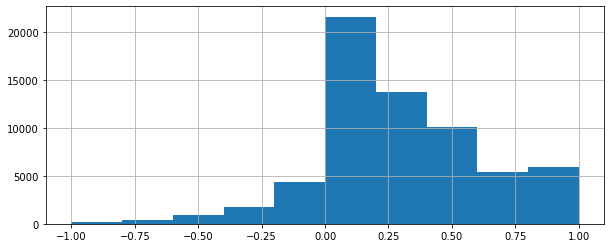

In [28]:
productreveiws['sentiment'].hist(figsize=(10,4))

In [29]:
print(Positive_Sentiments)
print(Negative_Sentiments)
print(Neutral_Sentiments)

46675
7580
10037


In [30]:
senty_pos = Senti[Senti.senty == 'Positive'].body   # Word list from Positive sentiments tweets
senty_neg = Senti[Senti.senty == 'Negative'].body   # Word list from Negative Sentiments tweets
senty_neu = Senti[Senti.senty == 'Neutral'].body   # Word list from Neutral Sentiments tweets 
print(senty_pos)
print(senty_neg)
print(senty_neu)

0        I Samsung A600 awhile absolute doo doo. You re...
1        Due software issue Nokia Sprint phone's text m...
2        This great, reliable phone. I also purchased p...
3        I love phone all, I really need one, I expect ...
4        The phone great every purpose offers, except d...
                               ...                        
64284    Exactly I looking for. Fast delivery, perfect ...
64288    My 15 year old daughter happy quite well camer...
64289                             So far good days works .
64290    Product looks works like new. Very much recomm...
64291    I love size style phone. It great size phone m...
Name: body, Length: 46675, dtype: object
29                                               way small
30       I asked friend toss phone, heard "Hey, throw p...
32       I model phone 4-1/2 years battery beginning fa...
47       Bought phone told would longer work network. W...
55       I professional recently purchased Sanyo Juno p...
               

Word Cloud for All reviews


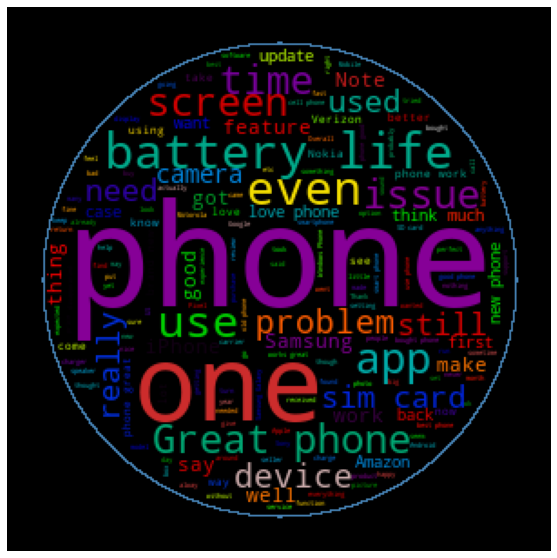

Word Cloud for Positive reviews


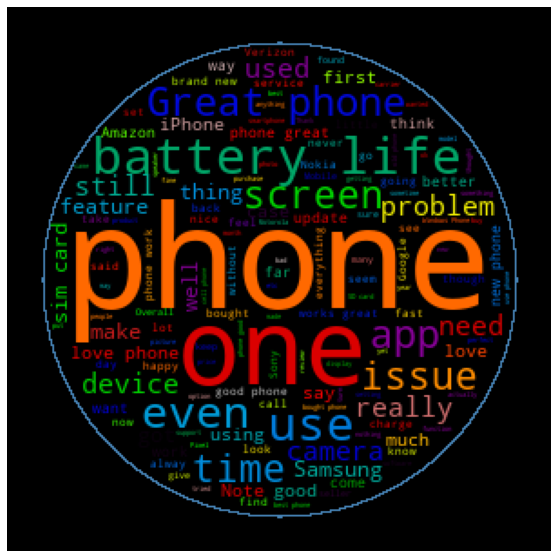

Word Cloud for Negative reviews


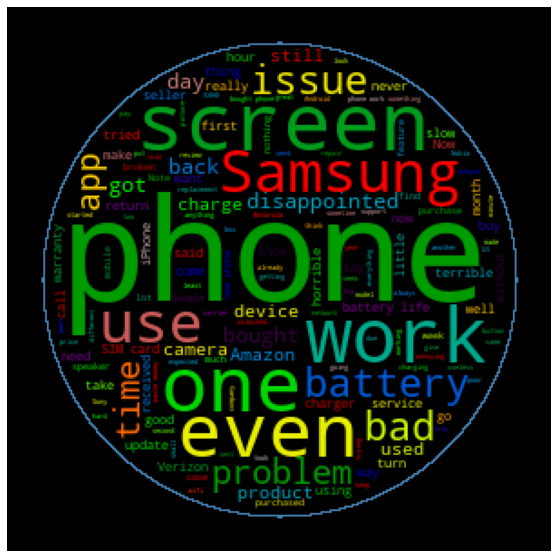

Word Cloud for Neutral reviews


In [31]:
if __name__ == "__main__":    
    #Draw a word cloud For All tweets
    print("Word Cloud for All reviews")
    word_cloud(pd.Series([t for t in Senti.body]).str.cat(sep=' '))
    
    # Draw a Word Cloud For positive tweets 
    print("Word Cloud for Positive reviews")   
    word_cloud(pd.Series([t for t in senty_pos]).str.cat(sep=' '))
    
    #Draw a Word Cloud For negative 
    print("Word Cloud for Negative reviews")
    word_cloud(pd.Series([t for t in senty_neg]).str.cat(sep=' '))
    
    #Draw a Word Cloud For neutral 
    print("Word Cloud for Neutral reviews") 

In [32]:
if __name__ == "__main__":
    #Get the frequency
    word_frequency = vectorization(Senti.body).sort_values(0, ascending = False)
    word_frequency_pos = vectorization(senty_pos).sort_values(0, ascending = False)
    word_frequency_neg = vectorization(senty_neg).sort_values(0, ascending = False)
    word_frequency_neu = vectorization(senty_neu).sort_values(0, ascending = False)

In [33]:
print(word_frequency_pos)
print(word_frequency_neg)
print(word_frequency_neu)

                 0
phone        78453
it           25907
the          23332
great        19081
good         15268
...            ...
imea             1
imao             1
imagines         1
imaginative      1
útiles           1

[30086 rows x 1 columns]
              0
phone     11312
it         3561
the        2887
screen     1875
battery    1699
...         ...
ifu           1
iff           1
idont         1
ideology      1
чтобы         1

[11524 rows x 1 columns]
            0
phone    3206
el       1378
de       1225
it       1193
muy      1062
...       ...
hacerme     1
hacerle     1
hablo       1
hablaba     1
ѕhσckєd     1

[8996 rows x 1 columns]


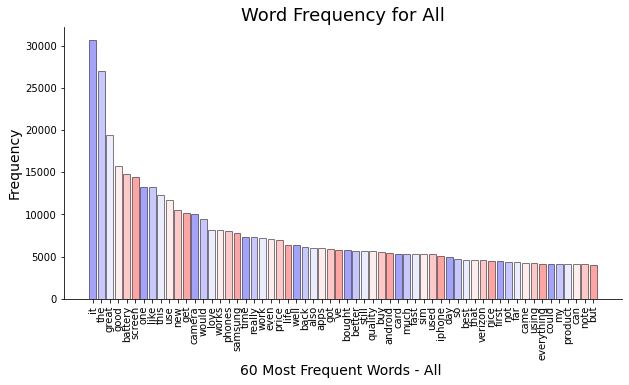

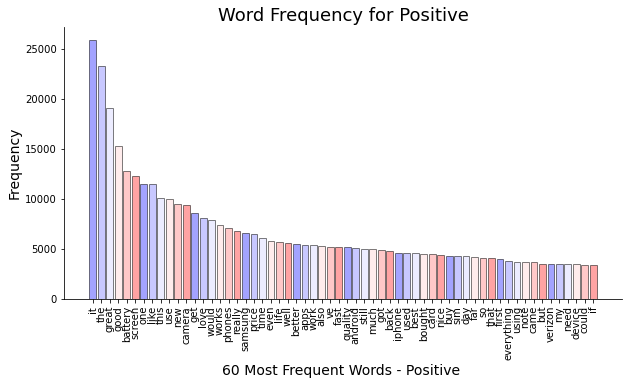

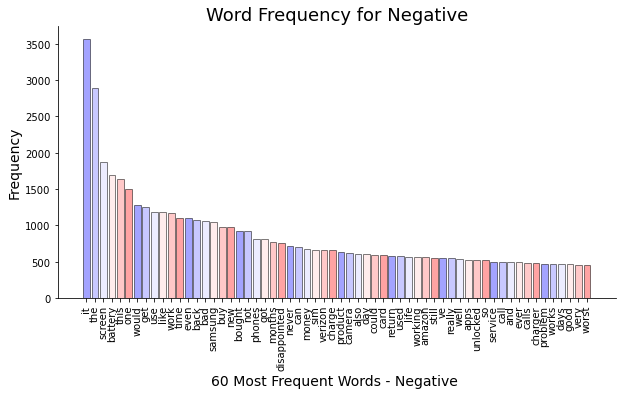

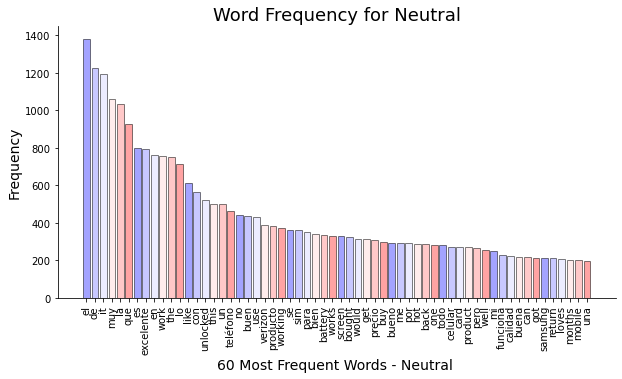

In [34]:
#Graphs with frequency words all, positive, negative and neutral tweets.
    graph1(word_frequency, 'All')
    graph1(word_frequency_pos, 'Positive')
    graph1(word_frequency_neg, 'Negative')
    graph1(word_frequency_neu, 'Neutral')

In [35]:
Senti

,body,senty
0,I Samsung A600 awhile absolute doo doo. You re...,Positive
1,Due software issue Nokia Sprint phone's text m...,Positive
2,"This great, reliable phone. I also purchased p...",Positive
3,"I love phone all, I really need one, I expect ...",Positive
4,"The phone great every purpose offers, except d...",Positive
...,...,...
64287,This gift recipient loves it.,Neutral
64288,My 15 year old daughter happy quite well camer...,Positive
64289,So far good days works .,Positive
64290,Product looks works like new. Very much recomm...,Positive


In [36]:
stop_words = stopwords.words()
Senti['no_sw'] = Senti['body'].apply(lambda x: ' '.join([word for word in x.split() if word not in (stop_words)]))

In [37]:
Senti

,body,senty,no_sw
0,I Samsung A600 awhile absolute doo doo. You re...,Positive,I Samsung A600 awhile absolute doo doo. You re...
1,Due software issue Nokia Sprint phone's text m...,Positive,Due software issue Nokia Sprint phone's text m...
2,"This great, reliable phone. I also purchased p...",Positive,"This great, reliable phone. I purchased phone ..."
3,"I love phone all, I really need one, I expect ...",Positive,"I love phone all, I one, I expect price bill I..."
4,"The phone great every purpose offers, except d...",Positive,"The phone great purpose offers, day bought it-..."
...,...,...,...
64287,This gift recipient loves it.,Neutral,This gift recipient loves it.
64288,My 15 year old daughter happy quite well camer...,Positive,"My 15 year daughter happy camera, quality kind..."
64289,So far good days works .,Positive,So days works .
64290,Product looks works like new. Very much recomm...,Positive,Product works new. Very recommend.


In [38]:
#Working with the most Frequent Words: 
from collections import Counter
cnt = Counter()
for text in Senti["no_sw"].values:
    for word in text.split():
        cnt[word] += 1
cnt.most_common(10)
temp = pd.DataFrame(cnt.most_common(10))
temp.columns=['word', 'count']
temp

,word,count
0,I,101686
1,phone,63939
2,The,25389
3,phone.,13675
4,It,12280
5,battery,11005
6,great,10418
7,screen,10370
8,This,10169
9,it.,7794


In [39]:
!pip install plotly

In [40]:

px.bar(temp, x="count", y="word", title='Commmon Words in Text', orientation='h', 
             width=700, height=700)


In [41]:
# Remove the most frequent words:
FREQWORDS = set([w for (w, wc) in cnt.most_common(10)])
def remove_freqwords(body):
    """custom function to remove the frequent words"""
    return " ".join([word for word in str(text).split() if word not in FREQWORDS])
Senti["wo_stopfreq"] = Senti["no_sw"].apply(lambda text: remove_freqwords(text))
Senti.head()

,body,senty,no_sw,wo_stopfreq
0,I Samsung A600 awhile absolute doo doo. You re...,Positive,I Samsung A600 awhile absolute doo doo. You re...,love size style size features. affordable get.
1,Due software issue Nokia Sprint phone's text m...,Positive,Due software issue Nokia Sprint phone's text m...,love size style size features. affordable get.
2,"This great, reliable phone. I also purchased p...",Positive,"This great, reliable phone. I purchased phone ...",love size style size features. affordable get.
3,"I love phone all, I really need one, I expect ...",Positive,"I love phone all, I one, I expect price bill I...",love size style size features. affordable get.
4,"The phone great every purpose offers, except d...",Positive,"The phone great purpose offers, day bought it-...",love size style size features. affordable get.


In [42]:
Senti['no_sw'].loc[5]

'Hello, I phone I decided buy flip phone. I NO problems battery cases--it fish case stays original one. I added ring tones, music me--as matter fact I sell phone, home charger car charger great deal--email me--(...)'

In [43]:
Senti['wo_stopfreq'].loc[5]

'love size style size features. affordable get.'

In [44]:
# Lemmatization: Lemmatization is converting the word to its base form or lemma by removing affixes from the inflected words. 
# It helps to create better features for machine learning and NLP models hence it is an important preprocessing step.


wordnet_lem = WordNetLemmatizer()

Senti['wo_stopfreq_lem'] = Senti['wo_stopfreq'].apply(wordnet_lem.lemmatize)
Senti

,body,senty,no_sw,wo_stopfreq,wo_stopfreq_lem
0,I Samsung A600 awhile absolute doo doo. You re...,Positive,I Samsung A600 awhile absolute doo doo. You re...,love size style size features. affordable get.,love size style size features. affordable get.
1,Due software issue Nokia Sprint phone's text m...,Positive,Due software issue Nokia Sprint phone's text m...,love size style size features. affordable get.,love size style size features. affordable get.
2,"This great, reliable phone. I also purchased p...",Positive,"This great, reliable phone. I purchased phone ...",love size style size features. affordable get.,love size style size features. affordable get.
3,"I love phone all, I really need one, I expect ...",Positive,"I love phone all, I one, I expect price bill I...",love size style size features. affordable get.,love size style size features. affordable get.
4,"The phone great every purpose offers, except d...",Positive,"The phone great purpose offers, day bought it-...",love size style size features. affordable get.,love size style size features. affordable get.
...,...,...,...,...,...
64287,This gift recipient loves it.,Neutral,This gift recipient loves it.,love size style size features. affordable get.,love size style size features. affordable get.
64288,My 15 year old daughter happy quite well camer...,Positive,"My 15 year daughter happy camera, quality kind...",love size style size features. affordable get.,love size style size features. affordable get.
64289,So far good days works .,Positive,So days works .,love size style size features. affordable get.,love size style size features. affordable get.
64290,Product looks works like new. Very much recomm...,Positive,Product works new. Very recommend.,love size style size features. affordable get.,love size style size features. affordable get.


In [45]:
# create the cleaned data for the train-test split:
nb=Senti.drop(columns=['wo_stopfreq_lem','no_sw', 'wo_stopfreq'])
nb.columns=['body','senty']
nb.rename(columns={'sentiment':'senty'}, inplace = True)


In [46]:
nb["senty"]= nb['senty'].replace({"Positive":2,"Negative":1,"Neutral":0})
nb

,body,senty
0,I Samsung A600 awhile absolute doo doo. You re...,2
1,Due software issue Nokia Sprint phone's text m...,2
2,"This great, reliable phone. I also purchased p...",2
3,"I love phone all, I really need one, I expect ...",2
4,"The phone great every purpose offers, except d...",2
...,...,...
64287,This gift recipient loves it.,0
64288,My 15 year old daughter happy quite well camer...,2
64289,So far good days works .,2
64290,Product looks works like new. Very much recomm...,2


In [47]:
tokenized_review=nb['body'].apply(lambda x: x.split())
tokenized_review.head(5)

0    [I, Samsung, A600, awhile, absolute, doo, doo....
1    [Due, software, issue, Nokia, Sprint, phone's,...
2    [This, great,, reliable, phone., I, also, purc...
3    [I, love, phone, all,, I, really, need, one,, ...
4    [The, phone, great, every, purpose, offers,, e...
Name: body, dtype: object

In [48]:
token = RegexpTokenizer(r'[a-zA-Z0-9]+')
cv = CountVectorizer(stop_words='english',ngram_range = (1,1),tokenizer = token.tokenize)
text_counts = cv.fit_transform(nb['body'])

In [49]:

X=text_counts
y=nb['senty']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.20,random_state=30)

# Complement NB model:

In [50]:
from sklearn.naive_bayes import ComplementNB
from sklearn.metrics import classification_report, confusion_matrix
CNB = ComplementNB()
CNB.fit(X_train, y_train)

from sklearn import metrics
predicted = CNB.predict(X_test)
accuracy_score = metrics.accuracy_score(predicted, y_test)

print('ComplementNB model accuracy is',str('{:04.2f}'.format(accuracy_score*100))+'%')
print('------------------------------------------------')
print('Confusion Matrix:')
print(pd.DataFrame(confusion_matrix(y_test, predicted)))
print('------------------------------------------------')
print('Classification Report:')
print(classification_report(y_test, predicted))


ComplementNB model accuracy is 83.09%
------------------------------------------------
Confusion Matrix:
      0    1     2
0  1021  526   483
1    23  916   553
2    95  495  8747
------------------------------------------------
Classification Report:
              precision    recall  f1-score   support

           0       0.90      0.50      0.64      2030
           1       0.47      0.61      0.53      1492
           2       0.89      0.94      0.91      9337

    accuracy                           0.83     12859
   macro avg       0.75      0.68      0.70     12859
weighted avg       0.85      0.83      0.83     12859



# Mutilnominal NB model

In [52]:
from sklearn.naive_bayes import MultinomialNB

MNB = MultinomialNB()
MNB.fit(X_train, y_train)

predicted = MNB.predict(X_test)
accuracy_score = metrics.accuracy_score(predicted, y_test)

print('MultinominalNB model accuracy is',str('{:04.2f}'.format(accuracy_score*100))+'%')
print('------------------------------------------------')
print('Confusion Matrix:')
print(pd.DataFrame(confusion_matrix(y_test, predicted)))
print('------------------------------------------------')
print('Classification Report:')
print(classification_report(y_test, predicted))

MultinominalNB model accuracy is 81.45%
------------------------------------------------
Confusion Matrix:
     0    1     2
0  839  223   968
1    6  819   667
2   36  485  8816
------------------------------------------------
Classification Report:
              precision    recall  f1-score   support

           0       0.95      0.41      0.58      2030
           1       0.54      0.55      0.54      1492
           2       0.84      0.94      0.89      9337

    accuracy                           0.81     12859
   macro avg       0.78      0.64      0.67     12859
weighted avg       0.83      0.81      0.80     12859



# Bernoulli NB model:

In [53]:
from sklearn.naive_bayes import BernoulliNB

BNB = BernoulliNB()
BNB.fit(X_train, y_train)

predicted = BNB.predict(X_test)
accuracy_score_bnb = metrics.accuracy_score(predicted,y_test)

print('BernoulliNB model accuracy = ' + str('{:4.2f}'.format(accuracy_score_bnb*100))+'%')
print('------------------------------------------------')
print('Confusion Matrix:')
print(pd.DataFrame(confusion_matrix(y_test, predicted)))
print('------------------------------------------------')
print('Classification Report:')
print(classification_report(y_test, predicted))

BernoulliNB model accuracy = 69.42%
------------------------------------------------
Confusion Matrix:
      0    1     2
0  1821   68   141
1   351  587   554
2  2444  374  6519
------------------------------------------------
Classification Report:
              precision    recall  f1-score   support

           0       0.39      0.90      0.55      2030
           1       0.57      0.39      0.47      1492
           2       0.90      0.70      0.79      9337

    accuracy                           0.69     12859
   macro avg       0.62      0.66      0.60     12859
weighted avg       0.78      0.69      0.71     12859



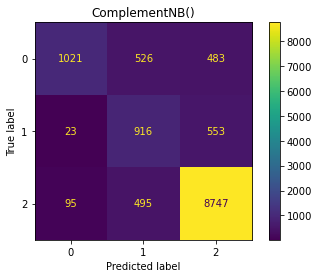

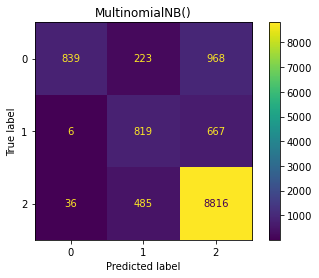

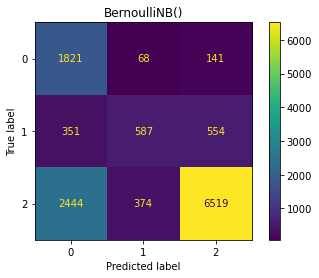

In [54]:
from sklearn.metrics import plot_confusion_matrix
import warnings
warnings.filterwarnings("ignore")
k= [CNB, MNB, BNB]
for i in k: 
    plot_confusion_matrix(i, X_test, y_test)  
    plt.title(i)
    plt.show()